In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import interpolate, optimize
import ddm
import ddm.plot
import os 
import paranoid as pns
pns.settings.Settings.set(enabled=False)

# Loss function definitions

In [3]:
class LossWLS(ddm.LossFunction):
    name = 'Weighted least squares as described in Ratcliff & Tuerlinckx 2002'
    rt_quantiles = [0.1, 0.3, 0.5, 0.7, 0.9]
    rt_q_weights = [2, 2, 1, 1, 0.5]
    
    def setup(self, dt, T_dur, **kwargs):
        self.dt = dt
        self.T_dur = T_dur
    
    def get_rt_quantiles(self, x, t_domain, exp=False):
        cdf = x.cdf_corr(T_dur=self.T_dur, dt=self.dt) if exp else x.cdf_corr()
        cdf_interp = interpolate.interp1d(t_domain, cdf/cdf[-1])
        rt_quantile_values = [optimize.root_scalar(lambda x:cdf_interp(x)-quantile, bracket=(0, t_domain[-1])).root
                              for quantile in self.rt_quantiles]
        return np.array(rt_quantile_values)
    
    def loss(self, model):
        solultions = self.cache_by_conditions(model)
        WLS = 0
        for comb in self.sample.condition_combinations(required_conditions=self.required_conditions):
            c = frozenset(comb.items())
            comb_sample = self.sample.subset(**comb)
            WLS += 4*(solultions[c].prob_correct() - comb_sample.prob_correct())**2
            if solultions[c].prob_correct() > 0:
                model_rt_q = self.get_rt_quantiles(solultions[c], model.t_domain(), exp=False)
                exp_rt_q = self.get_rt_quantiles(comb_sample, model.t_domain(), exp=True)
                WLS += np.dot((model_rt_q-exp_rt_q)**2, self.rt_q_weights)*comb_sample.prob_correct()
        return WLS

# Helper functions

In [4]:
def get_model_measures(model, condition):
    sol = model.solve(condition)
    return condition['tta_condition'], condition['d_condition'], sol.prob_correct(), sol.mean_decision_time()
        
def save_fitting_results(exp_data, fit_model):
    print(fit_model.name)
    print('Loss function value: %.5f' % (fit_model.get_fit_result().value()))
    print('Number of parameters: %i' % (len(fit_model.get_model_parameters())-1))
    print('Parameter values: ', fit_model.get_model_parameters())
    
    directory = 'model_fit_results/tta_and_d/%s' % (fit_model.name.lower().replace(' ', '_'))
    if not os.path.exists(directory):
        os.makedirs(directory)
    
    conditions = [{'tta_condition': tta, 'd_condition': d} 
                  for tta in exp_data.tta_condition.unique() 
                  for d in exp_data.d_condition.unique()]
    model_measures = [get_model_measures(fit_model, condition) for condition in conditions]
    model_measures = pd.DataFrame(model_measures, columns=['tta_condition', 'd_condition', 'is_turn_decision', 'RT'])
    model_measures['loss'] = fit_model.get_fit_result().value()    
    model_measures.to_csv(os.path.join(directory, 'measures.csv'), index=False)
    
    rt_dfs = []
    for condition in conditions:
        sol = fit_model.solve(condition)
        rt_df = pd.DataFrame({'tta_condition': condition['tta_condition'],
                              'd_condition':  condition['d_condition'],
                              't': fit_model.t_domain(),
                              'rt_corr_pdf': sol.pdf_corr()/sol.prob_correct()})
        rt_dfs.append(rt_df)
    rt_dfs = pd.concat(rt_dfs)
    rt_dfs.to_csv(os.path.join(directory, 'rt_pdf.csv'), index=False)

# Model definitions

Duration of model simulations is set to 2.5 (upper boundary on experimentally observed response times)

In [8]:
T_dur = 2.5

### Model 1. DDM with TTA-dependent drift 

In [9]:
class DriftTtaDistance(ddm.models.Drift):
    name = 'Drift depends on TTA'
    required_parameters = ['alpha', 'tta_crit', 'beta', 'd_crit']
    required_conditions = ['tta_condition', 'd_condition'] 
    
    def get_drift(self, t, conditions, **kwargs):
        v = conditions['d_condition']/conditions['tta_condition']
        return (self.alpha*(conditions['tta_condition'] - t - self.tta_crit + 
                            self.beta*(conditions['d_condition'] - v*t - self.d_crit)))

In [16]:
model_tta_distance_dependent_drift = ddm.Model(name='1 TTA- and d-dependent drift',
                                      drift=DriftTtaDistance(alpha=ddm.Fittable(minval=0.1, maxval=3),
                                                     tta_crit=ddm.Fittable(minval=3, maxval=6),
                                                     beta=ddm.Fittable(minval=0, maxval=1),
                                                     d_crit=ddm.Fittable(minval=90, maxval=150)),
                                      noise=ddm.NoiseConstant(noise=1),
                                      bound=ddm.BoundConstant(B=ddm.Fittable(minval=.1, maxval=3.0)),
                                      T_dur=T_dur)

### Model 2. Model 1 + nondecision time

In [10]:
model_nondecision_time_fixed = ddm.Model(name='2 TTA- and d-dependent drift and fixed nondecision time',
                                      drift=DriftTtaDistance(alpha=ddm.Fittable(minval=0.1, maxval=3),
                                                     tta_crit=ddm.Fittable(minval=3, maxval=6),
                                                     beta=ddm.Fittable(minval=0, maxval=1),
                                                     d_crit=ddm.Fittable(minval=90, maxval=150)),
                                      noise=ddm.NoiseConstant(noise=1),
                                      bound=ddm.BoundConstant(B=ddm.Fittable(minval=.1, maxval=3.0)),
                                      overlay=ddm.OverlayNonDecision(nondectime=ddm.Fittable(minval=0, maxval=0.5)),
                                      T_dur=T_dur)

### Model 3. Model 2 + nondecision time variability

In [11]:
model_nondecision_time_variable = ddm.Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time',
                                     drift=DriftTtaDistance(alpha=ddm.Fittable(minval=0.1, maxval=3),
                                                     tta_crit=ddm.Fittable(minval=3, maxval=6),
                                                     beta=ddm.Fittable(minval=0, maxval=1),
                                                     d_crit=ddm.Fittable(minval=90, maxval=150)),
                                     noise=ddm.NoiseConstant(noise=1),
                                     bound=ddm.BoundConstant(B=ddm.Fittable(minval=.1, maxval=3.0)),
                                     overlay=ddm.OverlayNonDecisionUniform(nondectime=ddm.Fittable(minval=0, maxval=0.5),
                                                                           halfwidth=ddm.Fittable(minval=0, maxval=0.3)),
                                     T_dur=T_dur)

### Model 4. Model 3 + collapsing bounds

In [17]:
model_collapsing_bounds = ddm.Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds',
                                    drift=DriftTtaDistance(alpha=ddm.Fittable(minval=0.1, maxval=3),
                                                     tta_crit=ddm.Fittable(minval=3, maxval=6),
                                                     beta=ddm.Fittable(minval=0, maxval=1),
                                                     d_crit=ddm.Fittable(minval=90, maxval=150)),
                                    noise=ddm.NoiseConstant(noise=1),
                                    bound=ddm.BoundCollapsingExponential(B=ddm.Fittable(minval=0.5, maxval=5), 
                                                                         tau=ddm.Fittable(minval=0.5, maxval=5)),
                                    overlay=ddm.OverlayNonDecisionUniform(nondectime=ddm.Fittable(minval=0, maxval=0.5),
                                                                          halfwidth=ddm.Fittable(minval=0, maxval=0.3)),
                                    T_dur=T_dur)

### Model 5. Model 3 + TTA-dependent bounds

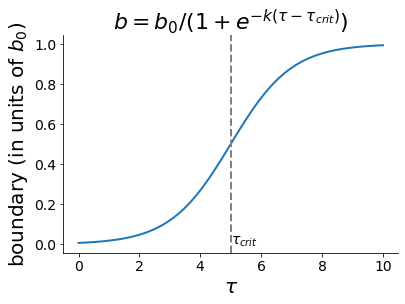

In [13]:
b_0 = 1
k = 1
tta_crit = 5
tau = np.linspace(0, 10)
b = lambda tau: b_0/(1+np.exp(-k*(tau-tta_crit)))

fig, ax = plt.subplots()
ax.plot(tau, b(tau))
ax.axvline(tta_crit, color='grey', ls='--')
ax.set_xlabel(r'$\tau$')
ax.set_ylabel('boundary (in units of $b_0$)')
# ax.legend(loc='lower right')
ax.set_title(r'$b = b_0/(1+e^{-k(\tau-\tau_{crit})})$')
ax.text(x=tta_crit, y=0, s=r'$\tau_{crit}$', fontsize=14);

In [18]:
class BoundCollapsingTta(ddm.models.Bound):
    name = 'Bounds collapsing with TTA'
    required_parameters = ['b_0', 'k', 'tta_crit']
    required_conditions = ['tta_condition'] 
    def get_bound(self, t, conditions, **kwargs):
        tau = conditions['tta_condition'] - t
        return self.b_0/(1+np.exp(-self.k*(tau-self.tta_crit)))

tta_crit = ddm.Fittable(minval=3, maxval=6)
    
model_TTA_bounds = ddm.Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time',
                             drift=DriftTtaDistance(alpha=ddm.Fittable(minval=0.1, maxval=3),
                                                     tta_crit=tta_crit,
                                                     beta=ddm.Fittable(minval=0, maxval=1),
                                                     d_crit=ddm.Fittable(minval=90, maxval=150)),
                             noise=ddm.NoiseConstant(noise=1),
                             bound=BoundCollapsingTta(b_0=ddm.Fittable(minval=0.5, maxval=5), 
                                                      k=ddm.Fittable(minval=0.1, maxval=2),
                                                      tta_crit=tta_crit),
                             overlay=ddm.OverlayNonDecisionUniform(nondectime=ddm.Fittable(minval=0, maxval=0.5),
                                                                   halfwidth=ddm.Fittable(minval=0, maxval=0.3)),
                             T_dur=T_dur)

# Model fitting

Reading experimental data

In [20]:
exp_data = pd.read_csv('measures.csv', usecols=['RT', 'is_turn_decision', 'tta_condition', 'd_condition'])
exp_sample = ddm.Sample.from_pandas_dataframe(df=exp_data, rt_column_name='RT', correct_column_name='is_turn_decision')

In [21]:
models = [
#           model_tta_distance_dependent_drift, 
          model_nondecision_time_fixed, 
          model_nondecision_time_variable,
          model_collapsing_bounds, 
          model_TTA_bounds
         ]

fit_models = []
for model in models:
    print(model.name)
    fit_model = ddm.fit_adjust_model(sample=exp_sample, model=model, lossfunction=LossWLS)
    save_fitting_results(exp_data, fit_model)
    fit_models.append(fit_model)

2 TTA- and d-dependent drift and fixed nondecision time
[0.5652149023328055, 5.132745432315105, 0.5081736914109648, 101.05860318413013, 1.6362877534026303, 0.18865017320628433]
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1583817434197767, minval=0.1, maxval=3), tta_crit=Fitted(3.244134312522199, minval=3, maxval=6), beta=Fitted(0.46150934150549594, minval=0, maxval=1), d_crit=Fitted(145.63121732098088, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.684636451003206, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.15843549231298681, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.486343064407802
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.073192963909798, minval=0.1, maxval=3), tta_crit=Fitted(5.842134773992343, minval=3, maxval=6), beta=Fitted(0.2980075644112

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.403398058885671, minval=0.1, maxval=3), tta_crit=Fitted(3.510323377199761, minval=3, maxval=6), beta=Fitted(0.37550950641463926, minval=0, maxval=1), d_crit=Fitted(149.5569385591144, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.430292019491206, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.341285707643716, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=10.094880935025474
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.527714984813096, minval=0.1, maxval=3), tta_crit=Fitted(5.7116789849202005, minval=3, maxval=6), beta=Fitted(0.4020460069107936, minval=0, maxval=1), d_crit=Fitted(91.16339332829266, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.4197191340924542, minval=0.1, maxv

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2070061468180766, minval=0.1, maxval=3), tta_crit=Fitted(5.011719507044957, minval=3, maxval=6), beta=Fitted(0.35970301691812007, minval=0, maxval=1), d_crit=Fitted(97.57281133150737, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.8389512690631467, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.41955761733166613, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.511404592913149
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2426437082273312, minval=0.1, maxval=3), tta_crit=Fitted(4.843364557465132, minval=3, maxval=6), beta=Fitted(0.7343417341201152, minval=0, maxval=1), d_crit=Fitted(146.2380802354574, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6517923557650572, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.2530730059021886, minval=0.1, maxval=3), tta_crit=Fitted(3.6468969628056773, minval=3, maxval=6), beta=Fitted(0.42777530594597013, minval=0, maxval=1), d_crit=Fitted(148.05065845210348, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5369919321989187, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.34704417872629345, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.8834901639715746
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5502080643955807, minval=0.1, maxval=3), tta_crit=Fitted(5.240484605882685, minval=3, maxval=6), beta=Fitted(0.8920012161353998, minval=0, maxval=1), d_crit=Fitted(127.42773731043914, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.888721964204635, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4748164693957222, minval=0.1, maxval=3), tta_crit=Fitted(3.802308282659701, minval=3, maxval=6), beta=Fitted(0.09202249964748443, minval=0, maxval=1), d_crit=Fitted(143.38258039795153, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.9725266462061914, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.01996096931139979, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=13.557522613124839
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6470478090323108, minval=0.1, maxval=3), tta_crit=Fitted(3.0385763367977683, minval=3, maxval=6), beta=Fitted(0.6194829353050315, minval=0, maxval=1), d_crit=Fitted(145.02641152270053, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.3106891133493734, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.9646092910253845, minval=0.1, maxval=3), tta_crit=Fitted(4.928121305523626, minval=3, maxval=6), beta=Fitted(0.9920371062801596, minval=0, maxval=1), d_crit=Fitted(100.57061187402829, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.96458033634263, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3309589366374629, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.044781901532263
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.4980718837308302, minval=0.1, maxval=3), tta_crit=Fitted(3.463335257106732, minval=3, maxval=6), beta=Fitted(0.49617799566188237, minval=0, maxval=1), d_crit=Fitted(106.97757858927517, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.0362831608699024, minval=0.1, ma

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8662643298257716, minval=0.1, maxval=3), tta_crit=Fitted(5.389016269285171, minval=3, maxval=6), beta=Fitted(0.723441243800256, minval=0, maxval=1), d_crit=Fitted(147.79710658589917, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.621851508181045, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3756729200470706, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=10.232606997505584
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.2355484573765922, minval=0.1, maxval=3), tta_crit=Fitted(4.893370245660412, minval=3, maxval=6), beta=Fitted(0.5379136839690136, minval=0, maxval=1), d_crit=Fitted(120.62099209205968, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.36686644441144867, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.7963108726614587, minval=0.1, maxval=3), tta_crit=Fitted(4.44823545519883, minval=3, maxval=6), beta=Fitted(0.6097903956878117, minval=0, maxval=1), d_crit=Fitted(133.17548766397115, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.6673722228499475, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.4553855810715687, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.953299546348268
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5913686485499328, minval=0.1, maxval=3), tta_crit=Fitted(4.049740206332989, minval=3, maxval=6), beta=Fitted(0.8266225429132718, minval=0, maxval=1), d_crit=Fitted(100.69516456225847, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.237007230236306, minval=0.1, max

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.0123438710303962, minval=0.1, maxval=3), tta_crit=Fitted(3.850810668920878, minval=3, maxval=6), beta=Fitted(0.7536714198707194, minval=0, maxval=1), d_crit=Fitted(134.41861459130448, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.727180512835745, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.297055996998783, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.310724543168882
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5787295814172215, minval=0.1, maxval=3), tta_crit=Fitted(3.0107518936585755, minval=3, maxval=6), beta=Fitted(0.5087187156061582, minval=0, maxval=1), d_crit=Fitted(146.82211549112637, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.2676552794623848, minval=0.1, ma

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.649251985611546, minval=0.1, maxval=3), tta_crit=Fitted(4.095074899508882, minval=3, maxval=6), beta=Fitted(0.050743125561306, minval=0, maxval=1), d_crit=Fitted(128.17743544222375, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.8094347539228153, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.49623536329216605, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.7192548442211155
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.8302327958159053, minval=0.1, maxval=3), tta_crit=Fitted(4.692517692264579, minval=3, maxval=6), beta=Fitted(0.869277769908527, minval=0, maxval=1), d_crit=Fitted(103.50656191957015, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.4493007586098432, minval=0.1, ma

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.9871898785928712, minval=0.1, maxval=3), tta_crit=Fitted(5.911126646678666, minval=3, maxval=6), beta=Fitted(0.8133608457185172, minval=0, maxval=1), d_crit=Fitted(117.56482192111855, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7450765422423569, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.15245815035865756, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.458041759412122
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.7044962662417027, minval=0.1, maxval=3), tta_crit=Fitted(5.998101125981669, minval=3, maxval=6), beta=Fitted(0.5564859535866015, minval=0, maxval=1), d_crit=Fitted(143.30957863689213, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8386387609280667, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.9425323918021098, minval=0.1, maxval=3), tta_crit=Fitted(5.689954655957741, minval=3, maxval=6), beta=Fitted(0.9557036604471844, minval=0, maxval=1), d_crit=Fitted(105.48256693843115, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9546952108376973, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2573198798599414, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.82067355995162
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1279740353365064, minval=0.1, maxval=3), tta_crit=Fitted(4.216017096521718, minval=3, maxval=6), beta=Fitted(0.5846256569527599, minval=0, maxval=1), d_crit=Fitted(140.3006483569821, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.0525452340737966, minval=0.1, max

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.4717080410652725, minval=0.1, maxval=3), tta_crit=Fitted(4.392048425844205, minval=3, maxval=6), beta=Fitted(0.9819452099448628, minval=0, maxval=1), d_crit=Fitted(136.8054113848712, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.084642986327819, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.4088321169248657, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.159876193590101
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.352792592061385, minval=0.1, maxval=3), tta_crit=Fitted(5.62765377427583, minval=3, maxval=6), beta=Fitted(0.34856286763957745, minval=0, maxval=1), d_crit=Fitted(102.00763375643814, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.6529557874972447, minval=0.1, maxv

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.7625232966387436, minval=0.1, maxval=3), tta_crit=Fitted(3.1299288460833563, minval=3, maxval=6), beta=Fitted(0.5923381016612075, minval=0, maxval=1), d_crit=Fitted(96.63269752752268, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.44211609275373687, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.17722422106811653, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=10.050634587270062
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7138214815813465, minval=0.1, maxval=3), tta_crit=Fitted(3.5363437142931895, minval=3, maxval=6), beta=Fitted(0.7134243071525477, minval=0, maxval=1), d_crit=Fitted(129.3087679646101, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.149342918733831, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.896351730647992, minval=0.1, maxval=3), tta_crit=Fitted(3.871823986944, minval=3, maxval=6), beta=Fitted(0.7006857844547243, minval=0, maxval=1), d_crit=Fitted(96.74748214004946, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.23680095384064, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.45945984895559366, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.457356007593348
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7857071928002581, minval=0.1, maxval=3), tta_crit=Fitted(4.811127257070704, minval=3, maxval=6), beta=Fitted(0.9668982564188723, minval=0, maxval=1), d_crit=Fitted(149.0883782734073, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.474703582490174, minval=0.1, maxval=3.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.279640093928699, minval=0.1, maxval=3), tta_crit=Fitted(3.3667473694862764, minval=3, maxval=6), beta=Fitted(0.8613718343744463, minval=0, maxval=1), d_crit=Fitted(131.42590996291108, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6181619050268157, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.1695000117830813, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.7573236016418665
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.9365570720178193, minval=0.1, maxval=3), tta_crit=Fitted(3.9339634559666212, minval=3, maxval=6), beta=Fitted(0.908400658674111, minval=0, maxval=1), d_crit=Fitted(114.3422509037278, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.3854984088014524, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9514568349229204, minval=0.1, maxval=3), tta_crit=Fitted(3.7831326717556357, minval=3, maxval=6), beta=Fitted(0.18598427454415606, minval=0, maxval=1), d_crit=Fitted(129.51857626129393, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.3937402049651966, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.21623135896475945, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.57374893309513
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.8297762032945208, minval=0.1, maxval=3), tta_crit=Fitted(3.59529279785594, minval=3, maxval=6), beta=Fitted(0.1704595361005911, minval=0, maxval=1), d_crit=Fitted(93.40328459544645, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.637480759647458, minval=0.1, ma

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6361703611410927, minval=0.1, maxval=3), tta_crit=Fitted(5.550131219497757, minval=3, maxval=6), beta=Fitted(0.9289192363081668, minval=0, maxval=1), d_crit=Fitted(92.5260578843777, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.474478306468116, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.16367561581129547, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=9.671067477237347
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.13771005178300344, minval=0.1, maxval=3), tta_crit=Fitted(5.084136237665351, minval=3, maxval=6), beta=Fitted(0.5117736946551148, minval=0, maxval=1), d_crit=Fitted(133.35257622314995, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.0046743165813243, minval=0.1, ma

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1721664740201463, minval=0.1, maxval=3), tta_crit=Fitted(5.350414257813405, minval=3, maxval=6), beta=Fitted(0.160943836477283, minval=0, maxval=1), d_crit=Fitted(119.59591438522693, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.8283574440313837, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.4454873339330909, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.849109567720307
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.17531382557932118, minval=0.1, maxval=3), tta_crit=Fitted(4.147708792476097, minval=3, maxval=6), beta=Fitted(0.5809134629117054, minval=0, maxval=1), d_crit=Fitted(149.5569385591144, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.430292019491206, minval=0.1, max

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.7371771935875655, minval=0.1, maxval=3), tta_crit=Fitted(5.011719507044957, minval=3, maxval=6), beta=Fitted(0.35970301691812007, minval=0, maxval=1), d_crit=Fitted(97.57281133150737, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.1533252053372869, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.30761742583457163, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.921768881214247
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.238520134907637, minval=0.1, maxval=3), tta_crit=Fitted(4.502693721558693, minval=3, maxval=6), beta=Fitted(0.3578929397631064, minval=0, maxval=1), d_crit=Fitted(128.05194848729064, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9233001278160825, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.7754253358816063, minval=0.1, maxval=3), tta_crit=Fitted(3.6468969628056773, minval=3, maxval=6), beta=Fitted(0.4305153979585199, minval=0, maxval=1), d_crit=Fitted(148.05065845210348, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.0658313054511073, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.39571110030270323, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=9.221311453951342
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5502080643955807, minval=0.1, maxval=3), tta_crit=Fitted(5.240484605882685, minval=3, maxval=6), beta=Fitted(0.09662197374294412, minval=0, maxval=1), d_crit=Fitted(127.42773731043914, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.888721964204635, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.2776527919038685, minval=0.1, maxval=3), tta_crit=Fitted(5.592332225950889, minval=3, maxval=6), beta=Fitted(0.3138999415146455, minval=0, maxval=1), d_crit=Fitted(142.44582137185995, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.8830977954174104, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.4157024518119396, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=9.09619856673337
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.5445955941858074, minval=0.1, maxval=3), tta_crit=Fitted(4.412864617862965, minval=3, maxval=6), beta=Fitted(0.6408097376400427, minval=0, maxval=1), d_crit=Fitted(118.97990352259917, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.2751509069487756, minval=0.1, ma

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.517618082133769, minval=0.1, maxval=3), tta_crit=Fitted(4.285039809447288, minval=3, maxval=6), beta=Fitted(0.2774267316341045, minval=0, maxval=1), d_crit=Fitted(98.60130116780084, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.6975710955919012, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.48993092272917593, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.4269544975554815
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.13700816085629808, minval=0.1, maxval=3), tta_crit=Fitted(4.608814958285687, minval=3, maxval=6), beta=Fitted(0.20164665596108922, minval=0, maxval=1), d_crit=Fitted(111.26948132951395, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.1916468344235365, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.548100984089981, minval=0.1, maxval=3), tta_crit=Fitted(3.6897048037257254, minval=3, maxval=6), beta=Fitted(0.2973551440208404, minval=0, maxval=1), d_crit=Fitted(104.22911342990203, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9076954191901899, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2661799726876207, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.120343191666516
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.7963108726614587, minval=0.1, maxval=3), tta_crit=Fitted(3.985612071812448, minval=3, maxval=6), beta=Fitted(0.6097903956878117, minval=0, maxval=1), d_crit=Fitted(99.9814096745938, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.085969713770634, minval=0.1, maxv

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4516042154673512, minval=0.1, maxval=3), tta_crit=Fitted(5.6622792633939625, minval=3, maxval=6), beta=Fitted(0.07924009933096615, minval=0, maxval=1), d_crit=Fitted(100.18846606689935, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.1807645941633371, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.29109228797395204, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.3906683974856542
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.8655022982901344, minval=0.1, maxval=3), tta_crit=Fitted(5.683338747958012, minval=3, maxval=6), beta=Fitted(0.30752921040955494, minval=0, maxval=1), d_crit=Fitted(134.41861459130448, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.4190662462191634, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.8647689611014608, minval=0.1, maxval=3), tta_crit=Fitted(5.401753341319762, minval=3, maxval=6), beta=Fitted(0.18342554058676153, minval=0, maxval=1), d_crit=Fitted(115.38604167669625, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6041310378461512, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24659631854457414, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.620507654267771
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.649251985611546, minval=0.1, maxval=3), tta_crit=Fitted(5.594253438108003, minval=3, maxval=6), beta=Fitted(0.1620505770698829, minval=0, maxval=1), d_crit=Fitted(119.5201496714947, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.8094347539228153, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.9909772065192255, minval=0.1, maxval=3), tta_crit=Fitted(5.765155243751012, minval=3, maxval=6), beta=Fitted(0.2780546231819859, minval=0, maxval=1), d_crit=Fitted(99.83152436858504, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8466728260255418, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.29553644646404575, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.8731191048595806
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.174129487109115, minval=0.1, maxval=3), tta_crit=Fitted(4.672764266394303, minval=3, maxval=6), beta=Fitted(0.22999331774465293, minval=0, maxval=1), d_crit=Fitted(109.23382558779643, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8780970123701244, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.472611091604523, minval=0.1, maxval=3), tta_crit=Fitted(5.80458485369418, minval=3, maxval=6), beta=Fitted(0.07713733276411805, minval=0, maxval=1), d_crit=Fitted(95.51073570579567, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.85693829642108, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.4664507380370324, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.2106609840867177
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5957414534506449, minval=0.1, maxval=3), tta_crit=Fitted(5.551711523717738, minval=3, maxval=6), beta=Fitted(0.10530201443760528, minval=0, maxval=1), d_crit=Fitted(92.93285604970242, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.3374661596951827, minval=0.1, maxv

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5233846301423077, minval=0.1, maxval=3), tta_crit=Fitted(3.174965827168228, minval=3, maxval=6), beta=Fitted(0.9373009513139976, minval=0, maxval=1), d_crit=Fitted(95.28296433996046, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.703453004290668, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.19037154667415607, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=9.438479024315031
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2523004131334758, minval=0.1, maxval=3), tta_crit=Fitted(5.6222834319111445, minval=3, maxval=6), beta=Fitted(0.8955508661764973, minval=0, maxval=1), d_crit=Fitted(144.20594745208416, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8589903773760018, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5014198361295126, minval=0.1, maxval=3), tta_crit=Fitted(5.624160302324595, minval=3, maxval=6), beta=Fitted(0.12321309436035399, minval=0, maxval=1), d_crit=Fitted(98.82175383780972, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.20278515804336283, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.1700437960032341, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.228560187245397
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.216096954011942, minval=0.1, maxval=3), tta_crit=Fitted(5.2112524675949, minval=3, maxval=6), beta=Fitted(0.19276652749240808, minval=0, maxval=1), d_crit=Fitted(93.48112430681128, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.3359183997807238, minval=0.1, max

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6029632507457918, minval=0.1, maxval=3), tta_crit=Fitted(5.059292271017831, minval=3, maxval=6), beta=Fitted(0.06742858314463307, minval=0, maxval=1), d_crit=Fitted(113.36494709189269, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8458861223524249, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.12911921656737835, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.0538982845694447
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.279640093928699, minval=0.1, maxval=3), tta_crit=Fitted(5.806849102568522, minval=3, maxval=6), beta=Fitted(0.22986403634949887, minval=0, maxval=1), d_crit=Fitted(101.32214590611551, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6181619050268157, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.6351309872714976, minval=0.1, maxval=3), tta_crit=Fitted(3.7831326717556357, minval=3, maxval=6), beta=Fitted(0.9912173721635863, minval=0, maxval=1), d_crit=Fitted(129.51857626129393, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8826166908184185, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2618611827779589, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.4097747846648625
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.8642613786919249, minval=0.1, maxval=3), tta_crit=Fitted(5.91827774779572, minval=3, maxval=6), beta=Fitted(0.5046948363311715, minval=0, maxval=1), d_crit=Fitted(109.31440400350655, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.637480759647458, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.073192963909798, minval=0.1, maxval=3), tta_crit=Fitted(5.301264863530979, minval=3, maxval=6), beta=Fitted(0.298007564411281, minval=0, maxval=1), d_crit=Fitted(116.08217751213525, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.8782295656491217, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.1032657834252032, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.585254530035676
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.1315989374178954, minval=0.1, maxval=3), tta_crit=Fitted(3.6093851335160014, minval=3, maxval=6), beta=Fitted(0.30303519613155455, minval=0, maxval=1), d_crit=Fitted(128.3988665194635, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.1232441867956615, minval=0.1, ma

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.37266616742186165, minval=0.1, maxval=3), tta_crit=Fitted(4.1386500150172525, minval=3, maxval=6), beta=Fitted(0.007243847949455096, minval=0, maxval=1), d_crit=Fitted(97.01174771900376, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9853623213762349, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.13998589129127786, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.166648428056379
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.177832696448992, minval=0.1, maxval=3), tta_crit=Fitted(3.881813719320995, minval=3, maxval=6), beta=Fitted(0.663356584094852, minval=0, maxval=1), d_crit=Fitted(119.94136365751751, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.14111284152916337, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6912080036153933, minval=0.1, maxval=3), tta_crit=Fitted(4.802466915475514, minval=3, maxval=6), beta=Fitted(0.26496916840982193, minval=0, maxval=1), d_crit=Fitted(91.02658200044482, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.0551729125521394, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.12335129895674143, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.5162715254785635
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4634397546371396, minval=0.1, maxval=3), tta_crit=Fitted(4.870680252869555, minval=3, maxval=6), beta=Fitted(0.18007169403190648, minval=0, maxval=1), d_crit=Fitted(138.10905409948975, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7974779046932989, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7497293608626828, minval=0.1, maxval=3), tta_crit=Fitted(4.743894813768049, minval=3, maxval=6), beta=Fitted(0.9911066837848544, minval=0, maxval=1), d_crit=Fitted(92.21242719235049, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.1825046245532116, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.250861018811264, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.542193535879376
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.7849507159800637, minval=0.1, maxval=3), tta_crit=Fitted(4.2071039714568625, minval=3, maxval=6), beta=Fitted(0.4015980055226057, minval=0, maxval=1), d_crit=Fitted(92.9228507074495, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.18850612443066317, minval=0.1, max

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.2749882469988436, minval=0.1, maxval=3), tta_crit=Fitted(4.639719942292563, minval=3, maxval=6), beta=Fitted(0.41794589340609256, minval=0, maxval=1), d_crit=Fitted(126.48657587857019, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.582858437088325, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.025641061984972485, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.5947233461042463
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.9646092910253845, minval=0.1, maxval=3), tta_crit=Fitted(4.455768409532606, minval=3, maxval=6), beta=Fitted(0.7128635983431891, minval=0, maxval=1), d_crit=Fitted(100.57061187402829, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.301419727365161, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7902897387879448, minval=0.1, maxval=3), tta_crit=Fitted(4.589648244485948, minval=3, maxval=6), beta=Fitted(0.17818904494307058, minval=0, maxval=1), d_crit=Fitted(129.9169247618266, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6223344617521698, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.1972322414858286, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.130313198139
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.9992939785079862, minval=0.1, maxval=3), tta_crit=Fitted(4.137276081384616, minval=3, maxval=6), beta=Fitted(0.5379136839690136, minval=0, maxval=1), d_crit=Fitted(130.97701697768915, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.4323939450548144, minval=0.1, maxv

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.2285195158947544, minval=0.1, maxval=3), tta_crit=Fitted(5.207507807810804, minval=3, maxval=6), beta=Fitted(0.4757377530042048, minval=0, maxval=1), d_crit=Fitted(98.7014015031141, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.15570473220225756, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.37455599697734376, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.644123028409906
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.922338544042483, minval=0.1, maxval=3), tta_crit=Fitted(3.5458791182559715, minval=3, maxval=6), beta=Fitted(0.36487928310986584, minval=0, maxval=1), d_crit=Fitted(121.71123870103061, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.481120864515905, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1592919362236545, minval=0.1, maxval=3), tta_crit=Fitted(5.0387266882451485, minval=3, maxval=6), beta=Fitted(0.07775597601807116, minval=0, maxval=1), d_crit=Fitted(93.84220410604959, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.7606306726090173, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3293406056100761, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.662632728019395
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.3877057597136402, minval=0.1, maxval=3), tta_crit=Fitted(5.192110164804291, minval=3, maxval=6), beta=Fitted(0.17469720006680406, minval=0, maxval=1), d_crit=Fitted(98.54315931517675, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.3232524080061336, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6453981522266469, minval=0.1, maxval=3), tta_crit=Fitted(3.882383961804508, minval=3, maxval=6), beta=Fitted(0.05001439357613757, minval=0, maxval=1), d_crit=Fitted(149.71197603070829, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9803131620270501, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.22196478534254646, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.218383084864653
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.307729977554108, minval=0.1, maxval=3), tta_crit=Fitted(4.032963777521168, minval=3, maxval=6), beta=Fitted(0.34394906769119704, minval=0, maxval=1), d_crit=Fitted(117.56482192111855, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.10042468387783665, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.297621635840084, minval=0.1, maxval=3), tta_crit=Fitted(3.713504382467329, minval=3, maxval=6), beta=Fitted(0.24277612360922668, minval=0, maxval=1), d_crit=Fitted(129.0075479490917, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.493837118821876, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3002331558854293, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.657703041372219
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.917050082751786, minval=0.1, maxval=3), tta_crit=Fitted(5.124871942239325, minval=3, maxval=6), beta=Fitted(0.3296539362968138, minval=0, maxval=1), d_crit=Fitted(95.51073570579567, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.279795331707409, minval=0.1, maxval

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.24945779349113217, minval=0.1, maxval=3), tta_crit=Fitted(3.8752596986357517, minval=3, maxval=6), beta=Fitted(0.4792544903795125, minval=0, maxval=1), d_crit=Fitted(128.48871482740856, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.6529557874972447, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.1193729521182273, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.343469799504849
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.15629077389627843, minval=0.1, maxval=3), tta_crit=Fitted(4.945511501031493, minval=3, maxval=6), beta=Fitted(0.05753150245577532, minval=0, maxval=1), d_crit=Fitted(105.83557156321967, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9789779215568677, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.44962442877964093, minval=0.1, maxval=3), tta_crit=Fitted(4.325225745588043, minval=3, maxval=6), beta=Fitted(0.45187581617865114, minval=0, maxval=1), d_crit=Fitted(112.91525483865094, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.3359183997807238, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.13165590623794568, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.6398175067883765
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3468230606775837, minval=0.1, maxval=3), tta_crit=Fitted(5.411591745004407, minval=3, maxval=6), beta=Fitted(0.03245465409795645, minval=0, maxval=1), d_crit=Fitted(127.19329839706845, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.3228121170910294, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.279640093928699, minval=0.1, maxval=3), tta_crit=Fitted(4.449403343244399, minval=3, maxval=6), beta=Fitted(0.34457904135040457, minval=0, maxval=1), d_crit=Fitted(131.42590996291108, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.6404849245295652, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.16245925278006448, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.4284183960307955
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6696964078563985, minval=0.1, maxval=3), tta_crit=Fitted(4.074291794845853, minval=3, maxval=6), beta=Fitted(0.025660720187050345, minval=0, maxval=1), d_crit=Fitted(127.93621735956653, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.3854984088014524, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5564526973858492, minval=0.1, maxval=3), tta_crit=Fitted(4.526783417781639, minval=3, maxval=6), beta=Fitted(0.12549087790311864, minval=0, maxval=1), d_crit=Fitted(127.2896437876868, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8722111084246228, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.18065190506925055, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.4657750771367553
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8287326491435191, minval=0.1, maxval=3), tta_crit=Fitted(3.9069637538298996, minval=3, maxval=6), beta=Fitted(0.2852265325675696, minval=0, maxval=1), d_crit=Fitted(104.19418726190258, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.4918237648052084, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0749190943537337, minval=0.1, maxval=3), tta_crit=Fitted(3.626791735375659, minval=3, maxval=6), beta=Fitted(0.2980291941838149, minval=0, maxval=1), d_crit=Fitted(90.02063554190771, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.4395951697290674, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.35283427862804817, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.5476821241275935
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1027767803062773, minval=0.1, maxval=3), tta_crit=Fitted(4.622695713942722, minval=3, maxval=6), beta=Fitted(0.8717888622109916, minval=0, maxval=1), d_crit=Fitted(144.82965008948594, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.7774543457012668, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.299373333917869, minval=0.1, maxval=3), tta_crit=Fitted(4.110381409129947, minval=3, maxval=6), beta=Fitted(0.616083007186292, minval=0, maxval=1), d_crit=Fitted(92.85852323415905, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9472778587730111, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.1559428265709519, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=9.936824604125434
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.3133668818416344, minval=0.1, maxval=3), tta_crit=Fitted(5.665197738271535, minval=3, maxval=6), beta=Fitted(0.4947887903509862, minval=0, maxval=1), d_crit=Fitted(93.26984258338888, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.1165920616343128, minval=0.1, maxva

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4270957406865064, minval=0.1, maxval=3), tta_crit=Fitted(5.5804241456706665, minval=3, maxval=6), beta=Fitted(0.3232514731898446, minval=0, maxval=1), d_crit=Fitted(114.60600494698816, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8184658332819386, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.29992275669782353, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.283397945521076
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.989800054050148, minval=0.1, maxval=3), tta_crit=Fitted(4.851561345468258, minval=3, maxval=6), beta=Fitted(0.3933883322696379, minval=0, maxval=1), d_crit=Fitted(108.9230466066102, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5421397458311321, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.260173237791066, minval=0.1, maxval=3), tta_crit=Fitted(5.4283167185049415, minval=3, maxval=6), beta=Fitted(0.22668240461193073, minval=0, maxval=1), d_crit=Fitted(97.62531504362096, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.18850612443066317, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.17599137771000034, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=9.332907556667168
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.825912601298581, minval=0.1, maxval=3), tta_crit=Fitted(4.832168172300768, minval=3, maxval=6), beta=Fitted(0.18374977757440897, minval=0, maxval=1), d_crit=Fitted(134.32120650619723, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.1751060718261575, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.1098496832738745, minval=0.1, maxval=3), tta_crit=Fitted(3.4429010188929396, minval=3, maxval=6), beta=Fitted(0.5662763916373338, minval=0, maxval=1), d_crit=Fitted(119.6311901370317, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8868921813205837, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.33287872205897195, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.4155524155523413
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.558348657231936, minval=0.1, maxval=3), tta_crit=Fitted(3.4875254057593796, minval=3, maxval=6), beta=Fitted(0.6130316261729527, minval=0, maxval=1), d_crit=Fitted(112.59502894970556, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.3238616295617955, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5121156689121986, minval=0.1, maxval=3), tta_crit=Fitted(4.645854112152316, minval=3, maxval=6), beta=Fitted(0.12471240709613463, minval=0, maxval=1), d_crit=Fitted(96.30124333624094, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.203595245938392, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.06811047210372703, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.9445432796315925
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1583817434197767, minval=0.1, maxval=3), tta_crit=Fitted(4.88308803504855, minval=3, maxval=6), beta=Fitted(0.46150934150549594, minval=0, maxval=1), d_crit=Fitted(97.11272991868269, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.7621485783334034, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.754255794393081, minval=0.1, maxval=3), tta_crit=Fitted(3.003592215325983, minval=3, maxval=6), beta=Fitted(0.9499708177610442, minval=0, maxval=1), d_crit=Fitted(90.30514491593239, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.2570241073366386, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.04711724975952025, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=12.119496370047807
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.50254637994249, minval=0.1, maxval=3), tta_crit=Fitted(5.866019393836883, minval=3, maxval=6), beta=Fitted(0.20890707751084125, minval=0, maxval=1), d_crit=Fitted(106.90302070154317, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.4190662462191634, minval=0.1, ma

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.9933093539616458, minval=0.1, maxval=3), tta_crit=Fitted(3.506224943928791, minval=3, maxval=6), beta=Fitted(0.994073176920379, minval=0, maxval=1), d_crit=Fitted(105.9361768343802, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.8094347539228153, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.060300635664391644, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=12.080759564621388
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.7852814969244652, minval=0.1, maxval=3), tta_crit=Fitted(5.615122951402576, minval=3, maxval=6), beta=Fitted(0.17212772621682426, minval=0, maxval=1), d_crit=Fitted(103.81810881460297, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.1622540753458277, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.24279263778044124, minval=0.1, maxval=3), tta_crit=Fitted(4.162534480230405, minval=3, maxval=6), beta=Fitted(0.09810843839313488, minval=0, maxval=1), d_crit=Fitted(109.53255730010822, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8780970123701244, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.07686521350296974, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8405467121119178
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.195365503100689, minval=0.1, maxval=3), tta_crit=Fitted(3.2170558209817974, minval=3, maxval=6), beta=Fitted(0.2733587825406959, minval=0, maxval=1), d_crit=Fitted(135.97746806559547, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.1557100277804224, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.8222086830486417, minval=0.1, maxval=3), tta_crit=Fitted(5.652427123551777, minval=3, maxval=6), beta=Fitted(0.09839805663843837, minval=0, maxval=1), d_crit=Fitted(110.88136251471893, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7566834550944646, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.1557567757206379, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.3458731612850654
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5367412552636373, minval=0.1, maxval=3), tta_crit=Fitted(3.259902031593702, minval=3, maxval=6), beta=Fitted(0.5870954414195738, minval=0, maxval=1), d_crit=Fitted(104.52653449949972, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.5577807226938583, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8864092150742281, minval=0.1, maxval=3), tta_crit=Fitted(4.74634151575018, minval=3, maxval=6), beta=Fitted(0.6273079933427134, minval=0, maxval=1), d_crit=Fitted(144.20594745208416, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.714281950692837, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.48040158560119367, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=11.252903410029166
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.8916406716366492, minval=0.1, maxval=3), tta_crit=Fitted(4.915131374865206, minval=3, maxval=6), beta=Fitted(0.12839871112388745, minval=0, maxval=1), d_crit=Fitted(94.45275841205745, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.0889837717661859, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.711418239553163, minval=0.1, maxval=3), tta_crit=Fitted(4.138308676217569, minval=3, maxval=6), beta=Fitted(0.45187581617865114, minval=0, maxval=1), d_crit=Fitted(122.33305510154347, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.1194766120128017, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3891589903890226, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.987850104523344
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7293835697113372, minval=0.1, maxval=3), tta_crit=Fitted(5.411591745004407, minval=3, maxval=6), beta=Fitted(0.17874766882940146, minval=0, maxval=1), d_crit=Fitted(96.74748214004946, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.44582286872628485, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.7546971914471883, minval=0.1, maxval=3), tta_crit=Fitted(4.570401270239654, minval=3, maxval=6), beta=Fitted(0.5216931736898485, minval=0, maxval=1), d_crit=Fitted(135.09294006896948, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5119166823832946, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2625773738350935, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.2417547139517735
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.279640093928699, minval=0.1, maxval=3), tta_crit=Fitted(5.359154219897758, minval=3, maxval=6), beta=Fitted(0.03463256295894246, minval=0, maxval=1), d_crit=Fitted(131.42590996291108, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.953362160312839, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.248220613406, minval=0.1, maxval=3), tta_crit=Fitted(4.200950786040747, minval=3, maxval=6), beta=Fitted(0.16716112702263508, minval=0, maxval=1), d_crit=Fitted(140.3721314053087, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.2516774425438837, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.28820398729843344, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.391636137196398
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.147085419399944, minval=0.1, maxval=3), tta_crit=Fitted(5.91827774779572, minval=3, maxval=6), beta=Fitted(0.5046948363311715, minval=0, maxval=1), d_crit=Fitted(112.28274895200387, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.8684629797768824, minval=0.1, maxval

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.18261998661673573, minval=0.1, maxval=3), tta_crit=Fitted(5.00497399877285, minval=3, maxval=6), beta=Fitted(0.298007564411281, minval=0, maxval=1), d_crit=Fitted(95.56573431326973, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8657881834467769, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.23449907472982118, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.5413840968259245
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.509773946126774, minval=0.1, maxval=3), tta_crit=Fitted(5.759749473425174, minval=3, maxval=6), beta=Fitted(0.17050595210814173, minval=0, maxval=1), d_crit=Fitted(97.91546826202864, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7708491126956043, minval=0.1, ma

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.96351068667027, minval=0.1, maxval=3), tta_crit=Fitted(4.1386500150172525, minval=3, maxval=6), beta=Fitted(0.31927203119180814, minval=0, maxval=1), d_crit=Fitted(97.01174771900376, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.2647935583685075, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.025343903060856876, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.002086773061768
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4736308980210491, minval=0.1, maxval=3), tta_crit=Fitted(3.881813719320995, minval=3, maxval=6), beta=Fitted(0.3031732118408586, minval=0, maxval=1), d_crit=Fitted(115.93806729065255, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.6719221509952258, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.989800054050148, minval=0.1, maxval=3), tta_crit=Fitted(5.005508376607295, minval=3, maxval=6), beta=Fitted(0.14127735609021508, minval=0, maxval=1), d_crit=Fitted(108.61592197254322, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.782798742691672, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3830716733798073, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.152318799544151
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.23918007832132493, minval=0.1, maxval=3), tta_crit=Fitted(3.6468969628056773, minval=3, maxval=6), beta=Fitted(0.20205436897673412, minval=0, maxval=1), d_crit=Fitted(91.41957848273194, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7413391115493281, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.7298633745311447, minval=0.1, maxval=3), tta_crit=Fitted(3.79786964369411, minval=3, maxval=6), beta=Fitted(0.46022321474566197, minval=0, maxval=1), d_crit=Fitted(93.00758838742857, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.4332063712666685, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.29348768422256344, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.244511812678756
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.7117515180580276, minval=0.1, maxval=3), tta_crit=Fitted(4.573686824937738, minval=3, maxval=6), beta=Fitted(0.47621853590842006, minval=0, maxval=1), d_crit=Fitted(113.24974991770623, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.6323986568162467, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.361285044635772, minval=0.1, maxval=3), tta_crit=Fitted(3.4696130097122895, minval=3, maxval=6), beta=Fitted(0.004873146904220194, minval=0, maxval=1), d_crit=Fitted(121.75251557084988, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.31717341701289303, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.02798827182332797, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=11.010361724909181
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.8765192566082947, minval=0.1, maxval=3), tta_crit=Fitted(3.7598367250678546, minval=3, maxval=6), beta=Fitted(0.8136195272830871, minval=0, maxval=1), d_crit=Fitted(106.48308963002889, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.0668476052897864, minval=

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6198080975500948, minval=0.1, maxval=3), tta_crit=Fitted(5.267425941254281, minval=3, maxval=6), beta=Fitted(0.14447283755453177, minval=0, maxval=1), d_crit=Fitted(91.12715639265483, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.31374694750437215, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2480539812568986, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.910229910719874
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5515131493846426, minval=0.1, maxval=3), tta_crit=Fitted(3.794651123551291, minval=3, maxval=6), beta=Fitted(0.12929405451562614, minval=0, maxval=1), d_crit=Fitted(140.1956117248026, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.565041779573962, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.459319722710899, minval=0.1, maxval=3), tta_crit=Fitted(5.87254907441264, minval=3, maxval=6), beta=Fitted(0.5500859612270362, minval=0, maxval=1), d_crit=Fitted(114.4307024608437, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.4482532602583542, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.1961679812066316, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.964399594916504
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0694572405784188, minval=0.1, maxval=3), tta_crit=Fitted(4.754727451997007, minval=3, maxval=6), beta=Fitted(0.2123536806382037, minval=0, maxval=1), d_crit=Fitted(90.30514491593239, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.4458348432898371, minval=0.1, maxva

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.8419120103197528, minval=0.1, maxval=3), tta_crit=Fitted(4.8389576802689565, minval=3, maxval=6), beta=Fitted(0.9584647577448857, minval=0, maxval=1), d_crit=Fitted(98.54315931517675, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.3232524080061336, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.253316356002131, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.808673128703433
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5677374304690366, minval=0.1, maxval=3), tta_crit=Fitted(3.526673146646589, minval=3, maxval=6), beta=Fitted(0.43525014563407083, minval=0, maxval=1), d_crit=Fitted(106.44224647407981, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.3519425281648252, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6453981522266469, minval=0.1, maxval=3), tta_crit=Fitted(3.9977734785487704, minval=3, maxval=6), beta=Fitted(0.05001439357613757, minval=0, maxval=1), d_crit=Fitted(106.33786616272894, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.8451868500462172, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.023987883485867362, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.171255188295573
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.747457996147971, minval=0.1, maxval=3), tta_crit=Fitted(3.0527533233642914, minval=3, maxval=6), beta=Fitted(0.3699257524925197, minval=0, maxval=1), d_crit=Fitted(110.84958058934187, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.499727186026376, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.108047162151735, minval=0.1, maxval=3), tta_crit=Fitted(4.8648091445097945, minval=3, maxval=6), beta=Fitted(0.24968428824409006, minval=0, maxval=1), d_crit=Fitted(90.73448999112786, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.3932056018574568, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.16220732402792815, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.39029722166988
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.23731468613107753, minval=0.1, maxval=3), tta_crit=Fitted(5.80458485369418, minval=3, maxval=6), beta=Fitted(0.07713733276411805, minval=0, maxval=1), d_crit=Fitted(123.70290794695906, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5443986124654288, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2523004131334758, minval=0.1, maxval=3), tta_crit=Fitted(5.252706789039923, minval=3, maxval=6), beta=Fitted(0.6553640293254919, minval=0, maxval=1), d_crit=Fitted(144.20594745208416, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8589903773760018, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2990221345467566, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.5186415483631786
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.8916406716366492, minval=0.1, maxval=3), tta_crit=Fitted(3.5999151388272073, minval=3, maxval=6), beta=Fitted(0.8552122076358165, minval=0, maxval=1), d_crit=Fitted(118.97188984055477, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.148774632858558, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.6045880894581166, minval=0.1, maxval=3), tta_crit=Fitted(5.2728375492375195, minval=3, maxval=6), beta=Fitted(0.23943934720772553, minval=0, maxval=1), d_crit=Fitted(94.43244851859366, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.9489212354621568, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.351893628647427, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.5156525645064685
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6446608412575429, minval=0.1, maxval=3), tta_crit=Fitted(4.76981342611023, minval=3, maxval=6), beta=Fitted(0.004342972251305921, minval=0, maxval=1), d_crit=Fitted(146.0200241884482, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.974783137497131, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.85048203165541, minval=0.1, maxval=3), tta_crit=Fitted(5.76965777949077, minval=3, maxval=6), beta=Fitted(0.31919826495253245, minval=0, maxval=1), d_crit=Fitted(119.80568888146618, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.6701405998323364, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.1929690919027028, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.226220185162421
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.4726001454157935, minval=0.1, maxval=3), tta_crit=Fitted(3.6672510898259336, minval=3, maxval=6), beta=Fitted(0.10494849838742182, minval=0, maxval=1), d_crit=Fitted(94.24969603404348, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.127927522824611, minval=0.1, max

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.365566561630493, minval=0.1, maxval=3), tta_crit=Fitted(3.228747070155364, minval=3, maxval=6), beta=Fitted(0.1659437550447005, minval=0, maxval=1), d_crit=Fitted(129.34430677522815, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.34666240726716446, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.16389296559987632, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.213123900618325
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.636063406417766, minval=0.1, maxval=3), tta_crit=Fitted(4.581212515810729, minval=3, maxval=6), beta=Fitted(0.04711729199950093, minval=0, maxval=1), d_crit=Fitted(102.49717420520898, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.2997013290284976, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8815972002010367, minval=0.1, maxval=3), tta_crit=Fitted(3.8929454262734846, minval=3, maxval=6), beta=Fitted(0.0946411641787046, minval=0, maxval=1), d_crit=Fitted(133.73654182006155, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.570123685221655, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.4183735102742449, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.408261909805557
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.8169032999453503, minval=0.1, maxval=3), tta_crit=Fitted(3.444724256688677, minval=3, maxval=6), beta=Fitted(0.007243847949455096, minval=0, maxval=1), d_crit=Fitted(107.10477498709669, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7382458685087955, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7325248186965199, minval=0.1, maxval=3), tta_crit=Fitted(3.8693423087951215, minval=3, maxval=6), beta=Fitted(0.9664946044167307, minval=0, maxval=1), d_crit=Fitted(95.51963735794794, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.176187872583, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.35770731328625816, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.518433702240886
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8486399469356029, minval=0.1, maxval=3), tta_crit=Fitted(3.6403466642626374, minval=3, maxval=6), beta=Fitted(0.4131472157001621, minval=0, maxval=1), d_crit=Fitted(122.69343831695174, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9900174749751577, minval=0.1, max

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.830555423268988, minval=0.1, maxval=3), tta_crit=Fitted(5.221352424322729, minval=3, maxval=6), beta=Fitted(0.6838807954127273, minval=0, maxval=1), d_crit=Fitted(114.11979274846864, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.357599766535116, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.250861018811264, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.838331295476881
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.15881063252695715, minval=0.1, maxval=3), tta_crit=Fitted(3.541296877232498, minval=3, maxval=6), beta=Fitted(0.22668240461193073, minval=0, maxval=1), d_crit=Fitted(111.44378202371776, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.527772241544824, minval=0.1, max

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9316460468515615, minval=0.1, maxval=3), tta_crit=Fitted(5.233819177250233, minval=3, maxval=6), beta=Fitted(0.09634821115882997, minval=0, maxval=1), d_crit=Fitted(98.9495958278392, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6156953601409093, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.051051505875355924, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.231652239744002
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5093069468283524, minval=0.1, maxval=3), tta_crit=Fitted(4.836996062541337, minval=3, maxval=6), beta=Fitted(0.46890990283823675, minval=0, maxval=1), d_crit=Fitted(96.61457375940792, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.4644159353177324, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.33885195465671614, minval=0.1, maxval=3), tta_crit=Fitted(3.244134312522199, minval=3, maxval=6), beta=Fitted(0.187561887714907, minval=0, maxval=1), d_crit=Fitted(145.63121732098088, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7644818797013125, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.15843549231298681, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.035104020710831
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2284039925889036, minval=0.1, maxval=3), tta_crit=Fitted(4.459552102997876, minval=3, maxval=6), beta=Fitted(0.12929405451562614, minval=0, maxval=1), d_crit=Fitted(117.98814294037815, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.0170159822608988, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.8844675300063238, minval=0.1, maxval=3), tta_crit=Fitted(3.532285041045778, minval=3, maxval=6), beta=Fitted(0.7340188697179044, minval=0, maxval=1), d_crit=Fitted(139.6736848338533, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.4190662462191634, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.16743162231735964, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.907072701309401
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5787295814172215, minval=0.1, maxval=3), tta_crit=Fitted(5.1519051914116565, minval=3, maxval=6), beta=Fitted(0.093383775541799, minval=0, maxval=1), d_crit=Fitted(137.2858296858681, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.6478931544282887, minval=0.1, ma

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2229879663638878, minval=0.1, maxval=3), tta_crit=Fitted(4.787291890644646, minval=3, maxval=6), beta=Fitted(0.1620505770698829, minval=0, maxval=1), d_crit=Fitted(129.93551798572778, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.8094347539228153, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3906896128981079, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.153150361078588
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.1053464908454713, minval=0.1, maxval=3), tta_crit=Fitted(3.270949851355536, minval=3, maxval=6), beta=Fitted(0.10621396896464863, minval=0, maxval=1), d_crit=Fitted(131.99660863510704, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6100252538366426, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.961206107515862, minval=0.1, maxval=3), tta_crit=Fitted(4.616812098530449, minval=3, maxval=6), beta=Fitted(0.7620899729882226, minval=0, maxval=1), d_crit=Fitted(109.4042280316603, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5462914839290303, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.1518921736040948, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=9.949305867972486
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.3193868722545876, minval=0.1, maxval=3), tta_crit=Fitted(4.967087881162303, minval=3, maxval=6), beta=Fitted(0.10359634680326146, minval=0, maxval=1), d_crit=Fitted(131.5094601994482, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.7064449239850774, minval=0.1, max

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.5587994720773306, minval=0.1, maxval=3), tta_crit=Fitted(4.813472896515916, minval=3, maxval=6), beta=Fitted(0.7751409147684178, minval=0, maxval=1), d_crit=Fitted(123.70290794695906, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.36396719619007945, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.47133703183550324, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.912297418384204
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.1332008353457064, minval=0.1, maxval=3), tta_crit=Fitted(5.723200881102852, minval=3, maxval=6), beta=Fitted(0.31971460379491856, minval=0, maxval=1), d_crit=Fitted(95.38776539859049, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6328406726010478, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7215114402864115, minval=0.1, maxval=3), tta_crit=Fitted(5.195109062360301, minval=3, maxval=6), beta=Fitted(0.6612989198331438, minval=0, maxval=1), d_crit=Fitted(107.36647753410332, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.2523037589027586, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.34333666449361555, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.273407426682473
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4820005435093642, minval=0.1, maxval=3), tta_crit=Fitted(5.6222834319111445, minval=3, maxval=6), beta=Fitted(0.42713807506670654, minval=0, maxval=1), d_crit=Fitted(128.30361592624956, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.47637012739785045, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5014198361295126, minval=0.1, maxval=3), tta_crit=Fitted(5.322077000150045, minval=3, maxval=6), beta=Fitted(0.7124419401940915, minval=0, maxval=1), d_crit=Fitted(105.59164611588861, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.4311410383991467, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.4097765495305757, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.390762759965414
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.44962442877964093, minval=0.1, maxval=3), tta_crit=Fitted(4.325225745588043, minval=3, maxval=6), beta=Fitted(0.45187581617865114, minval=0, maxval=1), d_crit=Fitted(101.48254284680445, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8840362503338143, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6029632507457918, minval=0.1, maxval=3), tta_crit=Fitted(5.059292271017831, minval=3, maxval=6), beta=Fitted(0.24294739565013623, minval=0, maxval=1), d_crit=Fitted(93.66380350554334, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.6185885173163383, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.23405840064016536, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.925748862259973
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.7201726242913766, minval=0.1, maxval=3), tta_crit=Fitted(3.4710421744918847, minval=3, maxval=6), beta=Fitted(0.4601283168745653, minval=0, maxval=1), d_crit=Fitted(112.32372175719563, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.545474779446165, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9703852607833469, minval=0.1, maxval=3), tta_crit=Fitted(5.109793938076824, minval=3, maxval=6), beta=Fitted(0.08307549516030871, minval=0, maxval=1), d_crit=Fitted(105.3198434363152, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.7163483041794914, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.14043588774464508, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.7170976410532601
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9052771259039826, minval=0.1, maxval=3), tta_crit=Fitted(4.6138580436402545, minval=3, maxval=6), beta=Fitted(0.589208596473423, minval=0, maxval=1), d_crit=Fitted(105.2926862393444, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.2857587525655376, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8803759632767518, minval=0.1, maxval=3), tta_crit=Fitted(5.00497399877285, minval=3, maxval=6), beta=Fitted(0.9759802306852846, minval=0, maxval=1), d_crit=Fitted(94.21009871603236, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6732696748134317, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2949142072153885, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.313945026839367
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4569162950881316, minval=0.1, maxval=3), tta_crit=Fitted(5.759749473425174, minval=3, maxval=6), beta=Fitted(0.10568875087874052, minval=0, maxval=1), d_crit=Fitted(118.58354181461317, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.7324274272840334, minval=0.1, ma

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.751366181893044, minval=0.1, maxval=3), tta_crit=Fitted(5.519915342800285, minval=3, maxval=6), beta=Fitted(0.039182338937927996, minval=0, maxval=1), d_crit=Fitted(96.61103621883565, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.6719221509952258, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3131260045381874, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.8343566569659973
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.0124469852636975, minval=0.1, maxval=3), tta_crit=Fitted(4.6624966132163586, minval=3, maxval=6), beta=Fitted(0.15770595860653192, minval=0, maxval=1), d_crit=Fitted(119.68300056594256, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.2401339217310166, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.5923646079249707, minval=0.1, maxval=3), tta_crit=Fitted(3.9390476946074005, minval=3, maxval=6), beta=Fitted(0.027849832601572533, minval=0, maxval=1), d_crit=Fitted(111.00290193312874, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.782798742691672, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3830716733798073, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.828678153190855
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.997593788439605, minval=0.1, maxval=3), tta_crit=Fitted(4.189123843341442, minval=3, maxval=6), beta=Fitted(0.3387958251575161, minval=0, maxval=1), d_crit=Fitted(100.7701717855193, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6500886742237892, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1770587267846548, minval=0.1, maxval=3), tta_crit=Fitted(4.770385642670893, minval=3, maxval=6), beta=Fitted(0.026464588426508173, minval=0, maxval=1), d_crit=Fitted(148.4584282350874, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.48114766657703156, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.15184447118037125, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.417363086369096
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4923714033438356, minval=0.1, maxval=3), tta_crit=Fitted(5.376710218161824, minval=3, maxval=6), beta=Fitted(0.11488394839452665, minval=0, maxval=1), d_crit=Fitted(115.79847907082504, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.7724044216999673, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.4984881964891685, minval=0.1, maxval=3), tta_crit=Fitted(5.325859844927158, minval=3, maxval=6), beta=Fitted(0.7588666118015833, minval=0, maxval=1), d_crit=Fitted(115.8245799405042, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6290083709401818, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.08820299012580646, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.438527599647541
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.9502090961610417, minval=0.1, maxval=3), tta_crit=Fitted(4.4532450360896325, minval=3, maxval=6), beta=Fitted(0.2762268718298636, minval=0, maxval=1), d_crit=Fitted(123.26257680871235, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6223344617521698, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.714504908197351, minval=0.1, maxval=3), tta_crit=Fitted(3.477543855722251, minval=3, maxval=6), beta=Fitted(0.2751820895820823, minval=0, maxval=1), d_crit=Fitted(107.30277683067753, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7644818797013125, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.15843549231298681, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=9.480827811600596
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1151745023532316, minval=0.1, maxval=3), tta_crit=Fitted(4.076642899674196, minval=3, maxval=6), beta=Fitted(0.12929405451562614, minval=0, maxval=1), d_crit=Fitted(118.97846083409075, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.3138262263744283, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.4425850905011877, minval=0.1, maxval=3), tta_crit=Fitted(5.3677109904950235, minval=3, maxval=6), beta=Fitted(0.6054983513059732, minval=0, maxval=1), d_crit=Fitted(90.30514491593239, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.17262079375678, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2082839058417877, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=9.322027302650122
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.50254637994249, minval=0.1, maxval=3), tta_crit=Fitted(3.867844589420126, minval=3, maxval=6), beta=Fitted(0.07395351324531985, minval=0, maxval=1), d_crit=Fitted(117.12644652602438, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.8616332018133308, minval=0.1, maxv

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9458866374057288, minval=0.1, maxval=3), tta_crit=Fitted(5.615122951402576, minval=3, maxval=6), beta=Fitted(0.3104097442171834, minval=0, maxval=1), d_crit=Fitted(107.6856118831288, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.3997898067062613, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3239360085933469, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.6161672107273626
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2359270299957767, minval=0.1, maxval=3), tta_crit=Fitted(5.910270058983197, minval=3, maxval=6), beta=Fitted(0.8180158349786271, minval=0, maxval=1), d_crit=Fitted(101.40927968049223, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.4732734339138658, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.3522538616550952, minval=0.1, maxval=3), tta_crit=Fitted(4.5580322945100935, minval=3, maxval=6), beta=Fitted(0.806811231597159, minval=0, maxval=1), d_crit=Fitted(102.9402405546597, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9137235037918613, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.26362300758914226, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.858144524434621
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9716446445807528, minval=0.1, maxval=3), tta_crit=Fitted(3.628518932106694, minval=3, maxval=6), beta=Fitted(0.16243740762151193, minval=0, maxval=1), d_crit=Fitted(96.04354297125516, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6653861080771974, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.854180310839314, minval=0.1, maxval=3), tta_crit=Fitted(3.307204794880934, minval=3, maxval=6), beta=Fitted(0.21226983042526304, minval=0, maxval=1), d_crit=Fitted(100.86039144679248, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.903485394788337, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.11656983356259049, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=9.775022316631983
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.584433321789391, minval=0.1, maxval=3), tta_crit=Fitted(4.934692111133193, minval=3, maxval=6), beta=Fitted(0.12731769439563773, minval=0, maxval=1), d_crit=Fitted(121.0169729303306, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.2369886998330948, minval=0.1, ma

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7838058249841199, minval=0.1, maxval=3), tta_crit=Fitted(4.578791484173453, minval=3, maxval=6), beta=Fitted(0.7118651403268044, minval=0, maxval=1), d_crit=Fitted(111.38168154584851, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5344614168148443, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2515772551742265, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.0061880792189655
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7138214815813465, minval=0.1, maxval=3), tta_crit=Fitted(3.7618103889740406, minval=3, maxval=6), beta=Fitted(0.16772624124122892, minval=0, maxval=1), d_crit=Fitted(106.0809827885314, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.3626680827265045, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5365409083583468, minval=0.1, maxval=3), tta_crit=Fitted(3.2033265015397374, minval=3, maxval=6), beta=Fitted(0.19043003851894824, minval=0, maxval=1), d_crit=Fitted(129.69466897238667, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.4268960238312467, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.26758531307345024, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.9433998979231166
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7995727306471451, minval=0.1, maxval=3), tta_crit=Fitted(4.189810148924256, minval=3, maxval=6), beta=Fitted(0.27899140738423756, minval=0, maxval=1), d_crit=Fitted(104.94972932886463, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.921785947180607, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3067249935617335, minval=0.1, maxval=3), tta_crit=Fitted(3.5196885493299623, minval=3, maxval=6), beta=Fitted(0.8903055570822939, minval=0, maxval=1), d_crit=Fitted(113.37830746828743, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.0530217747967443, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.19911672701602404, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.187767511829739
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6238010383119384, minval=0.1, maxval=3), tta_crit=Fitted(3.872521892785178, minval=3, maxval=6), beta=Fitted(0.14451701733201905, minval=0, maxval=1), d_crit=Fitted(121.74176502742925, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.3609615327826137, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6549614608839462, minval=0.1, maxval=3), tta_crit=Fitted(3.2881720386191318, minval=3, maxval=6), beta=Fitted(0.31264529590084844, minval=0, maxval=1), d_crit=Fitted(117.99107838888335, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.0712995508831955, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2655265001790804, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.7301043251357453
differential_evolution step 6: f(x)= 0.467145
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1201220211171277, minval=0.1, maxval=3), tta_crit=Fitted(5.491799927864523, minval=3, maxval=6), beta=Fitted(0.021388318755390656, minval=0, maxval=1), d_crit=Fitted(99.07566843130735, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundC

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8815972002010367, minval=0.1, maxval=3), tta_crit=Fitted(4.353586501082623, minval=3, maxval=6), beta=Fitted(0.4137189121427898, minval=0, maxval=1), d_crit=Fitted(118.1066987894478, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.0137668420802153, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3150554499584133, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.6303484365655514
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.37266616742186165, minval=0.1, maxval=3), tta_crit=Fitted(3.9429275091798286, minval=3, maxval=6), beta=Fitted(0.24747193424207192, minval=0, maxval=1), d_crit=Fitted(111.94593425972312, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8728176851374702, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.5374774983146153, minval=0.1, maxval=3), tta_crit=Fitted(4.810079875715502, minval=3, maxval=6), beta=Fitted(0.38907208722513886, minval=0, maxval=1), d_crit=Fitted(109.60751509459534, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9900174749751577, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.36822928559523926, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.339768977804911
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4270957406865064, minval=0.1, maxval=3), tta_crit=Fitted(3.7388882001362664, minval=3, maxval=6), beta=Fitted(0.4816718404174235, minval=0, maxval=1), d_crit=Fitted(121.67590322188161, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.247130218499438, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.91636114323635, minval=0.1, maxval=3), tta_crit=Fitted(4.006650940118193, minval=3, maxval=6), beta=Fitted(0.4178884686005928, minval=0, maxval=1), d_crit=Fitted(101.0423717012425, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.7455122949497026, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.044449068440199635, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=11.875417618757853
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4464085448478232, minval=0.1, maxval=3), tta_crit=Fitted(5.958263481007062, minval=3, maxval=6), beta=Fitted(0.15856608146262174, minval=0, maxval=1), d_crit=Fitted(108.78064525894428, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6220206070759655, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2177574277582894, minval=0.1, maxval=3), tta_crit=Fitted(4.501981665533698, minval=3, maxval=6), beta=Fitted(0.1883460098588614, minval=0, maxval=1), d_crit=Fitted(106.66192875060695, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.582858437088325, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.14615917038093323, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.384236044053969
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9316460468515615, minval=0.1, maxval=3), tta_crit=Fitted(3.3767172433872616, minval=3, maxval=6), beta=Fitted(0.09612740695730215, minval=0, maxval=1), d_crit=Fitted(98.9495958278392, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7778557578656676, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4734167697357454, minval=0.1, maxval=3), tta_crit=Fitted(4.29293805103171, minval=3, maxval=6), beta=Fitted(0.4310587502998201, minval=0, maxval=1), d_crit=Fitted(127.90868698938912, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6651518460250531, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3956420466753761, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.976032167028539
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.2355484573765922, minval=0.1, maxval=3), tta_crit=Fitted(4.893370245660412, minval=3, maxval=6), beta=Fitted(0.4456097174694661, minval=0, maxval=1), d_crit=Fitted(112.6105754997565, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.0986429288411133, minval=0.1, max

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.2306501243751784, minval=0.1, maxval=3), tta_crit=Fitted(3.8146496962355054, minval=3, maxval=6), beta=Fitted(0.3904781848985467, minval=0, maxval=1), d_crit=Fitted(104.9325006993327, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.045388661927217, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.1165316457431255, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=10.585800091196582
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3184608787774414, minval=0.1, maxval=3), tta_crit=Fitted(4.485965990918434, minval=3, maxval=6), beta=Fitted(0.13000576470646508, minval=0, maxval=1), d_crit=Fitted(116.12501152624569, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6367640334421832, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2371318068171389, minval=0.1, maxval=3), tta_crit=Fitted(5.814955064353707, minval=3, maxval=6), beta=Fitted(0.023202376885526454, minval=0, maxval=1), d_crit=Fitted(96.2968773579963, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.20919181447119, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3769967587093407, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.567122203715347
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.24279263778044124, minval=0.1, maxval=3), tta_crit=Fitted(4.162534480230405, minval=3, maxval=6), beta=Fitted(0.16023021952856753, minval=0, maxval=1), d_crit=Fitted(113.64888320760143, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8780970123701244, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6673461157692018, minval=0.1, maxval=3), tta_crit=Fitted(3.6743072896880866, minval=3, maxval=6), beta=Fitted(0.39485349505354705, minval=0, maxval=1), d_crit=Fitted(115.98570136109345, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.6037215249571246, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.290026193807788, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.2716520602147647
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.9664568215347036, minval=0.1, maxval=3), tta_crit=Fitted(3.7631881619510876, minval=3, maxval=6), beta=Fitted(0.05001439357613757, minval=0, maxval=1), d_crit=Fitted(130.3336297353041, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.21162968456872178, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.48425030320362605, minval=0.1, maxval=3), tta_crit=Fitted(4.197799300770788, minval=3, maxval=6), beta=Fitted(0.20162766351475137, minval=0, maxval=1), d_crit=Fitted(138.39363488637468, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.4950856761639739, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.14076083523764177, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.470576554247663
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.108047162151735, minval=0.1, maxval=3), tta_crit=Fitted(3.7470970885220916, minval=3, maxval=6), beta=Fitted(0.1726074214541382, minval=0, maxval=1), d_crit=Fitted(104.49816398404013, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9204064269864286, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0607855908951198, minval=0.1, maxval=3), tta_crit=Fitted(4.680439547366939, minval=3, maxval=6), beta=Fitted(0.45004090928480134, minval=0, maxval=1), d_crit=Fitted(121.71872485218547, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8932368681059379, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3325336185329291, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.7234690163382895
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.7458473280119104, minval=0.1, maxval=3), tta_crit=Fitted(4.645297708148161, minval=3, maxval=6), beta=Fitted(0.10909350719293598, minval=0, maxval=1), d_crit=Fitted(101.65576425836247, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.5092453511576207, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0921302046364874, minval=0.1, maxval=3), tta_crit=Fitted(5.7017121586036215, minval=3, maxval=6), beta=Fitted(0.03918024438085865, minval=0, maxval=1), d_crit=Fitted(115.1415137495636, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.3492032216247425, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3770935345430461, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9157868365932861
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4594747254955762, minval=0.1, maxval=3), tta_crit=Fitted(5.624160302324595, minval=3, maxval=6), beta=Fitted(0.08414521169913253, minval=0, maxval=1), d_crit=Fitted(144.45945308861747, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.4311410383991467, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.2639650298199443, minval=0.1, maxval=3), tta_crit=Fitted(4.5628486570452464, minval=3, maxval=6), beta=Fitted(0.7097641779353446, minval=0, maxval=1), d_crit=Fitted(105.7581515518641, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.450873314225967, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.36584912664471203, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.342497721917174
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6029632507457918, minval=0.1, maxval=3), tta_crit=Fitted(5.059292271017831, minval=3, maxval=6), beta=Fitted(0.06742858314463307, minval=0, maxval=1), d_crit=Fitted(92.2119584323424, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8458861223524249, minval=0.1, ma

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.2684219525295273, minval=0.1, maxval=3), tta_crit=Fitted(3.5076815955623264, minval=3, maxval=6), beta=Fitted(0.589208596473423, minval=0, maxval=1), d_crit=Fitted(93.84241190495169, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.5379902921397264, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.22651207129804696, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.968578921183978
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3466655210533756, minval=0.1, maxval=3), tta_crit=Fitted(5.696311619774902, minval=3, maxval=6), beta=Fitted(0.0014449927737077983, minval=0, maxval=1), d_crit=Fitted(100.18846606689935, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.5915508928686706, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.373344863960898, minval=0.1, maxval=3), tta_crit=Fitted(5.00497399877285, minval=3, maxval=6), beta=Fitted(0.049912647604357485, minval=0, maxval=1), d_crit=Fitted(119.93268182839729, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8657881834467769, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3313268143262845, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.176526358621279
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.23897174770995422, minval=0.1, maxval=3), tta_crit=Fitted(5.3707223039430865, minval=3, maxval=6), beta=Fitted(0.028959210300349036, minval=0, maxval=1), d_crit=Fitted(108.88020588255243, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6581347906677503, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8978418948579215, minval=0.1, maxval=3), tta_crit=Fitted(4.175675845867525, minval=3, maxval=6), beta=Fitted(0.04639502194019279, minval=0, maxval=1), d_crit=Fitted(143.15673259578807, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.1519043537099969, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.263500943060998, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.575738739720711
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9665202237722004, minval=0.1, maxval=3), tta_crit=Fitted(4.999498246313678, minval=3, maxval=6), beta=Fitted(0.026032738995084737, minval=0, maxval=1), d_crit=Fitted(96.16919036282465, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.5477883919173037, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9149905953060357, minval=0.1, maxval=3), tta_crit=Fitted(4.563728446322581, minval=3, maxval=6), beta=Fitted(0.41095895625095324, minval=0, maxval=1), d_crit=Fitted(111.43961816565206, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9492279762807956, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2757241734047632, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.4103402281393347
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5331954957853198, minval=0.1, maxval=3), tta_crit=Fitted(5.297714444060881, minval=3, maxval=6), beta=Fitted(0.10407626970079581, minval=0, maxval=1), d_crit=Fitted(114.2359660228976, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.021531932007822, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.281888003103256, minval=0.1, maxval=3), tta_crit=Fitted(5.590404624989058, minval=3, maxval=6), beta=Fitted(0.04631406634261076, minval=0, maxval=1), d_crit=Fitted(105.22970292433322, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.568060754728642, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.4343990278003501, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4695573872051858
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4055744974352966, minval=0.1, maxval=3), tta_crit=Fitted(4.501981665533698, minval=3, maxval=6), beta=Fitted(0.06930988638551627, minval=0, maxval=1), d_crit=Fitted(106.66192875060695, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5297909411401633, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.715778783061261, minval=0.1, maxval=3), tta_crit=Fitted(5.165086790034783, minval=3, maxval=6), beta=Fitted(0.1425285800704959, minval=0, maxval=1), d_crit=Fitted(120.62099209205968, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6118244481331445, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.19685030244831603, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.0446360499943004
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7916063985387909, minval=0.1, maxval=3), tta_crit=Fitted(4.307508554747293, minval=3, maxval=6), beta=Fitted(0.09097726136077333, minval=0, maxval=1), d_crit=Fitted(95.71460293283812, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.4356661893938585, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9884751576449968, minval=0.1, maxval=3), tta_crit=Fitted(4.572226084526317, minval=3, maxval=6), beta=Fitted(0.2170474689794274, minval=0, maxval=1), d_crit=Fitted(103.72577400218347, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.3929371811169962, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2879347357265948, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.2916878382877464
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7823250572259248, minval=0.1, maxval=3), tta_crit=Fitted(5.866019393836883, minval=3, maxval=6), beta=Fitted(0.20890707751084125, minval=0, maxval=1), d_crit=Fitted(101.85905986009635, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.3269588459211883, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.8647689611014608, minval=0.1, maxval=3), tta_crit=Fitted(4.905069964772303, minval=3, maxval=6), beta=Fitted(0.15374693408082496, minval=0, maxval=1), d_crit=Fitted(100.71188445370072, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.525495095771158, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.25772130577933844, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.257247928798326
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1563699754143524, minval=0.1, maxval=3), tta_crit=Fitted(4.4572629786211415, minval=3, maxval=6), beta=Fitted(0.18375314984238633, minval=0, maxval=1), d_crit=Fitted(123.20457209120079, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9383325673981648, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7452391228526842, minval=0.1, maxval=3), tta_crit=Fitted(5.554196104196107, minval=3, maxval=6), beta=Fitted(0.7096654669139795, minval=0, maxval=1), d_crit=Fitted(117.56482192111855, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.1741412914502103, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.39714277935508085, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.326226450561473
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.2570626492102717, minval=0.1, maxval=3), tta_crit=Fitted(4.981879920456365, minval=3, maxval=6), beta=Fitted(0.10969396932809916, minval=0, maxval=1), d_crit=Fitted(107.43705788801606, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.3134030361069442, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5957414534506449, minval=0.1, maxval=3), tta_crit=Fitted(5.385570700561447, minval=3, maxval=6), beta=Fitted(0.05828798719219641, minval=0, maxval=1), d_crit=Fitted(92.93285604970242, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.3148511505706015, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24498739272144815, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.2390882282555025
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.3342617339583747, minval=0.1, maxval=3), tta_crit=Fitted(5.222992511561656, minval=3, maxval=6), beta=Fitted(0.5676975062409656, minval=0, maxval=1), d_crit=Fitted(143.67719278758463, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7947478650861761, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3029973672856325, minval=0.1, maxval=3), tta_crit=Fitted(5.451059323112229, minval=3, maxval=6), beta=Fitted(0.08686924089646575, minval=0, maxval=1), d_crit=Fitted(122.908411277736, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8776688483989462, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3494515205510351, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.38446032950395
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1201220211171277, minval=0.1, maxval=3), tta_crit=Fitted(5.127819129267004, minval=3, maxval=6), beta=Fitted(0.0810629358128111, minval=0, maxval=1), d_crit=Fitted(112.63934541913109, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9614228218591291, minval=0.1, max

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3312333332942954, minval=0.1, maxval=3), tta_crit=Fitted(5.7064825685428175, minval=3, maxval=6), beta=Fitted(0.5958289361906023, minval=0, maxval=1), d_crit=Fitted(105.21702738596359, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9768561882245431, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.10394219658990655, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=10.571478286208597
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.038212632942152, minval=0.1, maxval=3), tta_crit=Fitted(4.271356816918979, minval=3, maxval=6), beta=Fitted(0.8274253232316301, minval=0, maxval=1), d_crit=Fitted(129.38429189295618, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.1152639920996648, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.220249004338806, minval=0.1, maxval=3), tta_crit=Fitted(4.200538418828809, minval=3, maxval=6), beta=Fitted(0.0376254947767356, minval=0, maxval=1), d_crit=Fitted(111.62917201326033, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7440291786186831, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.31237953748300384, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.6957965915643682
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5182383761895983, minval=0.1, maxval=3), tta_crit=Fitted(5.187928291426982, minval=3, maxval=6), beta=Fitted(0.43408036601994976, minval=0, maxval=1), d_crit=Fitted(122.88036023947848, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.3609615327826137, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6156227662308633, minval=0.1, maxval=3), tta_crit=Fitted(5.42013041672948, minval=3, maxval=6), beta=Fitted(0.12789498506175923, minval=0, maxval=1), d_crit=Fitted(107.23843350785779, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.1259671224676877, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.4881051582432872, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.066674444824087
differential_evolution step 8: f(x)= 0.260191
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1867545288565715, minval=0.1, maxval=3), tta_crit=Fitted(5.9369192219272175, minval=3, maxval=6), beta=Fitted(0.03610073747338155, minval=0, maxval=1), d_crit=Fitted(108.70749637378478, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCon

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4598356557761105, minval=0.1, maxval=3), tta_crit=Fitted(5.537523312527686, minval=3, maxval=6), beta=Fitted(0.07347928304834916, minval=0, maxval=1), d_crit=Fitted(116.1272043240017, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.5175749321348164, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.33394497020739156, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.437595589050144
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2610060606419737, minval=0.1, maxval=3), tta_crit=Fitted(3.9429275091798286, minval=3, maxval=6), beta=Fitted(0.017285826810880534, minval=0, maxval=1), d_crit=Fitted(111.94593425972312, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.4346010886986198, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4270957406865064, minval=0.1, maxval=3), tta_crit=Fitted(4.998071078884405, minval=3, maxval=6), beta=Fitted(0.9576816237643919, minval=0, maxval=1), d_crit=Fitted(110.0058415970874, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5300561128989105, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.34935280639345406, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.9238916605208605
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.989800054050148, minval=0.1, maxval=3), tta_crit=Fitted(5.952561163367616, minval=3, maxval=6), beta=Fitted(0.1002713717305368, minval=0, maxval=1), d_crit=Fitted(108.9230466066102, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.296622925002736, minval=0.1, max

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.22804192203456108, minval=0.1, maxval=3), tta_crit=Fitted(4.917443455921275, minval=3, maxval=6), beta=Fitted(0.3653994962791275, minval=0, maxval=1), d_crit=Fitted(105.47956301013602, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.2526203646730498, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2471516803273701, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.8806657941617557
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.2664142635069804, minval=0.1, maxval=3), tta_crit=Fitted(5.129261360987662, minval=3, maxval=6), beta=Fitted(0.8183796472410433, minval=0, maxval=1), d_crit=Fitted(104.5745560380712, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.191678722765237, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3117298939577986, minval=0.1, maxval=3), tta_crit=Fitted(5.367188188617121, minval=3, maxval=6), beta=Fitted(0.8656631170545751, minval=0, maxval=1), d_crit=Fitted(108.1271153240043, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7275751605546881, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.4204257375708866, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.4483036584954245
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6800195671234723, minval=0.1, maxval=3), tta_crit=Fitted(5.217719724550158, minval=3, maxval=6), beta=Fitted(0.023742594109015247, minval=0, maxval=1), d_crit=Fitted(105.70918133289676, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7103725647880114, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.2306501243751784, minval=0.1, maxval=3), tta_crit=Fitted(3.922530904763094, minval=3, maxval=6), beta=Fitted(0.1548702916215562, minval=0, maxval=1), d_crit=Fitted(131.95725609568902, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.33594253220928527, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.4576988918253121, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.8574804047005964
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7343553359897674, minval=0.1, maxval=3), tta_crit=Fitted(4.485965990918434, minval=3, maxval=6), beta=Fitted(0.13000576470646508, minval=0, maxval=1), d_crit=Fitted(112.06624766190465, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6367640334421832, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.3877057597136402, minval=0.1, maxval=3), tta_crit=Fitted(5.634612530557144, minval=3, maxval=6), beta=Fitted(0.039601836026276316, minval=0, maxval=1), d_crit=Fitted(103.21375712120096, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.4812523843488741, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3005279627381858, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.481066881778956
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5102532126827026, minval=0.1, maxval=3), tta_crit=Fitted(4.559868889319663, minval=3, maxval=6), beta=Fitted(0.05949391871872345, minval=0, maxval=1), d_crit=Fitted(115.38604167669625, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9957489232554054, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7339303454251875, minval=0.1, maxval=3), tta_crit=Fitted(3.7464521670619386, minval=3, maxval=6), beta=Fitted(0.06051070059796482, minval=0, maxval=1), d_crit=Fitted(97.84929345985705, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.1749475425181226, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.20322700183681836, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.141800208572884
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9365461836125573, minval=0.1, maxval=3), tta_crit=Fitted(3.628518932106694, minval=3, maxval=6), beta=Fitted(0.1460228835437294, minval=0, maxval=1), d_crit=Fitted(103.09725258325128, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7797634404900189, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.123735799861711, minval=0.1, maxval=3), tta_crit=Fitted(4.505313913465206, minval=3, maxval=6), beta=Fitted(0.22336653226998915, minval=0, maxval=1), d_crit=Fitted(120.30109939527009, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.22114982939093397, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.4148452445923046, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.549413631272584
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.9430619111704337, minval=0.1, maxval=3), tta_crit=Fitted(4.627910595880321, minval=3, maxval=6), beta=Fitted(0.14489889616286677, minval=0, maxval=1), d_crit=Fitted(101.65576425836247, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.5092453511576207, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0921302046364874, minval=0.1, maxval=3), tta_crit=Fitted(5.076496869268394, minval=3, maxval=6), beta=Fitted(0.07653780077987649, minval=0, maxval=1), d_crit=Fitted(96.08908366372302, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.094115716507874, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3770935345430461, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.0115469592415165
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.19895144739509107, minval=0.1, maxval=3), tta_crit=Fitted(4.238702856535069, minval=3, maxval=6), beta=Fitted(0.5069371402934548, minval=0, maxval=1), d_crit=Fitted(114.81077665595487, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.4311410383991467, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6029632507457918, minval=0.1, maxval=3), tta_crit=Fitted(5.198496983144761, minval=3, maxval=6), beta=Fitted(0.09546189965683183, minval=0, maxval=1), d_crit=Fitted(113.36494709189269, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8458861223524249, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.44296477508058096, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.989584321153472
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.279640093928699, minval=0.1, maxval=3), tta_crit=Fitted(4.482775183545465, minval=3, maxval=6), beta=Fitted(0.07036531341156194, minval=0, maxval=1), d_crit=Fitted(109.78295626345876, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9006783747853214, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8368654001273208, minval=0.1, maxval=3), tta_crit=Fitted(3.7640675494515943, minval=3, maxval=6), beta=Fitted(0.1091412034099073, minval=0, maxval=1), d_crit=Fitted(107.04879950457712, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6005934344422617, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.35021459058241433, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.836328960648956
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4297498722100639, minval=0.1, maxval=3), tta_crit=Fitted(4.204984749747073, minval=3, maxval=6), beta=Fitted(0.08423909596600837, minval=0, maxval=1), d_crit=Fitted(127.97831985304562, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.2997013290284976, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.675061051668328, minval=0.1, maxval=3), tta_crit=Fitted(5.704171468524288, minval=3, maxval=6), beta=Fitted(0.12215323236547038, minval=0, maxval=1), d_crit=Fitted(114.87796435408663, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.040463693928211, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.31066404856058855, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.736593523515183
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8815972002010367, minval=0.1, maxval=3), tta_crit=Fitted(3.2350192078567983, minval=3, maxval=6), beta=Fitted(0.04348924728777015, minval=0, maxval=1), d_crit=Fitted(103.94013743860572, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.3053517621094688, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7602716089936039, minval=0.1, maxval=3), tta_crit=Fitted(5.488974336755093, minval=3, maxval=6), beta=Fitted(0.042013477044170966, minval=0, maxval=1), d_crit=Fitted(121.75585744296542, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.12745216000706927, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.23512442258248262, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.434849073021105
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8051752612567074, minval=0.1, maxval=3), tta_crit=Fitted(4.859822407061816, minval=3, maxval=6), beta=Fitted(0.07435676846965289, minval=0, maxval=1), d_crit=Fitted(116.41689784480697, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.3243543004791212, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1573143219448743, minval=0.1, maxval=3), tta_crit=Fitted(5.208099649256323, minval=3, maxval=6), beta=Fitted(0.03950097067322211, minval=0, maxval=1), d_crit=Fitted(111.8817560108717, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6044249732540734, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.42919838318185244, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5002737725529265
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4367231187132, minval=0.1, maxval=3), tta_crit=Fitted(5.323387155121434, minval=3, maxval=6), beta=Fitted(0.694847938525571, minval=0, maxval=1), d_crit=Fitted(124.85041690521463, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.8777057809792308, minval=0.1, max

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.8323103437603763, minval=0.1, maxval=3), tta_crit=Fitted(3.555589696496036, minval=3, maxval=6), beta=Fitted(0.40577289380385173, minval=0, maxval=1), d_crit=Fitted(93.8492257066183, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.692808114464393, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3275239179343586, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.7906914106038245
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0276737360888868, minval=0.1, maxval=3), tta_crit=Fitted(5.150458805017741, minval=3, maxval=6), beta=Fitted(0.22944338592767505, minval=0, maxval=1), d_crit=Fitted(112.76742438373603, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7103725647880114, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3734739302304568, minval=0.1, maxval=3), tta_crit=Fitted(3.922530904763094, minval=3, maxval=6), beta=Fitted(0.0717059122946026, minval=0, maxval=1), d_crit=Fitted(110.73700600679827, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5536495041287548, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.4576988918253121, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.73344215217705
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7343553359897674, minval=0.1, maxval=3), tta_crit=Fitted(4.485965990918434, minval=3, maxval=6), beta=Fitted(0.046755422503816424, minval=0, maxval=1), d_crit=Fitted(105.1370673852428, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.2058333480435508, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.957102183088288, minval=0.1, maxval=3), tta_crit=Fitted(4.730927414444459, minval=3, maxval=6), beta=Fitted(0.10700588727283589, minval=0, maxval=1), d_crit=Fitted(102.04463105720352, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5285762245217096, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3743850520289291, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.830563771221691
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3258249918827636, minval=0.1, maxval=3), tta_crit=Fitted(4.685519712598438, minval=3, maxval=6), beta=Fitted(0.18398804770725286, minval=0, maxval=1), d_crit=Fitted(116.5084383048794, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.1342683534764104, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6216429475953038, minval=0.1, maxval=3), tta_crit=Fitted(4.981879920456365, minval=3, maxval=6), beta=Fitted(0.3726933016114715, minval=0, maxval=1), d_crit=Fitted(111.98839176408711, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.14066889232962354, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.17976684742844157, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.322339220465562
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.209820722168347, minval=0.1, maxval=3), tta_crit=Fitted(5.0493035193050515, minval=3, maxval=6), beta=Fitted(0.025810053944313238, minval=0, maxval=1), d_crit=Fitted(120.91786290962179, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.4826522412556835, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3294854717676756, minval=0.1, maxval=3), tta_crit=Fitted(5.356402933182543, minval=3, maxval=6), beta=Fitted(0.12361968033701504, minval=0, maxval=1), d_crit=Fitted(95.65665008785146, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6001832983209726, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24989892635452388, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.485607297943922
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9254118329286275, minval=0.1, maxval=3), tta_crit=Fitted(5.372735551339039, minval=3, maxval=6), beta=Fitted(0.10909350719293598, minval=0, maxval=1), d_crit=Fitted(115.28237933305735, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.19954832436382275, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.8126060468856202, minval=0.1, maxval=3), tta_crit=Fitted(3.3539383046966726, minval=3, maxval=6), beta=Fitted(0.04638628998228855, minval=0, maxval=1), d_crit=Fitted(105.56698417108728, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.3279752042535877, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.12730711175214154, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=11.510335832454308
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.3463352143701597, minval=0.1, maxval=3), tta_crit=Fitted(5.055406848198423, minval=3, maxval=6), beta=Fitted(0.03918024438085865, minval=0, maxval=1), d_crit=Fitted(97.1167117322519, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.0576367391793178, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.491782271032649, minval=0.1, maxval=3), tta_crit=Fitted(5.032826037092858, minval=3, maxval=6), beta=Fitted(0.19043003851894824, minval=0, maxval=1), d_crit=Fitted(117.82282527257766, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5236219869512402, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.4261797343476368, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.494813777821413
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5142486917295048, minval=0.1, maxval=3), tta_crit=Fitted(4.375648980082458, minval=3, maxval=6), beta=Fitted(0.08044239473738435, minval=0, maxval=1), d_crit=Fitted(103.15694266819786, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.33788986137716037, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4516042154673512, minval=0.1, maxval=3), tta_crit=Fitted(5.6622792633939625, minval=3, maxval=6), beta=Fitted(0.07924009933096615, minval=0, maxval=1), d_crit=Fitted(104.25744345429554, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7174607242836275, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.38476641538474826, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.4181574314887584
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3963877947365329, minval=0.1, maxval=3), tta_crit=Fitted(4.909163983859113, minval=3, maxval=6), beta=Fitted(0.12549087790311864, minval=0, maxval=1), d_crit=Fitted(114.72083489412917, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.3811352551551057, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5439834903428582, minval=0.1, maxval=3), tta_crit=Fitted(5.265944054521023, minval=3, maxval=6), beta=Fitted(0.13655999819557774, minval=0, maxval=1), d_crit=Fitted(112.14814580153147, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.1883912704606359, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3364378489278233, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.6925821404532195
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.405073129020326, minval=0.1, maxval=3), tta_crit=Fitted(5.694893084590239, minval=3, maxval=6), beta=Fitted(0.009243122768812784, minval=0, maxval=1), d_crit=Fitted(117.36396182564276, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.46961703271651634, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2872523625574668, minval=0.1, maxval=3), tta_crit=Fitted(4.599238211422145, minval=3, maxval=6), beta=Fitted(0.029715885063113345, minval=0, maxval=1), d_crit=Fitted(118.53225004565941, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.0577772121121245, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3909130471735488, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.0357479590067267
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1827978223890014, minval=0.1, maxval=3), tta_crit=Fitted(4.54804403444354, minval=3, maxval=6), beta=Fitted(0.16710616661891697, minval=0, maxval=1), d_crit=Fitted(118.0713240006566, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.2953517660001459, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.25886235727774576, minval=0.1, maxval=3), tta_crit=Fitted(3.7897718317536677, minval=3, maxval=6), beta=Fitted(0.03950097067322211, minval=0, maxval=1), d_crit=Fitted(111.8817560108717, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.21704120169326924, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.4204990316418463, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.468799473219357
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2732805827920846, minval=0.1, maxval=3), tta_crit=Fitted(5.722380880211337, minval=3, maxval=6), beta=Fitted(0.33148583076419147, minval=0, maxval=1), d_crit=Fitted(98.0635764710917, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7052819042366115, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3641673710943263, minval=0.1, maxval=3), tta_crit=Fitted(4.7835288409406695, minval=3, maxval=6), beta=Fitted(0.5684858959519429, minval=0, maxval=1), d_crit=Fitted(103.05785238768932, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.4822080911544344, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.42933553076071007, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.452570523026337
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9162903678175676, minval=0.1, maxval=3), tta_crit=Fitted(4.626565460037937, minval=3, maxval=6), beta=Fitted(0.0829040043067138, minval=0, maxval=1), d_crit=Fitted(121.07257034612206, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.692808114464393, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.1804460221780797, minval=0.1, maxval=3), tta_crit=Fitted(3.7282305042717363, minval=3, maxval=6), beta=Fitted(0.13477187247310557, minval=0, maxval=1), d_crit=Fitted(128.2357926199103, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.4596479926222452, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3541432468456947, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.854257216418827
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6290734101766573, minval=0.1, maxval=3), tta_crit=Fitted(5.191579170906537, minval=3, maxval=6), beta=Fitted(0.08629629173102749, minval=0, maxval=1), d_crit=Fitted(135.1353348942343, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.2189531046762003, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.7952249596258067, minval=0.1, maxval=3), tta_crit=Fitted(5.080886683232859, minval=3, maxval=6), beta=Fitted(0.11303466899010933, minval=0, maxval=1), d_crit=Fitted(123.46200675179139, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.2151823752297357, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3743850520289291, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.8482216772869424
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4276961441878318, minval=0.1, maxval=3), tta_crit=Fitted(4.886457648201699, minval=3, maxval=6), beta=Fitted(0.23260359589474133, minval=0, maxval=1), d_crit=Fitted(100.01438141262605, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.45985647082610104, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3990040412494242, minval=0.1, maxval=3), tta_crit=Fitted(5.137180019821533, minval=3, maxval=6), beta=Fitted(0.035989097396010084, minval=0, maxval=1), d_crit=Fitted(123.06283553082919, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.8178009720018817, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.4453363897883861, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=10.7919383645006
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.6937362871836363, minval=0.1, maxval=3), tta_crit=Fitted(4.813117150440046, minval=3, maxval=6), beta=Fitted(0.017741499880225053, minval=0, maxval=1), d_crit=Fitted(112.1741521594314, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.733512768031348, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.3342617339583747, minval=0.1, maxval=3), tta_crit=Fitted(3.5705968711189384, minval=3, maxval=6), beta=Fitted(0.14109984151545252, minval=0, maxval=1), d_crit=Fitted(104.44196895478234, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.10169912842968376, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.05492151167244547, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=10.884271541191866
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.2148247858351715, minval=0.1, maxval=3), tta_crit=Fitted(4.104219423686956, minval=3, maxval=6), beta=Fitted(0.05389261328909051, minval=0, maxval=1), d_crit=Fitted(108.6238298155992, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6001832983209726, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2240868757729397, minval=0.1, maxval=3), tta_crit=Fitted(5.12812714391199, minval=3, maxval=6), beta=Fitted(0.03918024438085865, minval=0, maxval=1), d_crit=Fitted(123.57136835419585, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.37765968238196446, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3770935345430461, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6562642950571396
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5014198361295126, minval=0.1, maxval=3), tta_crit=Fitted(5.624160302324595, minval=3, maxval=6), beta=Fitted(0.010452499555106465, minval=0, maxval=1), d_crit=Fitted(113.4109816743812, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.36590344232094174, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6871700543386956, minval=0.1, maxval=3), tta_crit=Fitted(3.8754997061925276, minval=3, maxval=6), beta=Fitted(0.06986561207463393, minval=0, maxval=1), d_crit=Fitted(120.78034423723098, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.37967711186416975, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.39024729827969395, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.6948807893680686
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.695543588312674, minval=0.1, maxval=3), tta_crit=Fitted(5.884520916016248, minval=3, maxval=6), beta=Fitted(0.589208596473423, minval=0, maxval=1), d_crit=Fitted(100.1444071162953, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.1186185117561664, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2550985715895084, minval=0.1, maxval=3), tta_crit=Fitted(5.280082684090183, minval=3, maxval=6), beta=Fitted(0.062147815641133475, minval=0, maxval=1), d_crit=Fitted(106.84805602732695, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.3164446100693312, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3497659275204428, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.5780860516349904
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6387186087715886, minval=0.1, maxval=3), tta_crit=Fitted(5.996557656859523, minval=3, maxval=6), beta=Fitted(0.25099797419953984, minval=0, maxval=1), d_crit=Fitted(101.59439104782258, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.542051606117983, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.699701211874057, minval=0.1, maxval=3), tta_crit=Fitted(5.083026191286916, minval=3, maxval=6), beta=Fitted(0.24531791160571842, minval=0, maxval=1), d_crit=Fitted(115.93806729065255, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6519383296838877, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.4064846001445904, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.2710993293326758
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8272569163223508, minval=0.1, maxval=3), tta_crit=Fitted(4.952183513171495, minval=3, maxval=6), beta=Fitted(0.04088213750522407, minval=0, maxval=1), d_crit=Fitted(102.98329301582783, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.44380594416732344, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4498745594963551, minval=0.1, maxval=3), tta_crit=Fitted(5.155113389930515, minval=3, maxval=6), beta=Fitted(0.03216520494089581, minval=0, maxval=1), d_crit=Fitted(99.69096566303358, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.4101741103474845, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.4504852299795663, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.3165034878704902
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.210234484521283, minval=0.1, maxval=3), tta_crit=Fitted(5.8700724644320115, minval=3, maxval=6), beta=Fitted(0.04760604807840324, minval=0, maxval=1), d_crit=Fitted(115.32188202419738, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.39714485660665955, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7868561344434594, minval=0.1, maxval=3), tta_crit=Fitted(5.539268889602427, minval=3, maxval=6), beta=Fitted(0.05682790652550146, minval=0, maxval=1), d_crit=Fitted(106.62337888483229, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9560476308568094, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.446192518362152, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.442900958451916
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2426648516549714, minval=0.1, maxval=3), tta_crit=Fitted(4.986098671882727, minval=3, maxval=6), beta=Fitted(0.04790228326039264, minval=0, maxval=1), d_crit=Fitted(122.57875381696952, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6933647048615026, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.2306501243751784, minval=0.1, maxval=3), tta_crit=Fitted(4.845221159215685, minval=3, maxval=6), beta=Fitted(0.06223409264273938, minval=0, maxval=1), d_crit=Fitted(102.36309923615809, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.33594253220928527, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.22675357405557706, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.266926269803576
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7343553359897674, minval=0.1, maxval=3), tta_crit=Fitted(4.55336413502737, minval=3, maxval=6), beta=Fitted(0.03631215018767303, minval=0, maxval=1), d_crit=Fitted(110.14712138491068, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.882142124496964, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5990853760222666, minval=0.1, maxval=3), tta_crit=Fitted(4.6014266503671575, minval=3, maxval=6), beta=Fitted(0.007477431865568096, minval=0, maxval=1), d_crit=Fitted(108.14385476184569, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9927273137108078, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.14567048085981554, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.2162996833441384
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8063468526842806, minval=0.1, maxval=3), tta_crit=Fitted(4.4572629786211415, minval=3, maxval=6), beta=Fitted(0.022964636306682218, minval=0, maxval=1), d_crit=Fitted(129.68771357395948, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6790538648773066, minva

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.14513726510852343, minval=0.1, maxval=3), tta_crit=Fitted(3.628518932106694, minval=3, maxval=6), beta=Fitted(0.06534850019224386, minval=0, maxval=1), d_crit=Fitted(114.04309312134288, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9320344432869263, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2630284920391061, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.314629190302674
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.2627666772352142, minval=0.1, maxval=3), tta_crit=Fitted(4.528478419980997, minval=3, maxval=6), beta=Fitted(0.06531067964472392, minval=0, maxval=1), d_crit=Fitted(111.81677937693019, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.2088093587652415, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.8172009765643051, minval=0.1, maxval=3), tta_crit=Fitted(4.468927056721255, minval=3, maxval=6), beta=Fitted(0.2665282335328555, minval=0, maxval=1), d_crit=Fitted(102.52208665066922, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7962136285194386, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.17100107976263512, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=9.402186309841825
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7367472025346409, minval=0.1, maxval=3), tta_crit=Fitted(3.9291575926964657, minval=3, maxval=6), beta=Fitted(0.03932086901064713, minval=0, maxval=1), d_crit=Fitted(107.36647753410332, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.03011409893331, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1759279210505675, minval=0.1, maxval=3), tta_crit=Fitted(4.380772730485319, minval=3, maxval=6), beta=Fitted(0.14102151334956414, minval=0, maxval=1), d_crit=Fitted(121.79629621676784, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7390054977384737, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.29258960923960337, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.3676698815054045
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0771110127371504, minval=0.1, maxval=3), tta_crit=Fitted(5.232990750432915, minval=3, maxval=6), beta=Fitted(0.038238514886813846, minval=0, maxval=1), d_crit=Fitted(117.58605222145196, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6775297445886224, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.40107197094338853, minval=0.1, maxval=3), tta_crit=Fitted(4.363121945038848, minval=3, maxval=6), beta=Fitted(0.09686727149107904, minval=0, maxval=1), d_crit=Fitted(126.8418495651343, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.0350716532948647, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2704788176427688, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.016092338951048
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.13346581974420335, minval=0.1, maxval=3), tta_crit=Fitted(4.048961786328094, minval=3, maxval=6), beta=Fitted(0.09884366741039452, minval=0, maxval=1), d_crit=Fitted(104.57104494113244, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.4680762218885373, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3722213116865056, minval=0.1, maxval=3), tta_crit=Fitted(3.447894256620743, minval=3, maxval=6), beta=Fitted(0.06933967731971735, minval=0, maxval=1), d_crit=Fitted(126.44878299569986, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.0714116186146974, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.04591204323218018, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.4922197312601897
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.783233785595129, minval=0.1, maxval=3), tta_crit=Fitted(4.6903473415634265, minval=3, maxval=6), beta=Fitted(0.015762441159413665, minval=0, maxval=1), d_crit=Fitted(125.16008427318845, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8100846129914104, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.8487440815259493, minval=0.1, maxval=3), tta_crit=Fitted(4.567742169003385, minval=3, maxval=6), beta=Fitted(0.4254573479958995, minval=0, maxval=1), d_crit=Fitted(127.70192158580478, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.1554659872965758, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.4472951085925324, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.885453220536944
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5222608437062162, minval=0.1, maxval=3), tta_crit=Fitted(3.986451071361985, minval=3, maxval=6), beta=Fitted(0.10085770149745243, minval=0, maxval=1), d_crit=Fitted(96.16919036282465, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.2427174139708606, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.2927170477321175, minval=0.1, maxval=3), tta_crit=Fitted(3.9986971431831737, minval=3, maxval=6), beta=Fitted(0.13942582853273627, minval=0, maxval=1), d_crit=Fitted(105.47956301013602, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5732234909331053, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.35516036580672394, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.735820719565943
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.919048207001972, minval=0.1, maxval=3), tta_crit=Fitted(5.627651385570875, minval=3, maxval=6), beta=Fitted(0.015268190518145097, minval=0, maxval=1), d_crit=Fitted(109.26621425906578, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9434851189580732, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.132473537192894, minval=0.1, maxval=3), tta_crit=Fitted(4.122670473765198, minval=3, maxval=6), beta=Fitted(0.023742594109015247, minval=0, maxval=1), d_crit=Fitted(127.36710865433946, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8247055278568617, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3659957898141977, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.440371610597797
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9465897841156709, minval=0.1, maxval=3), tta_crit=Fitted(4.571114674922692, minval=3, maxval=6), beta=Fitted(0.07506479502013325, minval=0, maxval=1), d_crit=Fitted(115.01362693647907, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8753118223960181, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2615666127999567, minval=0.1, maxval=3), tta_crit=Fitted(3.6842600484514847, minval=3, maxval=6), beta=Fitted(0.09070712852933643, minval=0, maxval=1), d_crit=Fitted(131.95725609568902, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.33594253220928527, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.04581314259887323, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.512905870326965
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8298277622770317, minval=0.1, maxval=3), tta_crit=Fitted(5.479115497554429, minval=3, maxval=6), beta=Fitted(0.041318611404155936, minval=0, maxval=1), d_crit=Fitted(141.4500283568168, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.19941750763028754, minval=

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9675994454363542, minval=0.1, maxval=3), tta_crit=Fitted(4.969078835693238, minval=3, maxval=6), beta=Fitted(0.022964636306682218, minval=0, maxval=1), d_crit=Fitted(129.68771357395948, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.44085716729659086, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.47089989284139566, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1010205731247473
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.23150143968660042, minval=0.1, maxval=3), tta_crit=Fitted(4.838262488514079, minval=3, maxval=6), beta=Fitted(0.0602743459321573, minval=0, maxval=1), d_crit=Fitted(100.5501596486949, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7862416914592095, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.541565272361236, minval=0.1, maxval=3), tta_crit=Fitted(4.412787558148801, minval=3, maxval=6), beta=Fitted(0.07815158811346207, minval=0, maxval=1), d_crit=Fitted(123.86072517815181, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7602446407889923, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.38336979623497824, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.281204680001636
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9422793285178573, minval=0.1, maxval=3), tta_crit=Fitted(4.974929019633551, minval=3, maxval=6), beta=Fitted(0.07833698352944957, minval=0, maxval=1), d_crit=Fitted(118.80963112123413, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.226052000116075, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.20753884925636767, minval=0.1, maxval=3), tta_crit=Fitted(4.928083827825065, minval=3, maxval=6), beta=Fitted(0.029107359707180036, minval=0, maxval=1), d_crit=Fitted(105.82437731238849, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5965119959125528, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.17930344271065285, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.36454292351285
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5655555910074104, minval=0.1, maxval=3), tta_crit=Fitted(5.813256795061683, minval=3, maxval=6), beta=Fitted(0.1199246411493623, minval=0, maxval=1), d_crit=Fitted(112.59466196470501, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.7649923592731227, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5249064864311179, minval=0.1, maxval=3), tta_crit=Fitted(4.607561102622413, minval=3, maxval=6), beta=Fitted(0.1846532593415689, minval=0, maxval=1), d_crit=Fitted(117.64811893127471, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.8131678924837662, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.10648976236273841, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.768198292602676
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.3232644930781541, minval=0.1, maxval=3), tta_crit=Fitted(3.5700574455693204, minval=3, maxval=6), beta=Fitted(0.4789671777768062, minval=0, maxval=1), d_crit=Fitted(135.8639604658556, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8104711567018416, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.48000985106088634, minval=0.1, maxval=3), tta_crit=Fitted(4.485571758738854, minval=3, maxval=6), beta=Fitted(0.0992308644802195, minval=0, maxval=1), d_crit=Fitted(100.19075589496046, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8017656821316045, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3551322584673263, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.959314451123929
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7883105711156112, minval=0.1, maxval=3), tta_crit=Fitted(4.599175684323688, minval=3, maxval=6), beta=Fitted(0.08294582459641797, minval=0, maxval=1), d_crit=Fitted(109.18329252079361, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.16695269526883183, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8425903822097587, minval=0.1, maxval=3), tta_crit=Fitted(5.5795743347400535, minval=3, maxval=6), beta=Fitted(0.1602591039396421, minval=0, maxval=1), d_crit=Fitted(120.91468858057848, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5156567962591649, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3584735481065347, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.8890020349532175
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.910759243638742, minval=0.1, maxval=3), tta_crit=Fitted(3.936877929934339, minval=3, maxval=6), beta=Fitted(0.04948081960275663, minval=0, maxval=1), d_crit=Fitted(111.57002901015088, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6417748154363243, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6767472250714464, minval=0.1, maxval=3), tta_crit=Fitted(3.8882853365915437, minval=3, maxval=6), beta=Fitted(0.16710616661891697, minval=0, maxval=1), d_crit=Fitted(128.3163646639054, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5061583884451317, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2841373339241724, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.8529175976843595
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9827309745923338, minval=0.1, maxval=3), tta_crit=Fitted(3.3005054191449745, minval=3, maxval=6), beta=Fitted(0.10683536624297746, minval=0, maxval=1), d_crit=Fitted(144.153171205355, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.43190354150387233, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2357283359094238, minval=0.1, maxval=3), tta_crit=Fitted(5.8611439752385905, minval=3, maxval=6), beta=Fitted(0.0404162339657404, minval=0, maxval=1), d_crit=Fitted(122.58027493164069, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.7165745591610793, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.4600984356821036, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=12.180683230334688
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8523099582589245, minval=0.1, maxval=3), tta_crit=Fitted(4.241797644044526, minval=3, maxval=6), beta=Fitted(0.04076905251253693, minval=0, maxval=1), d_crit=Fitted(105.22970292433322, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.568060754728642, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6940071817853976, minval=0.1, maxval=3), tta_crit=Fitted(4.201173219834233, minval=3, maxval=6), beta=Fitted(0.17388435819045284, minval=0, maxval=1), d_crit=Fitted(111.63107429259186, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.1348987536221014, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.14015599729516154, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.66475749840894
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9545778439290322, minval=0.1, maxval=3), tta_crit=Fitted(4.848056058167911, minval=3, maxval=6), beta=Fitted(0.06391703335550708, minval=0, maxval=1), d_crit=Fitted(96.62939768406213, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5739824808853914, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.4508186626714425, minval=0.1, maxval=3), tta_crit=Fitted(4.806125268644117, minval=3, maxval=6), beta=Fitted(0.05837984898030957, minval=0, maxval=1), d_crit=Fitted(106.90302070154317, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8104793676884543, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24179074601724795, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.8051984235680405
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.5091394980319564, minval=0.1, maxval=3), tta_crit=Fitted(5.2740355870535796, minval=3, maxval=6), beta=Fitted(0.09867806235189203, minval=0, maxval=1), d_crit=Fitted(130.87887678925122, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.3902277621579933, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.12809526433344787, minval=0.1, maxval=3), tta_crit=Fitted(3.9201365815151368, minval=3, maxval=6), beta=Fitted(0.057092122136380874, minval=0, maxval=1), d_crit=Fitted(135.6463397785027, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9940978349665732, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.141327533381306, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.134986947391611
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.10585262791953709, minval=0.1, maxval=3), tta_crit=Fitted(4.1809765692766785, minval=3, maxval=6), beta=Fitted(0.09285567632847391, minval=0, maxval=1), d_crit=Fitted(127.39148612571668, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5808379918975874, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.3342617339583747, minval=0.1, maxval=3), tta_crit=Fitted(3.5033335988749528, minval=3, maxval=6), beta=Fitted(0.0733193077971977, minval=0, maxval=1), d_crit=Fitted(92.3743489623279, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.391522151145248, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2913824955109522, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=12.675037544068177
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3461067287527961, minval=0.1, maxval=3), tta_crit=Fitted(5.453524061740911, minval=3, maxval=6), beta=Fitted(0.39615865409057016, minval=0, maxval=1), d_crit=Fitted(114.78985686266267, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9867900153990249, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2240868757729397, minval=0.1, maxval=3), tta_crit=Fitted(4.974886187012438, minval=3, maxval=6), beta=Fitted(0.07957423121492113, minval=0, maxval=1), d_crit=Fitted(114.35777935218168, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.4595662318510658, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3770935345430461, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.2430936025902526
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.250760659205818, minval=0.1, maxval=3), tta_crit=Fitted(5.488063537565807, minval=3, maxval=6), beta=Fitted(0.042038727366286444, minval=0, maxval=1), d_crit=Fitted(96.18744978117873, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5850116264219658, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6503764710695233, minval=0.1, maxval=3), tta_crit=Fitted(4.884259907502971, minval=3, maxval=6), beta=Fitted(0.1157702897714058, minval=0, maxval=1), d_crit=Fitted(115.5347766044602, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.4859897934802686, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.1464779940918653, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.116078822204405
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3037906777855857, minval=0.1, maxval=3), tta_crit=Fitted(4.43255537021565, minval=3, maxval=6), beta=Fitted(0.0376254947767356, minval=0, maxval=1), d_crit=Fitted(112.22246827961209, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.40821937815715637, minval=0.1, ma

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.3479386686920729, minval=0.1, maxval=3), tta_crit=Fitted(5.447720958888825, minval=3, maxval=6), beta=Fitted(0.30710422025420936, minval=0, maxval=1), d_crit=Fitted(91.04722250383684, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9845964326581718, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3546377584014117, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.835706962259422
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5078911381701223, minval=0.1, maxval=3), tta_crit=Fitted(4.1990358425382475, minval=3, maxval=6), beta=Fitted(0.12171649476750213, minval=0, maxval=1), d_crit=Fitted(113.74339221763357, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9802450808819492, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.11786822359354576, minval=0.1, maxval=3), tta_crit=Fitted(5.488974336755093, minval=3, maxval=6), beta=Fitted(0.037377776427693854, minval=0, maxval=1), d_crit=Fitted(114.71567773938285, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8211558000356192, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.09096408897681174, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.4303902504090145
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1523360614391107, minval=0.1, maxval=3), tta_crit=Fitted(4.1486327877826366, minval=3, maxval=6), beta=Fitted(0.1034089769256532, minval=0, maxval=1), d_crit=Fitted(119.42272389595028, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6990378703117016, minval=

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4683770205603397, minval=0.1, maxval=3), tta_crit=Fitted(4.966220931739984, minval=3, maxval=6), beta=Fitted(0.07277952058294102, minval=0, maxval=1), d_crit=Fitted(117.84724305753757, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8198333237104293, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.07488700665705386, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8343754166060106
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.5308957834830417, minval=0.1, maxval=3), tta_crit=Fitted(5.410822288506893, minval=3, maxval=6), beta=Fitted(0.0404162339657404, minval=0, maxval=1), d_crit=Fitted(111.52386912984169, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.1128131575844382, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7064238426747593, minval=0.1, maxval=3), tta_crit=Fitted(5.117408469081305, minval=3, maxval=6), beta=Fitted(0.061298289530782535, minval=0, maxval=1), d_crit=Fitted(99.38355618764254, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7271939574833053, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.30769925375911233, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7029840234022593
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5121156689121986, minval=0.1, maxval=3), tta_crit=Fitted(5.382794925280056, minval=3, maxval=6), beta=Fitted(0.09994501461347921, minval=0, maxval=1), d_crit=Fitted(125.93920583144438, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5786113720206238, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.7952249596258067, minval=0.1, maxval=3), tta_crit=Fitted(4.212973687400728, minval=3, maxval=6), beta=Fitted(0.03442345359191007, minval=0, maxval=1), d_crit=Fitted(118.54979210121851, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.2151823752297357, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.46920840560607785, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.6328071631305496
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4563416198412336, minval=0.1, maxval=3), tta_crit=Fitted(4.886457648201699, minval=3, maxval=6), beta=Fitted(0.0827143763635283, minval=0, maxval=1), d_crit=Fitted(120.74005188760808, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.5009303210126361, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.209659719104134, minval=0.1, maxval=3), tta_crit=Fitted(4.676203213400518, minval=3, maxval=6), beta=Fitted(0.05013930721669202, minval=0, maxval=1), d_crit=Fitted(143.48918704923338, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.991169166183442, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3891353711023732, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=13.237716452639123
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.209820722168347, minval=0.1, maxval=3), tta_crit=Fitted(5.0493035193050515, minval=3, maxval=6), beta=Fitted(0.06278534673086639, minval=0, maxval=1), d_crit=Fitted(112.9640944235426, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7273141363002512, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.875349907771219, minval=0.1, maxval=3), tta_crit=Fitted(4.307657691238971, minval=3, maxval=6), beta=Fitted(0.11638403235643069, minval=0, maxval=1), d_crit=Fitted(122.51494096194541, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6980038023330762, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3931517511088659, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.9338213881732536
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.27760703682649157, minval=0.1, maxval=3), tta_crit=Fitted(4.808322726071123, minval=3, maxval=6), beta=Fitted(0.07249790991815658, minval=0, maxval=1), d_crit=Fitted(99.97234639141791, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7488086315007837, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2180660176928995, minval=0.1, maxval=3), tta_crit=Fitted(4.380772730485319, minval=3, maxval=6), beta=Fitted(0.39366551699706853, minval=0, maxval=1), d_crit=Fitted(118.28615842960566, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.2118888186459238, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3031277992370142, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.171636189546726
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.291288274346911, minval=0.1, maxval=3), tta_crit=Fitted(3.8137716082434725, minval=3, maxval=6), beta=Fitted(0.07063413079222347, minval=0, maxval=1), d_crit=Fitted(132.45801460811037, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.35585405447723284, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0001924745428235, minval=0.1, maxval=3), tta_crit=Fitted(4.633353335478509, minval=3, maxval=6), beta=Fitted(0.0376254947767356, minval=0, maxval=1), d_crit=Fitted(121.27624635373154, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.4091327772085107, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2872633922286426, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.3355362875183587
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7246570009681652, minval=0.1, maxval=3), tta_crit=Fitted(3.346833379447167, minval=3, maxval=6), beta=Fitted(0.050814682776841535, minval=0, maxval=1), d_crit=Fitted(104.5660934271751, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.1832022973069247, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.22177471534448823, minval=0.1, maxval=3), tta_crit=Fitted(4.857137993747806, minval=3, maxval=6), beta=Fitted(0.07925956043410282, minval=0, maxval=1), d_crit=Fitted(144.02371668190713, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9687211357700075, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.47790181848995816, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.9796351174262075
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5897796807547159, minval=0.1, maxval=3), tta_crit=Fitted(5.494598857556982, minval=3, maxval=6), beta=Fitted(0.044168291572016405, minval=0, maxval=1), d_crit=Fitted(112.75900009000505, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.36254988088418605, minval

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.0745640952535656, minval=0.1, maxval=3), tta_crit=Fitted(3.5601630197882823, minval=3, maxval=6), beta=Fitted(0.11565379774439322, minval=0, maxval=1), d_crit=Fitted(117.95450897104993, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9720987188031368, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3909130471735488, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.2536229472791365
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5189292904241256, minval=0.1, maxval=3), tta_crit=Fitted(4.970013866315766, minval=3, maxval=6), beta=Fitted(0.09930665524077575, minval=0, maxval=1), d_crit=Fitted(124.58525373359406, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.111343146447639, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.3211162557466176, minval=0.1, maxval=3), tta_crit=Fitted(4.545791991569082, minval=3, maxval=6), beta=Fitted(0.0404162339657404, minval=0, maxval=1), d_crit=Fitted(118.08922242209887, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8023251248218192, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2590819439710417, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.3189917465081105
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.281888003103256, minval=0.1, maxval=3), tta_crit=Fitted(4.479985225808847, minval=3, maxval=6), beta=Fitted(0.07559261447745097, minval=0, maxval=1), d_crit=Fitted(114.57466426228629, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5729996631726701, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.938996600669113, minval=0.1, maxval=3), tta_crit=Fitted(3.215559193292233, minval=3, maxval=6), beta=Fitted(0.11856107711806851, minval=0, maxval=1), d_crit=Fitted(108.72923542681644, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.107842730517081, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24576796435853707, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.22930569154542
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.3007690504370213, minval=0.1, maxval=3), tta_crit=Fitted(3.274971882387125, minval=3, maxval=6), beta=Fitted(0.044650774698583195, minval=0, maxval=1), d_crit=Fitted(112.14654858322058, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.2734927798144984, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.43073856387787024, minval=0.1, maxval=3), tta_crit=Fitted(3.754404780022787, minval=3, maxval=6), beta=Fitted(0.7089120054071748, minval=0, maxval=1), d_crit=Fitted(111.96927102710418, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7356144986593695, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.34453763981174956, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.581466743005705
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6811179476398335, minval=0.1, maxval=3), tta_crit=Fitted(3.992431961755786, minval=3, maxval=6), beta=Fitted(0.07312348619778214, minval=0, maxval=1), d_crit=Fitted(135.52200583186627, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.47815587202918053, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0590535238389498, minval=0.1, maxval=3), tta_crit=Fitted(4.412787558148801, minval=3, maxval=6), beta=Fitted(0.05725278306612702, minval=0, maxval=1), d_crit=Fitted(112.88962641363375, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8027935891539135, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.07197187169518615, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.9314385583846971
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7582841751812336, minval=0.1, maxval=3), tta_crit=Fitted(4.35510627740578, minval=3, maxval=6), beta=Fitted(0.042818711463591175, minval=0, maxval=1), d_crit=Fitted(114.85608751744896, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8190571985721954, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8876097872457358, minval=0.1, maxval=3), tta_crit=Fitted(3.8719814313189085, minval=3, maxval=6), beta=Fitted(0.027679331417470143, minval=0, maxval=1), d_crit=Fitted(117.62319416129262, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8350719230762074, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.20023451662497083, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.7101245195248027
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.620067481665526, minval=0.1, maxval=3), tta_crit=Fitted(4.6890131073210535, minval=3, maxval=6), beta=Fitted(0.1234578566661016, minval=0, maxval=1), d_crit=Fitted(123.55329544561374, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7208951064802438, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2125667087971874, minval=0.1, maxval=3), tta_crit=Fitted(3.737151480767804, minval=3, maxval=6), beta=Fitted(0.1551386323431434, minval=0, maxval=1), d_crit=Fitted(134.30030389909007, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.36904793899537536, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3894700692145474, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.218667494266549
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5353817366433025, minval=0.1, maxval=3), tta_crit=Fitted(5.271789068939446, minval=3, maxval=6), beta=Fitted(0.04306300314772771, minval=0, maxval=1), d_crit=Fitted(111.64157599109431, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.36822184748707865, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5635156518809489, minval=0.1, maxval=3), tta_crit=Fitted(4.880976659748481, minval=3, maxval=6), beta=Fitted(0.03108927275207568, minval=0, maxval=1), d_crit=Fitted(109.77907131352757, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.562659315670206, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.21497798649948213, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.3424686503367849
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8987857176248301, minval=0.1, maxval=3), tta_crit=Fitted(4.100392099070689, minval=3, maxval=6), beta=Fitted(0.07178514441036932, minval=0, maxval=1), d_crit=Fitted(116.85310170452647, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8316178825727215, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7753858728022714, minval=0.1, maxval=3), tta_crit=Fitted(4.970013866315766, minval=3, maxval=6), beta=Fitted(0.07201187698396011, minval=0, maxval=1), d_crit=Fitted(112.02025251695325, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.48574824515262405, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.38727444507191905, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.736625168127939
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5768821274754393, minval=0.1, maxval=3), tta_crit=Fitted(4.199063299125894, minval=3, maxval=6), beta=Fitted(0.052093842317822214, minval=0, maxval=1), d_crit=Fitted(123.6443539199439, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.4226203592807387, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9333712334280306, minval=0.1, maxval=3), tta_crit=Fitted(4.390570047508484, minval=3, maxval=6), beta=Fitted(0.03504102760945993, minval=0, maxval=1), d_crit=Fitted(120.42929804136962, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.799184678522433, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.27165136030254367, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.37785794391082733
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4531265284305008, minval=0.1, maxval=3), tta_crit=Fitted(5.649067708025193, minval=3, maxval=6), beta=Fitted(0.07635604224349973, minval=0, maxval=1), d_crit=Fitted(103.67544899987399, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6296910909104289, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8550593537346615, minval=0.1, maxval=3), tta_crit=Fitted(4.226581442821483, minval=3, maxval=6), beta=Fitted(0.06185488997744959, minval=0, maxval=1), d_crit=Fitted(116.42596252095879, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6444820982405095, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.19451681009568014, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.3245041400493995
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.14128572087114866, minval=0.1, maxval=3), tta_crit=Fitted(4.561000411380779, minval=3, maxval=6), beta=Fitted(0.15457190549056565, minval=0, maxval=1), d_crit=Fitted(117.66090250727146, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.0795052585895992, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.34369866431022067, minval=0.1, maxval=3), tta_crit=Fitted(4.461090481057455, minval=3, maxval=6), beta=Fitted(0.051829305468999, minval=0, maxval=1), d_crit=Fitted(117.39588479822928, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6276420917199069, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.1927985377077582, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1865497871664297
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.3678144979523419, minval=0.1, maxval=3), tta_crit=Fitted(4.821355159326183, minval=3, maxval=6), beta=Fitted(0.032273697650687105, minval=0, maxval=1), d_crit=Fitted(115.81108850957412, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7894009458269804, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8269277780355482, minval=0.1, maxval=3), tta_crit=Fitted(4.320164735881181, minval=3, maxval=6), beta=Fitted(0.06942659148477298, minval=0, maxval=1), d_crit=Fitted(116.73590251713449, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8099961749593018, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2642378769694743, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.46652953218839266
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1104974862749786, minval=0.1, maxval=3), tta_crit=Fitted(4.909854187222792, minval=3, maxval=6), beta=Fitted(0.02521448980924701, minval=0, maxval=1), d_crit=Fitted(115.18573223364734, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.39226658384613833, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5353817366433025, minval=0.1, maxval=3), tta_crit=Fitted(5.163455859494105, minval=3, maxval=6), beta=Fitted(0.8011907933116033, minval=0, maxval=1), d_crit=Fitted(101.33837686614493, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.939349979015778, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.37132428291740105, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.721869397994065
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5425675638169245, minval=0.1, maxval=3), tta_crit=Fitted(5.106641469506759, minval=3, maxval=6), beta=Fitted(0.06274989983544627, minval=0, maxval=1), d_crit=Fitted(123.21083341187227, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.856297664152612, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2835146692164097, minval=0.1, maxval=3), tta_crit=Fitted(4.516795031911449, minval=3, maxval=6), beta=Fitted(2.8435058677001024e-05, minval=0, maxval=1), d_crit=Fitted(117.58229006100699, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6334209034199394, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.309996034822268, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.202998486769262
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7477358349739354, minval=0.1, maxval=3), tta_crit=Fitted(3.82912723807024, minval=3, maxval=6), beta=Fitted(0.09632042833633409, minval=0, maxval=1), d_crit=Fitted(131.10994900290692, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6701963439367595, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7051952231816804, minval=0.1, maxval=3), tta_crit=Fitted(4.369703115576747, minval=3, maxval=6), beta=Fitted(0.016572312677014422, minval=0, maxval=1), d_crit=Fitted(133.57954951284913, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5940189018535471, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.38416731791767267, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.4917661847852999
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.869973752124651, minval=0.1, maxval=3), tta_crit=Fitted(4.654758976505563, minval=3, maxval=6), beta=Fitted(0.0661118349498045, minval=0, maxval=1), d_crit=Fitted(116.49029076908117, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8954849426648752, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9221437330977962, minval=0.1, maxval=3), tta_crit=Fitted(5.602682525736602, minval=3, maxval=6), beta=Fitted(0.035978041894468404, minval=0, maxval=1), d_crit=Fitted(118.809807295404, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8365306375932493, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.18366146379827755, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.3064920601910797
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7116786179121406, minval=0.1, maxval=3), tta_crit=Fitted(5.10037194614827, minval=3, maxval=6), beta=Fitted(0.051380631192281145, minval=0, maxval=1), d_crit=Fitted(131.88543684652552, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.3511571942952407, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6258121853515106, minval=0.1, maxval=3), tta_crit=Fitted(4.795652465902882, minval=3, maxval=6), beta=Fitted(0.15457190549056565, minval=0, maxval=1), d_crit=Fitted(122.36359106631872, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6360865937953138, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2857056702693059, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.4277413651400155
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6853689669975509, minval=0.1, maxval=3), tta_crit=Fitted(5.452860857375421, minval=3, maxval=6), beta=Fitted(0.04877278028233756, minval=0, maxval=1), d_crit=Fitted(131.5676341292995, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8340795561251761, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7709867085562687, minval=0.1, maxval=3), tta_crit=Fitted(5.1624604526579425, minval=3, maxval=6), beta=Fitted(0.08351319130026502, minval=0, maxval=1), d_crit=Fitted(124.01960860655943, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5481372264425679, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.16437744197116, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.6105883475567033
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.9171363738885878, minval=0.1, maxval=3), tta_crit=Fitted(5.053180998424909, minval=3, maxval=6), beta=Fitted(0.9845818615146034, minval=0, maxval=1), d_crit=Fitted(107.78591660511299, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5088723559724098, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.626103733264833, minval=0.1, maxval=3), tta_crit=Fitted(5.0483029426375285, minval=3, maxval=6), beta=Fitted(0.019477461058587386, minval=0, maxval=1), d_crit=Fitted(111.39915747614086, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9796895863562649, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.42585518149057305, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.342470691340691
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.11940204133372712, minval=0.1, maxval=3), tta_crit=Fitted(4.787723202215569, minval=3, maxval=6), beta=Fitted(0.08550118235888249, minval=0, maxval=1), d_crit=Fitted(115.28237933305735, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8564109891064242, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7071882393584897, minval=0.1, maxval=3), tta_crit=Fitted(3.7660795603702453, minval=3, maxval=6), beta=Fitted(0.059173747222859174, minval=0, maxval=1), d_crit=Fitted(132.41086348906086, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9494682248088494, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.16169642830070813, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.40117642071115195
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1575851160295123, minval=0.1, maxval=3), tta_crit=Fitted(3.8137716082434725, minval=3, maxval=6), beta=Fitted(0.054908095663444456, minval=0, maxval=1), d_crit=Fitted(122.74810778765242, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.742189717995574, minva

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.12752036571291, minval=0.1, maxval=3), tta_crit=Fitted(4.07524550119813, minval=3, maxval=6), beta=Fitted(0.046763780376321784, minval=0, maxval=1), d_crit=Fitted(124.18733035438076, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.146388018642656, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.09645688949695383, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.0404303189711337
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8343556132289685, minval=0.1, maxval=3), tta_crit=Fitted(4.698927062022973, minval=3, maxval=6), beta=Fitted(0.07620719074467441, minval=0, maxval=1), d_crit=Fitted(122.92934591707652, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9895936149432891, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5715782428279518, minval=0.1, maxval=3), tta_crit=Fitted(4.701777802333009, minval=3, maxval=6), beta=Fitted(0.12759208514389098, minval=0, maxval=1), d_crit=Fitted(118.2941141993767, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6588817968242919, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.1382778130812918, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.7467093165217018
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.3551464358246117, minval=0.1, maxval=3), tta_crit=Fitted(3.7539099408945824, minval=3, maxval=6), beta=Fitted(0.04054560749261632, minval=0, maxval=1), d_crit=Fitted(107.67939627519796, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8219661290467292, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4498745594963551, minval=0.1, maxval=3), tta_crit=Fitted(5.67205237356379, minval=3, maxval=6), beta=Fitted(0.06551263544738628, minval=0, maxval=1), d_crit=Fitted(126.32770596379801, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.3922819720951245, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3684438230597775, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.4607949284477555
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7582064312097064, minval=0.1, maxval=3), tta_crit=Fitted(5.364540473837278, minval=3, maxval=6), beta=Fitted(0.06178130350471933, minval=0, maxval=1), d_crit=Fitted(113.28724157292886, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5247249293422847, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.306395768732432, minval=0.1, maxval=3), tta_crit=Fitted(5.349068015041209, minval=3, maxval=6), beta=Fitted(0.35322940576619366, minval=0, maxval=1), d_crit=Fitted(121.50103091744226, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5448627437101099, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.32598322702289007, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.301926127404541
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.907031540554084, minval=0.1, maxval=3), tta_crit=Fitted(4.707279342049057, minval=3, maxval=6), beta=Fitted(0.7454434451063129, minval=0, maxval=1), d_crit=Fitted(107.88594390489894, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7831427491491346, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7434248274801117, minval=0.1, maxval=3), tta_crit=Fitted(5.335693372717695, minval=3, maxval=6), beta=Fitted(0.05476894250266462, minval=0, maxval=1), d_crit=Fitted(107.767519460197, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.3286786774305703, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3449985198700344, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.305484512399136
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5477484085727351, minval=0.1, maxval=3), tta_crit=Fitted(5.080698619478329, minval=3, maxval=6), beta=Fitted(0.17468815718856845, minval=0, maxval=1), d_crit=Fitted(124.46795162814848, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.038714621274868, minval=0.1, ma

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5728153146455502, minval=0.1, maxval=3), tta_crit=Fitted(5.290317127481646, minval=3, maxval=6), beta=Fitted(0.016805357294067846, minval=0, maxval=1), d_crit=Fitted(110.12073904785593, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8570125888678637, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.23839856414065222, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.824490966094724
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7712460596426601, minval=0.1, maxval=3), tta_crit=Fitted(5.220393728135555, minval=3, maxval=6), beta=Fitted(0.015174508005124432, minval=0, maxval=1), d_crit=Fitted(107.9992886227726, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7993619792003972, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7875983189221425, minval=0.1, maxval=3), tta_crit=Fitted(5.404196986393499, minval=3, maxval=6), beta=Fitted(0.07199797683397818, minval=0, maxval=1), d_crit=Fitted(128.97275360618562, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8893975698794269, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.17838565706687454, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.083601728668979
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.822320225914868, minval=0.1, maxval=3), tta_crit=Fitted(5.98394312325556, minval=3, maxval=6), beta=Fitted(0.08122357065081343, minval=0, maxval=1), d_crit=Fitted(115.29950625996494, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.43631107823937043, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1622471540084116, minval=0.1, maxval=3), tta_crit=Fitted(4.80675477301479, minval=3, maxval=6), beta=Fitted(0.04261538527420167, minval=0, maxval=1), d_crit=Fitted(132.41086348906086, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5704244124638564, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2852429187440384, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7526846864311042
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.19445372369949876, minval=0.1, maxval=3), tta_crit=Fitted(3.8137716082434725, minval=3, maxval=6), beta=Fitted(0.07743807583361195, minval=0, maxval=1), d_crit=Fitted(132.45801460811037, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8036168249382003, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6246506198894817, minval=0.1, maxval=3), tta_crit=Fitted(5.145050589778732, minval=3, maxval=6), beta=Fitted(0.09668157331720328, minval=0, maxval=1), d_crit=Fitted(108.65927966639416, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7147075945006708, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.30719657565476255, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6457632374724165
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.870808023127972, minval=0.1, maxval=3), tta_crit=Fitted(4.200220463803251, minval=3, maxval=6), beta=Fitted(0.057511808262941944, minval=0, maxval=1), d_crit=Fitted(131.63552562910826, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5955911139216569, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5131899886438538, minval=0.1, maxval=3), tta_crit=Fitted(4.4019135908789355, minval=3, maxval=6), beta=Fitted(0.04598652911718737, minval=0, maxval=1), d_crit=Fitted(118.87165161032003, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.041108497047963, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.17508007581324175, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9125536345378659
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7382446034503629, minval=0.1, maxval=3), tta_crit=Fitted(4.01256929844714, minval=3, maxval=6), beta=Fitted(0.05153608841253515, minval=0, maxval=1), d_crit=Fitted(127.00204385980817, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7262625486824861, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9043339964663778, minval=0.1, maxval=3), tta_crit=Fitted(4.358815876008546, minval=3, maxval=6), beta=Fitted(0.04760604807840324, minval=0, maxval=1), d_crit=Fitted(134.32312133684755, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7476787998445227, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2999975845022626, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.548016585207922
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.766837705340637, minval=0.1, maxval=3), tta_crit=Fitted(3.0854013794223656, minval=3, maxval=6), beta=Fitted(0.047094026708749015, minval=0, maxval=1), d_crit=Fitted(116.49029076908117, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6218109094238982, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7116786179121406, minval=0.1, maxval=3), tta_crit=Fitted(4.786293180559472, minval=3, maxval=6), beta=Fitted(0.05358529794467354, minval=0, maxval=1), d_crit=Fitted(131.7858995377732, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.3672568293341274, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.42341062177057465, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8375878079657757
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0065054465268484, minval=0.1, maxval=3), tta_crit=Fitted(4.054033281664964, minval=3, maxval=6), beta=Fitted(0.0452822820383868, minval=0, maxval=1), d_crit=Fitted(115.01362693647907, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6621172427409189, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7035033193258473, minval=0.1, maxval=3), tta_crit=Fitted(3.8940564850584396, minval=3, maxval=6), beta=Fitted(0.06573297545957635, minval=0, maxval=1), d_crit=Fitted(130.44159685798815, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7017947984394423, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2994303253074351, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.213714943213209
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6763145298875421, minval=0.1, maxval=3), tta_crit=Fitted(4.50919083269105, minval=3, maxval=6), beta=Fitted(0.067596455079594, minval=0, maxval=1), d_crit=Fitted(124.92816783888506, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.0162244559712832, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6579631461164174, minval=0.1, maxval=3), tta_crit=Fitted(5.121758878396039, minval=3, maxval=6), beta=Fitted(0.05714292167834567, minval=0, maxval=1), d_crit=Fitted(114.70673083094921, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7194714209683531, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.40275814359182527, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6906670732082211
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.3678144979523419, minval=0.1, maxval=3), tta_crit=Fitted(4.782632526162189, minval=3, maxval=6), beta=Fitted(0.06168521885192768, minval=0, maxval=1), d_crit=Fitted(114.92191981786539, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6242880622343087, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9205595432340042, minval=0.1, maxval=3), tta_crit=Fitted(5.410036302266642, minval=3, maxval=6), beta=Fitted(0.04103241874546104, minval=0, maxval=1), d_crit=Fitted(137.41663300237167, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7256160460557016, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.29209417008985794, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.169797137289475
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3669743557303233, minval=0.1, maxval=3), tta_crit=Fitted(5.061894050013138, minval=3, maxval=6), beta=Fitted(0.04101147728438953, minval=0, maxval=1), d_crit=Fitted(122.87006677765503, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.642334437041228, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.33795508983959377, minval=0.1, maxval=3), tta_crit=Fitted(4.199205643326349, minval=3, maxval=6), beta=Fitted(0.05279935861678392, minval=0, maxval=1), d_crit=Fitted(113.34161704345883, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8693389765597173, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.16748019556560878, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8634500418712593
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4146715345768024, minval=0.1, maxval=3), tta_crit=Fitted(3.9541138551553683, minval=3, maxval=6), beta=Fitted(0.06413818418013584, minval=0, maxval=1), d_crit=Fitted(118.4476998022477, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8925681484748454, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7662971843867185, minval=0.1, maxval=3), tta_crit=Fitted(4.7312601650655175, minval=3, maxval=6), beta=Fitted(0.048935850497331124, minval=0, maxval=1), d_crit=Fitted(113.29775291254882, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8012039386076177, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.23358250963085642, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17801932704236692
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0305177544264543, minval=0.1, maxval=3), tta_crit=Fitted(4.100392099070689, minval=3, maxval=6), beta=Fitted(0.027432257890751488, minval=0, maxval=1), d_crit=Fitted(106.84594580470053, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.616226356458962, minval

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5561390925778812, minval=0.1, maxval=3), tta_crit=Fitted(4.72339983273736, minval=3, maxval=6), beta=Fitted(0.07657996213931173, minval=0, maxval=1), d_crit=Fitted(114.79753280399802, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8708947814287226, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.23980241817567347, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2958191155370429
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6696008250131334, minval=0.1, maxval=3), tta_crit=Fitted(3.5784717104995414, minval=3, maxval=6), beta=Fitted(0.0453131391063043, minval=0, maxval=1), d_crit=Fitted(114.64873576346508, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7195939869242293, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8306709287129589, minval=0.1, maxval=3), tta_crit=Fitted(4.418952215539239, minval=3, maxval=6), beta=Fitted(0.10099298186648464, minval=0, maxval=1), d_crit=Fitted(97.95651415325531, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8947129998725744, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.25938946947923136, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.313704233638858
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9825347587757057, minval=0.1, maxval=3), tta_crit=Fitted(3.9979636492719006, minval=3, maxval=6), beta=Fitted(0.04855782275068843, minval=0, maxval=1), d_crit=Fitted(107.25782409593491, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.0226447637023535, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4023820625098107, minval=0.1, maxval=3), tta_crit=Fitted(4.905736556025101, minval=3, maxval=6), beta=Fitted(0.06573297545957635, minval=0, maxval=1), d_crit=Fitted(101.47799563626742, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7577488099773825, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2994303253074351, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.121340969796091
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.828617245600428, minval=0.1, maxval=3), tta_crit=Fitted(4.50919083269105, minval=3, maxval=6), beta=Fitted(0.030484386566688615, minval=0, maxval=1), d_crit=Fitted(115.55862864536573, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6390270405307147, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.530958970115017, minval=0.1, maxval=3), tta_crit=Fitted(4.485736944821296, minval=3, maxval=6), beta=Fitted(0.05196329126820959, minval=0, maxval=1), d_crit=Fitted(107.39214871752525, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6761249795517118, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.034529970614453315, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.3723892143451546
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4327361642384786, minval=0.1, maxval=3), tta_crit=Fitted(4.642317871019904, minval=3, maxval=6), beta=Fitted(0.07006338679842611, minval=0, maxval=1), d_crit=Fitted(121.58007919656656, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5347022289913899, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7976408207684903, minval=0.1, maxval=3), tta_crit=Fitted(4.7322174657373886, minval=3, maxval=6), beta=Fitted(0.06491711698845942, minval=0, maxval=1), d_crit=Fitted(128.17721393646843, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.39226658384613833, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3691674041739656, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6409898043968338
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8027981855931627, minval=0.1, maxval=3), tta_crit=Fitted(4.979115128758365, minval=3, maxval=6), beta=Fitted(0.04263747910686344, minval=0, maxval=1), d_crit=Fitted(117.87354759876148, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5499342705850037, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6867996340178937, minval=0.1, maxval=3), tta_crit=Fitted(4.785838345371813, minval=3, maxval=6), beta=Fitted(0.043150608188241735, minval=0, maxval=1), d_crit=Fitted(111.64157599109431, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9872859326441836, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.37132428291740105, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.8043686632280398
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7246570009681652, minval=0.1, maxval=3), tta_crit=Fitted(5.113848728455151, minval=3, maxval=6), beta=Fitted(0.03192990526740058, minval=0, maxval=1), d_crit=Fitted(112.48310839776077, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8506034676443411, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8700713598530456, minval=0.1, maxval=3), tta_crit=Fitted(3.9769552337144587, minval=3, maxval=6), beta=Fitted(0.05920045375457572, minval=0, maxval=1), d_crit=Fitted(117.32256781218909, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8429212155463727, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.1893819826065956, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7880127528120355
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.367979254135664, minval=0.1, maxval=3), tta_crit=Fitted(5.052691001116493, minval=3, maxval=6), beta=Fitted(0.045638851318191676, minval=0, maxval=1), d_crit=Fitted(125.65493307163348, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7883419615937356, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8038359032626126, minval=0.1, maxval=3), tta_crit=Fitted(4.192057997158979, minval=3, maxval=6), beta=Fitted(0.057361857638295544, minval=0, maxval=1), d_crit=Fitted(116.66785349601751, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8291845584859232, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2980731150564047, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4561636894486613
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6593182814807336, minval=0.1, maxval=3), tta_crit=Fitted(4.374872656135923, minval=3, maxval=6), beta=Fitted(0.07278912348932548, minval=0, maxval=1), d_crit=Fitted(115.79739367164878, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8938545618965427, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.13619031789205316, minval=0.1, maxval=3), tta_crit=Fitted(5.006882904379795, minval=3, maxval=6), beta=Fitted(0.09149975514179243, minval=0, maxval=1), d_crit=Fitted(117.91619565643825, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7500092501572078, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.08532037675645643, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.5985071659805228
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.504873890081958, minval=0.1, maxval=3), tta_crit=Fitted(5.184713016697156, minval=3, maxval=6), beta=Fitted(0.007948203758239902, minval=0, maxval=1), d_crit=Fitted(124.2397536299746, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7827629653157562, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.47143453578202466, minval=0.1, maxval=3), tta_crit=Fitted(4.864120789073653, minval=3, maxval=6), beta=Fitted(0.0638707855719095, minval=0, maxval=1), d_crit=Fitted(101.30899210765021, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.0151432350855611, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.1426301871754722, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.35937757663090075
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7860513686357855, minval=0.1, maxval=3), tta_crit=Fitted(5.239680751151948, minval=3, maxval=6), beta=Fitted(0.051681813287780654, minval=0, maxval=1), d_crit=Fitted(111.89967401926664, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6976699739815073, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8620187267806944, minval=0.1, maxval=3), tta_crit=Fitted(4.603418113596998, minval=3, maxval=6), beta=Fitted(0.046083365427562195, minval=0, maxval=1), d_crit=Fitted(119.46603638577268, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.850666363730972, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.32127032237699743, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5063553076517295
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7266658581402804, minval=0.1, maxval=3), tta_crit=Fitted(4.839466511136726, minval=3, maxval=6), beta=Fitted(0.06613339058767226, minval=0, maxval=1), d_crit=Fitted(107.7186379151014, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5742317124039221, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9509776350547305, minval=0.1, maxval=3), tta_crit=Fitted(4.617524655060719, minval=3, maxval=6), beta=Fitted(0.037613710161512104, minval=0, maxval=1), d_crit=Fitted(119.91448487663439, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.719509537763928, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2530845573564952, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.28706379247408764
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.58495056479464, minval=0.1, maxval=3), tta_crit=Fitted(4.637560511117017, minval=3, maxval=6), beta=Fitted(0.03294828594130511, minval=0, maxval=1), d_crit=Fitted(123.41522281734075, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6550715266059749, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8849977673867936, minval=0.1, maxval=3), tta_crit=Fitted(3.98206028161424, minval=3, maxval=6), beta=Fitted(0.0679087798236292, minval=0, maxval=1), d_crit=Fitted(133.972844808239, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7435538713449734, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2787262600157273, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5034483880274268
differential_evolution step 22: f(x)= 0.178019
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7317732919433919, minval=0.1, maxval=3), tta_crit=Fitted(5.5403117101344765, minval=3, maxval=6), beta=Fitted(0.048935850497331124, minval=0, maxval=1), d_crit=Fitted(101.82425606660304, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCon

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.3249248216124896, minval=0.1, maxval=3), tta_crit=Fitted(4.4123025307145864, minval=3, maxval=6), beta=Fitted(0.06511278565395467, minval=0, maxval=1), d_crit=Fitted(116.39350986009418, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.902146845646676, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.15934564563664044, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6564919262288961
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9118942353132632, minval=0.1, maxval=3), tta_crit=Fitted(4.835144790727251, minval=3, maxval=6), beta=Fitted(0.04253537103277649, minval=0, maxval=1), d_crit=Fitted(117.16384229623591, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7751608498380297, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9157849559065815, minval=0.1, maxval=3), tta_crit=Fitted(4.829872556024451, minval=3, maxval=6), beta=Fitted(0.04217680363573573, minval=0, maxval=1), d_crit=Fitted(129.0859225524659, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6152718709344909, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.27613635082888144, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5278336583686779
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0222036032397595, minval=0.1, maxval=3), tta_crit=Fitted(5.223523287253051, minval=3, maxval=6), beta=Fitted(0.02759989770971727, minval=0, maxval=1), d_crit=Fitted(98.96934839679673, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8467166160196484, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8112959878308085, minval=0.1, maxval=3), tta_crit=Fitted(4.616384749412193, minval=3, maxval=6), beta=Fitted(0.049434393813760136, minval=0, maxval=1), d_crit=Fitted(116.65420590398202, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7883398549058812, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.23777127227442926, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18282805254396342
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9552335519880513, minval=0.1, maxval=3), tta_crit=Fitted(3.7807072818957375, minval=3, maxval=6), beta=Fitted(0.15457190549056565, minval=0, maxval=1), d_crit=Fitted(111.78605156906993, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7982352161749123, minval

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7371290267942489, minval=0.1, maxval=3), tta_crit=Fitted(4.440837919963826, minval=3, maxval=6), beta=Fitted(0.058806624430565724, minval=0, maxval=1), d_crit=Fitted(119.04746543320167, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.815048739866347, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.28973308418673327, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2500160389589491
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7557553125340618, minval=0.1, maxval=3), tta_crit=Fitted(4.75534182788899, minval=3, maxval=6), beta=Fitted(0.03706077057159979, minval=0, maxval=1), d_crit=Fitted(113.27867861096894, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7880470401096396, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7339011337284005, minval=0.1, maxval=3), tta_crit=Fitted(5.276276328012922, minval=3, maxval=6), beta=Fitted(0.06942659148477298, minval=0, maxval=1), d_crit=Fitted(124.70681220180376, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8785418698186879, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2642378769694743, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.929491689147194
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8876097872457358, minval=0.1, maxval=3), tta_crit=Fitted(4.539653296745261, minval=3, maxval=6), beta=Fitted(0.052235606501408016, minval=0, maxval=1), d_crit=Fitted(114.23434222796958, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.913497922795965, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5801709527086186, minval=0.1, maxval=3), tta_crit=Fitted(5.106641469506759, minval=3, maxval=6), beta=Fitted(0.05676636690912962, minval=0, maxval=1), d_crit=Fitted(112.51555023927281, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.773617356787265, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2405015461708422, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.24502496568099602
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6068051382928232, minval=0.1, maxval=3), tta_crit=Fitted(4.490259906972925, minval=3, maxval=6), beta=Fitted(0.06077347387146781, minval=0, maxval=1), d_crit=Fitted(111.64536714324996, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8861347131654884, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6415245609207169, minval=0.1, maxval=3), tta_crit=Fitted(5.052691001116493, minval=3, maxval=6), beta=Fitted(0.05083252068472266, minval=0, maxval=1), d_crit=Fitted(119.2024956556224, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9575230998075772, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.1452457456802665, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1588962804302645
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6985874727065832, minval=0.1, maxval=3), tta_crit=Fitted(4.4926307892607396, minval=3, maxval=6), beta=Fitted(0.04765250857823605, minval=0, maxval=1), d_crit=Fitted(95.76159540230894, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7371024415069792, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5612265408028644, minval=0.1, maxval=3), tta_crit=Fitted(4.692803999454647, minval=3, maxval=6), beta=Fitted(0.03705499855490424, minval=0, maxval=1), d_crit=Fitted(118.35786479382239, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7103742414306283, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2577231861256741, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5045426129576468
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0562099951086052, minval=0.1, maxval=3), tta_crit=Fitted(5.390619685115496, minval=3, maxval=6), beta=Fitted(0.6728519453013839, minval=0, maxval=1), d_crit=Fitted(101.8201016464911, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8063960705822499, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7657697070442937, minval=0.1, maxval=3), tta_crit=Fitted(4.217930124635903, minval=3, maxval=6), beta=Fitted(0.06715902959803038, minval=0, maxval=1), d_crit=Fitted(118.01270146180272, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8470042307110114, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.17089377684668697, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.47389084170838147
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9545778439290322, minval=0.1, maxval=3), tta_crit=Fitted(4.088781695986691, minval=3, maxval=6), beta=Fitted(0.044650774698583195, minval=0, maxval=1), d_crit=Fitted(112.14654858322058, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8671795137258571, minval=

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4716367775310588, minval=0.1, maxval=3), tta_crit=Fitted(5.190410756948399, minval=3, maxval=6), beta=Fitted(0.07262591310712208, minval=0, maxval=1), d_crit=Fitted(102.01887978892181, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8876107001290959, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.23223466902609816, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3457067421592957
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8680449940913726, minval=0.1, maxval=3), tta_crit=Fitted(5.086370790545351, minval=3, maxval=6), beta=Fitted(0.03507557570574099, minval=0, maxval=1), d_crit=Fitted(104.1777343189528, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8419575100594922, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5322030728689038, minval=0.1, maxval=3), tta_crit=Fitted(5.655718075843809, minval=3, maxval=6), beta=Fitted(0.043027117873510934, minval=0, maxval=1), d_crit=Fitted(98.58966779336158, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7001928133935394, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.35645283035136355, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7194296756505889
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6973198328410221, minval=0.1, maxval=3), tta_crit=Fitted(5.492530054645549, minval=3, maxval=6), beta=Fitted(0.055681070038528346, minval=0, maxval=1), d_crit=Fitted(101.33469596148193, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7970562275859003, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7274370727992872, minval=0.1, maxval=3), tta_crit=Fitted(4.637560511117017, minval=3, maxval=6), beta=Fitted(0.06403079580648374, minval=0, maxval=1), d_crit=Fitted(110.14130609367912, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.652964751087633, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.28577205784730764, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7176974685198914
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5128954610051841, minval=0.1, maxval=3), tta_crit=Fitted(5.411589813848158, minval=3, maxval=6), beta=Fitted(0.05913243441638594, minval=0, maxval=1), d_crit=Fitted(97.69303614461325, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8763611237553884, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.616202076582586, minval=0.1, maxval=3), tta_crit=Fitted(5.492530054645549, minval=3, maxval=6), beta=Fitted(0.060984838085299975, minval=0, maxval=1), d_crit=Fitted(106.90605921343462, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.0120395737339123, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.10616853801910037, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.845438275665939
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.49195849872211506, minval=0.1, maxval=3), tta_crit=Fitted(5.640814297621764, minval=3, maxval=6), beta=Fitted(0.040780925306654836, minval=0, maxval=1), d_crit=Fitted(91.84018701567425, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8551766698984806, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4620014523078084, minval=0.1, maxval=3), tta_crit=Fitted(4.4123025307145864, minval=3, maxval=6), beta=Fitted(0.09910835535859808, minval=0, maxval=1), d_crit=Fitted(139.05143816699757, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7540343989158714, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.28438679284700297, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.009335675943761
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6202864137219679, minval=0.1, maxval=3), tta_crit=Fitted(4.835144790727251, minval=3, maxval=6), beta=Fitted(0.046993158952637004, minval=0, maxval=1), d_crit=Fitted(112.43420941634979, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.1249992451630009, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5283756677472642, minval=0.1, maxval=3), tta_crit=Fitted(5.925392339110307, minval=3, maxval=6), beta=Fitted(0.07365632099967201, minval=0, maxval=1), d_crit=Fitted(91.47876165283779, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.833532352523927, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.14625750626963818, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.45470393784234153
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7920943327120807, minval=0.1, maxval=3), tta_crit=Fitted(4.032412890901277, minval=3, maxval=6), beta=Fitted(0.07635604224349973, minval=0, maxval=1), d_crit=Fitted(121.65920417733437, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8490823699117256, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6086625792106348, minval=0.1, maxval=3), tta_crit=Fitted(4.616384749412193, minval=3, maxval=6), beta=Fitted(0.05118833608622603, minval=0, maxval=1), d_crit=Fitted(116.65420590398202, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7345957975240971, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2574863624056053, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.231239392732356
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7377560691954472, minval=0.1, maxval=3), tta_crit=Fitted(5.581121881128247, minval=3, maxval=6), beta=Fitted(0.15457190549056565, minval=0, maxval=1), d_crit=Fitted(122.36359106631872, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7982352161749123, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0746063792512837, minval=0.1, maxval=3), tta_crit=Fitted(4.9832560854091374, minval=3, maxval=6), beta=Fitted(0.06516284247615434, minval=0, maxval=1), d_crit=Fitted(109.4042280316603, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7531573600767469, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.25442946616193163, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7081457991280697
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7059565495955248, minval=0.1, maxval=3), tta_crit=Fitted(4.758435128456787, minval=3, maxval=6), beta=Fitted(0.058806624430565724, minval=0, maxval=1), d_crit=Fitted(113.52872050434351, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6478057758587662, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.919982072156643, minval=0.1, maxval=3), tta_crit=Fitted(3.1245703425802764, minval=3, maxval=6), beta=Fitted(0.029327464516649915, minval=0, maxval=1), d_crit=Fitted(127.72714781048245, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5999155343245991, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.22471000055525053, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.763685470249791
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7605286442747573, minval=0.1, maxval=3), tta_crit=Fitted(5.489040272912776, minval=3, maxval=6), beta=Fitted(0.05096832479187713, minval=0, maxval=1), d_crit=Fitted(92.32135373858009, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8099961749593018, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6409730894466851, minval=0.1, maxval=3), tta_crit=Fitted(3.9841915422775775, minval=3, maxval=6), beta=Fitted(0.06266862424761865, minval=0, maxval=1), d_crit=Fitted(118.3967452287506, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9032988872725344, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.20689003897205682, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2763175764159566
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.3956454179477049, minval=0.1, maxval=3), tta_crit=Fitted(5.151696979040192, minval=3, maxval=6), beta=Fitted(0.07024743449160198, minval=0, maxval=1), d_crit=Fitted(107.11437510453487, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.773617356787265, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7607368096162374, minval=0.1, maxval=3), tta_crit=Fitted(4.882957424074408, minval=3, maxval=6), beta=Fitted(0.05553563301886699, minval=0, maxval=1), d_crit=Fitted(128.33632349390797, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7002276454372086, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.20317924645232022, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8955588494296768
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.3699719517603237, minval=0.1, maxval=3), tta_crit=Fitted(5.073438768675616, minval=3, maxval=6), beta=Fitted(0.08560593911957903, minval=0, maxval=1), d_crit=Fitted(101.23149406380116, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.777336552425044, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4681066583412512, minval=0.1, maxval=3), tta_crit=Fitted(5.689091109998442, minval=3, maxval=6), beta=Fitted(0.0782571696493708, minval=0, maxval=1), d_crit=Fitted(106.5255358427234, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6382554479106002, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.31351700293739737, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3142481278184736
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8379546038174264, minval=0.1, maxval=3), tta_crit=Fitted(5.664551504619434, minval=3, maxval=6), beta=Fitted(0.07037038256515271, minval=0, maxval=1), d_crit=Fitted(116.6750911892086, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6480796479151644, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7178204075907699, minval=0.1, maxval=3), tta_crit=Fitted(4.4442493626978194, minval=3, maxval=6), beta=Fitted(0.06420563978337912, minval=0, maxval=1), d_crit=Fitted(91.98417899316412, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7294740508658105, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.287512149130329, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.651436710640995
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8137674949128876, minval=0.1, maxval=3), tta_crit=Fitted(5.254693974851992, minval=3, maxval=6), beta=Fitted(0.044650774698583195, minval=0, maxval=1), d_crit=Fitted(122.40691147780069, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8254287408987554, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0813686235859212, minval=0.1, maxval=3), tta_crit=Fitted(5.185961047368115, minval=3, maxval=6), beta=Fitted(0.05315025099925508, minval=0, maxval=1), d_crit=Fitted(108.66502673171368, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6726495081294867, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.23223466902609816, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5352408613047946
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0448945681921642, minval=0.1, maxval=3), tta_crit=Fitted(5.196784907631808, minval=3, maxval=6), beta=Fitted(0.04457457625474215, minval=0, maxval=1), d_crit=Fitted(109.19488364055634, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6568063479506232, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6461201147516596, minval=0.1, maxval=3), tta_crit=Fitted(4.630574173551868, minval=3, maxval=6), beta=Fitted(0.05512686677377554, minval=0, maxval=1), d_crit=Fitted(107.7186379151014, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7987532726402682, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.27837583605385535, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4523012881130752
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.46943458083544254, minval=0.1, maxval=3), tta_crit=Fitted(5.357345170625169, minval=3, maxval=6), beta=Fitted(0.05411074850795322, minval=0, maxval=1), d_crit=Fitted(96.79558098079096, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7898406698563243, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.58495056479464, minval=0.1, maxval=3), tta_crit=Fitted(3.5226360896794846, minval=3, maxval=6), beta=Fitted(0.06342824282331216, minval=0, maxval=1), d_crit=Fitted(97.81404250100715, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.939965065899449, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.23607108654445505, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.751633443490258
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8100287861186333, minval=0.1, maxval=3), tta_crit=Fitted(5.958526774504273, minval=3, maxval=6), beta=Fitted(0.05913243441638594, minval=0, maxval=1), d_crit=Fitted(93.13278007856107, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8763611237553884, minval=0.1, ma

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7791972333136922, minval=0.1, maxval=3), tta_crit=Fitted(5.627999581033187, minval=3, maxval=6), beta=Fitted(0.0631963895952185, minval=0, maxval=1), d_crit=Fitted(94.56466394022704, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7970562275859003, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2189305692973611, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4642706646274219
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5003919221685857, minval=0.1, maxval=3), tta_crit=Fitted(5.42120072139323, minval=3, maxval=6), beta=Fitted(0.06399185745310926, minval=0, maxval=1), d_crit=Fitted(106.06762739187977, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7528267885472052, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7083960883809037, minval=0.1, maxval=3), tta_crit=Fitted(5.419737363616915, minval=3, maxval=6), beta=Fitted(0.047328448457715944, minval=0, maxval=1), d_crit=Fitted(112.43420941634979, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7936583368140794, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.17897960182678083, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.692624042659118
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6277619636003517, minval=0.1, maxval=3), tta_crit=Fitted(5.859850914685261, minval=3, maxval=6), beta=Fitted(0.06201654486178787, minval=0, maxval=1), d_crit=Fitted(105.5134745800099, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8008322609159775, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6932323968528983, minval=0.1, maxval=3), tta_crit=Fitted(4.929331371120977, minval=3, maxval=6), beta=Fitted(0.054989773549547316, minval=0, maxval=1), d_crit=Fitted(109.61562829106126, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9140988012288956, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24260508450365578, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.30322728894962037
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7967204108119339, minval=0.1, maxval=3), tta_crit=Fitted(5.618607868642364, minval=3, maxval=6), beta=Fitted(0.05678653743490675, minval=0, maxval=1), d_crit=Fitted(106.17435934110016, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6674199864040132, minval=

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7514650047176674, minval=0.1, maxval=3), tta_crit=Fitted(5.466527460139307, minval=3, maxval=6), beta=Fitted(0.050873221644254674, minval=0, maxval=1), d_crit=Fitted(94.90527111101592, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8970583885125237, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.22696157025110278, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.21677680595822413
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6886982162188818, minval=0.1, maxval=3), tta_crit=Fitted(5.392810916244061, minval=3, maxval=6), beta=Fitted(0.05400577906494686, minval=0, maxval=1), d_crit=Fitted(121.16054416250444, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8111293004811574, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.053002742246777, minval=0.1, maxval=3), tta_crit=Fitted(5.497947835393402, minval=3, maxval=6), beta=Fitted(0.025939035426980173, minval=0, maxval=1), d_crit=Fitted(109.09492474808975, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7342805104939859, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.19228566516467208, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.253183362445812
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6549125207112395, minval=0.1, maxval=3), tta_crit=Fitted(5.249792357010176, minval=3, maxval=6), beta=Fitted(0.05380863367903477, minval=0, maxval=1), d_crit=Fitted(97.1373147589686, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6761249795517118, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8200966420545952, minval=0.1, maxval=3), tta_crit=Fitted(4.79928302289257, minval=3, maxval=6), beta=Fitted(0.048944378509423125, minval=0, maxval=1), d_crit=Fitted(115.4373208019882, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7409642013353211, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.28086187896731624, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18118293372087832
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5034927140637564, minval=0.1, maxval=3), tta_crit=Fitted(5.44332239056827, minval=3, maxval=6), beta=Fitted(0.07092086264306013, minval=0, maxval=1), d_crit=Fitted(97.71455425613308, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9440863561859524, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7095288629339688, minval=0.1, maxval=3), tta_crit=Fitted(5.631918575151152, minval=3, maxval=6), beta=Fitted(0.05290575622901639, minval=0, maxval=1), d_crit=Fitted(103.04046014655843, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7225436051928816, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.31046636252950555, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2441738747799077
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6631286485525946, minval=0.1, maxval=3), tta_crit=Fitted(5.335853815645474, minval=3, maxval=6), beta=Fitted(0.05680221107451722, minval=0, maxval=1), d_crit=Fitted(106.72414400835993, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9588541630527055, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7773421202915559, minval=0.1, maxval=3), tta_crit=Fitted(5.152885867131507, minval=3, maxval=6), beta=Fitted(0.06233960911685166, minval=0, maxval=1), d_crit=Fitted(106.05254338133857, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8937346683200097, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.18651539016274868, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2851460128255615
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7382446034503629, minval=0.1, maxval=3), tta_crit=Fitted(5.783100032668815, minval=3, maxval=6), beta=Fitted(0.05094621683747852, minval=0, maxval=1), d_crit=Fitted(96.34676321050512, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.78234635185543, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6100065235241355, minval=0.1, maxval=3), tta_crit=Fitted(4.39469772352865, minval=3, maxval=6), beta=Fitted(0.06344679435805445, minval=0, maxval=1), d_crit=Fitted(104.7439445484245, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9085700239697294, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.1723248763341509, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.706525310640811
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7030412066190417, minval=0.1, maxval=3), tta_crit=Fitted(5.42737540200575, minval=3, maxval=6), beta=Fitted(0.04768254005219219, minval=0, maxval=1), d_crit=Fitted(91.46033870780383, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.810659229275739, minval=0.1, maxv

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8877693268372135, minval=0.1, maxval=3), tta_crit=Fitted(5.840401343871783, minval=3, maxval=6), beta=Fitted(0.04419928897315434, minval=0, maxval=1), d_crit=Fitted(111.27624536536918, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8518986964416028, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2923703493332256, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.9682512621309214
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7304629236740723, minval=0.1, maxval=3), tta_crit=Fitted(4.458274685648944, minval=3, maxval=6), beta=Fitted(0.06331286345544784, minval=0, maxval=1), d_crit=Fitted(91.78711201941749, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8498803401554291, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7860252605053115, minval=0.1, maxval=3), tta_crit=Fitted(5.413547282840348, minval=3, maxval=6), beta=Fitted(0.0452347929615286, minval=0, maxval=1), d_crit=Fitted(93.73900145542855, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7534429581186032, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.25921863425871544, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3502787131268912
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7436695205187857, minval=0.1, maxval=3), tta_crit=Fitted(5.429997255246738, minval=3, maxval=6), beta=Fitted(0.06280497881148334, minval=0, maxval=1), d_crit=Fitted(102.55707270115309, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.792288889965005, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.633870755581682, minval=0.1, maxval=3), tta_crit=Fitted(5.303016199991731, minval=3, maxval=6), beta=Fitted(0.06248604502205202, minval=0, maxval=1), d_crit=Fitted(102.61274569293981, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6945098978991772, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2724591898199792, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.33726447280800953
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7581017374884976, minval=0.1, maxval=3), tta_crit=Fitted(3.8271206110580605, minval=3, maxval=6), beta=Fitted(0.05402865684013858, minval=0, maxval=1), d_crit=Fitted(97.8522798061035, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7135273762598046, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6183505170428903, minval=0.1, maxval=3), tta_crit=Fitted(5.227302501710203, minval=3, maxval=6), beta=Fitted(0.061949009596596494, minval=0, maxval=1), d_crit=Fitted(105.66928210608799, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7298022598408681, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2795191484870574, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22117142619518873
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6081352125666357, minval=0.1, maxval=3), tta_crit=Fitted(5.348987340334477, minval=3, maxval=6), beta=Fitted(0.06169237655937232, minval=0, maxval=1), d_crit=Fitted(104.63197408714761, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7313111820070952, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6272656932497414, minval=0.1, maxval=3), tta_crit=Fitted(5.082055301420837, minval=3, maxval=6), beta=Fitted(0.05279419029785465, minval=0, maxval=1), d_crit=Fitted(104.88844166261583, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8089901271323959, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2624754800742829, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.24563340147216095
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9050909330455308, minval=0.1, maxval=3), tta_crit=Fitted(5.454515678396975, minval=3, maxval=6), beta=Fitted(0.051100482285590276, minval=0, maxval=1), d_crit=Fitted(94.93969832837931, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.684872626712028, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7526209410925867, minval=0.1, maxval=3), tta_crit=Fitted(5.493615965749495, minval=3, maxval=6), beta=Fitted(0.06431035737334329, minval=0, maxval=1), d_crit=Fitted(103.39045183487954, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7941256668176607, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.18479070345260065, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3555567828216438
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.686006495519316, minval=0.1, maxval=3), tta_crit=Fitted(5.660812188254327, minval=3, maxval=6), beta=Fitted(0.05901688030492519, minval=0, maxval=1), d_crit=Fitted(101.50089993590295, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8390406238237422, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9374938484174586, minval=0.1, maxval=3), tta_crit=Fitted(5.17368152577536, minval=3, maxval=6), beta=Fitted(0.051968373716277605, minval=0, maxval=1), d_crit=Fitted(107.94575349159189, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7104638375054748, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3221720343815372, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2486516110020811
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6794747572895575, minval=0.1, maxval=3), tta_crit=Fitted(5.28051455966316, minval=3, maxval=6), beta=Fitted(0.05153951081756081, minval=0, maxval=1), d_crit=Fitted(107.16034636450057, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7985384479109084, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7680363933939098, minval=0.1, maxval=3), tta_crit=Fitted(4.50919083269105, minval=3, maxval=6), beta=Fitted(0.0517055862488498, minval=0, maxval=1), d_crit=Fitted(90.6892416281473, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7395182255741573, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.31147869041658904, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.2544480636888
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5831004484159105, minval=0.1, maxval=3), tta_crit=Fitted(5.524044322284675, minval=3, maxval=6), beta=Fitted(0.06419834632765176, minval=0, maxval=1), d_crit=Fitted(98.84010665306678, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8479669804888565, minval=0.1, maxva

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7105251308951192, minval=0.1, maxval=3), tta_crit=Fitted(4.938153369259325, minval=3, maxval=6), beta=Fitted(0.0519489212396414, minval=0, maxval=1), d_crit=Fitted(104.3307249687154, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9162944777301679, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.18201763506546267, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20253253539502364
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8427870826638703, minval=0.1, maxval=3), tta_crit=Fitted(5.791807452467131, minval=3, maxval=6), beta=Fitted(0.060273910575273315, minval=0, maxval=1), d_crit=Fitted(100.14935100459547, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8242839512326275, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5889028994707561, minval=0.1, maxval=3), tta_crit=Fitted(5.240088806208816, minval=3, maxval=6), beta=Fitted(0.06429409486880977, minval=0, maxval=1), d_crit=Fitted(109.6701658012836, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7937699409202991, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2313820034098278, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2132903662490879
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.614550337807637, minval=0.1, maxval=3), tta_crit=Fitted(5.001344458395369, minval=3, maxval=6), beta=Fitted(0.05779623288145991, minval=0, maxval=1), d_crit=Fitted(107.47908833972414, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7864497274405675, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6625126636775023, minval=0.1, maxval=3), tta_crit=Fitted(5.959958222326518, minval=3, maxval=6), beta=Fitted(0.05630177890794741, minval=0, maxval=1), d_crit=Fitted(91.9924858047933, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8088894523252258, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.30065710241662374, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.29840150791405295
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6878239504548604, minval=0.1, maxval=3), tta_crit=Fitted(5.224454990236322, minval=3, maxval=6), beta=Fitted(0.05587937330145282, minval=0, maxval=1), d_crit=Fitted(107.42429646908694, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7004705592761692, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6372250661969127, minval=0.1, maxval=3), tta_crit=Fitted(5.774776095154078, minval=3, maxval=6), beta=Fitted(0.05963006654658315, minval=0, maxval=1), d_crit=Fitted(94.71834060979259, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8177042875345472, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2005639028182591, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1913063408232553
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6790957292776824, minval=0.1, maxval=3), tta_crit=Fitted(4.913134072722164, minval=3, maxval=6), beta=Fitted(0.05660831052044202, minval=0, maxval=1), d_crit=Fitted(114.4542368876315, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7384763375843868, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7487087522239939, minval=0.1, maxval=3), tta_crit=Fitted(4.717825664359439, minval=3, maxval=6), beta=Fitted(0.05473324256247669, minval=0, maxval=1), d_crit=Fitted(106.45797484471402, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8192378253841822, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2344547056042198, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.39487449898436006
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7087709392846654, minval=0.1, maxval=3), tta_crit=Fitted(4.316714476568834, minval=3, maxval=6), beta=Fitted(0.06434858487112072, minval=0, maxval=1), d_crit=Fitted(115.43660502749712, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8815060741819043, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7662971843867185, minval=0.1, maxval=3), tta_crit=Fitted(5.222929958317922, minval=3, maxval=6), beta=Fitted(0.06487537298443502, minval=0, maxval=1), d_crit=Fitted(108.67934787642356, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.773369730270165, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.23358250963085642, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.26701640403947885
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5647100993374773, minval=0.1, maxval=3), tta_crit=Fitted(5.492530054645549, minval=3, maxval=6), beta=Fitted(0.061276916876581156, minval=0, maxval=1), d_crit=Fitted(115.22419544720655, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8108841574006559, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7113034469430677, minval=0.1, maxval=3), tta_crit=Fitted(4.707508895508104, minval=3, maxval=6), beta=Fitted(0.06103454627107191, minval=0, maxval=1), d_crit=Fitted(106.63451708241139, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8052685858077724, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.22609849740431204, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.46583280006816147
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6504892900275834, minval=0.1, maxval=3), tta_crit=Fitted(4.592234333985855, minval=3, maxval=6), beta=Fitted(0.04987309437212911, minval=0, maxval=1), d_crit=Fitted(123.27053326437236, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7426876359002964, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7471818662290665, minval=0.1, maxval=3), tta_crit=Fitted(5.3838742797139565, minval=3, maxval=6), beta=Fitted(0.05268477706236818, minval=0, maxval=1), d_crit=Fitted(115.4639353170665, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.774977338742368, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.22581335589252519, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6874914743262455
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7684654997176958, minval=0.1, maxval=3), tta_crit=Fitted(5.632441353803391, minval=3, maxval=6), beta=Fitted(0.06191568846767964, minval=0, maxval=1), d_crit=Fitted(95.0039152810385, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8539387253164442, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5742936434476356, minval=0.1, maxval=3), tta_crit=Fitted(5.4448305099974545, minval=3, maxval=6), beta=Fitted(0.06404641699084862, minval=0, maxval=1), d_crit=Fitted(106.51120008666915, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.871006458036122, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24059701452484353, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3869813118287111
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6577717055272784, minval=0.1, maxval=3), tta_crit=Fitted(5.20076500750712, minval=3, maxval=6), beta=Fitted(0.06299480923772782, minval=0, maxval=1), d_crit=Fitted(102.98772998955513, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7791479624833151, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5338973346240994, minval=0.1, maxval=3), tta_crit=Fitted(4.685442792422736, minval=3, maxval=6), beta=Fitted(0.0390778792839801, minval=0, maxval=1), d_crit=Fitted(114.16597480076666, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8169187654815288, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.21957923838169457, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.502868183300926
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5792188436422715, minval=0.1, maxval=3), tta_crit=Fitted(5.488216747699481, minval=3, maxval=6), beta=Fitted(0.06424630790511165, minval=0, maxval=1), d_crit=Fitted(93.78256827565106, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8590495910073369, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7906997349332415, minval=0.1, maxval=3), tta_crit=Fitted(5.406908141025421, minval=3, maxval=6), beta=Fitted(0.04469718854373905, minval=0, maxval=1), d_crit=Fitted(109.29516321704727, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6522363139825307, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.29744310264782386, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.26491791584171753
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7591320469751965, minval=0.1, maxval=3), tta_crit=Fitted(4.713442876162526, minval=3, maxval=6), beta=Fitted(0.04550392162103034, minval=0, maxval=1), d_crit=Fitted(110.1391222441171, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8240150382350155, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.731869542713716, minval=0.1, maxval=3), tta_crit=Fitted(4.340589698065536, minval=3, maxval=6), beta=Fitted(0.04700336407457317, minval=0, maxval=1), d_crit=Fitted(121.31189174322724, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8054153363988367, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2069981806241712, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19870376750136765
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4694850010893683, minval=0.1, maxval=3), tta_crit=Fitted(4.803774053424873, minval=3, maxval=6), beta=Fitted(0.05052113898239491, minval=0, maxval=1), d_crit=Fitted(110.14925023178891, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8434045001262905, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7503631761319791, minval=0.1, maxval=3), tta_crit=Fitted(5.3764095389683915, minval=3, maxval=6), beta=Fitted(0.06696178072075226, minval=0, maxval=1), d_crit=Fitted(105.10114813345638, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7996683728925177, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.21491758995407312, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.30086097442441
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6716624139170055, minval=0.1, maxval=3), tta_crit=Fitted(5.6696815201809265, minval=3, maxval=6), beta=Fitted(0.04540002939325355, minval=0, maxval=1), d_crit=Fitted(98.27103417774943, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6811828711410814, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6608637074695994, minval=0.1, maxval=3), tta_crit=Fitted(4.9439411659820784, minval=3, maxval=6), beta=Fitted(0.05761243091025858, minval=0, maxval=1), d_crit=Fitted(114.82133601379434, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7737939464677873, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2731767476330061, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22441746577883054
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8169350161821783, minval=0.1, maxval=3), tta_crit=Fitted(5.48576733892346, minval=3, maxval=6), beta=Fitted(0.04976078375415666, minval=0, maxval=1), d_crit=Fitted(102.96435468339499, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8085445425172816, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.3360932772166527, minval=0.1, maxval=3), tta_crit=Fitted(5.164738283300252, minval=3, maxval=6), beta=Fitted(0.07899805507472546, minval=0, maxval=1), d_crit=Fitted(104.11513683915041, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8346907164269587, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.191025648841635, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4470268294323371
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5550715519956199, minval=0.1, maxval=3), tta_crit=Fitted(4.891148908850946, minval=3, maxval=6), beta=Fitted(0.06138747350241569, minval=0, maxval=1), d_crit=Fitted(99.46640162950949, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8491423699251746, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5942563966786315, minval=0.1, maxval=3), tta_crit=Fitted(5.694590044164043, minval=3, maxval=6), beta=Fitted(0.07254555798227202, minval=0, maxval=1), d_crit=Fitted(101.65054447797576, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7260455465953906, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.26015857505251755, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.23483679291678417
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8332832158074186, minval=0.1, maxval=3), tta_crit=Fitted(4.55142065710854, minval=3, maxval=6), beta=Fitted(0.046745119739574736, minval=0, maxval=1), d_crit=Fitted(120.56017585686669, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6667975665237381, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.640823727594103, minval=0.1, maxval=3), tta_crit=Fitted(4.940844856983706, minval=3, maxval=6), beta=Fitted(0.056563764432548846, minval=0, maxval=1), d_crit=Fitted(110.48442239470768, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8044200176091387, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.22375464066053274, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1696585332241258
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7271006541465302, minval=0.1, maxval=3), tta_crit=Fitted(5.115931195268149, minval=3, maxval=6), beta=Fitted(0.05667695410455387, minval=0, maxval=1), d_crit=Fitted(110.78917586735453, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7312432332994644, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8357794296298967, minval=0.1, maxval=3), tta_crit=Fitted(4.129566204208247, minval=3, maxval=6), beta=Fitted(0.044278486400649075, minval=0, maxval=1), d_crit=Fitted(112.09773445437693, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7670054343723953, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.227190475748987, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1626934866862388
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7556617141347007, minval=0.1, maxval=3), tta_crit=Fitted(3.9057587737816686, minval=3, maxval=6), beta=Fitted(0.052994739202095464, minval=0, maxval=1), d_crit=Fitted(128.51942755161093, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7374138773566357, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.448524017655322, minval=0.1, maxval=3), tta_crit=Fitted(5.406325541787909, minval=3, maxval=6), beta=Fitted(0.06839798801798397, minval=0, maxval=1), d_crit=Fitted(103.38554012015642, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7556178711196199, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.25421634397634757, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3025902355455236
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6607188389806945, minval=0.1, maxval=3), tta_crit=Fitted(5.20317427473545, minval=3, maxval=6), beta=Fitted(0.049434393813760136, minval=0, maxval=1), d_crit=Fitted(107.7076906270281, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7883398549058812, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6546001569677518, minval=0.1, maxval=3), tta_crit=Fitted(5.831535136286947, minval=3, maxval=6), beta=Fitted(0.060834174511408046, minval=0, maxval=1), d_crit=Fitted(98.6322040579029, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7531573600767469, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.3188836717764948, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2741122775302835
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7371290267942489, minval=0.1, maxval=3), tta_crit=Fitted(5.265553827014434, minval=3, maxval=6), beta=Fitted(0.058806624430565724, minval=0, maxval=1), d_crit=Fitted(92.25504188096747, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.815048739866347, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.849290821969684, minval=0.1, maxval=3), tta_crit=Fitted(5.074162265427932, minval=3, maxval=6), beta=Fitted(0.046032996488674316, minval=0, maxval=1), d_crit=Fitted(104.46993404509433, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8009583751152197, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2314927810716405, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.21861560562334348
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.624998407969204, minval=0.1, maxval=3), tta_crit=Fitted(5.340676280899391, minval=3, maxval=6), beta=Fitted(0.05994096807951921, minval=0, maxval=1), d_crit=Fitted(104.17758786437088, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.815432603500427, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6409730894466851, minval=0.1, maxval=3), tta_crit=Fitted(3.9841915422775775, minval=3, maxval=6), beta=Fitted(0.06266862424761865, minval=0, maxval=1), d_crit=Fitted(106.35208154236665, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7230500002961975, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.26446989283826167, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.05352696792433
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5027911546424619, minval=0.1, maxval=3), tta_crit=Fitted(4.753420529083978, minval=3, maxval=6), beta=Fitted(0.06301398805318326, minval=0, maxval=1), d_crit=Fitted(112.20157073961477, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8311214194605216, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7259102438807951, minval=0.1, maxval=3), tta_crit=Fitted(5.274537697907052, minval=3, maxval=6), beta=Fitted(0.05952748467963542, minval=0, maxval=1), d_crit=Fitted(103.6483919630534, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8282594799078855, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.243816656023871, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19274573418196725
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6563892228317502, minval=0.1, maxval=3), tta_crit=Fitted(5.518506255210309, minval=3, maxval=6), beta=Fitted(0.061011018653659654, minval=0, maxval=1), d_crit=Fitted(104.53746656450089, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8471890443877477, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6597395004897117, minval=0.1, maxval=3), tta_crit=Fitted(5.126308795194557, minval=3, maxval=6), beta=Fitted(0.0630575463474331, minval=0, maxval=1), d_crit=Fitted(107.79767523420317, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7123485785815786, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2876522703614715, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2312732076527593
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7733631166917588, minval=0.1, maxval=3), tta_crit=Fitted(4.68059063663901, minval=3, maxval=6), beta=Fitted(0.05017589793351229, minval=0, maxval=1), d_crit=Fitted(117.65934835230173, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7218707748796221, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7886460090214303, minval=0.1, maxval=3), tta_crit=Fitted(5.294266494452996, minval=3, maxval=6), beta=Fitted(0.05187567061947995, minval=0, maxval=1), d_crit=Fitted(95.79690301912962, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8642568338216706, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.19480561586824224, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3284280380680568
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.717255132489758, minval=0.1, maxval=3), tta_crit=Fitted(5.326227461650147, minval=3, maxval=6), beta=Fitted(0.05865138975277123, minval=0, maxval=1), d_crit=Fitted(105.38186091516195, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7453942109306827, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8421577763614719, minval=0.1, maxval=3), tta_crit=Fitted(4.696110406848364, minval=3, maxval=6), beta=Fitted(0.05157713567551686, minval=0, maxval=1), d_crit=Fitted(113.90561679335083, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7968348424657344, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2519707307661978, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19926870360990467
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0448945681921642, minval=0.1, maxval=3), tta_crit=Fitted(4.944228552351462, minval=3, maxval=6), beta=Fitted(0.05506026736889619, minval=0, maxval=1), d_crit=Fitted(114.73657765338174, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6732280190823647, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6363488745654855, minval=0.1, maxval=3), tta_crit=Fitted(5.565439502235526, minval=3, maxval=6), beta=Fitted(0.0596027182382905, minval=0, maxval=1), d_crit=Fitted(97.0927572682941, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9029697075847664, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.19279755573840046, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19058996023476252
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.31026074004217064, minval=0.1, maxval=3), tta_crit=Fitted(5.299212382717897, minval=3, maxval=6), beta=Fitted(0.0701942192186712, minval=0, maxval=1), d_crit=Fitted(102.85735808771065, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8075764316188382, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6310255180245081, minval=0.1, maxval=3), tta_crit=Fitted(5.379827850579973, minval=3, maxval=6), beta=Fitted(0.06325061890516248, minval=0, maxval=1), d_crit=Fitted(111.20906210397818, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8020258933409384, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.28686631783041644, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.444228196133507
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5415444837240282, minval=0.1, maxval=3), tta_crit=Fitted(5.651885562501694, minval=3, maxval=6), beta=Fitted(0.06377870322933332, minval=0, maxval=1), d_crit=Fitted(99.02109694645445, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7849875703458459, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.708412431047255, minval=0.1, maxval=3), tta_crit=Fitted(5.1776173230741875, minval=3, maxval=6), beta=Fitted(0.050777032356229324, minval=0, maxval=1), d_crit=Fitted(107.09721184197909, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8748065115790307, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2029858969815459, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.25392069665056366
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.734965270725569, minval=0.1, maxval=3), tta_crit=Fitted(5.266116326494124, minval=3, maxval=6), beta=Fitted(0.057510011388357984, minval=0, maxval=1), d_crit=Fitted(109.01083065849053, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.708498831916479, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6611888733105011, minval=0.1, maxval=3), tta_crit=Fitted(5.013926519335806, minval=3, maxval=6), beta=Fitted(0.06717472791042434, minval=0, maxval=1), d_crit=Fitted(106.66624235921104, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.933771380842691, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.15215987042143098, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2772113243639238
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6973340256146606, minval=0.1, maxval=3), tta_crit=Fitted(5.415113569040267, minval=3, maxval=6), beta=Fitted(0.05263898818014767, minval=0, maxval=1), d_crit=Fitted(97.41252934665907, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8530199828766036, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6519670109742915, minval=0.1, maxval=3), tta_crit=Fitted(4.179374889489506, minval=3, maxval=6), beta=Fitted(0.04525256518269882, minval=0, maxval=1), d_crit=Fitted(108.73146233065728, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7952584449196881, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.23639050431385839, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0412140521527973
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5338051700152411, minval=0.1, maxval=3), tta_crit=Fitted(5.867272792285359, minval=3, maxval=6), beta=Fitted(0.06497046945588925, minval=0, maxval=1), d_crit=Fitted(99.54475770158881, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7764851592489322, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5904710629737825, minval=0.1, maxval=3), tta_crit=Fitted(5.1604699684849775, minval=3, maxval=6), beta=Fitted(0.058466319920754795, minval=0, maxval=1), d_crit=Fitted(105.44709685919555, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8344348453433187, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.22696157025110278, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19203307210608783
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7531304638665792, minval=0.1, maxval=3), tta_crit=Fitted(4.27715779691987, minval=3, maxval=6), beta=Fitted(0.05514511755407647, minval=0, maxval=1), d_crit=Fitted(122.82349552741019, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7950009627539844, minval=

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8052084815596849, minval=0.1, maxval=3), tta_crit=Fitted(5.467499813820723, minval=3, maxval=6), beta=Fitted(0.05201226080610638, minval=0, maxval=1), d_crit=Fitted(102.06040429452092, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.721422078005378, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24836249958971918, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2000896098461471
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.571103444477527, minval=0.1, maxval=3), tta_crit=Fitted(5.346051208587843, minval=3, maxval=6), beta=Fitted(0.05542495952449433, minval=0, maxval=1), d_crit=Fitted(110.51168266528967, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.713606948508996, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.30873038913770845, minval=0.1, maxval=3), tta_crit=Fitted(4.693307721264161, minval=3, maxval=6), beta=Fitted(0.06832015118697321, minval=0, maxval=1), d_crit=Fitted(109.43174749495172, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9754800700687427, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.14377035173435082, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8156688604215447
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6594879305765852, minval=0.1, maxval=3), tta_crit=Fitted(5.332490783705802, minval=3, maxval=6), beta=Fitted(0.05413099951521605, minval=0, maxval=1), d_crit=Fitted(106.2063254915397, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7989908289660009, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7095288629339688, minval=0.1, maxval=3), tta_crit=Fitted(4.975470982018254, minval=3, maxval=6), beta=Fitted(0.062350707908972236, minval=0, maxval=1), d_crit=Fitted(107.12621506546967, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8672150470070228, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.271356338661255, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2793640283083083
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7749061569471702, minval=0.1, maxval=3), tta_crit=Fitted(4.898104368018142, minval=3, maxval=6), beta=Fitted(0.04902291098831907, minval=0, maxval=1), d_crit=Fitted(112.09505330543476, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7043004548677967, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7425702478536863, minval=0.1, maxval=3), tta_crit=Fitted(5.888039507722233, minval=3, maxval=6), beta=Fitted(0.05678538916721232, minval=0, maxval=1), d_crit=Fitted(109.97540216902678, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7805854686628579, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24873867575053926, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9741718271104443
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7382446034503629, minval=0.1, maxval=3), tta_crit=Fitted(4.01256929844714, minval=3, maxval=6), beta=Fitted(0.06360333229581638, minval=0, maxval=1), d_crit=Fitted(96.34426461479843, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7262625486824861, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6156945938238936, minval=0.1, maxval=3), tta_crit=Fitted(5.304482479128499, minval=3, maxval=6), beta=Fitted(0.06084163552055383, minval=0, maxval=1), d_crit=Fitted(106.37384104509056, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7733385866619642, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.26099076996931575, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18379279820608835
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7725297713123638, minval=0.1, maxval=3), tta_crit=Fitted(4.752491654958442, minval=3, maxval=6), beta=Fitted(0.05345425247950619, minval=0, maxval=1), d_crit=Fitted(114.78726083325773, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7972642348480632, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9635695935421472, minval=0.1, maxval=3), tta_crit=Fitted(4.939360335949749, minval=3, maxval=6), beta=Fitted(0.045995215941665335, minval=0, maxval=1), d_crit=Fitted(103.44909445456014, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7645490448785595, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.28451395725379997, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.46756183714714117
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.594864604479008, minval=0.1, maxval=3), tta_crit=Fitted(5.31530286757617, minval=3, maxval=6), beta=Fitted(0.06870050464976757, minval=0, maxval=1), d_crit=Fitted(107.31243394051144, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7381356110001591, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6654745921841028, minval=0.1, maxval=3), tta_crit=Fitted(4.586546701272064, minval=3, maxval=6), beta=Fitted(0.052584180026558514, minval=0, maxval=1), d_crit=Fitted(113.8447507783255, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7175958116942681, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.27837841723893075, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.30402740526027855
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7648489104270484, minval=0.1, maxval=3), tta_crit=Fitted(4.843313759605244, minval=3, maxval=6), beta=Fitted(0.06439613847739067, minval=0, maxval=1), d_crit=Fitted(111.2957752529716, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8187365665609954, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8354443251440018, minval=0.1, maxval=3), tta_crit=Fitted(5.144889218937533, minval=3, maxval=6), beta=Fitted(0.05338050541923972, minval=0, maxval=1), d_crit=Fitted(95.48483480675426, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8645740440111506, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2387940188715832, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5685583927717115
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6536022452831111, minval=0.1, maxval=3), tta_crit=Fitted(5.183280555792526, minval=3, maxval=6), beta=Fitted(0.06726468333605562, minval=0, maxval=1), d_crit=Fitted(107.40683481407909, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7292018312387285, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7784586816498181, minval=0.1, maxval=3), tta_crit=Fitted(4.98086622525549, minval=3, maxval=6), beta=Fitted(0.051642838329138574, minval=0, maxval=1), d_crit=Fitted(110.27987015319079, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7610506760224238, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24278814514115946, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17665436665824297
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6081352125666357, minval=0.1, maxval=3), tta_crit=Fitted(5.457171124725028, minval=3, maxval=6), beta=Fitted(0.05185832361564868, minval=0, maxval=1), d_crit=Fitted(102.4048196041573, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7331427870221447, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.62200797803352, minval=0.1, maxval=3), tta_crit=Fitted(5.592200149845244, minval=3, maxval=6), beta=Fitted(0.05611069747157743, minval=0, maxval=1), d_crit=Fitted(110.15943746731494, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8312845828554134, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2463620703467308, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7163708222493257
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6538091707773768, minval=0.1, maxval=3), tta_crit=Fitted(4.553942044118332, minval=3, maxval=6), beta=Fitted(0.05843841735155497, minval=0, maxval=1), d_crit=Fitted(120.50215261039722, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7677407198824912, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7141757367844195, minval=0.1, maxval=3), tta_crit=Fitted(5.408525283778004, minval=3, maxval=6), beta=Fitted(0.05268697701296138, minval=0, maxval=1), d_crit=Fitted(103.09644989711802, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7977959082517677, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.25175878687286385, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18187877410584014
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7341468018600797, minval=0.1, maxval=3), tta_crit=Fitted(5.810794126440064, minval=3, maxval=6), beta=Fitted(0.05687230223821782, minval=0, maxval=1), d_crit=Fitted(111.7357934231597, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7718755759686005, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7178716482605902, minval=0.1, maxval=3), tta_crit=Fitted(5.22313137749745, minval=3, maxval=6), beta=Fitted(0.04344439652277582, minval=0, maxval=1), d_crit=Fitted(96.79240322835872, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8202348467028162, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.22985413717308298, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.29273072055917726
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.791175211248488, minval=0.1, maxval=3), tta_crit=Fitted(5.598121248337774, minval=3, maxval=6), beta=Fitted(0.056760272939083256, minval=0, maxval=1), d_crit=Fitted(115.6898319210427, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7342349456858251, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7295259571247942, minval=0.1, maxval=3), tta_crit=Fitted(4.426484369992689, minval=3, maxval=6), beta=Fitted(0.0565061685096484, minval=0, maxval=1), d_crit=Fitted(124.30576567477796, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7686232578250893, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.23973504635937531, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2136969021028764
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.48440512169253425, minval=0.1, maxval=3), tta_crit=Fitted(5.333091551265932, minval=3, maxval=6), beta=Fitted(0.06953729856545865, minval=0, maxval=1), d_crit=Fitted(105.61648767686249, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.824946607240925, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6325453971266494, minval=0.1, maxval=3), tta_crit=Fitted(4.938153369259325, minval=3, maxval=6), beta=Fitted(0.0519489212396414, minval=0, maxval=1), d_crit=Fitted(98.19399972031965, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8307781708684662, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.23048869054863086, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5432899524794009
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8427870826638703, minval=0.1, maxval=3), tta_crit=Fitted(4.462643443240804, minval=3, maxval=6), beta=Fitted(0.060185316753039786, minval=0, maxval=1), d_crit=Fitted(125.26645072332208, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.711869159092943, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6379979980876576, minval=0.1, maxval=3), tta_crit=Fitted(4.700678048195075, minval=3, maxval=6), beta=Fitted(0.05299211053186803, minval=0, maxval=1), d_crit=Fitted(113.73055832310908, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7673916674467028, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.20326711937054215, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22741696205119763
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.684294598866169, minval=0.1, maxval=3), tta_crit=Fitted(5.756824642678811, minval=3, maxval=6), beta=Fitted(0.05335439271638609, minval=0, maxval=1), d_crit=Fitted(94.99046064528949, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8016867056849469, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7048632940747611, minval=0.1, maxval=3), tta_crit=Fitted(5.07825754556165, minval=3, maxval=6), beta=Fitted(0.06162583807402666, minval=0, maxval=1), d_crit=Fitted(112.23478304233718, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7251466813092788, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2713558536439606, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18583239240195176
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6878239504548604, minval=0.1, maxval=3), tta_crit=Fitted(5.3935191725787, minval=3, maxval=6), beta=Fitted(0.05702041339236491, minval=0, maxval=1), d_crit=Fitted(107.42429646908694, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7692492537694299, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6853502382422104, minval=0.1, maxval=3), tta_crit=Fitted(5.294942105551734, minval=3, maxval=6), beta=Fitted(0.05667634481861239, minval=0, maxval=1), d_crit=Fitted(106.80518151112553, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7756317793715555, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24240146068511953, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17433290010342
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6563340894624295, minval=0.1, maxval=3), tta_crit=Fitted(5.161007813676315, minval=3, maxval=6), beta=Fitted(0.0582573171155516, minval=0, maxval=1), d_crit=Fitted(105.80007541772846, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7384763375843868, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6737570522038848, minval=0.1, maxval=3), tta_crit=Fitted(5.214035062691721, minval=3, maxval=6), beta=Fitted(0.05634697146298995, minval=0, maxval=1), d_crit=Fitted(108.44262310416325, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7409243265676948, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.25593631245988063, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16851085232603996
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6069936400311382, minval=0.1, maxval=3), tta_crit=Fitted(5.273962041711629, minval=3, maxval=6), beta=Fitted(0.05319012561824604, minval=0, maxval=1), d_crit=Fitted(105.87482783639337, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7503789060641364, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6652535030376984, minval=0.1, maxval=3), tta_crit=Fitted(5.101307890787656, minval=3, maxval=6), beta=Fitted(0.057679411137315506, minval=0, maxval=1), d_crit=Fitted(109.93616712917643, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7232338896495543, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24321421026231643, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18830343501859342
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6793418558132746, minval=0.1, maxval=3), tta_crit=Fitted(5.492530054645549, minval=3, maxval=6), beta=Fitted(0.05794605144887105, minval=0, maxval=1), d_crit=Fitted(101.33469596148193, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7885805833616853, minval=

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7449528314651771, minval=0.1, maxval=3), tta_crit=Fitted(4.818306432786927, minval=3, maxval=6), beta=Fitted(0.05643506951459909, minval=0, maxval=1), d_crit=Fitted(112.18214117388584, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8134347698864175, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2519466003103204, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1815628500108967
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6169696157594962, minval=0.1, maxval=3), tta_crit=Fitted(5.145235402235599, minval=3, maxval=6), beta=Fitted(0.06103231673857845, minval=0, maxval=1), d_crit=Fitted(110.9469714233128, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7931423735061026, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.599481359098286, minval=0.1, maxval=3), tta_crit=Fitted(5.274477891001028, minval=3, maxval=6), beta=Fitted(0.05703439826478929, minval=0, maxval=1), d_crit=Fitted(102.64462700188633, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8297913395270352, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2426726641285135, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.21072627102395616
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6794609683598255, minval=0.1, maxval=3), tta_crit=Fitted(5.651799532811897, minval=3, maxval=6), beta=Fitted(0.0541463079948154, minval=0, maxval=1), d_crit=Fitted(99.34855638534131, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8005093604370868, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.610095007874358, minval=0.1, maxval=3), tta_crit=Fitted(5.4857643270693, minval=3, maxval=6), beta=Fitted(0.061898831205982385, minval=0, maxval=1), d_crit=Fitted(99.3662665817939, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7842923723883507, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.22863188764919862, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2154742199218065
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6070211335439916, minval=0.1, maxval=3), tta_crit=Fitted(5.186343957649133, minval=3, maxval=6), beta=Fitted(0.06172643147476481, minval=0, maxval=1), d_crit=Fitted(100.63811972708919, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7939803400736438, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.709948585587548, minval=0.1, maxval=3), tta_crit=Fitted(5.027798961993725, minval=3, maxval=6), beta=Fitted(0.05022877377941165, minval=0, maxval=1), d_crit=Fitted(114.62303062471247, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8241969012041386, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2551751376689845, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.37455152376736517
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6887340981007549, minval=0.1, maxval=3), tta_crit=Fitted(5.088878644860402, minval=3, maxval=6), beta=Fitted(0.05549979876111866, minval=0, maxval=1), d_crit=Fitted(105.97918659461811, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.780106943780326, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6767280098367928, minval=0.1, maxval=3), tta_crit=Fitted(4.64546867006262, minval=3, maxval=6), beta=Fitted(0.05399685516615743, minval=0, maxval=1), d_crit=Fitted(126.33359926972159, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8115139870353564, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.25865737913157594, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5920965513684936
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6428819900238077, minval=0.1, maxval=3), tta_crit=Fitted(5.853715348977822, minval=3, maxval=6), beta=Fitted(0.06030973736636697, minval=0, maxval=1), d_crit=Fitted(96.00925822597532, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7548603455031864, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6693024001015814, minval=0.1, maxval=3), tta_crit=Fitted(5.350240500838064, minval=3, maxval=6), beta=Fitted(0.055328352827056615, minval=0, maxval=1), d_crit=Fitted(99.39905142374923, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7701872969713383, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2479078131131847, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2384061894462049
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6425933113520823, minval=0.1, maxval=3), tta_crit=Fitted(4.806719103548267, minval=3, maxval=6), beta=Fitted(0.05280802507142568, minval=0, maxval=1), d_crit=Fitted(115.08582964814319, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8008334354214693, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7503631761319791, minval=0.1, maxval=3), tta_crit=Fitted(4.325260238362469, minval=3, maxval=6), beta=Fitted(0.04615544591616505, minval=0, maxval=1), d_crit=Fitted(123.57672249185227, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7606282261086538, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.25833275283340723, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1918486226482392
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6649578139409218, minval=0.1, maxval=3), tta_crit=Fitted(4.579183316520983, minval=3, maxval=6), beta=Fitted(0.057026734565186754, minval=0, maxval=1), d_crit=Fitted(116.93941509512908, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7682082229534828, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7867819759358006, minval=0.1, maxval=3), tta_crit=Fitted(4.691359524182131, minval=3, maxval=6), beta=Fitted(0.05075341470309652, minval=0, maxval=1), d_crit=Fitted(114.1551769926599, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8022392121210477, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.27669230800733824, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20844598692844227
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7163265811331626, minval=0.1, maxval=3), tta_crit=Fitted(4.353832783989979, minval=3, maxval=6), beta=Fitted(0.061994751825100614, minval=0, maxval=1), d_crit=Fitted(110.69149249111486, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7485210384755446, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6464893894828349, minval=0.1, maxval=3), tta_crit=Fitted(4.891870920495239, minval=3, maxval=6), beta=Fitted(0.05087913127468052, minval=0, maxval=1), d_crit=Fitted(110.9160792383153, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7395322852328018, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.22042108455708953, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.23498044711665625
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6258278927458955, minval=0.1, maxval=3), tta_crit=Fitted(4.8897599008459345, minval=3, maxval=6), beta=Fitted(0.049633582436674484, minval=0, maxval=1), d_crit=Fitted(108.35780248523739, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7608670935215852, minval=

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.700631092134281, minval=0.1, maxval=3), tta_crit=Fitted(5.100849975620782, minval=3, maxval=6), beta=Fitted(0.059112452137683125, minval=0, maxval=1), d_crit=Fitted(110.82511321103505, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7260455465953906, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24553958314517246, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18916312677829833
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6438841125963357, minval=0.1, maxval=3), tta_crit=Fitted(5.083206725629992, minval=3, maxval=6), beta=Fitted(0.04863937093754833, minval=0, maxval=1), d_crit=Fitted(103.34055616385345, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7645387902271976, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7199486085517007, minval=0.1, maxval=3), tta_crit=Fitted(4.385845973821257, minval=3, maxval=6), beta=Fitted(0.04939665999414894, minval=0, maxval=1), d_crit=Fitted(120.00643396903249, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7697413653750798, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2341969365986572, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19507868930641478
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6827599614621083, minval=0.1, maxval=3), tta_crit=Fitted(5.597626578002913, minval=3, maxval=6), beta=Fitted(0.054121785458745686, minval=0, maxval=1), d_crit=Fitted(102.4457222706791, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7312432332994644, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6230427937605612, minval=0.1, maxval=3), tta_crit=Fitted(5.1936692629573376, minval=3, maxval=6), beta=Fitted(0.06114808917241338, minval=0, maxval=1), d_crit=Fitted(108.3259455819437, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8062803343454248, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.22402457418206148, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18595339407595912
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7409991645680861, minval=0.1, maxval=3), tta_crit=Fitted(5.023814750427457, minval=3, maxval=6), beta=Fitted(0.04885257049821845, minval=0, maxval=1), d_crit=Fitted(103.78584856740437, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7081793954537048, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6371192166604907, minval=0.1, maxval=3), tta_crit=Fitted(4.628380329683612, minval=3, maxval=6), beta=Fitted(0.0584881716572328, minval=0, maxval=1), d_crit=Fitted(118.18007454803802, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.788160435560626, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24663314584037804, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1829990460233077
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8056099635787861, minval=0.1, maxval=3), tta_crit=Fitted(4.892403258940149, minval=3, maxval=6), beta=Fitted(0.04800773996360713, minval=0, maxval=1), d_crit=Fitted(97.81455839569891, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8022058681633436, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6343786073559645, minval=0.1, maxval=3), tta_crit=Fitted(4.216358533350851, minval=3, maxval=6), beta=Fitted(0.055715932303621374, minval=0, maxval=1), d_crit=Fitted(121.59023471334234, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7678515408173805, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.22946926719361102, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20579278429087547
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6359994263485992, minval=0.1, maxval=3), tta_crit=Fitted(5.234204047354835, minval=3, maxval=6), beta=Fitted(0.06483413802347515, minval=0, maxval=1), d_crit=Fitted(105.60386546451733, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8279047482213124, minval=

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6410395275248693, minval=0.1, maxval=3), tta_crit=Fitted(4.871076538402104, minval=3, maxval=6), beta=Fitted(0.056155504919444044, minval=0, maxval=1), d_crit=Fitted(120.04566701303962, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8468429375237079, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.23604905865873999, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5443687321976953
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.690026722799898, minval=0.1, maxval=3), tta_crit=Fitted(4.916367010080627, minval=3, maxval=6), beta=Fitted(0.05681213173439115, minval=0, maxval=1), d_crit=Fitted(111.50972919328645, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7831378299994267, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7728151670406453, minval=0.1, maxval=3), tta_crit=Fitted(5.561018033958145, minval=3, maxval=6), beta=Fitted(0.058871886284954045, minval=0, maxval=1), d_crit=Fitted(98.89798781973424, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8087497216134463, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2384729438693692, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.21104746054552334
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6707483235254933, minval=0.1, maxval=3), tta_crit=Fitted(5.01630621782424, minval=3, maxval=6), beta=Fitted(0.051242097042987544, minval=0, maxval=1), d_crit=Fitted(109.94813803753924, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7767770269282975, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6434681999545888, minval=0.1, maxval=3), tta_crit=Fitted(4.75452322310711, minval=3, maxval=6), beta=Fitted(0.06151324102994565, minval=0, maxval=1), d_crit=Fitted(113.458756722581, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8262602076061925, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2150416697823582, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17842712223097115
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5965492192633991, minval=0.1, maxval=3), tta_crit=Fitted(4.803405285006851, minval=3, maxval=6), beta=Fitted(0.0640196999674238, minval=0, maxval=1), d_crit=Fitted(111.37732614619955, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.726276957575379, minval=0.1, ma

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6938899139046482, minval=0.1, maxval=3), tta_crit=Fitted(4.800643335099021, minval=3, maxval=6), beta=Fitted(0.054262278519978724, minval=0, maxval=1), d_crit=Fitted(113.51881000365778, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8276245944435993, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.27058367260713695, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.23927436357245688
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.55544168855286, minval=0.1, maxval=3), tta_crit=Fitted(5.449548820096914, minval=3, maxval=6), beta=Fitted(0.06558174294665159, minval=0, maxval=1), d_crit=Fitted(117.65934835230173, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7556616155682925, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7507121382856698, minval=0.1, maxval=3), tta_crit=Fitted(4.441683974316684, minval=3, maxval=6), beta=Fitted(0.054056515513861925, minval=0, maxval=1), d_crit=Fitted(117.7808561825336, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8097584771588686, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24791032304550997, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18372987445651162
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6667508472302103, minval=0.1, maxval=3), tta_crit=Fitted(5.335047439260849, minval=3, maxval=6), beta=Fitted(0.05412434305111735, minval=0, maxval=1), d_crit=Fitted(104.84184835641047, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7179743869398493, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.705445810673849, minval=0.1, maxval=3), tta_crit=Fitted(5.203896690311981, minval=3, maxval=6), beta=Fitted(0.0572060375932269, minval=0, maxval=1), d_crit=Fitted(106.28712178589808, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7693811662451693, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.21850279792080252, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1988464567621024
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5686212124656173, minval=0.1, maxval=3), tta_crit=Fitted(5.47193270718745, minval=3, maxval=6), beta=Fitted(0.05861332393881202, minval=0, maxval=1), d_crit=Fitted(100.82952305748454, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.832600196036111, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.748443941335107, minval=0.1, maxval=3), tta_crit=Fitted(5.419106681456795, minval=3, maxval=6), beta=Fitted(0.057780420615810624, minval=0, maxval=1), d_crit=Fitted(103.3267801622161, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8083014033294051, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.22284768904416907, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19571538210403971
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.634569144581902, minval=0.1, maxval=3), tta_crit=Fitted(4.865825395400696, minval=3, maxval=6), beta=Fitted(0.06207855617750302, minval=0, maxval=1), d_crit=Fitted(119.69396950028506, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7183983382783692, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6912127261681171, minval=0.1, maxval=3), tta_crit=Fitted(4.858299478436101, minval=3, maxval=6), beta=Fitted(0.0556015575597249, minval=0, maxval=1), d_crit=Fitted(112.64659660443013, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7750226331881777, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2463811719862986, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1644524862051267
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7563439494988349, minval=0.1, maxval=3), tta_crit=Fitted(5.693811335278702, minval=3, maxval=6), beta=Fitted(0.05662312480912873, minval=0, maxval=1), d_crit=Fitted(99.67269440700507, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7700799847886685, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7684523480471377, minval=0.1, maxval=3), tta_crit=Fitted(4.220600132174495, minval=3, maxval=6), beta=Fitted(0.04898532761948793, minval=0, maxval=1), d_crit=Fitted(112.64659660443013, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7114256267388817, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.26428015593290854, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9491836397226584
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6319943062755724, minval=0.1, maxval=3), tta_crit=Fitted(4.88439726482028, minval=3, maxval=6), beta=Fitted(0.05053445911013926, minval=0, maxval=1), d_crit=Fitted(91.82099586667991, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7720449445480245, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7235192811634729, minval=0.1, maxval=3), tta_crit=Fitted(5.506444985685022, minval=3, maxval=6), beta=Fitted(0.054153885104733956, minval=0, maxval=1), d_crit=Fitted(107.08022240598461, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.767193901838445, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2592231037415388, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.28416737033849326
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6510651821315637, minval=0.1, maxval=3), tta_crit=Fitted(5.304866790072563, minval=3, maxval=6), beta=Fitted(0.05263898818014767, minval=0, maxval=1), d_crit=Fitted(115.24310687311785, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7931048337069755, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5986208493594014, minval=0.1, maxval=3), tta_crit=Fitted(5.448750579055854, minval=3, maxval=6), beta=Fitted(0.057491567396033505, minval=0, maxval=1), d_crit=Fitted(108.73146233065728, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7763689688250259, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24562008020528003, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.308204608987778
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7734867083081365, minval=0.1, maxval=3), tta_crit=Fitted(5.279078040107412, minval=3, maxval=6), beta=Fitted(0.05264570626553117, minval=0, maxval=1), d_crit=Fitted(113.17097802923425, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8009968933214754, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7401180831697739, minval=0.1, maxval=3), tta_crit=Fitted(5.049479966989781, minval=3, maxval=6), beta=Fitted(0.0607253437047891, minval=0, maxval=1), d_crit=Fitted(115.87039356124617, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7064708919049285, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2941270393526243, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.23315886161400223
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7155877138643122, minval=0.1, maxval=3), tta_crit=Fitted(4.8709612337695765, minval=3, maxval=6), beta=Fitted(0.05663232674110774, minval=0, maxval=1), d_crit=Fitted(109.36552326063456, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7503306686496494, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6620917915330808, minval=0.1, maxval=3), tta_crit=Fitted(5.03717386431787, minval=3, maxval=6), beta=Fitted(0.056023578378288585, minval=0, maxval=1), d_crit=Fitted(110.51452559119569, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7153891731134603, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2759371181150511, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18124691347135002
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7642347206480895, minval=0.1, maxval=3), tta_crit=Fitted(3.8009083398791854, minval=3, maxval=6), beta=Fitted(0.049754558298481855, minval=0, maxval=1), d_crit=Fitted(129.64681142340632, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8034699445973674, minval=

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.659828375868925, minval=0.1, maxval=3), tta_crit=Fitted(5.501660175810433, minval=3, maxval=6), beta=Fitted(0.05825646783029642, minval=0, maxval=1), d_crit=Fitted(101.88230920935266, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7790714210009609, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.23876864259028407, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16671979076667864
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7459792850611675, minval=0.1, maxval=3), tta_crit=Fitted(4.910769006812953, minval=3, maxval=6), beta=Fitted(0.05359999372361163, minval=0, maxval=1), d_crit=Fitted(112.21609234100733, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7744866415818391, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7450081756084314, minval=0.1, maxval=3), tta_crit=Fitted(4.40481455911812, minval=3, maxval=6), beta=Fitted(0.05458532398854782, minval=0, maxval=1), d_crit=Fitted(122.22569767818813, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7487613351607468, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24100138045876693, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17923389763532538
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6868738471242114, minval=0.1, maxval=3), tta_crit=Fitted(4.339367155880102, minval=3, maxval=6), beta=Fitted(0.054596996331559344, minval=0, maxval=1), d_crit=Fitted(121.3917556586397, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7973377420916815, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6022769848142783, minval=0.1, maxval=3), tta_crit=Fitted(4.5929948903623385, minval=3, maxval=6), beta=Fitted(0.05464686767457583, minval=0, maxval=1), d_crit=Fitted(116.21655539222223, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.734399391588409, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2335078876864691, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.23400013079638204
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7307882034488651, minval=0.1, maxval=3), tta_crit=Fitted(4.583232031010287, minval=3, maxval=6), beta=Fitted(0.05527250368790898, minval=0, maxval=1), d_crit=Fitted(117.09667074749626, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7556857735056455, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7450728772823864, minval=0.1, maxval=3), tta_crit=Fitted(4.526315133337631, minval=3, maxval=6), beta=Fitted(0.051180925637271, minval=0, maxval=1), d_crit=Fitted(118.30854052343332, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8199593980139094, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.22975665444618038, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17360819412689948
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6650929824972365, minval=0.1, maxval=3), tta_crit=Fitted(5.926502523200467, minval=3, maxval=6), beta=Fitted(0.05405081918230381, minval=0, maxval=1), d_crit=Fitted(96.19520989933518, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7469462840995493, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6691147763265178, minval=0.1, maxval=3), tta_crit=Fitted(5.418508127906148, minval=3, maxval=6), beta=Fitted(0.053902743177232815, minval=0, maxval=1), d_crit=Fitted(113.16566373366685, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7411348414878215, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2606673867188396, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4489566982529898
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6971161206458939, minval=0.1, maxval=3), tta_crit=Fitted(5.000033084591971, minval=3, maxval=6), beta=Fitted(0.06039136576549936, minval=0, maxval=1), d_crit=Fitted(116.73104395072697, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7377108115100798, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7615654848432565, minval=0.1, maxval=3), tta_crit=Fitted(4.309015674198328, minval=3, maxval=6), beta=Fitted(0.05009574740217693, minval=0, maxval=1), d_crit=Fitted(124.63902769938304, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7081221064342111, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.23448263175324732, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22951577719287058
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6775417420861749, minval=0.1, maxval=3), tta_crit=Fitted(3.8106297678245875, minval=3, maxval=6), beta=Fitted(0.05585427598086323, minval=0, maxval=1), d_crit=Fitted(129.57708523989234, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7845433604157015, minval=

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6342420699989935, minval=0.1, maxval=3), tta_crit=Fitted(5.144889218937533, minval=3, maxval=6), beta=Fitted(0.05748109740802554, minval=0, maxval=1), d_crit=Fitted(109.53887126962498, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7868333109200298, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.23766091950723778, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18475671110483824
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7110665272845369, minval=0.1, maxval=3), tta_crit=Fitted(5.046387413809619, minval=3, maxval=6), beta=Fitted(0.05563089380047265, minval=0, maxval=1), d_crit=Fitted(109.65331345865471, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.809193308477077, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6649283018680905, minval=0.1, maxval=3), tta_crit=Fitted(4.853431386083599, minval=3, maxval=6), beta=Fitted(0.05525839400451782, minval=0, maxval=1), d_crit=Fitted(112.56176096225491, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7610506760224238, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24278814514115946, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16947241062057364
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7219044688418655, minval=0.1, maxval=3), tta_crit=Fitted(5.283145755042485, minval=3, maxval=6), beta=Fitted(0.05856012571761571, minval=0, maxval=1), d_crit=Fitted(107.17123338965419, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7783821174956133, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7346642080666942, minval=0.1, maxval=3), tta_crit=Fitted(4.874788686625735, minval=3, maxval=6), beta=Fitted(0.05317906396832789, minval=0, maxval=1), d_crit=Fitted(107.8983965721332, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7708014662326523, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.25039466750969064, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.24391785648009234
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6990805059406261, minval=0.1, maxval=3), tta_crit=Fitted(4.56818268232571, minval=3, maxval=6), beta=Fitted(0.05582101109754589, minval=0, maxval=1), d_crit=Fitted(95.58537216065875, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8382696160412411, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7076005615589122, minval=0.1, maxval=3), tta_crit=Fitted(5.515673040668678, minval=3, maxval=6), beta=Fitted(0.05373292954330361, minval=0, maxval=1), d_crit=Fitted(117.95301066360763, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7567428036630804, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24650062544605517, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0143766672983734
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6844215102459938, minval=0.1, maxval=3), tta_crit=Fitted(4.698533810489272, minval=3, maxval=6), beta=Fitted(0.05675231586995899, minval=0, maxval=1), d_crit=Fitted(115.26689985359319, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7523738374552328, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7456486197848361, minval=0.1, maxval=3), tta_crit=Fitted(5.22353010319583, minval=3, maxval=6), beta=Fitted(0.05399019040374842, minval=0, maxval=1), d_crit=Fitted(107.10589107307696, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7234112181929693, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2774320341448508, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1723742147984555
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6853856692197363, minval=0.1, maxval=3), tta_crit=Fitted(4.764126077988912, minval=3, maxval=6), beta=Fitted(0.051479714868292004, minval=0, maxval=1), d_crit=Fitted(116.53752597578153, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7616973089925946, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6617386520998775, minval=0.1, maxval=3), tta_crit=Fitted(5.577850133600516, minval=3, maxval=6), beta=Fitted(0.05628258668680125, minval=0, maxval=1), d_crit=Fitted(101.5488300954441, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7449396950881126, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.260733657695239, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1693178656588511
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6985525144805119, minval=0.1, maxval=3), tta_crit=Fitted(5.2608489796133995, minval=3, maxval=6), beta=Fitted(0.052411952824861996, minval=0, maxval=1), d_crit=Fitted(119.57526537929593, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7666563223496647, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7227707110446082, minval=0.1, maxval=3), tta_crit=Fitted(5.049304888338514, minval=3, maxval=6), beta=Fitted(0.05760668590001, minval=0, maxval=1), d_crit=Fitted(116.07885242359613, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7930944540360729, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.25201517125098044, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.34870233392462
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5688044926897003, minval=0.1, maxval=3), tta_crit=Fitted(5.069541871318966, minval=3, maxval=6), beta=Fitted(0.05613523741767151, minval=0, maxval=1), d_crit=Fitted(113.60877244508319, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7709331441395948, minval=0.1, ma

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6655376163036244, minval=0.1, maxval=3), tta_crit=Fitted(5.545688583166866, minval=3, maxval=6), beta=Fitted(0.05723864738253448, minval=0, maxval=1), d_crit=Fitted(100.23731814569605, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7673916674467028, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2362108148601633, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17151341415914145
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7299408702805921, minval=0.1, maxval=3), tta_crit=Fitted(4.909780074096665, minval=3, maxval=6), beta=Fitted(0.05572953876926423, minval=0, maxval=1), d_crit=Fitted(114.56730962661766, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.708464476831884, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7348059155688121, minval=0.1, maxval=3), tta_crit=Fitted(5.07825754556165, minval=3, maxval=6), beta=Fitted(0.05478906952756396, minval=0, maxval=1), d_crit=Fitted(112.23478304233718, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7753118767199991, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2551596061479426, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20838713247181104
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6926466961082726, minval=0.1, maxval=3), tta_crit=Fitted(4.765401368830821, minval=3, maxval=6), beta=Fitted(0.056679126528797974, minval=0, maxval=1), d_crit=Fitted(113.91802788576418, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8124988465148297, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7018874275844778, minval=0.1, maxval=3), tta_crit=Fitted(4.73296959805781, minval=3, maxval=6), beta=Fitted(0.053199614348127255, minval=0, maxval=1), d_crit=Fitted(116.88058774026977, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7771116675103641, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.26727999083887033, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19160796788003404
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6266633723557119, minval=0.1, maxval=3), tta_crit=Fitted(5.288760480028069, minval=3, maxval=6), beta=Fitted(0.063677897619556, minval=0, maxval=1), d_crit=Fitted(111.44847041209474, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7608532029417069, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7682411853182417, minval=0.1, maxval=3), tta_crit=Fitted(4.237502527563195, minval=3, maxval=6), beta=Fitted(0.055434788097286636, minval=0, maxval=1), d_crit=Fitted(124.72107936533763, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7379444689166486, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2646309897136703, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17792018826790762
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7063021248795145, minval=0.1, maxval=3), tta_crit=Fitted(5.528003556447313, minval=3, maxval=6), beta=Fitted(0.057773006252970216, minval=0, maxval=1), d_crit=Fitted(118.73898027702882, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8403954751828342, minval=

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6665139028551904, minval=0.1, maxval=3), tta_crit=Fitted(4.846022373314863, minval=3, maxval=6), beta=Fitted(0.055758528672249175, minval=0, maxval=1), d_crit=Fitted(113.46290735523488, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7625567322529506, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.238155731253321, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1679908350707415
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6687920107008901, minval=0.1, maxval=3), tta_crit=Fitted(3.6236060909722445, minval=3, maxval=6), beta=Fitted(0.057483112929345215, minval=0, maxval=1), d_crit=Fitted(129.23133932817439, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8659747948002101, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7458368775154544, minval=0.1, maxval=3), tta_crit=Fitted(4.839532677985086, minval=3, maxval=6), beta=Fitted(0.055024124019836584, minval=0, maxval=1), d_crit=Fitted(119.56820589364274, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7938254264593482, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24650375478171532, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.33853584821726324
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7275581450484505, minval=0.1, maxval=3), tta_crit=Fitted(4.460319617944058, minval=3, maxval=6), beta=Fitted(0.057176580677263, minval=0, maxval=1), d_crit=Fitted(118.68254269912856, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7087959001154662, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6714439676350625, minval=0.1, maxval=3), tta_crit=Fitted(4.400831316096788, minval=3, maxval=6), beta=Fitted(0.055947722595747484, minval=0, maxval=1), d_crit=Fitted(118.80616231329503, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8276888394857856, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.21839787387118725, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16923319833887215
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7924274348412873, minval=0.1, maxval=3), tta_crit=Fitted(5.171509132198454, minval=3, maxval=6), beta=Fitted(0.0541463079948154, minval=0, maxval=1), d_crit=Fitted(121.77817024715961, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7518595317636759, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7098813502488989, minval=0.1, maxval=3), tta_crit=Fitted(5.169556010997615, minval=3, maxval=6), beta=Fitted(0.05590225026241569, minval=0, maxval=1), d_crit=Fitted(107.50585975356043, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7580816421965603, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2565635012474477, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16620026227850943
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6223343796279498, minval=0.1, maxval=3), tta_crit=Fitted(4.497600457979151, minval=3, maxval=6), beta=Fitted(0.060082295066756775, minval=0, maxval=1), d_crit=Fitted(120.810968132457, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7095214237273971, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7319797128632444, minval=0.1, maxval=3), tta_crit=Fitted(4.877457596717271, minval=3, maxval=6), beta=Fitted(0.05421350295621391, minval=0, maxval=1), d_crit=Fitted(110.9126947673578, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7036223836563412, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2358718598504226, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.29217302499478454
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7148054012033377, minval=0.1, maxval=3), tta_crit=Fitted(5.450135132135332, minval=3, maxval=6), beta=Fitted(0.0537374208954185, minval=0, maxval=1), d_crit=Fitted(101.23033233688649, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.780106943780326, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6373901884552443, minval=0.1, maxval=3), tta_crit=Fitted(4.1957485640835595, minval=3, maxval=6), beta=Fitted(0.06241544120960718, minval=0, maxval=1), d_crit=Fitted(122.95141865036757, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8221837887984661, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2537880276493614, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20051344882730743
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6428819900238077, minval=0.1, maxval=3), tta_crit=Fitted(4.7666557340497855, minval=3, maxval=6), beta=Fitted(0.0600043583167893, minval=0, maxval=1), d_crit=Fitted(101.8441650535507, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8446624656985448, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6485748290984014, minval=0.1, maxval=3), tta_crit=Fitted(4.4435688198753365, minval=3, maxval=6), beta=Fitted(0.06126613705292894, minval=0, maxval=1), d_crit=Fitted(109.56570958264473, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7746785235041498, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.25631842735872934, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5820717362830947
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.745386031937586, minval=0.1, maxval=3), tta_crit=Fitted(4.981195641692294, minval=3, maxval=6), beta=Fitted(0.05384532349079246, minval=0, maxval=1), d_crit=Fitted(110.2466254373301, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7733428212166167, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7543732363655458, minval=0.1, maxval=3), tta_crit=Fitted(4.00616038077496, minval=3, maxval=6), beta=Fitted(0.05155912049000033, minval=0, maxval=1), d_crit=Fitted(128.47036275476617, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7395428132149379, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2702450187523438, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18538163533525978
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6683812866619406, minval=0.1, maxval=3), tta_crit=Fitted(5.587055773232392, minval=3, maxval=6), beta=Fitted(0.056993497126531734, minval=0, maxval=1), d_crit=Fitted(121.3254860925171, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8005418999295786, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6077723873508438, minval=0.1, maxval=3), tta_crit=Fitted(4.9150788577924, minval=3, maxval=6), beta=Fitted(0.054788829936154304, minval=0, maxval=1), d_crit=Fitted(114.09319942965203, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8640680123134241, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.18954854547094777, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.30310838030987075
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7182435992722979, minval=0.1, maxval=3), tta_crit=Fitted(4.573935228113274, minval=3, maxval=6), beta=Fitted(0.05816960880495797, minval=0, maxval=1), d_crit=Fitted(127.81973137935778, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8164205867843468, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7513324004389722, minval=0.1, maxval=3), tta_crit=Fitted(4.68857945403705, minval=3, maxval=6), beta=Fitted(0.053992897200617784, minval=0, maxval=1), d_crit=Fitted(113.96787081582703, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7489385352180868, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2568968754964428, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20399137162669037
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7770106421503218, minval=0.1, maxval=3), tta_crit=Fitted(4.5660697698859884, minval=3, maxval=6), beta=Fitted(0.05051003997482656, minval=0, maxval=1), d_crit=Fitted(118.56294830389095, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.745440358030717, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6918795330424108, minval=0.1, maxval=3), tta_crit=Fitted(4.762317388255605, minval=3, maxval=6), beta=Fitted(0.0554916127631801, minval=0, maxval=1), d_crit=Fitted(114.08933607255715, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.77132138846358, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.23906895282948634, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1669777276517201
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6430587035861383, minval=0.1, maxval=3), tta_crit=Fitted(5.3845311632131665, minval=3, maxval=6), beta=Fitted(0.05819519565818093, minval=0, maxval=1), d_crit=Fitted(104.2304143260684, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7798903069980374, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7106667005683032, minval=0.1, maxval=3), tta_crit=Fitted(5.687227999274123, minval=3, maxval=6), beta=Fitted(0.05657131427529494, minval=0, maxval=1), d_crit=Fitted(120.1270092180498, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7474228442081605, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2783525482964463, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.5048163627263507
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6436683188595475, minval=0.1, maxval=3), tta_crit=Fitted(4.514159769798476, minval=3, maxval=6), beta=Fitted(0.06015434069552844, minval=0, maxval=1), d_crit=Fitted(117.0461818571704, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.778705540715391, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.69934555735045, minval=0.1, maxval=3), tta_crit=Fitted(4.488512205817857, minval=3, maxval=6), beta=Fitted(0.055345389073891305, minval=0, maxval=1), d_crit=Fitted(130.5165903009495, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7642803246368535, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2625268741503807, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5269071560799693
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6105097517037265, minval=0.1, maxval=3), tta_crit=Fitted(3.978430366030725, minval=3, maxval=6), beta=Fitted(0.057446269176058606, minval=0, maxval=1), d_crit=Fitted(110.70646631613083, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.796715785467021, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7049112150316854, minval=0.1, maxval=3), tta_crit=Fitted(5.4326751717859745, minval=3, maxval=6), beta=Fitted(0.05342014408744572, minval=0, maxval=1), d_crit=Fitted(103.08286325116107, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7635563131141029, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2540263461587021, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16651747749797574
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.673367991592135, minval=0.1, maxval=3), tta_crit=Fitted(5.213987293583278, minval=3, maxval=6), beta=Fitted(0.0511307475583046, minval=0, maxval=1), d_crit=Fitted(113.44975870182576, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.810384917165041, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7618998200293304, minval=0.1, maxval=3), tta_crit=Fitted(4.084808613422692, minval=3, maxval=6), beta=Fitted(0.050491066180912536, minval=0, maxval=1), d_crit=Fitted(111.75804339505132, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7717096516612881, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.22845235304219116, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1267945308261202
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6763246642684835, minval=0.1, maxval=3), tta_crit=Fitted(5.516642459890986, minval=3, maxval=6), beta=Fitted(0.056879321603564015, minval=0, maxval=1), d_crit=Fitted(110.92397041993559, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7302413814137021, minval=

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7620602373753333, minval=0.1, maxval=3), tta_crit=Fitted(3.778306821079668, minval=3, maxval=6), beta=Fitted(0.05018193912653007, minval=0, maxval=1), d_crit=Fitted(114.18164454702942, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7830370491793406, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.23604905865873999, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.5332049049846557
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6665422194760153, minval=0.1, maxval=3), tta_crit=Fitted(4.904951686344935, minval=3, maxval=6), beta=Fitted(0.05752829318063807, minval=0, maxval=1), d_crit=Fitted(113.09356169327903, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.788208269950882, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7648228005945943, minval=0.1, maxval=3), tta_crit=Fitted(4.93324135756952, minval=3, maxval=6), beta=Fitted(0.05130669279809408, minval=0, maxval=1), d_crit=Fitted(114.70463041317402, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7163635158571031, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2550417933838725, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18448339853439993
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7027726446210708, minval=0.1, maxval=3), tta_crit=Fitted(5.052995022032839, minval=3, maxval=6), beta=Fitted(0.057885587054185395, minval=0, maxval=1), d_crit=Fitted(91.2229354448442, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7516321443526651, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7201205586599331, minval=0.1, maxval=3), tta_crit=Fitted(4.745839054587348, minval=3, maxval=6), beta=Fitted(0.05369412308538413, minval=0, maxval=1), d_crit=Fitted(124.87989251303695, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7515408101057274, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2649868114017692, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4354742232619023
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.667335223234215, minval=0.1, maxval=3), tta_crit=Fitted(5.609992061968274, minval=3, maxval=6), beta=Fitted(0.05121086608389541, minval=0, maxval=1), d_crit=Fitted(100.52739626625612, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.726276957575379, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6975416930079359, minval=0.1, maxval=3), tta_crit=Fitted(4.319835510082538, minval=3, maxval=6), beta=Fitted(0.05393908349806775, minval=0, maxval=1), d_crit=Fitted(108.79689037453684, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7808279499231773, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24158450232395426, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8238762651255774
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6816569699905048, minval=0.1, maxval=3), tta_crit=Fitted(5.119253422420144, minval=3, maxval=6), beta=Fitted(0.05652913929413367, minval=0, maxval=1), d_crit=Fitted(106.06401130847848, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8070249319129452, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6132827081745931, minval=0.1, maxval=3), tta_crit=Fitted(5.294266494452996, minval=3, maxval=6), beta=Fitted(0.05807493147745152, minval=0, maxval=1), d_crit=Fitted(92.77678799051216, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7718695732908721, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24247463215918913, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7163259066082155
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6890783367087594, minval=0.1, maxval=3), tta_crit=Fitted(5.3815435164833545, minval=3, maxval=6), beta=Fitted(0.05476884755376549, minval=0, maxval=1), d_crit=Fitted(102.68364335412082, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8172525547721735, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6493329060126808, minval=0.1, maxval=3), tta_crit=Fitted(5.870818786040965, minval=3, maxval=6), beta=Fitted(0.0572674888531281, minval=0, maxval=1), d_crit=Fitted(95.67603164496997, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7795969036807534, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.25991730856431966, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17694413551208127
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7207858836738117, minval=0.1, maxval=3), tta_crit=Fitted(4.305262587069121, minval=3, maxval=6), beta=Fitted(0.051848217529369134, minval=0, maxval=1), d_crit=Fitted(120.63744224049638, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.767247401889463, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.667693814760471, minval=0.1, maxval=3), tta_crit=Fitted(5.086371800709488, minval=3, maxval=6), beta=Fitted(0.057780420615810624, minval=0, maxval=1), d_crit=Fitted(103.3267801622161, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7496632310770303, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2568800334628343, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3267401473481889
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.634569144581902, minval=0.1, maxval=3), tta_crit=Fitted(5.225872355997828, minval=3, maxval=6), beta=Fitted(0.055076315929951214, minval=0, maxval=1), d_crit=Fitted(103.96811235636983, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8267218414040434, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6721307782954398, minval=0.1, maxval=3), tta_crit=Fitted(5.826130196305714, minval=3, maxval=6), beta=Fitted(0.05681213173439115, minval=0, maxval=1), d_crit=Fitted(94.02630668821718, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8000073038090441, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24432119352720297, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17239120087444015
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6922854381336411, minval=0.1, maxval=3), tta_crit=Fitted(5.225041955630501, minval=3, maxval=6), beta=Fitted(0.05532971458489305, minval=0, maxval=1), d_crit=Fitted(91.15421486167835, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7426292228540788, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7153947837290244, minval=0.1, maxval=3), tta_crit=Fitted(5.404510981022273, minval=3, maxval=6), beta=Fitted(0.053353949085109154, minval=0, maxval=1), d_crit=Fitted(103.54343014428035, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7581783558422849, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2538181535131455, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16500542687704725
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7110747177543111, minval=0.1, maxval=3), tta_crit=Fitted(5.989032015806785, minval=3, maxval=6), beta=Fitted(0.057510011388357984, minval=0, maxval=1), d_crit=Fitted(108.37858334180562, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.806026122197425, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7087034839274647, minval=0.1, maxval=3), tta_crit=Fitted(5.51142424443147, minval=3, maxval=6), beta=Fitted(0.054881238196605175, minval=0, maxval=1), d_crit=Fitted(101.31198613604897, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7606381585312769, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24713178209755646, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16499242464980637
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6431350744534661, minval=0.1, maxval=3), tta_crit=Fitted(5.569568381297189, minval=3, maxval=6), beta=Fitted(0.05889417950376907, minval=0, maxval=1), d_crit=Fitted(100.1326670982894, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7670317051793375, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7328816269709989, minval=0.1, maxval=3), tta_crit=Fitted(5.355024174892456, minval=3, maxval=6), beta=Fitted(0.0552908412782922, minval=0, maxval=1), d_crit=Fitted(104.1742557186178, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7580533083096752, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.23596670149203774, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1808303759591476
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.689299038186601, minval=0.1, maxval=3), tta_crit=Fitted(5.86608875051934, minval=3, maxval=6), beta=Fitted(0.05535544329361641, minval=0, maxval=1), d_crit=Fitted(95.05355289170083, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7715605221039243, minval=0.1, ma

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6798952706576536, minval=0.1, maxval=3), tta_crit=Fitted(5.5846319532379685, minval=3, maxval=6), beta=Fitted(0.05550285828314344, minval=0, maxval=1), d_crit=Fitted(123.13224040620851, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7635397018528292, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24860080078003952, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.68339770111636
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6774458786973957, minval=0.1, maxval=3), tta_crit=Fitted(5.1861693675482305, minval=3, maxval=6), beta=Fitted(0.05579584646465269, minval=0, maxval=1), d_crit=Fitted(111.32363242614261, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.771205936904037, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7116859414374448, minval=0.1, maxval=3), tta_crit=Fitted(5.05545582658011, minval=3, maxval=6), beta=Fitted(0.057578859453275566, minval=0, maxval=1), d_crit=Fitted(109.01709606075183, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7660210306327828, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.25337852403681416, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17190940606321264
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6970282365398067, minval=0.1, maxval=3), tta_crit=Fitted(5.235878388610148, minval=3, maxval=6), beta=Fitted(0.05424103681961223, minval=0, maxval=1), d_crit=Fitted(105.51697378733097, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7843924973181364, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6655647278191507, minval=0.1, maxval=3), tta_crit=Fitted(5.093919346463594, minval=3, maxval=6), beta=Fitted(0.054922810868142546, minval=0, maxval=1), d_crit=Fitted(100.6472633037605, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7790714210009609, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.23836248236233692, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.371188103592445
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7046786225420255, minval=0.1, maxval=3), tta_crit=Fitted(4.829554975539836, minval=3, maxval=6), beta=Fitted(0.055293440923526616, minval=0, maxval=1), d_crit=Fitted(112.30220196603766, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7744866415818391, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7328816269709989, minval=0.1, maxval=3), tta_crit=Fitted(5.437897717667492, minval=3, maxval=6), beta=Fitted(0.053581133609724385, minval=0, maxval=1), d_crit=Fitted(104.1742557186178, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7580533083096752, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2531181127581965, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1725485466610481
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6600119232612642, minval=0.1, maxval=3), tta_crit=Fitted(4.339367155880102, minval=3, maxval=6), beta=Fitted(0.054596996331559344, minval=0, maxval=1), d_crit=Fitted(95.4493743096869, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7973377420916815, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7251442429000197, minval=0.1, maxval=3), tta_crit=Fitted(4.404848203684036, minval=3, maxval=6), beta=Fitted(0.05229943294935352, minval=0, maxval=1), d_crit=Fitted(119.9390304309082, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8054740114248778, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.22783943181212887, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16910742680387802
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6932797025251861, minval=0.1, maxval=3), tta_crit=Fitted(4.948341907488711, minval=3, maxval=6), beta=Fitted(0.054157308917436586, minval=0, maxval=1), d_crit=Fitted(110.67373819129942, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.779189635290115, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6632223309811572, minval=0.1, maxval=3), tta_crit=Fitted(4.798654910637738, minval=3, maxval=6), beta=Fitted(0.055614705921963214, minval=0, maxval=1), d_crit=Fitted(110.29940281666829, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7991184410566416, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.22207275187454817, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19487275943036758
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6650929824972365, minval=0.1, maxval=3), tta_crit=Fitted(5.1776173230741875, minval=3, maxval=6), beta=Fitted(0.05720888668613833, minval=0, maxval=1), d_crit=Fitted(100.30052206008114, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7865229453800813, minval

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6785290134641041, minval=0.1, maxval=3), tta_crit=Fitted(5.4063191910005814, minval=3, maxval=6), beta=Fitted(0.056624615553516555, minval=0, maxval=1), d_crit=Fitted(102.86455045194997, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7603182657907455, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2508128078019101, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16750518341057494
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6849333830718611, minval=0.1, maxval=3), tta_crit=Fitted(4.799525411359192, minval=3, maxval=6), beta=Fitted(0.0541651348010852, minval=0, maxval=1), d_crit=Fitted(110.79519610142621, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7857313561973676, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7567042205950477, minval=0.1, maxval=3), tta_crit=Fitted(5.086404206948964, minval=3, maxval=6), beta=Fitted(0.05528687814415345, minval=0, maxval=1), d_crit=Fitted(111.4491954746923, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7903980290516227, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.23522945592581004, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2127856527237552
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6558756180857134, minval=0.1, maxval=3), tta_crit=Fitted(5.775199905486627, minval=3, maxval=6), beta=Fitted(0.058047741980646106, minval=0, maxval=1), d_crit=Fitted(97.66397714270937, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7823701658017203, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6882357301309769, minval=0.1, maxval=3), tta_crit=Fitted(5.238878803715166, minval=3, maxval=6), beta=Fitted(0.05440137331673556, minval=0, maxval=1), d_crit=Fitted(104.3952026779301, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8014057193906599, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.22876232696023302, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1665710152400179
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7035763007900873, minval=0.1, maxval=3), tta_crit=Fitted(5.497480419032696, minval=3, maxval=6), beta=Fitted(0.055623587719066614, minval=0, maxval=1), d_crit=Fitted(101.98184002010281, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8230338896699024, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.67658613960145, minval=0.1, maxval=3), tta_crit=Fitted(5.519926843810594, minval=3, maxval=6), beta=Fitted(0.056014521409603224, minval=0, maxval=1), d_crit=Fitted(119.03280299393076, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7707453858916744, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24278814514115946, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.145696511136345
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7014383924656049, minval=0.1, maxval=3), tta_crit=Fitted(5.43874652367308, minval=3, maxval=6), beta=Fitted(0.055165380450533985, minval=0, maxval=1), d_crit=Fitted(102.35436099844442, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.765710049512905, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7563145163161337, minval=0.1, maxval=3), tta_crit=Fitted(5.776053531869667, minval=3, maxval=6), beta=Fitted(0.05238106435578638, minval=0, maxval=1), d_crit=Fitted(97.83365753016427, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7465526088230292, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2636369666597067, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17434020649307394
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6736112208560939, minval=0.1, maxval=3), tta_crit=Fitted(5.082396427757131, minval=3, maxval=6), beta=Fitted(0.0571292558988129, minval=0, maxval=1), d_crit=Fitted(107.75291841476843, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7720014527259929, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6225814459839691, minval=0.1, maxval=3), tta_crit=Fitted(5.361745091469662, minval=3, maxval=6), beta=Fitted(0.05743731916292144, minval=0, maxval=1), d_crit=Fitted(93.06507817424799, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.816940101320536, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.21213857847262993, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.48413765555807
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5921729331990853, minval=0.1, maxval=3), tta_crit=Fitted(3.9067958944307897, minval=3, maxval=6), beta=Fitted(0.05803407744807354, minval=0, maxval=1), d_crit=Fitted(144.05651255982394, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7523738374552328, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7318481078101963, minval=0.1, maxval=3), tta_crit=Fitted(5.31769603524594, minval=3, maxval=6), beta=Fitted(0.05508154608744131, minval=0, maxval=1), d_crit=Fitted(126.33908815395819, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8082521876372057, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.23794064573709725, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.8104707718022701
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7278924186622101, minval=0.1, maxval=3), tta_crit=Fitted(5.205850232842794, minval=3, maxval=6), beta=Fitted(0.05487609720785391, minval=0, maxval=1), d_crit=Fitted(117.40954949705821, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.736457705768141, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6934447324377219, minval=0.1, maxval=3), tta_crit=Fitted(5.067184005986777, minval=3, maxval=6), beta=Fitted(0.054403946569487716, minval=0, maxval=1), d_crit=Fitted(108.61583668024517, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7620646648431949, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2258178555580222, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18271407482879973
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.712754241739641, minval=0.1, maxval=3), tta_crit=Fitted(5.9492750080203205, minval=3, maxval=6), beta=Fitted(0.05305747905522851, minval=0, maxval=1), d_crit=Fitted(92.75130207215798, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.769151145557204, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7178850470302358, minval=0.1, maxval=3), tta_crit=Fitted(5.538646944003633, minval=3, maxval=6), beta=Fitted(0.05385117152324481, minval=0, maxval=1), d_crit=Fitted(98.92676130536458, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8095807890801116, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.22710012446640818, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16812979671893596
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6758043753123718, minval=0.1, maxval=3), tta_crit=Fitted(5.769206321052897, minval=3, maxval=6), beta=Fitted(0.055000653849265, minval=0, maxval=1), d_crit=Fitted(96.62470940032655, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7705826756708474, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6702541587902996, minval=0.1, maxval=3), tta_crit=Fitted(5.752995888418495, minval=3, maxval=6), beta=Fitted(0.05644223096425777, minval=0, maxval=1), d_crit=Fitted(135.65371138154012, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7927607357077252, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24018925816856443, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.9731003043018496
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.684294598866169, minval=0.1, maxval=3), tta_crit=Fitted(5.756824642678811, minval=3, maxval=6), beta=Fitted(0.052066449599847575, minval=0, maxval=1), d_crit=Fitted(137.19830160080284, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7738610257601382, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6772217025642292, minval=0.1, maxval=3), tta_crit=Fitted(5.511037679260362, minval=3, maxval=6), beta=Fitted(0.05674579244971628, minval=0, maxval=1), d_crit=Fitted(95.04606683455862, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7419567045798136, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.26580841031244284, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3678946923666838
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6926466961082726, minval=0.1, maxval=3), tta_crit=Fitted(4.765401368830821, minval=3, maxval=6), beta=Fitted(0.059673784131126506, minval=0, maxval=1), d_crit=Fitted(106.4668461632701, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8004127035406251, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6705060451452938, minval=0.1, maxval=3), tta_crit=Fitted(4.288604153700893, minval=3, maxval=6), beta=Fitted(0.053110940167506115, minval=0, maxval=1), d_crit=Fitted(134.83202880388887, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7771116675103641, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.23654581664328753, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5712563893462063
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6826276394980062, minval=0.1, maxval=3), tta_crit=Fitted(5.8638377136436866, minval=3, maxval=6), beta=Fitted(0.054177400705280876, minval=0, maxval=1), d_crit=Fitted(94.38770402020921, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7817496111658175, minval=

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.699721877936434, minval=0.1, maxval=3), tta_crit=Fitted(5.11535242842731, minval=3, maxval=6), beta=Fitted(0.05412950236500397, minval=0, maxval=1), d_crit=Fitted(107.66425558136535, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7652164560030984, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2536740629018695, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16635665051694293
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7155081434632456, minval=0.1, maxval=3), tta_crit=Fitted(5.095841898192352, minval=3, maxval=6), beta=Fitted(0.05610679233288979, minval=0, maxval=1), d_crit=Fitted(105.74044705033926, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7710209085813016, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6940581814174532, minval=0.1, maxval=3), tta_crit=Fitted(5.62573672850305, minval=3, maxval=6), beta=Fitted(0.05599503410868417, minval=0, maxval=1), d_crit=Fitted(120.40441194522327, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7633337383789287, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.251596048393305, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.4671505146987787
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6795558440252634, minval=0.1, maxval=3), tta_crit=Fitted(5.148335117030161, minval=3, maxval=6), beta=Fitted(0.05837903627623475, minval=0, maxval=1), d_crit=Fitted(106.44190519256409, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.786159137719687, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7044781789728353, minval=0.1, maxval=3), tta_crit=Fitted(4.489455241085637, minval=3, maxval=6), beta=Fitted(0.060718681267210084, minval=0, maxval=1), d_crit=Fitted(91.92826256862008, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7687294209207415, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24292159978812478, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.1636700764068038
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6916485687741716, minval=0.1, maxval=3), tta_crit=Fitted(5.331512335087671, minval=3, maxval=6), beta=Fitted(0.05504352725776229, minval=0, maxval=1), d_crit=Fitted(102.95112036971203, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7760442989157765, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6739610863040466, minval=0.1, maxval=3), tta_crit=Fitted(4.76290041993078, minval=3, maxval=6), beta=Fitted(0.05582710624216031, minval=0, maxval=1), d_crit=Fitted(149.6669858616494, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7749307340519976, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24511846974231882, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.3002246913117994
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.721639919318109, minval=0.1, maxval=3), tta_crit=Fitted(5.517642236106302, minval=3, maxval=6), beta=Fitted(0.05557570433896153, minval=0, maxval=1), d_crit=Fitted(100.9755074243145, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.763769604236651, minval=0.1, ma

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7151649472271602, minval=0.1, maxval=3), tta_crit=Fitted(4.974807558617095, minval=3, maxval=6), beta=Fitted(0.05645110602967829, minval=0, maxval=1), d_crit=Fitted(147.99022816342372, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7675010965957572, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24990065468930103, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.7276573802928046
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7175297525450521, minval=0.1, maxval=3), tta_crit=Fitted(5.8006841620392695, minval=3, maxval=6), beta=Fitted(0.053713432684098394, minval=0, maxval=1), d_crit=Fitted(95.50808602071595, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7883827426995165, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6858304133452754, minval=0.1, maxval=3), tta_crit=Fitted(3.1399543487034856, minval=3, maxval=6), beta=Fitted(0.053686192388264165, minval=0, maxval=1), d_crit=Fitted(108.04944468808935, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7393944824604396, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2572180221248022, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.679325561152794
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7103126721213335, minval=0.1, maxval=3), tta_crit=Fitted(3.262490308879576, minval=3, maxval=6), beta=Fitted(0.0537374208954185, minval=0, maxval=1), d_crit=Fitted(119.83067371067092, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7722062965141783, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6337430600654184, minval=0.1, maxval=3), tta_crit=Fitted(5.536542818768598, minval=3, maxval=6), beta=Fitted(0.05316034683791637, minval=0, maxval=1), d_crit=Fitted(97.37249007535169, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7674937551617695, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.23543008734824203, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20537639275621025
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6428819900238077, minval=0.1, maxval=3), tta_crit=Fitted(5.9372863478220825, minval=3, maxval=6), beta=Fitted(0.05337297487939552, minval=0, maxval=1), d_crit=Fitted(93.27589683026453, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7729651590397181, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6994557265403171, minval=0.1, maxval=3), tta_crit=Fitted(4.824246535990688, minval=3, maxval=6), beta=Fitted(0.055222774483139114, minval=0, maxval=1), d_crit=Fitted(99.22403454109298, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.775656324363455, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24564076160822146, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8898684107961597
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6836114064432948, minval=0.1, maxval=3), tta_crit=Fitted(5.357354709727363, minval=3, maxval=6), beta=Fitted(0.054803993558896924, minval=0, maxval=1), d_crit=Fitted(100.8927466653586, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7808410477793831, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7004764873898456, minval=0.1, maxval=3), tta_crit=Fitted(5.12951203207481, minval=3, maxval=6), beta=Fitted(0.056444186836678845, minval=0, maxval=1), d_crit=Fitted(91.61584274245988, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7865802477628782, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2716301298198193, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1301227813362131
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6668621679037089, minval=0.1, maxval=3), tta_crit=Fitted(5.793299614249296, minval=3, maxval=6), beta=Fitted(0.055848421058707354, minval=0, maxval=1), d_crit=Fitted(95.72193609677525, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7717496116301581, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7826500005559366, minval=0.1, maxval=3), tta_crit=Fitted(4.50819235688167, minval=3, maxval=6), beta=Fitted(0.05163999411942899, minval=0, maxval=1), d_crit=Fitted(107.98886233399273, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7615161225862594, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24892820572420024, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7074290606632719
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7079011349035249, minval=0.1, maxval=3), tta_crit=Fitted(5.446094394919324, minval=3, maxval=6), beta=Fitted(0.0532924385061076, minval=0, maxval=1), d_crit=Fitted(100.63331413870657, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7992030124596314, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.711271703641984, minval=0.1, maxval=3), tta_crit=Fitted(5.868849119904128, minval=3, maxval=6), beta=Fitted(0.0535097629985386, minval=0, maxval=1), d_crit=Fitted(99.10320818427954, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7711312654236013, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.23627231353557498, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2522892178514717
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6888019128918688, minval=0.1, maxval=3), tta_crit=Fitted(5.170898919894292, minval=3, maxval=6), beta=Fitted(0.054684018920045374, minval=0, maxval=1), d_crit=Fitted(106.59355542818282, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7849357793774426, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7083176383517666, minval=0.1, maxval=3), tta_crit=Fitted(4.762317388255605, minval=3, maxval=6), beta=Fitted(0.05199087045365114, minval=0, maxval=1), d_crit=Fitted(92.46010742136366, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.77132138846358, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2430127038447939, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.8227817887821325
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7154169432989391, minval=0.1, maxval=3), tta_crit=Fitted(5.115555487195531, minval=3, maxval=6), beta=Fitted(0.05348350685947256, minval=0, maxval=1), d_crit=Fitted(104.2304143260684, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7822023147088429, minval=0.1, ma

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7043435079830929, minval=0.1, maxval=3), tta_crit=Fitted(5.409034663713142, minval=3, maxval=6), beta=Fitted(0.05234976638758054, minval=0, maxval=1), d_crit=Fitted(101.67446531083826, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7900567362192259, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24279803636770803, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1681453077516657
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6957332503747906, minval=0.1, maxval=3), tta_crit=Fitted(3.160831531773891, minval=3, maxval=6), beta=Fitted(0.05684597610511549, minval=0, maxval=1), d_crit=Fitted(114.00933305592771, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8172762893053279, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6508812877322382, minval=0.1, maxval=3), tta_crit=Fitted(5.451735979940349, minval=3, maxval=6), beta=Fitted(0.05528177509183191, minval=0, maxval=1), d_crit=Fitted(100.9157983185724, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7972050739009684, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.22567388929162502, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16951733666706256
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7311595428829053, minval=0.1, maxval=3), tta_crit=Fitted(4.87792256647519, minval=3, maxval=6), beta=Fitted(0.054994577169280634, minval=0, maxval=1), d_crit=Fitted(112.42605807327271, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7644873378211581, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6757496985642272, minval=0.1, maxval=3), tta_crit=Fitted(5.636030426563368, minval=3, maxval=6), beta=Fitted(0.053163036316248524, minval=0, maxval=1), d_crit=Fitted(125.01894232739707, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7605870768788594, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24918290199090476, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.0291755982585973
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6976491389133146, minval=0.1, maxval=3), tta_crit=Fitted(3.3389590156956763, minval=3, maxval=6), beta=Fitted(0.05496241585157885, minval=0, maxval=1), d_crit=Fitted(90.18427650246201, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8016426648438018, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7060753536896661, minval=0.1, maxval=3), tta_crit=Fitted(3.0238411506669705, minval=3, maxval=6), beta=Fitted(0.05350458044558315, minval=0, maxval=1), d_crit=Fitted(90.26862705532515, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7644739041486048, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2564224006882494, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=9.080109360654607
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6359994263485992, minval=0.1, maxval=3), tta_crit=Fitted(5.46161662343189, minval=3, maxval=6), beta=Fitted(0.056879321603564015, minval=0, maxval=1), d_crit=Fitted(122.9382870022539, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7844359818089488, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6918451243845545, minval=0.1, maxval=3), tta_crit=Fitted(5.454523081678438, minval=3, maxval=6), beta=Fitted(0.056861119137856464, minval=0, maxval=1), d_crit=Fitted(108.76887551301941, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7493556479556984, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2649774697654169, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2612980218037488
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6998387625306857, minval=0.1, maxval=3), tta_crit=Fitted(3.2741078551657035, minval=3, maxval=6), beta=Fitted(0.05154856966454191, minval=0, maxval=1), d_crit=Fitted(113.79967924026259, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7642604048096383, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6642572470464313, minval=0.1, maxval=3), tta_crit=Fitted(4.700825469498307, minval=3, maxval=6), beta=Fitted(0.052981558181444455, minval=0, maxval=1), d_crit=Fitted(90.40146075051385, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7806988823985396, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24666491868622456, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.1883303092322377
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6823774391187803, minval=0.1, maxval=3), tta_crit=Fitted(5.0389897988241446, minval=3, maxval=6), beta=Fitted(0.05500806831996319, minval=0, maxval=1), d_crit=Fitted(109.37131629976366, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7593310477687731, minval=0

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7019290901227015, minval=0.1, maxval=3), tta_crit=Fitted(5.853784349741566, minval=3, maxval=6), beta=Fitted(0.05303987349492745, minval=0, maxval=1), d_crit=Fitted(94.83824351283413, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.771821925141069, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24698072783521455, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16735599397693116
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6957466438588916, minval=0.1, maxval=3), tta_crit=Fitted(4.9728128471133575, minval=3, maxval=6), beta=Fitted(0.05486576856220482, minval=0, maxval=1), d_crit=Fitted(111.37732614619955, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.726276957575379, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6785572872069172, minval=0.1, maxval=3), tta_crit=Fitted(5.066248132894683, minval=3, maxval=6), beta=Fitted(0.05457362813719474, minval=0, maxval=1), d_crit=Fitted(97.35069693178659, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7692080760511792, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24269011860957365, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6541746794123604
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6678510552140106, minval=0.1, maxval=3), tta_crit=Fitted(5.287417197394257, minval=3, maxval=6), beta=Fitted(0.05328571698720952, minval=0, maxval=1), d_crit=Fitted(105.09679309802873, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7776238008958026, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7179828549318726, minval=0.1, maxval=3), tta_crit=Fitted(5.401850071127947, minval=3, maxval=6), beta=Fitted(0.05514570967020099, minval=0, maxval=1), d_crit=Fitted(103.2806731264998, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7713147548732557, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24756706373542478, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16518038501760374
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7119696903406357, minval=0.1, maxval=3), tta_crit=Fitted(5.978331334761605, minval=3, maxval=6), beta=Fitted(0.05451153747879667, minval=0, maxval=1), d_crit=Fitted(92.21223707828027, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7861347827258461, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6633111173360772, minval=0.1, maxval=3), tta_crit=Fitted(5.443330784537027, minval=3, maxval=6), beta=Fitted(0.05321248634301812, minval=0, maxval=1), d_crit=Fitted(114.98260170404735, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.763469307296504, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2525983231034667, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6568614556620013
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6790585948161855, minval=0.1, maxval=3), tta_crit=Fitted(5.199055721356188, minval=3, maxval=6), beta=Fitted(0.05585792237095272, minval=0, maxval=1), d_crit=Fitted(106.03442044930286, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7787523269164047, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6981113307368152, minval=0.1, maxval=3), tta_crit=Fitted(5.453677815907036, minval=3, maxval=6), beta=Fitted(0.05602129076535578, minval=0, maxval=1), d_crit=Fitted(108.47774002096398, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.796342198512074, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2352351314538916, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3354857580307904
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.717841875811847, minval=0.1, maxval=3), tta_crit=Fitted(5.789323428504435, minval=3, maxval=6), beta=Fitted(0.05232137581918983, minval=0, maxval=1), d_crit=Fitted(122.26063362584964, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7851190989045236, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6830142901965847, minval=0.1, maxval=3), tta_crit=Fitted(5.4714682345892935, minval=3, maxval=6), beta=Fitted(0.05590588998085577, minval=0, maxval=1), d_crit=Fitted(101.58237186185617, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7854363333967997, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24156796340028694, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16480643339827705
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.694377924934249, minval=0.1, maxval=3), tta_crit=Fitted(5.778134792549958, minval=3, maxval=6), beta=Fitted(0.05593423979366563, minval=0, maxval=1), d_crit=Fitted(94.75170168817678, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7596762187456363, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7020427383866105, minval=0.1, maxval=3), tta_crit=Fitted(4.821249272104132, minval=3, maxval=6), beta=Fitted(0.056349735986782556, minval=0, maxval=1), d_crit=Fitted(114.2002212950475, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7654073513175758, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.25252547162416167, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16546473861627758
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6797607611351826, minval=0.1, maxval=3), tta_crit=Fitted(5.033730227681356, minval=3, maxval=6), beta=Fitted(0.056142816547344154, minval=0, maxval=1), d_crit=Fitted(91.82099586667991, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.806026122197425, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7135148214294014, minval=0.1, maxval=3), tta_crit=Fitted(5.343660282671251, minval=3, maxval=6), beta=Fitted(0.056271571436893375, minval=0, maxval=1), d_crit=Fitted(104.85387502090792, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.765290099204822, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2480998049720516, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16637556211606974
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7139607419156702, minval=0.1, maxval=3), tta_crit=Fitted(5.328865040214765, minval=3, maxval=6), beta=Fitted(0.05520712647628073, minval=0, maxval=1), d_crit=Fitted(104.63117739991903, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7648026654915177, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.744468274788927, minval=0.1, maxval=3), tta_crit=Fitted(5.355251904489233, minval=3, maxval=6), beta=Fitted(0.05302283860421925, minval=0, maxval=1), d_crit=Fitted(104.14467129198827, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7619877749696192, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2603881218148491, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16678228909687445
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7209291820968101, minval=0.1, maxval=3), tta_crit=Fitted(5.432662717945858, minval=3, maxval=6), beta=Fitted(0.05535544329361641, minval=0, maxval=1), d_crit=Fitted(94.50166373408038, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7837217248566513, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.709939288998787, minval=0.1, maxval=3), tta_crit=Fitted(5.289577691207359, minval=3, maxval=6), beta=Fitted(0.05517274708503739, minval=0, maxval=1), d_crit=Fitted(105.39310882206901, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.759902791568541, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.25624998765300144, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1650124340103308
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7030606095918783, minval=0.1, maxval=3), tta_crit=Fitted(5.7717166321460525, minval=3, maxval=6), beta=Fitted(0.053715269425358925, minval=0, maxval=1), d_crit=Fitted(111.32363242614261, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7773066690256062, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6786244753104149, minval=0.1, maxval=3), tta_crit=Fitted(5.558352334127478, minval=3, maxval=6), beta=Fitted(0.05440673021525838, minval=0, maxval=1), d_crit=Fitted(121.14305383394684, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7798504678079033, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2401790493680629, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.4861785216727512
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7095008348960681, minval=0.1, maxval=3), tta_crit=Fitted(5.235878388610148, minval=3, maxval=6), beta=Fitted(0.05391149353377783, minval=0, maxval=1), d_crit=Fitted(99.70155822384567, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7843924973181364, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7280447282835188, minval=0.1, maxval=3), tta_crit=Fitted(4.040951888773675, minval=3, maxval=6), beta=Fitted(0.05408493915207435, minval=0, maxval=1), d_crit=Fitted(133.5091159671586, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7860408505960517, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2388150545867179, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.28898781591165446
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6926426931559575, minval=0.1, maxval=3), tta_crit=Fitted(5.8431439429222465, minval=3, maxval=6), beta=Fitted(0.05436267033396508, minval=0, maxval=1), d_crit=Fitted(94.55392374490548, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7878130860935294, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7137007859561593, minval=0.1, maxval=3), tta_crit=Fitted(5.416816659551281, minval=3, maxval=6), beta=Fitted(0.05350172416009491, minval=0, maxval=1), d_crit=Fitted(105.34044152209908, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7961901807928939, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2363282133595237, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.21574056174860462
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7143717536770829, minval=0.1, maxval=3), tta_crit=Fitted(5.870673905796238, minval=3, maxval=6), beta=Fitted(0.054596996331559344, minval=0, maxval=1), d_crit=Fitted(94.65800453589068, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7787258375786457, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7353822477350223, minval=0.1, maxval=3), tta_crit=Fitted(5.303999127586835, minval=3, maxval=6), beta=Fitted(0.05246945544081005, minval=0, maxval=1), d_crit=Fitted(90.44757366033203, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8054740114248778, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2560957495379526, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7459160452710809
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6940835940005339, minval=0.1, maxval=3), tta_crit=Fitted(5.483612850904432, minval=3, maxval=6), beta=Fitted(0.056239679178338164, minval=0, maxval=1), d_crit=Fitted(92.29490580862878, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.754006206791627, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7102032892258134, minval=0.1, maxval=3), tta_crit=Fitted(5.520150658149269, minval=3, maxval=6), beta=Fitted(0.054724116210427165, minval=0, maxval=1), d_crit=Fitted(101.14548027075455, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7554114582044387, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2513195035328555, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16495049994000113
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.68031253333208, minval=0.1, maxval=3), tta_crit=Fitted(5.230946398961822, minval=3, maxval=6), beta=Fitted(0.05599382805412756, minval=0, maxval=1), d_crit=Fitted(105.97682735008544, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7670626646673895, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6890877767435581, minval=0.1, maxval=3), tta_crit=Fitted(5.194159508024313, minval=3, maxval=6), beta=Fitted(0.05568153451776858, minval=0, maxval=1), d_crit=Fitted(95.78522481404056, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7746048544383892, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.24089239590150818, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6127459774407112
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.642306274985159, minval=0.1, maxval=3), tta_crit=Fitted(3.9231342162636342, minval=3, maxval=6), beta=Fitted(0.05622267293213146, minval=0, maxval=1), d_crit=Fitted(98.37226105389163, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8098340789329354, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7298905496822022, minval=0.1, maxval=3), tta_crit=Fitted(5.263822717853338, minval=3, maxval=6), beta=Fitted(0.05539934403858937, minval=0, maxval=1), d_crit=Fitted(97.3624407250106, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7700184100094011, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2517012351154267, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4288207067149119
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6558756180857134, minval=0.1, maxval=3), tta_crit=Fitted(5.623759446619584, minval=3, maxval=6), beta=Fitted(0.05618907259151268, minval=0, maxval=1), d_crit=Fitted(99.28165955931925, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7604664295778106, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7062266579406451, minval=0.1, maxval=3), tta_crit=Fitted(5.578153645734167, minval=3, maxval=6), beta=Fitted(0.0546023357977774, minval=0, maxval=1), d_crit=Fitted(100.05762208356826, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7684802176874432, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2595932359753272, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16626281551162822
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6992174013435692, minval=0.1, maxval=3), tta_crit=Fitted(4.81780704164087, minval=3, maxval=6), beta=Fitted(0.054740711601780734, minval=0, maxval=1), d_crit=Fitted(94.02624784196988, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7868006208167881, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7120735231416543, minval=0.1, maxval=3), tta_crit=Fitted(4.820732486525804, minval=3, maxval=6), beta=Fitted(0.05587720059233625, minval=0, maxval=1), d_crit=Fitted(139.17404565832237, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7433915310615736, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2578822668100183, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.909593009973525
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.681221241276358, minval=0.1, maxval=3), tta_crit=Fitted(5.686664259345906, minval=3, maxval=6), beta=Fitted(0.053608552799899345, minval=0, maxval=1), d_crit=Fitted(97.14919632148289, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.784628098710468, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6978999011855437, minval=0.1, maxval=3), tta_crit=Fitted(5.724266783747922, minval=3, maxval=6), beta=Fitted(0.05459512006783951, minval=0, maxval=1), d_crit=Fitted(97.08112262040585, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7741685146956587, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2457338436268651, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16412314416330556
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6978999011855437, minval=0.1, maxval=3), tta_crit=Fitted(5.724266773747922, minval=3, maxval=6), beta=Fitted(0.05459513006783951, minval=0, maxval=1), d_crit=Fitted(97.08112262040585, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7741685146956587, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7102402604755299, minval=0.1, maxval=3), tta_crit=Fitted(5.723871356715471, minval=3, maxval=6), beta=Fitted(0.2879798510532815, minval=0, maxval=1), d_crit=Fitted(97.08109951666471, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7741685246956588, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2457338436268651, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.515094638917721
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7102402604755299, minval=0.1, maxval=3), tta_crit=Fitted(5.723871356715471, minval=3, maxval=6), beta=Fitted(0.2879798510532815, minval=0, maxval=1), d_crit=Fitted(97.08109951666471, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7741685146956587, minval=0.1, max

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6979065637889281, minval=0.1, maxval=3), tta_crit=Fitted(5.724266560260875, minval=3, maxval=6), beta=Fitted(0.0547211253049654, minval=0, maxval=1), d_crit=Fitted(97.08112261793205, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7741685146956587, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2457338436268651, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16410851744660593
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6979065637889281, minval=0.1, maxval=3), tta_crit=Fitted(5.724266560260875, minval=3, maxval=6), beta=Fitted(0.0547211253049654, minval=0, maxval=1), d_crit=Fitted(97.08112260793206, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7741685246956588, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6979182270306622, minval=0.1, maxval=3), tta_crit=Fitted(5.724280933906931, minval=3, maxval=6), beta=Fitted(0.054715600952960596, minval=0, maxval=1), d_crit=Fitted(97.08112340595606, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7741685146956587, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2457338436268651, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1641084039705563
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6979182270306622, minval=0.1, maxval=3), tta_crit=Fitted(5.724280933906931, minval=3, maxval=6), beta=Fitted(0.054715600952960596, minval=0, maxval=1), d_crit=Fitted(97.08112339595607, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7741685246956588, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6981576330058243, minval=0.1, maxval=3), tta_crit=Fitted(5.724570806921356, minval=3, maxval=6), beta=Fitted(0.054690784840742614, minval=0, maxval=1), d_crit=Fitted(97.08113929081294, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7741685146956587, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2457338436268651, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16410675382273374
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6981576330058243, minval=0.1, maxval=3), tta_crit=Fitted(5.724570806921356, minval=3, maxval=6), beta=Fitted(0.054690784840742614, minval=0, maxval=1), d_crit=Fitted(97.08113928081295, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7741685246956588, minval=0.

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6990455212308507, minval=0.1, maxval=3), tta_crit=Fitted(5.725649687488363, minval=3, maxval=6), beta=Fitted(0.05468129207893245, minval=0, maxval=1), d_crit=Fitted(97.08119842440244, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7741685146956587, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2457338436268651, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16410224304007132
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6990455212308507, minval=0.1, maxval=3), tta_crit=Fitted(5.725649687488363, minval=3, maxval=6), beta=Fitted(0.05468129207893245, minval=0, maxval=1), d_crit=Fitted(97.08119841440245, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7741685246956588, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6993292073952501, minval=0.1, maxval=3), tta_crit=Fitted(5.7262342956339545, minval=3, maxval=6), beta=Fitted(0.05472483165358087, minval=0, maxval=1), d_crit=Fitted(97.08123052636115, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7741685146956587, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2457338436268651, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1641002963359195
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6993292073952501, minval=0.1, maxval=3), tta_crit=Fitted(5.7262342956339545, minval=3, maxval=6), beta=Fitted(0.05472483165358087, minval=0, maxval=1), d_crit=Fitted(97.08123051636116, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7741685246956588, minval=0.1

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6992104208891677, minval=0.1, maxval=3), tta_crit=Fitted(5.726193351589646, minval=3, maxval=6), beta=Fitted(0.05473451245740672, minval=0, maxval=1), d_crit=Fitted(97.08122830290155, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7741685146956587, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2457338436268651, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1641001586796477
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6992104208891677, minval=0.1, maxval=3), tta_crit=Fitted(5.726193351589646, minval=3, maxval=6), beta=Fitted(0.05473451245740672, minval=0, maxval=1), d_crit=Fitted(97.08122829290156, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7741685246956588, minval=0.1, 

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6988028541305306, minval=0.1, maxval=3), tta_crit=Fitted(5.726395308658128, minval=3, maxval=6), beta=Fitted(0.05476384003070953, minval=0, maxval=1), d_crit=Fitted(97.08123949458513, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7741685146956587, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2457338436268651, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16409947310712641
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6988028541305306, minval=0.1, maxval=3), tta_crit=Fitted(5.726395308658128, minval=3, maxval=6), beta=Fitted(0.05476384003070953, minval=0, maxval=1), d_crit=Fitted(97.08123948458514, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7741685246956588, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6978151353932943, minval=0.1, maxval=3), tta_crit=Fitted(5.728062519155334, minval=3, maxval=6), beta=Fitted(0.0548442304582095, minval=0, maxval=1), d_crit=Fitted(97.08133136108965, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7741685146956587, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2457338436268651, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16409707956593544
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6978151353932943, minval=0.1, maxval=3), tta_crit=Fitted(5.728062519155334, minval=3, maxval=6), beta=Fitted(0.0548442304582095, minval=0, maxval=1), d_crit=Fitted(97.08133135108966, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7741685246956588, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6977208395824714, minval=0.1, maxval=3), tta_crit=Fitted(5.728021433291465, minval=3, maxval=6), beta=Fitted(0.05484258666435705, minval=0, maxval=1), d_crit=Fitted(97.08132911386299, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7741685146956587, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2457338436268651, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16409704420829485
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6977208395824714, minval=0.1, maxval=3), tta_crit=Fitted(5.728021433291465, minval=3, maxval=6), beta=Fitted(0.05484258666435705, minval=0, maxval=1), d_crit=Fitted(97.081329103863, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7741685246956588, minval=0.1, m

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6975799977378192, minval=0.1, maxval=3), tta_crit=Fitted(5.729252159864344, minval=3, maxval=6), beta=Fitted(0.05485891640390036, minval=0, maxval=1), d_crit=Fitted(97.08139679205841, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7741685146956587, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2457338436268651, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16409592142495089
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6975799977378192, minval=0.1, maxval=3), tta_crit=Fitted(5.729252159864344, minval=3, maxval=6), beta=Fitted(0.05485891640390036, minval=0, maxval=1), d_crit=Fitted(97.08139678205842, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7741685246956588, minval=0.1,

Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6976680126861698, minval=0.1, maxval=3), tta_crit=Fitted(5.72916115425918, minval=3, maxval=6), beta=Fitted(0.05485067102308068, minval=0, maxval=1), d_crit=Fitted(97.08139176849993, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7741685146956587, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecision(nondectime=Fitted(0.2457338436268651, minval=0, maxval=0.5)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16409590338245397
Model(name='2 TTA- and d-dependent drift and fixed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6976680126861698, minval=0.1, maxval=3), tta_crit=Fitted(5.72916115425918, minval=3, maxval=6), beta=Fitted(0.05485067102308068, minval=0, maxval=1), d_crit=Fitted(97.08139175849993, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7741685246956588, minval=0.1, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8499084339941224, minval=0.1, maxval=3), tta_crit=Fitted(4.7125433004688215, minval=3, maxval=6), beta=Fitted(0.6761314236513346, minval=0, maxval=1), d_crit=Fitted(135.3110076319532, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.5654202871690766, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4059651442538279, minval=0, maxval=0.5), halfwidth=Fitted(0.2963535024012998, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.406659168407125
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.2742518762805377, minval=0.1, maxval=3), tta_crit=Fitted(5.222125127160226, minval=3, maxval=6), beta=Fitted(0.9565110509080709, minval=0, maxval=1), d_crit=Fitted(115.8660503352448, minval=90, maxval=1

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.2587407193364335, minval=0.1, maxval=3), tta_crit=Fitted(5.862581530264121, minval=3, maxval=6), beta=Fitted(0.7028846220258713, minval=0, maxval=1), d_crit=Fitted(122.84163547492591, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.8113543415231788, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.41282840229852025, minval=0, maxval=0.5), halfwidth=Fitted(0.2801169545176624, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.4697743098416165
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.863069530854739, minval=0.1, maxval=3), tta_crit=Fitted(4.173473623594642, minval=3, maxval=6), beta=Fitted(0.14932552931416465, minval=0, maxval=1), d_crit=Fitted(148.20240386560423, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.0076806278764683, minval=0.1, maxval=3), tta_crit=Fitted(3.7178188985866836, minval=3, maxval=6), beta=Fitted(0.22824804204474036, minval=0, maxval=1), d_crit=Fitted(134.22003894335717, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.4192976966126425, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32064646510925243, minval=0, maxval=0.5), halfwidth=Fitted(0.15496570673840487, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.996772520803978
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7541736264879172, minval=0.1, maxval=3), tta_crit=Fitted(4.7651468599240365, minval=3, maxval=6), beta=Fitted(0.41310789346859705, minval=0, maxval=1), d_crit=Fitted(113.28831594344686, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5902724901136192, minval=0.1, maxval=3), tta_crit=Fitted(3.1601526086043137, minval=3, maxval=6), beta=Fitted(0.3406496252582012, minval=0, maxval=1), d_crit=Fitted(130.8500033295835, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.9976055142765172, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.05449344413000082, minval=0, maxval=0.5), halfwidth=Fitted(0.13392308247176832, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.973367107532083
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.9838880332620838, minval=0.1, maxval=3), tta_crit=Fitted(5.908180637307769, minval=3, maxval=6), beta=Fitted(0.6797040892373309, minval=0, maxval=1), d_crit=Fitted(130.16610000287108, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.7943466091162674, minval=0.1, maxval=3), tta_crit=Fitted(4.371735780181244, minval=3, maxval=6), beta=Fitted(0.27987742292828977, minval=0, maxval=1), d_crit=Fitted(120.3140783832122, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.519852837591516, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.48434758100725217, minval=0, maxval=0.5), halfwidth=Fitted(0.0820496938511903, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.517952014051256
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.3997077497108, minval=0.1, maxval=3), tta_crit=Fitted(3.6901148544964757, minval=3, maxval=6), beta=Fitted(0.7833415509229074, minval=0, maxval=1), d_crit=Fitted(143.3646658927523, minval=90, maxval=150

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.813647475917196, minval=0.1, maxval=3), tta_crit=Fitted(5.666730407344741, minval=3, maxval=6), beta=Fitted(0.23393148937730374, minval=0, maxval=1), d_crit=Fitted(124.41153587565229, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.5269393962413913, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.02874438305239005, minval=0, maxval=0.5), halfwidth=Fitted(0.23834622415292328, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.234754474478852
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.8797302926200143, minval=0.1, maxval=3), tta_crit=Fitted(3.928124721997257, minval=3, maxval=6), beta=Fitted(0.7708588483569548, minval=0, maxval=1), d_crit=Fitted(96.85740192252325, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.327080344302421, minval=0.1, maxval=3), tta_crit=Fitted(4.031370703078506, minval=3, maxval=6), beta=Fitted(0.25993364362655597, minval=0, maxval=1), d_crit=Fitted(144.28756268734162, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8943521901551826, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4559896524284464, minval=0, maxval=0.5), halfwidth=Fitted(0.19449090644522216, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.524238046304434
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.7324290195078094, minval=0.1, maxval=3), tta_crit=Fitted(5.404038121265799, minval=3, maxval=6), beta=Fitted(0.8492265783216237, minval=0, maxval=1), d_crit=Fitted(137.26314007399353, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.892921450429221, minval=0.1, maxval=3), tta_crit=Fitted(3.4758868016705056, minval=3, maxval=6), beta=Fitted(0.8247454971684164, minval=0, maxval=1), d_crit=Fitted(105.16863934230125, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.1623978944419229, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.07468628253064719, minval=0, maxval=0.5), halfwidth=Fitted(0.2052552574425904, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.71382535014499
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2331718314845581, minval=0.1, maxval=3), tta_crit=Fitted(3.3799157665394484, minval=3, maxval=6), beta=Fitted(0.79288508445825, minval=0, maxval=1), d_crit=Fitted(131.23638997202718, minval=90, maxval=1

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.9978347951180884, minval=0.1, maxval=3), tta_crit=Fitted(5.168820755840531, minval=3, maxval=6), beta=Fitted(0.5179133100060799, minval=0, maxval=1), d_crit=Fitted(141.06172935700548, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.9547577377765526, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.14472634901157913, minval=0, maxval=0.5), halfwidth=Fitted(0.0529294978569637, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.334807960863081
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4742998907417608, minval=0.1, maxval=3), tta_crit=Fitted(3.5371068950440065, minval=3, maxval=6), beta=Fitted(0.6041002355856018, minval=0, maxval=1), d_crit=Fitted(118.52251899678139, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6350966992359734, minval=0.1, maxval=3), tta_crit=Fitted(3.2069155111200907, minval=3, maxval=6), beta=Fitted(0.641236687479722, minval=0, maxval=1), d_crit=Fitted(131.71614493629673, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7857265079666771, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2590815844271795, minval=0, maxval=0.5), halfwidth=Fitted(0.09640463642576522, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.0973864790971355
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.5504325831486567, minval=0.1, maxval=3), tta_crit=Fitted(3.794331816338418, minval=3, maxval=6), beta=Fitted(0.9886278161198804, minval=0, maxval=1), d_crit=Fitted(92.13971716406277, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.4305979726799265, minval=0.1, maxval=3), tta_crit=Fitted(5.395232057172511, minval=3, maxval=6), beta=Fitted(0.5811867535803772, minval=0, maxval=1), d_crit=Fitted(148.63380445225565, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.3410915012832292, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.46190791705234296, minval=0, maxval=0.5), halfwidth=Fitted(0.09843169212213153, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.54444321334821
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.878669164325509, minval=0.1, maxval=3), tta_crit=Fitted(3.446789741907968, minval=3, maxval=6), beta=Fitted(0.10815928808500919, minval=0, maxval=1), d_crit=Fitted(122.33319704192482, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.9649890602237092, minval=0.1, maxval=3), tta_crit=Fitted(3.8305801344622292, minval=3, maxval=6), beta=Fitted(0.4765561696459789, minval=0, maxval=1), d_crit=Fitted(127.17135727505912, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9694971574107062, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.19038970316465073, minval=0, maxval=0.5), halfwidth=Fitted(0.12747952452169842, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.032450381511516
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0054000706803259, minval=0.1, maxval=3), tta_crit=Fitted(5.125100724341732, minval=3, maxval=6), beta=Fitted(0.19918147001334313, minval=0, maxval=1), d_crit=Fitted(139.48782716557253, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3284081194273412, minval=0.1, maxval=3), tta_crit=Fitted(4.127704878078752, minval=3, maxval=6), beta=Fitted(0.4614872278913823, minval=0, maxval=1), d_crit=Fitted(129.87839896005613, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.3333247121163607, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.04818962070371863, minval=0, maxval=0.5), halfwidth=Fitted(0.2775150261612575, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.327199191578264
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6049555135178735, minval=0.1, maxval=3), tta_crit=Fitted(4.667937242328996, minval=3, maxval=6), beta=Fitted(0.8783378946263032, minval=0, maxval=1), d_crit=Fitted(125.37975469276192, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.23571981265988518, minval=0.1, maxval=3), tta_crit=Fitted(4.460673686892817, minval=3, maxval=6), beta=Fitted(0.971684143192799, minval=0, maxval=1), d_crit=Fitted(106.86928026034444, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8656135244132254, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.008438628649144853, minval=0, maxval=0.5), halfwidth=Fitted(0.257706123594706, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.268641536658642
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4353466659228438, minval=0.1, maxval=3), tta_crit=Fitted(5.506164104112477, minval=3, maxval=6), beta=Fitted(0.9141969442986341, minval=0, maxval=1), d_crit=Fitted(141.75333430066348, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1291287414525706, minval=0.1, maxval=3), tta_crit=Fitted(3.080771743639151, minval=3, maxval=6), beta=Fitted(0.35617171076595533, minval=0, maxval=1), d_crit=Fitted(135.91380120278285, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.7144954127361318, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.11150378008980966, minval=0, maxval=0.5), halfwidth=Fitted(0.17972729204666893, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.556615313349559
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9749098270160312, minval=0.1, maxval=3), tta_crit=Fitted(3.9799554168923823, minval=3, maxval=6), beta=Fitted(0.2897629280653056, minval=0, maxval=1), d_crit=Fitted(126.29106012121059, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.037648379058491, minval=0.1, maxval=3), tta_crit=Fitted(5.959579239478721, minval=3, maxval=6), beta=Fitted(0.8676536369262802, minval=0, maxval=1), d_crit=Fitted(119.06990430789367, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.0094860258076888, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.0029777216573838305, minval=0, maxval=0.5), halfwidth=Fitted(0.07243338922594857, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.761687094472343
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5152850781042206, minval=0.1, maxval=3), tta_crit=Fitted(3.1296577014489104, minval=3, maxval=6), beta=Fitted(0.9010498432365138, minval=0, maxval=1), d_crit=Fitted(121.26268322828331, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9117638647869929, minval=0.1, maxval=3), tta_crit=Fitted(4.170857451097137, minval=3, maxval=6), beta=Fitted(0.5515764855729641, minval=0, maxval=1), d_crit=Fitted(144.910636480827, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.4301899211559077, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4462123762811247, minval=0, maxval=0.5), halfwidth=Fitted(0.2611019621044174, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.1057593571200317
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.909267747924655, minval=0.1, maxval=3), tta_crit=Fitted(5.09337036623684, minval=3, maxval=6), beta=Fitted(0.25459140559160615, minval=0, maxval=1), d_crit=Fitted(93.5728650869375, minval=90, maxval=150)

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.14933337391233, minval=0.1, maxval=3), tta_crit=Fitted(4.717026606736397, minval=3, maxval=6), beta=Fitted(0.7500891588593281, minval=0, maxval=1), d_crit=Fitted(137.7434649101811, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.1367550236800446, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.47067335927311726, minval=0, maxval=0.5), halfwidth=Fitted(0.12124675043208494, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.604478437569065
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3487573130928185, minval=0.1, maxval=3), tta_crit=Fitted(5.484838356670323, minval=3, maxval=6), beta=Fitted(0.7266765583592126, minval=0, maxval=1), d_crit=Fitted(107.60011582776849, minval=90, maxval=1

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.6913115011061772, minval=0.1, maxval=3), tta_crit=Fitted(4.490178220040407, minval=3, maxval=6), beta=Fitted(0.8882040540433616, minval=0, maxval=1), d_crit=Fitted(127.75203685522389, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.808073131438334, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.13207678171746728, minval=0, maxval=0.5), halfwidth=Fitted(0.27316423368129455, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.539106205676151
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.851930918471812, minval=0.1, maxval=3), tta_crit=Fitted(4.304067223024577, minval=3, maxval=6), beta=Fitted(0.9325555237142666, minval=0, maxval=1), d_crit=Fitted(115.1962285540798, minval=90, maxval=1

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.6637904669688997, minval=0.1, maxval=3), tta_crit=Fitted(5.736221006599433, minval=3, maxval=6), beta=Fitted(0.36956355862896567, minval=0, maxval=1), d_crit=Fitted(98.52456910368335, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.2796100686474885, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3577342618026791, minval=0, maxval=0.5), halfwidth=Fitted(0.24558169422671816, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.2592572254460865
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.072675184095642, minval=0.1, maxval=3), tta_crit=Fitted(3.8609177060341384, minval=3, maxval=6), beta=Fitted(0.3312370698297649, minval=0, maxval=1), d_crit=Fitted(90.89577560231018, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.3733801997982755, minval=0.1, maxval=3), tta_crit=Fitted(3.6463396006997284, minval=3, maxval=6), beta=Fitted(0.8372095983377121, minval=0, maxval=1), d_crit=Fitted(147.68303474437542, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.22103320362278578, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4021602130140562, minval=0, maxval=0.5), halfwidth=Fitted(0.22244030357775585, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.6691394739255485
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.78940349731603, minval=0.1, maxval=3), tta_crit=Fitted(5.8041630473725325, minval=3, maxval=6), beta=Fitted(0.5063279834184053, minval=0, maxval=1), d_crit=Fitted(116.91331779062607, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.115652831320435, minval=0.1, maxval=3), tta_crit=Fitted(4.702967687882614, minval=3, maxval=6), beta=Fitted(0.06882505787532284, minval=0, maxval=1), d_crit=Fitted(108.96044794331925, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.4627411362962577, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.07091660443306247, minval=0, maxval=0.5), halfwidth=Fitted(0.044127912363635086, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.230513646321069
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.7741747899668345, minval=0.1, maxval=3), tta_crit=Fitted(3.9720218630620456, minval=3, maxval=6), beta=Fitted(0.4096706916418128, minval=0, maxval=1), d_crit=Fitted(125.90411344529845, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.14105269043443958, minval=0.1, maxval=3), tta_crit=Fitted(4.31109294143931, minval=3, maxval=6), beta=Fitted(0.08050462401557984, minval=0, maxval=1), d_crit=Fitted(101.52583602303613, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.5378001638107157, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.0898325264764385, minval=0, maxval=0.5), halfwidth=Fitted(0.06402574766557946, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.432153510488125
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.0650682836704912, minval=0.1, maxval=3), tta_crit=Fitted(5.7649431707720895, minval=3, maxval=6), beta=Fitted(0.7270385376773999, minval=0, maxval=1), d_crit=Fitted(108.26654773357733, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6377521162465873, minval=0.1, maxval=3), tta_crit=Fitted(5.521758443634006, minval=3, maxval=6), beta=Fitted(0.47031904275128184, minval=0, maxval=1), d_crit=Fitted(94.83314544691044, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.4352376594128606, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33103985351626086, minval=0, maxval=0.5), halfwidth=Fitted(0.08795664613058188, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.461384930362411
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.806258603233546, minval=0.1, maxval=3), tta_crit=Fitted(5.412435998365768, minval=3, maxval=6), beta=Fitted(0.13695458939979943, minval=0, maxval=1), d_crit=Fitted(105.25567474369228, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.3485039970333803, minval=0.1, maxval=3), tta_crit=Fitted(4.8278698621063585, minval=3, maxval=6), beta=Fitted(0.4190125401844962, minval=0, maxval=1), d_crit=Fitted(145.7172977242014, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.4808139309783053, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2287101335451321, minval=0, maxval=0.5), halfwidth=Fitted(0.02107192965609203, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.936754557874824
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2751065680415343, minval=0.1, maxval=3), tta_crit=Fitted(5.403632295743689, minval=3, maxval=6), beta=Fitted(0.2170016709202784, minval=0, maxval=1), d_crit=Fitted(94.51424659682296, minval=90, maxval=

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.380230087122895, minval=0.1, maxval=3), tta_crit=Fitted(4.371735780181244, minval=3, maxval=6), beta=Fitted(0.20233257767615476, minval=0, maxval=1), d_crit=Fitted(144.97288127625592, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.5302012793321726, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.12273564486455957, minval=0, maxval=0.5), halfwidth=Fitted(0.14471889869193794, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.31803334340376
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.3779379188939147, minval=0.1, maxval=3), tta_crit=Fitted(3.6901148544964757, minval=3, maxval=6), beta=Fitted(0.7833415509229074, minval=0, maxval=1), d_crit=Fitted(108.7225151415245, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.506762592508804, minval=0.1, maxval=3), tta_crit=Fitted(4.92694317250545, minval=3, maxval=6), beta=Fitted(0.6634636916372074, minval=0, maxval=1), d_crit=Fitted(127.00132246744538, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.1773730254344594, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.340751828307712, minval=0, maxval=0.5), halfwidth=Fitted(0.19541411549503687, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.043031892405024
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8189500880789959, minval=0.1, maxval=3), tta_crit=Fitted(5.865370223029556, minval=3, maxval=6), beta=Fitted(0.2606227620828927, minval=0, maxval=1), d_crit=Fitted(130.61727193104508, minval=90, maxval=15

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5593194919400541, minval=0.1, maxval=3), tta_crit=Fitted(3.0423207598580557, minval=3, maxval=6), beta=Fitted(0.27194745036735013, minval=0, maxval=1), d_crit=Fitted(102.6280053573797, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.249563363849524, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3821595263697405, minval=0, maxval=0.5), halfwidth=Fitted(0.07118931600065721, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.238499937501336
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.9371172570189588, minval=0.1, maxval=3), tta_crit=Fitted(3.9608227549531314, minval=3, maxval=6), beta=Fitted(0.005869759635283522, minval=0, maxval=1), d_crit=Fitted(109.73866724402778, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7043892528979261, minval=0.1, maxval=3), tta_crit=Fitted(4.061765608262266, minval=3, maxval=6), beta=Fitted(0.07718422473159592, minval=0, maxval=1), d_crit=Fitted(123.25222151326929, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9023837110000604, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.09369635053598302, minval=0, maxval=0.5), halfwidth=Fitted(0.046032229220675513, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8026099603346092
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1365766270004243, minval=0.1, maxval=3), tta_crit=Fitted(3.6550548616976815, minval=3, maxval=6), beta=Fitted(0.8504769811289533, minval=0, maxval=1), d_crit=Fitted(126.42800845159398, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.9600274852393804, minval=0.1, maxval=3), tta_crit=Fitted(5.0051752691858304, minval=3, maxval=6), beta=Fitted(0.2836309997601429, minval=0, maxval=1), d_crit=Fitted(128.2167226955394, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.642132180464829, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3995856114878328, minval=0, maxval=0.5), halfwidth=Fitted(0.04117595744931089, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.5339270424782
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9160119445746197, minval=0.1, maxval=3), tta_crit=Fitted(4.815164775320956, minval=3, maxval=6), beta=Fitted(0.07709665193806803, minval=0, maxval=1), d_crit=Fitted(118.0195205158176, minval=90, maxval=15

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.7951637007422585, minval=0.1, maxval=3), tta_crit=Fitted(3.446789741907968, minval=3, maxval=6), beta=Fitted(0.6697691520848383, minval=0, maxval=1), d_crit=Fitted(115.53857559133237, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.3524529252249677, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.03317198509017141, minval=0, maxval=0.5), halfwidth=Fitted(0.08654621960678711, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.689452986604284
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3952962842412429, minval=0.1, maxval=3), tta_crit=Fitted(5.763566570591186, minval=3, maxval=6), beta=Fitted(0.6874040582528655, minval=0, maxval=1), d_crit=Fitted(145.5787984735802, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2026162556748012, minval=0.1, maxval=3), tta_crit=Fitted(3.4238253642064604, minval=3, maxval=6), beta=Fitted(0.8779840559077305, minval=0, maxval=1), d_crit=Fitted(119.47812229141371, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.3554002167084607, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.0851405420416973, minval=0, maxval=0.5), halfwidth=Fitted(0.06259183455528707, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.868254434194764
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.2457334074105932, minval=0.1, maxval=3), tta_crit=Fitted(5.235729257092256, minval=3, maxval=6), beta=Fitted(0.40170390653171756, minval=0, maxval=1), d_crit=Fitted(146.4274255099471, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6049555135178735, minval=0.1, maxval=3), tta_crit=Fitted(5.2478122642567335, minval=3, maxval=6), beta=Fitted(0.9424265452776169, minval=0, maxval=1), d_crit=Fitted(125.37975469276192, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.4941369008847982, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.12473696063168044, minval=0, maxval=0.5), halfwidth=Fitted(0.12724991764178245, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.620451612060078
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.426694352490502, minval=0.1, maxval=3), tta_crit=Fitted(5.290334121774061, minval=3, maxval=6), beta=Fitted(0.5465399092111297, minval=0, maxval=1), d_crit=Fitted(127.1218434305157, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3143081496715974, minval=0.1, maxval=3), tta_crit=Fitted(5.579958168484485, minval=3, maxval=6), beta=Fitted(0.520944518718866, minval=0, maxval=1), d_crit=Fitted(142.1661934575545, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.3010461643794584, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.22320162055361709, minval=0, maxval=0.5), halfwidth=Fitted(0.1838226065200853, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.182719776912766
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.24722907009073491, minval=0.1, maxval=3), tta_crit=Fitted(3.59478790717563, minval=3, maxval=6), beta=Fitted(0.8761086269582445, minval=0, maxval=1), d_crit=Fitted(132.73878170741312, minval=90, maxval=1

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.505022444987735, minval=0.1, maxval=3), tta_crit=Fitted(4.7864408184704965, minval=3, maxval=6), beta=Fitted(0.4877858448991354, minval=0, maxval=1), d_crit=Fitted(139.923053260986, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.3691072673530771, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36755735154533986, minval=0, maxval=0.5), halfwidth=Fitted(0.022146152087928417, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.355038389382915
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.1128037286277761, minval=0.1, maxval=3), tta_crit=Fitted(4.916785081941375, minval=3, maxval=6), beta=Fitted(0.9177835292034215, minval=0, maxval=1), d_crit=Fitted(131.08328958525829, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3264598232756677, minval=0.1, maxval=3), tta_crit=Fitted(5.525463644875997, minval=3, maxval=6), beta=Fitted(0.009455285926266987, minval=0, maxval=1), d_crit=Fitted(136.96725121746715, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.0548517351792652, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.07733664201057344, minval=0, maxval=0.5), halfwidth=Fitted(0.026108824395363786, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=9.778349407933097
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9786767800886186, minval=0.1, maxval=3), tta_crit=Fitted(3.4307903617843305, minval=3, maxval=6), beta=Fitted(0.17080448724252412, minval=0, maxval=1), d_crit=Fitted(92.06657239736462, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.49422519416300026, minval=0.1, maxval=3), tta_crit=Fitted(4.336083315973935, minval=3, maxval=6), beta=Fitted(0.32643967654170125, minval=0, maxval=1), d_crit=Fitted(121.51268840685343, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.6787008951295834, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.42868470499836925, minval=0, maxval=0.5), halfwidth=Fitted(0.015836293161093862, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.775748473089724
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6555294231458332, minval=0.1, maxval=3), tta_crit=Fitted(4.717026606736397, minval=3, maxval=6), beta=Fitted(0.02052079218895353, minval=0, maxval=1), d_crit=Fitted(120.39049688513165, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.682936050565587, minval=0.1, maxval=3), tta_crit=Fitted(3.377060421463522, minval=3, maxval=6), beta=Fitted(0.084413538913297, minval=0, maxval=1), d_crit=Fitted(106.95700500515665, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.27101808693087603, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.09738439424492276, minval=0, maxval=0.5), halfwidth=Fitted(0.05507750774548831, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.631620655263295
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.9401765609754076, minval=0.1, maxval=3), tta_crit=Fitted(3.0574628990748693, minval=3, maxval=6), beta=Fitted(0.5363412631412543, minval=0, maxval=1), d_crit=Fitted(127.75203685522389, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.4604182923058686, minval=0.1, maxval=3), tta_crit=Fitted(4.1596024652384305, minval=3, maxval=6), beta=Fitted(0.3312370698297649, minval=0, maxval=1), d_crit=Fitted(111.87739717744911, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.4693397549885838, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2714317685036016, minval=0, maxval=0.5), halfwidth=Fitted(0.07346336429004013, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.983573174903489
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5169335350164364, minval=0.1, maxval=3), tta_crit=Fitted(5.9292968744463295, minval=3, maxval=6), beta=Fitted(0.2395044729815582, minval=0, maxval=1), d_crit=Fitted(149.88939882057798, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6816569094668659, minval=0.1, maxval=3), tta_crit=Fitted(4.10944927962579, minval=3, maxval=6), beta=Fitted(0.09342250860655077, minval=0, maxval=1), d_crit=Fitted(133.76707069336183, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.9335980404409472, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1370289487440513, minval=0, maxval=0.5), halfwidth=Fitted(0.07854897815472035, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.305746823222267
differential_evolution step 1: f(x)= 0.80261
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5558355409428948, minval=0.1, maxval=3), tta_crit=Fitted(4.061765608262266, minval=3, maxval=6), beta=Fitted(0.03140680763634762, minval=0, maxval=1), d_cri

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4363527567330263, minval=0.1, maxval=3), tta_crit=Fitted(5.222125127160226, minval=3, maxval=6), beta=Fitted(0.02554192096619967, minval=0, maxval=1), d_crit=Fitted(140.88757047004103, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.9442184879212534, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.201572669250216, minval=0, maxval=0.5), halfwidth=Fitted(0.20880980745377944, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=15.498594824854461
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8269509530772671, minval=0.1, maxval=3), tta_crit=Fitted(3.993656119744583, minval=3, maxval=6), beta=Fitted(0.13240372648455745, minval=0, maxval=1), d_crit=Fitted(131.06628035786693, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.402566282384158, minval=0.1, maxval=3), tta_crit=Fitted(4.972904679454808, minval=3, maxval=6), beta=Fitted(0.7839432458176488, minval=0, maxval=1), d_crit=Fitted(148.20240386560423, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8297653264211702, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4241494933579752, minval=0, maxval=0.5), halfwidth=Fitted(0.13754983791966555, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.493783636681965
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.9533038026556098, minval=0.1, maxval=3), tta_crit=Fitted(4.621298302714984, minval=3, maxval=6), beta=Fitted(0.34769625157191136, minval=0, maxval=1), d_crit=Fitted(109.35722801392542, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.8916076709216725, minval=0.1, maxval=3), tta_crit=Fitted(4.87231849606883, minval=3, maxval=6), beta=Fitted(0.5769478572071218, minval=0, maxval=1), d_crit=Fitted(138.3179563116409, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.7465268509606906, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34102752388156815, minval=0, maxval=0.5), halfwidth=Fitted(0.1994868336496664, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.5755170765775404
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0302778338372942, minval=0.1, maxval=3), tta_crit=Fitted(4.97127265308983, minval=3, maxval=6), beta=Fitted(0.23017174723603728, minval=0, maxval=1), d_crit=Fitted(149.52686714129507, minval=90, maxval=

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.404039176225458, minval=0.1, maxval=3), tta_crit=Fitted(3.3322335720806886, minval=3, maxval=6), beta=Fitted(0.37079577858454926, minval=0, maxval=1), d_crit=Fitted(131.4489240440014, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.792341392262015, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34779214330145014, minval=0, maxval=0.5), halfwidth=Fitted(0.13207281153822106, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.634059714498965
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.20028391346412122, minval=0.1, maxval=3), tta_crit=Fitted(4.693677127465888, minval=3, maxval=6), beta=Fitted(0.27987742292828977, minval=0, maxval=1), d_crit=Fitted(120.3140783832122, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5015013063617608, minval=0.1, maxval=3), tta_crit=Fitted(4.630218890951138, minval=3, maxval=6), beta=Fitted(0.31440808964989164, minval=0, maxval=1), d_crit=Fitted(134.48311312087367, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.5269393962413913, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.02874438305239005, minval=0, maxval=0.5), halfwidth=Fitted(0.08125871248480139, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.617994794300106
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1917532931992951, minval=0.1, maxval=3), tta_crit=Fitted(4.1345914031511395, minval=3, maxval=6), beta=Fitted(0.7708588483569548, minval=0, maxval=1), d_crit=Fitted(136.3716498687793, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6679837256632222, minval=0.1, maxval=3), tta_crit=Fitted(4.407747536478503, minval=3, maxval=6), beta=Fitted(0.27668824394924674, minval=0, maxval=1), d_crit=Fitted(121.03120647551262, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.1866912159729623, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3332375584489388, minval=0, maxval=0.5), halfwidth=Fitted(0.05748179130395832, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.541204315124417
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0946345867620122, minval=0.1, maxval=3), tta_crit=Fitted(3.0126989712555505, minval=3, maxval=6), beta=Fitted(0.41056959307107166, minval=0, maxval=1), d_crit=Fitted(115.68066937645044, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7660812375587617, minval=0.1, maxval=3), tta_crit=Fitted(5.6093843893649655, minval=3, maxval=6), beta=Fitted(0.21623747458993647, minval=0, maxval=1), d_crit=Fitted(100.68245537777803, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6318183759470434, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3360535000986578, minval=0, maxval=0.5), halfwidth=Fitted(0.1770621355987799, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.231854381349206
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9314816502864366, minval=0.1, maxval=3), tta_crit=Fitted(3.185400733885077, minval=3, maxval=6), beta=Fitted(0.5558966179494748, minval=0, maxval=1), d_crit=Fitted(117.71435366643581, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.705779865490064, minval=0.1, maxval=3), tta_crit=Fitted(4.6074044525794005, minval=3, maxval=6), beta=Fitted(0.3687691961842303, minval=0, maxval=1), d_crit=Fitted(119.16871589663705, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.1129011247350549, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.11786396579759656, minval=0, maxval=0.5), halfwidth=Fitted(0.22955627119913322, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.657455930116484
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8819926667559127, minval=0.1, maxval=3), tta_crit=Fitted(4.815164775320956, minval=3, maxval=6), beta=Fitted(0.44691030148341376, minval=0, maxval=1), d_crit=Fitted(120.75262101026429, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.4305979726799265, minval=0.1, maxval=3), tta_crit=Fitted(4.603494572237201, minval=3, maxval=6), beta=Fitted(0.03648668840123831, minval=0, maxval=1), d_crit=Fitted(120.13626065866042, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8080555680301219, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.11164535166865225, minval=0, maxval=0.5), halfwidth=Fitted(0.20748943535056347, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.5300453205960927
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7775866844554349, minval=0.1, maxval=3), tta_crit=Fitted(3.446789741907968, minval=3, maxval=6), beta=Fitted(0.17715606108834225, minval=0, maxval=1), d_crit=Fitted(122.33319704192482, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.36022101152088437, minval=0.1, maxval=3), tta_crit=Fitted(5.977482206473855, minval=3, maxval=6), beta=Fitted(0.8657210073664351, minval=0, maxval=1), d_crit=Fitted(122.71669679545248, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.295333090679148, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.42032300150010027, minval=0, maxval=0.5), halfwidth=Fitted(0.24943109673114533, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.300402617456464
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0528093700139773, minval=0.1, maxval=3), tta_crit=Fitted(5.237350745322518, minval=3, maxval=6), beta=Fitted(0.1562145488642287, minval=0, maxval=1), d_crit=Fitted(94.22427693288846, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5937654153165752, minval=0.1, maxval=3), tta_crit=Fitted(4.232492546331682, minval=3, maxval=6), beta=Fitted(0.25635289563361735, minval=0, maxval=1), d_crit=Fitted(149.72737478006175, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.23046492860756773, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2891921200206623, minval=0, maxval=0.5), halfwidth=Fitted(0.11645141245030369, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.8282069693752
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4314904069110976, minval=0.1, maxval=3), tta_crit=Fitted(3.7644789970998236, minval=3, maxval=6), beta=Fitted(0.10135624668746845, minval=0, maxval=1), d_crit=Fitted(116.0209278655425, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.226581944522242, minval=0.1, maxval=3), tta_crit=Fitted(4.595447460521576, minval=3, maxval=6), beta=Fitted(0.22741981430136082, minval=0, maxval=1), d_crit=Fitted(125.17269598839864, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8173570797523788, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.27905485964300714, minval=0, maxval=0.5), halfwidth=Fitted(0.19169629935195198, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.092310936192345
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1291287414525706, minval=0.1, maxval=3), tta_crit=Fitted(4.4714521200153685, minval=3, maxval=6), beta=Fitted(0.16103741434306162, minval=0, maxval=1), d_crit=Fitted(140.089204896916, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.205264705842194, minval=0.1, maxval=3), tta_crit=Fitted(4.714791976712804, minval=3, maxval=6), beta=Fitted(0.15686652353793307, minval=0, maxval=1), d_crit=Fitted(123.81154498321817, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.194798406533339, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.09553235472779814, minval=0, maxval=0.5), halfwidth=Fitted(0.07507350262818852, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.17054261963807
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.2540363779427164, minval=0.1, maxval=3), tta_crit=Fitted(4.580001856365423, minval=3, maxval=6), beta=Fitted(0.6667844329619916, minval=0, maxval=1), d_crit=Fitted(111.8101593283964, minval=90, maxval=1

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6217849558070494, minval=0.1, maxval=3), tta_crit=Fitted(3.926132398782391, minval=3, maxval=6), beta=Fitted(0.9709613912396797, minval=0, maxval=1), d_crit=Fitted(109.96104453506953, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.0374975105291488, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.13121253254803733, minval=0, maxval=0.5), halfwidth=Fitted(0.2661233506313384, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.502764296196557
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7570316289055921, minval=0.1, maxval=3), tta_crit=Fitted(3.497016177006693, minval=3, maxval=6), beta=Fitted(0.5806956618620309, minval=0, maxval=1), d_crit=Fitted(145.1972161618558, minval=90, maxval=

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4691146687950294, minval=0.1, maxval=3), tta_crit=Fitted(3.6260794320766627, minval=3, maxval=6), beta=Fitted(0.3355721773680157, minval=0, maxval=1), d_crit=Fitted(143.35329606464492, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.6959404717253346, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.20545925105029597, minval=0, maxval=0.5), halfwidth=Fitted(0.035004732167020616, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.091529477443997
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.193078277166001, minval=0.1, maxval=3), tta_crit=Fitted(4.2684097689034015, minval=3, maxval=6), beta=Fitted(0.07940637581715204, minval=0, maxval=1), d_crit=Fitted(128.00262698098715, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8915408084466268, minval=0.1, maxval=3), tta_crit=Fitted(3.610706310046707, minval=3, maxval=6), beta=Fitted(0.403283516014714, minval=0, maxval=1), d_crit=Fitted(122.85512981509125, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.8161696804375265, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.222723415147527, minval=0, maxval=0.5), halfwidth=Fitted(0.10453316965499998, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.864658029817335
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.682936050565587, minval=0.1, maxval=3), tta_crit=Fitted(3.876896660541517, minval=3, maxval=6), beta=Fitted(0.3524643270916269, minval=0, maxval=1), d_crit=Fitted(106.95700500515665, minval=90, maxval=15

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.3515644490118053, minval=0.1, maxval=3), tta_crit=Fitted(4.395014036192706, minval=3, maxval=6), beta=Fitted(0.7973120323463629, minval=0, maxval=1), d_crit=Fitted(121.4888051287798, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.187408032036719, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3074328826599021, minval=0, maxval=0.5), halfwidth=Fitted(0.06715246643689125, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.348668080127532
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4460504852366167, minval=0.1, maxval=3), tta_crit=Fitted(5.1646675303827685, minval=3, maxval=6), beta=Fitted(0.5754218387481453, minval=0, maxval=1), d_crit=Fitted(113.83333876319003, minval=90, maxval=

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.318779410176798, minval=0.1, maxval=3), tta_crit=Fitted(3.6519797814154074, minval=3, maxval=6), beta=Fitted(0.05494000458129067, minval=0, maxval=1), d_crit=Fitted(147.68303474437542, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.22103320362278578, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.17981132955414136, minval=0, maxval=0.5), halfwidth=Fitted(0.05825020365164642, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.206120947327981
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.428286737142139, minval=0.1, maxval=3), tta_crit=Fitted(4.009429612773257, minval=3, maxval=6), beta=Fitted(0.3788798597814321, minval=0, maxval=1), d_crit=Fitted(148.67084669258685, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5663338879400741, minval=0.1, maxval=3), tta_crit=Fitted(3.691612155867416, minval=3, maxval=6), beta=Fitted(0.3877473767692144, minval=0, maxval=1), d_crit=Fitted(90.34114170002582, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6594468959771183, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.18566692846996127, minval=0, maxval=0.5), halfwidth=Fitted(0.13466774978626095, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=9.054298052466772
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5504304011425394, minval=0.1, maxval=3), tta_crit=Fitted(5.639455407474329, minval=3, maxval=6), beta=Fitted(0.6761314236513346, minval=0, maxval=1), d_crit=Fitted(101.54143495102603, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0021243945560196, minval=0.1, maxval=3), tta_crit=Fitted(4.5687940232429085, minval=3, maxval=6), beta=Fitted(0.5650658861597506, minval=0, maxval=1), d_crit=Fitted(112.5773583597053, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8941093445301681, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.0700670069680101, minval=0, maxval=0.5), halfwidth=Fitted(0.29547861655199437, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.395676240728142
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.3309860539686955, minval=0.1, maxval=3), tta_crit=Fitted(5.886843544565031, minval=3, maxval=6), beta=Fitted(0.31870039799135386, minval=0, maxval=1), d_crit=Fitted(114.15589662800325, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.3836539079965577, minval=0.1, maxval=3), tta_crit=Fitted(5.6298073817170575, minval=3, maxval=6), beta=Fitted(0.6026523983122123, minval=0, maxval=1), d_crit=Fitted(125.97184226506667, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6265121926069631, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3323754363900425, minval=0, maxval=0.5), halfwidth=Fitted(0.1101546616385622, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.471491424983028
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.368188892085917, minval=0.1, maxval=3), tta_crit=Fitted(3.9041770193748153, minval=3, maxval=6), beta=Fitted(0.18432858326625262, minval=0, maxval=1), d_crit=Fitted(138.119628285653, minval=90, maxval=

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.46534622251296764, minval=0.1, maxval=3), tta_crit=Fitted(3.963859925271013, minval=3, maxval=6), beta=Fitted(0.3872131507517782, minval=0, maxval=1), d_crit=Fitted(123.05805220387198, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.9976055142765172, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2149020875842303, minval=0, maxval=0.5), halfwidth=Fitted(0.06719236195236838, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.2761128262502823
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.9838880332620838, minval=0.1, maxval=3), tta_crit=Fitted(4.269869210397318, minval=3, maxval=6), beta=Fitted(0.6866198929862617, minval=0, maxval=1), d_crit=Fitted(108.59623769637174, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.634833645413943, minval=0.1, maxval=3), tta_crit=Fitted(3.6621825216450734, minval=3, maxval=6), beta=Fitted(0.27987742292828977, minval=0, maxval=1), d_crit=Fitted(92.50482609455302, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.332041390284348, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.23821344402585254, minval=0, maxval=0.5), halfwidth=Fitted(0.0820496938511903, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.29921207343286
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.3779379188939147, minval=0.1, maxval=3), tta_crit=Fitted(3.6901148544964757, minval=3, maxval=6), beta=Fitted(0.7833415509229074, minval=0, maxval=1), d_crit=Fitted(117.60484300875248, minval=90, maxval=

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.565232713098018, minval=0.1, maxval=3), tta_crit=Fitted(5.1502748070629245, minval=3, maxval=6), beta=Fitted(0.557587750622473, minval=0, maxval=1), d_crit=Fitted(96.85740192252325, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.185735610344253, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1575961425414819, minval=0, maxval=0.5), halfwidth=Fitted(0.06815776258588027, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=10.168864759787178
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.15384688192182616, minval=0.1, maxval=3), tta_crit=Fitted(4.339791360935475, minval=3, maxval=6), beta=Fitted(0.11719447425727181, minval=0, maxval=1), d_crit=Fitted(122.68640590553996, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9943728948947066, minval=0.1, maxval=3), tta_crit=Fitted(3.357167910314006, minval=3, maxval=6), beta=Fitted(0.2552685174557827, minval=0, maxval=1), d_crit=Fitted(123.8605607218747, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.9823273421821568, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.12485256942185446, minval=0, maxval=0.5), halfwidth=Fitted(0.07473216028266662, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.470005891133633
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.1907549350264968, minval=0.1, maxval=3), tta_crit=Fitted(4.286151109617635, minval=3, maxval=6), beta=Fitted(0.8187583958324994, minval=0, maxval=1), d_crit=Fitted(107.03525156626688, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9314816502864366, minval=0.1, maxval=3), tta_crit=Fitted(4.998976629983945, minval=3, maxval=6), beta=Fitted(0.5039554420679494, minval=0, maxval=1), d_crit=Fitted(134.9624243838278, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.242785742349916, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1464908158000777, minval=0, maxval=0.5), halfwidth=Fitted(0.17635926597932064, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.983026052353464
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.9978347951180884, minval=0.1, maxval=3), tta_crit=Fitted(3.720367325217898, minval=3, maxval=6), beta=Fitted(0.21039619217584637, minval=0, maxval=1), d_crit=Fitted(147.60919411222528, minval=90, maxval=

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7929863972495073, minval=0.1, maxval=3), tta_crit=Fitted(3.2925552023925566, minval=3, maxval=6), beta=Fitted(0.1888262325169291, minval=0, maxval=1), d_crit=Fitted(126.0467364260435, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.7231373649612338, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.02687495523723732, minval=0, maxval=0.5), halfwidth=Fitted(0.03853580152965774, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.342154543353171
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.40009394654129005, minval=0.1, maxval=3), tta_crit=Fitted(5.14117599937824, minval=3, maxval=6), beta=Fitted(0.029370738007261754, minval=0, maxval=1), d_crit=Fitted(106.2911762781271, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5496129730218804, minval=0.1, maxval=3), tta_crit=Fitted(5.159521098940379, minval=3, maxval=6), beta=Fitted(0.17715606108834225, minval=0, maxval=1), d_crit=Fitted(122.33319704192482, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.4512118792501347, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.054340934747432734, minval=0, maxval=0.5), halfwidth=Fitted(0.017591766147125265, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.156584174362139
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.649069865044682, minval=0.1, maxval=3), tta_crit=Fitted(4.9872034055729575, minval=3, maxval=6), beta=Fitted(0.7337110108623023, minval=0, maxval=1), d_crit=Fitted(133.87623825115327, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.35426438893184176, minval=0.1, maxval=3), tta_crit=Fitted(5.977482206473855, minval=3, maxval=6), beta=Fitted(0.09959005616340788, minval=0, maxval=1), d_crit=Fitted(93.97784327992082, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.295333090679148, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.42032300150010027, minval=0, maxval=0.5), halfwidth=Fitted(0.24943109673114533, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.294681190782155
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.3255329047551037, minval=0.1, maxval=3), tta_crit=Fitted(3.287270197832144, minval=3, maxval=6), beta=Fitted(0.6611948295840827, minval=0, maxval=1), d_crit=Fitted(105.46203349612858, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6655684685739407, minval=0.1, maxval=3), tta_crit=Fitted(4.518512981920844, minval=3, maxval=6), beta=Fitted(0.6190489251571495, minval=0, maxval=1), d_crit=Fitted(128.5888850370097, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.8555108239567564, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.49449935524945926, minval=0, maxval=0.5), halfwidth=Fitted(0.1812511738339737, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.581989513362479
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5939813389137207, minval=0.1, maxval=3), tta_crit=Fitted(5.455611431772847, minval=3, maxval=6), beta=Fitted(0.25635289563361735, minval=0, maxval=1), d_crit=Fitted(107.67583345331285, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5869434261033168, minval=0.1, maxval=3), tta_crit=Fitted(3.245180361572732, minval=3, maxval=6), beta=Fitted(0.19676832986764403, minval=0, maxval=1), d_crit=Fitted(138.98267623304957, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.8080062812942341, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2485194726102588, minval=0, maxval=0.5), halfwidth=Fitted(0.17972729204666893, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.249280640388854
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.7759871497769721, minval=0.1, maxval=3), tta_crit=Fitted(4.634074201825336, minval=3, maxval=6), beta=Fitted(0.5808960837623129, minval=0, maxval=1), d_crit=Fitted(117.1535902127328, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9539137142496591, minval=0.1, maxval=3), tta_crit=Fitted(3.7402003131904777, minval=3, maxval=6), beta=Fitted(0.5657600763205469, minval=0, maxval=1), d_crit=Fitted(116.37324014522234, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.1359385153579713, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.10512431580415035, minval=0, maxval=0.5), halfwidth=Fitted(0.07953486696094177, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.281479814048737
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8981440920684928, minval=0.1, maxval=3), tta_crit=Fitted(3.2713659884863664, minval=3, maxval=6), beta=Fitted(0.011223093399075346, minval=0, maxval=1), d_crit=Fitted(121.96153256299353, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.7768332626309897, minval=0.1, maxval=3), tta_crit=Fitted(5.62476442415072, minval=3, maxval=6), beta=Fitted(0.3063295563390258, minval=0, maxval=1), d_crit=Fitted(91.9755192965714, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.8242861729001274, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.45810162500522655, minval=0, maxval=0.5), halfwidth=Fitted(0.04101485512489916, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.348454743315982
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2336809416670225, minval=0.1, maxval=3), tta_crit=Fitted(3.334235700740208, minval=3, maxval=6), beta=Fitted(0.41889424016756005, minval=0, maxval=1), d_crit=Fitted(139.27902899413968, minval=90, maxval=

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6812949536293913, minval=0.1, maxval=3), tta_crit=Fitted(3.7402003131904777, minval=3, maxval=6), beta=Fitted(0.2329453276525394, minval=0, maxval=1), d_crit=Fitted(116.37324014522234, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.1359385153579713, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.42256511533847496, minval=0, maxval=0.5), halfwidth=Fitted(0.2547293010543127, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.4184735227961194
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.3138199405541267, minval=0.1, maxval=3), tta_crit=Fitted(4.504948248712181, minval=3, maxval=6), beta=Fitted(0.5514314050702793, minval=0, maxval=1), d_crit=Fitted(104.12361344488141, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.5046064729678066, minval=0.1, maxval=3), tta_crit=Fitted(4.922500208698711, minval=3, maxval=6), beta=Fitted(0.20307762135556118, minval=0, maxval=1), d_crit=Fitted(144.17299886511321, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9941271015989074, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.237444343944885, minval=0, maxval=0.5), halfwidth=Fitted(0.20075272424219373, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.400764920764551
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.9414757094727186, minval=0.1, maxval=3), tta_crit=Fitted(5.5550491215910025, minval=3, maxval=6), beta=Fitted(0.3524643270916269, minval=0, maxval=1), d_crit=Fitted(140.7623651084795, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0123202371659494, minval=0.1, maxval=3), tta_crit=Fitted(3.9179368233672585, minval=3, maxval=6), beta=Fitted(0.5881907640126376, minval=0, maxval=1), d_crit=Fitted(125.93224847662995, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.2870919297269676, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2741048996066778, minval=0, maxval=0.5), halfwidth=Fitted(0.08483085525431347, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.8421998836274875
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.290924595006616, minval=0.1, maxval=3), tta_crit=Fitted(5.736221006599433, minval=3, maxval=6), beta=Fitted(0.6171208287544506, minval=0, maxval=1), d_crit=Fitted(98.52456910368335, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.835949731767813, minval=0.1, maxval=3), tta_crit=Fitted(3.645941615872813, minval=3, maxval=6), beta=Fitted(0.44959008563549013, minval=0, maxval=1), d_crit=Fitted(100.03294480685118, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.6017289252530473, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36030203021627116, minval=0, maxval=0.5), halfwidth=Fitted(0.06899384364459021, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.471728697661083
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.428286737142139, minval=0.1, maxval=3), tta_crit=Fitted(4.262783869877192, minval=3, maxval=6), beta=Fitted(0.3788798597814321, minval=0, maxval=1), d_crit=Fitted(107.90004525290391, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4040316764159049, minval=0.1, maxval=3), tta_crit=Fitted(4.252940884058286, minval=3, maxval=6), beta=Fitted(0.9923891324442595, minval=0, maxval=1), d_crit=Fitted(126.68596499341581, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6112227642466362, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.23720318548518773, minval=0, maxval=0.5), halfwidth=Fitted(0.08742048099754894, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.573026668105589
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6159553774138129, minval=0.1, maxval=3), tta_crit=Fitted(3.7574840500261293, minval=3, maxval=6), beta=Fitted(0.1534251740413135, minval=0, maxval=1), d_crit=Fitted(117.24152040015892, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3808739254321325, minval=0.1, maxval=3), tta_crit=Fitted(3.6118733521701176, minval=3, maxval=6), beta=Fitted(0.31870039799135386, minval=0, maxval=1), d_crit=Fitted(112.65118698706105, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.0031232656230396, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.23628000391566617, minval=0, maxval=0.5), halfwidth=Fitted(0.14312253806898442, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.765395269356164
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7677958536359077, minval=0.1, maxval=3), tta_crit=Fitted(3.015558093271821, minval=3, maxval=6), beta=Fitted(0.8001290862894482, minval=0, maxval=1), d_crit=Fitted(104.57346579957976, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.0076806278764683, minval=0.1, maxval=3), tta_crit=Fitted(3.7178188985866836, minval=3, maxval=6), beta=Fitted(0.17516447549943837, minval=0, maxval=1), d_crit=Fitted(101.28631276157442, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.937236662933271, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32064646510925243, minval=0, maxval=0.5), halfwidth=Fitted(0.12561960507888095, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.282924399314475
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.7672652493752348, minval=0.1, maxval=3), tta_crit=Fitted(5.3192041510003705, minval=3, maxval=6), beta=Fitted(0.11816090593704215, minval=0, maxval=1), d_crit=Fitted(118.17627446209102, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.8271806846285417, minval=0.1, maxval=3), tta_crit=Fitted(4.07848942438885, minval=3, maxval=6), beta=Fitted(0.41852557882501296, minval=0, maxval=1), d_crit=Fitted(139.700747017568, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.2700911641451442, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4965593383982853, minval=0, maxval=0.5), halfwidth=Fitted(0.004328713478856938, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.815924870473933
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.11290843447344256, minval=0.1, maxval=3), tta_crit=Fitted(4.880582545130463, minval=3, maxval=6), beta=Fitted(0.3496206926070032, minval=0, maxval=1), d_crit=Fitted(140.3755292910711, minval=90, maxval=

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2901787666717683, minval=0.1, maxval=3), tta_crit=Fitted(5.666730407344741, minval=3, maxval=6), beta=Fitted(0.15633522098369806, minval=0, maxval=1), d_crit=Fitted(111.91988618222271, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.5269393962413913, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.006709150066113001, minval=0, maxval=0.5), halfwidth=Fitted(0.2901897369078037, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.432199058631737
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.8797302926200143, minval=0.1, maxval=3), tta_crit=Fitted(4.372096331308378, minval=3, maxval=6), beta=Fitted(0.8379898428163033, minval=0, maxval=1), d_crit=Fitted(96.85740192252325, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.171808197636671, minval=0.1, maxval=3), tta_crit=Fitted(4.885179003582826, minval=3, maxval=6), beta=Fitted(0.10455540165877775, minval=0, maxval=1), d_crit=Fitted(121.03120647551262, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7148602061343338, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30266422031587725, minval=0, maxval=0.5), halfwidth=Fitted(0.05748179130395832, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.636136480116363
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.666172976563908, minval=0.1, maxval=3), tta_crit=Fitted(3.1780101173738533, minval=3, maxval=6), beta=Fitted(0.2248660662559422, minval=0, maxval=1), d_crit=Fitted(99.88764867149104, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6619652511491948, minval=0.1, maxval=3), tta_crit=Fitted(4.595502969033448, minval=3, maxval=6), beta=Fitted(0.4572074659842932, minval=0, maxval=1), d_crit=Fitted(136.48643222613964, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.01065311476792, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4058988447047332, minval=0, maxval=0.5), halfwidth=Fitted(0.21001887895112298, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.03365190436773
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5627571264774321, minval=0.1, maxval=3), tta_crit=Fitted(3.7650031823316525, minval=3, maxval=6), beta=Fitted(0.0955315052323123, minval=0, maxval=1), d_crit=Fitted(129.98075822500107, minval=90, maxval=1

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9300623055807201, minval=0.1, maxval=3), tta_crit=Fitted(3.647121932689858, minval=3, maxval=6), beta=Fitted(0.43025984467260925, minval=0, maxval=1), d_crit=Fitted(120.87357162037576, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.017176281076132, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.09261289008755327, minval=0, maxval=0.5), halfwidth=Fitted(0.10375049452887201, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.351088787911481
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.609217333904352, minval=0.1, maxval=3), tta_crit=Fitted(3.729358331972473, minval=3, maxval=6), beta=Fitted(0.8621275365339103, minval=0, maxval=1), d_crit=Fitted(135.26077366747086, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0485665974937595, minval=0.1, maxval=3), tta_crit=Fitted(5.763566570591186, minval=3, maxval=6), beta=Fitted(0.17926324111710834, minval=0, maxval=1), d_crit=Fitted(132.0101508223216, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.2842654814489558, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2731750795614922, minval=0, maxval=0.5), halfwidth=Fitted(0.17527665946525797, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.78235042492344
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7221692216962434, minval=0.1, maxval=3), tta_crit=Fitted(3.700716456983806, minval=3, maxval=6), beta=Fitted(0.2940918669086002, minval=0, maxval=1), d_crit=Fitted(130.6634020104144, minval=90, maxval=1

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9080535104801881, minval=0.1, maxval=3), tta_crit=Fitted(3.7568669614870163, minval=3, maxval=6), beta=Fitted(0.011927802509275776, minval=0, maxval=1), d_crit=Fitted(132.0729021406198, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.0107349561570143, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.42782487626993987, minval=0, maxval=0.5), halfwidth=Fitted(0.19071032560777187, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.708967269858938
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5617605281920791, minval=0.1, maxval=3), tta_crit=Fitted(4.327246170217234, minval=3, maxval=6), beta=Fitted(0.8783378946263032, minval=0, maxval=1), d_crit=Fitted(130.86261212546304, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.1567115127971348, minval=0.1, maxval=3), tta_crit=Fitted(4.485090624338692, minval=3, maxval=6), beta=Fitted(0.21762794563263643, minval=0, maxval=1), d_crit=Fitted(101.86286892054748, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.9207512066941832, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.15663466849108076, minval=0, maxval=0.5), halfwidth=Fitted(0.20583302674866458, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.514543760592314
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.5074452496794577, minval=0.1, maxval=3), tta_crit=Fitted(4.023884907754021, minval=3, maxval=6), beta=Fitted(0.5640390638761956, minval=0, maxval=1), d_crit=Fitted(114.4598120706163, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4134840761165157, minval=0.1, maxval=3), tta_crit=Fitted(3.4359036894273163, minval=3, maxval=6), beta=Fitted(0.1492146597349001, minval=0, maxval=1), d_crit=Fitted(131.08328958525829, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.45253017735634393, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.04120224420370697, minval=0, maxval=0.5), halfwidth=Fitted(0.19829441816598165, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.154919967409868
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.1864370331175178, minval=0.1, maxval=3), tta_crit=Fitted(4.580001856365423, minval=3, maxval=6), beta=Fitted(0.269760075278526, minval=0, maxval=1), d_crit=Fitted(133.2882446474916, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.9449674049055663, minval=0.1, maxval=3), tta_crit=Fitted(4.5392490643831245, minval=3, maxval=6), beta=Fitted(0.17080448724252412, minval=0, maxval=1), d_crit=Fitted(138.86770777600384, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9318225303274492, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.26637766702315885, minval=0, maxval=0.5), halfwidth=Fitted(0.12323467248208955, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.923605374166756
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9730749064530092, minval=0.1, maxval=3), tta_crit=Fitted(5.114244185861192, minval=3, maxval=6), beta=Fitted(0.2772189329688264, minval=0, maxval=1), d_crit=Fitted(136.50231679951497, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.3138199405541267, minval=0.1, maxval=3), tta_crit=Fitted(4.905158513337221, minval=3, maxval=6), beta=Fitted(0.06240934889846955, minval=0, maxval=1), d_crit=Fitted(117.40030992482997, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5063648202506903, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31627371325835124, minval=0, maxval=0.5), halfwidth=Fitted(0.01838550454615659, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.8569210062413988
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.49974114605156617, minval=0.1, maxval=3), tta_crit=Fitted(3.134339938786437, minval=3, maxval=6), beta=Fitted(0.45558761952785565, minval=0, maxval=1), d_crit=Fitted(121.15061673004367, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1461790302010124, minval=0.1, maxval=3), tta_crit=Fitted(4.666086302073442, minval=3, maxval=6), beta=Fitted(0.2126694242121827, minval=0, maxval=1), d_crit=Fitted(121.29879653436033, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.203007040412482, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.23142715370965292, minval=0, maxval=0.5), halfwidth=Fitted(0.17655352271865482, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.3152748346071004
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7123103326814978, minval=0.1, maxval=3), tta_crit=Fitted(3.9327286698191743, minval=3, maxval=6), beta=Fitted(0.004202199997076106, minval=0, maxval=1), d_crit=Fitted(129.74149979259727, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1367705503911227, minval=0.1, maxval=3), tta_crit=Fitted(3.99282370188061, minval=3, maxval=6), beta=Fitted(0.3703021384792275, minval=0, maxval=1), d_crit=Fitted(135.74246373361905, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.0286223326242565, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4021801162184617, minval=0, maxval=0.5), halfwidth=Fitted(0.1229853132783046, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.7393059489070692
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.07286267682134, minval=0.1, maxval=3), tta_crit=Fitted(3.837639008863598, minval=3, maxval=6), beta=Fitted(0.4015923363112397, minval=0, maxval=1), d_crit=Fitted(104.4385892530439, minval=90, maxval=150

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6159553774138129, minval=0.1, maxval=3), tta_crit=Fitted(3.36478236723652, minval=3, maxval=6), beta=Fitted(0.11547126701516663, minval=0, maxval=1), d_crit=Fitted(143.04898161255974, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.11517280997487056, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.16717618514245108, minval=0, maxval=0.5), halfwidth=Fitted(0.03990599966123093, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.001835637924624
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.41761941899996313, minval=0.1, maxval=3), tta_crit=Fitted(3.7315640584688383, minval=3, maxval=6), beta=Fitted(0.07984397985822805, minval=0, maxval=1), d_crit=Fitted(104.89089396196232, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0034715109300956, minval=0.1, maxval=3), tta_crit=Fitted(4.742451247407225, minval=3, maxval=6), beta=Fitted(0.5723122985167912, minval=0, maxval=1), d_crit=Fitted(108.93395795021628, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.7559959471111068, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33056384530583177, minval=0, maxval=0.5), halfwidth=Fitted(0.27661431497876376, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.914242121362662
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6526363367104817, minval=0.1, maxval=3), tta_crit=Fitted(4.189038098321198, minval=3, maxval=6), beta=Fitted(0.18391141834023794, minval=0, maxval=1), d_crit=Fitted(142.3433888764387, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.0076806278764683, minval=0.1, maxval=3), tta_crit=Fitted(3.7178188985866836, minval=3, maxval=6), beta=Fitted(0.22824804204474036, minval=0, maxval=1), d_crit=Fitted(146.19269365796862, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.4474202652877983, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.24136447458874682, minval=0, maxval=0.5), halfwidth=Fitted(0.15496570673840487, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.001997870949468
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.47959572411751217, minval=0.1, maxval=3), tta_crit=Fitted(5.3192041510003705, minval=3, maxval=6), beta=Fitted(0.506272126558337, minval=0, maxval=1), d_crit=Fitted(122.63189330204258, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0150856448065744, minval=0.1, maxval=3), tta_crit=Fitted(3.854989112381271, minval=3, maxval=6), beta=Fitted(0.41852557882501296, minval=0, maxval=1), d_crit=Fitted(126.02153389304091, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.470330276824257, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.26740070294449303, minval=0, maxval=0.5), halfwidth=Fitted(0.18346303944627806, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.866627176054032
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0854562321653705, minval=0.1, maxval=3), tta_crit=Fitted(3.2698438310342297, minval=3, maxval=6), beta=Fitted(0.048126272211817034, minval=0, maxval=1), d_crit=Fitted(125.72946480428313, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6218323885493726, minval=0.1, maxval=3), tta_crit=Fitted(3.4849451583806794, minval=3, maxval=6), beta=Fitted(0.8379898428163033, minval=0, maxval=1), d_crit=Fitted(143.82128210972192, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7414984579811924, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3017558616534087, minval=0, maxval=0.5), halfwidth=Fitted(0.1544935282727378, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.851816818063286
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.5697443526232027, minval=0.1, maxval=3), tta_crit=Fitted(4.339791360935475, minval=3, maxval=6), beta=Fitted(0.012387760419327543, minval=0, maxval=1), d_crit=Fitted(138.47823069279923, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4475671906204592, minval=0.1, maxval=3), tta_crit=Fitted(3.0495800995451035, minval=3, maxval=6), beta=Fitted(0.8437255204874149, minval=0, maxval=1), d_crit=Fitted(114.6291120739043, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.2877979423785613, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.017127403579772216, minval=0, maxval=0.5), halfwidth=Fitted(0.06967924914985905, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.865853359032577
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.24971954130658935, minval=0.1, maxval=3), tta_crit=Fitted(4.255104270333985, minval=3, maxval=6), beta=Fitted(0.10767128577283619, minval=0, maxval=1), d_crit=Fitted(131.91927615601924, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.77069638728205, minval=0.1, maxval=3), tta_crit=Fitted(3.391508330632005, minval=3, maxval=6), beta=Fitted(0.08397530428184918, minval=0, maxval=1), d_crit=Fitted(120.69419870544125, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.1345509388209412, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.14472634901157913, minval=0, maxval=0.5), halfwidth=Fitted(0.26555808711590345, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.555173937346965
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0856389595945992, minval=0.1, maxval=3), tta_crit=Fitted(3.8382391505296747, minval=3, maxval=6), beta=Fitted(0.27337649740261166, minval=0, maxval=1), d_crit=Fitted(129.69249617231966, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4523243351822208, minval=0.1, maxval=3), tta_crit=Fitted(3.943849414041246, minval=3, maxval=6), beta=Fitted(0.4293430644292337, minval=0, maxval=1), d_crit=Fitted(137.63189157270622, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6944855683295484, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.18856629126606436, minval=0, maxval=0.5), halfwidth=Fitted(0.2646830845399516, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.175436412209955
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7471022981722365, minval=0.1, maxval=3), tta_crit=Fitted(3.935682529941211, minval=3, maxval=6), beta=Fitted(0.04278272298142316, minval=0, maxval=1), d_crit=Fitted(123.98067389012968, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5794266601234281, minval=0.1, maxval=3), tta_crit=Fitted(3.7016676793226373, minval=3, maxval=6), beta=Fitted(0.6453157663525003, minval=0, maxval=1), d_crit=Fitted(110.02617087126183, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7669641081534223, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.23059609852147578, minval=0, maxval=0.5), halfwidth=Fitted(0.046032229220675513, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.094418817160873
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6447808409623876, minval=0.1, maxval=3), tta_crit=Fitted(3.4427349852808264, minval=3, maxval=6), beta=Fitted(0.33255366769863015, minval=0, maxval=1), d_crit=Fitted(138.23984449239438, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6282905228825404, minval=0.1, maxval=3), tta_crit=Fitted(3.6641076301256703, minval=3, maxval=6), beta=Fitted(0.1753202764038264, minval=0, maxval=1), d_crit=Fitted(129.43185715439972, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.7315185422992931, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.324186482919386, minval=0, maxval=0.5), halfwidth=Fitted(0.2230753446608459, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.625362698514644
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5470374325953293, minval=0.1, maxval=3), tta_crit=Fitted(3.992447921546454, minval=3, maxval=6), beta=Fitted(0.12290389504990773, minval=0, maxval=1), d_crit=Fitted(139.91316985736128, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2288112206824695, minval=0.1, maxval=3), tta_crit=Fitted(4.37804589262168, minval=3, maxval=6), beta=Fitted(0.0656808988952649, minval=0, maxval=1), d_crit=Fitted(121.46954284495683, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9838680876041082, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2936936105522922, minval=0, maxval=0.5), halfwidth=Fitted(0.26735707428195554, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7657441336786076
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7860414759171805, minval=0.1, maxval=3), tta_crit=Fitted(4.653392734833247, minval=3, maxval=6), beta=Fitted(0.5995564066740812, minval=0, maxval=1), d_crit=Fitted(127.37744971070792, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.15203348929245, minval=0.1, maxval=3), tta_crit=Fitted(4.731808516078279, minval=3, maxval=6), beta=Fitted(0.24242687381267852, minval=0, maxval=1), d_crit=Fitted(112.1364604351099, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.6654638088136589, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.055700632908027764, minval=0, maxval=0.5), halfwidth=Fitted(0.13218210947827336, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.777850443968125
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5146653800557168, minval=0.1, maxval=3), tta_crit=Fitted(4.44166604325536, minval=3, maxval=6), beta=Fitted(0.40185078874744407, minval=0, maxval=1), d_crit=Fitted(136.59351264594522, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.1909288314190829, minval=0.1, maxval=3), tta_crit=Fitted(3.766276706016901, minval=3, maxval=6), beta=Fitted(0.005554767401454275, minval=0, maxval=1), d_crit=Fitted(143.35329606464492, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.975090933191646, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3846240873004508, minval=0, maxval=0.5), halfwidth=Fitted(0.2856565627995675, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.292667941842932
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5863876665193024, minval=0.1, maxval=3), tta_crit=Fitted(3.4068346926884727, minval=3, maxval=6), beta=Fitted(0.3622814119240251, minval=0, maxval=1), d_crit=Fitted(134.80166862955468, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.2759512822921639, minval=0.1, maxval=3), tta_crit=Fitted(4.431760570664428, minval=3, maxval=6), beta=Fitted(0.36242008412355314, minval=0, maxval=1), d_crit=Fitted(128.077934961309, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.542220321254293, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3924344886579705, minval=0, maxval=0.5), halfwidth=Fitted(0.18843360220289518, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.842173720206801
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7878115069647532, minval=0.1, maxval=3), tta_crit=Fitted(4.124760009242823, minval=3, maxval=6), beta=Fitted(0.3524643270916269, minval=0, maxval=1), d_crit=Fitted(106.95700500515665, minval=90, maxval=1

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.9419529963710918, minval=0.1, maxval=3), tta_crit=Fitted(4.783596842289932, minval=3, maxval=6), beta=Fitted(0.0484891011660733, minval=0, maxval=1), d_crit=Fitted(110.800263706198, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7282295721267718, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.03749852241282159, minval=0, maxval=0.5), halfwidth=Fitted(0.11247383315742118, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.745773567738832
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9382658269431917, minval=0.1, maxval=3), tta_crit=Fitted(4.342939444854721, minval=3, maxval=6), beta=Fitted(0.4084067541853247, minval=0, maxval=1), d_crit=Fitted(109.92249601554067, minval=90, maxval=

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.110728542957524, minval=0.1, maxval=3), tta_crit=Fitted(3.935245457948504, minval=3, maxval=6), beta=Fitted(0.06730624819613018, minval=0, maxval=1), d_crit=Fitted(107.29688740042933, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.8257703974546409, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.14445693020432784, minval=0, maxval=0.5), halfwidth=Fitted(0.07327964411033729, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.0262287741591374
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.1781584551300206, minval=0.1, maxval=3), tta_crit=Fitted(4.4956024621636015, minval=3, maxval=6), beta=Fitted(0.19136673619306038, minval=0, maxval=1), d_crit=Fitted(108.66459919260419, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4299387397758647, minval=0.1, maxval=3), tta_crit=Fitted(3.4946370368683493, minval=3, maxval=6), beta=Fitted(0.7210604871118157, minval=0, maxval=1), d_crit=Fitted(120.14211175111771, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.3905028985013905, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.17138605180322217, minval=0, maxval=0.5), halfwidth=Fitted(0.20995272337136253, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.241806485549082
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.2595566544627936, minval=0.1, maxval=3), tta_crit=Fitted(4.9753394154056, minval=3, maxval=6), beta=Fitted(0.16331478346819578, minval=0, maxval=1), d_crit=Fitted(133.52810644657737, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7291654802161888, minval=0.1, maxval=3), tta_crit=Fitted(3.1724618950789867, minval=3, maxval=6), beta=Fitted(0.41486543463821546, minval=0, maxval=1), d_crit=Fitted(130.20935039418214, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6719506054536967, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3183231758028446, minval=0, maxval=0.5), halfwidth=Fitted(0.16566326143550267, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.4995068859322656
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.1283399491125072, minval=0.1, maxval=3), tta_crit=Fitted(4.75305450197342, minval=3, maxval=6), beta=Fitted(0.09691209567500858, minval=0, maxval=1), d_crit=Fitted(122.59132033618688, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.32804764631611816, minval=0.1, maxval=3), tta_crit=Fitted(3.20438110706636, minval=3, maxval=6), beta=Fitted(0.6026933106013367, minval=0, maxval=1), d_crit=Fitted(130.55457065267237, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.659829026698194, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.04463364346747509, minval=0, maxval=0.5), halfwidth=Fitted(0.15614548452305335, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.538216371793966
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1920492356975696, minval=0.1, maxval=3), tta_crit=Fitted(3.9895451147655683, minval=3, maxval=6), beta=Fitted(0.16344472739281923, minval=0, maxval=1), d_crit=Fitted(92.70902161105761, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.013403382015694, minval=0.1, maxval=3), tta_crit=Fitted(3.8234467120747175, minval=3, maxval=6), beta=Fitted(0.11168574473989279, minval=0, maxval=1), d_crit=Fitted(123.67321902911837, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8797352062270152, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2948496494306633, minval=0, maxval=0.5), halfwidth=Fitted(0.10247106211234172, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.4566481343665483
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.46948681052514063, minval=0.1, maxval=3), tta_crit=Fitted(3.2601310222060595, minval=3, maxval=6), beta=Fitted(0.7311413624663068, minval=0, maxval=1), d_crit=Fitted(125.7278460904, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.13799806472033, minval=0.1, maxval=3), tta_crit=Fitted(3.3136683168808756, minval=3, maxval=6), beta=Fitted(0.47556242342682176, minval=0, maxval=1), d_crit=Fitted(127.99334980633138, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7623603240383214, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.46447841326568307, minval=0, maxval=0.5), halfwidth=Fitted(0.037924633093378596, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.7059721539172905
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7630620669512809, minval=0.1, maxval=3), tta_crit=Fitted(5.000152575547906, minval=3, maxval=6), beta=Fitted(0.17212792346067635, minval=0, maxval=1), d_crit=Fitted(138.23556302918223, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5571692306354765, minval=0.1, maxval=3), tta_crit=Fitted(4.044815608464946, minval=3, maxval=6), beta=Fitted(0.7449261807586917, minval=0, maxval=1), d_crit=Fitted(138.87620349211554, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.4562092044834243, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.24453889225450415, minval=0, maxval=0.5), halfwidth=Fitted(0.12092096912593568, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.189011642867344
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.24971954130658935, minval=0.1, maxval=3), tta_crit=Fitted(3.8883424749600097, minval=3, maxval=6), beta=Fitted(0.2741396614815796, minval=0, maxval=1), d_crit=Fitted(131.91927615601924, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5907881422004975, minval=0.1, maxval=3), tta_crit=Fitted(3.7650031823316525, minval=3, maxval=6), beta=Fitted(0.13339088457533088, minval=0, maxval=1), d_crit=Fitted(147.13443821306106, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.2031105478998074, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1464908158000777, minval=0, maxval=0.5), halfwidth=Fitted(0.22234428564598063, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.669680441123471
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6608766685406455, minval=0.1, maxval=3), tta_crit=Fitted(3.2961712028458425, minval=3, maxval=6), beta=Fitted(0.08397530428184918, minval=0, maxval=1), d_crit=Fitted(121.63628229610423, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.15065984493264, minval=0.1, maxval=3), tta_crit=Fitted(3.7241253072933147, minval=3, maxval=6), beta=Fitted(0.23668513190050877, minval=0, maxval=1), d_crit=Fitted(107.76560618844942, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.7409739221992946, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2182851587161267, minval=0, maxval=0.5), halfwidth=Fitted(0.06220763431513804, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.371652382791155
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9393144255706695, minval=0.1, maxval=3), tta_crit=Fitted(3.49135660658225, minval=3, maxval=6), beta=Fitted(0.17367585718962786, minval=0, maxval=1), d_crit=Fitted(145.84063865162486, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7561870497681231, minval=0.1, maxval=3), tta_crit=Fitted(3.3795031311626564, minval=3, maxval=6), beta=Fitted(0.1820349897734284, minval=0, maxval=1), d_crit=Fitted(140.14089462691615, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9866837750403271, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4152813484535933, minval=0, maxval=0.5), halfwidth=Fitted(0.09547096995944773, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.3961983295441884
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.317353718934968, minval=0.1, maxval=3), tta_crit=Fitted(3.6070147074204773, minval=3, maxval=6), beta=Fitted(0.1488801481216468, minval=0, maxval=1), d_crit=Fitted(115.05318913215218, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.224358980703117, minval=0.1, maxval=3), tta_crit=Fitted(3.6430601747197375, minval=3, maxval=6), beta=Fitted(0.6681836264890794, minval=0, maxval=1), d_crit=Fitted(119.53401803603688, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.9384029770649995, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.324186482919386, minval=0, maxval=0.5), halfwidth=Fitted(0.22887114224688737, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.19940703208084
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.594877175907402, minval=0.1, maxval=3), tta_crit=Fitted(3.5088057091803018, minval=3, maxval=6), beta=Fitted(0.3580857604114289, minval=0, maxval=1), d_crit=Fitted(124.2797377296313, minval=90, maxval=15

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6334913543988777, minval=0.1, maxval=3), tta_crit=Fitted(3.285277534492074, minval=3, maxval=6), beta=Fitted(0.7886725720356828, minval=0, maxval=1), d_crit=Fitted(102.45349440617828, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.0112944704905749, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35870564260944543, minval=0, maxval=0.5), halfwidth=Fitted(0.198518155919635, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.281348354054776
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2288112206824695, minval=0.1, maxval=3), tta_crit=Fitted(4.770856605123566, minval=3, maxval=6), beta=Fitted(0.8083503074055544, minval=0, maxval=1), d_crit=Fitted(126.70906224452415, minval=90, maxval=

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2483846998429018, minval=0.1, maxval=3), tta_crit=Fitted(4.44166604325536, minval=3, maxval=6), beta=Fitted(0.038107810414513, minval=0, maxval=1), d_crit=Fitted(136.59351264594522, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.2777926936228692, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2606426456118094, minval=0, maxval=0.5), halfwidth=Fitted(0.2228434767186216, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.5075787044790605
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.13623033872875734, minval=0.1, maxval=3), tta_crit=Fitted(5.525463644875997, minval=3, maxval=6), beta=Fitted(0.3025197029014152, minval=0, maxval=1), d_crit=Fitted(133.29141003132048, minval=90, maxval=

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6535043484829146, minval=0.1, maxval=3), tta_crit=Fitted(3.9473169937807633, minval=3, maxval=6), beta=Fitted(0.2329453276525394, minval=0, maxval=1), d_crit=Fitted(116.37324014522234, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.8277971907772295, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2582139850982662, minval=0, maxval=0.5), halfwidth=Fitted(0.22521240968693967, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.3545203614747803
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.3138199405541267, minval=0.1, maxval=3), tta_crit=Fitted(3.1411351820351445, minval=3, maxval=6), beta=Fitted(0.395434772518414, minval=0, maxval=1), d_crit=Fitted(91.42636163467506, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.682936050565587, minval=0.1, maxval=3), tta_crit=Fitted(4.621380503969143, minval=3, maxval=6), beta=Fitted(0.2766794456766032, minval=0, maxval=1), d_crit=Fitted(126.04493280396075, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.4165183213388617, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.06530867948494962, minval=0, maxval=0.5), halfwidth=Fitted(0.0758115067213777, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.1954509005084555
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7578669130564218, minval=0.1, maxval=3), tta_crit=Fitted(4.833308856833433, minval=3, maxval=6), beta=Fitted(0.06711291488998838, minval=0, maxval=1), d_crit=Fitted(100.10363822725829, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.26112246642200687, minval=0.1, maxval=3), tta_crit=Fitted(3.1581356512037195, minval=3, maxval=6), beta=Fitted(0.16277492260653426, minval=0, maxval=1), d_crit=Fitted(149.31043454418764, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.46048809276813185, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3799365099929876, minval=0, maxval=0.5), halfwidth=Fitted(0.10842473795136548, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.2585305641179856
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2254135900757035, minval=0.1, maxval=3), tta_crit=Fitted(3.0801809070476143, minval=3, maxval=6), beta=Fitted(0.18330717742289426, minval=0, maxval=1), d_crit=Fitted(128.47908727428685, minval=90,

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.7741747899668345, minval=0.1, maxval=3), tta_crit=Fitted(4.269681522414245, minval=3, maxval=6), beta=Fitted(0.9923891324442595, minval=0, maxval=1), d_crit=Fitted(117.15615891817134, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5868594558840393, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.10442244202027726, minval=0, maxval=0.5), halfwidth=Fitted(0.1764212248707849, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.590703544423237
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6159553774138129, minval=0.1, maxval=3), tta_crit=Fitted(3.7574840500261293, minval=3, maxval=6), beta=Fitted(0.1534251740413135, minval=0, maxval=1), d_crit=Fitted(117.24152040015892, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.3309860539686955, minval=0.1, maxval=3), tta_crit=Fitted(4.047106254640243, minval=3, maxval=6), beta=Fitted(0.17970008965538542, minval=0, maxval=1), d_crit=Fitted(122.54756579141, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.4218625853385305, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2484071533024904, minval=0, maxval=0.5), halfwidth=Fitted(0.004543214241403609, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.4895204045419748
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.014951613846875, minval=0.1, maxval=3), tta_crit=Fitted(4.169313553524043, minval=3, maxval=6), beta=Fitted(0.4008021131973233, minval=0, maxval=1), d_crit=Fitted(108.93395795021628, minval=90, maxval=

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6554784349640256, minval=0.1, maxval=3), tta_crit=Fitted(4.314994863178313, minval=3, maxval=6), beta=Fitted(0.061068066625057205, minval=0, maxval=1), d_crit=Fitted(134.89851017653726, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8893262940982135, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2754874097546425, minval=0, maxval=0.5), halfwidth=Fitted(0.044127912363635086, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.336297170032339
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9719942382600555, minval=0.1, maxval=3), tta_crit=Fitted(4.260961156767909, minval=3, maxval=6), beta=Fitted(0.11652064523477579, minval=0, maxval=1), d_crit=Fitted(130.54451602085373, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4818016694452065, minval=0.1, maxval=3), tta_crit=Fitted(4.7093155916002365, minval=3, maxval=6), beta=Fitted(0.20403633925249687, minval=0, maxval=1), d_crit=Fitted(127.22324362018155, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.0678357282293587, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.15393486460129688, minval=0, maxval=0.5), halfwidth=Fitted(0.004366639909738956, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.574289804427704
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.013403382015694, minval=0.1, maxval=3), tta_crit=Fitted(4.95860111449534, minval=3, maxval=6), beta=Fitted(0.019242519017366067, minval=0, maxval=1), d_crit=Fitted(116.60471021027385, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8640090305421663, minval=0.1, maxval=3), tta_crit=Fitted(4.339791360935475, minval=3, maxval=6), beta=Fitted(0.13375504110877445, minval=0, maxval=1), d_crit=Fitted(122.68640590553996, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.4865083890628028, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1781899977021239, minval=0, maxval=0.5), halfwidth=Fitted(0.24785545616887134, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.352829175202517
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1888553352095486, minval=0.1, maxval=3), tta_crit=Fitted(4.182959829638195, minval=3, maxval=6), beta=Fitted(0.09348643674396206, minval=0, maxval=1), d_crit=Fitted(124.80179750022148, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8923536552873786, minval=0.1, maxval=3), tta_crit=Fitted(4.43854751161604, minval=3, maxval=6), beta=Fitted(0.9403826671248023, minval=0, maxval=1), d_crit=Fitted(112.48515773543885, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.199978056783737, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32804316647369347, minval=0, maxval=0.5), halfwidth=Fitted(0.2535408953683541, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.5161805342823627
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.810019566456612, minval=0.1, maxval=3), tta_crit=Fitted(3.3799157665394484, minval=3, maxval=6), beta=Fitted(0.04148669509377717, minval=0, maxval=1), d_crit=Fitted(113.80892878236114, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.0384989079684446, minval=0.1, maxval=3), tta_crit=Fitted(4.766759842581897, minval=3, maxval=6), beta=Fitted(0.07709665193806803, minval=0, maxval=1), d_crit=Fitted(121.42915293933606, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7684564738135219, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.18634859464707423, minval=0, maxval=0.5), halfwidth=Fitted(0.11042607565828677, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.4119392526000367
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9300623055807201, minval=0.1, maxval=3), tta_crit=Fitted(5.097144858592401, minval=3, maxval=6), beta=Fitted(0.6292515696255152, minval=0, maxval=1), d_crit=Fitted(131.8228663646319, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.397333324825474, minval=0.1, maxval=3), tta_crit=Fitted(3.620613429551411, minval=3, maxval=6), beta=Fitted(0.09908743503136042, minval=0, maxval=1), d_crit=Fitted(119.67676822168177, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.351423245607549, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4017761564563581, minval=0, maxval=0.5), halfwidth=Fitted(0.23279338108005793, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.74174772791586
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9999257673434103, minval=0.1, maxval=3), tta_crit=Fitted(3.890232117934289, minval=3, maxval=6), beta=Fitted(0.22768205712453082, minval=0, maxval=1), d_crit=Fitted(109.99109729155343, minval=90, maxval=

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0009311786699389, minval=0.1, maxval=3), tta_crit=Fitted(4.542761504831188, minval=3, maxval=6), beta=Fitted(0.3269337332322143, minval=0, maxval=1), d_crit=Fitted(110.89760174851187, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5706561043245391, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.24196237113726485, minval=0, maxval=0.5), halfwidth=Fitted(0.09762000058080508, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.4237409305664395
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6621024832966977, minval=0.1, maxval=3), tta_crit=Fitted(3.4809391876298097, minval=3, maxval=6), beta=Fitted(0.09984688168927514, minval=0, maxval=1), d_crit=Fitted(148.89541773116682, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9234040683032295, minval=0.1, maxval=3), tta_crit=Fitted(3.0224895214391188, minval=3, maxval=6), beta=Fitted(0.44024184015716505, minval=0, maxval=1), d_crit=Fitted(120.99064421725842, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.4630937337239598, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.20980896606916727, minval=0, maxval=0.5), halfwidth=Fitted(0.20727056442487612, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.366376826141095
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.505102919804042, minval=0.1, maxval=3), tta_crit=Fitted(3.6901746597806127, minval=3, maxval=6), beta=Fitted(0.1527919172059602, minval=0, maxval=1), d_crit=Fitted(94.37456718616858, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4762154154374849, minval=0.1, maxval=3), tta_crit=Fitted(3.1536361236163284, minval=3, maxval=6), beta=Fitted(0.3432884050153576, minval=0, maxval=1), d_crit=Fitted(149.12204610664824, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.9075237965623706, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.48664299436267083, minval=0, maxval=0.5), halfwidth=Fitted(0.10584356245444307, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=11.897166475193286
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.1864370331175178, minval=0.1, maxval=3), tta_crit=Fitted(3.5930021753482317, minval=3, maxval=6), beta=Fitted(0.08346354224259739, minval=0, maxval=1), d_crit=Fitted(133.2882446474916, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.495757110005068, minval=0.1, maxval=3), tta_crit=Fitted(4.5392490643831245, minval=3, maxval=6), beta=Fitted(0.2117097532071721, minval=0, maxval=1), d_crit=Fitted(133.594174214038, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.89654751275128, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.23637912954175455, minval=0, maxval=0.5), halfwidth=Fitted(0.07138854220867862, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.979271916971373
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4213566682801766, minval=0.1, maxval=3), tta_crit=Fitted(5.62476442415072, minval=3, maxval=6), beta=Fitted(0.9829387983838827, minval=0, maxval=1), d_crit=Fitted(143.80602585773624, minval=90, maxval=150

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6941843044981539, minval=0.1, maxval=3), tta_crit=Fitted(3.1484338775845293, minval=3, maxval=6), beta=Fitted(0.08010386248272072, minval=0, maxval=1), d_crit=Fitted(147.29962030417786, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.18502993133057, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4979531929107387, minval=0, maxval=0.5), halfwidth=Fitted(0.2381060876819748, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.952384871338669
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.248161621789043, minval=0.1, maxval=3), tta_crit=Fitted(3.828358384139362, minval=3, maxval=6), beta=Fitted(0.14593725226414067, minval=0, maxval=1), d_crit=Fitted(148.33569604213432, minval=90, maxval=

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0123202371659494, minval=0.1, maxval=3), tta_crit=Fitted(3.091021937402992, minval=3, maxval=6), beta=Fitted(0.447461138697253, minval=0, maxval=1), d_crit=Fitted(125.93224847662995, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.3646308821237414, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3088625729691377, minval=0, maxval=0.5), halfwidth=Fitted(0.171478276084624, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.588540034133533
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0809536406772002, minval=0.1, maxval=3), tta_crit=Fitted(3.124868425807494, minval=3, maxval=6), beta=Fitted(0.15400084893161448, minval=0, maxval=1), d_crit=Fitted(129.25596506797893, minval=90, maxval=1

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4321948444587391, minval=0.1, maxval=3), tta_crit=Fitted(3.1077789946590957, minval=3, maxval=6), beta=Fitted(0.19136673619306038, minval=0, maxval=1), d_crit=Fitted(112.0900003066333, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.530815958941075, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.15112273939053616, minval=0, maxval=0.5), halfwidth=Fitted(0.24728416188400798, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.250968857702369
differential_evolution step 7: f(x)= 0.220816
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8451437403884688, minval=0.1, maxval=3), tta_crit=Fitted(4.278098840204656, minval=3, maxval=6), beta=Fitted(0.05134771848090569, minval=0, maxval=1), d_c

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9817769481502581, minval=0.1, maxval=3), tta_crit=Fitted(3.600062697771321, minval=3, maxval=6), beta=Fitted(0.31870039799135386, minval=0, maxval=1), d_crit=Fitted(90.08810029122557, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.39641921615806486, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4048066662918334, minval=0, maxval=0.5), halfwidth=Fitted(0.23069824505478187, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=9.085455087044043
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0034715109300956, minval=0.1, maxval=3), tta_crit=Fitted(3.852468252201094, minval=3, maxval=6), beta=Fitted(0.09260415093140562, minval=0, maxval=1), d_crit=Fitted(108.93395795021628, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.516863110954504, minval=0.1, maxval=3), tta_crit=Fitted(4.78893824148068, minval=3, maxval=6), beta=Fitted(0.6063006474298743, minval=0, maxval=1), d_crit=Fitted(133.31891732388405, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.15342412981928266, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3966554370632558, minval=0, maxval=0.5), halfwidth=Fitted(0.044127912363635086, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.214124374813473
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2275956499862521, minval=0.1, maxval=3), tta_crit=Fitted(3.3227777538185723, minval=3, maxval=6), beta=Fitted(0.007421410431772413, minval=0, maxval=1), d_crit=Fitted(145.12059647813533, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5522986004831939, minval=0.1, maxval=3), tta_crit=Fitted(4.07848942438885, minval=3, maxval=6), beta=Fitted(0.6328474308896086, minval=0, maxval=1), d_crit=Fitted(145.4051883185574, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9784678762549396, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.14828715469455533, minval=0, maxval=0.5), halfwidth=Fitted(0.12079299959999024, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.830817936417937
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0854562321653705, minval=0.1, maxval=3), tta_crit=Fitted(3.2698438310342297, minval=3, maxval=6), beta=Fitted(0.11777567891158841, minval=0, maxval=1), d_crit=Fitted(97.99830685461198, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.060298910532632, minval=0.1, maxval=3), tta_crit=Fitted(3.1500624184493815, minval=3, maxval=6), beta=Fitted(0.23393148937730374, minval=0, maxval=1), d_crit=Fitted(139.3867985887078, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.887242415547944, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.02874438305239005, minval=0, maxval=0.5), halfwidth=Fitted(0.261105514195157, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.320522860795194
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5597394974590262, minval=0.1, maxval=3), tta_crit=Fitted(4.402415190344305, minval=3, maxval=6), beta=Fitted(0.13375716350613787, minval=0, maxval=1), d_crit=Fitted(124.70690676487806, minval=90, maxval=

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.11161184223465, minval=0.1, maxval=3), tta_crit=Fitted(5.460485315347615, minval=3, maxval=6), beta=Fitted(0.8243085565579162, minval=0, maxval=1), d_crit=Fitted(116.48023370329506, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.2596497842253958, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.18920837755743242, minval=0, maxval=0.5), halfwidth=Fitted(0.10622444092909203, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.867910250975379
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7096638968418291, minval=0.1, maxval=3), tta_crit=Fitted(4.707976113443812, minval=3, maxval=6), beta=Fitted(0.028645850854944643, minval=0, maxval=1), d_crit=Fitted(99.88764867149104, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6507585393416386, minval=0.1, maxval=3), tta_crit=Fitted(5.033351204220002, minval=3, maxval=6), beta=Fitted(0.0955315052323123, minval=0, maxval=1), d_crit=Fitted(129.98075822500107, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.210439672752646, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2838951495478019, minval=0, maxval=0.5), halfwidth=Fitted(0.19158493932158352, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.482887676384704
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6608766685406455, minval=0.1, maxval=3), tta_crit=Fitted(3.4776303157305097, minval=3, maxval=6), beta=Fitted(0.08397530428184918, minval=0, maxval=1), d_crit=Fitted(119.1860795155737, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3836060031160575, minval=0.1, maxval=3), tta_crit=Fitted(3.345503650065658, minval=3, maxval=6), beta=Fitted(0.16493378277576054, minval=0, maxval=1), d_crit=Fitted(116.01622663163805, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.635252507024767, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.12604087048041296, minval=0, maxval=0.5), halfwidth=Fitted(0.18248566542443007, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.3943521275784305
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5754537485750313, minval=0.1, maxval=3), tta_crit=Fitted(3.649201576734665, minval=3, maxval=6), beta=Fitted(0.07134967006560505, minval=0, maxval=1), d_crit=Fitted(139.6311187778164, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.066079797396096, minval=0.1, maxval=3), tta_crit=Fitted(3.5506373329271854, minval=3, maxval=6), beta=Fitted(0.029900067931184604, minval=0, maxval=1), d_crit=Fitted(111.14648436611607, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.4255022462981486, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.16215390641051367, minval=0, maxval=0.5), halfwidth=Fitted(0.2559079970205683, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.9926635805516484
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7958617788769573, minval=0.1, maxval=3), tta_crit=Fitted(4.977240758228282, minval=3, maxval=6), beta=Fitted(0.5937647264335485, minval=0, maxval=1), d_crit=Fitted(146.37516392240786, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9114933915009477, minval=0.1, maxval=3), tta_crit=Fitted(3.4910606961372626, minval=3, maxval=6), beta=Fitted(0.5574036082450945, minval=0, maxval=1), d_crit=Fitted(144.43095659729045, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8029446311566082, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2729816071956316, minval=0, maxval=0.5), halfwidth=Fitted(0.22990200609341455, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.187740667820495
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.671078611535947, minval=0.1, maxval=3), tta_crit=Fitted(4.401108519943396, minval=3, maxval=6), beta=Fitted(0.12404556235954567, minval=0, maxval=1), d_crit=Fitted(123.95967610994754, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.8397035772081027, minval=0.1, maxval=3), tta_crit=Fitted(3.2262723125815813, minval=3, maxval=6), beta=Fitted(0.4937844814098401, minval=0, maxval=1), d_crit=Fitted(147.1229454439979, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.243240620322842, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.03222354864080962, minval=0, maxval=0.5), halfwidth=Fitted(0.2185440193689278, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.859428832512224
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.7006299595351462, minval=0.1, maxval=3), tta_crit=Fitted(3.2138432236387677, minval=3, maxval=6), beta=Fitted(0.5995564066740812, minval=0, maxval=1), d_crit=Fitted(131.81420090322132, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.3366894477329687, minval=0.1, maxval=3), tta_crit=Fitted(3.797560082761838, minval=3, maxval=6), beta=Fitted(0.39605753764616125, minval=0, maxval=1), d_crit=Fitted(147.6910808808891, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.117743295985357, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2006190788860201, minval=0, maxval=0.5), halfwidth=Fitted(0.13529892076275385, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.562960732968388
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0649603467106972, minval=0.1, maxval=3), tta_crit=Fitted(3.5659221825283822, minval=3, maxval=6), beta=Fitted(0.018799916701175923, minval=0, maxval=1), d_crit=Fitted(136.59351264594522, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.1337355623834644, minval=0.1, maxval=3), tta_crit=Fitted(3.9762877024331447, minval=3, maxval=6), beta=Fitted(0.8302294313442449, minval=0, maxval=1), d_crit=Fitted(147.19704191956595, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.10356705078724171, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4607605094625705, minval=0, maxval=0.5), halfwidth=Fitted(0.2070028600198906, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.5763737891683247
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.685107449160541, minval=0.1, maxval=3), tta_crit=Fitted(4.225741223089464, minval=3, maxval=6), beta=Fitted(0.28147218253560535, minval=0, maxval=1), d_crit=Fitted(133.99963725350685, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.055943174170662, minval=0.1, maxval=3), tta_crit=Fitted(3.0783105396652335, minval=3, maxval=6), beta=Fitted(0.07134967006560505, minval=0, maxval=1), d_crit=Fitted(103.47115566133382, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.21713663150257156, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2142065960481133, minval=0, maxval=0.5), halfwidth=Fitted(0.21659483955256742, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.024875826155844
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8153040500459379, minval=0.1, maxval=3), tta_crit=Fitted(5.245817524239077, minval=3, maxval=6), beta=Fitted(0.05696735041929951, minval=0, maxval=1), d_crit=Fitted(144.85507405464043, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1461790302010124, minval=0.1, maxval=3), tta_crit=Fitted(4.6283076427079655, minval=3, maxval=6), beta=Fitted(0.09066078321482263, minval=0, maxval=1), d_crit=Fitted(148.37123829981485, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9018403641171027, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3618952776396951, minval=0, maxval=0.5), halfwidth=Fitted(0.15179774417700717, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.604439525940277
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.6029272410261535, minval=0.1, maxval=3), tta_crit=Fitted(5.555378463553993, minval=3, maxval=6), beta=Fitted(0.38537323162942255, minval=0, maxval=1), d_crit=Fitted(92.97678622103791, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8461195872450438, minval=0.1, maxval=3), tta_crit=Fitted(3.6519797814154074, minval=3, maxval=6), beta=Fitted(0.13645105871700403, minval=0, maxval=1), d_crit=Fitted(141.8905236600328, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.54844182181528, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1978738200359893, minval=0, maxval=0.5), halfwidth=Fitted(0.27793018621862686, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.274070027722195
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.428286737142139, minval=0.1, maxval=3), tta_crit=Fitted(4.24315860094296, minval=3, maxval=6), beta=Fitted(0.036435573514651154, minval=0, maxval=1), d_crit=Fitted(131.06489713759007, minval=90, maxval=

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.2742518762805377, minval=0.1, maxval=3), tta_crit=Fitted(5.013421415317124, minval=3, maxval=6), beta=Fitted(0.7580133642096084, minval=0, maxval=1), d_crit=Fitted(95.39522008019648, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.8449170419385534, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4179088000287141, minval=0, maxval=0.5), halfwidth=Fitted(0.1425103356923163, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.552489715388494
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.424520987615243, minval=0.1, maxval=3), tta_crit=Fitted(4.860448900779453, minval=3, maxval=6), beta=Fitted(0.06014449581920961, minval=0, maxval=1), d_crit=Fitted(144.793844349784, minval=90, maxval=150

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.395375382443363, minval=0.1, maxval=3), tta_crit=Fitted(4.297123498022005, minval=3, maxval=6), beta=Fitted(0.09545949815445487, minval=0, maxval=1), d_crit=Fitted(99.98717500941709, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(2.1584640965016484, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2978676751687888, minval=0, maxval=0.5), halfwidth=Fitted(0.10960921852518798, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=10.755927741143873
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.783201512359254, minval=0.1, maxval=3), tta_crit=Fitted(4.745656887284548, minval=3, maxval=6), beta=Fitted(0.052495369150339866, minval=0, maxval=1), d_crit=Fitted(119.32404769541448, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0008075276605335, minval=0.1, maxval=3), tta_crit=Fitted(4.557657816827453, minval=3, maxval=6), beta=Fitted(0.3058326799533639, minval=0, maxval=1), d_crit=Fitted(118.70999706462025, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.19652664087000793, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3690370465369929, minval=0, maxval=0.5), halfwidth=Fitted(0.19509318967730893, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.947397475700401
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5522986004831939, minval=0.1, maxval=3), tta_crit=Fitted(4.07848942438885, minval=3, maxval=6), beta=Fitted(0.768216536016306, minval=0, maxval=1), d_crit=Fitted(125.93089677960252, minval=90, maxval=

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4642043722188811, minval=0.1, maxval=3), tta_crit=Fitted(4.787465015269515, minval=3, maxval=6), beta=Fitted(0.37627274348532547, minval=0, maxval=1), d_crit=Fitted(126.8890616270385, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.599027487991104, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.25696987657053616, minval=0, maxval=0.5), halfwidth=Fitted(0.17738116871203735, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.602881891728647
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8748570159089215, minval=0.1, maxval=3), tta_crit=Fitted(5.089268599019947, minval=3, maxval=6), beta=Fitted(0.08900099114510862, minval=0, maxval=1), d_crit=Fitted(120.03748784039763, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0638467233909685, minval=0.1, maxval=3), tta_crit=Fitted(4.806112622880167, minval=3, maxval=6), beta=Fitted(0.8885351398668091, minval=0, maxval=1), d_crit=Fitted(137.80564125329477, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.4994090368801978, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.49575574481981644, minval=0, maxval=0.5), halfwidth=Fitted(0.18513106366441873, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.6865105686253066
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.234571398838742, minval=0.1, maxval=3), tta_crit=Fitted(4.741005424053133, minval=3, maxval=6), beta=Fitted(0.4926389856988165, minval=0, maxval=1), d_crit=Fitted(123.26315817753382, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0930805790654248, minval=0.1, maxval=3), tta_crit=Fitted(3.845867913025838, minval=3, maxval=6), beta=Fitted(0.053879200949316586, minval=0, maxval=1), d_crit=Fitted(107.6530462735093, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.242350932898857, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1564204318153254, minval=0, maxval=0.5), halfwidth=Fitted(0.17837353062213515, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.4246111224357723
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.40403131623152455, minval=0.1, maxval=3), tta_crit=Fitted(3.7852062379122664, minval=3, maxval=6), beta=Fitted(0.10241290420697491, minval=0, maxval=1), d_crit=Fitted(142.40327310644273, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5978104242842056, minval=0.1, maxval=3), tta_crit=Fitted(4.693064861905535, minval=3, maxval=6), beta=Fitted(0.40784640702803726, minval=0, maxval=1), d_crit=Fitted(132.73086866756577, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6986771533374685, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.26409249968939685, minval=0, maxval=0.5), halfwidth=Fitted(0.26401842912137863, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.1987916986536655
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7515756769531516, minval=0.1, maxval=3), tta_crit=Fitted(4.970493714562327, minval=3, maxval=6), beta=Fitted(0.3792789122805485, minval=0, maxval=1), d_crit=Fitted(112.41275902364922, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8903744750818895, minval=0.1, maxval=3), tta_crit=Fitted(4.287981682239501, minval=3, maxval=6), beta=Fitted(0.03223365807203793, minval=0, maxval=1), d_crit=Fitted(136.56441848070247, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.006018714673127, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.18226009292907136, minval=0, maxval=0.5), halfwidth=Fitted(0.033382479107281635, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1838600639203276
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.8111335445760253, minval=0.1, maxval=3), tta_crit=Fitted(4.933142787011561, minval=3, maxval=6), beta=Fitted(0.25641930535224156, minval=0, maxval=1), d_crit=Fitted(141.1428422690758, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.042323693745606, minval=0.1, maxval=3), tta_crit=Fitted(3.786080304744584, minval=3, maxval=6), beta=Fitted(0.5574036082450945, minval=0, maxval=1), d_crit=Fitted(116.65648681783382, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.4477030301304774, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.23615530331125106, minval=0, maxval=0.5), halfwidth=Fitted(0.2755606792778743, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.2600740686389
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0576374344218058, minval=0.1, maxval=3), tta_crit=Fitted(3.8165884158579155, minval=3, maxval=6), beta=Fitted(0.04274061815578428, minval=0, maxval=1), d_crit=Fitted(149.83104084254546, minval=90, maxval=

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8897714630440844, minval=0.1, maxval=3), tta_crit=Fitted(3.379403117103921, minval=3, maxval=6), beta=Fitted(0.08597801897207924, minval=0, maxval=1), d_crit=Fitted(111.26816450002886, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.44579290396546956, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2467181883674862, minval=0, maxval=0.5), halfwidth=Fitted(0.10719493685197194, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.046386129864945
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0387353249542728, minval=0.1, maxval=3), tta_crit=Fitted(4.2655634883030915, minval=3, maxval=6), beta=Fitted(0.11124871020052585, minval=0, maxval=1), d_crit=Fitted(107.95034083603453, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7779171351392874, minval=0.1, maxval=3), tta_crit=Fitted(4.2936786157866464, minval=3, maxval=6), beta=Fitted(0.05084769002963824, minval=0, maxval=1), d_crit=Fitted(113.60667623131671, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.0705344443320766, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.24225994238502765, minval=0, maxval=0.5), halfwidth=Fitted(0.07856709092434819, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5270739874879233
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.090050310207452, minval=0.1, maxval=3), tta_crit=Fitted(3.737357364802668, minval=3, maxval=6), beta=Fitted(0.055215474050436586, minval=0, maxval=1), d_crit=Fitted(128.6244854292274, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2888314654976436, minval=0.1, maxval=3), tta_crit=Fitted(3.828358384139362, minval=3, maxval=6), beta=Fitted(0.03648645473065748, minval=0, maxval=1), d_crit=Fitted(132.57131757306826, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6416324254372756, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3491110000676372, minval=0, maxval=0.5), halfwidth=Fitted(0.19776671713102426, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8802530246673849
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7355178382745442, minval=0.1, maxval=3), tta_crit=Fitted(4.890576637011219, minval=3, maxval=6), beta=Fitted(0.05355211835045809, minval=0, maxval=1), d_crit=Fitted(119.00650289615258, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0046540960328239, minval=0.1, maxval=3), tta_crit=Fitted(4.354787344613031, minval=3, maxval=6), beta=Fitted(0.11016973957232085, minval=0, maxval=1), d_crit=Fitted(115.50899731999108, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.1457590001287685, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1403444315936379, minval=0, maxval=0.5), halfwidth=Fitted(0.2124189442761104, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.8374441113679894
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5151422716754293, minval=0.1, maxval=3), tta_crit=Fitted(3.4685929623987963, minval=3, maxval=6), beta=Fitted(0.43316412327633735, minval=0, maxval=1), d_crit=Fitted(137.55746301480843, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.036819749332048, minval=0.1, maxval=3), tta_crit=Fitted(5.301860756474099, minval=3, maxval=6), beta=Fitted(0.09321584853872722, minval=0, maxval=1), d_crit=Fitted(126.60327226791142, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.0665923369834254, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.329639111415115, minval=0, maxval=0.5), halfwidth=Fitted(0.15652227356622292, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.37696757841205
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7662378680233213, minval=0.1, maxval=3), tta_crit=Fitted(4.9271425590495515, minval=3, maxval=6), beta=Fitted(0.1534251740413135, minval=0, maxval=1), d_crit=Fitted(120.0069164180956, minval=90, maxval=1

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1080035393067353, minval=0.1, maxval=3), tta_crit=Fitted(4.860806750537739, minval=3, maxval=6), beta=Fitted(0.19020450693538082, minval=0, maxval=1), d_crit=Fitted(108.84737295649964, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.37584730527354226, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.07384110621187712, minval=0, maxval=0.5), halfwidth=Fitted(0.08608341521974928, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.913674085371124
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8246461840508093, minval=0.1, maxval=3), tta_crit=Fitted(4.796075396846093, minval=3, maxval=6), beta=Fitted(0.31870039799135386, minval=0, maxval=1), d_crit=Fitted(129.24359413145757, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5229647909955706, minval=0.1, maxval=3), tta_crit=Fitted(4.775152610810544, minval=3, maxval=6), beta=Fitted(0.03923488913860074, minval=0, maxval=1), d_crit=Fitted(130.94569580790196, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.3034355183286175, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.05496646323204543, minval=0, maxval=0.5), halfwidth=Fitted(0.2548757205365564, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.226341110759583
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.577298258146784, minval=0.1, maxval=3), tta_crit=Fitted(3.7237735715681977, minval=3, maxval=6), beta=Fitted(0.04281041842227168, minval=0, maxval=1), d_crit=Fitted(134.89851017653726, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.7361234447763478, minval=0.1, maxval=3), tta_crit=Fitted(3.766990497932118, minval=3, maxval=6), beta=Fitted(0.9827732855912349, minval=0, maxval=1), d_crit=Fitted(126.1429869227761, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7908921154731193, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.16360310328760727, minval=0, maxval=0.5), halfwidth=Fitted(0.20421434697117644, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.3588390102940915
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7541868712589148, minval=0.1, maxval=3), tta_crit=Fitted(3.5076683874761962, minval=3, maxval=6), beta=Fitted(0.08725834415394651, minval=0, maxval=1), d_crit=Fitted(147.16948383274666, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8640090305421663, minval=0.1, maxval=3), tta_crit=Fitted(3.796093945735418, minval=3, maxval=6), beta=Fitted(0.13375504110877445, minval=0, maxval=1), d_crit=Fitted(131.99966751476754, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5589104291872921, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1781899977021239, minval=0, maxval=0.5), halfwidth=Fitted(0.18926279685352715, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.5989200075394665
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7886125999776702, minval=0.1, maxval=3), tta_crit=Fitted(4.489464527067181, minval=3, maxval=6), beta=Fitted(0.12306679928063735, minval=0, maxval=1), d_crit=Fitted(115.91770748713229, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.38518816897419494, minval=0.1, maxval=3), tta_crit=Fitted(4.36151632563952, minval=3, maxval=6), beta=Fitted(0.1253246050506428, minval=0, maxval=1), d_crit=Fitted(123.57088116573213, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5551660969858538, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3359163838467171, minval=0, maxval=0.5), halfwidth=Fitted(0.07944212707227795, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5146520393240541
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.819127739493557, minval=0.1, maxval=3), tta_crit=Fitted(4.054436376133952, minval=3, maxval=6), beta=Fitted(0.09871485493232379, minval=0, maxval=1), d_crit=Fitted(144.07231219152825, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.33341400619452966, minval=0.1, maxval=3), tta_crit=Fitted(5.889017567709208, minval=3, maxval=6), beta=Fitted(0.03675237432603423, minval=0, maxval=1), d_crit=Fitted(106.0406942518061, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.0204958595798053, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.23464431923307297, minval=0, maxval=0.5), halfwidth=Fitted(0.26560100448079116, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.4799387745950083
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5686142007948574, minval=0.1, maxval=3), tta_crit=Fitted(4.607729050906882, minval=3, maxval=6), beta=Fitted(0.07709665193806803, minval=0, maxval=1), d_crit=Fitted(118.0195205158176, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4717719114135728, minval=0.1, maxval=3), tta_crit=Fitted(3.332056242247879, minval=3, maxval=6), beta=Fitted(0.061953172527215994, minval=0, maxval=1), d_crit=Fitted(125.10552476942908, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8643876441175586, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.18727256966202044, minval=0, maxval=0.5), halfwidth=Fitted(0.14584679076577706, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5156437511869314
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.716505385341881, minval=0.1, maxval=3), tta_crit=Fitted(4.2276063148547935, minval=3, maxval=6), beta=Fitted(0.09406522149888208, minval=0, maxval=1), d_crit=Fitted(127.5443805845326, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1020408681008136, minval=0.1, maxval=3), tta_crit=Fitted(3.8165884158579155, minval=3, maxval=6), beta=Fitted(0.04274061815578428, minval=0, maxval=1), d_crit=Fitted(140.9923239883009, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8193007445485017, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.23607588895886586, minval=0, maxval=0.5), halfwidth=Fitted(0.11739042195193089, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4002602943411265
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8477535030509498, minval=0.1, maxval=3), tta_crit=Fitted(5.314552941938674, minval=3, maxval=6), beta=Fitted(0.04093910505129922, minval=0, maxval=1), d_crit=Fitted(123.49821558265405, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.693436810159054, minval=0.1, maxval=3), tta_crit=Fitted(3.082393250488084, minval=3, maxval=6), beta=Fitted(0.36132825386483186, minval=0, maxval=1), d_crit=Fitted(134.82925685755066, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.3691072673530771, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.21809424445092446, minval=0, maxval=0.5), halfwidth=Fitted(0.12555074277943176, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.869328776467389
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1149956373010115, minval=0.1, maxval=3), tta_crit=Fitted(4.650568840414586, minval=3, maxval=6), beta=Fitted(0.017683980971710034, minval=0, maxval=1), d_crit=Fitted(119.86752937755713, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.42902161293155383, minval=0.1, maxval=3), tta_crit=Fitted(3.9762877024331447, minval=3, maxval=6), beta=Fitted(0.16085756441189247, minval=0, maxval=1), d_crit=Fitted(127.75184285798758, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.4301899211559077, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.42042011987872896, minval=0, maxval=0.5), halfwidth=Fitted(0.05867866938768547, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8400425634281926
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7834305466114386, minval=0.1, maxval=3), tta_crit=Fitted(4.225741223089464, minval=3, maxval=6), beta=Fitted(0.07785625448698819, minval=0, maxval=1), d_crit=Fitted(119.24273870704309, minval=90, 

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6353044738076125, minval=0.1, maxval=3), tta_crit=Fitted(3.700184314824326, minval=3, maxval=6), beta=Fitted(0.032545532301520075, minval=0, maxval=1), d_crit=Fitted(110.96477117522653, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.0247908968769546, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.18698480961803227, minval=0, maxval=0.5), halfwidth=Fitted(0.12645764592906206, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.6856063720403078
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9692278456073288, minval=0.1, maxval=3), tta_crit=Fitted(4.833308856833433, minval=3, maxval=6), beta=Fitted(0.012087464621687416, minval=0, maxval=1), d_crit=Fitted(113.16113842420287, minval=90, 

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7453553203341393, minval=0.1, maxval=3), tta_crit=Fitted(4.169140716173291, minval=3, maxval=6), beta=Fitted(0.07918520357989545, minval=0, maxval=1), d_crit=Fitted(127.19797077741329, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6980047196350428, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33805764877064914, minval=0, maxval=0.5), halfwidth=Fitted(0.15291611057673007, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3667665049860588
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8583962498343104, minval=0.1, maxval=3), tta_crit=Fitted(5.285411003544441, minval=3, maxval=6), beta=Fitted(0.012996963997710498, minval=0, maxval=1), d_crit=Fitted(96.7878326947328, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.424520987615243, minval=0.1, maxval=3), tta_crit=Fitted(3.6665621463433395, minval=3, maxval=6), beta=Fitted(0.09643070951907867, minval=0, maxval=1), d_crit=Fitted(106.85496798279955, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.3280760663525502, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3241471741698006, minval=0, maxval=0.5), halfwidth=Fitted(0.27152851326504746, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.411165859678962
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6644143129151507, minval=0.1, maxval=3), tta_crit=Fitted(4.287364328664838, minval=3, maxval=6), beta=Fitted(0.3512512128104073, minval=0, maxval=1), d_crit=Fitted(141.40301705765623, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1157619978809068, minval=0.1, maxval=3), tta_crit=Fitted(4.434736615930003, minval=3, maxval=6), beta=Fitted(0.7589466552610321, minval=0, maxval=1), d_crit=Fitted(119.32404769541448, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.1078827189590013, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.015038696508652971, minval=0, maxval=0.5), halfwidth=Fitted(0.1857159130172134, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.449778869461712
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5036164892882125, minval=0.1, maxval=3), tta_crit=Fitted(3.237785147683665, minval=3, maxval=6), beta=Fitted(0.10869916525445766, minval=0, maxval=1), d_crit=Fitted(149.4775122030604, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.164394972361787, minval=0.1, maxval=3), tta_crit=Fitted(4.258389227664169, minval=3, maxval=6), beta=Fitted(0.035149468473713086, minval=0, maxval=1), d_crit=Fitted(121.5659120383831, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7891776417439329, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.14827266612615525, minval=0, maxval=0.5), halfwidth=Fitted(0.21946680883204772, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0003051908295433
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.7481391367230739, minval=0.1, maxval=3), tta_crit=Fitted(3.2698438310342297, minval=3, maxval=6), beta=Fitted(0.023278211196035625, minval=0, maxval=1), d_crit=Fitted(125.72946480428313, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9638064024910463, minval=0.1, maxval=3), tta_crit=Fitted(3.3136683168808756, minval=3, maxval=6), beta=Fitted(0.2241089801720464, minval=0, maxval=1), d_crit=Fitted(138.22622676170505, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.19183850741714203, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3410747846152091, minval=0, maxval=0.5), halfwidth=Fitted(0.1920802478759634, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.2761594676357113
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7630620669512809, minval=0.1, maxval=3), tta_crit=Fitted(3.1687182642959852, minval=3, maxval=6), beta=Fitted(0.03470578366228538, minval=0, maxval=1), d_crit=Fitted(131.39712170119782, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4732996284236006, minval=0.1, maxval=3), tta_crit=Fitted(3.845867913025838, minval=3, maxval=6), beta=Fitted(0.7563376198444419, minval=0, maxval=1), d_crit=Fitted(129.65202477144854, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.15988714763431688, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.27917288521908523, minval=0, maxval=0.5), halfwidth=Fitted(0.0672414076696437, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.8368027135960974
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7712290715900812, minval=0.1, maxval=3), tta_crit=Fitted(4.258857092775236, minval=3, maxval=6), beta=Fitted(0.13302741862387846, minval=0, maxval=1), d_crit=Fitted(128.78805048502818, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.416581920346933, minval=0.1, maxval=3), tta_crit=Fitted(3.604721164287379, minval=3, maxval=6), beta=Fitted(0.5838434683434855, minval=0, maxval=1), d_crit=Fitted(128.2409530335993, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.2025229704898264, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38650288006217465, minval=0, maxval=0.5), halfwidth=Fitted(0.14591502024445002, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.962395150380457
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.26749097100536967, minval=0.1, maxval=3), tta_crit=Fitted(4.5961926911087385, minval=3, maxval=6), beta=Fitted(0.052576363898335976, minval=0, maxval=1), d_crit=Fitted(131.84351374450625, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7297387995806107, minval=0.1, maxval=3), tta_crit=Fitted(4.3188062737371276, minval=3, maxval=6), beta=Fitted(0.09019672837469306, minval=0, maxval=1), d_crit=Fitted(139.43964971244174, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9023837110000604, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4098203537049607, minval=0, maxval=0.5), halfwidth=Fitted(0.06998493487587866, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.3922439089809413
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.523866216712601, minval=0.1, maxval=3), tta_crit=Fitted(5.939895910526034, minval=3, maxval=6), beta=Fitted(0.1212347339313945, minval=0, maxval=1), d_crit=Fitted(110.83186054249371, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.067543045854955, minval=0.1, maxval=3), tta_crit=Fitted(4.235940448458992, minval=3, maxval=6), beta=Fitted(0.015520887600129929, minval=0, maxval=1), d_crit=Fitted(116.47537264509535, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6953826931898351, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.302605669354724, minval=0, maxval=0.5), halfwidth=Fitted(0.0659836699973866, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.1445307841745365
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1020408681008136, minval=0.1, maxval=3), tta_crit=Fitted(4.677370748647439, minval=3, maxval=6), beta=Fitted(0.1273002858813541, minval=0, maxval=1), d_crit=Fitted(140.9923239883009, minval=90, maxval=

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2288112206824695, minval=0.1, maxval=3), tta_crit=Fitted(4.37804589262168, minval=3, maxval=6), beta=Fitted(0.07976564032240396, minval=0, maxval=1), d_crit=Fitted(107.47306613363119, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9838680876041082, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1946140169649016, minval=0, maxval=0.5), halfwidth=Fitted(0.26735707428195554, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.33699152316354
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.39690045169861654, minval=0.1, maxval=3), tta_crit=Fitted(4.866697196030933, minval=3, maxval=6), beta=Fitted(0.6588938818804073, minval=0, maxval=1), d_crit=Fitted(127.80958000582463, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.04196815845317, minval=0.1, maxval=3), tta_crit=Fitted(4.0409828402592725, minval=3, maxval=6), beta=Fitted(0.44010016630395987, minval=0, maxval=1), d_crit=Fitted(126.74194367698384, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.0839214692715893, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.09265664927172135, minval=0, maxval=0.5), halfwidth=Fitted(0.19531915544330372, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.1980047057187475
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.350836740182641, minval=0.1, maxval=3), tta_crit=Fitted(5.62476442415072, minval=3, maxval=6), beta=Fitted(0.01877790739114993, minval=0, maxval=1), d_crit=Fitted(149.13709191111164, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5882533669637405, minval=0.1, maxval=3), tta_crit=Fitted(5.302665991680302, minval=3, maxval=6), beta=Fitted(0.057642093839272435, minval=0, maxval=1), d_crit=Fitted(112.66317910890183, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9013620314993065, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.10962306958961746, minval=0, maxval=0.5), halfwidth=Fitted(0.16084974361299323, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8293118706350608
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2888314654976436, minval=0.1, maxval=3), tta_crit=Fitted(3.828358384139362, minval=3, maxval=6), beta=Fitted(0.05967821976396015, minval=0, maxval=1), d_crit=Fitted(132.57131757306826, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7259756674058097, minval=0.1, maxval=3), tta_crit=Fitted(4.700175055020876, minval=3, maxval=6), beta=Fitted(0.03478441252929576, minval=0, maxval=1), d_crit=Fitted(116.4731810180397, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.598543926389455, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.14139576189951977, minval=0, maxval=0.5), halfwidth=Fitted(0.06861143864326998, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.3602343101742407
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.286027299156109, minval=0.1, maxval=3), tta_crit=Fitted(3.8963663141234193, minval=3, maxval=6), beta=Fitted(0.014915397605488268, minval=0, maxval=1), d_crit=Fitted(116.8529168470136, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.32162840073536425, minval=0.1, maxval=3), tta_crit=Fitted(3.7574840500261293, minval=3, maxval=6), beta=Fitted(0.1534251740413135, minval=0, maxval=1), d_crit=Fitted(123.42556156839724, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.0752048749151828, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.17809497770868327, minval=0, maxval=0.5), halfwidth=Fitted(0.06780301472235781, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1090654808189484
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7045500733671849, minval=0.1, maxval=3), tta_crit=Fitted(3.8758941384207053, minval=3, maxval=6), beta=Fitted(0.10827820658766696, minval=0, maxval=1), d_crit=Fitted(96.63881818534665, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9858180151420499, minval=0.1, maxval=3), tta_crit=Fitted(4.2397971988410355, minval=3, maxval=6), beta=Fitted(0.09545949815445487, minval=0, maxval=1), d_crit=Fitted(123.1700287530076, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.1493115383902859, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2327614203598556, minval=0, maxval=0.5), halfwidth=Fitted(0.21250349907002558, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.315715099738206
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.3822822367987868, minval=0.1, maxval=3), tta_crit=Fitted(4.745656887284548, minval=3, maxval=6), beta=Fitted(0.052495369150339866, minval=0, maxval=1), d_crit=Fitted(131.87532787741372, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6565995421274321, minval=0.1, maxval=3), tta_crit=Fitted(3.603606246188207, minval=3, maxval=6), beta=Fitted(0.2498396844852887, minval=0, maxval=1), d_crit=Fitted(130.77186996084254, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.4781661183493886, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.22577297638301208, minval=0, maxval=0.5), halfwidth=Fitted(0.1917279749829764, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.4427085861305704
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.18054906982090935, minval=0.1, maxval=3), tta_crit=Fitted(5.235614261483614, minval=3, maxval=6), beta=Fitted(0.15524585429699223, minval=0, maxval=1), d_crit=Fitted(112.48294631145713, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4334401576146065, minval=0.1, maxval=3), tta_crit=Fitted(3.8234467120747175, minval=3, maxval=6), beta=Fitted(0.060787103815547416, minval=0, maxval=1), d_crit=Fitted(119.8242508747095, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.16181890039514024, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2948496494306633, minval=0, maxval=0.5), halfwidth=Fitted(0.10247106211234172, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.004407520696143
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0679889952800807, minval=0.1, maxval=3), tta_crit=Fitted(3.911469825029978, minval=3, maxval=6), beta=Fitted(0.11753128199064111, minval=0, maxval=1), d_crit=Fitted(120.31663955921242, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.503423514473537, minval=0.1, maxval=3), tta_crit=Fitted(4.056697615891078, minval=3, maxval=6), beta=Fitted(0.047944602102503286, minval=0, maxval=1), d_crit=Fitted(139.8060195832004, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6192320439146183, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.16541910727034778, minval=0, maxval=0.5), halfwidth=Fitted(0.16104081211297294, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.5028618565092469
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.17053498620317886, minval=0.1, maxval=3), tta_crit=Fitted(3.65745876878346, minval=3, maxval=6), beta=Fitted(0.0925565969742056, minval=0, maxval=1), d_crit=Fitted(119.83320655763677, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.45017382551742746, minval=0.1, maxval=3), tta_crit=Fitted(5.484975855859783, minval=3, maxval=6), beta=Fitted(0.7506060769898748, minval=0, maxval=1), d_crit=Fitted(107.73386414983462, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.3991756382707348, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.15671178895468169, minval=0, maxval=0.5), halfwidth=Fitted(0.10232149902666046, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.5698731665419343
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.170636565802931, minval=0.1, maxval=3), tta_crit=Fitted(4.493080870818376, minval=3, maxval=6), beta=Fitted(0.023719265115864197, minval=0, maxval=1), d_crit=Fitted(141.1526911596355, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8737971376215345, minval=0.1, maxval=3), tta_crit=Fitted(4.6709121330509324, minval=3, maxval=6), beta=Fitted(0.03182117578507482, minval=0, maxval=1), d_crit=Fitted(108.51636050452927, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7947876334649702, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4335524891047544, minval=0, maxval=0.5), halfwidth=Fitted(0.034773446723523116, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.4956214991728585
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7983182565974509, minval=0.1, maxval=3), tta_crit=Fitted(3.8928487105887237, minval=3, maxval=6), beta=Fitted(0.827963583446181, minval=0, maxval=1), d_crit=Fitted(122.93429917108084, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2350470985767283, minval=0.1, maxval=3), tta_crit=Fitted(3.8304114666228366, minval=3, maxval=6), beta=Fitted(0.2866132828435604, minval=0, maxval=1), d_crit=Fitted(149.43465456560153, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8493105280318752, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.17693974725691153, minval=0, maxval=0.5), halfwidth=Fitted(0.14702813908089143, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.544149813896877
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7129147501412174, minval=0.1, maxval=3), tta_crit=Fitted(3.145803943059009, minval=3, maxval=6), beta=Fitted(0.13508451192988224, minval=0, maxval=1), d_crit=Fitted(111.50232467902526, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.2949902323625904, minval=0.1, maxval=3), tta_crit=Fitted(5.569237303605986, minval=3, maxval=6), beta=Fitted(0.03614973882203659, minval=0, maxval=1), d_crit=Fitted(116.80668580615587, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7024612429684134, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.41020112140637277, minval=0, maxval=0.5), halfwidth=Fitted(0.21382634186102, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.09305430299379
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7401265337068872, minval=0.1, maxval=3), tta_crit=Fitted(5.944164503754296, minval=3, maxval=6), beta=Fitted(0.08930658210106951, minval=0, maxval=1), d_crit=Fitted(135.50688248217375, minval=90, maxval=

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.660854300670402, minval=0.1, maxval=3), tta_crit=Fitted(3.9023237548526097, minval=3, maxval=6), beta=Fitted(0.1343348862983591, minval=0, maxval=1), d_crit=Fitted(108.99361410329217, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8604631599146771, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.13129701794976487, minval=0, maxval=0.5), halfwidth=Fitted(0.09783381471532221, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.0585201435692677
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9670115533984126, minval=0.1, maxval=3), tta_crit=Fitted(4.006053327103289, minval=3, maxval=6), beta=Fitted(0.015903361146966943, minval=0, maxval=1), d_crit=Fitted(108.25662286521293, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.645151759818826, minval=0.1, maxval=3), tta_crit=Fitted(4.464411291276991, minval=3, maxval=6), beta=Fitted(0.030022560808852905, minval=0, maxval=1), d_crit=Fitted(123.22623317785195, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.3133769558386303, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2980685027066794, minval=0, maxval=0.5), halfwidth=Fitted(0.26054799374535065, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.857509805953514
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.56687855130764, minval=0.1, maxval=3), tta_crit=Fitted(3.7402003131904777, minval=3, maxval=6), beta=Fitted(0.1035186878099646, minval=0, maxval=1), d_crit=Fitted(115.3901326415307, minval=90, maxval=

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0980348353178506, minval=0.1, maxval=3), tta_crit=Fitted(3.440496881858669, minval=3, maxval=6), beta=Fitted(0.4027530299374748, minval=0, maxval=1), d_crit=Fitted(127.17032300140215, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.25125113891306494, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.25946871320730386, minval=0, maxval=0.5), halfwidth=Fitted(0.13118684717002305, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.213336599391014
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0883099725194714, minval=0.1, maxval=3), tta_crit=Fitted(4.877551563422519, minval=3, maxval=6), beta=Fitted(0.578359600119094, minval=0, maxval=1), d_crit=Fitted(138.35281266369014, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.3661077582096073, minval=0.1, maxval=3), tta_crit=Fitted(4.922515025753379, minval=3, maxval=6), beta=Fitted(0.2732359880470331, minval=0, maxval=1), d_crit=Fitted(135.77252215872653, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.47952442541988427, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.15275580634712366, minval=0, maxval=0.5), halfwidth=Fitted(0.15291611057673007, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.5849490801101664
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1131187702268448, minval=0.1, maxval=3), tta_crit=Fitted(4.308141113720636, minval=3, maxval=6), beta=Fitted(0.015792581780162462, minval=0, maxval=1), d_crit=Fitted(128.49072584367403, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6404590163457019, minval=0.1, maxval=3), tta_crit=Fitted(4.986514262739921, minval=3, maxval=6), beta=Fitted(0.037952011628098026, minval=0, maxval=1), d_crit=Fitted(134.66294318110727, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8847611618551663, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.43875889437570526, minval=0, maxval=0.5), halfwidth=Fitted(0.24746935158053968, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.7137084743346405
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.603597985270522, minval=0.1, maxval=3), tta_crit=Fitted(4.876230706096732, minval=3, maxval=6), beta=Fitted(0.19655092458174844, minval=0, maxval=1), d_crit=Fitted(120.05125874824985, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6554784349640256, minval=0.1, maxval=3), tta_crit=Fitted(4.237013534380515, minval=3, maxval=6), beta=Fitted(0.07315470387027767, minval=0, maxval=1), d_crit=Fitted(134.89851017653726, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8893262940982135, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3730560654836277, minval=0, maxval=0.5), halfwidth=Fitted(0.16389940033441291, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.9165605737560125
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9121455012258844, minval=0.1, maxval=3), tta_crit=Fitted(4.88422794928961, minval=3, maxval=6), beta=Fitted(0.03518378966038965, minval=0, maxval=1), d_crit=Fitted(128.77827346478756, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0895078980028516, minval=0.1, maxval=3), tta_crit=Fitted(4.928622242996072, minval=3, maxval=6), beta=Fitted(0.04196457403835019, minval=0, maxval=1), d_crit=Fitted(118.07670833358878, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6017372544173536, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4369282427464487, minval=0, maxval=0.5), halfwidth=Fitted(0.19155020550881638, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.36810717323579595
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.995061189190589, minval=0.1, maxval=3), tta_crit=Fitted(4.941865475679181, minval=3, maxval=6), beta=Fitted(0.184047966535954, minval=0, maxval=1), d_crit=Fitted(130.95821624676557, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.272093144614603, minval=0.1, maxval=3), tta_crit=Fitted(4.828221279616037, minval=3, maxval=6), beta=Fitted(0.6706899105630888, minval=0, maxval=1), d_crit=Fitted(125.04622886563249, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8470775267079491, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.24836458342565657, minval=0, maxval=0.5), halfwidth=Fitted(0.25312071919720913, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.186324451095031
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9454030756329164, minval=0.1, maxval=3), tta_crit=Fitted(4.511644384480594, minval=3, maxval=6), beta=Fitted(0.1253246050506428, minval=0, maxval=1), d_crit=Fitted(123.57088116573213, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5686142007948574, minval=0.1, maxval=3), tta_crit=Fitted(3.8924801799998856, minval=3, maxval=6), beta=Fitted(0.41325285024168057, minval=0, maxval=1), d_crit=Fitted(135.20448414702815, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.0187423060302585, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.08206422168679559, minval=0, maxval=0.5), halfwidth=Fitted(0.19569063995173386, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.908146320409477
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1072613969691656, minval=0.1, maxval=3), tta_crit=Fitted(4.320624884937201, minval=3, maxval=6), beta=Fitted(0.05075194411904427, minval=0, maxval=1), d_crit=Fitted(106.2911762781271, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.523866216712601, minval=0.1, maxval=3), tta_crit=Fitted(4.559832928875708, minval=3, maxval=6), beta=Fitted(0.06760548503475827, minval=0, maxval=1), d_crit=Fitted(140.1925683958645, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5955511709315903, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2907570382770792, minval=0, maxval=0.5), halfwidth=Fitted(0.14233183328964263, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.083678481354751
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.726727419105461, minval=0.1, maxval=3), tta_crit=Fitted(3.9402379873161406, minval=3, maxval=6), beta=Fitted(0.012913754651042497, minval=0, maxval=1), d_crit=Fitted(129.2669305416428, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5789753626202423, minval=0.1, maxval=3), tta_crit=Fitted(4.333717023537922, minval=3, maxval=6), beta=Fitted(0.060962104671960005, minval=0, maxval=1), d_crit=Fitted(116.5424871892113, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.34315280277435445, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.16067976779922344, minval=0, maxval=0.5), halfwidth=Fitted(0.15194163421551735, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.7750815183900466
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5435983442979375, minval=0.1, maxval=3), tta_crit=Fitted(3.7940270463405357, minval=3, maxval=6), beta=Fitted(0.07617020696200028, minval=0, maxval=1), d_crit=Fitted(129.10738888603566, minval=90, 

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6278307219174197, minval=0.1, maxval=3), tta_crit=Fitted(4.361322458582489, minval=3, maxval=6), beta=Fitted(0.03177673156146116, minval=0, maxval=1), d_crit=Fitted(124.07472717162621, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.1279068458058987, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.10741056995979859, minval=0, maxval=0.5), halfwidth=Fitted(0.03944932595264937, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.2413232078468805
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9241161941134546, minval=0.1, maxval=3), tta_crit=Fitted(4.819966216908261, minval=3, maxval=6), beta=Fitted(0.05084769002963824, minval=0, maxval=1), d_crit=Fitted(123.27377024974413, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9114771567044951, minval=0.1, maxval=3), tta_crit=Fitted(4.775326402568121, minval=3, maxval=6), beta=Fitted(0.84654204109806, minval=0, maxval=1), d_crit=Fitted(144.28425675410497, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.1798837507783235, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.11127240700303945, minval=0, maxval=0.5), halfwidth=Fitted(0.17144021380533273, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.794101786140347
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7816642511896309, minval=0.1, maxval=3), tta_crit=Fitted(4.402783263352108, minval=3, maxval=6), beta=Fitted(0.05750056081632615, minval=0, maxval=1), d_crit=Fitted(127.33522287931454, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9165229105196996, minval=0.1, maxval=3), tta_crit=Fitted(3.3150105652579356, minval=3, maxval=6), beta=Fitted(0.08272481282027144, minval=0, maxval=1), d_crit=Fitted(125.17785503520254, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8441582207724733, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2639076523557364, minval=0, maxval=0.5), halfwidth=Fitted(0.27179224986375483, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1218810337884866
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6793153682727701, minval=0.1, maxval=3), tta_crit=Fitted(4.8939743361807215, minval=3, maxval=6), beta=Fitted(0.06214534704051894, minval=0, maxval=1), d_crit=Fitted(124.78911863207787, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2164970211735857, minval=0.1, maxval=3), tta_crit=Fitted(5.099390352973821, minval=3, maxval=6), beta=Fitted(0.038592431265278726, minval=0, maxval=1), d_crit=Fitted(136.12265891264454, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5515634020862876, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3581962883187535, minval=0, maxval=0.5), halfwidth=Fitted(0.21585561073330395, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.3084631214809292
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8874458463582716, minval=0.1, maxval=3), tta_crit=Fitted(4.010593947543075, minval=3, maxval=6), beta=Fitted(0.06756166524455615, minval=0, maxval=1), d_crit=Fitted(128.7696567951189, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8612535327048852, minval=0.1, maxval=3), tta_crit=Fitted(4.329691993802439, minval=3, maxval=6), beta=Fitted(0.07526333247618378, minval=0, maxval=1), d_crit=Fitted(123.3893131543478, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7806690803246504, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3227879431051184, minval=0, maxval=0.5), halfwidth=Fitted(0.15410926281643203, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4656811999637968
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7536624988270482, minval=0.1, maxval=3), tta_crit=Fitted(3.7237735715681977, minval=3, maxval=6), beta=Fitted(0.061068066625057205, minval=0, maxval=1), d_crit=Fitted(131.00689442582754, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7840325027194489, minval=0.1, maxval=3), tta_crit=Fitted(4.186897172318542, minval=3, maxval=6), beta=Fitted(0.04631829985454622, minval=0, maxval=1), d_crit=Fitted(114.78705948034758, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7022812814627489, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3106666781419007, minval=0, maxval=0.5), halfwidth=Fitted(0.18341261895559566, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8501441895787183
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5886578003905968, minval=0.1, maxval=3), tta_crit=Fitted(3.4856852353917733, minval=3, maxval=6), beta=Fitted(0.09545823300059708, minval=0, maxval=1), d_crit=Fitted(139.04113528277873, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.408798954717648, minval=0.1, maxval=3), tta_crit=Fitted(5.717868986035001, minval=3, maxval=6), beta=Fitted(0.0697764149397509, minval=0, maxval=1), d_crit=Fitted(131.0035093622464, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6023276362128253, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.19568663020361066, minval=0, maxval=0.5), halfwidth=Fitted(0.17838703223020946, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.05510295663202
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8897630563631617, minval=0.1, maxval=3), tta_crit=Fitted(3.6802865196640786, minval=3, maxval=6), beta=Fitted(0.09951770636588769, minval=0, maxval=1), d_crit=Fitted(119.97065536843321, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5850682274547153, minval=0.1, maxval=3), tta_crit=Fitted(3.281085680715515, minval=3, maxval=6), beta=Fitted(0.10273638917726646, minval=0, maxval=1), d_crit=Fitted(133.96334381759, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.0695470154204783, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.050551167195895974, minval=0, maxval=0.5), halfwidth=Fitted(0.1719270722557651, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.5355539988676945
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9300623055807201, minval=0.1, maxval=3), tta_crit=Fitted(3.786870835003203, minval=3, maxval=6), beta=Fitted(0.05075194411904427, minval=0, maxval=1), d_crit=Fitted(121.97114032431782, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4151990959035956, minval=0.1, maxval=3), tta_crit=Fitted(4.030620119858436, minval=3, maxval=6), beta=Fitted(0.04278272298142316, minval=0, maxval=1), d_crit=Fitted(123.98067389012968, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.006018714673127, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1590605024287408, minval=0, maxval=0.5), halfwidth=Fitted(0.0989856320083132, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7989811279748369
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7043892528979261, minval=0.1, maxval=3), tta_crit=Fitted(4.858332607467792, minval=3, maxval=6), beta=Fitted(0.11295559399153415, minval=0, maxval=1), d_crit=Fitted(110.98567061653458, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.36358405826410833, minval=0.1, maxval=3), tta_crit=Fitted(3.323867095441908, minval=3, maxval=6), beta=Fitted(0.12535376899189243, minval=0, maxval=1), d_crit=Fitted(147.99619781308516, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.14697232472479405, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4301125307823841, minval=0, maxval=0.5), halfwidth=Fitted(0.262745467806059, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.1105209997773096
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7793011496357474, minval=0.1, maxval=3), tta_crit=Fitted(4.674138085449196, minval=3, maxval=6), beta=Fitted(0.02594212333027407, minval=0, maxval=1), d_crit=Fitted(116.5424871892113, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8752717889477275, minval=0.1, maxval=3), tta_crit=Fitted(3.933905340049386, minval=3, maxval=6), beta=Fitted(0.05883778034189652, minval=0, maxval=1), d_crit=Fitted(131.02714380242705, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7389453075245893, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32474794057644957, minval=0, maxval=0.5), halfwidth=Fitted(0.15545974600126275, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2371400240884683
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8563563415704559, minval=0.1, maxval=3), tta_crit=Fitted(3.9023237548526097, minval=3, maxval=6), beta=Fitted(0.07791501068799644, minval=0, maxval=1), d_crit=Fitted(142.09663902272425, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5852323103407385, minval=0.1, maxval=3), tta_crit=Fitted(3.680790906309576, minval=3, maxval=6), beta=Fitted(0.02916567156647054, minval=0, maxval=1), d_crit=Fitted(144.28425675410497, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.534748464505368, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3325549120822269, minval=0, maxval=0.5), halfwidth=Fitted(0.14589724791610223, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.2997741341273155
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5371962533645553, minval=0.1, maxval=3), tta_crit=Fitted(4.402783263352108, minval=3, maxval=6), beta=Fitted(0.02813653563578067, minval=0, maxval=1), d_crit=Fitted(144.5837981288499, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.35854048344295486, minval=0.1, maxval=3), tta_crit=Fitted(3.42553336123203, minval=3, maxval=6), beta=Fitted(0.0891451172217978, minval=0, maxval=1), d_crit=Fitted(142.3985787457535, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6828275728760267, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1839130836611476, minval=0, maxval=0.5), halfwidth=Fitted(0.13786355905239753, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7687085773156526
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7282575620837805, minval=0.1, maxval=3), tta_crit=Fitted(4.681955571497417, minval=3, maxval=6), beta=Fitted(0.057829899607042656, minval=0, maxval=1), d_crit=Fitted(111.88284518474168, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8940130781859557, minval=0.1, maxval=3), tta_crit=Fitted(4.520664752248214, minval=3, maxval=6), beta=Fitted(0.11483087205969639, minval=0, maxval=1), d_crit=Fitted(127.44535748806014, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5307991087486048, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3593721463275672, minval=0, maxval=0.5), halfwidth=Fitted(0.15467155942005834, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0582734862882919
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9801712408494633, minval=0.1, maxval=3), tta_crit=Fitted(3.6017413462867793, minval=3, maxval=6), beta=Fitted(0.057167099264515076, minval=0, maxval=1), d_crit=Fitted(128.49429275142296, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8612535327048852, minval=0.1, maxval=3), tta_crit=Fitted(4.32753626748365, minval=3, maxval=6), beta=Fitted(0.04810278440362381, minval=0, maxval=1), d_crit=Fitted(123.3893131543478, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7654493604324283, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.13960286675742445, minval=0, maxval=0.5), halfwidth=Fitted(0.09378976498889591, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.562340299680479
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6920414354017277, minval=0.1, maxval=3), tta_crit=Fitted(4.457808685973647, minval=3, maxval=6), beta=Fitted(0.06147141977329251, minval=0, maxval=1), d_crit=Fitted(118.28965168825174, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9024110810775272, minval=0.1, maxval=3), tta_crit=Fitted(3.9765668608023956, minval=3, maxval=6), beta=Fitted(0.044030050918040464, minval=0, maxval=1), d_crit=Fitted(128.71678291747082, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9666139349704548, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.21230072918714576, minval=0, maxval=0.5), halfwidth=Fitted(0.03441078113788851, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3319650321475273
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7030794148876446, minval=0.1, maxval=3), tta_crit=Fitted(3.8281519061396176, minval=3, maxval=6), beta=Fitted(0.9641485966900851, minval=0, maxval=1), d_crit=Fitted(120.75025668051138, minval=90, 

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.38518816897419494, minval=0.1, maxval=3), tta_crit=Fitted(3.5898573548412696, minval=3, maxval=6), beta=Fitted(0.038178199421087466, minval=0, maxval=1), d_crit=Fitted(144.84057871718653, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5551660969858538, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3359163838467171, minval=0, maxval=0.5), halfwidth=Fitted(0.19628747564113838, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.2412265867890748
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7194862763877967, minval=0.1, maxval=3), tta_crit=Fitted(4.138745843650126, minval=3, maxval=6), beta=Fitted(0.050804188357775615, minval=0, maxval=1), d_crit=Fitted(131.91927615601924, minval=90,

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7146325020670724, minval=0.1, maxval=3), tta_crit=Fitted(4.320624884937201, minval=3, maxval=6), beta=Fitted(0.08494148894854447, minval=0, maxval=1), d_crit=Fitted(106.2911762781271, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.771328967771208, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.25968780619726084, minval=0, maxval=0.5), halfwidth=Fitted(0.18280748824369208, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.6462801226936588
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8905311939094247, minval=0.1, maxval=3), tta_crit=Fitted(3.799615199646511, minval=3, maxval=6), beta=Fitted(0.04732495240646295, minval=0, maxval=1), d_crit=Fitted(137.07784846592259, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0205156457638533, minval=0.1, maxval=3), tta_crit=Fitted(4.251661772499918, minval=3, maxval=6), beta=Fitted(0.0637530190890272, minval=0, maxval=1), d_crit=Fitted(125.72239817678246, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.1439884190671352, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2472692622615823, minval=0, maxval=0.5), halfwidth=Fitted(0.17545485614653095, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.2412394417926134
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1645725716725837, minval=0.1, maxval=3), tta_crit=Fitted(4.362623672962945, minval=3, maxval=6), beta=Fitted(0.05618687750179108, minval=0, maxval=1), d_crit=Fitted(120.09510260712376, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8355183518187528, minval=0.1, maxval=3), tta_crit=Fitted(4.472468666617058, minval=3, maxval=6), beta=Fitted(0.035217196224056835, minval=0, maxval=1), d_crit=Fitted(129.62306967649718, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7736798539276952, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30025790489439597, minval=0, maxval=0.5), halfwidth=Fitted(0.2264251900483652, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4785040802786444
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.646935825331076, minval=0.1, maxval=3), tta_crit=Fitted(4.387010628766451, minval=3, maxval=6), beta=Fitted(0.05685567285930565, minval=0, maxval=1), d_crit=Fitted(125.4484588165963, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4402982225287164, minval=0.1, maxval=3), tta_crit=Fitted(3.771967683367224, minval=3, maxval=6), beta=Fitted(0.07846134150160844, minval=0, maxval=1), d_crit=Fitted(115.17735905468172, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9824381685501298, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.12626085499131512, minval=0, maxval=0.5), halfwidth=Fitted(0.03527137682944213, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3858097906475023
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.42902161293155383, minval=0.1, maxval=3), tta_crit=Fitted(4.4239584781894585, minval=3, maxval=6), beta=Fitted(0.16085756441189247, minval=0, maxval=1), d_crit=Fitted(127.75184285798758, minval=90, 

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9610992521408699, minval=0.1, maxval=3), tta_crit=Fitted(4.511866785703255, minval=3, maxval=6), beta=Fitted(0.06711291488998838, minval=0, maxval=1), d_crit=Fitted(129.7483265893205, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.4541194867378249, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.24655181882361402, minval=0, maxval=0.5), halfwidth=Fitted(0.1522370218834402, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0343890027885931
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.839794528724084, minval=0.1, maxval=3), tta_crit=Fitted(4.367209347759706, minval=3, maxval=6), beta=Fitted(0.05570308473868557, minval=0, maxval=1), d_crit=Fitted(124.09786805877756, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7453553203341393, minval=0.1, maxval=3), tta_crit=Fitted(3.5790791201196335, minval=3, maxval=6), beta=Fitted(0.0477969208062165, minval=0, maxval=1), d_crit=Fitted(127.19797077741329, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.0681930054275168, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33805764877064914, minval=0, maxval=0.5), halfwidth=Fitted(0.2204775047180026, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.3111650780723059
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9531339629046572, minval=0.1, maxval=3), tta_crit=Fitted(3.944428727379994, minval=3, maxval=6), beta=Fitted(0.047556212120542396, minval=0, maxval=1), d_crit=Fitted(134.70790480407373, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6231193659514394, minval=0.1, maxval=3), tta_crit=Fitted(3.6137509743740357, minval=3, maxval=6), beta=Fitted(0.08556936322783987, minval=0, maxval=1), d_crit=Fitted(145.70661943059952, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.4716042276848613, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.27141818436652443, minval=0, maxval=0.5), halfwidth=Fitted(0.04928455776864819, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.000949183514484
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5716326367324647, minval=0.1, maxval=3), tta_crit=Fitted(4.159859482052771, minval=3, maxval=6), beta=Fitted(0.06203013347165609, minval=0, maxval=1), d_crit=Fitted(130.85214367220638, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8189247957367195, minval=0.1, maxval=3), tta_crit=Fitted(3.596273841828892, minval=3, maxval=6), beta=Fitted(0.05615488752346065, minval=0, maxval=1), d_crit=Fitted(137.27050012770985, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7641298574619885, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.24393863446658912, minval=0, maxval=0.5), halfwidth=Fitted(0.1674690178220816, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20102528754890098
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7074515262966391, minval=0.1, maxval=3), tta_crit=Fitted(4.657416886421813, minval=3, maxval=6), beta=Fitted(0.07361310799821003, minval=0, maxval=1), d_crit=Fitted(117.96124951522481, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7975069507212389, minval=0.1, maxval=3), tta_crit=Fitted(4.402415190344305, minval=3, maxval=6), beta=Fitted(0.1326520591647843, minval=0, maxval=1), d_crit=Fitted(126.70917651545864, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.60023643851873, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.45887054591102217, minval=0, maxval=0.5), halfwidth=Fitted(0.21543166913455625, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.2786692863264206
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8303112667874281, minval=0.1, maxval=3), tta_crit=Fitted(4.9214506803529705, minval=3, maxval=6), beta=Fitted(0.13375504110877445, minval=0, maxval=1), d_crit=Fitted(126.6741353565602, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9445182532010657, minval=0.1, maxval=3), tta_crit=Fitted(4.575780084286791, minval=3, maxval=6), beta=Fitted(0.04148669509377717, minval=0, maxval=1), d_crit=Fitted(119.41259465052927, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.30919623754195, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.09966940809429015, minval=0, maxval=0.5), halfwidth=Fitted(0.14488323540715395, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.625580084667936
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8676270307471022, minval=0.1, maxval=3), tta_crit=Fitted(4.181536101874141, minval=3, maxval=6), beta=Fitted(0.004489382711506118, minval=0, maxval=1), d_crit=Fitted(138.90432323673508, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2454757618290442, minval=0.1, maxval=3), tta_crit=Fitted(3.9144565833356846, minval=3, maxval=6), beta=Fitted(0.06410709061819264, minval=0, maxval=1), d_crit=Fitted(134.39810393457503, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5873225183865084, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3240053232917267, minval=0, maxval=0.5), halfwidth=Fitted(0.20922812915521058, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5455954753125215
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0165267336489716, minval=0.1, maxval=3), tta_crit=Fitted(3.4811743897461276, minval=3, maxval=6), beta=Fitted(0.057326317950951666, minval=0, maxval=1), d_crit=Fitted(138.86385590639082, minval=90, 

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0089588738275717, minval=0.1, maxval=3), tta_crit=Fitted(5.195665062197904, minval=3, maxval=6), beta=Fitted(0.5705232660614694, minval=0, maxval=1), d_crit=Fitted(109.88297485142704, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.964584538520844, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2963884026540423, minval=0, maxval=0.5), halfwidth=Fitted(0.20685506084876903, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.480535665835185
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.37867682337188935, minval=0.1, maxval=3), tta_crit=Fitted(3.832344755450972, minval=3, maxval=6), beta=Fitted(0.054583141396559676, minval=0, maxval=1), d_crit=Fitted(124.95703841608477, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7417578246717779, minval=0.1, maxval=3), tta_crit=Fitted(4.8813968118997035, minval=3, maxval=6), beta=Fitted(0.06808437203994866, minval=0, maxval=1), d_crit=Fitted(99.03355805535641, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.1675702006799553, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3335705836701176, minval=0, maxval=0.5), halfwidth=Fitted(0.15142865637972802, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.3510787212748796
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.47045763970850096, minval=0.1, maxval=3), tta_crit=Fitted(3.933905340049386, minval=3, maxval=6), beta=Fitted(0.08804023690580576, minval=0, maxval=1), d_crit=Fitted(135.7144113161917, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8894379499737948, minval=0.1, maxval=3), tta_crit=Fitted(5.521258555535603, minval=3, maxval=6), beta=Fitted(0.16085756441189247, minval=0, maxval=1), d_crit=Fitted(116.94799825374898, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5157437244588108, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4272600537965626, minval=0, maxval=0.5), halfwidth=Fitted(0.19046476198584172, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.6524929423205323
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9003888826674061, minval=0.1, maxval=3), tta_crit=Fitted(4.44624028825345, minval=3, maxval=6), beta=Fitted(0.04719685046644401, minval=0, maxval=1), d_crit=Fitted(117.7901498713377, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5555911251089529, minval=0.1, maxval=3), tta_crit=Fitted(4.717505750377143, minval=3, maxval=6), beta=Fitted(0.05314673974635664, minval=0, maxval=1), d_crit=Fitted(118.20072639567464, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7795733053611271, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31448025981022887, minval=0, maxval=0.5), halfwidth=Fitted(0.00742485109741689, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4782991152479988
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3854073486900114, minval=0.1, maxval=3), tta_crit=Fitted(5.1898656298422505, minval=3, maxval=6), beta=Fitted(0.20250265245529575, minval=0, maxval=1), d_crit=Fitted(144.0528920676322, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0088477275672507, minval=0.1, maxval=3), tta_crit=Fitted(4.425362775999928, minval=3, maxval=6), beta=Fitted(0.07918520357989545, minval=0, maxval=1), d_crit=Fitted(119.10598982227533, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5375942260109081, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33805764877064914, minval=0, maxval=0.5), halfwidth=Fitted(0.17042597085233605, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.969022347869281
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.1500980540136605, minval=0.1, maxval=3), tta_crit=Fitted(3.944428727379994, minval=3, maxval=6), beta=Fitted(0.047556212120542396, minval=0, maxval=1), d_crit=Fitted(140.84260371326474, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.39708747512083375, minval=0.1, maxval=3), tta_crit=Fitted(3.288082123295518, minval=3, maxval=6), beta=Fitted(0.07942205430242283, minval=0, maxval=1), d_crit=Fitted(136.41213084429177, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6406135371117408, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1304627962952552, minval=0, maxval=0.5), halfwidth=Fitted(0.09851651846562282, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0013188020798909
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7137224868966572, minval=0.1, maxval=3), tta_crit=Fitted(3.703348553393414, minval=3, maxval=6), beta=Fitted(0.055147440051188545, minval=0, maxval=1), d_crit=Fitted(141.3822800785515, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6817341089952477, minval=0.1, maxval=3), tta_crit=Fitted(3.904673942926949, minval=3, maxval=6), beta=Fitted(0.048870487294379206, minval=0, maxval=1), d_crit=Fitted(139.2520272442458, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.933326933681284, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.19636138140967713, minval=0, maxval=0.5), halfwidth=Fitted(0.0018717138548512424, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7969379508639998
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8189247957367195, minval=0.1, maxval=3), tta_crit=Fitted(3.596273841828892, minval=3, maxval=6), beta=Fitted(0.04189854388337233, minval=0, maxval=1), d_crit=Fitted(135.4540255281178, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5790539863728461, minval=0.1, maxval=3), tta_crit=Fitted(3.5949021259419305, minval=3, maxval=6), beta=Fitted(0.1326520591647843, minval=0, maxval=1), d_crit=Fitted(119.26923145787993, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8706644861955678, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.45887054591102217, minval=0, maxval=0.5), halfwidth=Fitted(0.13875417263437342, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.9206442079564647
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6782603180151779, minval=0.1, maxval=3), tta_crit=Fitted(4.714581427623415, minval=3, maxval=6), beta=Fitted(0.07472838055886277, minval=0, maxval=1), d_crit=Fitted(126.6741353565602, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8826394792012096, minval=0.1, maxval=3), tta_crit=Fitted(3.667340363854457, minval=3, maxval=6), beta=Fitted(0.062496823012858194, minval=0, maxval=1), d_crit=Fitted(126.8654387013326, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8136403712455503, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3163417217913945, minval=0, maxval=0.5), halfwidth=Fitted(0.16771598783152486, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.45292924499308784
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8158650704340744, minval=0.1, maxval=3), tta_crit=Fitted(3.518125924986352, minval=3, maxval=6), beta=Fitted(0.08530549561720441, minval=0, maxval=1), d_crit=Fitted(134.0159922164558, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9296544177830841, minval=0.1, maxval=3), tta_crit=Fitted(4.76246094977915, minval=3, maxval=6), beta=Fitted(0.04380944568845746, minval=0, maxval=1), d_crit=Fitted(117.11048185853971, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.0081375980053147, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.11998257244253832, minval=0, maxval=0.5), halfwidth=Fitted(0.11023588508266051, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7733157121163745
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9159338043877464, minval=0.1, maxval=3), tta_crit=Fitted(3.7399989349203215, minval=3, maxval=6), beta=Fitted(0.09636697170398545, minval=0, maxval=1), d_crit=Fitted(125.55119486863255, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7217957846533206, minval=0.1, maxval=3), tta_crit=Fitted(3.219543657423186, minval=3, maxval=6), beta=Fitted(0.035081604674049915, minval=0, maxval=1), d_crit=Fitted(139.43041629154052, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8115699920384833, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.20875514835753084, minval=0, maxval=0.5), halfwidth=Fitted(0.20685506084876903, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.98264688744342
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6659960100864191, minval=0.1, maxval=3), tta_crit=Fitted(4.999644924990854, minval=3, maxval=6), beta=Fitted(0.03952997446262185, minval=0, maxval=1), d_crit=Fitted(118.23949138737798, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.45851552860684075, minval=0.1, maxval=3), tta_crit=Fitted(4.23768436223809, minval=3, maxval=6), beta=Fitted(0.08155675409123991, minval=0, maxval=1), d_crit=Fitted(120.1938382212837, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8790603630173859, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1657082954367594, minval=0, maxval=0.5), halfwidth=Fitted(0.2377233385132997, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.348305054162685
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9257383820879078, minval=0.1, maxval=3), tta_crit=Fitted(3.325558375913042, minval=3, maxval=6), beta=Fitted(0.04988769976329577, minval=0, maxval=1), d_crit=Fitted(111.52979555274486, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6730258833838744, minval=0.1, maxval=3), tta_crit=Fitted(4.17813225091717, minval=3, maxval=6), beta=Fitted(0.07419538532104092, minval=0, maxval=1), d_crit=Fitted(127.22677753862416, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7072643511383075, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32595927226284754, minval=0, maxval=0.5), halfwidth=Fitted(0.010493995101154369, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.310976857639407
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9440890792637228, minval=0.1, maxval=3), tta_crit=Fitted(3.707566831629905, minval=3, maxval=6), beta=Fitted(0.04914485631970311, minval=0, maxval=1), d_crit=Fitted(144.093383113467, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8587326372620708, minval=0.1, maxval=3), tta_crit=Fitted(4.439702262657493, minval=3, maxval=6), beta=Fitted(0.28798782178526117, minval=0, maxval=1), d_crit=Fitted(144.79366150063575, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.32513841597049287, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.24655181882361402, minval=0, maxval=0.5), halfwidth=Fitted(0.0826261639399093, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.484639036658429
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.839794528724084, minval=0.1, maxval=3), tta_crit=Fitted(3.8029307417689138, minval=3, maxval=6), beta=Fitted(0.049795904100668587, minval=0, maxval=1), d_crit=Fitted(125.64095934090847, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4831939742150513, minval=0.1, maxval=3), tta_crit=Fitted(4.840761608624634, minval=3, maxval=6), beta=Fitted(0.08466407706242113, minval=0, maxval=1), d_crit=Fitted(113.53356667616629, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7496628844463276, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.23600281099418932, minval=0, maxval=0.5), halfwidth=Fitted(0.16394648668869322, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.26445907799996826
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8751552825132363, minval=0.1, maxval=3), tta_crit=Fitted(4.641724958967474, minval=3, maxval=6), beta=Fitted(0.0528090268362853, minval=0, maxval=1), d_crit=Fitted(126.57720393938256, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0520483333241746, minval=0.1, maxval=3), tta_crit=Fitted(4.438366057105598, minval=3, maxval=6), beta=Fitted(0.031763894318678876, minval=0, maxval=1), d_crit=Fitted(128.3706531195478, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8946873701612663, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2890575619622041, minval=0, maxval=0.5), halfwidth=Fitted(0.23039386030252818, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7449848286166132
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.45405974466369114, minval=0.1, maxval=3), tta_crit=Fitted(4.1792417618885365, minval=3, maxval=6), beta=Fitted(0.09942330961445645, minval=0, maxval=1), d_crit=Fitted(116.75861442877726, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0480518397238283, minval=0.1, maxval=3), tta_crit=Fitted(3.5076683874761962, minval=3, maxval=6), beta=Fitted(0.47519537311785787, minval=0, maxval=1), d_crit=Fitted(124.0642373582571, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8308526984100807, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.19058047996507116, minval=0, maxval=0.5), halfwidth=Fitted(0.08901007321144716, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.918854275891715
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7964038345991674, minval=0.1, maxval=3), tta_crit=Fitted(4.5204103799341, minval=3, maxval=6), beta=Fitted(0.05108507146110919, minval=0, maxval=1), d_crit=Fitted(128.33513763456477, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.979738392319941, minval=0.1, maxval=3), tta_crit=Fitted(4.52629903301287, minval=3, maxval=6), beta=Fitted(0.06268004490223683, minval=0, maxval=1), d_crit=Fitted(120.00245353754727, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9307692249689846, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.19619141449441713, minval=0, maxval=0.5), halfwidth=Fitted(0.1561766426645717, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5693949801580125
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7548164070535749, minval=0.1, maxval=3), tta_crit=Fitted(4.372228592493506, minval=3, maxval=6), beta=Fitted(0.05016797733002498, minval=0, maxval=1), d_crit=Fitted(122.8395713030321, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.023897923858021, minval=0.1, maxval=3), tta_crit=Fitted(3.672796318758936, minval=3, maxval=6), beta=Fitted(0.04603780951496417, minval=0, maxval=1), d_crit=Fitted(144.36625363472086, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5372561589128759, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37868047999156146, minval=0, maxval=0.5), halfwidth=Fitted(0.15662223150021234, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22448037827152362
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8144774502911821, minval=0.1, maxval=3), tta_crit=Fitted(3.9528932281600637, minval=3, maxval=6), beta=Fitted(0.04652555021409399, minval=0, maxval=1), d_crit=Fitted(136.29102976141215, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8804398302870838, minval=0.1, maxval=3), tta_crit=Fitted(4.718060888609145, minval=3, maxval=6), beta=Fitted(0.06302769848787287, minval=0, maxval=1), d_crit=Fitted(112.54106950821696, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8176802181257642, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2772396471176422, minval=0, maxval=0.5), halfwidth=Fitted(0.20605141214618955, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.32454022028318863
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8351810732794738, minval=0.1, maxval=3), tta_crit=Fitted(4.362623672962945, minval=3, maxval=6), beta=Fitted(0.11260833860458191, minval=0, maxval=1), d_crit=Fitted(131.28946692497786, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9618070472113314, minval=0.1, maxval=3), tta_crit=Fitted(3.404681055019483, minval=3, maxval=6), beta=Fitted(0.06903162178493155, minval=0, maxval=1), d_crit=Fitted(130.44731882430764, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7717442052410838, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2717690777290805, minval=0, maxval=0.5), halfwidth=Fitted(0.18440786845105417, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6470231242520313
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8157810875620548, minval=0.1, maxval=3), tta_crit=Fitted(4.472468666617058, minval=3, maxval=6), beta=Fitted(0.035217196224056835, minval=0, maxval=1), d_crit=Fitted(116.86640152253649, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8681827942186204, minval=0.1, maxval=3), tta_crit=Fitted(4.455092304755258, minval=3, maxval=6), beta=Fitted(0.07846134150160844, minval=0, maxval=1), d_crit=Fitted(123.71415200119327, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.862481960875307, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.337527806838924, minval=0, maxval=0.5), halfwidth=Fitted(0.17837136061612824, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7766784032470129
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.910704438812249, minval=0.1, maxval=3), tta_crit=Fitted(4.510732199725306, minval=3, maxval=6), beta=Fitted(0.04589391072083898, minval=0, maxval=1), d_crit=Fitted(127.75184285798758, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7750318698281071, minval=0.1, maxval=3), tta_crit=Fitted(3.88116377363412, minval=3, maxval=6), beta=Fitted(0.15829247964791188, minval=0, maxval=1), d_crit=Fitted(100.10363822725829, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7284966221637278, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3152758291277392, minval=0, maxval=0.5), halfwidth=Fitted(0.15326609681294184, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.179201553695219
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.839794528724084, minval=0.1, maxval=3), tta_crit=Fitted(4.367209347759706, minval=3, maxval=6), beta=Fitted(0.05882265016431898, minval=0, maxval=1), d_crit=Fitted(124.09786805877756, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7586656126573417, minval=0.1, maxval=3), tta_crit=Fitted(4.448424381339249, minval=3, maxval=6), beta=Fitted(0.04635608686025988, minval=0, maxval=1), d_crit=Fitted(111.78976757332264, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.46993011972351284, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.25551573023257407, minval=0, maxval=0.5), halfwidth=Fitted(0.17709962408080707, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.9256742766257466
differential_evolution step 18: f(x)= 0.164607
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8451437403884688, minval=0.1, maxval=3), tta_crit=Fitted(3.6625537920706424, minval=3, maxval=6), beta=Fitted(0.04820247647266601, minval=0, maxval=1)

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6946959702187049, minval=0.1, maxval=3), tta_crit=Fitted(4.547904606060007, minval=3, maxval=6), beta=Fitted(0.0806718100151479, minval=0, maxval=1), d_crit=Fitted(122.6812219112383, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8028861735980897, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.29728023117613006, minval=0, maxval=0.5), halfwidth=Fitted(0.18727170080896655, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.47744791448709956
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.061176000764915, minval=0.1, maxval=3), tta_crit=Fitted(4.438366057105598, minval=3, maxval=6), beta=Fitted(0.05007342081338251, minval=0, maxval=1), d_crit=Fitted(131.86081820595928, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.810757248761225, minval=0.1, maxval=3), tta_crit=Fitted(3.705603973086404, minval=3, maxval=6), beta=Fitted(0.06358243230179772, minval=0, maxval=1), d_crit=Fitted(124.22350925519746, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9521164017569947, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.15646015287767917, minval=0, maxval=0.5), halfwidth=Fitted(0.19630164428433938, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.44953239395931116
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7964038345991674, minval=0.1, maxval=3), tta_crit=Fitted(4.5204103799341, minval=3, maxval=6), beta=Fitted(0.05498463383918317, minval=0, maxval=1), d_crit=Fitted(123.16236216420371, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7222796044404628, minval=0.1, maxval=3), tta_crit=Fitted(4.40501618873482, minval=3, maxval=6), beta=Fitted(0.04480077065379845, minval=0, maxval=1), d_crit=Fitted(105.28687927230006, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.318060559303487, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.07978645854666117, minval=0, maxval=0.5), halfwidth=Fitted(0.21536732543827217, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5998758114597388
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7750027284419764, minval=0.1, maxval=3), tta_crit=Fitted(4.0114442959741154, minval=3, maxval=6), beta=Fitted(0.048362907034534386, minval=0, maxval=1), d_crit=Fitted(113.53099030730988, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9751752946608193, minval=0.1, maxval=3), tta_crit=Fitted(3.023944145392468, minval=3, maxval=6), beta=Fitted(0.048229090048258594, minval=0, maxval=1), d_crit=Fitted(140.95456053413847, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7790798665470872, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.21351822441259063, minval=0, maxval=0.5), halfwidth=Fitted(0.11595975182202413, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7389787751775732
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7426474074435607, minval=0.1, maxval=3), tta_crit=Fitted(3.1812620533093883, minval=3, maxval=6), beta=Fitted(0.05871665005313409, minval=0, maxval=1), d_crit=Fitted(143.93735529743347, minval=90, 

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7951131831774819, minval=0.1, maxval=3), tta_crit=Fitted(4.362623672962945, minval=3, maxval=6), beta=Fitted(0.05418897026508285, minval=0, maxval=1), d_crit=Fitted(120.91760184074758, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8097320371233239, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33947850561990556, minval=0, maxval=0.5), halfwidth=Fitted(0.28046863285369694, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3501419589230046
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.43027156769728614, minval=0.1, maxval=3), tta_crit=Fitted(3.52703904267967, minval=3, maxval=6), beta=Fitted(0.06650795830653988, minval=0, maxval=1), d_crit=Fitted(132.91393787218124, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8355183518187528, minval=0.1, maxval=3), tta_crit=Fitted(3.1358941594208334, minval=3, maxval=6), beta=Fitted(0.0578448827292371, minval=0, maxval=1), d_crit=Fitted(149.93209751765494, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7002134251956913, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.16762784127557145, minval=0, maxval=0.5), halfwidth=Fitted(0.28065219749964215, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7794528877236421
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8567764302864843, minval=0.1, maxval=3), tta_crit=Fitted(3.1532214833623824, minval=3, maxval=6), beta=Fitted(0.05685567285930565, minval=0, maxval=1), d_crit=Fitted(145.89299331318546, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8369999276033203, minval=0.1, maxval=3), tta_crit=Fitted(3.8611598685799935, minval=3, maxval=6), beta=Fitted(0.05262244779690223, minval=0, maxval=1), d_crit=Fitted(136.55784090653253, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6470505367130316, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3851395289486098, minval=0, maxval=0.5), halfwidth=Fitted(0.033197480358421794, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.32414110902810306
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.893304631007691, minval=0.1, maxval=3), tta_crit=Fitted(3.395535322971398, minval=3, maxval=6), beta=Fitted(0.057968259602996786, minval=0, maxval=1), d_crit=Fitted(146.0567745431386, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.839794528724084, minval=0.1, maxval=3), tta_crit=Fitted(3.884374784541658, minval=3, maxval=6), beta=Fitted(0.04398771887782649, minval=0, maxval=1), d_crit=Fitted(124.09786805877756, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9063475327541147, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3725255772029329, minval=0, maxval=0.5), halfwidth=Fitted(0.142212472079705, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.010356714311857
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8398637096435685, minval=0.1, maxval=3), tta_crit=Fitted(4.024660539389055, minval=3, maxval=6), beta=Fitted(0.05888958619935131, minval=0, maxval=1), d_crit=Fitted(122.6691767561238, minval=90, maxval=1

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8781966412186711, minval=0.1, maxval=3), tta_crit=Fitted(4.472297368648178, minval=3, maxval=6), beta=Fitted(0.0644711095716497, minval=0, maxval=1), d_crit=Fitted(125.89561077618201, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.4915651847715554, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3604537802201987, minval=0, maxval=0.5), halfwidth=Fitted(0.2970162574589146, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3169867686997953
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.946727428398302, minval=0.1, maxval=3), tta_crit=Fitted(3.677697945093428, minval=3, maxval=6), beta=Fitted(0.05373367733765044, minval=0, maxval=1), d_crit=Fitted(108.25333007020888, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0404007013621408, minval=0.1, maxval=3), tta_crit=Fitted(4.1792417618885365, minval=3, maxval=6), beta=Fitted(0.06753162136898505, minval=0, maxval=1), d_crit=Fitted(142.59519514673312, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7631748348807913, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3475652984686943, minval=0, maxval=0.5), halfwidth=Fitted(0.23325766143731552, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.7898501551498154
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9356822142453454, minval=0.1, maxval=3), tta_crit=Fitted(5.7491934993544636, minval=3, maxval=6), beta=Fitted(0.05659294557350941, minval=0, maxval=1), d_crit=Fitted(126.6685959969188, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6911560336136567, minval=0.1, maxval=3), tta_crit=Fitted(3.7618817685541215, minval=3, maxval=6), beta=Fitted(0.06358243230179772, minval=0, maxval=1), d_crit=Fitted(137.35256853795136, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5674793881433344, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.15646015287767917, minval=0, maxval=0.5), halfwidth=Fitted(0.2721816570567622, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.224655650209166
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6363738993453759, minval=0.1, maxval=3), tta_crit=Fitted(3.10264361142835, minval=3, maxval=6), beta=Fitted(0.06847039522555814, minval=0, maxval=1), d_crit=Fitted(143.60727694474883, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9480122494205506, minval=0.1, maxval=3), tta_crit=Fitted(3.2510442037003706, minval=3, maxval=6), beta=Fitted(0.045349343999774305, minval=0, maxval=1), d_crit=Fitted(129.2266292172756, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7624766437223808, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38504094353522855, minval=0, maxval=0.5), halfwidth=Fitted(0.16705774522536165, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.7330917442277092
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8997837855206476, minval=0.1, maxval=3), tta_crit=Fitted(4.36151632563952, minval=3, maxval=6), beta=Fitted(0.049069067160114443, minval=0, maxval=1), d_crit=Fitted(141.64932085732724, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9448442425845501, minval=0.1, maxval=3), tta_crit=Fitted(3.505470540010033, minval=3, maxval=6), beta=Fitted(0.048354781462534024, minval=0, maxval=1), d_crit=Fitted(143.30089180098602, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6226339938944249, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35857715762730813, minval=0, maxval=0.5), halfwidth=Fitted(0.22246380029167326, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18798036977185834
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9530079747047665, minval=0.1, maxval=3), tta_crit=Fitted(3.3687049173727344, minval=3, maxval=6), beta=Fitted(0.05507468014001504, minval=0, maxval=1), d_crit=Fitted(145.54744155702093, minval=90,

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9361772758878865, minval=0.1, maxval=3), tta_crit=Fitted(4.899893159161446, minval=3, maxval=6), beta=Fitted(0.05719513011711985, minval=0, maxval=1), d_crit=Fitted(111.88210278780745, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5796963227788515, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.23602775346380578, minval=0, maxval=0.5), halfwidth=Fitted(0.2144785289968053, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8545059293718877
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7951131831774819, minval=0.1, maxval=3), tta_crit=Fitted(4.362623672962945, minval=3, maxval=6), beta=Fitted(0.05010713003241957, minval=0, maxval=1), d_crit=Fitted(134.66497372157048, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8346754844648888, minval=0.1, maxval=3), tta_crit=Fitted(4.472468666617058, minval=3, maxval=6), beta=Fitted(0.041858076982262515, minval=0, maxval=1), d_crit=Fitted(147.3495077667466, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5963604115806233, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2556736630667808, minval=0, maxval=0.5), halfwidth=Fitted(0.2264251900483652, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1251344172477908
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9053042892502196, minval=0.1, maxval=3), tta_crit=Fitted(4.116580087210872, minval=3, maxval=6), beta=Fitted(0.07075876915309698, minval=0, maxval=1), d_crit=Fitted(98.02877847695233, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.910704438812249, minval=0.1, maxval=3), tta_crit=Fitted(4.510732199725306, minval=3, maxval=6), beta=Fitted(0.04589391072083898, minval=0, maxval=1), d_crit=Fitted(127.75184285798758, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5844669073939032, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3189999509873102, minval=0, maxval=0.5), halfwidth=Fitted(0.21256676079458248, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19528443662601136
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.893304631007691, minval=0.1, maxval=3), tta_crit=Fitted(3.5469504867376287, minval=3, maxval=6), beta=Fitted(0.056945980920286854, minval=0, maxval=1), d_crit=Fitted(144.0924323851871, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8438938387210205, minval=0.1, maxval=3), tta_crit=Fitted(3.260673823859782, minval=3, maxval=6), beta=Fitted(0.06343263571926039, minval=0, maxval=1), d_crit=Fitted(121.05284518921356, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.44373558410896297, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3618155859585623, minval=0, maxval=0.5), halfwidth=Fitted(0.23600885085642254, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.8950089673053054
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9433707516597982, minval=0.1, maxval=3), tta_crit=Fitted(4.253371539318644, minval=3, maxval=6), beta=Fitted(0.06582109674924541, minval=0, maxval=1), d_crit=Fitted(112.13534414660623, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8072585944795877, minval=0.1, maxval=3), tta_crit=Fitted(3.3766721031056077, minval=3, maxval=6), beta=Fitted(0.055410889974699784, minval=0, maxval=1), d_crit=Fitted(148.62021284384858, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6727155246927718, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2973163856482339, minval=0, maxval=0.5), halfwidth=Fitted(0.18794903559759554, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2383658297205482
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7897238518111553, minval=0.1, maxval=3), tta_crit=Fitted(3.508982739039319, minval=3, maxval=6), beta=Fitted(0.05997960701199534, minval=0, maxval=1), d_crit=Fitted(123.48670496784413, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7912272027780747, minval=0.1, maxval=3), tta_crit=Fitted(3.7506899803577483, minval=3, maxval=6), beta=Fitted(0.05608762301202924, minval=0, maxval=1), d_crit=Fitted(139.95960405588573, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6802149793170729, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32033296729827576, minval=0, maxval=0.5), halfwidth=Fitted(0.22023351596728502, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1981008257316227
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0999647770760927, minval=0.1, maxval=3), tta_crit=Fitted(3.116803546139307, minval=3, maxval=6), beta=Fitted(0.03708259957743326, minval=0, maxval=1), d_crit=Fitted(107.13554622441364, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.49498413546545494, minval=0.1, maxval=3), tta_crit=Fitted(3.085096792582113, minval=3, maxval=6), beta=Fitted(0.24784469582707264, minval=0, maxval=1), d_crit=Fitted(125.50114500371745, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(1.1586445656078703, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2392707799495823, minval=0, maxval=0.5), halfwidth=Fitted(0.181844836489166, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.4134468023214652
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8137389230315005, minval=0.1, maxval=3), tta_crit=Fitted(5.270653114949325, minval=3, maxval=6), beta=Fitted(0.05323406532810454, minval=0, maxval=1), d_crit=Fitted(149.2939893462987, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7301224795664697, minval=0.1, maxval=3), tta_crit=Fitted(4.36151632563952, minval=3, maxval=6), beta=Fitted(0.061261189045385134, minval=0, maxval=1), d_crit=Fitted(123.57088116573213, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5847286564286248, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34334444934953207, minval=0, maxval=0.5), halfwidth=Fitted(0.27075853137948125, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2536521176152845
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6107202997777972, minval=0.1, maxval=3), tta_crit=Fitted(4.138745843650126, minval=3, maxval=6), beta=Fitted(0.06712531363120572, minval=0, maxval=1), d_crit=Fitted(146.296646612061, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6985037069625736, minval=0.1, maxval=3), tta_crit=Fitted(3.085796019114545, minval=3, maxval=6), beta=Fitted(0.05855557699909908, minval=0, maxval=1), d_crit=Fitted(114.05081029848229, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8289782089622947, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.15887330661607485, minval=0, maxval=0.5), halfwidth=Fitted(0.27923802743893844, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.4083698398018596
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9303989935036849, minval=0.1, maxval=3), tta_crit=Fitted(3.332695562401992, minval=3, maxval=6), beta=Fitted(0.06820640732523692, minval=0, maxval=1), d_crit=Fitted(143.9465387903574, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7951131831774819, minval=0.1, maxval=3), tta_crit=Fitted(3.4098379899283624, minval=3, maxval=6), beta=Fitted(0.04783590563065121, minval=0, maxval=1), d_crit=Fitted(110.7523747493431, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5298534642532293, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3833699600985167, minval=0, maxval=0.5), halfwidth=Fitted(0.0062755437291917016, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.382486566419342
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8316816420122632, minval=0.1, maxval=3), tta_crit=Fitted(3.217621959212922, minval=3, maxval=6), beta=Fitted(0.05819828385662462, minval=0, maxval=1), d_crit=Fitted(127.81670018763947, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8355183518187528, minval=0.1, maxval=3), tta_crit=Fitted(3.5328688584010024, minval=3, maxval=6), beta=Fitted(0.035217196224056835, minval=0, maxval=1), d_crit=Fitted(101.54719621856378, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6001723461176779, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3337718200498297, minval=0, maxval=0.5), halfwidth=Fitted(0.12788518865238457, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.606773630241428
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8193421552952054, minval=0.1, maxval=3), tta_crit=Fitted(3.384125322137291, minval=3, maxval=6), beta=Fitted(0.05685567285930565, minval=0, maxval=1), d_crit=Fitted(149.63982939425136, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9165213095467111, minval=0.1, maxval=3), tta_crit=Fitted(4.593530410256683, minval=3, maxval=6), beta=Fitted(0.07846134150160844, minval=0, maxval=1), d_crit=Fitted(102.43394234133741, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.862481960875307, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.41966653578724755, minval=0, maxval=0.5), halfwidth=Fitted(0.2897255291307623, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.9610543206694953
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7713881245700289, minval=0.1, maxval=3), tta_crit=Fitted(4.510732199725306, minval=3, maxval=6), beta=Fitted(0.05485365464965408, minval=0, maxval=1), d_crit=Fitted(147.72804787331725, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9697211803966187, minval=0.1, maxval=3), tta_crit=Fitted(3.072955046499546, minval=3, maxval=6), beta=Fitted(0.0536496610194353, minval=0, maxval=1), d_crit=Fitted(137.82308608881812, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6699931371847231, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2724055872679718, minval=0, maxval=0.5), halfwidth=Fitted(0.29556579650591974, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0063833800934305
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8855720364512246, minval=0.1, maxval=3), tta_crit=Fitted(3.8703870071141635, minval=3, maxval=6), beta=Fitted(0.054590454949209666, minval=0, maxval=1), d_crit=Fitted(140.98854207480193, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8531264754597395, minval=0.1, maxval=3), tta_crit=Fitted(5.064715106215351, minval=3, maxval=6), beta=Fitted(0.0634043654156633, minval=0, maxval=1), d_crit=Fitted(138.54666544432524, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6161662053458874, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37469613478664776, minval=0, maxval=0.5), halfwidth=Fitted(0.2331866113799994, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.9712441184102694
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7206608558273208, minval=0.1, maxval=3), tta_crit=Fitted(4.472297368648178, minval=3, maxval=6), beta=Fitted(0.06441833685728715, minval=0, maxval=1), d_crit=Fitted(125.89561077618201, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.061176000764915, minval=0.1, maxval=3), tta_crit=Fitted(4.438366057105598, minval=3, maxval=6), beta=Fitted(0.06210409528961691, minval=0, maxval=1), d_crit=Fitted(147.6880551057993, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.43583530497417455, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2890575619622041, minval=0, maxval=0.5), halfwidth=Fitted(0.2822032846209316, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.7179654440217715
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0428517199894525, minval=0.1, maxval=3), tta_crit=Fitted(3.531315165946471, minval=3, maxval=6), beta=Fitted(0.032865270600611174, minval=0, maxval=1), d_crit=Fitted(143.6262180396955, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8669476654388926, minval=0.1, maxval=3), tta_crit=Fitted(3.6632960232382694, minval=3, maxval=6), beta=Fitted(0.049541506867590124, minval=0, maxval=1), d_crit=Fitted(145.06923040299293, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5692048526297421, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3639750286071044, minval=0, maxval=0.5), halfwidth=Fitted(0.16096438747523203, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1779106871536838
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6363738993453759, minval=0.1, maxval=3), tta_crit=Fitted(3.3262410579740442, minval=3, maxval=6), beta=Fitted(0.06847039522555814, minval=0, maxval=1), d_crit=Fitted(149.49915093592674, minval=90, 

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6387665539209568, minval=0.1, maxval=3), tta_crit=Fitted(3.8455595243660974, minval=3, maxval=6), beta=Fitted(0.045319446619534465, minval=0, maxval=1), d_crit=Fitted(137.72554375351396, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5313982684667031, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.39990369579342433, minval=0, maxval=0.5), halfwidth=Fitted(0.17182644054850688, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5633224440946961
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7673496865729806, minval=0.1, maxval=3), tta_crit=Fitted(3.003132825442357, minval=3, maxval=6), beta=Fitted(0.061261189045385134, minval=0, maxval=1), d_crit=Fitted(146.7596011586105, minval=90, 

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8791414146575192, minval=0.1, maxval=3), tta_crit=Fitted(3.505470540010033, minval=3, maxval=6), beta=Fitted(0.05390025229821388, minval=0, maxval=1), d_crit=Fitted(134.77367174762892, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6061117062540426, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35857715762730813, minval=0, maxval=0.5), halfwidth=Fitted(0.28578539527569247, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4737723943272181
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8614360814418319, minval=0.1, maxval=3), tta_crit=Fitted(3.6190783661606956, minval=3, maxval=6), beta=Fitted(0.05264785765306906, minval=0, maxval=1), d_crit=Fitted(141.16574500002454, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7491698131025152, minval=0.1, maxval=3), tta_crit=Fitted(3.4555096456345606, minval=3, maxval=6), beta=Fitted(0.0712930183524646, minval=0, maxval=1), d_crit=Fitted(112.54106950821696, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7584579021389074, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.28069464272531786, minval=0, maxval=0.5), halfwidth=Fitted(0.2721620592884657, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.4973865374788673
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9234284630461449, minval=0.1, maxval=3), tta_crit=Fitted(3.3289180506877982, minval=3, maxval=6), beta=Fitted(0.05946426765396329, minval=0, maxval=1), d_crit=Fitted(141.3218241076343, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9646211797875136, minval=0.1, maxval=3), tta_crit=Fitted(3.404681055019483, minval=3, maxval=6), beta=Fitted(0.04890426344258403, minval=0, maxval=1), d_crit=Fitted(132.7450210309515, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.48209770514906714, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.39920968826141473, minval=0, maxval=0.5), halfwidth=Fitted(0.22582086592737677, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.4029335993178318
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7846558101091812, minval=0.1, maxval=3), tta_crit=Fitted(3.7899739132842996, minval=3, maxval=6), beta=Fitted(0.05206345605465157, minval=0, maxval=1), d_crit=Fitted(145.96016761902862, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.842516696023419, minval=0.1, maxval=3), tta_crit=Fitted(3.771967683367224, minval=3, maxval=6), beta=Fitted(0.07846134150160844, minval=0, maxval=1), d_crit=Fitted(102.77826340827436, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7029816098996727, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.19159124334060093, minval=0, maxval=0.5), halfwidth=Fitted(0.25533478320383857, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.950906222056884
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.936291468168171, minval=0.1, maxval=3), tta_crit=Fitted(3.1868116298565363, minval=3, maxval=6), beta=Fitted(0.04589391072083898, minval=0, maxval=1), d_crit=Fitted(148.1946390905051, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8060487394956353, minval=0.1, maxval=3), tta_crit=Fitted(3.468266824843659, minval=3, maxval=6), beta=Fitted(0.060912211976056896, minval=0, maxval=1), d_crit=Fitted(138.0391165521642, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6898243449979211, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.25707599097829953, minval=0, maxval=0.5), halfwidth=Fitted(0.267647426861255, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2988053830001558
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0805078154325451, minval=0.1, maxval=3), tta_crit=Fitted(3.9200186230831284, minval=3, maxval=6), beta=Fitted(0.041969247484205, minval=0, maxval=1), d_crit=Fitted(136.7998047485729, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9531339629046572, minval=0.1, maxval=3), tta_crit=Fitted(3.7033368536790148, minval=3, maxval=6), beta=Fitted(0.05015615977260601, minval=0, maxval=1), d_crit=Fitted(148.02722681509675, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.46949083780913825, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.25494477449301506, minval=0, maxval=0.5), halfwidth=Fitted(0.19759244876917648, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8247829184061604
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7382830029515928, minval=0.1, maxval=3), tta_crit=Fitted(3.5740913553228832, minval=3, maxval=6), beta=Fitted(0.046920068750373134, minval=0, maxval=1), d_crit=Fitted(139.92466370028887, minval=90

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9855872543755605, minval=0.1, maxval=3), tta_crit=Fitted(3.5921435165135156, minval=3, maxval=6), beta=Fitted(0.07723859686377099, minval=0, maxval=1), d_crit=Fitted(145.10372125592318, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6748887511467854, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3312973758799203, minval=0, maxval=0.5), halfwidth=Fitted(0.24178271884302277, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0048496805788407
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0486250558702785, minval=0.1, maxval=3), tta_crit=Fitted(3.703348553393414, minval=3, maxval=6), beta=Fitted(0.02993082660836266, minval=0, maxval=1), d_crit=Fitted(141.3822800785515, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6232055241333652, minval=0.1, maxval=3), tta_crit=Fitted(3.988806524421563, minval=3, maxval=6), beta=Fitted(0.054359800872300634, minval=0, maxval=1), d_crit=Fitted(137.37721708309545, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.60929923566052, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2631874691318154, minval=0, maxval=0.5), halfwidth=Fitted(0.22427161641224308, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3521756337221643
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0083952787987385, minval=0.1, maxval=3), tta_crit=Fitted(5.549265949294271, minval=3, maxval=6), beta=Fitted(0.04912200210848944, minval=0, maxval=1), d_crit=Fitted(124.42199414104681, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0404815178425952, minval=0.1, maxval=3), tta_crit=Fitted(4.560304267665972, minval=3, maxval=6), beta=Fitted(0.04857621749168356, minval=0, maxval=1), d_crit=Fitted(134.39172469145373, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6961613876258, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.20479976717942944, minval=0, maxval=0.5), halfwidth=Fitted(0.2681060693026101, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0894295957027604
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0086083183629186, minval=0.1, maxval=3), tta_crit=Fitted(3.9109270676054777, minval=3, maxval=6), beta=Fitted(0.05359254227582433, minval=0, maxval=1), d_crit=Fitted(143.7326578997208, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.652546860015433, minval=0.1, maxval=3), tta_crit=Fitted(3.049711602589838, minval=3, maxval=6), beta=Fitted(0.06272333388630369, minval=0, maxval=1), d_crit=Fitted(98.6572367398417, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.519803987532343, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.338566759417106, minval=0, maxval=0.5), halfwidth=Fitted(0.15031642150565047, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.899313344268906
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.085303867613571, minval=0.1, maxval=3), tta_crit=Fitted(3.092538243967656, minval=3, maxval=6), beta=Fitted(0.05378240690215863, minval=0, maxval=1), d_crit=Fitted(138.63057762276415, minval=90, maxval=150

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6441803411924801, minval=0.1, maxval=3), tta_crit=Fitted(3.223094515989402, minval=3, maxval=6), beta=Fitted(0.06072831892370106, minval=0, maxval=1), d_crit=Fitted(146.8838435390999, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6790101178572949, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3026509796361597, minval=0, maxval=0.5), halfwidth=Fitted(0.021855603792528294, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.23173309777379664
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.39754662118762285, minval=0.1, maxval=3), tta_crit=Fitted(4.557034101503049, minval=3, maxval=6), beta=Fitted(0.05369922748899392, minval=0, maxval=1), d_crit=Fitted(122.53259574508883, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6455813708592238, minval=0.1, maxval=3), tta_crit=Fitted(3.0622074244507203, minval=3, maxval=6), beta=Fitted(0.05719513011711985, minval=0, maxval=1), d_crit=Fitted(123.92843986593589, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5624505475001438, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.23602775346380578, minval=0, maxval=0.5), halfwidth=Fitted(0.2964097444321987, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.8859957461227905
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.801443427849412, minval=0.1, maxval=3), tta_crit=Fitted(3.7632714544538906, minval=3, maxval=6), beta=Fitted(0.05589334618869729, minval=0, maxval=1), d_crit=Fitted(133.3569549996534, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0300844429857068, minval=0.1, maxval=3), tta_crit=Fitted(3.7899739132842996, minval=3, maxval=6), beta=Fitted(0.0406805829150772, minval=0, maxval=1), d_crit=Fitted(97.49328368699307, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.25545581990448607, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.006658002003932018, minval=0, maxval=0.5), halfwidth=Fitted(0.04993254505663021, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=9.419714944451208
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8193421552952054, minval=0.1, maxval=3), tta_crit=Fitted(3.225646495894245, minval=3, maxval=6), beta=Fitted(0.05351658517708535, minval=0, maxval=1), d_crit=Fitted(149.63982939425136, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9548085141054506, minval=0.1, maxval=3), tta_crit=Fitted(4.667453994099323, minval=3, maxval=6), beta=Fitted(0.0504073283308889, minval=0, maxval=1), d_crit=Fitted(125.31803504809552, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.629349327418379, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3513580642546957, minval=0, maxval=0.5), halfwidth=Fitted(0.2530233414841135, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1826728387512687
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2808024480241098, minval=0.1, maxval=3), tta_crit=Fitted(3.8928487105887237, minval=3, maxval=6), beta=Fitted(0.03170386998676428, minval=0, maxval=1), d_crit=Fitted(104.45991248080827, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7164834448057577, minval=0.1, maxval=3), tta_crit=Fitted(3.135451974286236, minval=3, maxval=6), beta=Fitted(0.0626078515688151, minval=0, maxval=1), d_crit=Fitted(144.44829661140142, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.606079190851389, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3498044643183639, minval=0, maxval=0.5), halfwidth=Fitted(0.267647426861255, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18680461087377584
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0805078154325451, minval=0.1, maxval=3), tta_crit=Fitted(4.407822573902112, minval=3, maxval=6), beta=Fitted(0.02553576099020216, minval=0, maxval=1), d_crit=Fitted(132.554242001698, minval=90, maxval=1

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8020783156030163, minval=0.1, maxval=3), tta_crit=Fitted(3.016280467217903, minval=3, maxval=6), beta=Fitted(0.054575305669222585, minval=0, maxval=1), d_crit=Fitted(122.51678427963691, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5817391477853462, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3780788045433178, minval=0, maxval=0.5), halfwidth=Fitted(0.015180842712772646, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.3019587977124423
differential_evolution step 23: f(x)= 0.157699
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1121578398000724, minval=0.1, maxval=3), tta_crit=Fitted(3.2009090405557483, minval=3, maxval=6), beta=Fitted(0.040026375694873884, minval=0, maxval=1

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9825398601185898, minval=0.1, maxval=3), tta_crit=Fitted(3.640604710978705, minval=3, maxval=6), beta=Fitted(0.052330424723627256, minval=0, maxval=1), d_crit=Fitted(143.2317825274671, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6647880240918699, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37285823188540884, minval=0, maxval=0.5), halfwidth=Fitted(0.25890140716043214, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2332803796661756
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7192344879409129, minval=0.1, maxval=3), tta_crit=Fitted(4.40693944557453, minval=3, maxval=6), beta=Fitted(0.07136162819834929, minval=0, maxval=1), d_crit=Fitted(119.79490399989119, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8669476654388926, minval=0.1, maxval=3), tta_crit=Fitted(3.5729744786697153, minval=3, maxval=6), beta=Fitted(0.05658704438897738, minval=0, maxval=1), d_crit=Fitted(114.3270619969666, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5692048526297421, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4291544405573535, minval=0, maxval=0.5), halfwidth=Fitted(0.05300492988586289, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.186142223399731
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7922352526983681, minval=0.1, maxval=3), tta_crit=Fitted(3.027062934034448, minval=3, maxval=6), beta=Fitted(0.053133487593646056, minval=0, maxval=1), d_crit=Fitted(125.48861925784168, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6260913793320996, minval=0.1, maxval=3), tta_crit=Fitted(3.4500949655093915, minval=3, maxval=6), beta=Fitted(0.07281479310591588, minval=0, maxval=1), d_crit=Fitted(136.19296941572333, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8256008010712267, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2697631098396458, minval=0, maxval=0.5), halfwidth=Fitted(0.1811649607847905, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3470202355385753
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7301224795664697, minval=0.1, maxval=3), tta_crit=Fitted(4.033205889808925, minval=3, maxval=6), beta=Fitted(0.05740673641729671, minval=0, maxval=1), d_crit=Fitted(127.30068385682496, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9448442425845501, minval=0.1, maxval=3), tta_crit=Fitted(3.606550439900559, minval=3, maxval=6), beta=Fitted(0.048354781462534024, minval=0, maxval=1), d_crit=Fitted(147.59857542086291, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6558308708315962, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3638907156028691, minval=0, maxval=0.5), halfwidth=Fitted(0.22246380029167326, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2485953265480884
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9530079747047665, minval=0.1, maxval=3), tta_crit=Fitted(4.495819174504952, minval=3, maxval=6), beta=Fitted(0.040140795733382806, minval=0, maxval=1), d_crit=Fitted(145.54744155702093, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6042842928769044, minval=0.1, maxval=3), tta_crit=Fitted(4.108718482239579, minval=3, maxval=6), beta=Fitted(0.03163017268879542, minval=0, maxval=1), d_crit=Fitted(135.44015161904335, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6338452766400378, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3402636574110803, minval=0, maxval=0.5), halfwidth=Fitted(0.1868765050333802, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7482710827946845
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9281011739682306, minval=0.1, maxval=3), tta_crit=Fitted(4.362623672962945, minval=3, maxval=6), beta=Fitted(0.05010713003241957, minval=0, maxval=1), d_crit=Fitted(141.82724900370204, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7846558101091812, minval=0.1, maxval=3), tta_crit=Fitted(4.593538936200205, minval=3, maxval=6), beta=Fitted(0.04300643257197656, minval=0, maxval=1), d_crit=Fitted(121.16014893184399, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5565790583361131, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3436707968580368, minval=0, maxval=0.5), halfwidth=Fitted(0.23672984342387088, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.36021390895746364
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8159603498975223, minval=0.1, maxval=3), tta_crit=Fitted(3.6253641561674095, minval=3, maxval=6), beta=Fitted(0.05239349490357498, minval=0, maxval=1), d_crit=Fitted(144.46170264752973, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9060202388492474, minval=0.1, maxval=3), tta_crit=Fitted(4.091829771889519, minval=3, maxval=6), beta=Fitted(0.04589391072083898, minval=0, maxval=1), d_crit=Fitted(137.19635703164624, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6857840691790771, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3109744038423789, minval=0, maxval=0.5), halfwidth=Fitted(0.21307655472303183, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22129128553117192
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9048927205564518, minval=0.1, maxval=3), tta_crit=Fitted(4.207742413919478, minval=3, maxval=6), beta=Fitted(0.056945980920286854, minval=0, maxval=1), d_crit=Fitted(126.92048115952115, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1161132113718515, minval=0.1, maxval=3), tta_crit=Fitted(4.383062869631456, minval=3, maxval=6), beta=Fitted(0.035143157805662906, minval=0, maxval=1), d_crit=Fitted(131.99493245542718, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6780919930889132, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34408985829821787, minval=0, maxval=0.5), halfwidth=Fitted(0.20455737800757606, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.31298013742080544
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1021896343540218, minval=0.1, maxval=3), tta_crit=Fitted(3.4103944762206027, minval=3, maxval=6), beta=Fitted(0.056560869359317034, minval=0, maxval=1), d_crit=Fitted(116.53936173729191, minval=90

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8242621741500048, minval=0.1, maxval=3), tta_crit=Fitted(3.7741957649474505, minval=3, maxval=6), beta=Fitted(0.05106666432048801, minval=0, maxval=1), d_crit=Fitted(125.89561077618201, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6627415334472815, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3604537802201987, minval=0, maxval=0.5), halfwidth=Fitted(0.21642977471660207, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.694099512431248
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9589447833068093, minval=0.1, maxval=3), tta_crit=Fitted(4.341038328305092, minval=3, maxval=6), beta=Fitted(0.04504986847611603, minval=0, maxval=1), d_crit=Fitted(125.49374902349658, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7912272027780747, minval=0.1, maxval=3), tta_crit=Fitted(3.5665039988260405, minval=3, maxval=6), beta=Fitted(0.06268076715528309, minval=0, maxval=1), d_crit=Fitted(140.86998217711113, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6035264576348924, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32033296729827576, minval=0, maxval=0.5), halfwidth=Fitted(0.2727902055823753, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20840913314602916
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0856908167197663, minval=0.1, maxval=3), tta_crit=Fitted(5.165713853592017, minval=3, maxval=6), beta=Fitted(0.05117834160495954, minval=0, maxval=1), d_crit=Fitted(118.6734136698862, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0895078980028516, minval=0.1, maxval=3), tta_crit=Fitted(5.077629851964484, minval=3, maxval=6), beta=Fitted(0.04196457403835019, minval=0, maxval=1), d_crit=Fitted(122.79569469003559, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5159737528639972, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.43198087225950443, minval=0, maxval=0.5), halfwidth=Fitted(0.2436216981726682, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.27968091119400124
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8359189606073836, minval=0.1, maxval=3), tta_crit=Fitted(4.158796593705337, minval=3, maxval=6), beta=Fitted(0.048957476847200976, minval=0, maxval=1), d_crit=Fitted(135.50943591354053, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0015461480805752, minval=0.1, maxval=3), tta_crit=Fitted(3.846161074215474, minval=3, maxval=6), beta=Fitted(0.06719349681686138, minval=0, maxval=1), d_crit=Fitted(145.500406504693, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5469339816953056, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3881962776881358, minval=0, maxval=0.5), halfwidth=Fitted(0.25986697327133856, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5942109755771128
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1189492251480062, minval=0.1, maxval=3), tta_crit=Fitted(3.9741607620756305, minval=3, maxval=6), beta=Fitted(0.044174327920265655, minval=0, maxval=1), d_crit=Fitted(139.87298310139784, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.851846679045837, minval=0.1, maxval=3), tta_crit=Fitted(4.132241237689246, minval=3, maxval=6), beta=Fitted(0.03228143731769606, minval=0, maxval=1), d_crit=Fitted(142.45463704736255, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6383277489203323, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3178556406560693, minval=0, maxval=0.5), halfwidth=Fitted(0.2098411482485531, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3689859507994765
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9987530182626208, minval=0.1, maxval=3), tta_crit=Fitted(4.507700650621673, minval=3, maxval=6), beta=Fitted(0.05748820720437092, minval=0, maxval=1), d_crit=Fitted(132.24216170804462, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8568432481905907, minval=0.1, maxval=3), tta_crit=Fitted(4.362623672962945, minval=3, maxval=6), beta=Fitted(0.05010713003241957, minval=0, maxval=1), d_crit=Fitted(146.9656188992359, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6175235088741982, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.321589296326699, minval=0, maxval=0.5), halfwidth=Fitted(0.23316622391295258, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0959557025023834
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7969994420737258, minval=0.1, maxval=3), tta_crit=Fitted(4.392641008973096, minval=3, maxval=6), beta=Fitted(0.05671879973220201, minval=0, maxval=1), d_crit=Fitted(117.50758397811589, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8011006824928789, minval=0.1, maxval=3), tta_crit=Fitted(3.008609440739092, minval=3, maxval=6), beta=Fitted(0.05239349490357498, minval=0, maxval=1), d_crit=Fitted(147.2313377771057, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5798792682849896, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.292550129754021, minval=0, maxval=0.5), halfwidth=Fitted(0.17312214223371286, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4784097248067412
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7659289816628032, minval=0.1, maxval=3), tta_crit=Fitted(3.7410895465458136, minval=3, maxval=6), beta=Fitted(0.05242439629596707, minval=0, maxval=1), d_crit=Fitted(145.69424517940664, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7673827776152536, minval=0.1, maxval=3), tta_crit=Fitted(3.501978074510364, minval=3, maxval=6), beta=Fitted(0.056945980920286854, minval=0, maxval=1), d_crit=Fitted(144.3283908665177, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7662678501529314, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.21743762015046275, minval=0, maxval=0.5), halfwidth=Fitted(0.2015344849808801, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4105747095172304
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9600493774806192, minval=0.1, maxval=3), tta_crit=Fitted(4.092937205338539, minval=3, maxval=6), beta=Fitted(0.04044747895613193, minval=0, maxval=1), d_crit=Fitted(130.95850656801085, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6437284412826265, minval=0.1, maxval=3), tta_crit=Fitted(3.4103944762206027, minval=3, maxval=6), beta=Fitted(0.04506481380109012, minval=0, maxval=1), d_crit=Fitted(142.12717753898355, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6292334726368103, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.29922489426006826, minval=0, maxval=0.5), halfwidth=Fitted(0.24571825345168685, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4742130941872634
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7687434655417797, minval=0.1, maxval=3), tta_crit=Fitted(4.064999423533276, minval=3, maxval=6), beta=Fitted(0.04930953614190131, minval=0, maxval=1), d_crit=Fitted(135.5493389167867, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9517155538904202, minval=0.1, maxval=3), tta_crit=Fitted(3.9496764072113377, minval=3, maxval=6), beta=Fitted(0.04764789240894196, minval=0, maxval=1), d_crit=Fitted(134.69022574485217, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8138550185375187, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2597317055938842, minval=0, maxval=0.5), halfwidth=Fitted(0.17924301624807207, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.27113219855292553
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7654444462260709, minval=0.1, maxval=3), tta_crit=Fitted(4.8028671911869, minval=3, maxval=6), beta=Fitted(0.04741037142667115, minval=0, maxval=1), d_crit=Fitted(126.9912361675496, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.707497322737301, minval=0.1, maxval=3), tta_crit=Fitted(3.775851113864717, minval=3, maxval=6), beta=Fitted(0.05005573180131101, minval=0, maxval=1), d_crit=Fitted(148.47076536936876, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6348715218204497, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.39391621559008516, minval=0, maxval=0.5), halfwidth=Fitted(0.27081731892256977, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.48527059022322616
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9691729848949132, minval=0.1, maxval=3), tta_crit=Fitted(3.6830690949269087, minval=3, maxval=6), beta=Fitted(0.05938630605585399, minval=0, maxval=1), d_crit=Fitted(131.00689442582754, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9265919744859735, minval=0.1, maxval=3), tta_crit=Fitted(3.0921656746128034, minval=3, maxval=6), beta=Fitted(0.04196457403835019, minval=0, maxval=1), d_crit=Fitted(122.79569469003559, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7937540838174041, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.25977057202082615, minval=0, maxval=0.5), halfwidth=Fitted(0.1767407949751594, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.271043323177149
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8572296399356012, minval=0.1, maxval=3), tta_crit=Fitted(3.943577444505675, minval=3, maxval=6), beta=Fitted(0.05411277015315136, minval=0, maxval=1), d_crit=Fitted(131.60365748848898, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.069962030069704, minval=0.1, maxval=3), tta_crit=Fitted(4.6183185408948475, minval=3, maxval=6), beta=Fitted(0.0487870063222795, minval=0, maxval=1), d_crit=Fitted(114.25036048982996, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7163495922082822, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3210958462752287, minval=0, maxval=0.5), halfwidth=Fitted(0.27938669474615063, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.38295133376189044
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6411832802925513, minval=0.1, maxval=3), tta_crit=Fitted(4.431664468495632, minval=3, maxval=6), beta=Fitted(0.049905300008760534, minval=0, maxval=1), d_crit=Fitted(126.13287494705314, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0581652525467975, minval=0.1, maxval=3), tta_crit=Fitted(3.62778991274556, minval=3, maxval=6), beta=Fitted(0.05079809177900407, minval=0, maxval=1), d_crit=Fitted(135.34513115309448, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7639841878514966, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3189786320763897, minval=0, maxval=0.5), halfwidth=Fitted(0.2098411482485531, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.29375147702754906
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6570958163404547, minval=0.1, maxval=3), tta_crit=Fitted(3.0663400734056476, minval=3, maxval=6), beta=Fitted(0.07593130012379212, minval=0, maxval=1), d_crit=Fitted(135.9089952742993, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9716986749098115, minval=0.1, maxval=3), tta_crit=Fitted(3.1233325156187455, minval=3, maxval=6), beta=Fitted(0.05129571947911832, minval=0, maxval=1), d_crit=Fitted(147.48391933397124, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.833566080150348, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.24220852192432607, minval=0, maxval=0.5), halfwidth=Fitted(0.10223432983377365, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.275961518549136
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7686632423574988, minval=0.1, maxval=3), tta_crit=Fitted(3.7719246534375834, minval=3, maxval=6), beta=Fitted(0.051677252198084944, minval=0, maxval=1), d_crit=Fitted(135.8317402752947, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7861661588279949, minval=0.1, maxval=3), tta_crit=Fitted(5.880071662859926, minval=3, maxval=6), beta=Fitted(0.053399190901106675, minval=0, maxval=1), d_crit=Fitted(103.88756242627653, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9426760041439091, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.13103729927491123, minval=0, maxval=0.5), halfwidth=Fitted(0.2834059187847586, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.3270520586589016
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0218262982405597, minval=0.1, maxval=3), tta_crit=Fitted(4.015055537641369, minval=3, maxval=6), beta=Fitted(0.07388164372295702, minval=0, maxval=1), d_crit=Fitted(127.33124708108785, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8592340649068569, minval=0.1, maxval=3), tta_crit=Fitted(4.554064067420164, minval=3, maxval=6), beta=Fitted(0.049189977346233815, minval=0, maxval=1), d_crit=Fitted(119.91929207703923, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6486835048954518, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3896609256962872, minval=0, maxval=0.5), halfwidth=Fitted(0.16517038446887142, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.31484700144812094
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9984009371483757, minval=0.1, maxval=3), tta_crit=Fitted(3.705749362822466, minval=3, maxval=6), beta=Fitted(0.05025248954942474, minval=0, maxval=1), d_crit=Fitted(138.25281102331274, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9683179734933166, minval=0.1, maxval=3), tta_crit=Fitted(4.866162282375473, minval=3, maxval=6), beta=Fitted(0.06351510073220307, minval=0, maxval=1), d_crit=Fitted(135.5493389167867, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5660447427373552, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4189225963358023, minval=0, maxval=0.5), halfwidth=Fitted(0.22884314963332497, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1054136849313467
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9835619142590654, minval=0.1, maxval=3), tta_crit=Fitted(4.360039679590914, minval=3, maxval=6), beta=Fitted(0.043716313691665065, minval=0, maxval=1), d_crit=Fitted(130.64033103356556, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9216368745104813, minval=0.1, maxval=3), tta_crit=Fitted(3.805373440600077, minval=3, maxval=6), beta=Fitted(0.05028933875145414, minval=0, maxval=1), d_crit=Fitted(139.47692650373355, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6642916615708916, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3363058030851173, minval=0, maxval=0.5), halfwidth=Fitted(0.2814312947794966, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17049649455580418
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7654444462260709, minval=0.1, maxval=3), tta_crit=Fitted(4.04190306102728, minval=3, maxval=6), beta=Fitted(0.04800938028035512, minval=0, maxval=1), d_crit=Fitted(136.25155897633772, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9233469378327327, minval=0.1, maxval=3), tta_crit=Fitted(4.1912331556512665, minval=3, maxval=6), beta=Fitted(0.05361408917808097, minval=0, maxval=1), d_crit=Fitted(140.71000355506936, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7223656612683189, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3282223120380778, minval=0, maxval=0.5), halfwidth=Fitted(0.26769186496798625, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.823956352903234
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9098742268487646, minval=0.1, maxval=3), tta_crit=Fitted(4.262137401649461, minval=3, maxval=6), beta=Fitted(0.05812722707167195, minval=0, maxval=1), d_crit=Fitted(128.23325305665682, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8370122272383258, minval=0.1, maxval=3), tta_crit=Fitted(3.3421451569221032, minval=3, maxval=6), beta=Fitted(0.053537475977384286, minval=0, maxval=1), d_crit=Fitted(132.71192380448727, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6790398698881309, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3058047042221648, minval=0, maxval=0.5), halfwidth=Fitted(0.2331866113799994, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7073147419758269
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7736543115895231, minval=0.1, maxval=3), tta_crit=Fitted(3.3753849855904834, minval=3, maxval=6), beta=Fitted(0.04984297509590918, minval=0, maxval=1), d_crit=Fitted(140.5051800491816, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9339325358115632, minval=0.1, maxval=3), tta_crit=Fitted(4.079139201347138, minval=3, maxval=6), beta=Fitted(0.04956153414111364, minval=0, maxval=1), d_crit=Fitted(133.65610882263115, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6330546193612901, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3258369901866835, minval=0, maxval=0.5), halfwidth=Fitted(0.20380770257762496, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15329594829168172
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.017168615883329, minval=0.1, maxval=3), tta_crit=Fitted(3.1653042418572985, minval=3, maxval=6), beta=Fitted(0.046546149609783816, minval=0, maxval=1), d_crit=Fitted(125.70106247004159, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2027955699417168, minval=0.1, maxval=3), tta_crit=Fitted(3.3968315322464893, minval=3, maxval=6), beta=Fitted(0.05576065415089593, minval=0, maxval=1), d_crit=Fitted(143.2473251154238, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6740989190188431, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.29537357322320057, minval=0, maxval=0.5), halfwidth=Fitted(0.10621568131429227, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4346718229810027
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0055579449875174, minval=0.1, maxval=3), tta_crit=Fitted(4.234620700032984, minval=3, maxval=6), beta=Fitted(0.054069999931855295, minval=0, maxval=1), d_crit=Fitted(127.16036827645712, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0474777965743431, minval=0.1, maxval=3), tta_crit=Fitted(4.21805293177244, minval=3, maxval=6), beta=Fitted(0.04297567112760897, minval=0, maxval=1), d_crit=Fitted(128.2798843808001, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6629883361018145, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3577405771928135, minval=0, maxval=0.5), halfwidth=Fitted(0.2397490941173797, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.245319630320775
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8983961959848664, minval=0.1, maxval=3), tta_crit=Fitted(3.599708874268169, minval=3, maxval=6), beta=Fitted(0.05224459213202176, minval=0, maxval=1), d_crit=Fitted(146.62186487350397, minval=90, maxval=

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.739206502390921, minval=0.1, maxval=3), tta_crit=Fitted(3.7624425544280715, minval=3, maxval=6), beta=Fitted(0.04935884099549814, minval=0, maxval=1), d_crit=Fitted(137.22171561960394, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7131537511297588, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2657811670246772, minval=0, maxval=0.5), halfwidth=Fitted(0.18882592906965714, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16527055095172694
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9558170857050553, minval=0.1, maxval=3), tta_crit=Fitted(5.326257110906746, minval=3, maxval=6), beta=Fitted(0.04961728326692061, minval=0, maxval=1), d_crit=Fitted(122.77651875096288, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0171048190644125, minval=0.1, maxval=3), tta_crit=Fitted(3.8346195656228117, minval=3, maxval=6), beta=Fitted(0.046222801109670086, minval=0, maxval=1), d_crit=Fitted(147.15748955712996, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.592754657977005, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2796142836147499, minval=0, maxval=0.5), halfwidth=Fitted(0.2503266803038388, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4160058537275564
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.858696638490075, minval=0.1, maxval=3), tta_crit=Fitted(4.643622496319639, minval=3, maxval=6), beta=Fitted(0.05124773915937131, minval=0, maxval=1), d_crit=Fitted(136.56784762446094, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7303989000750167, minval=0.1, maxval=3), tta_crit=Fitted(3.9091468409930705, minval=3, maxval=6), beta=Fitted(0.05405217966403486, minval=0, maxval=1), d_crit=Fitted(134.45861104867657, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6597701294364758, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35454061880165594, minval=0, maxval=0.5), halfwidth=Fitted(0.13406668781300574, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22210856725585534
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0100944814240576, minval=0.1, maxval=3), tta_crit=Fitted(4.190273114407377, minval=3, maxval=6), beta=Fitted(0.04737342752157597, minval=0, maxval=1), d_crit=Fitted(135.42023467959405, minval=90, 

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9002052722256246, minval=0.1, maxval=3), tta_crit=Fitted(4.3316249874257755, minval=3, maxval=6), beta=Fitted(0.04829583213128852, minval=0, maxval=1), d_crit=Fitted(119.23924670487138, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7163935237952735, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3079112329245075, minval=0, maxval=0.5), halfwidth=Fitted(0.2157491830976355, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3220857537228424
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7137224868966572, minval=0.1, maxval=3), tta_crit=Fitted(4.828701727865453, minval=3, maxval=6), beta=Fitted(0.045505862822271426, minval=0, maxval=1), d_crit=Fitted(119.1041622567732, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8189247957367195, minval=0.1, maxval=3), tta_crit=Fitted(4.148834091180423, minval=3, maxval=6), beta=Fitted(0.05615488752346065, minval=0, maxval=1), d_crit=Fitted(135.28406586067024, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.593411395598467, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31602909519530653, minval=0, maxval=0.5), halfwidth=Fitted(0.23472117380602986, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20943188240079375
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8062502120496712, minval=0.1, maxval=3), tta_crit=Fitted(3.6779795635510633, minval=3, maxval=6), beta=Fitted(0.05606666097206414, minval=0, maxval=1), d_crit=Fitted(146.39881034521028, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8573517991806331, minval=0.1, maxval=3), tta_crit=Fitted(4.186055111697564, minval=3, maxval=6), beta=Fitted(0.05157434021810181, minval=0, maxval=1), d_crit=Fitted(130.45880221914922, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.678230110138637, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3345017743930576, minval=0, maxval=0.5), halfwidth=Fitted(0.23220290066068833, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1578869788585465
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7109730043542716, minval=0.1, maxval=3), tta_crit=Fitted(3.644454408316967, minval=3, maxval=6), beta=Fitted(0.04633219971338376, minval=0, maxval=1), d_crit=Fitted(141.3922833926435, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9809402092553832, minval=0.1, maxval=3), tta_crit=Fitted(4.106903319329199, minval=3, maxval=6), beta=Fitted(0.04733098600191843, minval=0, maxval=1), d_crit=Fitted(137.0239904087411, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5208611224392561, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.40450424735211293, minval=0, maxval=0.5), halfwidth=Fitted(0.20087979162392078, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1831012676216018
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8028624769685491, minval=0.1, maxval=3), tta_crit=Fitted(3.2232656363112087, minval=3, maxval=6), beta=Fitted(0.061606534729156115, minval=0, maxval=1), d_crit=Fitted(144.36625363472086, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7043892528979261, minval=0.1, maxval=3), tta_crit=Fitted(3.9888737812115354, minval=3, maxval=6), beta=Fitted(0.06061845557381451, minval=0, maxval=1), d_crit=Fitted(134.42929774538416, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.9023837110000604, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33596531295406556, minval=0, maxval=0.5), halfwidth=Fitted(0.25876921386593155, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0940831616536504
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9450809043146344, minval=0.1, maxval=3), tta_crit=Fitted(4.178701675117475, minval=3, maxval=6), beta=Fitted(0.05444692474396767, minval=0, maxval=1), d_crit=Fitted(133.57602010746567, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.940816854285224, minval=0.1, maxval=3), tta_crit=Fitted(4.016494449659026, minval=3, maxval=6), beta=Fitted(0.048018893648181626, minval=0, maxval=1), d_crit=Fitted(135.6669727692256, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5981811823004467, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3451819372430067, minval=0, maxval=0.5), halfwidth=Fitted(0.19662434876887108, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15923340738041372
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8811003283791905, minval=0.1, maxval=3), tta_crit=Fitted(3.9964552796962076, minval=3, maxval=6), beta=Fitted(0.04958491498927797, minval=0, maxval=1), d_crit=Fitted(135.677638645142, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9071411536750842, minval=0.1, maxval=3), tta_crit=Fitted(3.95943958079169, minval=3, maxval=6), beta=Fitted(0.04767609429912539, minval=0, maxval=1), d_crit=Fitted(137.69775536963334, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5583688583603068, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3850010000732003, minval=0, maxval=0.5), halfwidth=Fitted(0.2663638147057058, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1702708994732644
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9842865172502592, minval=0.1, maxval=3), tta_crit=Fitted(4.020377256281546, minval=3, maxval=6), beta=Fitted(0.04051478538462372, minval=0, maxval=1), d_crit=Fitted(130.60236150734818, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0805078154325451, minval=0.1, maxval=3), tta_crit=Fitted(3.395037861075504, minval=3, maxval=6), beta=Fitted(0.051552021157183214, minval=0, maxval=1), d_crit=Fitted(143.88089816292057, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5693645976518285, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2647391307526327, minval=0, maxval=0.5), halfwidth=Fitted(0.16327074150135854, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5891415486748421
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8897825158401639, minval=0.1, maxval=3), tta_crit=Fitted(3.4884092258852277, minval=3, maxval=6), beta=Fitted(0.054590454949209666, minval=0, maxval=1), d_crit=Fitted(141.72103168262092, minval=90, 

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9871915218538391, minval=0.1, maxval=3), tta_crit=Fitted(4.041358809240275, minval=3, maxval=6), beta=Fitted(0.04697758551136538, minval=0, maxval=1), d_crit=Fitted(133.8100159267663, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6412394820666703, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37454936324884147, minval=0, maxval=0.5), halfwidth=Fitted(0.2727529152320817, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19262024389486002
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1228379744194772, minval=0.1, maxval=3), tta_crit=Fitted(4.1639280172174296, minval=3, maxval=6), beta=Fitted(0.05404990000396254, minval=0, maxval=1), d_crit=Fitted(132.45560791104296, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7192344879409129, minval=0.1, maxval=3), tta_crit=Fitted(4.184317962778724, minval=3, maxval=6), beta=Fitted(0.07136162819834929, minval=0, maxval=1), d_crit=Fitted(133.70788030415392, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.703849434451872, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.292040262563746, minval=0, maxval=0.5), halfwidth=Fitted(0.2690972056833305, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.49330011394486817
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.00949210945884, minval=0.1, maxval=3), tta_crit=Fitted(3.6520423101322956, minval=3, maxval=6), beta=Fitted(0.051358007470441724, minval=0, maxval=1), d_crit=Fitted(134.24652245699528, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.869107860880288, minval=0.1, maxval=3), tta_crit=Fitted(4.689251579848676, minval=3, maxval=6), beta=Fitted(0.04662192306165641, minval=0, maxval=1), d_crit=Fitted(143.60727694474883, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6344078902052179, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3167300957222346, minval=0, maxval=0.5), halfwidth=Fitted(0.17536872009810558, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.3916587270715943
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8068652524720754, minval=0.1, maxval=3), tta_crit=Fitted(4.675061415798918, minval=3, maxval=6), beta=Fitted(0.04811718603273657, minval=0, maxval=1), d_crit=Fitted(120.85819260166025, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0568837674303988, minval=0.1, maxval=3), tta_crit=Fitted(3.9927400495649192, minval=3, maxval=6), beta=Fitted(0.045810135134984775, minval=0, maxval=1), d_crit=Fitted(132.6117749979592, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6561678954954371, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3598581774164402, minval=0, maxval=0.5), halfwidth=Fitted(0.23709187555144173, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.23643770011143644
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8405592591741403, minval=0.1, maxval=3), tta_crit=Fitted(3.871552823221882, minval=3, maxval=6), beta=Fitted(0.048526182285169195, minval=0, maxval=1), d_crit=Fitted(136.91760262033586, minval=90, 

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7495278814584622, minval=0.1, maxval=3), tta_crit=Fitted(4.4297002378078, minval=3, maxval=6), beta=Fitted(0.0516059372061482, minval=0, maxval=1), d_crit=Fitted(124.6854140681933, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6596666170972472, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3264202250880947, minval=0, maxval=0.5), halfwidth=Fitted(0.1816639260795844, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16200004129473666
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8727535832931724, minval=0.1, maxval=3), tta_crit=Fitted(3.5762319411837558, minval=3, maxval=6), beta=Fitted(0.053090021210904725, minval=0, maxval=1), d_crit=Fitted(137.5180548390084, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9211325772961224, minval=0.1, maxval=3), tta_crit=Fitted(4.157380758585465, minval=3, maxval=6), beta=Fitted(0.0549434381437221, minval=0, maxval=1), d_crit=Fitted(139.677344294184, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6221639500835716, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3391925524029978, minval=0, maxval=0.5), halfwidth=Fitted(0.21619791352890844, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.39680159264652626
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7871347506726729, minval=0.1, maxval=3), tta_crit=Fitted(4.921101289953851, minval=3, maxval=6), beta=Fitted(0.05668513738225517, minval=0, maxval=1), d_crit=Fitted(115.53621828350607, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.886070621506165, minval=0.1, maxval=3), tta_crit=Fitted(4.223816453952455, minval=3, maxval=6), beta=Fitted(0.05668981676322493, minval=0, maxval=1), d_crit=Fitted(131.27858383150442, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6748346241385583, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3758833921252181, minval=0, maxval=0.5), halfwidth=Fitted(0.25513214871633466, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.26042016167244886
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7941278481030419, minval=0.1, maxval=3), tta_crit=Fitted(4.038910537418794, minval=3, maxval=6), beta=Fitted(0.053011164049436066, minval=0, maxval=1), d_crit=Fitted(134.5439008195279, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7158697138863288, minval=0.1, maxval=3), tta_crit=Fitted(4.052515666449286, minval=3, maxval=6), beta=Fitted(0.05504106629177652, minval=0, maxval=1), d_crit=Fitted(128.59872242381437, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7208966679515146, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3220915608986694, minval=0, maxval=0.5), halfwidth=Fitted(0.1931450342680242, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1956870518992963
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8959311998892721, minval=0.1, maxval=3), tta_crit=Fitted(4.898349850646034, minval=3, maxval=6), beta=Fitted(0.05402000598357787, minval=0, maxval=1), d_crit=Fitted(143.54510434817448, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9484169298972377, minval=0.1, maxval=3), tta_crit=Fitted(4.1196556964875715, minval=3, maxval=6), beta=Fitted(0.05218567309658456, minval=0, maxval=1), d_crit=Fitted(132.03858040592544, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.63741091459507, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32324625340133806, minval=0, maxval=0.5), halfwidth=Fitted(0.21093982521824398, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16441944557642912
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9099177877221607, minval=0.1, maxval=3), tta_crit=Fitted(4.297514188320064, minval=3, maxval=6), beta=Fitted(0.043250900127700664, minval=0, maxval=1), d_crit=Fitted(130.49092978613425, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7189655082904145, minval=0.1, maxval=3), tta_crit=Fitted(4.641631050076226, minval=3, maxval=6), beta=Fitted(0.06704010249849024, minval=0, maxval=1), d_crit=Fitted(114.57852633910235, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6697765115308427, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3147099306722585, minval=0, maxval=0.5), halfwidth=Fitted(0.17919726601510544, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3330742432711201
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8875342424994216, minval=0.1, maxval=3), tta_crit=Fitted(4.485801398752011, minval=3, maxval=6), beta=Fitted(0.05033865121752057, minval=0, maxval=1), d_crit=Fitted(120.2677704647908, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.794623191240505, minval=0.1, maxval=3), tta_crit=Fitted(4.389092716607045, minval=3, maxval=6), beta=Fitted(0.051604855004485584, minval=0, maxval=1), d_crit=Fitted(128.43263512843492, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6288966500839498, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3278020864787616, minval=0, maxval=0.5), halfwidth=Fitted(0.22756392786643154, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14923539752853865
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7251590937959562, minval=0.1, maxval=3), tta_crit=Fitted(3.6110684111900246, minval=3, maxval=6), beta=Fitted(0.05500745199526069, minval=0, maxval=1), d_crit=Fitted(92.8682165788442, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8673485979174983, minval=0.1, maxval=3), tta_crit=Fitted(3.3257719682471127, minval=3, maxval=6), beta=Fitted(0.04857621749168356, minval=0, maxval=1), d_crit=Fitted(112.48274765749066, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6007531319655766, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37578056028888207, minval=0, maxval=0.5), halfwidth=Fitted(0.2667291945821064, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.370788996867224
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8914465204705498, minval=0.1, maxval=3), tta_crit=Fitted(4.346033539502816, minval=3, maxval=6), beta=Fitted(0.04279045667847092, minval=0, maxval=1), d_crit=Fitted(123.53214177159121, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7493040268261124, minval=0.1, maxval=3), tta_crit=Fitted(4.48297773193852, minval=3, maxval=6), beta=Fitted(0.04960121502803427, minval=0, maxval=1), d_crit=Fitted(141.58617882231928, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7512965183158054, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2666697424442894, minval=0, maxval=0.5), halfwidth=Fitted(0.15844453791341803, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.3316708639819745
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9188160566248136, minval=0.1, maxval=3), tta_crit=Fitted(4.654034194663468, minval=3, maxval=6), beta=Fitted(0.05039103120607863, minval=0, maxval=1), d_crit=Fitted(121.83168650659987, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9755858370449018, minval=0.1, maxval=3), tta_crit=Fitted(4.099758083615386, minval=3, maxval=6), beta=Fitted(0.04889364300464777, minval=0, maxval=1), d_crit=Fitted(135.40373254516598, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6264025888473534, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3463603214451065, minval=0, maxval=0.5), halfwidth=Fitted(0.23690219826398595, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1585071801288464
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9179569578765518, minval=0.1, maxval=3), tta_crit=Fitted(3.525939285435503, minval=3, maxval=6), beta=Fitted(0.05556238091906107, minval=0, maxval=1), d_crit=Fitted(136.96553876397033, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.745725564979724, minval=0.1, maxval=3), tta_crit=Fitted(5.110475165523805, minval=3, maxval=6), beta=Fitted(0.048079682121805134, minval=0, maxval=1), d_crit=Fitted(111.72206689827702, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5824251997368051, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3283142803840221, minval=0, maxval=0.5), halfwidth=Fitted(0.087904069223953, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2830896516470772
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.901736579385823, minval=0.1, maxval=3), tta_crit=Fitted(3.4997116293244455, minval=3, maxval=6), beta=Fitted(0.054235114987533695, minval=0, maxval=1), d_crit=Fitted(140.64230026481795, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9665922311628655, minval=0.1, maxval=3), tta_crit=Fitted(5.326257110906746, minval=3, maxval=6), beta=Fitted(0.05297477054003452, minval=0, maxval=1), d_crit=Fitted(147.77546205606106, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.52563756018015, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36852730980172455, minval=0, maxval=0.5), halfwidth=Fitted(0.23382919359212018, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.20697488409197
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7355724260206051, minval=0.1, maxval=3), tta_crit=Fitted(4.41743893082858, minval=3, maxval=6), beta=Fitted(0.05299582016840987, minval=0, maxval=1), d_crit=Fitted(122.22170075415734, minval=90, maxval=

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.858696638490075, minval=0.1, maxval=3), tta_crit=Fitted(4.643622496319639, minval=3, maxval=6), beta=Fitted(0.04653339086907776, minval=0, maxval=1), d_crit=Fitted(134.93368076009182, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6032271510637935, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3411633577690118, minval=0, maxval=0.5), halfwidth=Fitted(0.1928405996020103, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.48144631700144025
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7929344295456786, minval=0.1, maxval=3), tta_crit=Fitted(4.347171189590762, minval=3, maxval=6), beta=Fitted(0.06296735206234205, minval=0, maxval=1), d_crit=Fitted(129.77180950710044, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6917050647722484, minval=0.1, maxval=3), tta_crit=Fitted(5.277864949941485, minval=3, maxval=6), beta=Fitted(0.0689576496054018, minval=0, maxval=1), d_crit=Fitted(108.83651833621835, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5982467136448089, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3808605932134383, minval=0, maxval=0.5), halfwidth=Fitted(0.2362783754615269, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2894529293435609
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9685231101691942, minval=0.1, maxval=3), tta_crit=Fitted(3.924537235172911, minval=3, maxval=6), beta=Fitted(0.04153051144780945, minval=0, maxval=1), d_crit=Fitted(137.9407054431837, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7137224868966572, minval=0.1, maxval=3), tta_crit=Fitted(3.9762918376810714, minval=3, maxval=6), beta=Fitted(0.05949151355841198, minval=0, maxval=1), d_crit=Fitted(133.802639009681, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6474817219359909, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.347263663218463, minval=0, maxval=0.5), halfwidth=Fitted(0.19059455886526744, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1783339902620492
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8080224128483933, minval=0.1, maxval=3), tta_crit=Fitted(4.629878472434878, minval=3, maxval=6), beta=Fitted(0.04985716682852942, minval=0, maxval=1), d_crit=Fitted(117.3370080138618, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6929507968859837, minval=0.1, maxval=3), tta_crit=Fitted(3.4566099217009763, minval=3, maxval=6), beta=Fitted(0.057623455520320555, minval=0, maxval=1), d_crit=Fitted(128.87284169036417, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6811602821526265, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2999569344752585, minval=0, maxval=0.5), halfwidth=Fitted(0.12898254617107546, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6418135446998445
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8612227212709108, minval=0.1, maxval=3), tta_crit=Fitted(4.146989654435272, minval=3, maxval=6), beta=Fitted(0.05395804339977134, minval=0, maxval=1), d_crit=Fitted(128.05241465372882, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7859010241236024, minval=0.1, maxval=3), tta_crit=Fitted(4.076381003966521, minval=3, maxval=6), beta=Fitted(0.051538124848234, minval=0, maxval=1), d_crit=Fitted(131.55205082637283, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6089530290515192, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.383247950754399, minval=0, maxval=0.5), halfwidth=Fitted(0.2712551339777586, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.210149963398502
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7953144144080048, minval=0.1, maxval=3), tta_crit=Fitted(4.411876693089223, minval=3, maxval=6), beta=Fitted(0.04451398266079154, minval=0, maxval=1), d_crit=Fitted(122.51887007374542, minval=90, maxval=1

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8451437403884688, minval=0.1, maxval=3), tta_crit=Fitted(5.519720473267076, minval=3, maxval=6), beta=Fitted(0.05643222806542564, minval=0, maxval=1), d_crit=Fitted(142.32217164838502, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6107467948853892, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33574016790126776, minval=0, maxval=0.5), halfwidth=Fitted(0.2940572563191262, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.4337856869624765
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8612034451805535, minval=0.1, maxval=3), tta_crit=Fitted(5.511421444963728, minval=3, maxval=6), beta=Fitted(0.057067734883673005, minval=0, maxval=1), d_crit=Fitted(103.0822229696086, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7285774574163741, minval=0.1, maxval=3), tta_crit=Fitted(3.530694694163333, minval=3, maxval=6), beta=Fitted(0.06061845557381451, minval=0, maxval=1), d_crit=Fitted(137.75652727825297, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.8306292929996252, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.20805227046364733, minval=0, maxval=0.5), halfwidth=Fitted(0.19503442964520423, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2951934497290955
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8165430798650328, minval=0.1, maxval=3), tta_crit=Fitted(5.35651800873349, minval=3, maxval=6), beta=Fitted(0.05137490473332945, minval=0, maxval=1), d_crit=Fitted(104.66476546922961, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8811003283791905, minval=0.1, maxval=3), tta_crit=Fitted(4.135620440153368, minval=3, maxval=6), beta=Fitted(0.04958491498927797, minval=0, maxval=1), d_crit=Fitted(132.22961539745197, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7303722006154035, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.28847432626745506, minval=0, maxval=0.5), halfwidth=Fitted(0.16556408781598603, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19798556514795457
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8698637504482304, minval=0.1, maxval=3), tta_crit=Fitted(3.795107582813996, minval=3, maxval=6), beta=Fitted(0.05422752869705594, minval=0, maxval=1), d_crit=Fitted(137.97842065573803, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6937938732825755, minval=0.1, maxval=3), tta_crit=Fitted(5.316321028300484, minval=3, maxval=6), beta=Fitted(0.06022825794130571, minval=0, maxval=1), d_crit=Fitted(125.20213482431475, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7717295023420975, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.26203077618451315, minval=0, maxval=0.5), halfwidth=Fitted(0.23122793274394327, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.4270911334682002
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6410601707705473, minval=0.1, maxval=3), tta_crit=Fitted(4.4505446493871075, minval=3, maxval=6), beta=Fitted(0.05372330125403141, minval=0, maxval=1), d_crit=Fitted(125.62712235449536, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8042654227408427, minval=0.1, maxval=3), tta_crit=Fitted(3.933912852244848, minval=3, maxval=6), beta=Fitted(0.04997083244590056, minval=0, maxval=1), d_crit=Fitted(134.28536872643434, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6822155864228322, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3260966743399024, minval=0, maxval=0.5), halfwidth=Fitted(0.21951747730540508, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15834269326992917
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9408496861155887, minval=0.1, maxval=3), tta_crit=Fitted(4.42383890499441, minval=3, maxval=6), beta=Fitted(0.04984598916221539, minval=0, maxval=1), d_crit=Fitted(131.78063990839732, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8168153228189767, minval=0.1, maxval=3), tta_crit=Fitted(3.819312726571148, minval=3, maxval=6), beta=Fitted(0.04860930095901633, minval=0, maxval=1), d_crit=Fitted(139.83515113244655, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5608089611882474, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4181023195907389, minval=0, maxval=0.5), halfwidth=Fitted(0.23617583959615374, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.26005660774722816
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9216368745104813, minval=0.1, maxval=3), tta_crit=Fitted(4.329059941567873, minval=3, maxval=6), beta=Fitted(0.0600352972877044, minval=0, maxval=1), d_crit=Fitted(123.4756275014167, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9180783596956038, minval=0.1, maxval=3), tta_crit=Fitted(3.5156636015313714, minval=3, maxval=6), beta=Fitted(0.053454229118892416, minval=0, maxval=1), d_crit=Fitted(116.86774848203409, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6776282865012274, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30936034231998905, minval=0, maxval=0.5), halfwidth=Fitted(0.2594409526930137, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.5979530892607445
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.926934479269973, minval=0.1, maxval=3), tta_crit=Fitted(4.041358809240275, minval=3, maxval=6), beta=Fitted(0.04924964200672999, minval=0, maxval=1), d_crit=Fitted(127.94321774513986, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6620724687789341, minval=0.1, maxval=3), tta_crit=Fitted(4.242150312722944, minval=3, maxval=6), beta=Fitted(0.060112815028373734, minval=0, maxval=1), d_crit=Fitted(124.3313831183443, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6839081245501882, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3014469499452121, minval=0, maxval=0.5), halfwidth=Fitted(0.11483205348708567, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1898382902207317
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6926433734160878, minval=0.1, maxval=3), tta_crit=Fitted(4.269617946896917, minval=3, maxval=6), beta=Fitted(0.05923444371486203, minval=0, maxval=1), d_crit=Fitted(125.98022419084404, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.820532457236097, minval=0.1, maxval=3), tta_crit=Fitted(3.342873142550035, minval=3, maxval=6), beta=Fitted(0.05199733072399376, minval=0, maxval=1), d_crit=Fitted(145.37615818811543, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6260126146872382, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32019297629024585, minval=0, maxval=0.5), halfwidth=Fitted(0.21234924231879168, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16282108372792406
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7778849283413081, minval=0.1, maxval=3), tta_crit=Fitted(4.269465943952238, minval=3, maxval=6), beta=Fitted(0.053883465797021024, minval=0, maxval=1), d_crit=Fitted(118.29493830774821, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7752092062755158, minval=0.1, maxval=3), tta_crit=Fitted(4.007070652945818, minval=3, maxval=6), beta=Fitted(0.051059820340030704, minval=0, maxval=1), d_crit=Fitted(129.76377396275794, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6478928719694871, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3621301473124294, minval=0, maxval=0.5), halfwidth=Fitted(0.20881496530479146, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.25642260823689433
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7893341947754907, minval=0.1, maxval=3), tta_crit=Fitted(4.17579095077815, minval=3, maxval=6), beta=Fitted(0.045826374058524855, minval=0, maxval=1), d_crit=Fitted(131.4761605799534, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0489161282894262, minval=0.1, maxval=3), tta_crit=Fitted(4.103897258169422, minval=3, maxval=6), beta=Fitted(0.051677252198084944, minval=0, maxval=1), d_crit=Fitted(130.08535740463455, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6138999212098086, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3588261920653233, minval=0, maxval=0.5), halfwidth=Fitted(0.18858171662308296, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.23794861099291342
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8878070320974799, minval=0.1, maxval=3), tta_crit=Fitted(3.884081456133218, minval=3, maxval=6), beta=Fitted(0.06015768279470668, minval=0, maxval=1), d_crit=Fitted(111.96509847858238, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.681354761338091, minval=0.1, maxval=3), tta_crit=Fitted(3.997980326603326, minval=3, maxval=6), beta=Fitted(0.05418743389005215, minval=0, maxval=1), d_crit=Fitted(123.81709998824732, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7753760902740164, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3172565167876206, minval=0, maxval=0.5), halfwidth=Fitted(0.14929990880144742, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.34858856596750504
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7083306997121053, minval=0.1, maxval=3), tta_crit=Fitted(3.6877867956872072, minval=3, maxval=6), beta=Fitted(0.04877099500062371, minval=0, maxval=1), d_crit=Fitted(146.8332807233893, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8662979606281307, minval=0.1, maxval=3), tta_crit=Fitted(4.053368368022659, minval=3, maxval=6), beta=Fitted(0.04890958065186335, minval=0, maxval=1), d_crit=Fitted(133.43695336294692, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6031287313249455, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3657056341002867, minval=0, maxval=0.5), halfwidth=Fitted(0.22316032078560394, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.170988306094898
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7991462270613916, minval=0.1, maxval=3), tta_crit=Fitted(4.56073017018298, minval=3, maxval=6), beta=Fitted(0.041144871116457316, minval=0, maxval=1), d_crit=Fitted(131.83695169517225, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8086669040616458, minval=0.1, maxval=3), tta_crit=Fitted(4.706104434413186, minval=3, maxval=6), beta=Fitted(0.05334394088691741, minval=0, maxval=1), d_crit=Fitted(129.75838810518587, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6601195145685147, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3872389602457299, minval=0, maxval=0.5), halfwidth=Fitted(0.2539370966468356, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5557399288246272
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8581629826348164, minval=0.1, maxval=3), tta_crit=Fitted(4.565116476652566, minval=3, maxval=6), beta=Fitted(0.04841420293276466, minval=0, maxval=1), d_crit=Fitted(142.35882975495764, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7889765467470552, minval=0.1, maxval=3), tta_crit=Fitted(4.213900458799513, minval=3, maxval=6), beta=Fitted(0.05017957194777972, minval=0, maxval=1), d_crit=Fitted(132.04572916434427, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6970211612394126, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30826807979913723, minval=0, maxval=0.5), halfwidth=Fitted(0.2162592298040514, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19077927506290857
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8657199660290419, minval=0.1, maxval=3), tta_crit=Fitted(4.500520493206277, minval=3, maxval=6), beta=Fitted(0.05251751754687339, minval=0, maxval=1), d_crit=Fitted(124.23471496276188, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7584762330404936, minval=0.1, maxval=3), tta_crit=Fitted(5.126165204145419, minval=3, maxval=6), beta=Fitted(0.04686538042407695, minval=0, maxval=1), d_crit=Fitted(111.26368040566939, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6596331888095367, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32918705550743627, minval=0, maxval=0.5), halfwidth=Fitted(0.23921145040042524, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18512286991307078
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7609060325361083, minval=0.1, maxval=3), tta_crit=Fitted(4.963979172151257, minval=3, maxval=6), beta=Fitted(0.0563377819646903, minval=0, maxval=1), d_crit=Fitted(128.4515081530744, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7367877078823907, minval=0.1, maxval=3), tta_crit=Fitted(4.95226907031801, minval=3, maxval=6), beta=Fitted(0.051047715640613334, minval=0, maxval=1), d_crit=Fitted(113.061420516891, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6808598311746327, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3110131013523236, minval=0, maxval=0.5), halfwidth=Fitted(0.2198822883105383, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16397275174174103
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8573517991806331, minval=0.1, maxval=3), tta_crit=Fitted(3.844608972533984, minval=3, maxval=6), beta=Fitted(0.05406289126820385, minval=0, maxval=1), d_crit=Fitted(140.61579836732753, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7029810249103554, minval=0.1, maxval=3), tta_crit=Fitted(4.6306152663294595, minval=3, maxval=6), beta=Fitted(0.053644299023733355, minval=0, maxval=1), d_crit=Fitted(117.44566032085568, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6890659137099837, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2931059349414894, minval=0, maxval=0.5), halfwidth=Fitted(0.18375460778602673, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18049858129635793
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8519890892057382, minval=0.1, maxval=3), tta_crit=Fitted(4.137733690317837, minval=3, maxval=6), beta=Fitted(0.05197216881670341, minval=0, maxval=1), d_crit=Fitted(134.02754557530272, minval=90, 

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8169652971322527, minval=0.1, maxval=3), tta_crit=Fitted(4.930201832353021, minval=3, maxval=6), beta=Fitted(0.050893790803118955, minval=0, maxval=1), d_crit=Fitted(132.25481571099897, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.635272550064328, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3350038007995785, minval=0, maxval=0.5), halfwidth=Fitted(0.22303292144199496, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8456506979785906
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.837308980305401, minval=0.1, maxval=3), tta_crit=Fitted(4.297000314437668, minval=3, maxval=6), beta=Fitted(0.058051096721939976, minval=0, maxval=1), d_crit=Fitted(128.91662980321098, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8525474843423706, minval=0.1, maxval=3), tta_crit=Fitted(4.400571232916706, minval=3, maxval=6), beta=Fitted(0.052998434484066215, minval=0, maxval=1), d_crit=Fitted(124.41911474744852, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.697712758188892, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35762320114467716, minval=0, maxval=0.5), halfwidth=Fitted(0.22810147074839615, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2103215966715867
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8746533352009234, minval=0.1, maxval=3), tta_crit=Fitted(4.6077628443894065, minval=3, maxval=6), beta=Fitted(0.047687520791470484, minval=0, maxval=1), d_crit=Fitted(135.6669727692256, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9210034391133226, minval=0.1, maxval=3), tta_crit=Fitted(4.403240409658927, minval=3, maxval=6), beta=Fitted(0.052411734898856144, minval=0, maxval=1), d_crit=Fitted(127.70863795781366, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6223217733116155, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34380498530001885, minval=0, maxval=0.5), halfwidth=Fitted(0.1797047073886118, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15765827354107773
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8298323692888886, minval=0.1, maxval=3), tta_crit=Fitted(4.16127326834385, minval=3, maxval=6), beta=Fitted(0.05386516050983109, minval=0, maxval=1), d_crit=Fitted(126.5785471896107, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8337066270004103, minval=0.1, maxval=3), tta_crit=Fitted(4.117195728724761, minval=3, maxval=6), beta=Fitted(0.04931012416473868, minval=0, maxval=1), d_crit=Fitted(134.1130468773094, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6843607600316879, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2982793341833375, minval=0, maxval=0.5), halfwidth=Fitted(0.1602341946842345, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1747359691699693
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0805078154325451, minval=0.1, maxval=3), tta_crit=Fitted(4.192985821561578, minval=3, maxval=6), beta=Fitted(0.051732473634790666, minval=0, maxval=1), d_crit=Fitted(134.9808024250172, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7463751574598501, minval=0.1, maxval=3), tta_crit=Fitted(3.5732380064298903, minval=3, maxval=6), beta=Fitted(0.05870243698391858, minval=0, maxval=1), d_crit=Fitted(126.27993111685038, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6334016704183492, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3494616266833401, minval=0, maxval=0.5), halfwidth=Fitted(0.24960288131901723, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8328053242695295
differential_evolution step 33: f(x)= 0.142624
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9203969178134743, minval=0.1, maxval=3), tta_crit=Fitted(4.472297368648178, minval=3, maxval=6), beta=Fitted(0.06091076735993439, minval=0, maxval=1), 

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8054638870148446, minval=0.1, maxval=3), tta_crit=Fitted(5.108655316457316, minval=3, maxval=6), beta=Fitted(0.05766054786897368, minval=0, maxval=1), d_crit=Fitted(110.16551562065747, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7092624372727032, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.28877211044474094, minval=0, maxval=0.5), halfwidth=Fitted(0.21210412188539865, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17148442276780193
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5136275633402467, minval=0.1, maxval=3), tta_crit=Fitted(4.991124862414814, minval=3, maxval=6), beta=Fitted(0.06158948950759563, minval=0, maxval=1), d_crit=Fitted(112.99083001914512, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7516009065591575, minval=0.1, maxval=3), tta_crit=Fitted(5.510849689677032, minval=3, maxval=6), beta=Fitted(0.05555600645238806, minval=0, maxval=1), d_crit=Fitted(105.09666691464497, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6690591582359601, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3320867678239578, minval=0, maxval=0.5), halfwidth=Fitted(0.22142369652134936, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1542485713961364
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8667804580214777, minval=0.1, maxval=3), tta_crit=Fitted(3.3998498960977255, minval=3, maxval=6), beta=Fitted(0.053112655260209474, minval=0, maxval=1), d_crit=Fitted(145.7250542399496, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8709362515221595, minval=0.1, maxval=3), tta_crit=Fitted(4.387952537347448, minval=3, maxval=6), beta=Fitted(0.054490134168609594, minval=0, maxval=1), d_crit=Fitted(129.50742712136199, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6148623500342433, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.346597175928793, minval=0, maxval=0.5), halfwidth=Fitted(0.22183383814952848, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15592049995134472
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.732181922643428, minval=0.1, maxval=3), tta_crit=Fitted(4.845310218237046, minval=3, maxval=6), beta=Fitted(0.06259382717404244, minval=0, maxval=1), d_crit=Fitted(127.62994875013652, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6942952975937214, minval=0.1, maxval=3), tta_crit=Fitted(4.435291126957368, minval=3, maxval=6), beta=Fitted(0.05537347225403344, minval=0, maxval=1), d_crit=Fitted(124.64670754678018, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7632374818791453, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.27909175609194303, minval=0, maxval=0.5), halfwidth=Fitted(0.234766680336167, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22019415743273815
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8824536369890716, minval=0.1, maxval=3), tta_crit=Fitted(4.480777423335691, minval=3, maxval=6), beta=Fitted(0.04600300368525123, minval=0, maxval=1), d_crit=Fitted(124.61025235140687, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7902135441384592, minval=0.1, maxval=3), tta_crit=Fitted(4.165695859582711, minval=3, maxval=6), beta=Fitted(0.0496674048364647, minval=0, maxval=1), d_crit=Fitted(132.18428039407587, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6496009310914977, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3173784362845685, minval=0, maxval=0.5), halfwidth=Fitted(0.20124671127114468, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15124638504876572
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7499332932134689, minval=0.1, maxval=3), tta_crit=Fitted(4.689277454764539, minval=3, maxval=6), beta=Fitted(0.05668513738225517, minval=0, maxval=1), d_crit=Fitted(115.31471585510631, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8065714783554973, minval=0.1, maxval=3), tta_crit=Fitted(4.024741455033375, minval=3, maxval=6), beta=Fitted(0.04524849910438411, minval=0, maxval=1), d_crit=Fitted(134.939318212797, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6541478718571825, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2985484652935861, minval=0, maxval=0.5), halfwidth=Fitted(0.2114614857753953, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18087048711827663
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8516472225418837, minval=0.1, maxval=3), tta_crit=Fitted(3.464058887014601, minval=3, maxval=6), beta=Fitted(0.04647565563903022, minval=0, maxval=1), d_crit=Fitted(134.5439008195279, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8177644628332437, minval=0.1, maxval=3), tta_crit=Fitted(4.078152426324185, minval=3, maxval=6), beta=Fitted(0.05069761321499505, minval=0, maxval=1), d_crit=Fitted(135.14317490915042, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5940982104857764, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35762154715734135, minval=0, maxval=0.5), halfwidth=Fitted(0.2512653856912926, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15201170031377165
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7767938227358322, minval=0.1, maxval=3), tta_crit=Fitted(4.096247384210386, minval=3, maxval=6), beta=Fitted(0.05151539814376127, minval=0, maxval=1), d_crit=Fitted(128.3579392935396, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9484169298972377, minval=0.1, maxval=3), tta_crit=Fitted(5.44726815933211, minval=3, maxval=6), beta=Fitted(0.051337607019265874, minval=0, maxval=1), d_crit=Fitted(103.18332836492701, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7278442807990181, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3037788342409481, minval=0, maxval=0.5), halfwidth=Fitted(0.28008925695758735, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20669214955335968
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.791028952200258, minval=0.1, maxval=3), tta_crit=Fitted(5.204224177477886, minval=3, maxval=6), beta=Fitted(0.049729702239826645, minval=0, maxval=1), d_crit=Fitted(111.11793520667854, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9945608367913463, minval=0.1, maxval=3), tta_crit=Fitted(4.871813652275052, minval=3, maxval=6), beta=Fitted(0.048681405978677594, minval=0, maxval=1), d_crit=Fitted(135.97670072633417, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6169456775104661, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3441479462748107, minval=0, maxval=0.5), halfwidth=Fitted(0.20410137046758015, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0975016241288074
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7787252891873079, minval=0.1, maxval=3), tta_crit=Fitted(4.6215352775936385, minval=3, maxval=6), beta=Fitted(0.05106379517683013, minval=0, maxval=1), d_crit=Fitted(125.51569331264032, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8759647290039776, minval=0.1, maxval=3), tta_crit=Fitted(4.660811528301278, minval=3, maxval=6), beta=Fitted(0.05756984180314073, minval=0, maxval=1), d_crit=Fitted(128.26997552295325, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.589946216068466, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3451147363878984, minval=0, maxval=0.5), halfwidth=Fitted(0.24377172987851292, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.24427105267907073
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7584762330404936, minval=0.1, maxval=3), tta_crit=Fitted(4.086424851116823, minval=3, maxval=6), beta=Fitted(0.0545404349729493, minval=0, maxval=1), d_crit=Fitted(107.59294944052698, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7630883094010728, minval=0.1, maxval=3), tta_crit=Fitted(4.281041806971145, minval=3, maxval=6), beta=Fitted(0.053247544856913964, minval=0, maxval=1), d_crit=Fitted(126.03662090218054, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7218640521295359, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35999355799580224, minval=0, maxval=0.5), halfwidth=Fitted(0.2300560085175988, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.27631460875444136
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7367877078823907, minval=0.1, maxval=3), tta_crit=Fitted(3.6114939266080235, minval=3, maxval=6), beta=Fitted(0.05443163296259035, minval=0, maxval=1), d_crit=Fitted(139.83890361129315, minval=90, 

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7971299720058445, minval=0.1, maxval=3), tta_crit=Fitted(4.710613201301361, minval=3, maxval=6), beta=Fitted(0.0504297769148076, minval=0, maxval=1), d_crit=Fitted(118.22464270756917, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6685312536176347, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3572045216728297, minval=0, maxval=0.5), halfwidth=Fitted(0.2517257113288169, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19790769402212452
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7029810249103554, minval=0.1, maxval=3), tta_crit=Fitted(4.6306152663294595, minval=3, maxval=6), beta=Fitted(0.055558964789403475, minval=0, maxval=1), d_crit=Fitted(112.37089887503573, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7297672141693647, minval=0.1, maxval=3), tta_crit=Fitted(4.384717234528383, minval=3, maxval=6), beta=Fitted(0.05815569465642334, minval=0, maxval=1), d_crit=Fitted(132.25481571099897, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6620938042249901, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30275166325499225, minval=0, maxval=0.5), halfwidth=Fitted(0.20724731014344833, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3053003082001449
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8713109202884175, minval=0.1, maxval=3), tta_crit=Fitted(4.297000314437668, minval=3, maxval=6), beta=Fitted(0.04644090508620491, minval=0, maxval=1), d_crit=Fitted(128.91662980321098, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7378620322331725, minval=0.1, maxval=3), tta_crit=Fitted(4.2962267282107724, minval=3, maxval=6), beta=Fitted(0.051946062474665156, minval=0, maxval=1), d_crit=Fitted(135.6669727692256, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6900715568694025, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2854651266355535, minval=0, maxval=0.5), halfwidth=Fitted(0.20829187297207133, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3900074345746568
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7958645592065542, minval=0.1, maxval=3), tta_crit=Fitted(4.524033809305795, minval=3, maxval=6), beta=Fitted(0.05844161466611347, minval=0, maxval=1), d_crit=Fitted(122.49802126983715, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8470021636197617, minval=0.1, maxval=3), tta_crit=Fitted(4.682852936893589, minval=3, maxval=6), beta=Fitted(0.047924851540867064, minval=0, maxval=1), d_crit=Fitted(131.03898702786014, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6391993100458607, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33011507576830257, minval=0, maxval=0.5), halfwidth=Fitted(0.2090218847300927, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.40134292505807356
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8233180074471553, minval=0.1, maxval=3), tta_crit=Fitted(4.74370021086949, minval=3, maxval=6), beta=Fitted(0.05170490913981868, minval=0, maxval=1), d_crit=Fitted(117.36669319461463, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7400754554300593, minval=0.1, maxval=3), tta_crit=Fitted(4.780686509301231, minval=3, maxval=6), beta=Fitted(0.04712932453762264, minval=0, maxval=1), d_crit=Fitted(117.65638191083517, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7029570601453677, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.27503846643144814, minval=0, maxval=0.5), halfwidth=Fitted(0.17759751212093053, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17411097252414656
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7712643874809415, minval=0.1, maxval=3), tta_crit=Fitted(4.430724878553779, minval=3, maxval=6), beta=Fitted(0.05482627673477036, minval=0, maxval=1), d_crit=Fitted(125.5229116480045, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7201202038893155, minval=0.1, maxval=3), tta_crit=Fitted(4.735173171950839, minval=3, maxval=6), beta=Fitted(0.054272255035127115, minval=0, maxval=1), d_crit=Fitted(118.30263580340097, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6139397236806752, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3488029217299762, minval=0, maxval=0.5), halfwidth=Fitted(0.18794903559759554, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20189391140659438
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.844610068916379, minval=0.1, maxval=3), tta_crit=Fitted(5.104573991998099, minval=3, maxval=6), beta=Fitted(0.04562640607700391, minval=0, maxval=1), d_crit=Fitted(139.47692650373355, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6481255238942933, minval=0.1, maxval=3), tta_crit=Fitted(5.145477827836323, minval=3, maxval=6), beta=Fitted(0.05085761733538191, minval=0, maxval=1), d_crit=Fitted(121.40708870323107, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.691151268230958, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3139714363796186, minval=0, maxval=0.5), halfwidth=Fitted(0.2382777264244055, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5343508333856791
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7990049009422389, minval=0.1, maxval=3), tta_crit=Fitted(4.162509153505924, minval=3, maxval=6), beta=Fitted(0.055095959909818304, minval=0, maxval=1), d_crit=Fitted(116.86774848203409, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7776616168088318, minval=0.1, maxval=3), tta_crit=Fitted(5.123662739959597, minval=3, maxval=6), beta=Fitted(0.05572239300723025, minval=0, maxval=1), d_crit=Fitted(133.09712637018407, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6214887105850436, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3249795643687053, minval=0, maxval=0.5), halfwidth=Fitted(0.23095064158704937, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.2274477730900346
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8239236000909557, minval=0.1, maxval=3), tta_crit=Fitted(4.702433745138095, minval=3, maxval=6), beta=Fitted(0.049932512797475515, minval=0, maxval=1), d_crit=Fitted(118.76411777992121, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8991769674843743, minval=0.1, maxval=3), tta_crit=Fitted(4.4342770462954215, minval=3, maxval=6), beta=Fitted(0.0522877068957342, minval=0, maxval=1), d_crit=Fitted(126.64126294111298, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.683693102908707, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30969848126104027, minval=0, maxval=0.5), halfwidth=Fitted(0.20007540925596906, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17207407643947997
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7778849283413081, minval=0.1, maxval=3), tta_crit=Fitted(4.562797713081076, minval=3, maxval=6), beta=Fitted(0.052538089555784206, minval=0, maxval=1), d_crit=Fitted(118.29493830774821, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0537567783777555, minval=0.1, maxval=3), tta_crit=Fitted(4.5540463343666175, minval=3, maxval=6), beta=Fitted(0.048722081818789564, minval=0, maxval=1), d_crit=Fitted(137.31412669631683, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5738816805454521, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3909512225658357, minval=0, maxval=0.5), halfwidth=Fitted(0.2192290280937376, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5332042841765593
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7969679824088782, minval=0.1, maxval=3), tta_crit=Fitted(3.528719245869172, minval=3, maxval=6), beta=Fitted(0.05329851911461769, minval=0, maxval=1), d_crit=Fitted(148.052755361805, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9549347784532596, minval=0.1, maxval=3), tta_crit=Fitted(3.884081456133218, minval=3, maxval=6), beta=Fitted(0.05392975645587239, minval=0, maxval=1), d_crit=Fitted(116.7461195061233, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6840927404900081, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3577405771928135, minval=0, maxval=0.5), halfwidth=Fitted(0.267155032019184, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.4910356540652894
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7899730595937882, minval=0.1, maxval=3), tta_crit=Fitted(4.943972667947514, minval=3, maxval=6), beta=Fitted(0.055508856047914945, minval=0, maxval=1), d_crit=Fitted(113.12023686663353, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8030972622831861, minval=0.1, maxval=3), tta_crit=Fitted(3.963637621564765, minval=3, maxval=6), beta=Fitted(0.05302106278984353, minval=0, maxval=1), d_crit=Fitted(113.97389379242352, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7279584302734317, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3068443349656789, minval=0, maxval=0.5), halfwidth=Fitted(0.24172727793589904, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.2921828133070186
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7869684178354355, minval=0.1, maxval=3), tta_crit=Fitted(4.451451859938111, minval=3, maxval=6), beta=Fitted(0.05447111646506386, minval=0, maxval=1), d_crit=Fitted(108.70509214094359, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6954388974118245, minval=0.1, maxval=3), tta_crit=Fitted(4.148453712252017, minval=3, maxval=6), beta=Fitted(0.054623519155778844, minval=0, maxval=1), d_crit=Fitted(111.59736553096455, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6492375217923373, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33760270497449074, minval=0, maxval=0.5), halfwidth=Fitted(0.21652881086875836, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.2846411455593667
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.780833928528474, minval=0.1, maxval=3), tta_crit=Fitted(4.407584792564888, minval=3, maxval=6), beta=Fitted(0.055488007160847674, minval=0, maxval=1), d_crit=Fitted(129.77180950710044, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.846551380020334, minval=0.1, maxval=3), tta_crit=Fitted(4.386785121907468, minval=3, maxval=6), beta=Fitted(0.051257715591952635, minval=0, maxval=1), d_crit=Fitted(126.18951518213915, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6605662701082685, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31969433515464096, minval=0, maxval=0.5), halfwidth=Fitted(0.21586792834062551, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14266338875946447
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6916323200553723, minval=0.1, maxval=3), tta_crit=Fitted(4.30953049587809, minval=3, maxval=6), beta=Fitted(0.05291031029144755, minval=0, maxval=1), d_crit=Fitted(115.66251338736856, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7593103907563039, minval=0.1, maxval=3), tta_crit=Fitted(4.543185270735454, minval=3, maxval=6), beta=Fitted(0.05047793995024702, minval=0, maxval=1), d_crit=Fitted(123.30047843574032, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6463411747675463, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3376409695507528, minval=0, maxval=0.5), halfwidth=Fitted(0.24115392735055668, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16454578335380504
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8620807723181239, minval=0.1, maxval=3), tta_crit=Fitted(4.244016894011959, minval=3, maxval=6), beta=Fitted(0.05543925380420722, minval=0, maxval=1), d_crit=Fitted(110.16551562065747, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.853720704908185, minval=0.1, maxval=3), tta_crit=Fitted(4.706078315529658, minval=3, maxval=6), beta=Fitted(0.053354446012288004, minval=0, maxval=1), d_crit=Fitted(119.57472590877481, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6416823817905957, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3464671467091819, minval=0, maxval=0.5), halfwidth=Fitted(0.2138939084890426, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15397999066144255
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7545387227354484, minval=0.1, maxval=3), tta_crit=Fitted(4.464910972607509, minval=3, maxval=6), beta=Fitted(0.05405788307445475, minval=0, maxval=1), d_crit=Fitted(105.09666691464497, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8028691155480031, minval=0.1, maxval=3), tta_crit=Fitted(4.480896357046697, minval=3, maxval=6), beta=Fitted(0.05455634608533633, minval=0, maxval=1), d_crit=Fitted(126.8606120364957, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.647680420418482, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3281080787461027, minval=0, maxval=0.5), halfwidth=Fitted(0.2159811409238812, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15806415326876094
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8085491268988493, minval=0.1, maxval=3), tta_crit=Fitted(4.528856523882928, minval=3, maxval=6), beta=Fitted(0.04966812728183456, minval=0, maxval=1), d_crit=Fitted(127.62994875013652, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8462093856306174, minval=0.1, maxval=3), tta_crit=Fitted(4.59630754473159, minval=3, maxval=6), beta=Fitted(0.051608932862644064, minval=0, maxval=1), d_crit=Fitted(130.93477945506655, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7039971729965264, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30034180007807304, minval=0, maxval=0.5), halfwidth=Fitted(0.1923563288069331, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4952720229344592
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7752092062755158, minval=0.1, maxval=3), tta_crit=Fitted(4.475389101574531, minval=3, maxval=6), beta=Fitted(0.05225571321953548, minval=0, maxval=1), d_crit=Fitted(135.92447589452416, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9777407793632138, minval=0.1, maxval=3), tta_crit=Fitted(4.555344218405438, minval=3, maxval=6), beta=Fitted(0.04862710028903361, minval=0, maxval=1), d_crit=Fitted(114.54388316084743, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6102093197917456, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36425762401559614, minval=0, maxval=0.5), halfwidth=Fitted(0.24132707630040295, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5450016157288197
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7834688582017056, minval=0.1, maxval=3), tta_crit=Fitted(5.180074570707391, minval=3, maxval=6), beta=Fitted(0.05333385619897296, minval=0, maxval=1), d_crit=Fitted(136.2801035971564, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8238140084198421, minval=0.1, maxval=3), tta_crit=Fitted(4.603239074493154, minval=3, maxval=6), beta=Fitted(0.05237124346228489, minval=0, maxval=1), d_crit=Fitted(135.81666941259968, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6548750265781101, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3394154371577175, minval=0, maxval=0.5), halfwidth=Fitted(0.20551591555049512, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7075638324606346
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7490106559527007, minval=0.1, maxval=3), tta_crit=Fitted(4.510593437288583, minval=3, maxval=6), beta=Fitted(0.056189355069554525, minval=0, maxval=1), d_crit=Fitted(125.94999614902635, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8550989010075863, minval=0.1, maxval=3), tta_crit=Fitted(4.754472872457922, minval=3, maxval=6), beta=Fitted(0.05254592326599378, minval=0, maxval=1), d_crit=Fitted(126.11183214240823, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.660965734632484, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3002724333020338, minval=0, maxval=0.5), halfwidth=Fitted(0.19475209796140738, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3148351302736595
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7468732556296153, minval=0.1, maxval=3), tta_crit=Fitted(4.455644838380293, minval=3, maxval=6), beta=Fitted(0.05165776217373713, minval=0, maxval=1), d_crit=Fitted(125.30403772495292, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6855160550307927, minval=0.1, maxval=3), tta_crit=Fitted(4.318180881026668, minval=3, maxval=6), beta=Fitted(0.052832755525092534, minval=0, maxval=1), d_crit=Fitted(127.5538139719664, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6625129878209214, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3189528859030037, minval=0, maxval=0.5), halfwidth=Fitted(0.19430771260151514, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17376687801271737
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7837844808344082, minval=0.1, maxval=3), tta_crit=Fitted(4.21389424043622, minval=3, maxval=6), beta=Fitted(0.05193319235936389, minval=0, maxval=1), d_crit=Fitted(125.31298592015128, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7704325552380908, minval=0.1, maxval=3), tta_crit=Fitted(5.380065897703341, minval=3, maxval=6), beta=Fitted(0.05530933215975797, minval=0, maxval=1), d_crit=Fitted(100.84047962702087, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6605246013058919, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3233732200142236, minval=0, maxval=0.5), halfwidth=Fitted(0.19565229216697283, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3100644800194677
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6155186827776713, minval=0.1, maxval=3), tta_crit=Fitted(4.570806280583611, minval=3, maxval=6), beta=Fitted(0.05629758277133484, minval=0, maxval=1), d_crit=Fitted(116.27291895629175, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0916459035224064, minval=0.1, maxval=3), tta_crit=Fitted(4.051746512326404, minval=3, maxval=6), beta=Fitted(0.04822208207874801, minval=0, maxval=1), d_crit=Fitted(135.93296303933033, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5571942380023083, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.40124707699991, minval=0, maxval=0.5), halfwidth=Fitted(0.2407983887261021, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1738093345761648
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8908862504094005, minval=0.1, maxval=3), tta_crit=Fitted(4.496044013179106, minval=3, maxval=6), beta=Fitted(0.05125769261504026, minval=0, maxval=1), d_crit=Fitted(124.8760681017298, minval=90, maxval=

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7946871504341363, minval=0.1, maxval=3), tta_crit=Fitted(4.917710641467776, minval=3, maxval=6), beta=Fitted(0.05610307326502112, minval=0, maxval=1), d_crit=Fitted(119.77872146352782, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.765162342859953, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2754418954667971, minval=0, maxval=0.5), halfwidth=Fitted(0.218925542217829, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3707487219567718
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8146408705231672, minval=0.1, maxval=3), tta_crit=Fitted(4.488151035428536, minval=3, maxval=6), beta=Fitted(0.052039900720591836, minval=0, maxval=1), d_crit=Fitted(124.80596904531997, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.905290932944899, minval=0.1, maxval=3), tta_crit=Fitted(5.043924071280247, minval=3, maxval=6), beta=Fitted(0.052256822981868845, minval=0, maxval=1), d_crit=Fitted(143.30089180098602, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6584333889105441, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35954923522652665, minval=0, maxval=0.5), halfwidth=Fitted(0.1743593870551225, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.6759005781237253
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0500445038225052, minval=0.1, maxval=3), tta_crit=Fitted(4.596631725384498, minval=3, maxval=6), beta=Fitted(0.0516059372061482, minval=0, maxval=1), d_crit=Fitted(123.72863369758524, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7830198100047077, minval=0.1, maxval=3), tta_crit=Fitted(3.933774637130208, minval=3, maxval=6), beta=Fitted(0.05462752907728713, minval=0, maxval=1), d_crit=Fitted(135.7421471391531, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6498145368175623, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33883136099083144, minval=0, maxval=0.5), halfwidth=Fitted(0.15195906503790937, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16967314894797703
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7236406049517706, minval=0.1, maxval=3), tta_crit=Fitted(4.41291935680299, minval=3, maxval=6), beta=Fitted(0.05490890162311668, minval=0, maxval=1), d_crit=Fitted(130.41106780219212, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9893026085263134, minval=0.1, maxval=3), tta_crit=Fitted(4.4605462908620135, minval=3, maxval=6), beta=Fitted(0.053278679456696565, minval=0, maxval=1), d_crit=Fitted(125.95584862757302, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6262767333466185, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31066848246103373, minval=0, maxval=0.5), halfwidth=Fitted(0.21688592068619514, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20650611709752117
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8712189301283423, minval=0.1, maxval=3), tta_crit=Fitted(3.2157268857304326, minval=3, maxval=6), beta=Fitted(0.05057430975440108, minval=0, maxval=1), d_crit=Fitted(123.3801395289474, minval=90,

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8748951518796365, minval=0.1, maxval=3), tta_crit=Fitted(4.00467661896467, minval=3, maxval=6), beta=Fitted(0.05332795971249521, minval=0, maxval=1), d_crit=Fitted(133.19845333041235, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6969448799517104, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.29687592779219935, minval=0, maxval=0.5), halfwidth=Fitted(0.2612591935795977, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18087738194970995
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8744977424468015, minval=0.1, maxval=3), tta_crit=Fitted(3.8040144371375404, minval=3, maxval=6), beta=Fitted(0.05942960955155924, minval=0, maxval=1), d_crit=Fitted(134.47296882274966, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7857214452026146, minval=0.1, maxval=3), tta_crit=Fitted(3.7988216689484045, minval=3, maxval=6), beta=Fitted(0.05114524711949947, minval=0, maxval=1), d_crit=Fitted(126.4513042680295, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.651855799062274, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32082948038413883, minval=0, maxval=0.5), halfwidth=Fitted(0.20707103479045302, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5873828463464189
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5391065852313817, minval=0.1, maxval=3), tta_crit=Fitted(5.396255116872257, minval=3, maxval=6), beta=Fitted(0.061578227234670935, minval=0, maxval=1), d_crit=Fitted(135.80233998458905, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5997334415331474, minval=0.1, maxval=3), tta_crit=Fitted(3.9243798047349747, minval=3, maxval=6), beta=Fitted(0.05832251575363889, minval=0, maxval=1), d_crit=Fitted(113.89368162241274, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6762465671548246, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.29222737764735196, minval=0, maxval=0.5), halfwidth=Fitted(0.20190921674287177, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.244668829387354
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8009532429992177, minval=0.1, maxval=3), tta_crit=Fitted(4.584183420869451, minval=3, maxval=6), beta=Fitted(0.05131593057984174, minval=0, maxval=1), d_crit=Fitted(122.12238631408243, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.832556090045273, minval=0.1, maxval=3), tta_crit=Fitted(4.305983376717767, minval=3, maxval=6), beta=Fitted(0.051604855004485584, minval=0, maxval=1), d_crit=Fitted(128.43263512843492, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.7064689035041655, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3053866297556142, minval=0, maxval=0.5), halfwidth=Fitted(0.18176074843747148, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.169074448551881
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7883834030720651, minval=0.1, maxval=3), tta_crit=Fitted(4.278028946536068, minval=3, maxval=6), beta=Fitted(0.04801164115115031, minval=0, maxval=1), d_crit=Fitted(121.2844748528209, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.925955367819401, minval=0.1, maxval=3), tta_crit=Fitted(4.120957439643522, minval=3, maxval=6), beta=Fitted(0.0566976096523133, minval=0, maxval=1), d_crit=Fitted(145.3893517087302, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6938357590261461, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34246517878845895, minval=0, maxval=0.5), halfwidth=Fitted(0.20827365770864165, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.148941388701905
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5912255020108264, minval=0.1, maxval=3), tta_crit=Fitted(4.615987047229599, minval=3, maxval=6), beta=Fitted(0.047199513226649836, minval=0, maxval=1), d_crit=Fitted(119.77320488419332, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7667114901073406, minval=0.1, maxval=3), tta_crit=Fitted(4.833157639688602, minval=3, maxval=6), beta=Fitted(0.0543028294689919, minval=0, maxval=1), d_crit=Fitted(125.97673577090681, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6457593869280419, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2792118895294241, minval=0, maxval=0.5), halfwidth=Fitted(0.19618849455763315, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.37266174201088237
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8286496778888239, minval=0.1, maxval=3), tta_crit=Fitted(4.94272985764936, minval=3, maxval=6), beta=Fitted(0.05210967395370958, minval=0, maxval=1), d_crit=Fitted(116.90781969387255, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7737934565588538, minval=0.1, maxval=3), tta_crit=Fitted(3.5251623977221227, minval=3, maxval=6), beta=Fitted(0.05846233717208904, minval=0, maxval=1), d_crit=Fitted(137.55480461102908, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6786003705202115, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2909384586916675, minval=0, maxval=0.5), halfwidth=Fitted(0.23062139179652902, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18374130157677923
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8091064865583588, minval=0.1, maxval=3), tta_crit=Fitted(4.0094950090590835, minval=3, maxval=6), beta=Fitted(0.04988970923252589, minval=0, maxval=1), d_crit=Fitted(135.81661319765962, minval=90, 

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8793505086238993, minval=0.1, maxval=3), tta_crit=Fitted(4.81557697614552, minval=3, maxval=6), beta=Fitted(0.05440725555891157, minval=0, maxval=1), d_crit=Fitted(123.2444380289025, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6343952985404101, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34331895670611456, minval=0, maxval=0.5), halfwidth=Fitted(0.23755396936575435, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20651760224864968
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9006422876787156, minval=0.1, maxval=3), tta_crit=Fitted(4.06627605293511, minval=3, maxval=6), beta=Fitted(0.05017433849836078, minval=0, maxval=1), d_crit=Fitted(134.318153582559, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8216287521144193, minval=0.1, maxval=3), tta_crit=Fitted(4.99067887451812, minval=3, maxval=6), beta=Fitted(0.052411734898856144, minval=0, maxval=1), d_crit=Fitted(114.4216312845825, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6525312030254301, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33260837443175, minval=0, maxval=0.5), halfwidth=Fitted(0.23502592675905637, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1445156250452972
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8779717431205296, minval=0.1, maxval=3), tta_crit=Fitted(3.8923650075277583, minval=3, maxval=6), beta=Fitted(0.05558743207631761, minval=0, maxval=1), d_crit=Fitted(137.0955619333296, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8294884131141252, minval=0.1, maxval=3), tta_crit=Fitted(5.026878588044747, minval=3, maxval=6), beta=Fitted(0.04672100090723347, minval=0, maxval=1), d_crit=Fitted(113.08515287699687, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6668143136837926, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31135517532397655, minval=0, maxval=0.5), halfwidth=Fitted(0.24573865485908353, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16197656826820409
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8878122327789303, minval=0.1, maxval=3), tta_crit=Fitted(4.651796226858993, minval=3, maxval=6), beta=Fitted(0.05145475018205303, minval=0, maxval=1), d_crit=Fitted(144.84424181610498, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8174359066427409, minval=0.1, maxval=3), tta_crit=Fitted(4.578336485947593, minval=3, maxval=6), beta=Fitted(0.05251086433096419, minval=0, maxval=1), d_crit=Fitted(123.38123640730987, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6426575277553387, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3224469339552784, minval=0, maxval=0.5), halfwidth=Fitted(0.15766494860321956, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15118788831966504
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8094283217315822, minval=0.1, maxval=3), tta_crit=Fitted(4.477347499605552, minval=3, maxval=6), beta=Fitted(0.04857824891069612, minval=0, maxval=1), d_crit=Fitted(123.93629212301633, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8509211852310781, minval=0.1, maxval=3), tta_crit=Fitted(4.572245394827951, minval=3, maxval=6), beta=Fitted(0.046385820469849515, minval=0, maxval=1), d_crit=Fitted(122.56549925833477, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6512493852243826, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3055192844989317, minval=0, maxval=0.5), halfwidth=Fitted(0.2405310743845155, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17072235301555772
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.906369701808691, minval=0.1, maxval=3), tta_crit=Fitted(4.764023009948981, minval=3, maxval=6), beta=Fitted(0.0507847408097456, minval=0, maxval=1), d_crit=Fitted(132.19303949611322, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7663833353457856, minval=0.1, maxval=3), tta_crit=Fitted(3.9348830965843558, minval=3, maxval=6), beta=Fitted(0.05510819825934615, minval=0, maxval=1), d_crit=Fitted(138.73570489382732, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6070574594702433, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3320867678239578, minval=0, maxval=0.5), halfwidth=Fitted(0.18481270416521486, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17914041216907683
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7077337921686302, minval=0.1, maxval=3), tta_crit=Fitted(4.058697608908332, minval=3, maxval=6), beta=Fitted(0.05365401979065004, minval=0, maxval=1), d_crit=Fitted(133.22802737933694, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7601857480260515, minval=0.1, maxval=3), tta_crit=Fitted(4.6311574045764505, minval=3, maxval=6), beta=Fitted(0.05203649950320016, minval=0, maxval=1), d_crit=Fitted(122.12774289741593, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.620813749176971, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30289402790827286, minval=0, maxval=0.5), halfwidth=Fitted(0.23274192364645785, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18142177748285804
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7582056828239354, minval=0.1, maxval=3), tta_crit=Fitted(3.8359513070672224, minval=3, maxval=6), beta=Fitted(0.05288830243674947, minval=0, maxval=1), d_crit=Fitted(140.1687711426638, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7260155996332023, minval=0.1, maxval=3), tta_crit=Fitted(4.59630754473159, minval=3, maxval=6), beta=Fitted(0.04917227845734001, minval=0, maxval=1), d_crit=Fitted(119.43845081018611, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6748512965239359, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2765274342339851, minval=0, maxval=0.5), halfwidth=Fitted(0.18352024113963955, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19816551723013098
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8874008778775849, minval=0.1, maxval=3), tta_crit=Fitted(4.493539541760724, minval=3, maxval=6), beta=Fitted(0.04899582912019973, minval=0, maxval=1), d_crit=Fitted(125.38441990271855, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7414787605102677, minval=0.1, maxval=3), tta_crit=Fitted(4.0772240969234215, minval=3, maxval=6), beta=Fitted(0.05325547033046374, minval=0, maxval=1), d_crit=Fitted(120.3342601156713, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6426909134053876, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2762951737682668, minval=0, maxval=0.5), halfwidth=Fitted(0.206479438084938, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6839935609066443
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8738462504328269, minval=0.1, maxval=3), tta_crit=Fitted(4.456256996436123, minval=3, maxval=6), beta=Fitted(0.04995856883191607, minval=0, maxval=1), d_crit=Fitted(125.18344399642764, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7964826940293053, minval=0.1, maxval=3), tta_crit=Fitted(4.933773074740527, minval=3, maxval=6), beta=Fitted(0.05311391725461395, minval=0, maxval=1), d_crit=Fitted(112.90098668315721, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6548750265781101, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3172565167876206, minval=0, maxval=0.5), halfwidth=Fitted(0.23312660632629664, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1789288416339363
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.733639315509989, minval=0.1, maxval=3), tta_crit=Fitted(3.61483037808174, minval=3, maxval=6), beta=Fitted(0.056189355069554525, minval=0, maxval=1), d_crit=Fitted(125.94999614902635, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8814886105331479, minval=0.1, maxval=3), tta_crit=Fitted(4.905424318927403, minval=3, maxval=6), beta=Fitted(0.05150567519807492, minval=0, maxval=1), d_crit=Fitted(115.45652584106826, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6728037242935262, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31544899259060455, minval=0, maxval=0.5), halfwidth=Fitted(0.20831452382185983, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14935073224390405
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7433306446658158, minval=0.1, maxval=3), tta_crit=Fitted(4.928341810849029, minval=3, maxval=6), beta=Fitted(0.05342763255060873, minval=0, maxval=1), d_crit=Fitted(114.77750506297845, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7578362268250225, minval=0.1, maxval=3), tta_crit=Fitted(4.497258423404362, minval=3, maxval=6), beta=Fitted(0.05667803466360072, minval=0, maxval=1), d_crit=Fitted(122.96836728864804, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6468312715675004, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3417235533734509, minval=0, maxval=0.5), halfwidth=Fitted(0.2377468191154103, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15620564780171703
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0566229421965299, minval=0.1, maxval=3), tta_crit=Fitted(5.029599392661006, minval=3, maxval=6), beta=Fitted(0.04737342752157597, minval=0, maxval=1), d_crit=Fitted(116.32587434104425, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9046774105472241, minval=0.1, maxval=3), tta_crit=Fitted(4.745280728015568, minval=3, maxval=6), beta=Fitted(0.052218364543616835, minval=0, maxval=1), d_crit=Fitted(120.54332678852005, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6276294462083848, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3233732200142236, minval=0, maxval=0.5), halfwidth=Fitted(0.22076174973220047, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15411280202196148
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8244180934520199, minval=0.1, maxval=3), tta_crit=Fitted(4.762114681461086, minval=3, maxval=6), beta=Fitted(0.054065033958590636, minval=0, maxval=1), d_crit=Fitted(117.08348829421502, minval=90, 

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7446725205458838, minval=0.1, maxval=3), tta_crit=Fitted(4.353163425340824, minval=3, maxval=6), beta=Fitted(0.05600868498731987, minval=0, maxval=1), d_crit=Fitted(119.48210036712676, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6342397747729395, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3158400737382206, minval=0, maxval=0.5), halfwidth=Fitted(0.24488343927832362, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3650688150514371
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8603323522478447, minval=0.1, maxval=3), tta_crit=Fitted(4.121255262866656, minval=3, maxval=6), beta=Fitted(0.0535006200731577, minval=0, maxval=1), d_crit=Fitted(133.9302562977551, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8192208673750113, minval=0.1, maxval=3), tta_crit=Fitted(4.332643520828887, minval=3, maxval=6), beta=Fitted(0.05817345292402032, minval=0, maxval=1), d_crit=Fitted(120.3480011786913, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6419292575349418, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3291665955078468, minval=0, maxval=0.5), halfwidth=Fitted(0.21260427375369856, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3251543077203807
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8681195695950169, minval=0.1, maxval=3), tta_crit=Fitted(4.382343915004019, minval=3, maxval=6), beta=Fitted(0.04862994733145848, minval=0, maxval=1), d_crit=Fitted(133.40559080191758, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8608256936891706, minval=0.1, maxval=3), tta_crit=Fitted(3.69954534861724, minval=3, maxval=6), beta=Fitted(0.05092635601876655, minval=0, maxval=1), d_crit=Fitted(143.30089180098602, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6170881769417007, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34126778938916547, minval=0, maxval=0.5), halfwidth=Fitted(0.2060570571141697, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15240567196705182
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7674326793667303, minval=0.1, maxval=3), tta_crit=Fitted(4.9233729555795485, minval=3, maxval=6), beta=Fitted(0.0516059372061482, minval=0, maxval=1), d_crit=Fitted(132.90259772878426, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8482543646309652, minval=0.1, maxval=3), tta_crit=Fitted(4.621615186034571, minval=3, maxval=6), beta=Fitted(0.051763981581030016, minval=0, maxval=1), d_crit=Fitted(119.69607045885215, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6442668881738013, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.28978516608161986, minval=0, maxval=0.5), halfwidth=Fitted(0.2144303998506853, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.21043084437971332
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8678763401265612, minval=0.1, maxval=3), tta_crit=Fitted(4.297005134520769, minval=3, maxval=6), beta=Fitted(0.05153898909693028, minval=0, maxval=1), d_crit=Fitted(128.778463193102, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8552661119735528, minval=0.1, maxval=3), tta_crit=Fitted(3.9743788866092338, minval=3, maxval=6), beta=Fitted(0.052792987772747046, minval=0, maxval=1), d_crit=Fitted(135.96044658232663, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6097165690627674, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3404659535837927, minval=0, maxval=0.5), halfwidth=Fitted(0.16902360848845457, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15435727474857275
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8712189301283423, minval=0.1, maxval=3), tta_crit=Fitted(3.8233977474635363, minval=3, maxval=6), beta=Fitted(0.05001888187126763, minval=0, maxval=1), d_crit=Fitted(134.64292033246164, minval=90,

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8500228339234952, minval=0.1, maxval=3), tta_crit=Fitted(4.409784184000864, minval=3, maxval=6), beta=Fitted(0.05248201383971235, minval=0, maxval=1), d_crit=Fitted(125.70470642646815, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6837946355424098, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31850413259424465, minval=0, maxval=0.5), halfwidth=Fitted(0.17803062702014488, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.153525812963021
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8486340877266373, minval=0.1, maxval=3), tta_crit=Fitted(4.11309365558522, minval=3, maxval=6), beta=Fitted(0.05284198962699377, minval=0, maxval=1), d_crit=Fitted(131.7679250098152, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7644124132370071, minval=0.1, maxval=3), tta_crit=Fitted(3.7988216689484045, minval=3, maxval=6), beta=Fitted(0.054497840008891296, minval=0, maxval=1), d_crit=Fitted(127.97026192187285, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6536588096437153, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31365981852794866, minval=0, maxval=0.5), halfwidth=Fitted(0.2449939490535482, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.42608893386192703
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6403885775124613, minval=0.1, maxval=3), tta_crit=Fitted(3.948670349561355, minval=3, maxval=6), beta=Fitted(0.06000022889379425, minval=0, maxval=1), d_crit=Fitted(120.52683880374799, minval=90, 

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7966648796248841, minval=0.1, maxval=3), tta_crit=Fitted(3.9243798047349747, minval=3, maxval=6), beta=Fitted(0.050948178069100625, minval=0, maxval=1), d_crit=Fitted(113.16313643628794, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6170205206863575, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3368693660659524, minval=0, maxval=0.5), halfwidth=Fitted(0.1974359819483072, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.9142406695826222
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8304187966741943, minval=0.1, maxval=3), tta_crit=Fitted(4.664416217380731, minval=3, maxval=6), beta=Fitted(0.0529394547015164, minval=0, maxval=1), d_crit=Fitted(132.9217505564031, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.794623191240505, minval=0.1, maxval=3), tta_crit=Fitted(5.135262206530561, minval=3, maxval=6), beta=Fitted(0.05546347625242015, minval=0, maxval=1), d_crit=Fitted(112.73954716153943, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6377437542718208, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3412215248115633, minval=0, maxval=0.5), halfwidth=Fitted(0.1764405366363014, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1546209533701242
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8377822971988359, minval=0.1, maxval=3), tta_crit=Fitted(3.9581286518736687, minval=3, maxval=6), beta=Fitted(0.05332491556222563, minval=0, maxval=1), d_crit=Fitted(133.98123770782234, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8308599436657874, minval=0.1, maxval=3), tta_crit=Fitted(3.6658830807553855, minval=3, maxval=6), beta=Fitted(0.052297837394336466, minval=0, maxval=1), d_crit=Fitted(131.77831593227037, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6162474568188157, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3175615151016441, minval=0, maxval=0.5), halfwidth=Fitted(0.2418703019995872, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4878110880080452
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7836022695733842, minval=0.1, maxval=3), tta_crit=Fitted(4.644941862676974, minval=3, maxval=6), beta=Fitted(0.05421212146506127, minval=0, maxval=1), d_crit=Fitted(111.08380072956425, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8286496778888239, minval=0.1, maxval=3), tta_crit=Fitted(4.701013089711813, minval=3, maxval=6), beta=Fitted(0.05210967395370958, minval=0, maxval=1), d_crit=Fitted(120.5148208208092, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6581027504766355, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3213527813681391, minval=0, maxval=0.5), halfwidth=Fitted(0.24211705692229835, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14463528448900953
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8359662190031482, minval=0.1, maxval=3), tta_crit=Fitted(4.2810011845012585, minval=3, maxval=6), beta=Fitted(0.04939837016905857, minval=0, maxval=1), d_crit=Fitted(120.13797243840789, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9027212478607628, minval=0.1, maxval=3), tta_crit=Fitted(4.981338734046886, minval=3, maxval=6), beta=Fitted(0.049982080041979515, minval=0, maxval=1), d_crit=Fitted(122.6660312523171, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6189011600396972, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3521756013098298, minval=0, maxval=0.5), halfwidth=Fitted(0.23111039499716268, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2704797848930924
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8775393080373102, minval=0.1, maxval=3), tta_crit=Fitted(5.0479065312257125, minval=3, maxval=6), beta=Fitted(0.04738609087376866, minval=0, maxval=1), d_crit=Fitted(135.79509524766186, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8956695587129793, minval=0.1, maxval=3), tta_crit=Fitted(4.452254734282028, minval=3, maxval=6), beta=Fitted(0.05111222644365904, minval=0, maxval=1), d_crit=Fitted(110.89433016854707, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5824336877891717, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3268971410571977, minval=0, maxval=0.5), halfwidth=Fitted(0.2389944609349799, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1625596406066327
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8067560980407165, minval=0.1, maxval=3), tta_crit=Fitted(5.322382650582411, minval=3, maxval=6), beta=Fitted(0.051158220400743026, minval=0, maxval=1), d_crit=Fitted(108.89512198667535, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7410208228193725, minval=0.1, maxval=3), tta_crit=Fitted(4.99067887451812, minval=3, maxval=6), beta=Fitted(0.052411734898856144, minval=0, maxval=1), d_crit=Fitted(119.23208378194836, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6755295496792486, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30224602776244075, minval=0, maxval=0.5), halfwidth=Fitted(0.23502592675905637, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.23605286320517951
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.745054573038868, minval=0.1, maxval=3), tta_crit=Fitted(4.445264780913437, minval=3, maxval=6), beta=Fitted(0.053102559955426676, minval=0, maxval=1), d_crit=Fitted(124.39716171517443, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8974528228206013, minval=0.1, maxval=3), tta_crit=Fitted(4.653656871760139, minval=3, maxval=6), beta=Fitted(0.05083620561549884, minval=0, maxval=1), d_crit=Fitted(119.77283710676625, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6303379005187025, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3034688826483625, minval=0, maxval=0.5), halfwidth=Fitted(0.21819747861408456, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19719859975805376
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.745046317491854, minval=0.1, maxval=3), tta_crit=Fitted(3.613814282261901, minval=3, maxval=6), beta=Fitted(0.04918299569203188, minval=0, maxval=1), d_crit=Fitted(126.75141048044217, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8295470134969877, minval=0.1, maxval=3), tta_crit=Fitted(4.10491017157919, minval=3, maxval=6), beta=Fitted(0.05342015747955542, minval=0, maxval=1), d_crit=Fitted(132.86913923782734, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.641638008222727, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3290959924141241, minval=0, maxval=0.5), halfwidth=Fitted(0.21411364731545646, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.143456456211478
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8326690258568108, minval=0.1, maxval=3), tta_crit=Fitted(4.104193798627687, minval=3, maxval=6), beta=Fitted(0.05082870009379031, minval=0, maxval=1), d_crit=Fitted(116.93306735793212, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9082027584241501, minval=0.1, maxval=3), tta_crit=Fitted(4.673513617480628, minval=3, maxval=6), beta=Fitted(0.04930956913289486, minval=0, maxval=1), d_crit=Fitted(121.88606514514518, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6344401886653536, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3287970878906847, minval=0, maxval=0.5), halfwidth=Fitted(0.2168307420070832, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14613487067227504
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8101516938430111, minval=0.1, maxval=3), tta_crit=Fitted(3.9512342925046853, minval=3, maxval=6), beta=Fitted(0.05193636259075296, minval=0, maxval=1), d_crit=Fitted(137.1839726457802, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7779331290036091, minval=0.1, maxval=3), tta_crit=Fitted(3.9938377295810064, minval=3, maxval=6), beta=Fitted(0.05200711554005938, minval=0, maxval=1), d_crit=Fitted(133.8659010717518, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6600255481845891, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30677584731425916, minval=0, maxval=0.5), halfwidth=Fitted(0.23255674604563292, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1487104810266603
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8187115551860227, minval=0.1, maxval=3), tta_crit=Fitted(4.873970423573131, minval=3, maxval=6), beta=Fitted(0.0522614295271806, minval=0, maxval=1), d_crit=Fitted(119.70905889936594, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8158701615996852, minval=0.1, maxval=3), tta_crit=Fitted(4.267273063337215, minval=3, maxval=6), beta=Fitted(0.05326639799485977, minval=0, maxval=1), d_crit=Fitted(128.66213768065836, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.683693102908707, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32416717288898333, minval=0, maxval=0.5), halfwidth=Fitted(0.2307844524178412, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15453985220025976
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7797650055413785, minval=0.1, maxval=3), tta_crit=Fitted(4.582909610544075, minval=3, maxval=6), beta=Fitted(0.053034238804294254, minval=0, maxval=1), d_crit=Fitted(130.2824059807676, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8404725896806202, minval=0.1, maxval=3), tta_crit=Fitted(4.51709642613441, minval=3, maxval=6), beta=Fitted(0.05297456391895988, minval=0, maxval=1), d_crit=Fitted(122.94952612779781, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6156035863356973, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34128204478242935, minval=0, maxval=0.5), halfwidth=Fitted(0.200532730071067, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16168682265606954
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8445024584653862, minval=0.1, maxval=3), tta_crit=Fitted(4.07174964351066, minval=3, maxval=6), beta=Fitted(0.05122631720412446, minval=0, maxval=1), d_crit=Fitted(132.92471706708804, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8067639984151551, minval=0.1, maxval=3), tta_crit=Fitted(4.715248406420727, minval=3, maxval=6), beta=Fitted(0.05362583764442719, minval=0, maxval=1), d_crit=Fitted(123.20701307545657, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.614540836774858, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3546719079255308, minval=0, maxval=0.5), halfwidth=Fitted(0.23931853228779976, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15325069572989247
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8330666207068153, minval=0.1, maxval=3), tta_crit=Fitted(4.493309008135849, minval=3, maxval=6), beta=Fitted(0.04992807210318828, minval=0, maxval=1), d_crit=Fitted(124.79626349640758, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7910831569504472, minval=0.1, maxval=3), tta_crit=Fitted(4.01540212273015, minval=3, maxval=6), beta=Fitted(0.0519727327490051, minval=0, maxval=1), d_crit=Fitted(133.76226292613006, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6773759809363521, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3056539362684559, minval=0, maxval=0.5), halfwidth=Fitted(0.25906611118588796, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15872904163074225
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7910189495857352, minval=0.1, maxval=3), tta_crit=Fitted(4.720663555669133, minval=3, maxval=6), beta=Fitted(0.05360761810230996, minval=0, maxval=1), d_crit=Fitted(120.72813551985774, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8108765488893348, minval=0.1, maxval=3), tta_crit=Fitted(4.098544588406301, minval=3, maxval=6), beta=Fitted(0.05208360986159205, minval=0, maxval=1), d_crit=Fitted(131.80610365535185, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6530391120110293, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32752360549312637, minval=0, maxval=0.5), halfwidth=Fitted(0.22739947369502195, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1424946714547018
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.748605562975799, minval=0.1, maxval=3), tta_crit=Fitted(4.512425194908868, minval=3, maxval=6), beta=Fitted(0.05259444520637868, minval=0, maxval=1), d_crit=Fitted(121.65893094974821, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9009503327969562, minval=0.1, maxval=3), tta_crit=Fitted(4.5279639746800955, minval=3, maxval=6), beta=Fitted(0.049165627719859106, minval=0, maxval=1), d_crit=Fitted(125.67251528268434, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6088084603683629, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35143920320058364, minval=0, maxval=0.5), halfwidth=Fitted(0.2552976515521756, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14418768478949484
differential_evolution step 43: f(x)= 0.141412
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8029576132553988, minval=0.1, maxval=3), tta_crit=Fitted(4.786294259611394, minval=3, maxval=6), beta=Fitted(0.054908366190647984, minval=0, maxval=1

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.84258533158556, minval=0.1, maxval=3), tta_crit=Fitted(4.640082859753014, minval=3, maxval=6), beta=Fitted(0.05196442339886276, minval=0, maxval=1), d_crit=Fitted(122.0801676969112, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6461091063462076, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3314447081283729, minval=0, maxval=0.5), halfwidth=Fitted(0.21784544870625747, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14152534635825817
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8333862833418689, minval=0.1, maxval=3), tta_crit=Fitted(4.534701004522241, minval=3, maxval=6), beta=Fitted(0.05258513008428034, minval=0, maxval=1), d_crit=Fitted(121.88606514514518, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7898776558812892, minval=0.1, maxval=3), tta_crit=Fitted(4.441937949295628, minval=3, maxval=6), beta=Fitted(0.05269514181147278, minval=0, maxval=1), d_crit=Fitted(125.48646430773037, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6458849116794648, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.303255336586731, minval=0, maxval=0.5), halfwidth=Fitted(0.21810311502489477, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15294491914925631
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8240662866644066, minval=0.1, maxval=3), tta_crit=Fitted(4.216261984867456, minval=3, maxval=6), beta=Fitted(0.053123621977014146, minval=0, maxval=1), d_crit=Fitted(129.59785235818708, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7582056828239354, minval=0.1, maxval=3), tta_crit=Fitted(4.275066788665315, minval=3, maxval=6), beta=Fitted(0.05288830243674947, minval=0, maxval=1), d_crit=Fitted(128.77423094289023, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6727871099516127, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.29472485701376666, minval=0, maxval=0.5), halfwidth=Fitted(0.21430845995598374, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1526605739283737
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7921362110308816, minval=0.1, maxval=3), tta_crit=Fitted(4.493303310497637, minval=3, maxval=6), beta=Fitted(0.05326639799485977, minval=0, maxval=1), d_crit=Fitted(124.7955843390219, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8874008778775849, minval=0.1, maxval=3), tta_crit=Fitted(4.493539541760724, minval=3, maxval=6), beta=Fitted(0.04899582912019973, minval=0, maxval=1), d_crit=Fitted(129.49041008080624, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6644297922742547, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3133395035340362, minval=0, maxval=0.5), halfwidth=Fitted(0.24796282377170756, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.23195430890268537
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8074660194941103, minval=0.1, maxval=3), tta_crit=Fitted(4.669143880958738, minval=3, maxval=6), beta=Fitted(0.05136185465276, minval=0, maxval=1), d_crit=Fitted(120.64937924345233, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8198767701882169, minval=0.1, maxval=3), tta_crit=Fitted(3.86362132375377, minval=3, maxval=6), beta=Fitted(0.052424437115100364, minval=0, maxval=1), d_crit=Fitted(134.75022796478314, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6867209621440399, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3082083945849147, minval=0, maxval=0.5), halfwidth=Fitted(0.1787498556866882, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14672238051206082
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8981204076898832, minval=0.1, maxval=3), tta_crit=Fitted(4.158309960880707, minval=3, maxval=6), beta=Fitted(0.05224459213202176, minval=0, maxval=1), d_crit=Fitted(132.0173381044468, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7776236636884329, minval=0.1, maxval=3), tta_crit=Fitted(3.7965660972637743, minval=3, maxval=6), beta=Fitted(0.05421533078236185, minval=0, maxval=1), d_crit=Fitted(135.92988468746333, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6433708472400502, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3207721160471224, minval=0, maxval=0.5), halfwidth=Fitted(0.2356036035903301, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.153657908006137
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8959019757763965, minval=0.1, maxval=3), tta_crit=Fitted(3.963637621564765, minval=3, maxval=6), beta=Fitted(0.05067294505783004, minval=0, maxval=1), d_crit=Fitted(127.20745536853616, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8417424640659136, minval=0.1, maxval=3), tta_crit=Fitted(4.36439776034904, minval=3, maxval=6), beta=Fitted(0.0531773781828106, minval=0, maxval=1), d_crit=Fitted(115.5102325056819, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6489629557929498, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3403696978050628, minval=0, maxval=0.5), halfwidth=Fitted(0.25007337006818486, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6126091178794943
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7301195090112317, minval=0.1, maxval=3), tta_crit=Fitted(3.7436609397455616, minval=3, maxval=6), beta=Fitted(0.05329081189592838, minval=0, maxval=1), d_crit=Fitted(126.82457333618292, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8260849773010212, minval=0.1, maxval=3), tta_crit=Fitted(4.243543980680101, minval=3, maxval=6), beta=Fitted(0.051987617999568914, minval=0, maxval=1), d_crit=Fitted(130.2305263342583, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.623013551624236, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3362803502012409, minval=0, maxval=0.5), halfwidth=Fitted(0.23641928833330628, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14237465487135423
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7771611718390894, minval=0.1, maxval=3), tta_crit=Fitted(3.7839062561933297, minval=3, maxval=6), beta=Fitted(0.05372388989530674, minval=0, maxval=1), d_crit=Fitted(117.24411682360356, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9125924251168105, minval=0.1, maxval=3), tta_crit=Fitted(4.210264235616919, minval=3, maxval=6), beta=Fitted(0.050140223030648134, minval=0, maxval=1), d_crit=Fitted(130.49994386481876, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6398889964476996, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34341938298422364, minval=0, maxval=0.5), halfwidth=Fitted(0.23002114744470287, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14644526279157388
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8488209806695688, minval=0.1, maxval=3), tta_crit=Fitted(4.058056935206068, minval=3, maxval=6), beta=Fitted(0.04910269854551752, minval=0, maxval=1), d_crit=Fitted(126.88814281305892, minval=90, 

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8960145384979069, minval=0.1, maxval=3), tta_crit=Fitted(3.613632329348195, minval=3, maxval=6), beta=Fitted(0.05065332112205023, minval=0, maxval=1), d_crit=Fitted(142.45545648076154, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.621080066715374, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3474491656481432, minval=0, maxval=0.5), halfwidth=Fitted(0.21505104412725665, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14537042372137032
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8606828226053262, minval=0.1, maxval=3), tta_crit=Fitted(4.403749916648916, minval=3, maxval=6), beta=Fitted(0.052865273565449955, minval=0, maxval=1), d_crit=Fitted(135.83081373901564, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.804631934085931, minval=0.1, maxval=3), tta_crit=Fitted(3.628522094233964, minval=3, maxval=6), beta=Fitted(0.05403132992322529, minval=0, maxval=1), d_crit=Fitted(141.96069202615152, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6359559037046633, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32741401345257304, minval=0, maxval=0.5), halfwidth=Fitted(0.2174838374845936, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14537049617263142
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8085881152965122, minval=0.1, maxval=3), tta_crit=Fitted(4.365415753213015, minval=3, maxval=6), beta=Fitted(0.054296517619022155, minval=0, maxval=1), d_crit=Fitted(126.115383907354, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8206918292004822, minval=0.1, maxval=3), tta_crit=Fitted(4.0352942900620725, minval=3, maxval=6), beta=Fitted(0.05234135690219427, minval=0, maxval=1), d_crit=Fitted(134.19461392215425, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6483187501572122, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3349965384772333, minval=0, maxval=0.5), halfwidth=Fitted(0.2037164002603649, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1465383437896117
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8425357328400894, minval=0.1, maxval=3), tta_crit=Fitted(3.7171899468202483, minval=3, maxval=6), beta=Fitted(0.05209891569406233, minval=0, maxval=1), d_crit=Fitted(139.38308845969942, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8290431170387202, minval=0.1, maxval=3), tta_crit=Fitted(4.179606167421168, minval=3, maxval=6), beta=Fitted(0.0530262027280507, minval=0, maxval=1), d_crit=Fitted(130.41106780219212, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6497971341955167, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3208491898440556, minval=0, maxval=0.5), halfwidth=Fitted(0.25760439881488756, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1494373258206645
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8808181196247508, minval=0.1, maxval=3), tta_crit=Fitted(4.49248679198153, minval=3, maxval=6), beta=Fitted(0.050030614536969, minval=0, maxval=1), d_crit=Fitted(125.12065217324258, minval=90, maxval=

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8386245678121554, minval=0.1, maxval=3), tta_crit=Fitted(4.466133371825215, minval=3, maxval=6), beta=Fitted(0.052747729314993275, minval=0, maxval=1), d_crit=Fitted(125.25418017017284, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6286329552804116, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33299841560903226, minval=0, maxval=0.5), halfwidth=Fitted(0.2337952627355374, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14295046220042212
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.868730954146973, minval=0.1, maxval=3), tta_crit=Fitted(4.0376841931154095, minval=3, maxval=6), beta=Fitted(0.05226389968609629, minval=0, maxval=1), d_crit=Fitted(134.24302429304566, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8875873002596996, minval=0.1, maxval=3), tta_crit=Fitted(3.5884686609088385, minval=3, maxval=6), beta=Fitted(0.05069761321499505, minval=0, maxval=1), d_crit=Fitted(135.14317490915042, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6201272045674501, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33151268117226945, minval=0, maxval=0.5), halfwidth=Fitted(0.22237559486096775, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3947903959159884
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8411686676146363, minval=0.1, maxval=3), tta_crit=Fitted(3.877907663686217, minval=3, maxval=6), beta=Fitted(0.05251600905035164, minval=0, maxval=1), d_crit=Fitted(137.81006387249326, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7817112336421886, minval=0.1, maxval=3), tta_crit=Fitted(4.352267190857164, minval=3, maxval=6), beta=Fitted(0.05293134753051265, minval=0, maxval=1), d_crit=Fitted(127.73830842495208, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6533510270527683, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33710906074655905, minval=0, maxval=0.5), halfwidth=Fitted(0.23255833855600688, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1508864669340012
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8348478048881192, minval=0.1, maxval=3), tta_crit=Fitted(4.338447774293844, minval=3, maxval=6), beta=Fitted(0.048531963112158016, minval=0, maxval=1), d_crit=Fitted(127.38124982344225, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8418553559763363, minval=0.1, maxval=3), tta_crit=Fitted(4.568030286965293, minval=3, maxval=6), beta=Fitted(0.05198737342341897, minval=0, maxval=1), d_crit=Fitted(123.30020552812864, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6412235707857061, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3248921938135978, minval=0, maxval=0.5), halfwidth=Fitted(0.23432021962177169, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14283107022146257
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8156947563200245, minval=0.1, maxval=3), tta_crit=Fitted(4.500520493206277, minval=3, maxval=6), beta=Fitted(0.05420209480454202, minval=0, maxval=1), d_crit=Fitted(125.61895419980844, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8698628921081472, minval=0.1, maxval=3), tta_crit=Fitted(3.2211879843484192, minval=3, maxval=6), beta=Fitted(0.05173254988106296, minval=0, maxval=1), d_crit=Fitted(149.05348215830173, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6482007219099145, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3281556698861276, minval=0, maxval=0.5), halfwidth=Fitted(0.22310252859704527, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14312072490442368
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7817269390087928, minval=0.1, maxval=3), tta_crit=Fitted(4.053054798759466, minval=3, maxval=6), beta=Fitted(0.053158615740120874, minval=0, maxval=1), d_crit=Fitted(132.51821095766445, minval=90, 

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8592639328987574, minval=0.1, maxval=3), tta_crit=Fitted(3.43575350360428, minval=3, maxval=6), beta=Fitted(0.05024514405982511, minval=0, maxval=1), d_crit=Fitted(144.39640372551003, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6069571021428477, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3162983018133089, minval=0, maxval=0.5), halfwidth=Fitted(0.21262478737745877, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1957628821716173
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8819127057170549, minval=0.1, maxval=3), tta_crit=Fitted(3.699151185504542, minval=3, maxval=6), beta=Fitted(0.05259754712410447, minval=0, maxval=1), d_crit=Fitted(140.78115467865283, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8342459215443635, minval=0.1, maxval=3), tta_crit=Fitted(3.6540615948161927, minval=3, maxval=6), beta=Fitted(0.052242546734348416, minval=0, maxval=1), d_crit=Fitted(140.4849715170423, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6582049147515321, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32469477476625624, minval=0, maxval=0.5), halfwidth=Fitted(0.19954586424801724, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14285273281533564
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7807231212448379, minval=0.1, maxval=3), tta_crit=Fitted(4.39011602892219, minval=3, maxval=6), beta=Fitted(0.052127449750245414, minval=0, maxval=1), d_crit=Fitted(125.96576345066805, minval=90, 

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8541724982600568, minval=0.1, maxval=3), tta_crit=Fitted(3.537094247317431, minval=3, maxval=6), beta=Fitted(0.05251086433096419, minval=0, maxval=1), d_crit=Fitted(141.9006548043927, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6426575277553387, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3121618796803915, minval=0, maxval=0.5), halfwidth=Fitted(0.2134953630733239, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15457824534993292
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8397976591378762, minval=0.1, maxval=3), tta_crit=Fitted(3.5147477286622655, minval=3, maxval=6), beta=Fitted(0.052385747685332995, minval=0, maxval=1), d_crit=Fitted(135.9380422873603, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8639768012130997, minval=0.1, maxval=3), tta_crit=Fitted(4.187185697062458, minval=3, maxval=6), beta=Fitted(0.052173266202002966, minval=0, maxval=1), d_crit=Fitted(138.15732706788955, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6745690078764548, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3429798400496505, minval=0, maxval=0.5), halfwidth=Fitted(0.19136848435080764, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.41250325911399977
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.890796267495748, minval=0.1, maxval=3), tta_crit=Fitted(3.177437751616302, minval=3, maxval=6), beta=Fitted(0.05006483607386453, minval=0, maxval=1), d_crit=Fitted(115.80682647365181, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8819673840089729, minval=0.1, maxval=3), tta_crit=Fitted(3.7340384600012295, minval=3, maxval=6), beta=Fitted(0.051673426697950775, minval=0, maxval=1), d_crit=Fitted(140.2382257284253, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6388429412885983, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34229251753885953, minval=0, maxval=0.5), halfwidth=Fitted(0.2269784155775969, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1442321594313559
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8387743720599312, minval=0.1, maxval=3), tta_crit=Fitted(4.421772414404299, minval=3, maxval=6), beta=Fitted(0.05043883820297146, minval=0, maxval=1), d_crit=Fitted(130.90999485486267, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8954777364868108, minval=0.1, maxval=3), tta_crit=Fitted(4.340164030117484, minval=3, maxval=6), beta=Fitted(0.0508244649939355, minval=0, maxval=1), d_crit=Fitted(143.74134881572715, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6473883182150416, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.329359202568498, minval=0, maxval=0.5), halfwidth=Fitted(0.22414051487846112, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9278365439341614
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8030192743734167, minval=0.1, maxval=3), tta_crit=Fitted(3.6125968558908585, minval=3, maxval=6), beta=Fitted(0.05329570894152391, minval=0, maxval=1), d_crit=Fitted(142.1380342137927, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8685876701970514, minval=0.1, maxval=3), tta_crit=Fitted(4.294556236513277, minval=3, maxval=6), beta=Fitted(0.05233225315916712, minval=0, maxval=1), d_crit=Fitted(128.05561001945634, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6410565297808672, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3321899114715462, minval=0, maxval=0.5), halfwidth=Fitted(0.21216117969448023, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14441119019880644
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.860302269730188, minval=0.1, maxval=3), tta_crit=Fitted(3.552778541785709, minval=3, maxval=6), beta=Fitted(0.054725006389584274, minval=0, maxval=1), d_crit=Fitted(142.9532424905807, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8379065294329956, minval=0.1, maxval=3), tta_crit=Fitted(3.6969378891022435, minval=3, maxval=6), beta=Fitted(0.05510664893406564, minval=0, maxval=1), d_crit=Fitted(139.7568647336979, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6370189733472608, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3361361325428496, minval=0, maxval=0.5), halfwidth=Fitted(0.2481178498254319, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14674753517766184
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8363971774559247, minval=0.1, maxval=3), tta_crit=Fitted(4.217338190086661, minval=3, maxval=6), beta=Fitted(0.050319462361191836, minval=0, maxval=1), d_crit=Fitted(141.39422468829716, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8227349028970594, minval=0.1, maxval=3), tta_crit=Fitted(4.354586264462967, minval=3, maxval=6), beta=Fitted(0.0540522852136614, minval=0, maxval=1), d_crit=Fitted(143.5022570149465, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6761363603052305, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32875003460448765, minval=0, maxval=0.5), halfwidth=Fitted(0.2351412606961292, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.12494338599889
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7919277922046193, minval=0.1, maxval=3), tta_crit=Fitted(3.690472221550256, minval=3, maxval=6), beta=Fitted(0.05472707927174808, minval=0, maxval=1), d_crit=Fitted(139.34730931726716, minval=90, maxval=

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8556457963004306, minval=0.1, maxval=3), tta_crit=Fitted(4.275066788665315, minval=3, maxval=6), beta=Fitted(0.05319633508194693, minval=0, maxval=1), d_crit=Fitted(148.07812461146304, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.65940771483467, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3260028124254755, minval=0, maxval=0.5), halfwidth=Fitted(0.2669250047379569, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.3555374570581742
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7921362110308816, minval=0.1, maxval=3), tta_crit=Fitted(3.520928385905023, minval=3, maxval=6), beta=Fitted(0.05038018040313841, minval=0, maxval=1), d_crit=Fitted(144.30939059053335, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7260155996332023, minval=0.1, maxval=3), tta_crit=Fitted(4.066051003692824, minval=3, maxval=6), beta=Fitted(0.05240567611007624, minval=0, maxval=1), d_crit=Fitted(119.43845081018611, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.638418046074568, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2819002985911214, minval=0, maxval=0.5), halfwidth=Fitted(0.225865884395049, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7918456996816163
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8592061375467136, minval=0.1, maxval=3), tta_crit=Fitted(4.117077504873167, minval=3, maxval=6), beta=Fitted(0.050933829414091636, minval=0, maxval=1), d_crit=Fitted(133.10139371512713, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8738462504328269, minval=0.1, maxval=3), tta_crit=Fitted(3.725460108460103, minval=3, maxval=6), beta=Fitted(0.04995856883191607, minval=0, maxval=1), d_crit=Fitted(128.41678166045622, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6524282178573042, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3515748331321728, minval=0, maxval=0.5), halfwidth=Fitted(0.2330062802424859, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6209479384025233
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8718308798318349, minval=0.1, maxval=3), tta_crit=Fitted(3.771185859324088, minval=3, maxval=6), beta=Fitted(0.0537772418907872, minval=0, maxval=1), d_crit=Fitted(138.4396362525306, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.759721665382277, minval=0.1, maxval=3), tta_crit=Fitted(3.358440699604873, minval=3, maxval=6), beta=Fitted(0.052797269986737505, minval=0, maxval=1), d_crit=Fitted(147.32749215513718, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6231653477964859, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33517958447019613, minval=0, maxval=0.5), halfwidth=Fitted(0.23786464226614462, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1526404814293899
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8978211718220841, minval=0.1, maxval=3), tta_crit=Fitted(3.4008231155895974, minval=3, maxval=6), beta=Fitted(0.05048429347445288, minval=0, maxval=1), d_crit=Fitted(126.49156865772598, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7887753159445293, minval=0.1, maxval=3), tta_crit=Fitted(3.40867110794691, minval=3, maxval=6), beta=Fitted(0.05551047323582137, minval=0, maxval=1), d_crit=Fitted(145.06571936245408, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6568848742682021, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.326978724796003, minval=0, maxval=0.5), halfwidth=Fitted(0.22946005929337643, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15235583009191678
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7975877507627663, minval=0.1, maxval=3), tta_crit=Fitted(3.809169093363743, minval=3, maxval=6), beta=Fitted(0.052628107392414025, minval=0, maxval=1), d_crit=Fitted(137.71630616746214, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8594748591407915, minval=0.1, maxval=3), tta_crit=Fitted(3.6131816728081594, minval=3, maxval=6), beta=Fitted(0.05130965292457812, minval=0, maxval=1), d_crit=Fitted(142.69017987060946, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6339294982701155, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3354650684643379, minval=0, maxval=0.5), halfwidth=Fitted(0.21546859472629343, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14125460332265916
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8167031009666591, minval=0.1, maxval=3), tta_crit=Fitted(4.536893865256976, minval=3, maxval=6), beta=Fitted(0.05473527557745306, minval=0, maxval=1), d_crit=Fitted(123.48220411701561, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8076137949082808, minval=0.1, maxval=3), tta_crit=Fitted(4.858392846697105, minval=3, maxval=6), beta=Fitted(0.052150737055931984, minval=0, maxval=1), d_crit=Fitted(129.8998710935154, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6542597295536935, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3148046461181911, minval=0, maxval=0.5), halfwidth=Fitted(0.20486407322480865, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6111434324060172
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8551075364446652, minval=0.1, maxval=3), tta_crit=Fitted(4.002141737916036, minval=3, maxval=6), beta=Fitted(0.04910269854551752, minval=0, maxval=1), d_crit=Fitted(134.30065471703608, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8439792810781425, minval=0.1, maxval=3), tta_crit=Fitted(3.461132037069355, minval=3, maxval=6), beta=Fitted(0.05382006736659084, minval=0, maxval=1), d_crit=Fitted(145.1217681049168, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6304731321615731, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33288747334837804, minval=0, maxval=0.5), halfwidth=Fitted(0.24378106265675828, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14581810889216432
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7945062787865247, minval=0.1, maxval=3), tta_crit=Fitted(4.511797313208171, minval=3, maxval=6), beta=Fitted(0.05282285047777158, minval=0, maxval=1), d_crit=Fitted(137.04895858438684, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8294031832473094, minval=0.1, maxval=3), tta_crit=Fitted(3.92192743659425, minval=3, maxval=6), beta=Fitted(0.05299072834732904, minval=0, maxval=1), d_crit=Fitted(135.88665962713242, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6442843282744364, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34091858302491923, minval=0, maxval=0.5), halfwidth=Fitted(0.1955971094006275, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14838834363084705
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8546609429769467, minval=0.1, maxval=3), tta_crit=Fitted(3.313409097832796, minval=3, maxval=6), beta=Fitted(0.05083646985644674, minval=0, maxval=1), d_crit=Fitted(147.95886207707517, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8710734831323111, minval=0.1, maxval=3), tta_crit=Fitted(4.226815802250509, minval=3, maxval=6), beta=Fitted(0.05085835136865863, minval=0, maxval=1), d_crit=Fitted(131.03196692952736, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6655330865750376, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3328716170957583, minval=0, maxval=0.5), halfwidth=Fitted(0.2066195953645137, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16010388191555897
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7493668317917963, minval=0.1, maxval=3), tta_crit=Fitted(3.39439210070272, minval=3, maxval=6), beta=Fitted(0.05326911135226653, minval=0, maxval=1), d_crit=Fitted(125.47152168732502, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8461436300859754, minval=0.1, maxval=3), tta_crit=Fitted(3.8759802001566057, minval=3, maxval=6), beta=Fitted(0.05135732317404473, minval=0, maxval=1), d_crit=Fitted(147.5365357306539, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6407805154574885, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32105866693881946, minval=0, maxval=0.5), halfwidth=Fitted(0.21469729812149776, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.48809046631913866
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8147040649478936, minval=0.1, maxval=3), tta_crit=Fitted(4.068372131889578, minval=3, maxval=6), beta=Fitted(0.05098481182730652, minval=0, maxval=1), d_crit=Fitted(132.45555894503173, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8224713422752968, minval=0.1, maxval=3), tta_crit=Fitted(4.996604497603308, minval=3, maxval=6), beta=Fitted(0.0522911448527944, minval=0, maxval=1), d_crit=Fitted(147.93808056295467, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6427220810476286, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3158136144607947, minval=0, maxval=0.5), halfwidth=Fitted(0.21860448229344626, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.884930365176019
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8386245678121554, minval=0.1, maxval=3), tta_crit=Fitted(3.7614001829196613, minval=3, maxval=6), beta=Fitted(0.05125679172881786, minval=0, maxval=1), d_crit=Fitted(139.95059481968246, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8384633459448513, minval=0.1, maxval=3), tta_crit=Fitted(4.804433587718449, minval=3, maxval=6), beta=Fitted(0.05335472556009735, minval=0, maxval=1), d_crit=Fitted(132.08190452921312, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6477147162946846, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3278013828579895, minval=0, maxval=0.5), halfwidth=Fitted(0.24075074771381305, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7096384026633007
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8527027146275329, minval=0.1, maxval=3), tta_crit=Fitted(3.703344084500925, minval=3, maxval=6), beta=Fitted(0.053003753039433055, minval=0, maxval=1), d_crit=Fitted(125.50731037978808, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8379627612596618, minval=0.1, maxval=3), tta_crit=Fitted(3.2342225743654933, minval=3, maxval=6), beta=Fitted(0.05370759357490107, minval=0, maxval=1), d_crit=Fitted(132.76617310930104, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6305114327572867, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3342884147738847, minval=0, maxval=0.5), halfwidth=Fitted(0.16520539839469386, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0227436610165723
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.768125218870197, minval=0.1, maxval=3), tta_crit=Fitted(3.782594200081517, minval=3, maxval=6), beta=Fitted(0.05214806527788629, minval=0, maxval=1), d_crit=Fitted(139.20407217392054, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9201413148730154, minval=0.1, maxval=3), tta_crit=Fitted(3.340480288066731, minval=3, maxval=6), beta=Fitted(0.0529394547015164, minval=0, maxval=1), d_crit=Fitted(149.93876067754945, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5928254370616453, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3648753604055196, minval=0, maxval=0.5), halfwidth=Fitted(0.2306974202254164, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15268165834619413
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8583774281431678, minval=0.1, maxval=3), tta_crit=Fitted(3.722918422896196, minval=3, maxval=6), beta=Fitted(0.05193470173060505, minval=0, maxval=1), d_crit=Fitted(140.45928373931955, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.86595696794915, minval=0.1, maxval=3), tta_crit=Fitted(3.386693381220958, minval=3, maxval=6), beta=Fitted(0.052343308735643634, minval=0, maxval=1), d_crit=Fitted(146.44805274913284, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6365366091450345, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3172969975000551, minval=0, maxval=0.5), halfwidth=Fitted(0.19742508752691906, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14941655463168266
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8529940032089682, minval=0.1, maxval=3), tta_crit=Fitted(4.1517174269633745, minval=3, maxval=6), beta=Fitted(0.05246766177095186, minval=0, maxval=1), d_crit=Fitted(130.81291608500302, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8001948599078141, minval=0.1, maxval=3), tta_crit=Fitted(4.628078591813797, minval=3, maxval=6), beta=Fitted(0.05073321261852948, minval=0, maxval=1), d_crit=Fitted(125.00861707956763, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6522736453713753, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3295212227216723, minval=0, maxval=0.5), halfwidth=Fitted(0.21733931594151062, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1743949267580473
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8990739791087137, minval=0.1, maxval=3), tta_crit=Fitted(3.2298611452412858, minval=3, maxval=6), beta=Fitted(0.05360516966069029, minval=0, maxval=1), d_crit=Fitted(122.30702260777278, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8202582416064343, minval=0.1, maxval=3), tta_crit=Fitted(3.8103626368192183, minval=3, maxval=6), beta=Fitted(0.051437118494499834, minval=0, maxval=1), d_crit=Fitted(137.63019339628949, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6536679786998237, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3241228789471749, minval=0, maxval=0.5), halfwidth=Fitted(0.24211705692229835, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1446174734687751
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8746858180283629, minval=0.1, maxval=3), tta_crit=Fitted(3.3092906099773844, minval=3, maxval=6), beta=Fitted(0.05021109950298075, minval=0, maxval=1), d_crit=Fitted(111.86760835724137, minval=90, 

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8795465995706896, minval=0.1, maxval=3), tta_crit=Fitted(3.431209339705509, minval=3, maxval=6), beta=Fitted(0.05364087709163212, minval=0, maxval=1), d_crit=Fitted(129.27446013354896, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6356397870620922, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3412541576287812, minval=0, maxval=0.5), halfwidth=Fitted(0.23674251289056603, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0201292526291315
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8238313567080274, minval=0.1, maxval=3), tta_crit=Fitted(4.564054920108793, minval=3, maxval=6), beta=Fitted(0.05295499557516925, minval=0, maxval=1), d_crit=Fitted(134.2685277122406, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7952524713448675, minval=0.1, maxval=3), tta_crit=Fitted(4.2120028158596865, minval=3, maxval=6), beta=Fitted(0.05256789634233111, minval=0, maxval=1), d_crit=Fitted(132.8047272359284, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6522268713574195, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31901654843988847, minval=0, maxval=0.5), halfwidth=Fitted(0.2173473309587544, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17055870919375665
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8531918611985755, minval=0.1, maxval=3), tta_crit=Fitted(3.532449073326312, minval=3, maxval=6), beta=Fitted(0.05244161896796773, minval=0, maxval=1), d_crit=Fitted(142.61855939251967, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.777601118562564, minval=0.1, maxval=3), tta_crit=Fitted(3.444419631904351, minval=3, maxval=6), beta=Fitted(0.05597242683130971, minval=0, maxval=1), d_crit=Fitted(142.69112596342865, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6556569473152736, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32600263254670137, minval=0, maxval=0.5), halfwidth=Fitted(0.2376288811723242, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14567589377879256
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.848969454347682, minval=0.1, maxval=3), tta_crit=Fitted(3.5724505614987496, minval=3, maxval=6), beta=Fitted(0.05233967066174172, minval=0, maxval=1), d_crit=Fitted(126.28829050976627, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8974528228206013, minval=0.1, maxval=3), tta_crit=Fitted(3.2692182492533677, minval=3, maxval=6), beta=Fitted(0.05390415324456177, minval=0, maxval=1), d_crit=Fitted(119.77283710676625, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6083116374500002, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3416085732794089, minval=0, maxval=0.5), halfwidth=Fitted(0.2015265572545048, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.0807286776135556
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7919292266280811, minval=0.1, maxval=3), tta_crit=Fitted(3.870514861597672, minval=3, maxval=6), beta=Fitted(0.05376908323632684, minval=0, maxval=1), d_crit=Fitted(137.17193745041237, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7836846139129303, minval=0.1, maxval=3), tta_crit=Fitted(3.508712669068852, minval=3, maxval=6), beta=Fitted(0.05404248694058633, minval=0, maxval=1), d_crit=Fitted(143.34213029499622, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6368577779350589, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3319821576290563, minval=0, maxval=0.5), halfwidth=Fitted(0.23043732849297113, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14333977797996866
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8380945824626035, minval=0.1, maxval=3), tta_crit=Fitted(3.865042668468258, minval=3, maxval=6), beta=Fitted(0.05025392800409684, minval=0, maxval=1), d_crit=Fitted(138.5952020448178, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8021489535431587, minval=0.1, maxval=3), tta_crit=Fitted(3.438551244756253, minval=3, maxval=6), beta=Fitted(0.05437973553032832, minval=0, maxval=1), d_crit=Fitted(141.39422468829716, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6843506291878614, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31984222878279717, minval=0, maxval=0.5), halfwidth=Fitted(0.20183720226083576, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15166949682187247
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7562023137998903, minval=0.1, maxval=3), tta_crit=Fitted(3.889589019574304, minval=3, maxval=6), beta=Fitted(0.05399239740378531, minval=0, maxval=1), d_crit=Fitted(135.22364180833654, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8794177558067499, minval=0.1, maxval=3), tta_crit=Fitted(4.004261085818983, minval=3, maxval=6), beta=Fitted(0.050894973150084954, minval=0, maxval=1), d_crit=Fitted(139.90295165371816, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6381410700512132, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3290313494716506, minval=0, maxval=0.5), halfwidth=Fitted(0.2136592617144294, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22587654238422064
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.846737799863876, minval=0.1, maxval=3), tta_crit=Fitted(3.6973635146770953, minval=3, maxval=6), beta=Fitted(0.05236331617100731, minval=0, maxval=1), d_crit=Fitted(102.71515181609405, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.866041427376677, minval=0.1, maxval=3), tta_crit=Fitted(3.9165520267916394, minval=3, maxval=6), beta=Fitted(0.05164438254433157, minval=0, maxval=1), d_crit=Fitted(136.28178542872814, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6479699354455988, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3275684997276097, minval=0, maxval=0.5), halfwidth=Fitted(0.23129648790815532, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14332708637899494
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8258772220538173, minval=0.1, maxval=3), tta_crit=Fitted(3.548478700815288, minval=3, maxval=6), beta=Fitted(0.053034238804294254, minval=0, maxval=1), d_crit=Fitted(145.22286797872036, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8213396034862767, minval=0.1, maxval=3), tta_crit=Fitted(4.107675355830455, minval=3, maxval=6), beta=Fitted(0.0505364006755073, minval=0, maxval=1), d_crit=Fitted(141.00313103948497, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6304964135219796, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32790188618284877, minval=0, maxval=0.5), halfwidth=Fitted(0.20728682667008777, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3319085931038574
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.881485766847549, minval=0.1, maxval=3), tta_crit=Fitted(4.07174964351066, minval=3, maxval=6), beta=Fitted(0.051087116047342285, minval=0, maxval=1), d_crit=Fitted(145.7533136071644, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7751298946037648, minval=0.1, maxval=3), tta_crit=Fitted(4.270863545898197, minval=3, maxval=6), beta=Fitted(0.05283764653822198, minval=0, maxval=1), d_crit=Fitted(137.2253319426391, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6593314865699558, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31522906462519557, minval=0, maxval=0.5), halfwidth=Fitted(0.21714674546582802, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3807712007573001
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.806737299832973, minval=0.1, maxval=3), tta_crit=Fitted(3.6842728020115856, minval=3, maxval=6), beta=Fitted(0.054732512905630026, minval=0, maxval=1), d_crit=Fitted(142.89957601719658, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8311786798665751, minval=0.1, maxval=3), tta_crit=Fitted(4.386638519338039, minval=3, maxval=6), beta=Fitted(0.05395372558576006, minval=0, maxval=1), d_crit=Fitted(111.62898209713802, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6314935474208749, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3305469687394019, minval=0, maxval=0.5), halfwidth=Fitted(0.24172727793589904, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9776934074443325
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8316517628637856, minval=0.1, maxval=3), tta_crit=Fitted(3.1009810913599374, minval=3, maxval=6), beta=Fitted(0.05220146587694907, minval=0, maxval=1), d_crit=Fitted(139.61757250602633, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.86057086513713, minval=0.1, maxval=3), tta_crit=Fitted(3.2429132246510743, minval=3, maxval=6), beta=Fitted(0.04947788265799269, minval=0, maxval=1), d_crit=Fitted(139.94168137048294, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6417578203848091, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3176508679346531, minval=0, maxval=0.5), halfwidth=Fitted(0.19701156675473652, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5182501552246254
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8108765488893348, minval=0.1, maxval=3), tta_crit=Fitted(3.51506994917286, minval=3, maxval=6), beta=Fitted(0.05419398016580729, minval=0, maxval=1), d_crit=Fitted(143.3843852058817, minval=90, maxval

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8594748591407915, minval=0.1, maxval=3), tta_crit=Fitted(4.0998785403607005, minval=3, maxval=6), beta=Fitted(0.05130965292457812, minval=0, maxval=1), d_crit=Fitted(133.79517863842523, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6416077777090247, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3354650684643379, minval=0, maxval=0.5), halfwidth=Fitted(0.2157145307302865, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14631909282188582
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8803638213082039, minval=0.1, maxval=3), tta_crit=Fitted(3.7167307294978835, minval=3, maxval=6), beta=Fitted(0.05215027380896359, minval=0, maxval=1), d_crit=Fitted(139.4723386671, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8488209806695688, minval=0.1, maxval=3), tta_crit=Fitted(3.4591235782700442, minval=3, maxval=6), beta=Fitted(0.053585077064051356, minval=0, maxval=1), d_crit=Fitted(140.26479001065314, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5900162203018342, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31990878454835986, minval=0, maxval=0.5), halfwidth=Fitted(0.21734893523073873, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.28346747605604283
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8465473251345879, minval=0.1, maxval=3), tta_crit=Fitted(4.530187381498065, minval=3, maxval=6), beta=Fitted(0.053693864003752756, minval=0, maxval=1), d_crit=Fitted(136.16264072298455, minval=90

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8255530796295013, minval=0.1, maxval=3), tta_crit=Fitted(3.4983296480914974, minval=3, maxval=6), beta=Fitted(0.05338550229410349, minval=0, maxval=1), d_crit=Fitted(144.35434149618592, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6398614280527252, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33336965445291766, minval=0, maxval=0.5), halfwidth=Fitted(0.2245196691908321, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14272948160594057
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8511019879220953, minval=0.1, maxval=3), tta_crit=Fitted(4.003335671849659, minval=3, maxval=6), beta=Fitted(0.052867348754790155, minval=0, maxval=1), d_crit=Fitted(149.36969503050452, minval=90, 

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8396942026664984, minval=0.1, maxval=3), tta_crit=Fitted(3.253933613914139, minval=3, maxval=6), beta=Fitted(0.05166625334630648, minval=0, maxval=1), d_crit=Fitted(148.83622224951895, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6485828711927388, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3341817018046156, minval=0, maxval=0.5), halfwidth=Fitted(0.21501853705522522, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14291123468623979
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8571872105413307, minval=0.1, maxval=3), tta_crit=Fitted(3.152163649765951, minval=3, maxval=6), beta=Fitted(0.05067834226025131, minval=0, maxval=1), d_crit=Fitted(133.03762892481237, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.853734824526884, minval=0.1, maxval=3), tta_crit=Fitted(3.5688931574986418, minval=3, maxval=6), beta=Fitted(0.05279024272539312, minval=0, maxval=1), d_crit=Fitted(136.6135233886855, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6051097473373275, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3550413784131767, minval=0, maxval=0.5), halfwidth=Fitted(0.23629897833342023, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.30636944151714407
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8487480355049597, minval=0.1, maxval=3), tta_crit=Fitted(3.4907004292017874, minval=3, maxval=6), beta=Fitted(0.05047085400951451, minval=0, maxval=1), d_crit=Fitted(144.91573737766993, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8808181196247508, minval=0.1, maxval=3), tta_crit=Fitted(4.26127024381727, minval=3, maxval=6), beta=Fitted(0.05041757117548096, minval=0, maxval=1), d_crit=Fitted(129.66145293448307, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6260889316447448, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3258359341037964, minval=0, maxval=0.5), halfwidth=Fitted(0.21858955038071093, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14770471873605895
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.831765235201538, minval=0.1, maxval=3), tta_crit=Fitted(3.4607707886961494, minval=3, maxval=6), beta=Fitted(0.053163740075194366, minval=0, maxval=1), d_crit=Fitted(140.86061351849986, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8655311498321127, minval=0.1, maxval=3), tta_crit=Fitted(3.6242742559584276, minval=3, maxval=6), beta=Fitted(0.052747729314993275, minval=0, maxval=1), d_crit=Fitted(142.26109792897154, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6286329552804116, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33686479358448795, minval=0, maxval=0.5), halfwidth=Fitted(0.209238430851988, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14315346436641785
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8174336897861719, minval=0.1, maxval=3), tta_crit=Fitted(5.225983349719475, minval=3, maxval=6), beta=Fitted(0.051311393769017555, minval=0, maxval=1), d_crit=Fitted(109.86695344171802, minval=90, 

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8106237703707937, minval=0.1, maxval=3), tta_crit=Fitted(3.98820967055583, minval=3, maxval=6), beta=Fitted(0.054144845014149845, minval=0, maxval=1), d_crit=Fitted(133.03050521747198, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6503719440469872, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32334283559061, minval=0, maxval=0.5), halfwidth=Fitted(0.22610475274434177, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14342585090634152
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8361491742479721, minval=0.1, maxval=3), tta_crit=Fitted(3.939012007789995, minval=3, maxval=6), beta=Fitted(0.05251600905035164, minval=0, maxval=1), d_crit=Fitted(137.5491703694009, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8457725038850717, minval=0.1, maxval=3), tta_crit=Fitted(3.6929901577631075, minval=3, maxval=6), beta=Fitted(0.05172815917717194, minval=0, maxval=1), d_crit=Fitted(139.90418275218764, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6528493594439317, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32726916332044537, minval=0, maxval=0.5), halfwidth=Fitted(0.2137981070376459, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14180938505849217
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8350209061477698, minval=0.1, maxval=3), tta_crit=Fitted(3.3532103270285236, minval=3, maxval=6), beta=Fitted(0.05303322584394704, minval=0, maxval=1), d_crit=Fitted(131.6902894313365, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8831089496761425, minval=0.1, maxval=3), tta_crit=Fitted(4.777959549033541, minval=3, maxval=6), beta=Fitted(0.05198737342341897, minval=0, maxval=1), d_crit=Fitted(132.62007888033736, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6265228131984608, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34301010435391605, minval=0, maxval=0.5), halfwidth=Fitted(0.2229908305961027, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6483623569938389
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8499872678617474, minval=0.1, maxval=3), tta_crit=Fitted(3.507542085567335, minval=3, maxval=6), beta=Fitted(0.052065132883616916, minval=0, maxval=1), d_crit=Fitted(144.31258455353145, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8566161113220779, minval=0.1, maxval=3), tta_crit=Fitted(3.5542544058773267, minval=3, maxval=6), beta=Fitted(0.052537524772376054, minval=0, maxval=1), d_crit=Fitted(128.89499990510967, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6207706013013348, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3546773669978781, minval=0, maxval=0.5), halfwidth=Fitted(0.213640623887759, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8719850942573487
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8055385910378845, minval=0.1, maxval=3), tta_crit=Fitted(3.034133690781797, minval=3, maxval=6), beta=Fitted(0.052825313565233345, minval=0, maxval=1), d_crit=Fitted(125.70364132783385, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8540329044022296, minval=0.1, maxval=3), tta_crit=Fitted(4.564681184252499, minval=3, maxval=6), beta=Fitted(0.051820988912308186, minval=0, maxval=1), d_crit=Fitted(123.49859084567427, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6343218729248915, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3336984003399033, minval=0, maxval=0.5), halfwidth=Fitted(0.23706969311468523, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14231274419033185
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8747541954467465, minval=0.1, maxval=3), tta_crit=Fitted(3.9401494174167366, minval=3, maxval=6), beta=Fitted(0.05115198874808391, minval=0, maxval=1), d_crit=Fitted(136.86019907798004, minval=90, 

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8342459215443635, minval=0.1, maxval=3), tta_crit=Fitted(3.6540615948161927, minval=3, maxval=6), beta=Fitted(0.053238752845797155, minval=0, maxval=1), d_crit=Fitted(140.4849715170423, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6198708346552029, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32469477476625624, minval=0, maxval=0.5), halfwidth=Fitted(0.2293127581055473, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15227763636825745
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8557059801153855, minval=0.1, maxval=3), tta_crit=Fitted(4.425097911422571, minval=3, maxval=6), beta=Fitted(0.051349203278166, minval=0, maxval=1), d_crit=Fitted(125.8026576507096, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8306470339646609, minval=0.1, maxval=3), tta_crit=Fitted(3.6380632693107975, minval=3, maxval=6), beta=Fitted(0.052282106012039475, minval=0, maxval=1), d_crit=Fitted(135.79509524766186, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6545033899110466, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31961544724778734, minval=0, maxval=0.5), halfwidth=Fitted(0.212896408877567, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.23036161276371106
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8633386774678304, minval=0.1, maxval=3), tta_crit=Fitted(4.419718763755926, minval=3, maxval=6), beta=Fitted(0.05165888555117132, minval=0, maxval=1), d_crit=Fitted(147.02205682439626, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.760819467738967, minval=0.1, maxval=3), tta_crit=Fitted(4.471038905059693, minval=3, maxval=6), beta=Fitted(0.05354815554089354, minval=0, maxval=1), d_crit=Fitted(130.35509922742202, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6574840235375369, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3173224246422943, minval=0, maxval=0.5), halfwidth=Fitted(0.21919747589255506, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.24920547183617275
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.817553901968678, minval=0.1, maxval=3), tta_crit=Fitted(4.5478960817364715, minval=3, maxval=6), beta=Fitted(0.052173266202002966, minval=0, maxval=1), d_crit=Fitted(101.39317080896483, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8236740664561807, minval=0.1, maxval=3), tta_crit=Fitted(3.201837097726389, minval=3, maxval=6), beta=Fitted(0.05040240869148371, minval=0, maxval=1), d_crit=Fitted(149.25453831327596, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6549768734559729, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3230232518409231, minval=0, maxval=0.5), halfwidth=Fitted(0.2261718474515732, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14757628868632744
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8533406038095438, minval=0.1, maxval=3), tta_crit=Fitted(3.7433939047805094, minval=3, maxval=6), beta=Fitted(0.051673426697950775, minval=0, maxval=1), d_crit=Fitted(111.0622878595393, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8677559670032703, minval=0.1, maxval=3), tta_crit=Fitted(4.340164030117484, minval=3, maxval=6), beta=Fitted(0.05169598677610804, minval=0, maxval=1), d_crit=Fitted(143.494207877457, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5763403325883917, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34621549040917415, minval=0, maxval=0.5), halfwidth=Fitted(0.2561286856491161, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6601622661769452
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8187689726086111, minval=0.1, maxval=3), tta_crit=Fitted(4.487422175060065, minval=3, maxval=6), beta=Fitted(0.05508957754421534, minval=0, maxval=1), d_crit=Fitted(123.51965818293785, minval=90, maxva

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8317351074347907, minval=0.1, maxval=3), tta_crit=Fitted(3.362913438638072, minval=3, maxval=6), beta=Fitted(0.0528388326799355, minval=0, maxval=1), d_crit=Fitted(144.3820424618957, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6099012314188704, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3397814052688852, minval=0, maxval=0.5), halfwidth=Fitted(0.21966708802830753, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17590424268756197
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8446508942597267, minval=0.1, maxval=3), tta_crit=Fitted(4.013468346087866, minval=3, maxval=6), beta=Fitted(0.051907217559618246, minval=0, maxval=1), d_crit=Fitted(127.11715824443854, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8379065294329956, minval=0.1, maxval=3), tta_crit=Fitted(4.231313235583603, minval=3, maxval=6), beta=Fitted(0.05209634010600517, minval=0, maxval=1), d_crit=Fitted(142.3742414771128, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6313005281962472, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3256387482569498, minval=0, maxval=0.5), halfwidth=Fitted(0.21924852637367848, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5916290757188889
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8092192426825318, minval=0.1, maxval=3), tta_crit=Fitted(3.923076367451375, minval=3, maxval=6), beta=Fitted(0.05463337084247122, minval=0, maxval=1), d_crit=Fitted(135.17453550631961, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8676567463133512, minval=0.1, maxval=3), tta_crit=Fitted(3.4993558370887343, minval=3, maxval=6), beta=Fitted(0.05122839205913926, minval=0, maxval=1), d_crit=Fitted(145.6813361576574, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6167273399983503, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3413288373381023, minval=0, maxval=0.5), halfwidth=Fitted(0.20821230085069226, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14266319928064153
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8234179832257306, minval=0.1, maxval=3), tta_crit=Fitted(3.225612854303582, minval=3, maxval=6), beta=Fitted(0.05199546646174935, minval=0, maxval=1), d_crit=Fitted(149.29061911712168, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8594028438196506, minval=0.1, maxval=3), tta_crit=Fitted(4.047515404187582, minval=3, maxval=6), beta=Fitted(0.05239720922851099, minval=0, maxval=1), d_crit=Fitted(129.55993300703616, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6362713391205593, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.335284045573557, minval=0, maxval=0.5), halfwidth=Fitted(0.24048919341981648, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19844866403930703
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8258772220538173, minval=0.1, maxval=3), tta_crit=Fitted(4.096820956061382, minval=3, maxval=6), beta=Fitted(0.05176252175945417, minval=0, maxval=1), d_crit=Fitted(106.49972282456736, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7949915946428143, minval=0.1, maxval=3), tta_crit=Fitted(3.436268989913042, minval=3, maxval=6), beta=Fitted(0.05369470285948602, minval=0, maxval=1), d_crit=Fitted(143.4746905133572, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6710895619479588, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3162761135086016, minval=0, maxval=0.5), halfwidth=Fitted(0.18929591067078408, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1441100216049569
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9126244196539456, minval=0.1, maxval=3), tta_crit=Fitted(3.1549262579933117, minval=3, maxval=6), beta=Fitted(0.05122631720412446, minval=0, maxval=1), d_crit=Fitted(132.92471706708804, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8656506031646016, minval=0.1, maxval=3), tta_crit=Fitted(3.8024747743483176, minval=3, maxval=6), beta=Fitted(0.050963440932787096, minval=0, maxval=1), d_crit=Fitted(139.62903236115568, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6086790688709708, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.347323425553175, minval=0, maxval=0.5), halfwidth=Fitted(0.23735887643053055, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1415834931853334
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8628078005292926, minval=0.1, maxval=3), tta_crit=Fitted(3.3327487650839354, minval=3, maxval=6), beta=Fitted(0.053523304920756576, minval=0, maxval=1), d_crit=Fitted(148.49529149913616, minval=90, 

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8745351185385288, minval=0.1, maxval=3), tta_crit=Fitted(4.072279745080886, minval=3, maxval=6), beta=Fitted(0.05409126181908752, minval=0, maxval=1), d_crit=Fitted(142.06279477603172, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6464165393031086, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3240769314338868, minval=0, maxval=0.5), halfwidth=Fitted(0.21967837446052685, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.47346507258991577
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8770809656244268, minval=0.1, maxval=3), tta_crit=Fitted(3.8890998654378093, minval=3, maxval=6), beta=Fitted(0.05203157995449187, minval=0, maxval=1), d_crit=Fitted(147.19833502912456, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8496249962482075, minval=0.1, maxval=3), tta_crit=Fitted(3.40867110794691, minval=3, maxval=6), beta=Fitted(0.051759857653334296, minval=0, maxval=1), d_crit=Fitted(124.22176103577199, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6486197548047286, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32950299028751506, minval=0, maxval=0.5), halfwidth=Fitted(0.22595848262909993, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.7279505613206476
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.86057086513713, minval=0.1, maxval=3), tta_crit=Fitted(3.446338627867461, minval=3, maxval=6), beta=Fitted(0.05272138633886714, minval=0, maxval=1), d_crit=Fitted(144.16404455252976, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8542425943891948, minval=0.1, maxval=3), tta_crit=Fitted(3.9484860886475706, minval=3, maxval=6), beta=Fitted(0.053324576431022064, minval=0, maxval=1), d_crit=Fitted(143.87021459289906, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6169169930791817, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3473918035985569, minval=0, maxval=0.5), halfwidth=Fitted(0.20566250946824666, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3509439539724757
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8594748591407915, minval=0.1, maxval=3), tta_crit=Fitted(4.848918027841388, minval=3, maxval=6), beta=Fitted(0.053425412964520747, minval=0, maxval=1), d_crit=Fitted(117.67172067131776, minval=90, 

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8295247225761545, minval=0.1, maxval=3), tta_crit=Fitted(3.2909334608244465, minval=3, maxval=6), beta=Fitted(0.053326666956576174, minval=0, maxval=1), d_crit=Fitted(118.0642153890981, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6398889964476996, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35045913444578103, minval=0, maxval=0.5), halfwidth=Fitted(0.23552017605132664, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.0269191153615114
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8499025560204356, minval=0.1, maxval=3), tta_crit=Fitted(3.3523020558877255, minval=3, maxval=6), beta=Fitted(0.05024519129461863, minval=0, maxval=1), d_crit=Fitted(147.95901843014047, minval=90, 

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8242238831620019, minval=0.1, maxval=3), tta_crit=Fitted(3.8851021580467044, minval=3, maxval=6), beta=Fitted(0.05406378841598214, minval=0, maxval=1), d_crit=Fitted(142.5103723889087, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6579794223858141, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31319408058814047, minval=0, maxval=0.5), halfwidth=Fitted(0.21033327821881903, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3141196429689278
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8293037610224719, minval=0.1, maxval=3), tta_crit=Fitted(3.3540072202695494, minval=3, maxval=6), beta=Fitted(0.052650089445864634, minval=0, maxval=1), d_crit=Fitted(146.66927766660143, minval=90, 

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7918584925978197, minval=0.1, maxval=3), tta_crit=Fitted(3.6773188426480803, minval=3, maxval=6), beta=Fitted(0.055960248661327705, minval=0, maxval=1), d_crit=Fitted(139.62697310374404, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6518561636552253, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3294745598962503, minval=0, maxval=0.5), halfwidth=Fitted(0.20426896396069247, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14789199995801527
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8595053563026134, minval=0.1, maxval=3), tta_crit=Fitted(3.783478430646019, minval=3, maxval=6), beta=Fitted(0.0518262435040211, minval=0, maxval=1), d_crit=Fitted(141.94135938420945, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8287100834034815, minval=0.1, maxval=3), tta_crit=Fitted(3.6995810184304796, minval=3, maxval=6), beta=Fitted(0.05242328233737492, minval=0, maxval=1), d_crit=Fitted(140.40303014877588, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6472345114480949, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3301158861089193, minval=0, maxval=0.5), halfwidth=Fitted(0.21905196138723484, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14240937818721197
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8709514109781876, minval=0.1, maxval=3), tta_crit=Fitted(3.6559319429889596, minval=3, maxval=6), beta=Fitted(0.05279024272539312, minval=0, maxval=1), d_crit=Fitted(141.82127482942502, minval=90, 

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8147040649478936, minval=0.1, maxval=3), tta_crit=Fitted(3.9575138048266556, minval=3, maxval=6), beta=Fitted(0.05310573410296082, minval=0, maxval=1), d_crit=Fitted(134.5863618500831, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6545020499892868, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33607679526104844, minval=0, maxval=0.5), halfwidth=Fitted(0.21323322659886407, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1458915844205935
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.848877406409175, minval=0.1, maxval=3), tta_crit=Fitted(3.2296836673821163, minval=3, maxval=6), beta=Fitted(0.05324771336344497, minval=0, maxval=1), d_crit=Fitted(149.46873841184822, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8840245679315202, minval=0.1, maxval=3), tta_crit=Fitted(3.3429186468895367, minval=3, maxval=6), beta=Fitted(0.051987086717591446, minval=0, maxval=1), d_crit=Fitted(136.15146099820103, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6038082248433229, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34905565805123784, minval=0, maxval=0.5), halfwidth=Fitted(0.2292128064125915, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6650806651438234
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8386245678121554, minval=0.1, maxval=3), tta_crit=Fitted(4.536328315229314, minval=3, maxval=6), beta=Fitted(0.05583709274001036, minval=0, maxval=1), d_crit=Fitted(121.84565447233638, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8024204858327723, minval=0.1, maxval=3), tta_crit=Fitted(4.3575355389777055, minval=3, maxval=6), beta=Fitted(0.054115716119383594, minval=0, maxval=1), d_crit=Fitted(127.3898729767531, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6349306631707785, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33467619589458053, minval=0, maxval=0.5), halfwidth=Fitted(0.20612185904397445, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14272787780394403
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.795952979813181, minval=0.1, maxval=3), tta_crit=Fitted(4.713869062189259, minval=3, maxval=6), beta=Fitted(0.051003134106851866, minval=0, maxval=1), d_crit=Fitted(121.1238285497732, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.92775846554066, minval=0.1, maxval=3), tta_crit=Fitted(4.6033117813069495, minval=3, maxval=6), beta=Fitted(0.05370759357490107, minval=0, maxval=1), d_crit=Fitted(124.64129309730743, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5810260989572139, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3674261554516989, minval=0, maxval=0.5), halfwidth=Fitted(0.2447034076097796, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14538080898933065
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8247374033092573, minval=0.1, maxval=3), tta_crit=Fitted(3.9167483302294905, minval=3, maxval=6), beta=Fitted(0.05344750980770502, minval=0, maxval=1), d_crit=Fitted(136.62334772589352, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7752323081019811, minval=0.1, maxval=3), tta_crit=Fitted(4.67108836669555, minval=3, maxval=6), beta=Fitted(0.05552750361900022, minval=0, maxval=1), d_crit=Fitted(121.04480487276395, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6339757491677478, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3293275405997827, minval=0, maxval=0.5), halfwidth=Fitted(0.22963556539835944, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14571669193069905
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8966370677409253, minval=0.1, maxval=3), tta_crit=Fitted(4.869273555822476, minval=3, maxval=6), beta=Fitted(0.04976773675638119, minval=0, maxval=1), d_crit=Fitted(117.41922154401459, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9078090852627381, minval=0.1, maxval=3), tta_crit=Fitted(5.122016823740716, minval=3, maxval=6), beta=Fitted(0.05051592485182582, minval=0, maxval=1), d_crit=Fitted(114.83442863931478, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5941420353572089, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3708335495185784, minval=0, maxval=0.5), halfwidth=Fitted(0.26442470979152205, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.144377163257136
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8653083210120261, minval=0.1, maxval=3), tta_crit=Fitted(4.211130022125442, minval=3, maxval=6), beta=Fitted(0.05266684352562534, minval=0, maxval=1), d_crit=Fitted(130.94833029864895, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8774876013500564, minval=0.1, maxval=3), tta_crit=Fitted(3.4716943585317805, minval=3, maxval=6), beta=Fitted(0.05053732480547657, minval=0, maxval=1), d_crit=Fitted(137.35973781986746, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5848186101840211, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3549947809945927, minval=0, maxval=0.5), halfwidth=Fitted(0.22754174553605855, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.47815756195665754
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8390082678267654, minval=0.1, maxval=3), tta_crit=Fitted(4.493110437146135, minval=3, maxval=6), beta=Fitted(0.05265922107976062, minval=0, maxval=1), d_crit=Fitted(124.22540859198526, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8461910567435768, minval=0.1, maxval=3), tta_crit=Fitted(4.018122602892902, minval=3, maxval=6), beta=Fitted(0.052812248193270794, minval=0, maxval=1), d_crit=Fitted(135.29498001757185, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6012337419170772, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3350109106291833, minval=0, maxval=0.5), halfwidth=Fitted(0.2407625086045971, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1485807363816189
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8606363795569208, minval=0.1, maxval=3), tta_crit=Fitted(4.307602368319982, minval=3, maxval=6), beta=Fitted(0.05273226984336876, minval=0, maxval=1), d_crit=Fitted(117.12285212107982, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8230310083472728, minval=0.1, maxval=3), tta_crit=Fitted(4.5964061208524285, minval=3, maxval=6), beta=Fitted(0.054742256887607754, minval=0, maxval=1), d_crit=Fitted(140.34965060161932, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6376347023982, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3255582477993265, minval=0, maxval=0.5), halfwidth=Fitted(0.2274275035183231, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0873490871256446
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9167117109339985, minval=0.1, maxval=3), tta_crit=Fitted(4.244928588518061, minval=3, maxval=6), beta=Fitted(0.0488022106833747, minval=0, maxval=1), d_crit=Fitted(131.6236893754251, minval=90, maxval=

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9101436861145773, minval=0.1, maxval=3), tta_crit=Fitted(4.493309008135849, minval=3, maxval=6), beta=Fitted(0.054732512905630026, minval=0, maxval=1), d_crit=Fitted(124.20889078066688, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.5807433440132569, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3639734680996173, minval=0, maxval=0.5), halfwidth=Fitted(0.21991114124504452, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1735143222135655
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8362026957212298, minval=0.1, maxval=3), tta_crit=Fitted(4.697985907107929, minval=3, maxval=6), beta=Fitted(0.05222671738797652, minval=0, maxval=1), d_crit=Fitted(130.03627338172132, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8591566338812928, minval=0.1, maxval=3), tta_crit=Fitted(3.666043011919001, minval=3, maxval=6), beta=Fitted(0.05208141689757784, minval=0, maxval=1), d_crit=Fitted(140.6466062714195, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6496415872603415, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3252146364443008, minval=0, maxval=0.5), halfwidth=Fitted(0.20155658272905347, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1432648946248371
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8500971768749167, minval=0.1, maxval=3), tta_crit=Fitted(4.896570253603049, minval=3, maxval=6), beta=Fitted(0.05272179754903006, minval=0, maxval=1), d_crit=Fitted(116.37371142615424, minval=90, maxv

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8054964756807336, minval=0.1, maxval=3), tta_crit=Fitted(3.277260596207922, minval=3, maxval=6), beta=Fitted(0.05170488673669055, minval=0, maxval=1), d_crit=Fitted(141.27159685469567, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6440810620126943, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2974892209024629, minval=0, maxval=0.5), halfwidth=Fitted(0.16391490036615636, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3351814045350944
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8392259915917727, minval=0.1, maxval=3), tta_crit=Fitted(5.2639897184425255, minval=3, maxval=6), beta=Fitted(0.05174415519066217, minval=0, maxval=1), d_crit=Fitted(110.34922466570268, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9009503327969562, minval=0.1, maxval=3), tta_crit=Fitted(3.663473932721441, minval=3, maxval=6), beta=Fitted(0.05386333920913694, minval=0, maxval=1), d_crit=Fitted(141.05944364726716, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.618407503197014, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35143920320058364, minval=0, maxval=0.5), halfwidth=Fitted(0.2552976515521756, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14748234240407448
differential_evolution step 55: f(x)= 0.140591
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8528715217492088, minval=0.1, maxval=3), tta_crit=Fitted(4.4140193181218645, minval=3, maxval=6), beta=Fitted(0.05240789277512903, minval=0, maxval=1), 

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8303224174987289, minval=0.1, maxval=3), tta_crit=Fitted(4.431040460950397, minval=3, maxval=6), beta=Fitted(0.0, minval=0, maxval=1), d_crit=Fitted(126.81961356376867, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6253555324203586, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33842594554517347, minval=0, maxval=0.5), halfwidth=Fitted(0.22481528186378613, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.8373432444376854
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8303224174987289, minval=0.1, maxval=3), tta_crit=Fitted(4.431040460950397, minval=3, maxval=6), beta=Fitted(0.0, minval=0, maxval=1), d_crit=Fitted(126.81961355376868, minval=90, maxval=150)), noise=NoiseConstant(

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8527745819420391, minval=0.1, maxval=3), tta_crit=Fitted(4.4141000743781955, minval=3, maxval=6), beta=Fitted(0.052227905832116776, minval=0, maxval=1), d_crit=Fitted(126.81872550932819, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6253555324203586, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33842594554517347, minval=0, maxval=0.5), halfwidth=Fitted(0.22481528186378613, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1405723369738967
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8527745719420391, minval=0.1, maxval=3), tta_crit=Fitted(4.4141000843781955, minval=3, maxval=6), beta=Fitted(0.052227905832116776, minval=0, maxval=1), d_crit=Fitted(126.81872550932819, minval=90

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.852745651946569, minval=0.1, maxval=3), tta_crit=Fitted(4.414131705586636, minval=3, maxval=6), beta=Fitted(0.05221909431869999, minval=0, maxval=1), d_crit=Fitted(126.81872716313272, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6253555324203586, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33842595554517346, minval=0, maxval=0.5), halfwidth=Fitted(0.22481528186378613, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14057142407773537
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.852745651946569, minval=0.1, maxval=3), tta_crit=Fitted(4.414131705586636, minval=3, maxval=6), beta=Fitted(0.05221909431869999, minval=0, maxval=1), d_crit=Fitted(126.81872716313272, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.851475964385439, minval=0.1, maxval=3), tta_crit=Fitted(4.41556404852444, minval=3, maxval=6), beta=Fitted(0.05209366684657967, minval=0, maxval=1), d_crit=Fitted(126.8188020448584, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6253555324203586, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33842594554517347, minval=0, maxval=0.5), halfwidth=Fitted(0.22481528186378613, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14054248189024438
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.851475964385439, minval=0.1, maxval=3), tta_crit=Fitted(4.41556404852444, minval=3, maxval=6), beta=Fitted(0.05209365684657967, minval=0, maxval=1), d_crit=Fitted(126.8188020548584, minval=90, maxval=

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8472569525273395, minval=0.1, maxval=3), tta_crit=Fitted(4.420405566162785, minval=3, maxval=6), beta=Fitted(0.05215513803511501, minval=0, maxval=1), d_crit=Fitted(126.81905513648522, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6253555324203586, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33842594554517347, minval=0, maxval=0.5), halfwidth=Fitted(0.22481528186378613, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1404677102566683
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8472569625273395, minval=0.1, maxval=3), tta_crit=Fitted(4.420405566162785, minval=3, maxval=6), beta=Fitted(0.05215513803511501, minval=0, maxval=1), d_crit=Fitted(126.81905513648522, minval=90, ma

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.846320093306438, minval=0.1, maxval=3), tta_crit=Fitted(4.421503069702395, minval=3, maxval=6), beta=Fitted(0.052273317381295877, minval=0, maxval=1), d_crit=Fitted(126.81911254100963, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6253555424203586, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33842594554517347, minval=0, maxval=0.5), halfwidth=Fitted(0.22481528186378613, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.140452805549736
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.846320093306438, minval=0.1, maxval=3), tta_crit=Fitted(4.421503069702395, minval=3, maxval=6), beta=Fitted(0.052273317381295877, minval=0, maxval=1), d_crit=Fitted(126.81911254100963, minval=90, max

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8464902938540295, minval=0.1, maxval=3), tta_crit=Fitted(4.421320900348214, minval=3, maxval=6), beta=Fitted(0.052332790967929955, minval=0, maxval=1), d_crit=Fitted(126.81910302684675, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6253555324203586, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33842594554517347, minval=0, maxval=0.5), halfwidth=Fitted(0.22481528186378613, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1404505337403307
Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8464902938540295, minval=0.1, maxval=3), tta_crit=Fitted(4.421320890348214, minval=3, maxval=6), beta=Fitted(0.05233280096792996, minval=0, maxval=1), d_crit=Fitted(126.81910302684675, minval=90, m

Model(name='3 TTA- and d-dependent drift and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8465071473344927, minval=0.1, maxval=3), tta_crit=Fitted(4.421301918645722, minval=3, maxval=6), beta=Fitted(0.052332500847520724, minval=0, maxval=1), d_crit=Fitted(126.81910203455841, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundConstant(B=Fitted(0.6253555324203586, minval=0.1, maxval=3.0)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33842594554517347, minval=0, maxval=0.5), halfwidth=Fitted(0.22481529186378613, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1404505328129926
Params [8.46507147e-01 4.42130192e+00 5.23325008e-02 1.26819102e+02
 6.25355532e-01 3.38425946e-01 2.24815282e-01] gave 0.1404505328129926
3 TTA- and d-dependent drift and uniformly distributed nondecision time
Loss function value: 0.14045
Number of parameters: 7
Parameter values:  [Fitted(0.8465071473344927, minval=0.1

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.2999325393655894, minval=0.1, maxval=3), tta_crit=Fitted(5.626888397546139, minval=3, maxval=6), beta=Fitted(0.8160983750700266, minval=0, maxval=1), d_crit=Fitted(125.5254137698998, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.523842325267319, minval=0.5, maxval=5), tau=Fitted(3.487854035839808, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.46056949312726136, minval=0, maxval=0.5), halfwidth=Fitted(0.14526916105117427, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.264462735687733
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.8447620870061732, minval=0.1, maxval=3), tta_crit=Fitted(4.4289175

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(2.9528074101069515, minval=0.1, maxval=3), tta_crit=Fitted(5.887573304782199, minval=3, maxval=6), beta=Fitted(0.29337168212133896, minval=0, maxval=1), d_crit=Fitted(132.96763398073924, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.680272702161699, minval=0.5, maxval=5), tau=Fitted(2.333573918505404, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4501663749660397, minval=0, maxval=0.5), halfwidth=Fitted(0.18520852663982262, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.731990678418129
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.6902412158856253, minval=0.1, maxval=3), tta_crit=Fitted(4.980131

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.951892729744538, minval=0.1, maxval=3), tta_crit=Fitted(5.919362174851541, minval=3, maxval=6), beta=Fitted(0.36681865082873516, minval=0, maxval=1), d_crit=Fitted(114.8602300221839, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5817633187141507, minval=0.5, maxval=5), tau=Fitted(0.9295611692266519, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.25615177734741396, minval=0, maxval=0.5), halfwidth=Fitted(0.013261788022504356, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.8042659881628365
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(2.406161887686284, minval=0.1, maxval=3), tta_crit=Fitted(5.5845

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.21685543746961433, minval=0.1, maxval=3), tta_crit=Fitted(4.092233935792599, minval=3, maxval=6), beta=Fitted(0.5826015746130084, minval=0, maxval=1), d_crit=Fitted(149.60058658013142, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.3722135904170987, minval=0.5, maxval=5), tau=Fitted(3.884569402191186, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.25857862824467465, minval=0, maxval=0.5), halfwidth=Fitted(0.18901196025319703, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.213946481563135
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8192232022714095, minval=0.1, maxval=3), tta_crit=Fitted(5.3374

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(2.4982175836834806, minval=0.1, maxval=3), tta_crit=Fitted(4.1012068212564365, minval=3, maxval=6), beta=Fitted(0.21505949498855992, minval=0, maxval=1), d_crit=Fitted(95.0516856168295, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.697548128754114, minval=0.5, maxval=5), tau=Fitted(4.276071220021254, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1805130636388282, minval=0, maxval=0.5), halfwidth=Fitted(0.26659297374775665, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.167936218080099
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(2.9474654057461405, minval=0.1, maxval=3), tta_crit=Fitted(4.2268982

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.861828070543161, minval=0.1, maxval=3), tta_crit=Fitted(3.3354114595215782, minval=3, maxval=6), beta=Fitted(0.18786246499288906, minval=0, maxval=1), d_crit=Fitted(143.0341741564961, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.766371588635028, minval=0.5, maxval=5), tau=Fitted(4.739482908260166, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.0778741734232529, minval=0, maxval=0.5), halfwidth=Fitted(0.08299453088369896, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.636557630123119
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(2.2836147563010725, minval=0.1, maxval=3), tta_crit=Fitted(3.0098542

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(2.132569594329822, minval=0.1, maxval=3), tta_crit=Fitted(3.055668491535512, minval=3, maxval=6), beta=Fitted(0.664937862181359, minval=0, maxval=1), d_crit=Fitted(99.84889235560013, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.8610868927929707, minval=0.5, maxval=5), tau=Fitted(4.318941777368257, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4367224362647707, minval=0, maxval=0.5), halfwidth=Fitted(0.01584535647557156, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.394425721282514
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(2.0962052906078554, minval=0.1, maxval=3), tta_crit=Fitted(4.048953706

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(2.860125738249073, minval=0.1, maxval=3), tta_crit=Fitted(3.9008580002251616, minval=3, maxval=6), beta=Fitted(0.44755755954003607, minval=0, maxval=1), d_crit=Fitted(115.85533585776417, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.33911567305202, minval=0.5, maxval=5), tau=Fitted(1.4875613164395858, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.003665139632465425, minval=0, maxval=0.5), halfwidth=Fitted(0.06454896045096616, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.977951092670554
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6342531869219322, minval=0.1, maxval=3), tta_crit=Fitted(3.9371

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(2.795691511173768, minval=0.1, maxval=3), tta_crit=Fitted(5.239388512361303, minval=3, maxval=6), beta=Fitted(0.4778421787086155, minval=0, maxval=1), d_crit=Fitted(130.75112616298077, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.2368778118420596, minval=0.5, maxval=5), tau=Fitted(0.7910048046091025, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.44332001365861384, minval=0, maxval=0.5), halfwidth=Fitted(0.2060726543906407, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.406960014401233
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.3372741647950903, minval=0.1, maxval=3), tta_crit=Fitted(3.486152

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.24563125438064182, minval=0.1, maxval=3), tta_crit=Fitted(3.8926739708025124, minval=3, maxval=6), beta=Fitted(0.17198137460280621, minval=0, maxval=1), d_crit=Fitted(129.73358925342487, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.2865546698918475, minval=0.5, maxval=5), tau=Fitted(2.623123466746604, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.19681761646978457, minval=0, maxval=0.5), halfwidth=Fitted(0.1367646122506219, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.628046917413722
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.3381430308966578, minval=0.1, maxval=3), tta_crit=Fitted(5.785

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2257455280138052, minval=0.1, maxval=3), tta_crit=Fitted(3.4070670983430174, minval=3, maxval=6), beta=Fitted(0.8650516975150666, minval=0, maxval=1), d_crit=Fitted(129.12355416997812, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.972800807557212, minval=0.5, maxval=5), tau=Fitted(1.022741642487363, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37267942967821127, minval=0, maxval=0.5), halfwidth=Fitted(0.23234607546086708, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.414208422467811
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.7098532124358077, minval=0.1, maxval=3), tta_crit=Fitted(4.86190

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1595175575492263, minval=0.1, maxval=3), tta_crit=Fitted(4.346988099006806, minval=3, maxval=6), beta=Fitted(0.7500781538610849, minval=0, maxval=1), d_crit=Fitted(126.68039274253562, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.820533803896238, minval=0.5, maxval=5), tau=Fitted(2.1471534312813025, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.47501999415419327, minval=0, maxval=0.5), halfwidth=Fitted(0.08501245012754084, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.670298156111542
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(2.0738602807889617, minval=0.1, maxval=3), tta_crit=Fitted(4.79392

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.6902412158856253, minval=0.1, maxval=3), tta_crit=Fitted(3.0504268616458443, minval=3, maxval=6), beta=Fitted(0.8563456389132019, minval=0, maxval=1), d_crit=Fitted(116.91448740736419, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.7985226473817626, minval=0.5, maxval=5), tau=Fitted(4.361581753029315, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33746382882670806, minval=0, maxval=0.5), halfwidth=Fitted(0.18172212845285227, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.3397488858557187
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.7724494551217798, minval=0.1, maxval=3), tta_crit=Fitted(3.068

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1678918579743844, minval=0.1, maxval=3), tta_crit=Fitted(5.584536129428842, minval=3, maxval=6), beta=Fitted(0.2275813230072965, minval=0, maxval=1), d_crit=Fitted(114.20605869337844, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.3896452025386066, minval=0.5, maxval=5), tau=Fitted(1.139831055062509, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3138565225539982, minval=0, maxval=0.5), halfwidth=Fitted(0.03236604769209658, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.161424172481776
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(2.093625933406801, minval=0.1, maxval=3), tta_crit=Fitted(5.1308298

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8961803540776778, minval=0.1, maxval=3), tta_crit=Fitted(5.3374973235733005, minval=3, maxval=6), beta=Fitted(0.533549172866011, minval=0, maxval=1), d_crit=Fitted(105.79899112255545, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.114061496610653, minval=0.5, maxval=5), tau=Fitted(3.7164705698133207, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2669796259150812, minval=0, maxval=0.5), halfwidth=Fitted(0.03155078682300741, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.22963416036852
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.22616424355858467, minval=0.1, maxval=3), tta_crit=Fitted(4.691337

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.756054714061167, minval=0.1, maxval=3), tta_crit=Fitted(5.1919193140962525, minval=3, maxval=6), beta=Fitted(0.06727228176575162, minval=0, maxval=1), d_crit=Fitted(112.69256853665796, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.294916996533205, minval=0.5, maxval=5), tau=Fitted(1.482729489847461, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30488978022518143, minval=0, maxval=0.5), halfwidth=Fitted(0.2411515497051191, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.876896271431715
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2738855722702362, minval=0.1, maxval=3), tta_crit=Fitted(3.117408

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.3625086640483226, minval=0.1, maxval=3), tta_crit=Fitted(4.703393560767324, minval=3, maxval=6), beta=Fitted(0.2449562004558219, minval=0, maxval=1), d_crit=Fitted(95.24247052457625, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.444874011997739, minval=0.5, maxval=5), tau=Fitted(1.1534932200269616, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4645318672738845, minval=0, maxval=0.5), halfwidth=Fitted(0.17176413422271083, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.904462097404917
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.2651695923151225, minval=0.1, maxval=3), tta_crit=Fitted(5.6408074

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.795077391021224, minval=0.1, maxval=3), tta_crit=Fitted(4.2259135013825775, minval=3, maxval=6), beta=Fitted(0.25293318215121674, minval=0, maxval=1), d_crit=Fitted(103.77034504640334, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.387167306609168, minval=0.5, maxval=5), tau=Fitted(0.6216523036537671, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.44345213926844784, minval=0, maxval=0.5), halfwidth=Fitted(0.07983975057439782, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.650903209377805
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.197983870297869, minval=0.1, maxval=3), tta_crit=Fitted(5.45446

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.8196796717859103, minval=0.1, maxval=3), tta_crit=Fitted(3.9371740785822817, minval=3, maxval=6), beta=Fitted(0.38936498685016413, minval=0, maxval=1), d_crit=Fitted(114.17951724976736, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.182586096837452, minval=0.5, maxval=5), tau=Fitted(4.920748316434333, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31338308574283036, minval=0, maxval=0.5), halfwidth=Fitted(0.16515580128601384, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.254410386989548
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0191577704429462, minval=0.1, maxval=3), tta_crit=Fitted(5.9575

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.3372741647950903, minval=0.1, maxval=3), tta_crit=Fitted(3.48615237827262, minval=3, maxval=6), beta=Fitted(0.36271761706377376, minval=0, maxval=1), d_crit=Fitted(100.93071679890274, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.011958113132739, minval=0.5, maxval=5), tau=Fitted(3.1584591965474056, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3616076640013582, minval=0, maxval=0.5), halfwidth=Fitted(0.06527952981630936, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.383747226197328
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.6502074910517401, minval=0.1, maxval=3), tta_crit=Fitted(3.751364

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5048814973757576, minval=0.1, maxval=3), tta_crit=Fitted(4.1250775201894125, minval=3, maxval=6), beta=Fitted(0.32800986172815233, minval=0, maxval=1), d_crit=Fitted(105.22131103186446, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.024769780890982, minval=0.5, maxval=5), tau=Fitted(3.26526929097922, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.49009407282640227, minval=0, maxval=0.5), halfwidth=Fitted(0.05406979010555284, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.886756395411362
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.5385937433647368, minval=0.1, maxval=3), tta_crit=Fitted(4.84833

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2796338264295177, minval=0.1, maxval=3), tta_crit=Fitted(5.956714308152162, minval=3, maxval=6), beta=Fitted(0.3580242012765539, minval=0, maxval=1), d_crit=Fitted(118.28557200561012, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.3603186176904494, minval=0.5, maxval=5), tau=Fitted(1.7438733394742725, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.40716675488036796, minval=0, maxval=0.5), halfwidth=Fitted(0.09058706028510786, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.174749052105263
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.9659322005979514, minval=0.1, maxval=3), tta_crit=Fitted(4.3079

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.7270543321642635, minval=0.1, maxval=3), tta_crit=Fitted(5.029680966004924, minval=3, maxval=6), beta=Fitted(0.6346845586180743, minval=0, maxval=1), d_crit=Fitted(114.96553080653457, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.456936476338246, minval=0.5, maxval=5), tau=Fitted(2.3987401670129214, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38529873111313706, minval=0, maxval=0.5), halfwidth=Fitted(0.21237688207615352, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.017900186384252
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6015931514274081, minval=0.1, maxval=3), tta_crit=Fitted(4.83634

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9565557534322392, minval=0.1, maxval=3), tta_crit=Fitted(5.816653410394243, minval=3, maxval=6), beta=Fitted(0.03902210819235424, minval=0, maxval=1), d_crit=Fitted(122.55853843700403, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.0237668775241344, minval=0.5, maxval=5), tau=Fitted(3.0597827567883162, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.017518039622210768, minval=0, maxval=0.5), halfwidth=Fitted(0.18506137586522034, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.684480474983445
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(2.732434586635501, minval=0.1, maxval=3), tta_crit=Fitted(5.404

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(2.022201677289991, minval=0.1, maxval=3), tta_crit=Fitted(5.97447892077215, minval=3, maxval=6), beta=Fitted(0.876378191017036, minval=0, maxval=1), d_crit=Fitted(145.11363458212085, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.126173040103323, minval=0.5, maxval=5), tau=Fitted(4.438861827047658, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.42509513335463905, minval=0, maxval=0.5), halfwidth=Fitted(0.21016991035855914, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.553476163316489
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(2.6464439032257148, minval=0.1, maxval=3), tta_crit=Fitted(5.433271054

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.3976420165970165, minval=0.1, maxval=3), tta_crit=Fitted(3.794427247457059, minval=3, maxval=6), beta=Fitted(0.5124397264347329, minval=0, maxval=1), d_crit=Fitted(112.30918049195859, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.65943779959099, minval=0.5, maxval=5), tau=Fitted(0.5189717661141944, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.45244949271465473, minval=0, maxval=0.5), halfwidth=Fitted(0.274824175659764, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.721630709493199
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(2.712806438772623, minval=0.1, maxval=3), tta_crit=Fitted(4.142376428

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.8112285372524306, minval=0.1, maxval=3), tta_crit=Fitted(4.607760868589751, minval=3, maxval=6), beta=Fitted(0.12392110136702383, minval=0, maxval=1), d_crit=Fitted(124.07439704815053, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.1181412576802225, minval=0.5, maxval=5), tau=Fitted(0.8828135788895972, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4707891184506468, minval=0, maxval=0.5), halfwidth=Fitted(0.04366905448258683, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.916146675537872
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7161860298665418, minval=0.1, maxval=3), tta_crit=Fitted(4.0099

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.3072999606991933, minval=0.1, maxval=3), tta_crit=Fitted(4.744753781346358, minval=3, maxval=6), beta=Fitted(0.6198178052714489, minval=0, maxval=1), d_crit=Fitted(118.76347636546564, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.340155677418997, minval=0.5, maxval=5), tau=Fitted(1.4467267880368926, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.43085191816031376, minval=0, maxval=0.5), halfwidth=Fitted(0.17112591557073512, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.703556303942547
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9890092907826264, minval=0.1, maxval=3), tta_crit=Fitted(3.77758

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.336616103642452, minval=0.1, maxval=3), tta_crit=Fitted(3.8333302853741285, minval=3, maxval=6), beta=Fitted(0.002513150548437204, minval=0, maxval=1), d_crit=Fitted(129.93496251408135, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.8364947704854298, minval=0.5, maxval=5), tau=Fitted(4.307581467818776, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1400992237479452, minval=0, maxval=0.5), halfwidth=Fitted(0.006841078231538816, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.4107019223036263
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.5883815477922596, minval=0.1, maxval=3), tta_crit=Fitted(4.29

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.3834827827589342, minval=0.1, maxval=3), tta_crit=Fitted(5.227993953960954, minval=3, maxval=6), beta=Fitted(0.09955880617734153, minval=0, maxval=1), d_crit=Fitted(104.19789228624501, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.6802563434216675, minval=0.5, maxval=5), tau=Fitted(0.6350725390867122, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.40220085663228616, minval=0, maxval=0.5), halfwidth=Fitted(0.13438075451620804, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.7213455974322525
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9715059449523306, minval=0.1, maxval=3), tta_crit=Fitted(4.80

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(2.0630876134800715, minval=0.1, maxval=3), tta_crit=Fitted(4.6111914021990685, minval=3, maxval=6), beta=Fitted(0.7719753191638913, minval=0, maxval=1), d_crit=Fitted(122.24025281639337, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.634559386805547, minval=0.5, maxval=5), tau=Fitted(4.704719500637327, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.25968884124857994, minval=0, maxval=0.5), halfwidth=Fitted(0.006163944474857824, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.541541300699595
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7903783881533495, minval=0.1, maxval=3), tta_crit=Fitted(4.7897

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(2.237588158852044, minval=0.1, maxval=3), tta_crit=Fitted(5.639689795224948, minval=3, maxval=6), beta=Fitted(0.34666695129848923, minval=0, maxval=1), d_crit=Fitted(132.05916755140822, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.1176221404269935, minval=0.5, maxval=5), tau=Fitted(3.7144033555207514, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.15266851644645535, minval=0, maxval=0.5), halfwidth=Fitted(0.2931466865521193, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.350974284270715
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.3610488089700317, minval=0.1, maxval=3), tta_crit=Fitted(5.98053

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.8487459239422994, minval=0.1, maxval=3), tta_crit=Fitted(3.4238357772813734, minval=3, maxval=6), beta=Fitted(0.3872371107687841, minval=0, maxval=1), d_crit=Fitted(137.25968228212685, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.405644987682583, minval=0.5, maxval=5), tau=Fitted(2.9657486590849955, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32139340808274397, minval=0, maxval=0.5), halfwidth=Fitted(0.03810618914651959, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.4224814568766035
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.791393014536757, minval=0.1, maxval=3), tta_crit=Fitted(3.9102

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6015931514274081, minval=0.1, maxval=3), tta_crit=Fitted(4.2287226821228625, minval=3, maxval=6), beta=Fitted(0.0027311827650933207, minval=0, maxval=1), d_crit=Fitted(102.23705107002085, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.234272056674775, minval=0.5, maxval=5), tau=Fitted(2.7395592568004967, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.21843194217128456, minval=0, maxval=0.5), halfwidth=Fitted(0.184400439401602, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.1086292655228958
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(2.338396423373781, minval=0.1, maxval=3), tta_crit=Fitted(4.320

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8246629597093682, minval=0.1, maxval=3), tta_crit=Fitted(5.383767220265966, minval=3, maxval=6), beta=Fitted(0.7335422102678936, minval=0, maxval=1), d_crit=Fitted(128.11807107479154, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.5138168176366973, minval=0.5, maxval=5), tau=Fitted(2.3636106263495176, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3835488382702525, minval=0, maxval=0.5), halfwidth=Fitted(0.1271269535447064, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.724785904781116
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9905150298661212, minval=0.1, maxval=3), tta_crit=Fitted(5.765552

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5555163774731425, minval=0.1, maxval=3), tta_crit=Fitted(4.625153228170731, minval=3, maxval=6), beta=Fitted(0.3701521779928014, minval=0, maxval=1), d_crit=Fitted(132.18585249977932, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.2136420154006595, minval=0.5, maxval=5), tau=Fitted(2.7698179740088924, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4660821666658928, minval=0, maxval=0.5), halfwidth=Fitted(0.09786919082516929, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.839603085656936
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(2.121020257673452, minval=0.1, maxval=3), tta_crit=Fitted(5.531593

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.01707325244733, minval=0.1, maxval=3), tta_crit=Fitted(5.32472292461532, minval=3, maxval=6), beta=Fitted(0.06648257952861403, minval=0, maxval=1), d_crit=Fitted(127.70351050485033, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.8797690712859132, minval=0.5, maxval=5), tau=Fitted(0.9733780299219195, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32417983036610204, minval=0, maxval=0.5), halfwidth=Fitted(0.02144241813767639, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.688202060801693
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.17502411195523337, minval=0.1, maxval=3), tta_crit=Fitted(5.21503

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.4427087162804806, minval=0.1, maxval=3), tta_crit=Fitted(3.425334883792057, minval=3, maxval=6), beta=Fitted(0.46503582171516045, minval=0, maxval=1), d_crit=Fitted(128.37053638995567, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.5428197945368964, minval=0.5, maxval=5), tau=Fitted(1.5376955361935896, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.21328575886476026, minval=0, maxval=0.5), halfwidth=Fitted(0.15519801707377331, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.046696088975942
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6925897455101608, minval=0.1, maxval=3), tta_crit=Fitted(5.413

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9890092907826264, minval=0.1, maxval=3), tta_crit=Fitted(4.276205700225041, minval=3, maxval=6), beta=Fitted(0.9784629859895763, minval=0, maxval=1), d_crit=Fitted(114.03168468952578, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.2176730809840635, minval=0.5, maxval=5), tau=Fitted(1.9284274941743278, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.10132974441707268, minval=0, maxval=0.5), halfwidth=Fitted(0.11920866697276626, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.686920239511863
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6663220119319547, minval=0.1, maxval=3), tta_crit=Fitted(5.4861

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6316206053341743, minval=0.1, maxval=3), tta_crit=Fitted(5.396638910289999, minval=3, maxval=6), beta=Fitted(0.27864982800436466, minval=0, maxval=1), d_crit=Fitted(118.18686826334388, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.8103999210159984, minval=0.5, maxval=5), tau=Fitted(3.003681882316027, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3052115454712306, minval=0, maxval=0.5), halfwidth=Fitted(0.25101366652792767, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.4247471021323035
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.9053878083185694, minval=0.1, maxval=3), tta_crit=Fitted(5.4891

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.3549327732680392, minval=0.1, maxval=3), tta_crit=Fitted(4.805046718125816, minval=3, maxval=6), beta=Fitted(0.17094817598601836, minval=0, maxval=1), d_crit=Fitted(123.94479277356828, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.2380481509351409, minval=0.5, maxval=5), tau=Fitted(1.7860830279978974, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.396710646931413, minval=0, maxval=0.5), halfwidth=Fitted(0.07657592649651934, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.2841767232538337
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.4368138007580957, minval=0.1, maxval=3), tta_crit=Fitted(4.0406

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(2.48639980444126, minval=0.1, maxval=3), tta_crit=Fitted(4.7897565168772065, minval=3, maxval=6), beta=Fitted(0.08198561678832422, minval=0, maxval=1), d_crit=Fitted(124.8234000532382, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.7081933520633674, minval=0.5, maxval=5), tau=Fitted(4.007720097362201, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.0672597788346582, minval=0, maxval=0.5), halfwidth=Fitted(0.21574035247513668, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.674056483333968
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.5688095782136173, minval=0.1, maxval=3), tta_crit=Fitted(5.5720047

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.3182977366498674, minval=0.1, maxval=3), tta_crit=Fitted(4.939492485514089, minval=3, maxval=6), beta=Fitted(0.4629799983679945, minval=0, maxval=1), d_crit=Fitted(124.07768311380899, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7211604411999302, minval=0.5, maxval=5), tau=Fitted(3.7835524803654295, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.0058422029049802204, minval=0, maxval=0.5), halfwidth=Fitted(0.10733407631622349, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.921582762246918
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(2.915191557756774, minval=0.1, maxval=3), tta_crit=Fitted(4.997

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.791393014536757, minval=0.1, maxval=3), tta_crit=Fitted(3.910228347608493, minval=3, maxval=6), beta=Fitted(0.12183743926764035, minval=0, maxval=1), d_crit=Fitted(141.36498776367674, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.355917031273029, minval=0.5, maxval=5), tau=Fitted(2.079708130973024, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4017776204708273, minval=0, maxval=0.5), halfwidth=Fitted(0.12159583735138339, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.692979179960725
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.7898919341319377, minval=0.1, maxval=3), tta_crit=Fitted(5.2588874

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.4451888407969238, minval=0.1, maxval=3), tta_crit=Fitted(5.79874866232192, minval=3, maxval=6), beta=Fitted(0.7913119894930449, minval=0, maxval=1), d_crit=Fitted(133.55333467468014, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.26263321131709, minval=0.5, maxval=5), tau=Fitted(1.4616761390430102, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.08357925781761355, minval=0, maxval=0.5), halfwidth=Fitted(0.06253559691803658, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.864991062014926
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6473706442227113, minval=0.1, maxval=3), tta_crit=Fitted(4.4157891

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.7641540603986414, minval=0.1, maxval=3), tta_crit=Fitted(4.692112618746902, minval=3, maxval=6), beta=Fitted(0.13370599567448382, minval=0, maxval=1), d_crit=Fitted(132.49693127871157, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6505503805080428, minval=0.5, maxval=5), tau=Fitted(2.8236996753945798, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2823772088560835, minval=0, maxval=0.5), halfwidth=Fitted(0.032209831345983694, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.3023550072606986
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6987674270080197, minval=0.1, maxval=3), tta_crit=Fitted(4.94

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5729769918769155, minval=0.1, maxval=3), tta_crit=Fitted(5.911955503182853, minval=3, maxval=6), beta=Fitted(0.25605903651021755, minval=0, maxval=1), d_crit=Fitted(121.3453084325788, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.4013853234270233, minval=0.5, maxval=5), tau=Fitted(3.9735932332021013, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.24414046932459676, minval=0, maxval=0.5), halfwidth=Fitted(0.2170206480412833, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.5633520078077963
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.828952501708655, minval=0.1, maxval=3), tta_crit=Fitted(5.66117

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.934350858523329, minval=0.1, maxval=3), tta_crit=Fitted(5.589765607950448, minval=3, maxval=6), beta=Fitted(0.08166560237336407, minval=0, maxval=1), d_crit=Fitted(97.05199311609078, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.2650769517542508, minval=0.5, maxval=5), tau=Fitted(4.496731106793843, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.28478673082999095, minval=0, maxval=0.5), halfwidth=Fitted(0.28515138684241337, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.625336318848324
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0376256983815046, minval=0.1, maxval=3), tta_crit=Fitted(5.661271

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.737828046872604, minval=0.1, maxval=3), tta_crit=Fitted(4.068402730604882, minval=3, maxval=6), beta=Fitted(0.2591477083817601, minval=0, maxval=1), d_crit=Fitted(100.00207838749922, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.394887016805488, minval=0.5, maxval=5), tau=Fitted(4.928457660316937, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2539754566112336, minval=0, maxval=0.5), halfwidth=Fitted(0.24422499400815567, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.9006718998918135
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.32075228223465224, minval=0.1, maxval=3), tta_crit=Fitted(5.192141

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6663220119319547, minval=0.1, maxval=3), tta_crit=Fitted(5.4524619108872745, minval=3, maxval=6), beta=Fitted(0.665861013815718, minval=0, maxval=1), d_crit=Fitted(147.81545567432508, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.751321806421335, minval=0.5, maxval=5), tau=Fitted(1.4276624038469001, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3623664882755006, minval=0, maxval=0.5), halfwidth=Fitted(0.06661525634390811, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=10.253630039293215
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(2.8316773235775434, minval=0.1, maxval=3), tta_crit=Fitted(3.83429

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(2.5090915742666917, minval=0.1, maxval=3), tta_crit=Fitted(5.2667224311426155, minval=3, maxval=6), beta=Fitted(0.26670334960143316, minval=0, maxval=1), d_crit=Fitted(90.7523756040104, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.6896570996041165, minval=0.5, maxval=5), tau=Fitted(1.1161472122933007, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.084445202305888, minval=0, maxval=0.5), halfwidth=Fitted(0.056302024231706146, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=10.075508471113388
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(2.7580780661200217, minval=0.1, maxval=3), tta_crit=Fitted(3.8878

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.16892555989801727, minval=0.1, maxval=3), tta_crit=Fitted(4.045371989754157, minval=3, maxval=6), beta=Fitted(0.4417054598391764, minval=0, maxval=1), d_crit=Fitted(149.48536166439237, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.2607056714533895, minval=0.5, maxval=5), tau=Fitted(2.0797789182497275, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2287206197643723, minval=0, maxval=0.5), halfwidth=Fitted(0.0644622051723259, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.268483708205846
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2943188117073596, minval=0.1, maxval=3), tta_crit=Fitted(4.33698

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.5688095782136173, minval=0.1, maxval=3), tta_crit=Fitted(5.811278485639582, minval=3, maxval=6), beta=Fitted(0.31032788338332296, minval=0, maxval=1), d_crit=Fitted(117.99561620503958, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.4971642938457936, minval=0.5, maxval=5), tau=Fitted(1.5384074245984103, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.315520562377769, minval=0, maxval=0.5), halfwidth=Fitted(0.19088680959620066, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.321472256359474
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7471065829545264, minval=0.1, maxval=3), tta_crit=Fitted(4.22563

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.17461063692239454, minval=0.1, maxval=3), tta_crit=Fitted(3.945480661727574, minval=3, maxval=6), beta=Fitted(0.16990749997093035, minval=0, maxval=1), d_crit=Fitted(92.47536945022915, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.8382215075058181, minval=0.5, maxval=5), tau=Fitted(2.1549844524803854, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.0987614051884568, minval=0, maxval=0.5), halfwidth=Fitted(0.07021193114374501, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.5791849692978728
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9821440615442658, minval=0.1, maxval=3), tta_crit=Fitted(5.291

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5727298754918103, minval=0.1, maxval=3), tta_crit=Fitted(5.258887470700757, minval=3, maxval=6), beta=Fitted(0.011973665534570244, minval=0, maxval=1), d_crit=Fitted(120.93874668837739, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.6873760232976316, minval=0.5, maxval=5), tau=Fitted(2.9981108554281537, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.15235328793036995, minval=0, maxval=0.5), halfwidth=Fitted(0.1433377123046656, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.6442621240814383
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9865084403362567, minval=0.1, maxval=3), tta_crit=Fitted(5.52

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(2.100448069111704, minval=0.1, maxval=3), tta_crit=Fitted(5.535631811397211, minval=3, maxval=6), beta=Fitted(0.19084690063090737, minval=0, maxval=1), d_crit=Fitted(112.58209254941076, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.2937656075528872, minval=0.5, maxval=5), tau=Fitted(0.9443835108137311, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2748361370470532, minval=0, maxval=0.5), halfwidth=Fitted(0.23715436154495972, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.1156546257899893
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.5210782918372125, minval=0.1, maxval=3), tta_crit=Fitted(5.8288

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.617720664845451, minval=0.1, maxval=3), tta_crit=Fitted(4.535077094288449, minval=3, maxval=6), beta=Fitted(0.19913669760440794, minval=0, maxval=1), d_crit=Fitted(132.49580524523188, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.465054023063863, minval=0.5, maxval=5), tau=Fitted(3.029780184331573, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.04467810759728855, minval=0, maxval=0.5), halfwidth=Fitted(0.024757658159779233, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.5955070625663326
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.655037454483926, minval=0.1, maxval=3), tta_crit=Fitted(3.37531

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5702337673688846, minval=0.1, maxval=3), tta_crit=Fitted(4.29968442078993, minval=3, maxval=6), beta=Fitted(0.025604348018893663, minval=0, maxval=1), d_crit=Fitted(107.45357866989049, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.006998123931802, minval=0.5, maxval=5), tau=Fitted(4.728113931748204, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.21161031648475104, minval=0, maxval=0.5), halfwidth=Fitted(0.21322879988051235, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.370514969970977
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(2.4332003173549914, minval=0.1, maxval=3), tta_crit=Fitted(3.31994

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.3463597064831303, minval=0.1, maxval=3), tta_crit=Fitted(3.1424016965285544, minval=3, maxval=6), beta=Fitted(0.03326304892326437, minval=0, maxval=1), d_crit=Fitted(104.26486896088264, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.654136605081296, minval=0.5, maxval=5), tau=Fitted(0.7122957722039098, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4301048490592079, minval=0, maxval=0.5), halfwidth=Fitted(0.22137956135455272, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=14.825665857650497
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7850210748522688, minval=0.1, maxval=3), tta_crit=Fitted(4.234

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.32075228223465224, minval=0.1, maxval=3), tta_crit=Fitted(4.418805495125651, minval=3, maxval=6), beta=Fitted(0.008053796404709268, minval=0, maxval=1), d_crit=Fitted(119.92916849749336, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.4729486326964802, minval=0.5, maxval=5), tau=Fitted(3.32955468767962, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.47045324846047276, minval=0, maxval=0.5), halfwidth=Fitted(0.26738957689176546, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.4440355989887372
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.3534802650436344, minval=0.1, maxval=3), tta_crit=Fitted(5.52

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0646600563246882, minval=0.1, maxval=3), tta_crit=Fitted(5.946368097569007, minval=3, maxval=6), beta=Fitted(0.004827016875729173, minval=0, maxval=1), d_crit=Fitted(92.08891174050035, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.1392312674898784, minval=0.5, maxval=5), tau=Fitted(4.081942998046576, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3917113797628692, minval=0, maxval=0.5), halfwidth=Fitted(0.20285994857550374, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.6016116918816525
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.33800452212849885, minval=0.1, maxval=3), tta_crit=Fitted(4.668

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.26192000308075425, minval=0.1, maxval=3), tta_crit=Fitted(5.346208425870941, minval=3, maxval=6), beta=Fitted(0.23087660838174884, minval=0, maxval=1), d_crit=Fitted(102.24044534288672, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.857183619531108, minval=0.5, maxval=5), tau=Fitted(4.303695900676442, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4115607246433781, minval=0, maxval=0.5), halfwidth=Fitted(0.2581283588822505, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.116603780281119
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.49819688085393143, minval=0.1, maxval=3), tta_crit=Fitted(4.98423

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2943188117073596, minval=0.1, maxval=3), tta_crit=Fitted(3.9972670746811536, minval=3, maxval=6), beta=Fitted(0.005147463926284235, minval=0, maxval=1), d_crit=Fitted(129.43764636609174, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.83420535848054, minval=0.5, maxval=5), tau=Fitted(2.072048300981534, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.04200546791856141, minval=0, maxval=0.5), halfwidth=Fitted(0.21817351524028822, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.108163360806529
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.3914771416183993, minval=0.1, maxval=3), tta_crit=Fitted(4.8960

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2088725992596652, minval=0.1, maxval=3), tta_crit=Fitted(4.813186362593639, minval=3, maxval=6), beta=Fitted(0.09736063902458714, minval=0, maxval=1), d_crit=Fitted(117.94075625688639, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.4068049375856857, minval=0.5, maxval=5), tau=Fitted(3.9196419994432903, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.44430086656775275, minval=0, maxval=0.5), halfwidth=Fitted(0.2387416568572518, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.5685662271832086
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.25563628299833674, minval=0.1, maxval=3), tta_crit=Fitted(4.11

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.5811018889930855, minval=0.1, maxval=3), tta_crit=Fitted(4.641047625985754, minval=3, maxval=6), beta=Fitted(0.6926786176531805, minval=0, maxval=1), d_crit=Fitted(120.93673651114366, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0734272761995438, minval=0.5, maxval=5), tau=Fitted(4.768565516249932, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4942455422626412, minval=0, maxval=0.5), halfwidth=Fitted(0.279411044538848, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.450805811336128
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8844986333887517, minval=0.1, maxval=3), tta_crit=Fitted(5.21159503

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.067867138708729, minval=0.1, maxval=3), tta_crit=Fitted(3.254442566385613, minval=3, maxval=6), beta=Fitted(0.016970919928842365, minval=0, maxval=1), d_crit=Fitted(118.09890933943869, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.3750323505422553, minval=0.5, maxval=5), tau=Fitted(3.9016016543583363, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2917331763637697, minval=0, maxval=0.5), halfwidth=Fitted(0.08231163084578394, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.86302419200337
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.704810198004321, minval=0.1, maxval=3), tta_crit=Fitted(5.681382

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.5210782918372125, minval=0.1, maxval=3), tta_crit=Fitted(5.373610129611601, minval=3, maxval=6), beta=Fitted(0.9764397945591362, minval=0, maxval=1), d_crit=Fitted(94.4373364275666, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6389614628902334, minval=0.5, maxval=5), tau=Fitted(4.586966696385011, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3323278759539634, minval=0, maxval=0.5), halfwidth=Fitted(0.12899755025375034, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.927029933117982
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1140961980348039, minval=0.1, maxval=3), tta_crit=Fitted(4.65062808

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.744150587446616, minval=0.1, maxval=3), tta_crit=Fitted(4.83546191151136, minval=3, maxval=6), beta=Fitted(0.037317405241806045, minval=0, maxval=1), d_crit=Fitted(106.79591321552024, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.679999760428898, minval=0.5, maxval=5), tau=Fitted(4.874530136612709, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.07716808092524308, minval=0, maxval=0.5), halfwidth=Fitted(0.16252764379892942, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.8207663634329296
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0421938945715181, minval=0.1, maxval=3), tta_crit=Fitted(4.17582

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.23356473099690778, minval=0.1, maxval=3), tta_crit=Fitted(3.1872109870258036, minval=3, maxval=6), beta=Fitted(0.8406580377961242, minval=0, maxval=1), d_crit=Fitted(95.54524560952446, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.9270623872949737, minval=0.5, maxval=5), tau=Fitted(1.3781312427480763, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.0013487569551001166, minval=0, maxval=0.5), halfwidth=Fitted(0.16697112457715244, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=9.028782722923333
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.758267995744876, minval=0.1, maxval=3), tta_crit=Fitted(5.37

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.2586728224952113, minval=0.1, maxval=3), tta_crit=Fitted(3.532868000666827, minval=3, maxval=6), beta=Fitted(0.1928380537364191, minval=0, maxval=1), d_crit=Fitted(133.21016429919524, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.339872582494513, minval=0.5, maxval=5), tau=Fitted(4.327044678474166, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.28020516205941093, minval=0, maxval=0.5), halfwidth=Fitted(0.10569460555932106, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9523432289575091
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.407331816792736, minval=0.1, maxval=3), tta_crit=Fitted(5.010738

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1305986046795784, minval=0.1, maxval=3), tta_crit=Fitted(3.015934851949685, minval=3, maxval=6), beta=Fitted(0.43051933975170664, minval=0, maxval=1), d_crit=Fitted(119.26876057178283, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.013071107620811, minval=0.5, maxval=5), tau=Fitted(3.9423081905683364, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.18576961006955528, minval=0, maxval=0.5), halfwidth=Fitted(0.1639501669922971, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.821687336561762
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7303788886854906, minval=0.1, maxval=3), tta_crit=Fitted(4.55988

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.6080609664936785, minval=0.1, maxval=3), tta_crit=Fitted(4.273517030050244, minval=3, maxval=6), beta=Fitted(0.9846376780464702, minval=0, maxval=1), d_crit=Fitted(131.24959809124135, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7098455550311193, minval=0.5, maxval=5), tau=Fitted(1.250756433653653, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.17668667751008466, minval=0, maxval=0.5), halfwidth=Fitted(0.0960240046316303, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.485477816835423
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.4922495829751474, minval=0.1, maxval=3), tta_crit=Fitted(5.513852

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.49819688085393143, minval=0.1, maxval=3), tta_crit=Fitted(4.984233477160097, minval=3, maxval=6), beta=Fitted(0.12669150305757393, minval=0, maxval=1), d_crit=Fitted(95.70333929516184, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.76188685826356, minval=0.5, maxval=5), tau=Fitted(3.0030980473964397, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3257165967998675, minval=0, maxval=0.5), halfwidth=Fitted(0.15996149140653063, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.35600699663128
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7274273035497837, minval=0.1, maxval=3), tta_crit=Fitted(4.3212568

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.3737260495005257, minval=0.1, maxval=3), tta_crit=Fitted(5.65442615610189, minval=3, maxval=6), beta=Fitted(0.03713707991301507, minval=0, maxval=1), d_crit=Fitted(132.29551866952892, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.097571214046359, minval=0.5, maxval=5), tau=Fitted(4.973525614795092, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34977174469729555, minval=0, maxval=0.5), halfwidth=Fitted(0.04439882980751657, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.290202598631137
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0951564126078592, minval=0.1, maxval=3), tta_crit=Fitted(4.887888

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.978610456782023, minval=0.1, maxval=3), tta_crit=Fitted(4.115725966320684, minval=3, maxval=6), beta=Fitted(0.40755392070232244, minval=0, maxval=1), d_crit=Fitted(92.23519197531108, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.2094921313466833, minval=0.5, maxval=5), tau=Fitted(2.354526747489187, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3023023062758175, minval=0, maxval=0.5), halfwidth=Fitted(0.03202245840635462, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.731372004814535
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.114272380720766, minval=0.1, maxval=3), tta_crit=Fitted(3.80647651

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(2.7697114974020245, minval=0.1, maxval=3), tta_crit=Fitted(5.211595033015795, minval=3, maxval=6), beta=Fitted(0.09483624824364323, minval=0, maxval=1), d_crit=Fitted(116.10068362919552, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.950166805032503, minval=0.5, maxval=5), tau=Fitted(1.965568921611189, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.18846657558867624, minval=0, maxval=0.5), halfwidth=Fitted(0.11512747547965968, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.8942486936458347
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6071727084775265, minval=0.1, maxval=3), tta_crit=Fitted(5.0398

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.159955657915366, minval=0.1, maxval=3), tta_crit=Fitted(4.506013375384098, minval=3, maxval=6), beta=Fitted(0.14487931130042175, minval=0, maxval=1), d_crit=Fitted(121.07824624486065, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.241563020263993, minval=0.5, maxval=5), tau=Fitted(4.776101903887064, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2765584235843117, minval=0, maxval=0.5), halfwidth=Fitted(0.03617124749414964, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.4493078339518393
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.33693780278203844, minval=0.1, maxval=3), tta_crit=Fitted(5.24265

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.33512570646696593, minval=0.1, maxval=3), tta_crit=Fitted(5.071391950039648, minval=3, maxval=6), beta=Fitted(0.09467023750260123, minval=0, maxval=1), d_crit=Fitted(111.62644546856062, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.7170100789109497, minval=0.5, maxval=5), tau=Fitted(1.210655239236401, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.13613323024957602, minval=0, maxval=0.5), halfwidth=Fitted(0.09520508257517221, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6643124502575203
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.3515123162691611, minval=0.1, maxval=3), tta_crit=Fitted(4.66

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5285083118447649, minval=0.1, maxval=3), tta_crit=Fitted(4.540245605937504, minval=3, maxval=6), beta=Fitted(0.08331355425362857, minval=0, maxval=1), d_crit=Fitted(135.5666672511941, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.6494507243748924, minval=0.5, maxval=5), tau=Fitted(3.730194607201593, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37356886959046126, minval=0, maxval=0.5), halfwidth=Fitted(0.1797489500601765, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.7706692446357777
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(2.664802168823135, minval=0.1, maxval=3), tta_crit=Fitted(5.763999

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.6141582307769167, minval=0.1, maxval=3), tta_crit=Fitted(5.475883683257116, minval=3, maxval=6), beta=Fitted(0.1072704661198075, minval=0, maxval=1), d_crit=Fitted(110.721743677887, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0198992706715044, minval=0.5, maxval=5), tau=Fitted(2.690267282812386, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.22049832140816747, minval=0, maxval=0.5), halfwidth=Fitted(0.10927147671683662, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.930939896500588
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6801679053671293, minval=0.1, maxval=3), tta_crit=Fitted(5.7286289

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.407331816792736, minval=0.1, maxval=3), tta_crit=Fitted(5.436470525892134, minval=3, maxval=6), beta=Fitted(0.04072070196053684, minval=0, maxval=1), d_crit=Fitted(102.54930558977014, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.0253437395643585, minval=0.5, maxval=5), tau=Fitted(4.684647542189337, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.378623961653942, minval=0, maxval=0.5), halfwidth=Fitted(0.037422006271879374, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.143417129133523
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6635441684533805, minval=0.1, maxval=3), tta_crit=Fitted(4.774033

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.20280107513587153, minval=0.1, maxval=3), tta_crit=Fitted(4.861906505245452, minval=3, maxval=6), beta=Fitted(0.02126804842629948, minval=0, maxval=1), d_crit=Fitted(101.86673082219875, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7693884475277877, minval=0.5, maxval=5), tau=Fitted(4.831129673237161, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.016159814362410985, minval=0, maxval=0.5), halfwidth=Fitted(0.15570181278116504, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.272778050317506
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.8106072853954798, minval=0.1, maxval=3), tta_crit=Fitted(4.49

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8661144121256172, minval=0.1, maxval=3), tta_crit=Fitted(3.3756560064154195, minval=3, maxval=6), beta=Fitted(0.03207813627620193, minval=0, maxval=1), d_crit=Fitted(111.7701993300524, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6464050333067699, minval=0.5, maxval=5), tau=Fitted(4.7787635243329, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.21917956430599467, minval=0, maxval=0.5), halfwidth=Fitted(0.15556495942374257, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.862647091827304
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.711000538359499, minval=0.1, maxval=3), tta_crit=Fitted(5.4599032

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7274273035497837, minval=0.1, maxval=3), tta_crit=Fitted(5.603308078892075, minval=3, maxval=6), beta=Fitted(0.29916242868436926, minval=0, maxval=1), d_crit=Fitted(105.46311036858629, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.7505398776413923, minval=0.5, maxval=5), tau=Fitted(4.45678809189428, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1393203842190837, minval=0, maxval=0.5), halfwidth=Fitted(0.06824588570816026, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.051470826545593
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7757952759828963, minval=0.1, maxval=3), tta_crit=Fitted(4.365826

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.444421964902694, minval=0.1, maxval=3), tta_crit=Fitted(5.221742776124746, minval=3, maxval=6), beta=Fitted(0.6557217566123836, minval=0, maxval=1), d_crit=Fitted(109.0047483750982, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.1586714174589268, minval=0.5, maxval=5), tau=Fitted(3.0530719872640715, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.24774519555209018, minval=0, maxval=0.5), halfwidth=Fitted(0.2807899672151054, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.509425789179842
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(2.4286269802459097, minval=0.1, maxval=3), tta_crit=Fitted(3.9359361

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7722214795600694, minval=0.1, maxval=3), tta_crit=Fitted(4.605641306143972, minval=3, maxval=6), beta=Fitted(0.5552466981427483, minval=0, maxval=1), d_crit=Fitted(125.47327775700496, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.7516577809017913, minval=0.5, maxval=5), tau=Fitted(4.344324263137859, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.45597155298543646, minval=0, maxval=0.5), halfwidth=Fitted(0.10860276692974491, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.540986564220154
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.37418729549027696, minval=0.1, maxval=3), tta_crit=Fitted(4.7040

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6071727084775265, minval=0.1, maxval=3), tta_crit=Fitted(4.848698765300919, minval=3, maxval=6), beta=Fitted(0.12117654653856408, minval=0, maxval=1), d_crit=Fitted(96.80827892267922, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9582404295097506, minval=0.5, maxval=5), tau=Fitted(3.800568912654282, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.28565475485749653, minval=0, maxval=0.5), halfwidth=Fitted(0.24706392003771088, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.08736405586236
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8458882074062803, minval=0.1, maxval=3), tta_crit=Fitted(5.473625

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.206409694870468, minval=0.1, maxval=3), tta_crit=Fitted(5.854817466311947, minval=3, maxval=6), beta=Fitted(0.06350330626850031, minval=0, maxval=1), d_crit=Fitted(98.00186719019854, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.3949036936525812, minval=0.5, maxval=5), tau=Fitted(3.658103096018345, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.0886755075789463, minval=0, maxval=0.5), halfwidth=Fitted(0.010239464293777895, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.341154308304116
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.19822910000286975, minval=0.1, maxval=3), tta_crit=Fitted(4.04333

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.3515123162691611, minval=0.1, maxval=3), tta_crit=Fitted(4.97784505308614, minval=3, maxval=6), beta=Fitted(0.07230229740951588, minval=0, maxval=1), d_crit=Fitted(93.66119680381314, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5003366056152228, minval=0.5, maxval=5), tau=Fitted(3.1981010323716896, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4649666860981853, minval=0, maxval=0.5), halfwidth=Fitted(0.26973957272928434, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.1985884812898115
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2479451709026397, minval=0.1, maxval=3), tta_crit=Fitted(5.71748

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9498196944139837, minval=0.1, maxval=3), tta_crit=Fitted(4.509697921604933, minval=3, maxval=6), beta=Fitted(0.9546217375851705, minval=0, maxval=1), d_crit=Fitted(137.85706089783076, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.145919995163003, minval=0.5, maxval=5), tau=Fitted(4.27895867864053, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.23116871890573892, minval=0, maxval=0.5), halfwidth=Fitted(0.011816132853169459, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.214042757201004
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.6131336137897716, minval=0.1, maxval=3), tta_crit=Fitted(5.283935

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8401969185348045, minval=0.1, maxval=3), tta_crit=Fitted(5.000055354485021, minval=3, maxval=6), beta=Fitted(0.06464127659922259, minval=0, maxval=1), d_crit=Fitted(115.42041960545403, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7721359208992695, minval=0.5, maxval=5), tau=Fitted(4.921923773002697, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.25339653432336195, minval=0, maxval=0.5), halfwidth=Fitted(0.08636800777588823, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.397407670112618
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9392427521567439, minval=0.1, maxval=3), tta_crit=Fitted(5.4073

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8801861418899918, minval=0.1, maxval=3), tta_crit=Fitted(5.885158242453644, minval=3, maxval=6), beta=Fitted(0.11250636060628733, minval=0, maxval=1), d_crit=Fitted(92.31668129010856, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.4062609835464963, minval=0.5, maxval=5), tau=Fitted(1.7139816128291756, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1929220367212467, minval=0, maxval=0.5), halfwidth=Fitted(0.15369460566884252, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.977129374254351
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7901466315016455, minval=0.1, maxval=3), tta_crit=Fitted(3.68678

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1386603623116627, minval=0.1, maxval=3), tta_crit=Fitted(3.537176318450658, minval=3, maxval=6), beta=Fitted(0.1571517884525196, minval=0, maxval=1), d_crit=Fitted(130.39327032746255, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.50688731698164, minval=0.5, maxval=5), tau=Fitted(3.462623962104893, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2697205169762224, minval=0, maxval=0.5), halfwidth=Fitted(0.07877575906070063, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.3248716742082984
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0231776602408327, minval=0.1, maxval=3), tta_crit=Fitted(4.9118399

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9259273033591301, minval=0.1, maxval=3), tta_crit=Fitted(5.141513979383459, minval=3, maxval=6), beta=Fitted(0.046054802740749634, minval=0, maxval=1), d_crit=Fitted(93.4832842912036, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.1260763865959267, minval=0.5, maxval=5), tau=Fitted(4.616131308334674, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3857536706472838, minval=0, maxval=0.5), halfwidth=Fitted(0.07583570752055911, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.4308236963475913
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5719693429576634, minval=0.1, maxval=3), tta_crit=Fitted(5.29384

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.8923067681625079, minval=0.1, maxval=3), tta_crit=Fitted(4.3658262424079615, minval=3, maxval=6), beta=Fitted(0.05370124477429289, minval=0, maxval=1), d_crit=Fitted(100.7881039512243, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.4581998909029883, minval=0.5, maxval=5), tau=Fitted(3.108165296606998, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.07708232068201376, minval=0, maxval=0.5), halfwidth=Fitted(0.13559901753934878, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.901138660838311
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.987345835044131, minval=0.1, maxval=3), tta_crit=Fitted(4.51833

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5464169435927395, minval=0.1, maxval=3), tta_crit=Fitted(4.556874566662983, minval=3, maxval=6), beta=Fitted(0.41570860479835553, minval=0, maxval=1), d_crit=Fitted(142.9359232409768, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.44725282939024, minval=0.5, maxval=5), tau=Fitted(1.9095919438420836, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2136050277926329, minval=0, maxval=0.5), halfwidth=Fitted(0.03604596110140737, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.809848566252909
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0830524271365998, minval=0.1, maxval=3), tta_crit=Fitted(5.0258993

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.1656690401946843, minval=0.1, maxval=3), tta_crit=Fitted(5.687582595656277, minval=3, maxval=6), beta=Fitted(0.21839216228244923, minval=0, maxval=1), d_crit=Fitted(111.87893205668796, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.5841940526336096, minval=0.5, maxval=5), tau=Fitted(2.3038225946032886, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.11964900971037756, minval=0, maxval=0.5), halfwidth=Fitted(0.2196840060525064, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8961518266412729
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.3420205943929875, minval=0.1, maxval=3), tta_crit=Fitted(4.197

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8458882074062803, minval=0.1, maxval=3), tta_crit=Fitted(5.473625956068004, minval=3, maxval=6), beta=Fitted(0.09148640066185643, minval=0, maxval=1), d_crit=Fitted(135.04833615526883, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5154785978693592, minval=0.5, maxval=5), tau=Fitted(0.6554781612551244, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1923016242137321, minval=0, maxval=0.5), halfwidth=Fitted(0.12803913448926266, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.835617593386302
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.9655572336519018, minval=0.1, maxval=3), tta_crit=Fitted(4.0461

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.6314593062632707, minval=0.1, maxval=3), tta_crit=Fitted(4.681945094013209, minval=3, maxval=6), beta=Fitted(0.11626393651598915, minval=0, maxval=1), d_crit=Fitted(101.17926273606619, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.9954808201633838, minval=0.5, maxval=5), tau=Fitted(1.3540235315713682, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2936862784927703, minval=0, maxval=0.5), halfwidth=Fitted(0.26028661501958644, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.989681808395447
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0435379033692742, minval=0.1, maxval=3), tta_crit=Fitted(5.6556

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.24468031818821578, minval=0.1, maxval=3), tta_crit=Fitted(3.384040789048945, minval=3, maxval=6), beta=Fitted(0.07438511261376679, minval=0, maxval=1), d_crit=Fitted(120.91285309367157, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.4060697414597705, minval=0.5, maxval=5), tau=Fitted(0.6817060812524081, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.08825914466380944, minval=0, maxval=0.5), halfwidth=Fitted(0.01684845926679157, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=14.080482702478342
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.525538159141484, minval=0.1, maxval=3), tta_crit=Fitted(4.78

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.6131336137897716, minval=0.1, maxval=3), tta_crit=Fitted(4.7603244984031186, minval=3, maxval=6), beta=Fitted(0.05349399940828142, minval=0, maxval=1), d_crit=Fitted(116.30027143194103, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.1265867635221467, minval=0.5, maxval=5), tau=Fitted(2.7122638015957103, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2955405147913264, minval=0, maxval=0.5), halfwidth=Fitted(0.2293074917105094, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9745527337882683
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2313331050267404, minval=0.1, maxval=3), tta_crit=Fitted(3.813

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.520719397247058, minval=0.1, maxval=3), tta_crit=Fitted(5.8629346820870225, minval=3, maxval=6), beta=Fitted(0.03704160954075153, minval=0, maxval=1), d_crit=Fitted(121.11712826138842, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.991677840311714, minval=0.5, maxval=5), tau=Fitted(2.118064036232451, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2659559252565028, minval=0, maxval=0.5), halfwidth=Fitted(0.21567899290056444, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=9.686741087565341
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.5034901119679107, minval=0.1, maxval=3), tta_crit=Fitted(4.103662

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8228086353603248, minval=0.1, maxval=3), tta_crit=Fitted(3.7569904002814876, minval=3, maxval=6), beta=Fitted(0.046560267278685175, minval=0, maxval=1), d_crit=Fitted(96.93757056102143, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5008847430097112, minval=0.5, maxval=5), tau=Fitted(3.189310930607957, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2655823928693697, minval=0, maxval=0.5), halfwidth=Fitted(0.045170791053417855, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.948882481777394
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.096865578814597, minval=0.1, maxval=3), tta_crit=Fitted(4.1912

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6113648488721228, minval=0.1, maxval=3), tta_crit=Fitted(3.9792654124299784, minval=3, maxval=6), beta=Fitted(0.05162950963374546, minval=0, maxval=1), d_crit=Fitted(119.71779234256225, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6085256610230108, minval=0.5, maxval=5), tau=Fitted(0.8885718730819046, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.14150099010657985, minval=0, maxval=0.5), halfwidth=Fitted(0.0450595996783628, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.6332716436294494
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.615144284054223, minval=0.1, maxval=3), tta_crit=Fitted(3.236

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.980895552730639, minval=0.1, maxval=3), tta_crit=Fitted(4.233792769091874, minval=3, maxval=6), beta=Fitted(0.042198952955337765, minval=0, maxval=1), d_crit=Fitted(139.69001187325097, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.7860615620794134, minval=0.5, maxval=5), tau=Fitted(3.494244946407237, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.02639596633223565, minval=0, maxval=0.5), halfwidth=Fitted(0.042312895416742685, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7487682493499398
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5268997314432606, minval=0.1, maxval=3), tta_crit=Fitted(4.45

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5552201370992143, minval=0.1, maxval=3), tta_crit=Fitted(3.3891823663102603, minval=3, maxval=6), beta=Fitted(0.010282003761685865, minval=0, maxval=1), d_crit=Fitted(126.16216579741322, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.144117557688039, minval=0.5, maxval=5), tau=Fitted(2.957345357742951, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2257265543569399, minval=0, maxval=0.5), halfwidth=Fitted(0.19727784147579916, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.191183930783934
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.8139544884756234, minval=0.1, maxval=3), tta_crit=Fitted(3.3589

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0927975640229992, minval=0.1, maxval=3), tta_crit=Fitted(5.609704797662608, minval=3, maxval=6), beta=Fitted(0.4488395593973899, minval=0, maxval=1), d_crit=Fitted(126.06579011748724, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.697495813778593, minval=0.5, maxval=5), tau=Fitted(1.1630504540629638, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.05653458314330115, minval=0, maxval=0.5), halfwidth=Fitted(0.22944493673674227, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.7708560744321895
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7897153837413299, minval=0.1, maxval=3), tta_crit=Fitted(4.1643

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9578113389353359, minval=0.1, maxval=3), tta_crit=Fitted(4.7555135678284595, minval=3, maxval=6), beta=Fitted(0.07788946231225785, minval=0, maxval=1), d_crit=Fitted(130.07561902076355, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.0975969146934297, minval=0.5, maxval=5), tau=Fitted(1.1140411984561727, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.42592505508752765, minval=0, maxval=0.5), halfwidth=Fitted(0.14139619355017877, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=11.517899900233376
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.101680372973629, minval=0.1, maxval=3), tta_crit=Fitted(5.78

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.268408884874681, minval=0.1, maxval=3), tta_crit=Fitted(3.670971941559284, minval=3, maxval=6), beta=Fitted(0.017972602377853364, minval=0, maxval=1), d_crit=Fitted(113.66713274731308, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.7126159905671887, minval=0.5, maxval=5), tau=Fitted(2.4019765424913464, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.10659240825968191, minval=0, maxval=0.5), halfwidth=Fitted(0.17802714361089098, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.057543897704141
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8168146175546253, minval=0.1, maxval=3), tta_crit=Fitted(5.322

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6664262973573875, minval=0.1, maxval=3), tta_crit=Fitted(3.0568772160650566, minval=3, maxval=6), beta=Fitted(0.0516105691074335, minval=0, maxval=1), d_crit=Fitted(108.685094958401, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.5809404547507895, minval=0.5, maxval=5), tau=Fitted(3.24647317063831, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2199720033417734, minval=0, maxval=0.5), halfwidth=Fitted(0.12591216599694247, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.435511523546043
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.5867782216337414, minval=0.1, maxval=3), tta_crit=Fitted(4.35800473

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.3244295075142447, minval=0.1, maxval=3), tta_crit=Fitted(5.320629236666239, minval=3, maxval=6), beta=Fitted(0.04294988061801652, minval=0, maxval=1), d_crit=Fitted(110.25385461974663, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.6180182534001917, minval=0.5, maxval=5), tau=Fitted(0.8684327637919409, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36049657555537873, minval=0, maxval=0.5), halfwidth=Fitted(0.0329488810990886, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=14.952658402669048
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.3560242348846632, minval=0.1, maxval=3), tta_crit=Fitted(4.957

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2010044438012104, minval=0.1, maxval=3), tta_crit=Fitted(3.671833934004754, minval=3, maxval=6), beta=Fitted(0.06290449579383872, minval=0, maxval=1), d_crit=Fitted(117.84918935774625, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5627056903012697, minval=0.5, maxval=5), tau=Fitted(3.236107130159832, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3988397172342414, minval=0, maxval=0.5), halfwidth=Fitted(0.04533722347721511, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.2665481869647857
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.975887024438938, minval=0.1, maxval=3), tta_crit=Fitted(4.15624

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8893861441441866, minval=0.1, maxval=3), tta_crit=Fitted(4.618249278216442, minval=3, maxval=6), beta=Fitted(0.03617113014811768, minval=0, maxval=1), d_crit=Fitted(100.64828470805848, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.4159208585578105, minval=0.5, maxval=5), tau=Fitted(3.884569402191186, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.25857862824467465, minval=0, maxval=0.5), halfwidth=Fitted(0.2179210276893257, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.905841349563375
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.6686667790966905, minval=0.1, maxval=3), tta_crit=Fitted(3.50264

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0922993774637755, minval=0.1, maxval=3), tta_crit=Fitted(3.509163510706375, minval=3, maxval=6), beta=Fitted(0.802741415171423, minval=0, maxval=1), d_crit=Fitted(107.047327205184, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8469326536508812, minval=0.5, maxval=5), tau=Fitted(3.1023326189781084, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30960069315570315, minval=0, maxval=0.5), halfwidth=Fitted(0.051712077378406454, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.028251035391904
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6416104269900398, minval=0.1, maxval=3), tta_crit=Fitted(4.848618

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2153993517127168, minval=0.1, maxval=3), tta_crit=Fitted(5.000620924817431, minval=3, maxval=6), beta=Fitted(0.048706902574114974, minval=0, maxval=1), d_crit=Fitted(114.67445731258162, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.342206960260114, minval=0.5, maxval=5), tau=Fitted(1.9006287627625145, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.44458680216336444, minval=0, maxval=0.5), halfwidth=Fitted(0.21039100093265223, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.910741308100933
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.24287125216497962, minval=0.1, maxval=3), tta_crit=Fitted(3.01

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9153377616936385, minval=0.1, maxval=3), tta_crit=Fitted(4.451850909101044, minval=3, maxval=6), beta=Fitted(0.05688344729600869, minval=0, maxval=1), d_crit=Fitted(139.63810341576254, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.9606477534434608, minval=0.5, maxval=5), tau=Fitted(4.348223036005805, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.470212196923563, minval=0, maxval=0.5), halfwidth=Fitted(0.17413822105946306, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.6995254252417755
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0346333309090627, minval=0.1, maxval=3), tta_crit=Fitted(3.21235

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.219350533462311, minval=0.1, maxval=3), tta_crit=Fitted(5.279869816328965, minval=3, maxval=6), beta=Fitted(0.05498422702811934, minval=0, maxval=1), d_crit=Fitted(138.3105038083314, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.2071819652681737, minval=0.5, maxval=5), tau=Fitted(3.624911871015286, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.255911305369036, minval=0, maxval=0.5), halfwidth=Fitted(0.010494498583019957, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.3936191463621084
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.567568124869464, minval=0.1, maxval=3), tta_crit=Fitted(4.9927176

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.3950483124322905, minval=0.1, maxval=3), tta_crit=Fitted(5.301427668326535, minval=3, maxval=6), beta=Fitted(0.058372650683495564, minval=0, maxval=1), d_crit=Fitted(136.3406906977262, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.608316857383456, minval=0.5, maxval=5), tau=Fitted(2.8254728459897196, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30486346181320206, minval=0, maxval=0.5), halfwidth=Fitted(0.09328177240213847, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.201095811048003
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.6059765514122786, minval=0.1, maxval=3), tta_crit=Fitted(3.5540

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.83427196613366, minval=0.1, maxval=3), tta_crit=Fitted(4.903147320275446, minval=3, maxval=6), beta=Fitted(0.8453351284711421, minval=0, maxval=1), d_crit=Fitted(105.05838725103612, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.9162389371339996, minval=0.5, maxval=5), tau=Fitted(1.4029628547389674, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2593550233971349, minval=0, maxval=0.5), halfwidth=Fitted(0.18494744772058871, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.819198787474024
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9462439260018974, minval=0.1, maxval=3), tta_crit=Fitted(3.8544097

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8168146175546253, minval=0.1, maxval=3), tta_crit=Fitted(4.904048672253709, minval=3, maxval=6), beta=Fitted(0.12031010824348581, minval=0, maxval=1), d_crit=Fitted(111.27244525996987, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.5369702542303147, minval=0.5, maxval=5), tau=Fitted(3.1839157007580523, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.45513968799962284, minval=0, maxval=0.5), halfwidth=Fitted(0.06981491412826694, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.5205177184623366
differential_evolution step 10: f(x)= 0.316443
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.75837539795226

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.668244147047535, minval=0.1, maxval=3), tta_crit=Fitted(4.358004732179021, minval=3, maxval=6), beta=Fitted(0.04886619573840928, minval=0, maxval=1), d_crit=Fitted(140.14768950956932, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7641825923519596, minval=0.5, maxval=5), tau=Fitted(1.3187910197065245, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.23073022153411965, minval=0, maxval=0.5), halfwidth=Fitted(0.1544053279540188, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.618975260348661
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5431781549860288, minval=0.1, maxval=3), tta_crit=Fitted(4.71936

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9932998501162198, minval=0.1, maxval=3), tta_crit=Fitted(3.9413656141974682, minval=3, maxval=6), beta=Fitted(0.03407566346174451, minval=0, maxval=1), d_crit=Fitted(118.33536940461894, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.3750854668753343, minval=0.5, maxval=5), tau=Fitted(3.831784120313454, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.29244532646264715, minval=0, maxval=0.5), halfwidth=Fitted(0.009113593976551926, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.6680448062119106
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.34175491919476153, minval=0.1, maxval=3), tta_crit=Fitted(4.

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8759932008751053, minval=0.1, maxval=3), tta_crit=Fitted(4.910996336311329, minval=3, maxval=6), beta=Fitted(0.031544981427218954, minval=0, maxval=1), d_crit=Fitted(119.90076318386093, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.992700748763615, minval=0.5, maxval=5), tau=Fitted(1.6484196614595004, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2495129268506321, minval=0, maxval=0.5), halfwidth=Fitted(0.1328126382517719, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4715932072097269
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.708369190324802, minval=0.1, maxval=3), tta_crit=Fitted(5.09830

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5687137456612296, minval=0.1, maxval=3), tta_crit=Fitted(5.497720896122399, minval=3, maxval=6), beta=Fitted(0.16568173606667425, minval=0, maxval=1), d_crit=Fitted(123.39551445498873, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9962675306138427, minval=0.5, maxval=5), tau=Fitted(2.3462307193915217, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.41035808168125854, minval=0, maxval=0.5), halfwidth=Fitted(0.12462886328457418, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.5057337349337683
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7171597910038907, minval=0.1, maxval=3), tta_crit=Fitted(4.73

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.39879546957371304, minval=0.1, maxval=3), tta_crit=Fitted(4.99707607874774, minval=3, maxval=6), beta=Fitted(0.03234690100298243, minval=0, maxval=1), d_crit=Fitted(127.12596748756417, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.107580027109578, minval=0.5, maxval=5), tau=Fitted(3.0914137977773106, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2577291909482561, minval=0, maxval=0.5), halfwidth=Fitted(0.01795701455990606, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.4829730603463243
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.4473115296571002, minval=0.1, maxval=3), tta_crit=Fitted(4.3986

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6923364087470796, minval=0.1, maxval=3), tta_crit=Fitted(4.842935089912916, minval=3, maxval=6), beta=Fitted(0.07031297731951425, minval=0, maxval=1), d_crit=Fitted(111.89679797166676, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.3533357493002087, minval=0.5, maxval=5), tau=Fitted(2.114384189214229, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.29090002494762623, minval=0, maxval=0.5), halfwidth=Fitted(0.042649440059567514, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7019084227777499
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.3913602340022535, minval=0.1, maxval=3), tta_crit=Fitted(3.79

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.45460248313422347, minval=0.1, maxval=3), tta_crit=Fitted(3.738189162625278, minval=3, maxval=6), beta=Fitted(0.22929678015485283, minval=0, maxval=1), d_crit=Fitted(138.86907494584204, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.1079563891885744, minval=0.5, maxval=5), tau=Fitted(2.907954759775671, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.22673827764586013, minval=0, maxval=0.5), halfwidth=Fitted(0.12221970653972511, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.187157284614938
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1085689487649542, minval=0.1, maxval=3), tta_crit=Fitted(4.591

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0782706142939578, minval=0.1, maxval=3), tta_crit=Fitted(4.086644030192371, minval=3, maxval=6), beta=Fitted(0.08408681833604048, minval=0, maxval=1), d_crit=Fitted(133.0789363062716, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5849538038362714, minval=0.5, maxval=5), tau=Fitted(1.9858927011701608, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3018810814319092, minval=0, maxval=0.5), halfwidth=Fitted(0.01901151337084242, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.056652637335251
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1398801072615097, minval=0.1, maxval=3), tta_crit=Fitted(4.62230

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5474144380304873, minval=0.1, maxval=3), tta_crit=Fitted(4.534067365190644, minval=3, maxval=6), beta=Fitted(0.06330800859434926, minval=0, maxval=1), d_crit=Fitted(124.81413217466884, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.3284126344393241, minval=0.5, maxval=5), tau=Fitted(0.8353783580412197, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.21504435948863876, minval=0, maxval=0.5), halfwidth=Fitted(0.042938630441707384, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.843051858064028
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.4464389524636794, minval=0.1, maxval=3), tta_crit=Fitted(4.13

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1726607930751831, minval=0.1, maxval=3), tta_crit=Fitted(4.193820119895526, minval=3, maxval=6), beta=Fitted(0.03522592923747114, minval=0, maxval=1), d_crit=Fitted(114.35553302879485, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.399045496329916, minval=0.5, maxval=5), tau=Fitted(2.334886396208395, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.20208183637727892, minval=0, maxval=0.5), halfwidth=Fitted(0.13381455863594993, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.1718310283236066
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6912174584066034, minval=0.1, maxval=3), tta_crit=Fitted(5.1030

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7047298010272545, minval=0.1, maxval=3), tta_crit=Fitted(3.81165243795566, minval=3, maxval=6), beta=Fitted(0.05857265555487756, minval=0, maxval=1), d_crit=Fitted(129.93496251408135, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.5470084814990777, minval=0.5, maxval=5), tau=Fitted(1.7805826688571613, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.11354770083652962, minval=0, maxval=0.5), halfwidth=Fitted(0.2693934345178489, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4432308872655806
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9763953820215185, minval=0.1, maxval=3), tta_crit=Fitted(3.9667

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5431781549860288, minval=0.1, maxval=3), tta_crit=Fitted(3.526146468964647, minval=3, maxval=6), beta=Fitted(0.03675303176968814, minval=0, maxval=1), d_crit=Fitted(117.07581680683053, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.6236599686312903, minval=0.5, maxval=5), tau=Fitted(1.9024105394820643, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.060443400089185445, minval=0, maxval=0.5), halfwidth=Fitted(0.11842565617570244, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.7875257263636186
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8106763824533629, minval=0.1, maxval=3), tta_crit=Fitted(3.0

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9436629954342496, minval=0.1, maxval=3), tta_crit=Fitted(5.033147637409027, minval=3, maxval=6), beta=Fitted(0.8689643876725459, minval=0, maxval=1), d_crit=Fitted(108.9072939849281, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.741542755565606, minval=0.5, maxval=5), tau=Fitted(2.926175807830624, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.16915227371170655, minval=0, maxval=0.5), halfwidth=Fitted(0.22687827015540024, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=9.186108338489353
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7373369676663127, minval=0.1, maxval=3), tta_crit=Fitted(4.4577452

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6969290215830487, minval=0.1, maxval=3), tta_crit=Fitted(5.09830417379009, minval=3, maxval=6), beta=Fitted(0.07816380385200788, minval=0, maxval=1), d_crit=Fitted(142.25216704313755, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.3304059089347748, minval=0.5, maxval=5), tau=Fitted(1.7700748848430028, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2627117233342194, minval=0, maxval=0.5), halfwidth=Fitted(0.05948598282741792, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.190546765571359
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.2934760440725368, minval=0.1, maxval=3), tta_crit=Fitted(3.96949

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6763844094090196, minval=0.1, maxval=3), tta_crit=Fitted(3.571936428024588, minval=3, maxval=6), beta=Fitted(0.04360942696791681, minval=0, maxval=1), d_crit=Fitted(133.85646801371044, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6717700432225966, minval=0.5, maxval=5), tau=Fitted(1.6527068511543055, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.18112418702756963, minval=0, maxval=0.5), halfwidth=Fitted(0.18466357165580238, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.2419561344304504
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0514352617060478, minval=0.1, maxval=3), tta_crit=Fitted(4.00

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8212931449730846, minval=0.1, maxval=3), tta_crit=Fitted(3.6365080577317626, minval=3, maxval=6), beta=Fitted(0.04987278471202483, minval=0, maxval=1), d_crit=Fitted(114.6486411388373, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5954866369814527, minval=0.5, maxval=5), tau=Fitted(0.5024578278525458, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.28952405136605064, minval=0, maxval=0.5), halfwidth=Fitted(0.0038494687876410028, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.2554217907147796
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9092410125352053, minval=0.1, maxval=3), tta_crit=Fitted(4.

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6719317414972654, minval=0.1, maxval=3), tta_crit=Fitted(3.776054585874539, minval=3, maxval=6), beta=Fitted(0.07298474508482378, minval=0, maxval=1), d_crit=Fitted(103.7707632937068, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7441024053397163, minval=0.5, maxval=5), tau=Fitted(3.7998136608464765, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.17886917145249268, minval=0, maxval=0.5), halfwidth=Fitted(0.02331496559126997, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.414139921320852
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6230712850714551, minval=0.1, maxval=3), tta_crit=Fitted(4.3925

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5466664643955423, minval=0.1, maxval=3), tta_crit=Fitted(3.4451181802502413, minval=3, maxval=6), beta=Fitted(0.045317192160904685, minval=0, maxval=1), d_crit=Fitted(122.80679431379014, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.633158926928155, minval=0.5, maxval=5), tau=Fitted(4.172427485360398, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.15565661275915155, minval=0, maxval=0.5), halfwidth=Fitted(0.2121739248644487, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.8347240726378593
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.680002689119128, minval=0.1, maxval=3), tta_crit=Fitted(4.4186

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1398801072615097, minval=0.1, maxval=3), tta_crit=Fitted(3.4908169868391044, minval=3, maxval=6), beta=Fitted(0.03382970114393413, minval=0, maxval=1), d_crit=Fitted(130.6598052255657, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8755763539892156, minval=0.5, maxval=5), tau=Fitted(0.8913311992109179, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.11681501159471369, minval=0, maxval=0.5), halfwidth=Fitted(0.05855843592555915, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.2989413965207754
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8762684610045117, minval=0.1, maxval=3), tta_crit=Fitted(3.36

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.43210087036722533, minval=0.1, maxval=3), tta_crit=Fitted(4.130541347044441, minval=3, maxval=6), beta=Fitted(0.10998502551619677, minval=0, maxval=1), d_crit=Fitted(133.85916399134996, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.1989223222974976, minval=0.5, maxval=5), tau=Fitted(1.5178954119600618, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3109211577861276, minval=0, maxval=0.5), halfwidth=Fitted(0.019514625271377622, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.994982425894436
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.45431235518540003, minval=0.1, maxval=3), tta_crit=Fitted(3.3

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7656003024295353, minval=0.1, maxval=3), tta_crit=Fitted(5.0144632342721325, minval=3, maxval=6), beta=Fitted(0.05473467756993261, minval=0, maxval=1), d_crit=Fitted(112.21041844243308, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.301100814574172, minval=0.5, maxval=5), tau=Fitted(1.572315871975924, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2718561879743679, minval=0, maxval=0.5), halfwidth=Fitted(0.0511038569762326, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.149419819558254
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9940089202029146, minval=0.1, maxval=3), tta_crit=Fitted(3.344771

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9763953820215185, minval=0.1, maxval=3), tta_crit=Fitted(3.357896365186479, minval=3, maxval=6), beta=Fitted(0.07177438877282838, minval=0, maxval=1), d_crit=Fitted(127.73012524433756, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.490564733748728, minval=0.5, maxval=5), tau=Fitted(0.8555518084229023, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3627600434776157, minval=0, maxval=0.5), halfwidth=Fitted(0.07229578468983151, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=14.112036510950457
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9203942862997488, minval=0.1, maxval=3), tta_crit=Fitted(5.8635

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.3719234873757078, minval=0.1, maxval=3), tta_crit=Fitted(4.1837794681507035, minval=3, maxval=6), beta=Fitted(0.2993292382600302, minval=0, maxval=1), d_crit=Fitted(149.56089150638326, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9007565342349464, minval=0.5, maxval=5), tau=Fitted(0.7273138170955544, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.23213320381631602, minval=0, maxval=0.5), halfwidth=Fitted(0.01601412220643944, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.340523122514105
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9961656508676262, minval=0.1, maxval=3), tta_crit=Fitted(3.815

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5347197248811322, minval=0.1, maxval=3), tta_crit=Fitted(4.930315216106883, minval=3, maxval=6), beta=Fitted(0.04551882591390327, minval=0, maxval=1), d_crit=Fitted(118.20538361811546, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.5277628234415785, minval=0.5, maxval=5), tau=Fitted(1.479236215765069, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2773596519823825, minval=0, maxval=0.5), halfwidth=Fitted(0.18506137586522034, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0934254924789346
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.627646573656834, minval=0.1, maxval=3), tta_crit=Fitted(3.19753

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5164177905079697, minval=0.1, maxval=3), tta_crit=Fitted(4.2254836809153575, minval=3, maxval=6), beta=Fitted(0.06035619685982163, minval=0, maxval=1), d_crit=Fitted(132.0225296410416, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7152070950692271, minval=0.5, maxval=5), tau=Fitted(0.9812553252425111, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1951682065373109, minval=0, maxval=0.5), halfwidth=Fitted(0.08566534994400135, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7794082133954419
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9954075990264004, minval=0.1, maxval=3), tta_crit=Fitted(3.737

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6272867892388581, minval=0.1, maxval=3), tta_crit=Fitted(3.392036211018746, minval=3, maxval=6), beta=Fitted(0.05820164519890353, minval=0, maxval=1), d_crit=Fitted(141.48134443261586, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8307655208316531, minval=0.5, maxval=5), tau=Fitted(0.8464652788459754, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31917431530799145, minval=0, maxval=0.5), halfwidth=Fitted(0.08419065266080701, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3358293213778416
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.15488501930338106, minval=0.1, maxval=3), tta_crit=Fitted(4.3

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.30032517313782137, minval=0.1, maxval=3), tta_crit=Fitted(4.432277254834135, minval=3, maxval=6), beta=Fitted(0.09336906014827495, minval=0, maxval=1), d_crit=Fitted(140.32367102432553, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6725656570700069, minval=0.5, maxval=5), tau=Fitted(4.145753194713856, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31759625749055265, minval=0, maxval=0.5), halfwidth=Fitted(0.07517905578527075, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.5645632116830663
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6380932703838316, minval=0.1, maxval=3), tta_crit=Fitted(4.00

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6929879531736939, minval=0.1, maxval=3), tta_crit=Fitted(4.220776692137161, minval=3, maxval=6), beta=Fitted(0.1059708206416542, minval=0, maxval=1), d_crit=Fitted(134.5606610605154, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.2011388559800311, minval=0.5, maxval=5), tau=Fitted(2.925236269874998, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2147906352099299, minval=0, maxval=0.5), halfwidth=Fitted(0.18197309915649762, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.025915205098653
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2470734768378886, minval=0.1, maxval=3), tta_crit=Fitted(3.6216863

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8050264383296695, minval=0.1, maxval=3), tta_crit=Fitted(4.545008199494843, minval=3, maxval=6), beta=Fitted(0.05767019484546576, minval=0, maxval=1), d_crit=Fitted(134.56438230614077, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.2650769517542508, minval=0.5, maxval=5), tau=Fitted(1.2575046351190495, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.14013955496181227, minval=0, maxval=0.5), halfwidth=Fitted(0.13681426302819866, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8986167300974994
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9017408708576009, minval=0.1, maxval=3), tta_crit=Fitted(4.08

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8591103468752269, minval=0.1, maxval=3), tta_crit=Fitted(3.4922335262713498, minval=3, maxval=6), beta=Fitted(0.049115470669036765, minval=0, maxval=1), d_crit=Fitted(141.7793772394111, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.1803488316230073, minval=0.5, maxval=5), tau=Fitted(3.158082540711505, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2752988057440252, minval=0, maxval=0.5), halfwidth=Fitted(0.0721541298930358, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6198726587524452
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5680499883175577, minval=0.1, maxval=3), tta_crit=Fitted(4.3894

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.886444987535494, minval=0.1, maxval=3), tta_crit=Fitted(3.8281722236601197, minval=3, maxval=6), beta=Fitted(0.06018313169846712, minval=0, maxval=1), d_crit=Fitted(141.5359586577421, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.857956094494734, minval=0.5, maxval=5), tau=Fitted(1.6281575524873946, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.20985751314154852, minval=0, maxval=0.5), halfwidth=Fitted(0.14409183251882554, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5730701777161528
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5818424336679654, minval=0.1, maxval=3), tta_crit=Fitted(4.6590

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.679482209850441, minval=0.1, maxval=3), tta_crit=Fitted(3.6649324996620933, minval=3, maxval=6), beta=Fitted(0.03351124826447849, minval=0, maxval=1), d_crit=Fitted(136.51907549454003, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.2860854958908479, minval=0.5, maxval=5), tau=Fitted(1.5652903846085864, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3793498570432049, minval=0, maxval=0.5), halfwidth=Fitted(0.25434004131576343, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.7253458967815372
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5330607309188302, minval=0.1, maxval=3), tta_crit=Fitted(3.510

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7093061863539278, minval=0.1, maxval=3), tta_crit=Fitted(3.4789974922532236, minval=3, maxval=6), beta=Fitted(0.06371091391657735, minval=0, maxval=1), d_crit=Fitted(142.14916250231605, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9635261109892546, minval=0.5, maxval=5), tau=Fitted(1.8954639065814884, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3069686302529526, minval=0, maxval=0.5), halfwidth=Fitted(0.031746171497416945, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.35171659286080975
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5500614246352983, minval=0.1, maxval=3), tta_crit=Fitted(4.

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0615518860670305, minval=0.1, maxval=3), tta_crit=Fitted(3.7092407312635833, minval=3, maxval=6), beta=Fitted(0.013457951663584877, minval=0, maxval=1), d_crit=Fitted(147.19536545240453, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5881184754385473, minval=0.5, maxval=5), tau=Fitted(1.8165467417178116, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.21843194217128456, minval=0, maxval=0.5), halfwidth=Fitted(0.14626705445625285, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.021890868411933
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9129938423797002, minval=0.1, maxval=3), tta_crit=Fitted(3.5

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1178099342928463, minval=0.1, maxval=3), tta_crit=Fitted(4.9618202420013375, minval=3, maxval=6), beta=Fitted(0.08094109519437453, minval=0, maxval=1), d_crit=Fitted(141.44704946832766, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.3072262342745666, minval=0.5, maxval=5), tau=Fitted(2.3388957375267303, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.22786933395409806, minval=0, maxval=0.5), halfwidth=Fitted(0.06995624327435346, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.1418159050674577
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8340904455239974, minval=0.1, maxval=3), tta_crit=Fitted(3.4

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7968063833069797, minval=0.1, maxval=3), tta_crit=Fitted(3.693546759257348, minval=3, maxval=6), beta=Fitted(0.05050897207170274, minval=0, maxval=1), d_crit=Fitted(137.17427759181513, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.3156564683830403, minval=0.5, maxval=5), tau=Fitted(2.68462004026906, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.22195183476963817, minval=0, maxval=0.5), halfwidth=Fitted(0.08498767587834577, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5432194519947775
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9418169899581962, minval=0.1, maxval=3), tta_crit=Fitted(4.7353

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5270013869784347, minval=0.1, maxval=3), tta_crit=Fitted(3.4079123173568626, minval=3, maxval=6), beta=Fitted(0.07037985964176952, minval=0, maxval=1), d_crit=Fitted(127.70351050485033, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7600678861179262, minval=0.5, maxval=5), tau=Fitted(4.500534255995325, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.24906427133945452, minval=0, maxval=0.5), halfwidth=Fitted(0.08409634904465925, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.240282120884307
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.299554022041229, minval=0.1, maxval=3), tta_crit=Fitted(4.5492

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6380932703838316, minval=0.1, maxval=3), tta_crit=Fitted(3.568254293436103, minval=3, maxval=6), beta=Fitted(0.07176310774734951, minval=0, maxval=1), d_crit=Fitted(138.65093641218826, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.4825437377753767, minval=0.5, maxval=5), tau=Fitted(0.7871480555581891, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4108466475797317, minval=0, maxval=0.5), halfwidth=Fitted(0.1103363609477149, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.923242524012049
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5577990289481631, minval=0.1, maxval=3), tta_crit=Fitted(5.31002

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9193868213799252, minval=0.1, maxval=3), tta_crit=Fitted(3.7706464076365034, minval=3, maxval=6), beta=Fitted(0.0862498522409505, minval=0, maxval=1), d_crit=Fitted(140.85915219580764, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.8623236771956895, minval=0.5, maxval=5), tau=Fitted(2.369949877849293, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1874173102541608, minval=0, maxval=0.5), halfwidth=Fitted(0.0057934954232327085, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.3220703167787518
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8240827801584211, minval=0.1, maxval=3), tta_crit=Fitted(4.13

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.4151800561744292, minval=0.1, maxval=3), tta_crit=Fitted(3.982031399647462, minval=3, maxval=6), beta=Fitted(0.05080982881253804, minval=0, maxval=1), d_crit=Fitted(132.51589901218915, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.135768974763214, minval=0.5, maxval=5), tau=Fitted(3.691243321133369, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1520055343634099, minval=0, maxval=0.5), halfwidth=Fitted(0.12320558580490468, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.99354854812248
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9554435606166132, minval=0.1, maxval=3), tta_crit=Fitted(4.5837379

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6058253662397486, minval=0.1, maxval=3), tta_crit=Fitted(4.308188544835975, minval=3, maxval=6), beta=Fitted(0.010110261876957849, minval=0, maxval=1), d_crit=Fitted(123.65420006432446, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.2406162774101808, minval=0.5, maxval=5), tau=Fitted(4.7643010336592315, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.15277587565714126, minval=0, maxval=0.5), halfwidth=Fitted(0.03526392131697274, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.455763380987018
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.4325945899720871, minval=0.1, maxval=3), tta_crit=Fitted(4.74

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.40408779103662784, minval=0.1, maxval=3), tta_crit=Fitted(4.2755952726509845, minval=3, maxval=6), beta=Fitted(0.0867306959934494, minval=0, maxval=1), d_crit=Fitted(136.40326475139832, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.3424255624644768, minval=0.5, maxval=5), tau=Fitted(0.7769823175439416, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.22325352654659278, minval=0, maxval=0.5), halfwidth=Fitted(0.18570558933352171, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.034517637219508
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0436481632563401, minval=0.1, maxval=3), tta_crit=Fitted(4.08

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5330607309188302, minval=0.1, maxval=3), tta_crit=Fitted(3.3757324992795414, minval=3, maxval=6), beta=Fitted(0.08035989356010853, minval=0, maxval=1), d_crit=Fitted(130.01743700340134, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.190301622888381, minval=0.5, maxval=5), tau=Fitted(0.8383978202009539, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.18762407907940365, minval=0, maxval=0.5), halfwidth=Fitted(0.0208568727936142, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.36023642574150583
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9277487666243044, minval=0.1, maxval=3), tta_crit=Fitted(3.47

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5500614246352983, minval=0.1, maxval=3), tta_crit=Fitted(4.9501353889505, minval=3, maxval=6), beta=Fitted(0.03107464972736751, minval=0, maxval=1), d_crit=Fitted(125.73194589358762, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.9580733617737296, minval=0.5, maxval=5), tau=Fitted(3.561333088130371, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.19593646929814698, minval=0, maxval=0.5), halfwidth=Fitted(0.12159583735138339, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9437085622072459
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5956488280079584, minval=0.1, maxval=3), tta_crit=Fitted(4.37873

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2448961889937409, minval=0.1, maxval=3), tta_crit=Fitted(4.221047559656582, minval=3, maxval=6), beta=Fitted(0.042205534421783375, minval=0, maxval=1), d_crit=Fitted(138.45659273442013, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5595625802296054, minval=0.5, maxval=5), tau=Fitted(1.5698389310227296, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4303170235399591, minval=0, maxval=0.5), halfwidth=Fitted(0.038859600662603466, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.49489762409222327
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.16399385094599817, minval=0.1, maxval=3), tta_crit=Fitted(4

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9155984872249067, minval=0.1, maxval=3), tta_crit=Fitted(4.962081670975829, minval=3, maxval=6), beta=Fitted(0.04658473816335856, minval=0, maxval=1), d_crit=Fitted(145.26114944620826, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.1775533365964193, minval=0.5, maxval=5), tau=Fitted(1.3067246300444444, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.49194455215662447, minval=0, maxval=0.5), halfwidth=Fitted(0.009914899981426223, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=17.35959695131336
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8688675481478662, minval=0.1, maxval=3), tta_crit=Fitted(3.81

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7800871260339757, minval=0.1, maxval=3), tta_crit=Fitted(3.282327081003892, minval=3, maxval=6), beta=Fitted(0.04538756041395342, minval=0, maxval=1), d_crit=Fitted(118.19378500930415, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0180619187810631, minval=0.5, maxval=5), tau=Fitted(0.5577633106269118, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.24166242529926976, minval=0, maxval=0.5), halfwidth=Fitted(0.10878954840526386, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.995487985532187
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7942341709378833, minval=0.1, maxval=3), tta_crit=Fitted(4.039

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.3808378086648525, minval=0.1, maxval=3), tta_crit=Fitted(5.159704583337644, minval=3, maxval=6), beta=Fitted(0.06747259306778436, minval=0, maxval=1), d_crit=Fitted(116.66154597361452, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6017310242870701, minval=0.5, maxval=5), tau=Fitted(1.6095556485195448, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.22463191965286694, minval=0, maxval=0.5), halfwidth=Fitted(0.18591720677039575, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.529964896510238
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.13960711470828624, minval=0.1, maxval=3), tta_crit=Fitted(5.33

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.3000434293663399, minval=0.1, maxval=3), tta_crit=Fitted(3.232650717862846, minval=3, maxval=6), beta=Fitted(0.03276970543945357, minval=0, maxval=1), d_crit=Fitted(144.12004237149267, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.695413435933327, minval=0.5, maxval=5), tau=Fitted(1.741796028842795, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.07333799086297965, minval=0, maxval=0.5), halfwidth=Fitted(0.06566750562545355, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.6874312543992032
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.7100821086086138, minval=0.1, maxval=3), tta_crit=Fitted(4.0482

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.44452312560741336, minval=0.1, maxval=3), tta_crit=Fitted(3.1843001679098375, minval=3, maxval=6), beta=Fitted(0.12982921342003084, minval=0, maxval=1), d_crit=Fitted(140.89904903661193, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.813833343212764, minval=0.5, maxval=5), tau=Fitted(2.727550437755113, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2101875091721801, minval=0, maxval=0.5), halfwidth=Fitted(0.10054274660637462, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.2290668525933128
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.4883053674469695, minval=0.1, maxval=3), tta_crit=Fitted(5.513

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0106191179683803, minval=0.1, maxval=3), tta_crit=Fitted(3.0774519315818365, minval=3, maxval=6), beta=Fitted(0.038258710389930395, minval=0, maxval=1), d_crit=Fitted(126.69005590898925, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5400905064914192, minval=0.5, maxval=5), tau=Fitted(1.795440642128145, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3409739169578778, minval=0, maxval=0.5), halfwidth=Fitted(0.08876043939262013, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.507165213075581
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1708433816667707, minval=0.1, maxval=3), tta_crit=Fitted(3.201

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.20120676160373052, minval=0.1, maxval=3), tta_crit=Fitted(3.060676876217488, minval=3, maxval=6), beta=Fitted(0.11052241435821458, minval=0, maxval=1), d_crit=Fitted(147.9144593839721, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.27518442319293, minval=0.5, maxval=5), tau=Fitted(1.1668853752853348, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.28796741235503287, minval=0, maxval=0.5), halfwidth=Fitted(0.08247009532776307, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.93269246818867
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.041630464797703, minval=0.1, maxval=3), tta_crit=Fitted(3.4094454

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6901992879296542, minval=0.1, maxval=3), tta_crit=Fitted(3.7675594657538554, minval=3, maxval=6), beta=Fitted(0.04959236489304697, minval=0, maxval=1), d_crit=Fitted(125.85882564328071, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.151755531377594, minval=0.5, maxval=5), tau=Fitted(0.8165892326037816, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.11967883077225644, minval=0, maxval=0.5), halfwidth=Fitted(0.17018560046674563, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5980797906366971
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5228195654395491, minval=0.1, maxval=3), tta_crit=Fitted(4.16

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5626830199619619, minval=0.1, maxval=3), tta_crit=Fitted(4.687690352607049, minval=3, maxval=6), beta=Fitted(0.06766577818921315, minval=0, maxval=1), d_crit=Fitted(129.91678612953706, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.367905941423932, minval=0.5, maxval=5), tau=Fitted(2.6231430073940816, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2800693441513852, minval=0, maxval=0.5), halfwidth=Fitted(0.07021193114374501, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.7892273248521557
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.209350728331806, minval=0.1, maxval=3), tta_crit=Fitted(5.26008

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7097616351461963, minval=0.1, maxval=3), tta_crit=Fitted(3.3183261076429895, minval=3, maxval=6), beta=Fitted(0.071617321242056, minval=0, maxval=1), d_crit=Fitted(142.4170872496373, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.259279250660323, minval=0.5, maxval=5), tau=Fitted(3.039541294473174, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.22549285870554997, minval=0, maxval=0.5), halfwidth=Fitted(0.03812102792077286, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.7283299973653035
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5413776722041337, minval=0.1, maxval=3), tta_crit=Fitted(3.077511

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.6567789538937752, minval=0.1, maxval=3), tta_crit=Fitted(5.127414043173006, minval=3, maxval=6), beta=Fitted(0.04095521119874651, minval=0, maxval=1), d_crit=Fitted(105.0058779067995, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.083770904774267, minval=0.5, maxval=5), tau=Fitted(4.350571024178278, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.41639105106067276, minval=0, maxval=0.5), halfwidth=Fitted(0.05323857025592492, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.2959700193319006
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2734879782898607, minval=0.1, maxval=3), tta_crit=Fitted(3.57096

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8428875385861108, minval=0.1, maxval=3), tta_crit=Fitted(3.733240686997756, minval=3, maxval=6), beta=Fitted(0.028357478345290232, minval=0, maxval=1), d_crit=Fitted(115.94585677154032, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.8266191458232957, minval=0.5, maxval=5), tau=Fitted(2.336416156952725, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.24828781181990048, minval=0, maxval=0.5), halfwidth=Fitted(0.013926627070002223, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.314733920789737
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1323891790153282, minval=0.1, maxval=3), tta_crit=Fitted(4.02

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0199540508336788, minval=0.1, maxval=3), tta_crit=Fitted(3.7230207389659995, minval=3, maxval=6), beta=Fitted(0.054493807653278936, minval=0, maxval=1), d_crit=Fitted(145.92750819231452, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.532283295419028, minval=0.5, maxval=5), tau=Fitted(0.8255236670147577, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2862144999220928, minval=0, maxval=0.5), halfwidth=Fitted(0.08579728731319969, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5910283466750252
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.30641123743687504, minval=0.1, maxval=3), tta_crit=Fitted(3.7

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8632073859254609, minval=0.1, maxval=3), tta_crit=Fitted(4.141969373499056, minval=3, maxval=6), beta=Fitted(0.5780039607339359, minval=0, maxval=1), d_crit=Fitted(135.32644365015003, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0065673231504397, minval=0.5, maxval=5), tau=Fitted(1.9853705739294476, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.22901560313122862, minval=0, maxval=0.5), halfwidth=Fitted(0.11824070076007259, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.581992451530602
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7427821133783239, minval=0.1, maxval=3), tta_crit=Fitted(4.1519

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0705765434516927, minval=0.1, maxval=3), tta_crit=Fitted(4.121051929883033, minval=3, maxval=6), beta=Fitted(0.0007261732194858705, minval=0, maxval=1), d_crit=Fitted(145.78721662764949, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.2559127975152924, minval=0.5, maxval=5), tau=Fitted(0.7133083735621129, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.26937952766739004, minval=0, maxval=0.5), halfwidth=Fitted(0.04290885461039051, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.6988033874825135
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6118904359119571, minval=0.1, maxval=3), tta_crit=Fitted(3.

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1020568090052292, minval=0.1, maxval=3), tta_crit=Fitted(4.568107031488945, minval=3, maxval=6), beta=Fitted(0.03460940900442583, minval=0, maxval=1), d_crit=Fitted(121.86623150444082, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.5101130416650865, minval=0.5, maxval=5), tau=Fitted(1.7085145356964035, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.25883618849598344, minval=0, maxval=0.5), halfwidth=Fitted(0.03529305082862495, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.2348688842624336
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8197377466888963, minval=0.1, maxval=3), tta_crit=Fitted(4.51

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.070498214251642, minval=0.1, maxval=3), tta_crit=Fitted(4.082905057850499, minval=3, maxval=6), beta=Fitted(0.07182167355709917, minval=0, maxval=1), d_crit=Fitted(138.38356334187097, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.3461808308501304, minval=0.5, maxval=5), tau=Fitted(2.321651429742315, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3541482230625866, minval=0, maxval=0.5), halfwidth=Fitted(0.2716842324640184, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.5185449819779553
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0623898420638245, minval=0.1, maxval=3), tta_crit=Fitted(4.458861

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7863532652912205, minval=0.1, maxval=3), tta_crit=Fitted(4.195657759842287, minval=3, maxval=6), beta=Fitted(0.05747832277114845, minval=0, maxval=1), d_crit=Fitted(137.84557057940924, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.000522987713793, minval=0.5, maxval=5), tau=Fitted(2.1514288537814674, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.04049872321274939, minval=0, maxval=0.5), halfwidth=Fitted(0.2496228162057595, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.954953056244203
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7703904198971928, minval=0.1, maxval=3), tta_crit=Fitted(4.22867

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1752709069181764, minval=0.1, maxval=3), tta_crit=Fitted(4.449110602941096, minval=3, maxval=6), beta=Fitted(0.031015178853667613, minval=0, maxval=1), d_crit=Fitted(117.94075625688639, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.2009467001431566, minval=0.5, maxval=5), tau=Fitted(2.581949078495648, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36283586680358976, minval=0, maxval=0.5), halfwidth=Fitted(0.2387416568572518, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1660889860583779
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8661135800477912, minval=0.1, maxval=3), tta_crit=Fitted(4.115

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.972540528256157, minval=0.1, maxval=3), tta_crit=Fitted(3.5669944331921934, minval=3, maxval=6), beta=Fitted(0.05440403697972085, minval=0, maxval=1), d_crit=Fitted(130.7755313228552, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9989080765699241, minval=0.5, maxval=5), tau=Fitted(1.899314121678223, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3520702908988558, minval=0, maxval=0.5), halfwidth=Fitted(0.18770494580288205, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0467818588535298
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6780073366880565, minval=0.1, maxval=3), tta_crit=Fitted(5.21159

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8494952757788992, minval=0.1, maxval=3), tta_crit=Fitted(5.8426536116729935, minval=3, maxval=6), beta=Fitted(0.06695266600284916, minval=0, maxval=1), d_crit=Fitted(103.9077448771972, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.6967780344090084, minval=0.5, maxval=5), tau=Fitted(2.4221215984945186, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.11809337465997746, minval=0, maxval=0.5), halfwidth=Fitted(0.20280619359196372, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5974503865648054
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8146085234268103, minval=0.1, maxval=3), tta_crit=Fitted(5.60

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8948537864591144, minval=0.1, maxval=3), tta_crit=Fitted(5.428129819692952, minval=3, maxval=6), beta=Fitted(0.04745679213083298, minval=0, maxval=1), d_crit=Fitted(114.57167841203166, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9329658222816974, minval=0.5, maxval=5), tau=Fitted(1.5628560009485657, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33409249229192695, minval=0, maxval=0.5), halfwidth=Fitted(0.287643491200426, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.28988838093123503
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0972045772611618, minval=0.1, maxval=3), tta_crit=Fitted(5.071

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1323891790153282, minval=0.1, maxval=3), tta_crit=Fitted(5.646801621427723, minval=3, maxval=6), beta=Fitted(0.06325755348550066, minval=0, maxval=1), d_crit=Fitted(106.79591321552024, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0103836922971243, minval=0.5, maxval=5), tau=Fitted(1.0553398016077378, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1812101817513625, minval=0, maxval=0.5), halfwidth=Fitted(0.21718927804415566, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7677191291475696
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5046887416741512, minval=0.1, maxval=3), tta_crit=Fitted(4.816

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6956333485518128, minval=0.1, maxval=3), tta_crit=Fitted(5.544669821735939, minval=3, maxval=6), beta=Fitted(0.07854354776484462, minval=0, maxval=1), d_crit=Fitted(106.60856048403144, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7705930773719158, minval=0.5, maxval=5), tau=Fitted(4.560401089620516, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.370928858230751, minval=0, maxval=0.5), halfwidth=Fitted(0.14439889030749178, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9163579261145098
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9497429191703066, minval=0.1, maxval=3), tta_crit=Fitted(5.66175

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.2586728224952113, minval=0.1, maxval=3), tta_crit=Fitted(4.122825137372766, minval=3, maxval=6), beta=Fitted(0.07556338378762584, minval=0, maxval=1), d_crit=Fitted(102.10588813735988, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.339872582494513, minval=0.5, maxval=5), tau=Fitted(4.327044678474166, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.24963665053282683, minval=0, maxval=0.5), halfwidth=Fitted(0.16367097936483668, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.3261536848765227
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7650906771483044, minval=0.1, maxval=3), tta_crit=Fitted(4.7652

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8484567651376532, minval=0.1, maxval=3), tta_crit=Fitted(4.274950522091603, minval=3, maxval=6), beta=Fitted(0.05482479065443191, minval=0, maxval=1), d_crit=Fitted(98.53346510385074, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.6257926741292983, minval=0.5, maxval=5), tau=Fitted(3.0490895844405603, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37811044474025396, minval=0, maxval=0.5), halfwidth=Fitted(0.24086956747475657, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.891559049470028
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6563473471870317, minval=0.1, maxval=3), tta_crit=Fitted(4.9897

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.5034364266368452, minval=0.1, maxval=3), tta_crit=Fitted(4.8577582089608695, minval=3, maxval=6), beta=Fitted(0.04927246861849538, minval=0, maxval=1), d_crit=Fitted(121.07803870887558, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.505688612725534, minval=0.5, maxval=5), tau=Fitted(1.2608546401332292, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3415906868382198, minval=0, maxval=0.5), halfwidth=Fitted(0.22596160257951486, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5715971284489548
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5568110336568274, minval=0.1, maxval=3), tta_crit=Fitted(4.313

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9825217084150363, minval=0.1, maxval=3), tta_crit=Fitted(3.286082118228718, minval=3, maxval=6), beta=Fitted(0.0545453009422141, minval=0, maxval=1), d_crit=Fitted(133.03947738244878, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.473533761541741, minval=0.5, maxval=5), tau=Fitted(4.290075840316074, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.40255763942310774, minval=0, maxval=0.5), halfwidth=Fitted(0.2508429529482984, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.5375290688589147
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5942800082036072, minval=0.1, maxval=3), tta_crit=Fitted(4.525111

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7913368853054346, minval=0.1, maxval=3), tta_crit=Fitted(4.68214002461857, minval=3, maxval=6), beta=Fitted(0.06093595315475214, minval=0, maxval=1), d_crit=Fitted(120.98892594675401, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.2275027867209152, minval=0.5, maxval=5), tau=Fitted(2.8310002611591942, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.20120353936823965, minval=0, maxval=0.5), halfwidth=Fitted(0.0793250096907692, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5962530863048583
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.936977328671839, minval=0.1, maxval=3), tta_crit=Fitted(5.88993

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0073869669757252, minval=0.1, maxval=3), tta_crit=Fitted(5.679926441397899, minval=3, maxval=6), beta=Fitted(0.049164613575942595, minval=0, maxval=1), d_crit=Fitted(104.87820518208734, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.2208198045808858, minval=0.5, maxval=5), tau=Fitted(2.343232870714322, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.39291100765982223, minval=0, maxval=0.5), halfwidth=Fitted(0.18428277159162196, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5871520054273321
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.36202369326045303, minval=0.1, maxval=3), tta_crit=Fitted(4.9

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9290662210225787, minval=0.1, maxval=3), tta_crit=Fitted(5.0413156800018, minval=3, maxval=6), beta=Fitted(0.09564239338374025, minval=0, maxval=1), d_crit=Fitted(107.87113846817297, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9741294520669321, minval=0.5, maxval=5), tau=Fitted(2.0872646118603857, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3052115454712306, minval=0, maxval=0.5), halfwidth=Fitted(0.20605728662945982, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.7296652814483657
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9634822850936356, minval=0.1, maxval=3), tta_crit=Fitted(5.54329

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8146085234268103, minval=0.1, maxval=3), tta_crit=Fitted(4.528267242070744, minval=3, maxval=6), beta=Fitted(0.021750970512815437, minval=0, maxval=1), d_crit=Fitted(107.81882259829278, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.1794113112340794, minval=0.5, maxval=5), tau=Fitted(2.5503111211050142, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3057738605204774, minval=0, maxval=0.5), halfwidth=Fitted(0.03830444359506763, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.8935748007278277
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.5130078043058441, minval=0.1, maxval=3), tta_crit=Fitted(4.37

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9256599516693294, minval=0.1, maxval=3), tta_crit=Fitted(3.2717821796621016, minval=3, maxval=6), beta=Fitted(0.09467023750260123, minval=0, maxval=1), d_crit=Fitted(111.62644546856062, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.7170100789109497, minval=0.5, maxval=5), tau=Fitted(1.6695517564058946, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.28095152013775176, minval=0, maxval=0.5), halfwidth=Fitted(0.1951416688839439, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.6786537827614745
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.24694326556003432, minval=0.1, maxval=3), tta_crit=Fitted(4.3

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6503869961388957, minval=0.1, maxval=3), tta_crit=Fitted(5.154427073330954, minval=3, maxval=6), beta=Fitted(0.052140796118345045, minval=0, maxval=1), d_crit=Fitted(138.60423334910527, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.047130435468431, minval=0.5, maxval=5), tau=Fitted(1.4426073212653716, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.06689950690730456, minval=0, maxval=0.5), halfwidth=Fitted(0.18514929880331063, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.858190761938605
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7355512195656002, minval=0.1, maxval=3), tta_crit=Fitted(5.881

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8309962286074921, minval=0.1, maxval=3), tta_crit=Fitted(3.0337286748761114, minval=3, maxval=6), beta=Fitted(0.07035973701667686, minval=0, maxval=1), d_crit=Fitted(113.04482018943771, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.1936112609514848, minval=0.5, maxval=5), tau=Fitted(2.3164815984847786, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30392254708380945, minval=0, maxval=0.5), halfwidth=Fitted(0.052164601950008674, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.990944394179707
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.4507789295274334, minval=0.1, maxval=3), tta_crit=Fitted(5.6

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5259521055435015, minval=0.1, maxval=3), tta_crit=Fitted(4.765248438340787, minval=3, maxval=6), beta=Fitted(0.08088331564842532, minval=0, maxval=1), d_crit=Fitted(100.27529315154021, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.049143317895821, minval=0.5, maxval=5), tau=Fitted(1.7521311221901508, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2779471665375019, minval=0, maxval=0.5), halfwidth=Fitted(0.22021396236152788, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.925094808281016
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.4040303304500925, minval=0.1, maxval=3), tta_crit=Fitted(4.94077

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.070744007904924, minval=0.1, maxval=3), tta_crit=Fitted(5.325546175143865, minval=3, maxval=6), beta=Fitted(0.07943289883135513, minval=0, maxval=1), d_crit=Fitted(103.61960660350906, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8859210530660517, minval=0.5, maxval=5), tau=Fitted(1.674666473159376, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.46396665038354556, minval=0, maxval=0.5), halfwidth=Fitted(0.19973350815292026, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.7469779587154333
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.35648777623147176, minval=0.1, maxval=3), tta_crit=Fitted(4.869

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8328536897299844, minval=0.1, maxval=3), tta_crit=Fitted(4.313490425551899, minval=3, maxval=6), beta=Fitted(0.06905634416267975, minval=0, maxval=1), d_crit=Fitted(128.91061993434877, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0862082793596752, minval=0.5, maxval=5), tau=Fitted(1.4362235743352636, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3686884140381598, minval=0, maxval=0.5), halfwidth=Fitted(0.083423565500023, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7729580875049133
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8858637048066688, minval=0.1, maxval=3), tta_crit=Fitted(5.46855

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8986039501951065, minval=0.1, maxval=3), tta_crit=Fitted(5.440528850221096, minval=3, maxval=6), beta=Fitted(0.05390922852094393, minval=0, maxval=1), d_crit=Fitted(110.28154426690458, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.115980132705996, minval=0.5, maxval=5), tau=Fitted(1.649783809711564, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.20279245460476153, minval=0, maxval=0.5), halfwidth=Fitted(0.06824588570816026, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3305535692658326
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7810190933557877, minval=0.1, maxval=3), tta_crit=Fitted(4.9291

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8840029782247054, minval=0.1, maxval=3), tta_crit=Fitted(5.88993812512946, minval=3, maxval=6), beta=Fitted(0.04031201551007063, minval=0, maxval=1), d_crit=Fitted(119.50755001917322, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9869328997146836, minval=0.5, maxval=5), tau=Fitted(3.2659104230816736, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.28728582844514666, minval=0, maxval=0.5), halfwidth=Fitted(0.10172343075512094, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1814323038946868
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9386631497572805, minval=0.1, maxval=3), tta_crit=Fitted(4.430

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.14090816226213265, minval=0.1, maxval=3), tta_crit=Fitted(4.196842833998846, minval=3, maxval=6), beta=Fitted(0.09573967475918455, minval=0, maxval=1), d_crit=Fitted(136.68595415288686, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.6966720055004412, minval=0.5, maxval=5), tau=Fitted(1.8504052357833678, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.19053415647106764, minval=0, maxval=0.5), halfwidth=Fitted(0.21986307162603122, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.5103386468160955
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.27755436825594404, minval=0.1, maxval=3), tta_crit=Fitted(3.

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9677332450650107, minval=0.1, maxval=3), tta_crit=Fitted(4.9183397917177, minval=3, maxval=6), beta=Fitted(0.05045072414117019, minval=0, maxval=1), d_crit=Fitted(127.37762853096, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.6279190603989395, minval=0.5, maxval=5), tau=Fitted(1.7292350258834803, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3190533704327925, minval=0, maxval=0.5), halfwidth=Fitted(0.1874901021904929, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.6696514730134846
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7082277556791533, minval=0.1, maxval=3), tta_crit=Fitted(5.753226464

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5000852143952335, minval=0.1, maxval=3), tta_crit=Fitted(4.605609980933469, minval=3, maxval=6), beta=Fitted(0.05319961898759801, minval=0, maxval=1), d_crit=Fitted(129.54540973481036, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5531624706390561, minval=0.5, maxval=5), tau=Fitted(3.3724568390645437, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3190997451085594, minval=0, maxval=0.5), halfwidth=Fitted(0.010239464293777895, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.6346001623756847
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.25254609046483445, minval=0.1, maxval=3), tta_crit=Fitted(5.7

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7112882251318674, minval=0.1, maxval=3), tta_crit=Fitted(5.617181541493289, minval=3, maxval=6), beta=Fitted(0.06258546816362293, minval=0, maxval=1), d_crit=Fitted(144.91534613980792, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.08044230221185, minval=0.5, maxval=5), tau=Fitted(4.0065642883150545, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.22970026650362144, minval=0, maxval=0.5), halfwidth=Fitted(0.23555379306982427, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.8856086670509145
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7629324918111997, minval=0.1, maxval=3), tta_crit=Fitted(5.7657

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.3310090929245257, minval=0.1, maxval=3), tta_crit=Fitted(5.15997374961616, minval=3, maxval=6), beta=Fitted(0.06462395668544252, minval=0, maxval=1), d_crit=Fitted(111.76485076751162, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8339243037900033, minval=0.5, maxval=5), tau=Fitted(3.255199466244057, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.21494412793430193, minval=0, maxval=0.5), halfwidth=Fitted(0.11702410426534104, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.6705689071182133
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5000282043671167, minval=0.1, maxval=3), tta_crit=Fitted(5.9129

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6710269643475549, minval=0.1, maxval=3), tta_crit=Fitted(3.2700672398789306, minval=3, maxval=6), beta=Fitted(0.057820859823223325, minval=0, maxval=1), d_crit=Fitted(101.16327781251502, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.1072624380850655, minval=0.5, maxval=5), tau=Fitted(2.2497110910474896, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.06475053831596861, minval=0, maxval=0.5), halfwidth=Fitted(0.12339854787626145, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.397183479108861
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5879436315422097, minval=0.1, maxval=3), tta_crit=Fitted(5.7

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6499954237271646, minval=0.1, maxval=3), tta_crit=Fitted(3.9809944796809855, minval=3, maxval=6), beta=Fitted(0.04095495553131662, minval=0, maxval=1), d_crit=Fitted(116.95667227501451, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.1420237964888496, minval=0.5, maxval=5), tau=Fitted(2.5380911453203976, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2802161535745828, minval=0, maxval=0.5), halfwidth=Fitted(0.1597230297772065, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.8368669083370315
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.4541987060345982, minval=0.1, maxval=3), tta_crit=Fitted(3.849

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.3087555605654344, minval=0.1, maxval=3), tta_crit=Fitted(3.9194050013683404, minval=3, maxval=6), beta=Fitted(0.12596262361502447, minval=0, maxval=1), d_crit=Fitted(114.68440081255095, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.6359702766057358, minval=0.5, maxval=5), tau=Fitted(1.0521929080175056, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3055725583290581, minval=0, maxval=0.5), halfwidth=Fitted(0.29526338721335754, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.213866734038126
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0735567407996176, minval=0.1, maxval=3), tta_crit=Fitted(3.819

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.4502470293329708, minval=0.1, maxval=3), tta_crit=Fitted(4.480454319695836, minval=3, maxval=6), beta=Fitted(0.1161027225548612, minval=0, maxval=1), d_crit=Fitted(128.2993895316162, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.088271255598587, minval=0.5, maxval=5), tau=Fitted(1.1782006178399154, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.12414627648418855, minval=0, maxval=0.5), halfwidth=Fitted(0.2610691680974726, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8966893958537319
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8734884224084803, minval=0.1, maxval=3), tta_crit=Fitted(4.928669

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.3210881189822696, minval=0.1, maxval=3), tta_crit=Fitted(4.888162156081942, minval=3, maxval=6), beta=Fitted(0.04812150687186517, minval=0, maxval=1), d_crit=Fitted(131.52655640876281, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8529209906226423, minval=0.5, maxval=5), tau=Fitted(1.627813784442324, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37945274320039013, minval=0, maxval=0.5), halfwidth=Fitted(0.1809218484837728, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7870208281854049
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.703944373438617, minval=0.1, maxval=3), tta_crit=Fitted(5.26465

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.313644979225666, minval=0.1, maxval=3), tta_crit=Fitted(5.673003910141306, minval=3, maxval=6), beta=Fitted(0.055125224316942556, minval=0, maxval=1), d_crit=Fitted(125.45060428755757, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5535735746015651, minval=0.5, maxval=5), tau=Fitted(2.203623028211819, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.27982915423406585, minval=0, maxval=0.5), halfwidth=Fitted(0.08143396589089182, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.5358603768554502
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.3209026380171123, minval=0.1, maxval=3), tta_crit=Fitted(5.824

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2392915506780322, minval=0.1, maxval=3), tta_crit=Fitted(3.553927622568656, minval=3, maxval=6), beta=Fitted(0.06351326031531329, minval=0, maxval=1), d_crit=Fitted(138.5414038381393, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9081596135089327, minval=0.5, maxval=5), tau=Fitted(2.4463647985062327, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32071466307842444, minval=0, maxval=0.5), halfwidth=Fitted(0.12120868866216211, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7125135024892283
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5352041290863829, minval=0.1, maxval=3), tta_crit=Fitted(4.815

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7082277556791533, minval=0.1, maxval=3), tta_crit=Fitted(4.657491662406328, minval=3, maxval=6), beta=Fitted(0.1420550981427562, minval=0, maxval=1), d_crit=Fitted(131.70501645566364, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9998428219390281, minval=0.5, maxval=5), tau=Fitted(4.290641568383704, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3448755268797468, minval=0, maxval=0.5), halfwidth=Fitted(0.29276701373667147, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1520556941090045
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.2791103495295295, minval=0.1, maxval=3), tta_crit=Fitted(4.53783

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.710707101048321, minval=0.1, maxval=3), tta_crit=Fitted(4.689446536920114, minval=3, maxval=6), beta=Fitted(0.04440805696142486, minval=0, maxval=1), d_crit=Fitted(114.93130199964685, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.3878329453522915, minval=0.5, maxval=5), tau=Fitted(0.9900794065389009, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.15679537851449635, minval=0, maxval=0.5), halfwidth=Fitted(0.11750824862735415, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3341740101349074
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7427947473870885, minval=0.1, maxval=3), tta_crit=Fitted(5.298

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8154046512995856, minval=0.1, maxval=3), tta_crit=Fitted(5.281168828704831, minval=3, maxval=6), beta=Fitted(0.06762792465096035, minval=0, maxval=1), d_crit=Fitted(115.28535259074437, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.542394580545368, minval=0.5, maxval=5), tau=Fitted(0.8904642590648613, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31918927118173174, minval=0, maxval=0.5), halfwidth=Fitted(0.23118816462802666, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=12.854187204283187
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.40241016233961346, minval=0.1, maxval=3), tta_crit=Fitted(5.62

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8360367168531402, minval=0.1, maxval=3), tta_crit=Fitted(5.91290633800053, minval=3, maxval=6), beta=Fitted(0.058661923852109055, minval=0, maxval=1), d_crit=Fitted(131.33248964464704, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8094832611002074, minval=0.5, maxval=5), tau=Fitted(0.8838772503579353, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35687210047303647, minval=0, maxval=0.5), halfwidth=Fitted(0.16256882339870155, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.901488467578222
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5993839985899375, minval=0.1, maxval=3), tta_crit=Fitted(3.869

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.4981221805230396, minval=0.1, maxval=3), tta_crit=Fitted(5.007065674316383, minval=3, maxval=6), beta=Fitted(0.060286217430087496, minval=0, maxval=1), d_crit=Fitted(114.42065082243356, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.1747688573825448, minval=0.5, maxval=5), tau=Fitted(0.9336778824459169, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.16502162062939524, minval=0, maxval=0.5), halfwidth=Fitted(0.0031395596884512267, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2618065392531425
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8768426083907771, minval=0.1, maxval=3), tta_crit=Fitted(5

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7250659209975558, minval=0.1, maxval=3), tta_crit=Fitted(3.8499958998912938, minval=3, maxval=6), beta=Fitted(0.03523969612015054, minval=0, maxval=1), d_crit=Fitted(131.6212111390783, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.2276585442100214, minval=0.5, maxval=5), tau=Fitted(1.0656321098359265, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.11146385352604823, minval=0, maxval=0.5), halfwidth=Fitted(0.12890634107384538, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7182444337772682
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.3424154236538153, minval=0.1, maxval=3), tta_crit=Fitted(3.80

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.2981933101179639, minval=0.1, maxval=3), tta_crit=Fitted(5.4535216322705296, minval=3, maxval=6), beta=Fitted(0.06551386359846312, minval=0, maxval=1), d_crit=Fitted(100.99230408498632, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.7098932748230038, minval=0.5, maxval=5), tau=Fitted(2.7413856440028637, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2067174944785502, minval=0, maxval=0.5), halfwidth=Fitted(0.24066230607809946, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0837958516439763
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.2645453910517441, minval=0.1, maxval=3), tta_crit=Fitted(4.23

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.593554992245944, minval=0.1, maxval=3), tta_crit=Fitted(4.486444991243143, minval=3, maxval=6), beta=Fitted(0.06246024774564646, minval=0, maxval=1), d_crit=Fitted(100.02815431668952, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.008666007624536, minval=0.5, maxval=5), tau=Fitted(0.7416086428201711, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.256071897717114, minval=0, maxval=0.5), halfwidth=Fitted(0.23453326483766077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.885705206264556
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8701747739326988, minval=0.1, maxval=3), tta_crit=Fitted(3.7706861

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.926512680995157, minval=0.1, maxval=3), tta_crit=Fitted(4.9859358869880674, minval=3, maxval=6), beta=Fitted(0.06485212633041337, minval=0, maxval=1), d_crit=Fitted(130.6285145707431, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.2492250622510466, minval=0.5, maxval=5), tau=Fitted(3.3962330811435844, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2516004101110392, minval=0, maxval=0.5), halfwidth=Fitted(0.2833580681086094, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0950120480066778
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7477467651065, minval=0.1, maxval=3), tta_crit=Fitted(5.58845903

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8347477432333316, minval=0.1, maxval=3), tta_crit=Fitted(4.569466892229208, minval=3, maxval=6), beta=Fitted(0.0468432957254733, minval=0, maxval=1), d_crit=Fitted(106.7464913573702, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.2829200290438063, minval=0.5, maxval=5), tau=Fitted(1.555067950530551, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32402359273457504, minval=0, maxval=0.5), halfwidth=Fitted(0.21606182124318357, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.3655232498811727
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5630594658039869, minval=0.1, maxval=3), tta_crit=Fitted(3.89956

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.846819098398318, minval=0.1, maxval=3), tta_crit=Fitted(3.910186734594791, minval=3, maxval=6), beta=Fitted(0.07591330757528336, minval=0, maxval=1), d_crit=Fitted(118.8725449301461, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.3915395366173293, minval=0.5, maxval=5), tau=Fitted(2.2017549135886463, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.09475688128419693, minval=0, maxval=0.5), halfwidth=Fitted(0.08879096634000616, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.1138231307688695
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7581836226786322, minval=0.1, maxval=3), tta_crit=Fitted(4.8785

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5902154664759004, minval=0.1, maxval=3), tta_crit=Fitted(5.038891368636904, minval=3, maxval=6), beta=Fitted(0.0915030065295458, minval=0, maxval=1), d_crit=Fitted(98.43957941470958, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.1803840263555516, minval=0.5, maxval=5), tau=Fitted(1.602390492054375, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2933820113385696, minval=0, maxval=0.5), halfwidth=Fitted(0.1051500247545134, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.0577558088626686
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9682693644247469, minval=0.1, maxval=3), tta_crit=Fitted(5.6704069

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.26322682384340457, minval=0.1, maxval=3), tta_crit=Fitted(4.302695749603455, minval=3, maxval=6), beta=Fitted(0.07599901554857624, minval=0, maxval=1), d_crit=Fitted(136.71797415299298, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.3471685606793522, minval=0.5, maxval=5), tau=Fitted(1.2989442345113327, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.13201258104702246, minval=0, maxval=0.5), halfwidth=Fitted(0.25814192914476974, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8735811920381525
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7583753979522626, minval=0.1, maxval=3), tta_crit=Fitted(5.6

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.622496641467212, minval=0.1, maxval=3), tta_crit=Fitted(5.849395611759103, minval=3, maxval=6), beta=Fitted(0.038522670936838865, minval=0, maxval=1), d_crit=Fitted(99.54666580309582, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.3110011610896537, minval=0.5, maxval=5), tau=Fitted(2.657143969862096, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.22649334372620678, minval=0, maxval=0.5), halfwidth=Fitted(0.16668373113150114, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.7323151773459617
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8085989959251826, minval=0.1, maxval=3), tta_crit=Fitted(4.9586

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.803441125682981, minval=0.1, maxval=3), tta_crit=Fitted(5.278667768360445, minval=3, maxval=6), beta=Fitted(0.1007746195700106, minval=0, maxval=1), d_crit=Fitted(123.10523851229908, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.2248351831459032, minval=0.5, maxval=5), tau=Fitted(0.792837108855242, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.17386557482736148, minval=0, maxval=0.5), halfwidth=Fitted(0.20473597506652663, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.617025042692422
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6266669108707511, minval=0.1, maxval=3), tta_crit=Fitted(4.910996

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7178451892371271, minval=0.1, maxval=3), tta_crit=Fitted(3.60970120912049, minval=3, maxval=6), beta=Fitted(0.03759235616053058, minval=0, maxval=1), d_crit=Fitted(128.87246784785725, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9016598380966909, minval=0.5, maxval=5), tau=Fitted(1.6300165464267413, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.28870053054973227, minval=0, maxval=0.5), halfwidth=Fitted(0.21743365637461143, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.7091354738332853
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0264069076063116, minval=0.1, maxval=3), tta_crit=Fitted(5.019

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6761058882052771, minval=0.1, maxval=3), tta_crit=Fitted(5.314567086330943, minval=3, maxval=6), beta=Fitted(0.06243723342645163, minval=0, maxval=1), d_crit=Fitted(115.33756059263713, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5421876679075028, minval=0.5, maxval=5), tau=Fitted(1.011350103632543, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3125966047506077, minval=0, maxval=0.5), halfwidth=Fitted(0.024128478693518973, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6445559788674796
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.4822428922792956, minval=0.1, maxval=3), tta_crit=Fitted(5.059

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7767463701615028, minval=0.1, maxval=3), tta_crit=Fitted(5.762168965443734, minval=3, maxval=6), beta=Fitted(0.05584824355070872, minval=0, maxval=1), d_crit=Fitted(136.38847908166125, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0877438911644566, minval=0.5, maxval=5), tau=Fitted(0.8239992316974643, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35954389449622587, minval=0, maxval=0.5), halfwidth=Fitted(0.28407528748262156, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.734907092390211
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.4183102416113813, minval=0.1, maxval=3), tta_crit=Fitted(3.376

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5894068796497862, minval=0.1, maxval=3), tta_crit=Fitted(3.770686161210506, minval=3, maxval=6), beta=Fitted(0.06029030653402523, minval=0, maxval=1), d_crit=Fitted(136.11529965242244, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8946873657213743, minval=0.5, maxval=5), tau=Fitted(1.9029496660626821, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.24106009371972928, minval=0, maxval=0.5), halfwidth=Fitted(0.2596072816914129, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5743892631930808
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6870015699472206, minval=0.1, maxval=3), tta_crit=Fitted(5.024

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6505251571666811, minval=0.1, maxval=3), tta_crit=Fitted(4.4877286422297935, minval=3, maxval=6), beta=Fitted(0.055806221820958235, minval=0, maxval=1), d_crit=Fitted(114.61530618677915, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.1059482247223895, minval=0.5, maxval=5), tau=Fitted(4.949871622938881, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1979683649971445, minval=0, maxval=0.5), halfwidth=Fitted(0.15331069535614608, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.0712799522686263
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.18519988966429768, minval=0.1, maxval=3), tta_crit=Fitted(5.1

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.46026834716115084, minval=0.1, maxval=3), tta_crit=Fitted(3.8995681844974426, minval=3, maxval=6), beta=Fitted(0.056685691071620636, minval=0, maxval=1), d_crit=Fitted(113.85485328502588, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.067362504237138, minval=0.5, maxval=5), tau=Fitted(0.6643099625697269, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.13524914572538388, minval=0, maxval=0.5), halfwidth=Fitted(0.15536030601086212, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=16.33618837488938
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5474144380304873, minval=0.1, maxval=3), tta_crit=Fitted(4.5

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7228768592494896, minval=0.1, maxval=3), tta_crit=Fitted(5.330552789411061, minval=3, maxval=6), beta=Fitted(0.08335553698167764, minval=0, maxval=1), d_crit=Fitted(149.6654400366324, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8762008885115073, minval=0.5, maxval=5), tau=Fitted(2.4891386672026092, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4134434350134754, minval=0, maxval=0.5), halfwidth=Fitted(0.2223237936813368, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.6379390696649154
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.39698053301252556, minval=0.1, maxval=3), tta_crit=Fitted(4.2974

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.17152450518455753, minval=0.1, maxval=3), tta_crit=Fitted(5.452621291442918, minval=3, maxval=6), beta=Fitted(0.08462846115715761, minval=0, maxval=1), d_crit=Fitted(101.97321417086164, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.462789360598232, minval=0.5, maxval=5), tau=Fitted(2.4808312852732355, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.25105605822358096, minval=0, maxval=0.5), halfwidth=Fitted(0.19082039124922265, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.6404714657366426
differential_evolution step 21: f(x)= 0.206415
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.70821979244147

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5076319428927862, minval=0.1, maxval=3), tta_crit=Fitted(4.549278423927266, minval=3, maxval=6), beta=Fitted(0.06592808966797786, minval=0, maxval=1), d_crit=Fitted(135.98803763024173, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.3203003458566034, minval=0.5, maxval=5), tau=Fitted(1.4273990120908948, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.18168737673076069, minval=0, maxval=0.5), halfwidth=Fitted(0.16497894855089054, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8199237158748215
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6641304158487288, minval=0.1, maxval=3), tta_crit=Fitted(5.91

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.310873436238742, minval=0.1, maxval=3), tta_crit=Fitted(3.9685308599714473, minval=3, maxval=6), beta=Fitted(0.058540575175251575, minval=0, maxval=1), d_crit=Fitted(90.69021843011073, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.6154061599716742, minval=0.5, maxval=5), tau=Fitted(0.7897373956356724, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2314155622802155, minval=0, maxval=0.5), halfwidth=Fitted(0.049966922569252295, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.402436867027955
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.34175491919476153, minval=0.1, maxval=3), tta_crit=Fitted(5.96

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8306666715965155, minval=0.1, maxval=3), tta_crit=Fitted(4.910996336311329, minval=3, maxval=6), beta=Fitted(0.06822672252342138, minval=0, maxval=1), d_crit=Fitted(108.36067508242239, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8759267030924194, minval=0.5, maxval=5), tau=Fitted(1.5567641676094053, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2924339500718253, minval=0, maxval=0.5), halfwidth=Fitted(0.12756098508979738, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9933904462197534
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.48102607874088754, minval=0.1, maxval=3), tta_crit=Fitted(5.07

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.895768711256366, minval=0.1, maxval=3), tta_crit=Fitted(5.019848630985537, minval=3, maxval=6), beta=Fitted(0.0646789181473344, minval=0, maxval=1), d_crit=Fitted(106.4613570689366, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0062894319668427, minval=0.5, maxval=5), tau=Fitted(1.555375621887045, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.25133740751482353, minval=0, maxval=0.5), halfwidth=Fitted(0.21286154730173484, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9371171205741974
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5266220521545217, minval=0.1, maxval=3), tta_crit=Fitted(5.402282

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.501921891612173, minval=0.1, maxval=3), tta_crit=Fitted(4.751201613340133, minval=3, maxval=6), beta=Fitted(0.06565733573347254, minval=0, maxval=1), d_crit=Fitted(109.38048365073082, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.6318578607988041, minval=0.5, maxval=5), tau=Fitted(3.0618980476099584, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.17926753171335588, minval=0, maxval=0.5), halfwidth=Fitted(0.11083630070264852, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0407419742462383
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.760077139208467, minval=0.1, maxval=3), tta_crit=Fitted(3.2795

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.16579054628225576, minval=0.1, maxval=3), tta_crit=Fitted(5.764588210620703, minval=3, maxval=6), beta=Fitted(0.06721042060602722, minval=0, maxval=1), d_crit=Fitted(132.76310046784698, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.3878952489327239, minval=0.5, maxval=5), tau=Fitted(1.7398452226895682, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.18296127284947566, minval=0, maxval=0.5), halfwidth=Fitted(0.042649440059567514, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.6606159013841766
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6813192529406426, minval=0.1, maxval=3), tta_crit=Fitted(4.

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.44145132282003496, minval=0.1, maxval=3), tta_crit=Fitted(4.060029122752379, minval=3, maxval=6), beta=Fitted(0.07330197422031876, minval=0, maxval=1), d_crit=Fitted(96.2823718674599, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0757114040137703, minval=0.5, maxval=5), tau=Fitted(2.307722034627696, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.24464155119312925, minval=0, maxval=0.5), halfwidth=Fitted(0.24443316211970717, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.6972817487552545
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7921401684831394, minval=0.1, maxval=3), tta_crit=Fitted(5.2932

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.567568124869464, minval=0.1, maxval=3), tta_crit=Fitted(3.7291706951826673, minval=3, maxval=6), beta=Fitted(0.05303495239473033, minval=0, maxval=1), d_crit=Fitted(115.10260435864394, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.38983482528141, minval=0.5, maxval=5), tau=Fitted(2.294353350839761, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2257110290853061, minval=0, maxval=0.5), halfwidth=Fitted(0.06184725739023954, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.0864958398817346
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.3841239339522633, minval=0.1, maxval=3), tta_crit=Fitted(5.700562

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5474144380304873, minval=0.1, maxval=3), tta_crit=Fitted(5.752440590603241, minval=3, maxval=6), beta=Fitted(0.06931300590973016, minval=0, maxval=1), d_crit=Fitted(100.29306251044738, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0325204691552636, minval=0.5, maxval=5), tau=Fitted(2.783863128536168, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2781271912105577, minval=0, maxval=0.5), halfwidth=Fitted(0.042938630441707384, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8577208120624786
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.3135207202779018, minval=0.1, maxval=3), tta_crit=Fitted(3.754

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7743063272449583, minval=0.1, maxval=3), tta_crit=Fitted(3.784231197347548, minval=3, maxval=6), beta=Fitted(0.05974323482588095, minval=0, maxval=1), d_crit=Fitted(104.78835470733966, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.384464027739863, minval=0.5, maxval=5), tau=Fitted(2.5879708148141733, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.20697063895346743, minval=0, maxval=0.5), halfwidth=Fitted(0.11390557683525264, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.335007338529024
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1259434331112612, minval=0.1, maxval=3), tta_crit=Fitted(4.8671

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.4397566269842028, minval=0.1, maxval=3), tta_crit=Fitted(4.765577541311188, minval=3, maxval=6), beta=Fitted(0.08236471155058073, minval=0, maxval=1), d_crit=Fitted(98.93545883839386, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9998428219390281, minval=0.5, maxval=5), tau=Fitted(4.509708116386616, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.22005924666639176, minval=0, maxval=0.5), halfwidth=Fitted(0.11026988601849108, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.0143514305467725
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9763953820215185, minval=0.1, maxval=3), tta_crit=Fitted(5.4118

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.534097039062599, minval=0.1, maxval=3), tta_crit=Fitted(4.52720566729965, minval=3, maxval=6), beta=Fitted(0.05364051878719012, minval=0, maxval=1), d_crit=Fitted(125.11668887293835, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.605731825683141, minval=0.5, maxval=5), tau=Fitted(4.912563775307598, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.22638721021689506, minval=0, maxval=0.5), halfwidth=Fitted(0.027059426722338242, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.474006218406983
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.3564514345525558, minval=0.1, maxval=3), tta_crit=Fitted(5.665160

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.1336396405682876, minval=0.1, maxval=3), tta_crit=Fitted(3.3218358149576206, minval=3, maxval=6), beta=Fitted(0.09112221360657541, minval=0, maxval=1), d_crit=Fitted(113.71895121785325, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0107953229124693, minval=0.5, maxval=5), tau=Fitted(0.5963222090963827, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.23349446408709892, minval=0, maxval=0.5), halfwidth=Fitted(0.17007833881462886, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.182183132725654
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.30804679561937554, minval=0.1, maxval=3), tta_crit=Fitted(4.8

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.45234867385239874, minval=0.1, maxval=3), tta_crit=Fitted(5.34716056425229, minval=3, maxval=6), beta=Fitted(0.06729296980392152, minval=0, maxval=1), d_crit=Fitted(119.45012963489003, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0278332185651449, minval=0.5, maxval=5), tau=Fitted(2.636603220862475, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.27173158858562935, minval=0, maxval=0.5), halfwidth=Fitted(0.1640447406771248, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6188501960154047
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7184328852366032, minval=0.1, maxval=3), tta_crit=Fitted(5.6707

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5800842553389595, minval=0.1, maxval=3), tta_crit=Fitted(4.916352888869214, minval=3, maxval=6), beta=Fitted(0.047163090440763, minval=0, maxval=1), d_crit=Fitted(100.96284900011621, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.999694962434438, minval=0.5, maxval=5), tau=Fitted(1.0821167121870654, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.24233820209475898, minval=0, maxval=0.5), halfwidth=Fitted(0.19716990037692944, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9385134151789759
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.21964284517082677, minval=0.1, maxval=3), tta_crit=Fitted(4.2138

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8401347602554221, minval=0.1, maxval=3), tta_crit=Fitted(4.425572446337883, minval=3, maxval=6), beta=Fitted(0.022691399586919292, minval=0, maxval=1), d_crit=Fitted(106.94302943009599, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.476640169853042, minval=0.5, maxval=5), tau=Fitted(3.2461547982326437, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.18754710231821992, minval=0, maxval=0.5), halfwidth=Fitted(0.08633574272489573, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.2115180608555494
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6823204312023751, minval=0.1, maxval=3), tta_crit=Fitted(4.43

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.12394583739568898, minval=0.1, maxval=3), tta_crit=Fitted(5.069953757308951, minval=3, maxval=6), beta=Fitted(0.04255692770941594, minval=0, maxval=1), d_crit=Fitted(96.1806552772198, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.2710976169398072, minval=0.5, maxval=5), tau=Fitted(2.626641305743755, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.18838748497855545, minval=0, maxval=0.5), halfwidth=Fitted(0.04803332697272562, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.657953670457573
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5835994852842182, minval=0.1, maxval=3), tta_crit=Fitted(5.19037

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8501271778699704, minval=0.1, maxval=3), tta_crit=Fitted(4.335193665238343, minval=3, maxval=6), beta=Fitted(0.04577548938470466, minval=0, maxval=1), d_crit=Fitted(95.69947079248374, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9695196657606446, minval=0.5, maxval=5), tau=Fitted(4.1816056585968715, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.46040114878736726, minval=0, maxval=0.5), halfwidth=Fitted(0.1982741534034198, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.9187262504312907
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0240335821731037, minval=0.1, maxval=3), tta_crit=Fitted(3.1075

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2267754546493992, minval=0.1, maxval=3), tta_crit=Fitted(5.94684727756718, minval=3, maxval=6), beta=Fitted(0.07168269709778091, minval=0, maxval=1), d_crit=Fitted(96.67716753406461, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.754580671501484, minval=0.5, maxval=5), tau=Fitted(1.2032758379712634, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2744158478518804, minval=0, maxval=0.5), halfwidth=Fitted(0.15464444790970377, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.9704282954170647
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1145558214613434, minval=0.1, maxval=3), tta_crit=Fitted(5.224986

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1227658997618657, minval=0.1, maxval=3), tta_crit=Fitted(3.7542985047789057, minval=3, maxval=6), beta=Fitted(0.012442089062451422, minval=0, maxval=1), d_crit=Fitted(134.562621923348, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.6355833605697114, minval=0.5, maxval=5), tau=Fitted(1.5740311440835226, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32662171962975706, minval=0, maxval=0.5), halfwidth=Fitted(0.06170079774761529, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.428289255862497
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5042295838553157, minval=0.1, maxval=3), tta_crit=Fitted(3.828

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6444293451762497, minval=0.1, maxval=3), tta_crit=Fitted(5.828425399454338, minval=3, maxval=6), beta=Fitted(0.03574119095426043, minval=0, maxval=1), d_crit=Fitted(145.25893136887743, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.619274882961822, minval=0.5, maxval=5), tau=Fitted(3.27230551227963, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.20414747734252817, minval=0, maxval=0.5), halfwidth=Fitted(0.14435177765936222, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.832125083321382
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.39341946245780557, minval=0.1, maxval=3), tta_crit=Fitted(4.78176

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9557513358334772, minval=0.1, maxval=3), tta_crit=Fitted(4.858931178102777, minval=3, maxval=6), beta=Fitted(0.044247100790727245, minval=0, maxval=1), d_crit=Fitted(131.87358482694867, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.178788439494557, minval=0.5, maxval=5), tau=Fitted(1.2271805842277999, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.345865873175779, minval=0, maxval=0.5), halfwidth=Fitted(0.07229578468983151, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.076152802468107
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7093061863539278, minval=0.1, maxval=3), tta_crit=Fitted(4.44181

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6706219964685597, minval=0.1, maxval=3), tta_crit=Fitted(5.788191171475956, minval=3, maxval=6), beta=Fitted(0.05609747536175508, minval=0, maxval=1), d_crit=Fitted(104.66033803125464, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0318802052911589, minval=0.5, maxval=5), tau=Fitted(2.66303479264338, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.25059458228717774, minval=0, maxval=0.5), halfwidth=Fitted(0.14329392314280856, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.48077904373286573
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7910264138329349, minval=0.1, maxval=3), tta_crit=Fitted(4.048

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6780073366880565, minval=0.1, maxval=3), tta_crit=Fitted(5.987617590319438, minval=3, maxval=6), beta=Fitted(0.0621200476539317, minval=0, maxval=1), d_crit=Fitted(103.82517536346275, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.2035002469034057, minval=0.5, maxval=5), tau=Fitted(2.0888434846953503, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.22089167626898862, minval=0, maxval=0.5), halfwidth=Fitted(0.22777093525701197, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2671279193130285
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.47139233988704055, minval=0.1, maxval=3), tta_crit=Fitted(5.53

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.483795116471917, minval=0.1, maxval=3), tta_crit=Fitted(4.188307560519949, minval=3, maxval=6), beta=Fitted(0.07239914664157432, minval=0, maxval=1), d_crit=Fitted(121.1319163264721, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7574865359562628, minval=0.5, maxval=5), tau=Fitted(3.5143827400160674, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.23888314683515938, minval=0, maxval=0.5), halfwidth=Fitted(0.22528953204087498, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.8076091884985126
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5024941350238952, minval=0.1, maxval=3), tta_crit=Fitted(5.4235

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7362750226794079, minval=0.1, maxval=3), tta_crit=Fitted(3.392036211018746, minval=3, maxval=6), beta=Fitted(0.060848642379642104, minval=0, maxval=1), d_crit=Fitted(117.32972487465162, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.832026767054534, minval=0.5, maxval=5), tau=Fitted(4.682235044793989, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.19246614155578953, minval=0, maxval=0.5), halfwidth=Fitted(0.13612207618966582, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.262474137252519
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6050491073818057, minval=0.1, maxval=3), tta_crit=Fitted(3.4079

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.41784143740815805, minval=0.1, maxval=3), tta_crit=Fitted(3.876997830009, minval=3, maxval=6), beta=Fitted(0.06840427174875474, minval=0, maxval=1), d_crit=Fitted(93.24514742961199, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.9406976976099064, minval=0.5, maxval=5), tau=Fitted(2.1384853026488497, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.19871210857658922, minval=0, maxval=0.5), halfwidth=Fitted(0.25849959641386644, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.042237931937059
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.34627945700275364, minval=0.1, maxval=3), tta_crit=Fitted(4.00991

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7428864678660086, minval=0.1, maxval=3), tta_crit=Fitted(3.752366427034214, minval=3, maxval=6), beta=Fitted(0.05899630745266049, minval=0, maxval=1), d_crit=Fitted(122.64902526267011, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.2342043941235967, minval=0.5, maxval=5), tau=Fitted(1.9749067875881847, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.22361930571077882, minval=0, maxval=0.5), halfwidth=Fitted(0.016867741411073667, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.2377140067220507
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.2229559930106806, minval=0.1, maxval=3), tta_crit=Fitted(4.9

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6168702194733086, minval=0.1, maxval=3), tta_crit=Fitted(5.339551616346728, minval=3, maxval=6), beta=Fitted(0.04309404603269473, minval=0, maxval=1), d_crit=Fitted(103.90812487757361, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.2665746340402766, minval=0.5, maxval=5), tau=Fitted(4.050958159025033, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.08779194121637318, minval=0, maxval=0.5), halfwidth=Fitted(0.2568838844900701, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.382202821571972
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.900701556563312, minval=0.1, maxval=3), tta_crit=Fitted(4.341076

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5706703249457787, minval=0.1, maxval=3), tta_crit=Fitted(5.538808599500908, minval=3, maxval=6), beta=Fitted(0.05698885475202209, minval=0, maxval=1), d_crit=Fitted(100.22562954813743, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9959723264422595, minval=0.5, maxval=5), tau=Fitted(4.691123877686122, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2005481052478847, minval=0, maxval=0.5), halfwidth=Fitted(0.25528544223746924, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.9952662334087676
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5558754603540865, minval=0.1, maxval=3), tta_crit=Fitted(5.9896

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9533550596774489, minval=0.1, maxval=3), tta_crit=Fitted(5.095921831571865, minval=3, maxval=6), beta=Fitted(0.04011511955356939, minval=0, maxval=1), d_crit=Fitted(93.97721845563956, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5059363855956782, minval=0.5, maxval=5), tau=Fitted(0.5284790671471313, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.271287627577249, minval=0, maxval=0.5), halfwidth=Fitted(0.1615318126243027, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.1639923332755435
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.4308535715366677, minval=0.1, maxval=3), tta_crit=Fitted(5.613786

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6279067394614293, minval=0.1, maxval=3), tta_crit=Fitted(5.278458708353067, minval=3, maxval=6), beta=Fitted(0.04099936007905136, minval=0, maxval=1), d_crit=Fitted(109.90280430472546, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.249205607229041, minval=0.5, maxval=5), tau=Fitted(2.1373023027093963, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.19935548356274627, minval=0, maxval=0.5), halfwidth=Fitted(0.0906741612189648, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.521494356993273
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.4848478204845874, minval=0.1, maxval=3), tta_crit=Fitted(5.56155

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5509374443998419, minval=0.1, maxval=3), tta_crit=Fitted(5.857402076871521, minval=3, maxval=6), beta=Fitted(0.05865866086464849, minval=0, maxval=1), d_crit=Fitted(105.80101491083525, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9635261109892546, minval=0.5, maxval=5), tau=Fitted(3.6292543417631364, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2364240918223613, minval=0, maxval=0.5), halfwidth=Fitted(0.2020110169122549, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0224690088977788
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6321899560083769, minval=0.1, maxval=3), tta_crit=Fitted(5.4315

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6101248475354161, minval=0.1, maxval=3), tta_crit=Fitted(5.861089753296806, minval=3, maxval=6), beta=Fitted(0.06600117572559033, minval=0, maxval=1), d_crit=Fitted(97.86251593042387, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6907528379158316, minval=0.5, maxval=5), tau=Fitted(2.2655753451726435, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.08907230494988216, minval=0, maxval=0.5), halfwidth=Fitted(0.13428386745219717, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.962767510716027
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7598198577540198, minval=0.1, maxval=3), tta_crit=Fitted(5.8288

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7113062860587425, minval=0.1, maxval=3), tta_crit=Fitted(5.538699617730633, minval=3, maxval=6), beta=Fitted(0.04902056974907648, minval=0, maxval=1), d_crit=Fitted(104.33720746391634, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.221843469803373, minval=0.5, maxval=5), tau=Fitted(0.8822561656453078, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.20941680698696663, minval=0, maxval=0.5), halfwidth=Fitted(0.2364346425128902, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.40380836140216203
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6735353167986355, minval=0.1, maxval=3), tta_crit=Fitted(5.032

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.294864700062913, minval=0.1, maxval=3), tta_crit=Fitted(5.926765627775241, minval=3, maxval=6), beta=Fitted(0.04154370043769251, minval=0, maxval=1), d_crit=Fitted(102.52180415464274, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.2635971890786808, minval=0.5, maxval=5), tau=Fitted(1.111799758239036, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.06820529036380488, minval=0, maxval=0.5), halfwidth=Fitted(0.14533518826729802, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1012363811731427
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5054896966020228, minval=0.1, maxval=3), tta_crit=Fitted(5.1531

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.15488501930338106, minval=0.1, maxval=3), tta_crit=Fitted(5.9086671667550394, minval=3, maxval=6), beta=Fitted(0.3804956788516036, minval=0, maxval=1), d_crit=Fitted(98.82639735499333, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0497940266549852, minval=0.5, maxval=5), tau=Fitted(1.458938017430657, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3018064805673196, minval=0, maxval=0.5), halfwidth=Fitted(0.19814332075771998, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.6333170024491612
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7131172479140057, minval=0.1, maxval=3), tta_crit=Fitted(5.0000

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8444613449312, minval=0.1, maxval=3), tta_crit=Fitted(4.753246811482001, minval=3, maxval=6), beta=Fitted(0.061155384352249154, minval=0, maxval=1), d_crit=Fitted(123.07937150238484, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0680297058648727, minval=0.5, maxval=5), tau=Fitted(1.2742176165772714, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.14199957786119882, minval=0, maxval=0.5), halfwidth=Fitted(0.13301637451064477, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5422532593926009
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.4828977984705267, minval=0.1, maxval=3), tta_crit=Fitted(5.3792

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.4352708353405317, minval=0.1, maxval=3), tta_crit=Fitted(4.243534130792311, minval=3, maxval=6), beta=Fitted(0.07075094995112469, minval=0, maxval=1), d_crit=Fitted(112.00378815253877, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6771531675185516, minval=0.5, maxval=5), tau=Fitted(1.9474808806559545, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.17850323763867026, minval=0, maxval=0.5), halfwidth=Fitted(0.23462947325994163, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.6751072627251276
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7882793221788321, minval=0.1, maxval=3), tta_crit=Fitted(3.92

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.900701556563312, minval=0.1, maxval=3), tta_crit=Fitted(4.341076220611116, minval=3, maxval=6), beta=Fitted(0.055819863291496685, minval=0, maxval=1), d_crit=Fitted(92.26623861532221, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.061669168106697, minval=0.5, maxval=5), tau=Fitted(4.157725864231802, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2588783646305792, minval=0, maxval=0.5), halfwidth=Fitted(0.2337507953222609, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.5314556161559585
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7442285308666755, minval=0.1, maxval=3), tta_crit=Fitted(4.5837379

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6647824933565732, minval=0.1, maxval=3), tta_crit=Fitted(5.601573434867203, minval=3, maxval=6), beta=Fitted(0.07079009419209392, minval=0, maxval=1), d_crit=Fitted(97.7204566948092, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0228420259206354, minval=0.5, maxval=5), tau=Fitted(0.5874438776224356, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2781228197830052, minval=0, maxval=0.5), halfwidth=Fitted(0.18324215563237087, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5775716702690147
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.620715822754465, minval=0.1, maxval=3), tta_crit=Fitted(3.886576

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.3555831792728421, minval=0.1, maxval=3), tta_crit=Fitted(5.988969261214297, minval=3, maxval=6), beta=Fitted(0.07308470324282745, minval=0, maxval=1), d_crit=Fitted(123.96800939791905, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.1328914331805524, minval=0.5, maxval=5), tau=Fitted(3.0470827813766337, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.20343433572902017, minval=0, maxval=0.5), halfwidth=Fitted(0.21489109820636446, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.2646165336796882
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.32060421358710145, minval=0.1, maxval=3), tta_crit=Fitted(5.9

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6785160755163837, minval=0.1, maxval=3), tta_crit=Fitted(5.764091143305301, minval=3, maxval=6), beta=Fitted(0.06395043504565728, minval=0, maxval=1), d_crit=Fitted(105.68454168944979, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8781929322321502, minval=0.5, maxval=5), tau=Fitted(0.7171930796488644, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.23124344100433283, minval=0, maxval=0.5), halfwidth=Fitted(0.1768844864860243, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20884424948882013
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.56287857402101, minval=0.1, maxval=3), tta_crit=Fitted(4.9028

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6891904658270004, minval=0.1, maxval=3), tta_crit=Fitted(5.162763415396276, minval=3, maxval=6), beta=Fitted(0.05512848232677392, minval=0, maxval=1), d_crit=Fitted(97.57980231157711, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.2047311690156313, minval=0.5, maxval=5), tau=Fitted(2.4064395261611744, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.22428581933368483, minval=0, maxval=0.5), halfwidth=Fitted(0.2406876606952315, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.3594309308052597
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5956488280079584, minval=0.1, maxval=3), tta_crit=Fitted(4.4648

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0996528600150524, minval=0.1, maxval=3), tta_crit=Fitted(4.328518830068077, minval=3, maxval=6), beta=Fitted(0.11275943849926529, minval=0, maxval=1), d_crit=Fitted(131.9698787472476, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9163139869561407, minval=0.5, maxval=5), tau=Fitted(0.6812380460556762, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.25119668494101016, minval=0, maxval=0.5), halfwidth=Fitted(0.11535559217797794, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.8925310472063062
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9553049796765237, minval=0.1, maxval=3), tta_crit=Fitted(5.307

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5772999828626404, minval=0.1, maxval=3), tta_crit=Fitted(4.374639458826846, minval=3, maxval=6), beta=Fitted(0.062320444311978196, minval=0, maxval=1), d_crit=Fitted(134.79108498430827, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8458625835966387, minval=0.5, maxval=5), tau=Fitted(2.021530085344179, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37831314257263693, minval=0, maxval=0.5), halfwidth=Fitted(0.11971615896633914, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5489218173145991
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.48678590224310847, minval=0.1, maxval=3), tta_crit=Fitted(3.2

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6626815595447416, minval=0.1, maxval=3), tta_crit=Fitted(5.9995818580234115, minval=3, maxval=6), beta=Fitted(0.06873691749075617, minval=0, maxval=1), d_crit=Fitted(105.64857879833579, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.120451358605481, minval=0.5, maxval=5), tau=Fitted(3.3088725878767473, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.08249909449453077, minval=0, maxval=0.5), halfwidth=Fitted(0.0958191170325386, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.7833760435849475
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8023321175107219, minval=0.1, maxval=3), tta_crit=Fitted(4.410

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7131172479140057, minval=0.1, maxval=3), tta_crit=Fitted(5.1905812373980815, minval=3, maxval=6), beta=Fitted(0.08344568569603655, minval=0, maxval=1), d_crit=Fitted(106.29860348026952, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9199079024482468, minval=0.5, maxval=5), tau=Fitted(1.5860791421543403, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.21227810637227387, minval=0, maxval=0.5), halfwidth=Fitted(0.10924254266888306, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.2358088377927121
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5753197304794699, minval=0.1, maxval=3), tta_crit=Fitted(3.2

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7729144309942944, minval=0.1, maxval=3), tta_crit=Fitted(4.613818295693959, minval=3, maxval=6), beta=Fitted(0.07585481552770029, minval=0, maxval=1), d_crit=Fitted(115.2871529264581, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.1149869596090707, minval=0.5, maxval=5), tau=Fitted(2.742172630752023, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2882078736189998, minval=0, maxval=0.5), halfwidth=Fitted(0.06566750562545355, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9457835683745398
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7206171432016192, minval=0.1, maxval=3), tta_crit=Fitted(5.23938

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.21157408465025518, minval=0.1, maxval=3), tta_crit=Fitted(3.9211749400458116, minval=3, maxval=6), beta=Fitted(0.10060851281642236, minval=0, maxval=1), d_crit=Fitted(132.570403252901, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.3988840439606522, minval=0.5, maxval=5), tau=Fitted(1.8218606644306776, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2101875091721801, minval=0, maxval=0.5), halfwidth=Fitted(0.048205274859249095, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9127223546664521
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5068119462611191, minval=0.1, maxval=3), tta_crit=Fitted(5.62

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8129916609420481, minval=0.1, maxval=3), tta_crit=Fitted(5.834485647813038, minval=3, maxval=6), beta=Fitted(0.05961709292662859, minval=0, maxval=1), d_crit=Fitted(125.64223022298114, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0156165928602925, minval=0.5, maxval=5), tau=Fitted(1.8570081091292707, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.10213678127001954, minval=0, maxval=0.5), halfwidth=Fitted(0.02554927341957222, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.330132519143805
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.11593161390120121, minval=0.1, maxval=3), tta_crit=Fitted(4.19

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.320330019318368, minval=0.1, maxval=3), tta_crit=Fitted(4.84632527909322, minval=3, maxval=6), beta=Fitted(0.05634869147173249, minval=0, maxval=1), d_crit=Fitted(109.38860009531072, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.004508282705983, minval=0.5, maxval=5), tau=Fitted(0.6719357075315635, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1778911733280275, minval=0, maxval=0.5), halfwidth=Fitted(0.10549061228897359, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8210679885726426
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.4797147154827508, minval=0.1, maxval=3), tta_crit=Fitted(5.867858

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7405257805268507, minval=0.1, maxval=3), tta_crit=Fitted(4.533043379245007, minval=3, maxval=6), beta=Fitted(0.053385980715430326, minval=0, maxval=1), d_crit=Fitted(146.4363851764249, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7215319079894806, minval=0.5, maxval=5), tau=Fitted(1.5384074245984103, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.17907892498627076, minval=0, maxval=0.5), halfwidth=Fitted(0.17018560046674563, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.5685435906810157
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7333385900190932, minval=0.1, maxval=3), tta_crit=Fitted(4.48

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8990996322479853, minval=0.1, maxval=3), tta_crit=Fitted(4.90287513643392, minval=3, maxval=6), beta=Fitted(0.05498436421348962, minval=0, maxval=1), d_crit=Fitted(136.7367154594954, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9213449482090195, minval=0.5, maxval=5), tau=Fitted(3.327760897299684, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.14693932003759758, minval=0, maxval=0.5), halfwidth=Fitted(0.09360598924088129, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.809281606385888
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8562806924012267, minval=0.1, maxval=3), tta_crit=Fitted(5.579471

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7420261353215746, minval=0.1, maxval=3), tta_crit=Fitted(5.66475294085195, minval=3, maxval=6), beta=Fitted(0.07894303287275495, minval=0, maxval=1), d_crit=Fitted(117.8509663499162, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.901880521023546, minval=0.5, maxval=5), tau=Fitted(2.3369274196498875, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.18323034596191007, minval=0, maxval=0.5), halfwidth=Fitted(0.11425041842018324, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9690010907622938
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5187599346631424, minval=0.1, maxval=3), tta_crit=Fitted(5.58831

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.34082757115588147, minval=0.1, maxval=3), tta_crit=Fitted(5.095096549935297, minval=3, maxval=6), beta=Fitted(0.08861189511722822, minval=0, maxval=1), d_crit=Fitted(111.45634945431232, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.446461045090731, minval=0.5, maxval=5), tau=Fitted(0.8806181571526988, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3045561108423284, minval=0, maxval=0.5), halfwidth=Fitted(0.009983793789971551, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.1789035778959946
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.9218318513868686, minval=0.1, maxval=3), tta_crit=Fitted(5.53

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(2.6617792454483684, minval=0.1, maxval=3), tta_crit=Fitted(3.516592080631494, minval=3, maxval=6), beta=Fitted(0.07359967160567321, minval=0, maxval=1), d_crit=Fitted(145.90401644718986, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.726048833821344, minval=0.5, maxval=5), tau=Fitted(0.7667714523643114, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34784197231013714, minval=0, maxval=0.5), halfwidth=Fitted(0.00648676724903538, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.612423417853501
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1323891790153282, minval=0.1, maxval=3), tta_crit=Fitted(4.7555

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.17719416521291453, minval=0.1, maxval=3), tta_crit=Fitted(5.229948514418939, minval=3, maxval=6), beta=Fitted(0.11129181367366336, minval=0, maxval=1), d_crit=Fitted(145.92750819231452, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.241839500751251, minval=0.5, maxval=5), tau=Fitted(0.8255236670147577, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2336950600433636, minval=0, maxval=0.5), halfwidth=Fitted(0.2377327388395205, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.168497469803405
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.625449733451292, minval=0.1, maxval=3), tta_crit=Fitted(5.041115

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9972486041853942, minval=0.1, maxval=3), tta_crit=Fitted(4.935796608994685, minval=3, maxval=6), beta=Fitted(0.04098613297375042, minval=0, maxval=1), d_crit=Fitted(116.79022291099541, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.554755563219533, minval=0.5, maxval=5), tau=Fitted(1.7915280725196803, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.25586890405031953, minval=0, maxval=0.5), halfwidth=Fitted(0.09420033178536544, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5528504388258434
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7422276848541532, minval=0.1, maxval=3), tta_crit=Fitted(5.956

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9621749156131543, minval=0.1, maxval=3), tta_crit=Fitted(4.148247974425207, minval=3, maxval=6), beta=Fitted(0.054991037049221037, minval=0, maxval=1), d_crit=Fitted(144.23765791451157, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0008614265007798, minval=0.5, maxval=5), tau=Fitted(0.7457455992303985, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.214417994018955, minval=0, maxval=0.5), halfwidth=Fitted(0.1794274184802805, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.2249275543909695
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.43824166829888234, minval=0.1, maxval=3), tta_crit=Fitted(3.667

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.1831392604653017, minval=0.1, maxval=3), tta_crit=Fitted(5.1887647715279135, minval=3, maxval=6), beta=Fitted(0.06970281804729161, minval=0, maxval=1), d_crit=Fitted(112.91566195902845, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0129573068302695, minval=0.5, maxval=5), tau=Fitted(1.6786583197676619, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.26400055197066996, minval=0, maxval=0.5), halfwidth=Fitted(0.12083201945042477, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.5780000070485252
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7472971531072848, minval=0.1, maxval=3), tta_crit=Fitted(4.6

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5920284400927409, minval=0.1, maxval=3), tta_crit=Fitted(5.855485696111829, minval=3, maxval=6), beta=Fitted(0.05243012246556866, minval=0, maxval=1), d_crit=Fitted(100.12289755977184, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9580964133030403, minval=0.5, maxval=5), tau=Fitted(0.9742987307655366, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.25895358322087036, minval=0, maxval=0.5), halfwidth=Fitted(0.15039723481340478, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.27226703587960044
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.38147967088451584, minval=0.1, maxval=3), tta_crit=Fitted(4.

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.127378415565603, minval=0.1, maxval=3), tta_crit=Fitted(5.867858234835243, minval=3, maxval=6), beta=Fitted(0.04616436294767262, minval=0, maxval=1), d_crit=Fitted(119.26129822797002, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.440518952864754, minval=0.5, maxval=5), tau=Fitted(2.072048300981534, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1770573163030295, minval=0, maxval=0.5), halfwidth=Fitted(0.110560891719233, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.0769375557608316
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.4041142429389444, minval=0.1, maxval=3), tta_crit=Fitted(5.04552660

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7274944230501571, minval=0.1, maxval=3), tta_crit=Fitted(5.9757065776587, minval=3, maxval=6), beta=Fitted(0.06157674011218839, minval=0, maxval=1), d_crit=Fitted(97.17749823358889, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8302017039275766, minval=0.5, maxval=5), tau=Fitted(0.6854393800892771, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3518154135936946, minval=0, maxval=0.5), halfwidth=Fitted(0.0929209832721984, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4111178968753745
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7090871237752268, minval=0.1, maxval=3), tta_crit=Fitted(4.1157259

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8299965517733695, minval=0.1, maxval=3), tta_crit=Fitted(4.644039227274073, minval=3, maxval=6), beta=Fitted(0.08657141242748284, minval=0, maxval=1), d_crit=Fitted(127.86193410722886, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.571782011804741, minval=0.5, maxval=5), tau=Fitted(3.361626074488189, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.47416192303064697, minval=0, maxval=0.5), halfwidth=Fitted(0.15308785629776334, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.6630105090428975
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9806396118863429, minval=0.1, maxval=3), tta_crit=Fitted(5.7995

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.523427808984763, minval=0.1, maxval=3), tta_crit=Fitted(5.83292435823578, minval=3, maxval=6), beta=Fitted(0.06633647368125928, minval=0, maxval=1), d_crit=Fitted(98.20729062752724, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5289736756211982, minval=0.5, maxval=5), tau=Fitted(4.684415757061669, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2152071024490401, minval=0, maxval=0.5), halfwidth=Fitted(0.28200224541423, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.03147705891611
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.998621517182348, minval=0.1, maxval=3), tta_crit=Fitted(5.6311175852107

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.35763130605003646, minval=0.1, maxval=3), tta_crit=Fitted(5.705703066962261, minval=3, maxval=6), beta=Fitted(0.08215932275436377, minval=0, maxval=1), d_crit=Fitted(107.73175689462335, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7644732899708175, minval=0.5, maxval=5), tau=Fitted(2.263298331994862, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32073874872938546, minval=0, maxval=0.5), halfwidth=Fitted(0.2019733579797587, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9362570720527903
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7841712157600241, minval=0.1, maxval=3), tta_crit=Fitted(5.187

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8296051306546398, minval=0.1, maxval=3), tta_crit=Fitted(4.391109739001617, minval=3, maxval=6), beta=Fitted(0.05132582103096289, minval=0, maxval=1), d_crit=Fitted(101.95742965247493, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7910473497715071, minval=0.5, maxval=5), tau=Fitted(0.6597407896993239, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.27092642491566404, minval=0, maxval=0.5), halfwidth=Fitted(0.21718927804415566, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.47576411167598
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6110588883181749, minval=0.1, maxval=3), tta_crit=Fitted(4.8127

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5244972379991095, minval=0.1, maxval=3), tta_crit=Fitted(4.688546118655533, minval=3, maxval=6), beta=Fitted(0.0689378334518772, minval=0, maxval=1), d_crit=Fitted(99.41984178653198, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.79589078527912, minval=0.5, maxval=5), tau=Fitted(0.7860981769291995, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4097820824926114, minval=0, maxval=0.5), halfwidth=Fitted(0.14439889030749178, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=18.43069231666043
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7385723248703864, minval=0.1, maxval=3), tta_crit=Fitted(5.81572345

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6269047955024762, minval=0.1, maxval=3), tta_crit=Fitted(4.613098637798671, minval=3, maxval=6), beta=Fitted(0.06953471090447427, minval=0, maxval=1), d_crit=Fitted(102.58373498785127, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6517992014354359, minval=0.5, maxval=5), tau=Fitted(0.5425975108340313, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2985548491592883, minval=0, maxval=0.5), halfwidth=Fitted(0.10569460555932106, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.9566651836058013
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0409446260936581, minval=0.1, maxval=3), tta_crit=Fitted(3.858

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.765259537775246, minval=0.1, maxval=3), tta_crit=Fitted(3.5934200960787552, minval=3, maxval=6), beta=Fitted(0.05740924493169386, minval=0, maxval=1), d_crit=Fitted(135.9938737330354, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.788596969795451, minval=0.5, maxval=5), tau=Fitted(4.346707432223751, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2854252923377438, minval=0, maxval=0.5), halfwidth=Fitted(0.031824496869030036, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.2031241179113494
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6686860153967561, minval=0.1, maxval=3), tta_crit=Fitted(5.06029

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7472971531072848, minval=0.1, maxval=3), tta_crit=Fitted(3.380211621853964, minval=3, maxval=6), beta=Fitted(0.0465579791346864, minval=0, maxval=1), d_crit=Fitted(102.12565769409558, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7824190505747473, minval=0.5, maxval=5), tau=Fitted(1.7177318120527343, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3185381889898184, minval=0, maxval=0.5), halfwidth=Fitted(0.22503577000478664, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.8529459491847575
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9985178372660352, minval=0.1, maxval=3), tta_crit=Fitted(4.6469

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9212279900616729, minval=0.1, maxval=3), tta_crit=Fitted(4.45886144338178, minval=3, maxval=6), beta=Fitted(0.050136936785620145, minval=0, maxval=1), d_crit=Fitted(111.68169383591216, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.936849678541221, minval=0.5, maxval=5), tau=Fitted(3.947777653193896, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3235995817824042, minval=0, maxval=0.5), halfwidth=Fitted(0.1527857068194108, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.4104544329556654
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.4941745239185964, minval=0.1, maxval=3), tta_crit=Fitted(3.971228

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6045986289094759, minval=0.1, maxval=3), tta_crit=Fitted(4.860663654974834, minval=3, maxval=6), beta=Fitted(0.06515826070164799, minval=0, maxval=1), d_crit=Fitted(119.69066941009206, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9709997918500033, minval=0.5, maxval=5), tau=Fitted(1.8216977183548653, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.21145838959267527, minval=0, maxval=0.5), halfwidth=Fitted(0.14065895697126052, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4547488079504088
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6181122390627605, minval=0.1, maxval=3), tta_crit=Fitted(3.02

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8661135800477912, minval=0.1, maxval=3), tta_crit=Fitted(5.761008358115337, minval=3, maxval=6), beta=Fitted(0.04737774145876594, minval=0, maxval=1), d_crit=Fitted(104.97441851249773, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0612106891980637, minval=0.5, maxval=5), tau=Fitted(0.5732511961538038, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.19037611416330186, minval=0, maxval=0.5), halfwidth=Fitted(0.19922871822802804, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6863170241207268
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.46015325346795644, minval=0.1, maxval=3), tta_crit=Fitted(5.0

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.632485582948256, minval=0.1, maxval=3), tta_crit=Fitted(5.53503186616668, minval=3, maxval=6), beta=Fitted(0.050337980617744416, minval=0, maxval=1), d_crit=Fitted(103.73112724639674, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.8662744549404913, minval=0.5, maxval=5), tau=Fitted(2.0872646118603857, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.12634022223436697, minval=0, maxval=0.5), halfwidth=Fitted(0.12787558209094238, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2602936958324169
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8024536701018126, minval=0.1, maxval=3), tta_crit=Fitted(5.383

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8739372081608595, minval=0.1, maxval=3), tta_crit=Fitted(5.057448662631724, minval=3, maxval=6), beta=Fitted(0.05723459810522247, minval=0, maxval=1), d_crit=Fitted(128.87456772290344, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8727533337973625, minval=0.5, maxval=5), tau=Fitted(1.086006375979974, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.21961359587662635, minval=0, maxval=0.5), halfwidth=Fitted(0.07755269354490178, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8736422456049497
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.584146545548895, minval=0.1, maxval=3), tta_crit=Fitted(3.0984

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.2655694480638382, minval=0.1, maxval=3), tta_crit=Fitted(5.808565326882414, minval=3, maxval=6), beta=Fitted(0.05849292777638959, minval=0, maxval=1), d_crit=Fitted(97.33811186805669, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.785348994746083, minval=0.5, maxval=5), tau=Fitted(1.5154020382269346, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.28110872689549893, minval=0, maxval=0.5), halfwidth=Fitted(0.1250294114339098, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.4254389441206454
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8553477494436743, minval=0.1, maxval=3), tta_crit=Fitted(4.59511

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5580171732902475, minval=0.1, maxval=3), tta_crit=Fitted(3.2847120223830912, minval=3, maxval=6), beta=Fitted(0.06327257408774056, minval=0, maxval=1), d_crit=Fitted(102.81007439104168, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.3743852738587845, minval=0.5, maxval=5), tau=Fitted(1.252071529462344, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.07378060157287189, minval=0, maxval=0.5), halfwidth=Fitted(0.0902710021160535, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.114546667476463
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.148285495580074, minval=0.1, maxval=3), tta_crit=Fitted(5.67836

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7363080352068333, minval=0.1, maxval=3), tta_crit=Fitted(5.815723451203304, minval=3, maxval=6), beta=Fitted(0.03806889742756836, minval=0, maxval=1), d_crit=Fitted(141.26219269970565, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6123006443400492, minval=0.5, maxval=5), tau=Fitted(4.992692493516551, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.25606682821099136, minval=0, maxval=0.5), halfwidth=Fitted(0.2912879264827903, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.6764381600157465
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6881864218129892, minval=0.1, maxval=3), tta_crit=Fitted(5.5046

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8308776059921616, minval=0.1, maxval=3), tta_crit=Fitted(5.695978874138109, minval=3, maxval=6), beta=Fitted(0.0793564667860166, minval=0, maxval=1), d_crit=Fitted(111.62206666412193, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.1673921404891376, minval=0.5, maxval=5), tau=Fitted(0.9353932503092599, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4367638025299918, minval=0, maxval=0.5), halfwidth=Fitted(0.24971581841640444, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.930990741808246
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1913014521410985, minval=0.1, maxval=3), tta_crit=Fitted(5.47959

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6634836459186478, minval=0.1, maxval=3), tta_crit=Fitted(5.715987156102535, minval=3, maxval=6), beta=Fitted(0.03772103450680808, minval=0, maxval=1), d_crit=Fitted(102.0727956673143, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7483013937919019, minval=0.5, maxval=5), tau=Fitted(0.8697825353522426, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.24666277164777858, minval=0, maxval=0.5), halfwidth=Fitted(0.03438827006984675, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5524897770426882
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6128174347402191, minval=0.1, maxval=3), tta_crit=Fitted(5.153

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.4264239248979629, minval=0.1, maxval=3), tta_crit=Fitted(4.313490425551899, minval=3, maxval=6), beta=Fitted(0.07113671007343353, minval=0, maxval=1), d_crit=Fitted(128.91061993434877, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.1780712878330275, minval=0.5, maxval=5), tau=Fitted(1.8531644279080592, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2535892515413592, minval=0, maxval=0.5), halfwidth=Fitted(0.13094759240409778, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4446988095236195
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5864549533344775, minval=0.1, maxval=3), tta_crit=Fitted(5.168

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6507353106167856, minval=0.1, maxval=3), tta_crit=Fitted(4.0357617106099894, minval=3, maxval=6), beta=Fitted(0.04615394259850958, minval=0, maxval=1), d_crit=Fitted(138.7400873641468, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7261809746224106, minval=0.5, maxval=5), tau=Fitted(0.8896726929877261, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3355173653013445, minval=0, maxval=0.5), halfwidth=Fitted(0.06824588570816026, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.42857421950482844
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7578256675111419, minval=0.1, maxval=3), tta_crit=Fitted(4.36

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8967122283309629, minval=0.1, maxval=3), tta_crit=Fitted(4.478691248831086, minval=3, maxval=6), beta=Fitted(0.049023671511288724, minval=0, maxval=1), d_crit=Fitted(134.093265127049, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.3972335586061315, minval=0.5, maxval=5), tau=Fitted(4.1733087161479165, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.27248134906808746, minval=0, maxval=0.5), halfwidth=Fitted(0.10832477629119684, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4369193702506033
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5873854612487577, minval=0.1, maxval=3), tta_crit=Fitted(4.763

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7453687241438288, minval=0.1, maxval=3), tta_crit=Fitted(4.295393224163936, minval=3, maxval=6), beta=Fitted(0.057921064767360086, minval=0, maxval=1), d_crit=Fitted(94.33463785888131, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.038339994711177, minval=0.5, maxval=5), tau=Fitted(4.082388027939236, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.21193305632417833, minval=0, maxval=0.5), halfwidth=Fitted(0.19579550325755626, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.081481837855617
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0863023505237517, minval=0.1, maxval=3), tta_crit=Fitted(5.53614

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6250922645493548, minval=0.1, maxval=3), tta_crit=Fitted(4.11705714841273, minval=3, maxval=6), beta=Fitted(0.06435673950395321, minval=0, maxval=1), d_crit=Fitted(136.10234664132554, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.2267499293990602, minval=0.5, maxval=5), tau=Fitted(3.5116434144097877, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.16967831666863464, minval=0, maxval=0.5), halfwidth=Fitted(0.03712618686263884, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.45859397276282576
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8823650125465076, minval=0.1, maxval=3), tta_crit=Fitted(5.66

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6492088523255023, minval=0.1, maxval=3), tta_crit=Fitted(4.932671755802302, minval=3, maxval=6), beta=Fitted(0.0573379270434386, minval=0, maxval=1), d_crit=Fitted(125.76681594477809, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6215118052840594, minval=0.5, maxval=5), tau=Fitted(1.5371420663823567, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.29893793474889224, minval=0, maxval=0.5), halfwidth=Fitted(0.01044442650659122, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6698316486422572
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6940794503256795, minval=0.1, maxval=3), tta_crit=Fitted(4.837

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5995224508679234, minval=0.1, maxval=3), tta_crit=Fitted(4.047215668769298, minval=3, maxval=6), beta=Fitted(0.06703195788991534, minval=0, maxval=1), d_crit=Fitted(109.02316325811394, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.2680490592033906, minval=0.5, maxval=5), tau=Fitted(1.2658493167676985, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1522362328659867, minval=0, maxval=0.5), halfwidth=Fitted(0.1358062277579907, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.7511484771910066
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7631615707869108, minval=0.1, maxval=3), tta_crit=Fitted(4.3765

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7355512195656002, minval=0.1, maxval=3), tta_crit=Fitted(5.814950910238452, minval=3, maxval=6), beta=Fitted(0.07117090607763427, minval=0, maxval=1), d_crit=Fitted(102.81148978638431, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.1849955300411077, minval=0.5, maxval=5), tau=Fitted(0.7752169206216084, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.334596584491724, minval=0, maxval=0.5), halfwidth=Fitted(0.2301753190247173, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9842364382719796
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7321315031568078, minval=0.1, maxval=3), tta_crit=Fitted(5.33852

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8973510124755995, minval=0.1, maxval=3), tta_crit=Fitted(5.266833299395939, minval=3, maxval=6), beta=Fitted(0.05637491556913987, minval=0, maxval=1), d_crit=Fitted(111.84413740613589, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8672853942852006, minval=0.5, maxval=5), tau=Fitted(0.9859260394436711, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3270570901474722, minval=0, maxval=0.5), halfwidth=Fitted(0.16327688313143654, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.25709835326602143
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.064872186386691, minval=0.1, maxval=3), tta_crit=Fitted(5.817

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1913014521410985, minval=0.1, maxval=3), tta_crit=Fitted(4.940772816082986, minval=3, maxval=6), beta=Fitted(0.056663833495615046, minval=0, maxval=1), d_crit=Fitted(116.95667227501451, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7854237183300068, minval=0.5, maxval=5), tau=Fitted(0.9602819506311888, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2528401555850826, minval=0, maxval=0.5), halfwidth=Fitted(0.1154451859700477, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5608008328539855
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8721934635725132, minval=0.1, maxval=3), tta_crit=Fitted(5.238

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7582956872490746, minval=0.1, maxval=3), tta_crit=Fitted(5.612068660513598, minval=3, maxval=6), beta=Fitted(0.05503147926427793, minval=0, maxval=1), d_crit=Fitted(105.54819151542276, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6428040903174308, minval=0.5, maxval=5), tau=Fitted(0.624724685471961, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2781849634795551, minval=0, maxval=0.5), halfwidth=Fitted(0.283949436550722, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3776177587869137
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8135705953846657, minval=0.1, maxval=3), tta_crit=Fitted(5.254338

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.660483943726915, minval=0.1, maxval=3), tta_crit=Fitted(3.508032720758083, minval=3, maxval=6), beta=Fitted(0.0694505517508423, minval=0, maxval=1), d_crit=Fitted(96.32210229652766, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7588684493950639, minval=0.5, maxval=5), tau=Fitted(0.8914337307846003, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2023950618390626, minval=0, maxval=0.5), halfwidth=Fitted(0.2879597743531631, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.948368597633047
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8113096457619074, minval=0.1, maxval=3), tta_crit=Fitted(5.29710716

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8527841160313185, minval=0.1, maxval=3), tta_crit=Fitted(5.6629450709406175, minval=3, maxval=6), beta=Fitted(0.04448211726597928, minval=0, maxval=1), d_crit=Fitted(101.52391904182784, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8472196814914406, minval=0.5, maxval=5), tau=Fitted(1.1577684831462494, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2700104743110898, minval=0, maxval=0.5), halfwidth=Fitted(0.014103412759813305, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2831032842443235
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.926512680995157, minval=0.1, maxval=3), tta_crit=Fitted(5.18

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8486099696115055, minval=0.1, maxval=3), tta_crit=Fitted(4.196397787950251, minval=3, maxval=6), beta=Fitted(0.060390349899175855, minval=0, maxval=1), d_crit=Fitted(137.4337692777074, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.050218339954705, minval=0.5, maxval=5), tau=Fitted(0.8418078590836098, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2821064996017924, minval=0, maxval=0.5), halfwidth=Fitted(0.1968874340084854, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.83333282099026
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5627476384188708, minval=0.1, maxval=3), tta_crit=Fitted(4.0994510

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.572287650160863, minval=0.1, maxval=3), tta_crit=Fitted(4.725241662327371, minval=3, maxval=6), beta=Fitted(0.06973852643084938, minval=0, maxval=1), d_crit=Fitted(124.66623357176526, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.082760661561353, minval=0.5, maxval=5), tau=Fitted(2.047930710796437, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2829560384286462, minval=0, maxval=0.5), halfwidth=Fitted(0.16811610619895087, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.30660121372215093
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7567973020757358, minval=0.1, maxval=3), tta_crit=Fitted(5.60903

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9857472356943394, minval=0.1, maxval=3), tta_crit=Fitted(4.996437895951351, minval=3, maxval=6), beta=Fitted(0.032692779577831454, minval=0, maxval=1), d_crit=Fitted(114.3612678111807, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8397181981751389, minval=0.5, maxval=5), tau=Fitted(1.4397936635017772, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.26524019915624225, minval=0, maxval=0.5), halfwidth=Fitted(0.18506137586522034, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.48177075794979446
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0538216279335568, minval=0.1, maxval=3), tta_crit=Fitted(5.0

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0400878424257085, minval=0.1, maxval=3), tta_crit=Fitted(5.8342621685975145, minval=3, maxval=6), beta=Fitted(0.03944702066064537, minval=0, maxval=1), d_crit=Fitted(102.44319958228552, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.3878329453522915, minval=0.5, maxval=5), tau=Fitted(0.96189181488632, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.21368667136321984, minval=0, maxval=0.5), halfwidth=Fitted(0.17022450149494214, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.3828952702178205
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8014000462172196, minval=0.1, maxval=3), tta_crit=Fitted(4.370

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8183342353301003, minval=0.1, maxval=3), tta_crit=Fitted(5.314393631989986, minval=3, maxval=6), beta=Fitted(0.056147687156218484, minval=0, maxval=1), d_crit=Fitted(110.81268498885069, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.708366674197666, minval=0.5, maxval=5), tau=Fitted(0.8471103877739063, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3911390837046784, minval=0, maxval=0.5), halfwidth=Fitted(0.2020116973609801, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2777047825423845
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9118350478212242, minval=0.1, maxval=3), tta_crit=Fitted(5.2454

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6286787475230865, minval=0.1, maxval=3), tta_crit=Fitted(5.176417435115144, minval=3, maxval=6), beta=Fitted(0.040469578977787135, minval=0, maxval=1), d_crit=Fitted(93.46879790192017, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.1719860963564057, minval=0.5, maxval=5), tau=Fitted(1.100324254422482, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.18040200611347734, minval=0, maxval=0.5), halfwidth=Fitted(0.18381910300409685, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8162534220581379
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9546014777946328, minval=0.1, maxval=3), tta_crit=Fitted(5.239

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6317338506740229, minval=0.1, maxval=3), tta_crit=Fitted(5.007065674316383, minval=3, maxval=6), beta=Fitted(0.07033055189347881, minval=0, maxval=1), d_crit=Fitted(114.42065082243356, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.1725705778007764, minval=0.5, maxval=5), tau=Fitted(1.0213999132864566, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2569207259499361, minval=0, maxval=0.5), halfwidth=Fitted(0.04762564405869707, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.42007399000279655
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5476226689146966, minval=0.1, maxval=3), tta_crit=Fitted(4.29

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8607384286350825, minval=0.1, maxval=3), tta_crit=Fitted(5.672429247148015, minval=3, maxval=6), beta=Fitted(0.057592417668396234, minval=0, maxval=1), d_crit=Fitted(98.08414029821016, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8039305297024315, minval=0.5, maxval=5), tau=Fitted(0.7403260910154752, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.28881684876063596, minval=0, maxval=0.5), halfwidth=Fitted(0.058387016895705524, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4409846980901444
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.805030124898501, minval=0.1, maxval=3), tta_crit=Fitted(4.68

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6797487790501467, minval=0.1, maxval=3), tta_crit=Fitted(5.571413554239342, minval=3, maxval=6), beta=Fitted(0.06625366797230609, minval=0, maxval=1), d_crit=Fitted(108.40605405885877, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6010697201937627, minval=0.5, maxval=5), tau=Fitted(0.7409931913486427, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.20100140192557875, minval=0, maxval=0.5), halfwidth=Fitted(0.2269024498840852, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0317184538693391
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9058023422446438, minval=0.1, maxval=3), tta_crit=Fitted(3.782

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.917891769758153, minval=0.1, maxval=3), tta_crit=Fitted(5.816001425710409, minval=3, maxval=6), beta=Fitted(0.030872795800269637, minval=0, maxval=1), d_crit=Fitted(127.75826543848615, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.42282183728517, minval=0.5, maxval=5), tau=Fitted(3.838744943025768, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2852294288979572, minval=0, maxval=0.5), halfwidth=Fitted(0.22365577228318068, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.8188533707708818
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.44089517611948126, minval=0.1, maxval=3), tta_crit=Fitted(4.94957

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.926512680995157, minval=0.1, maxval=3), tta_crit=Fitted(4.717151113901624, minval=3, maxval=6), beta=Fitted(0.10696457875455673, minval=0, maxval=1), d_crit=Fitted(120.7081281221481, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7146075312315379, minval=0.5, maxval=5), tau=Fitted(1.4021678676744922, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.07934429056808803, minval=0, maxval=0.5), halfwidth=Fitted(0.07373500528779874, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.263831092276833
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9155221479734208, minval=0.1, maxval=3), tta_crit=Fitted(4.90934

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6837999878530353, minval=0.1, maxval=3), tta_crit=Fitted(3.908830695978095, minval=3, maxval=6), beta=Fitted(0.0468432957254733, minval=0, maxval=1), d_crit=Fitted(149.09159511998894, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0067506111766933, minval=0.5, maxval=5), tau=Fitted(1.555067950530551, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32402359273457504, minval=0, maxval=0.5), halfwidth=Fitted(0.21606182124318357, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5030132387425374
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.32247346193708903, minval=0.1, maxval=3), tta_crit=Fitted(5.945

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.846819098398318, minval=0.1, maxval=3), tta_crit=Fitted(5.329369231835065, minval=3, maxval=6), beta=Fitted(0.06268497671505951, minval=0, maxval=1), d_crit=Fitted(115.02119534781751, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8165196877919008, minval=0.5, maxval=5), tau=Fitted(1.287718849231564, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.26402919149357756, minval=0, maxval=0.5), halfwidth=Fitted(0.10886457047557638, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.33381281334542434
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7747694956512636, minval=0.1, maxval=3), tta_crit=Fitted(3.121

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8654170126804384, minval=0.1, maxval=3), tta_crit=Fitted(5.939296901599146, minval=3, maxval=6), beta=Fitted(0.048547512250258607, minval=0, maxval=1), d_crit=Fitted(101.35291908496617, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7038318826074246, minval=0.5, maxval=5), tau=Fitted(0.9589629107670408, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31524951854179717, minval=0, maxval=0.5), halfwidth=Fitted(0.03616154449395653, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.28796197676325075
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7000833520349362, minval=0.1, maxval=3), tta_crit=Fitted(5.

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6482306392660707, minval=0.1, maxval=3), tta_crit=Fitted(5.759801860122419, minval=3, maxval=6), beta=Fitted(0.05559869905824505, minval=0, maxval=1), d_crit=Fitted(105.36996120784586, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9165647022158063, minval=0.5, maxval=5), tau=Fitted(0.8010676693144165, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2187934471762366, minval=0, maxval=0.5), halfwidth=Fitted(0.16944469693936712, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22614880926913017
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6001775017612734, minval=0.1, maxval=3), tta_crit=Fitted(5.78

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.237703676107335, minval=0.1, maxval=3), tta_crit=Fitted(3.8518841545031317, minval=3, maxval=6), beta=Fitted(0.0477164857224216, minval=0, maxval=1), d_crit=Fitted(109.9304207718968, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.575139208926187, minval=0.5, maxval=5), tau=Fitted(1.0448334213802113, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.43531256722028877, minval=0, maxval=0.5), halfwidth=Fitted(0.250901704363171, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=11.609493614423396
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8085989959251826, minval=0.1, maxval=3), tta_crit=Fitted(3.8297229

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7321288738888682, minval=0.1, maxval=3), tta_crit=Fitted(5.375785478631289, minval=3, maxval=6), beta=Fitted(0.07205842322533523, minval=0, maxval=1), d_crit=Fitted(113.21433997837036, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.858267467080263, minval=0.5, maxval=5), tau=Fitted(2.326229562246472, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3189605924864847, minval=0, maxval=0.5), halfwidth=Fitted(0.1917368347986836, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.36772027902106236
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9467900622716862, minval=0.1, maxval=3), tta_crit=Fitted(5.02873

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7264234192866638, minval=0.1, maxval=3), tta_crit=Fitted(5.896771657337725, minval=3, maxval=6), beta=Fitted(0.05814503111967806, minval=0, maxval=1), d_crit=Fitted(128.87246784785725, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5517243600292616, minval=0.5, maxval=5), tau=Fitted(3.4577376815916123, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2530865390978931, minval=0, maxval=0.5), halfwidth=Fitted(0.17853094726011742, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.941811504780145
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5001540559154765, minval=0.1, maxval=3), tta_crit=Fitted(5.2111

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5096644046069261, minval=0.1, maxval=3), tta_crit=Fitted(5.441153015573648, minval=3, maxval=6), beta=Fitted(0.048008123111993595, minval=0, maxval=1), d_crit=Fitted(105.5654631487603, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.572271152771395, minval=0.5, maxval=5), tau=Fitted(0.6174889928484757, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.15462416836388299, minval=0, maxval=0.5), halfwidth=Fitted(0.13886901022465298, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.1309845038061845
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5986155317103387, minval=0.1, maxval=3), tta_crit=Fitted(5.121

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8585387212215287, minval=0.1, maxval=3), tta_crit=Fitted(4.575651653487759, minval=3, maxval=6), beta=Fitted(0.05934744716273621, minval=0, maxval=1), d_crit=Fitted(124.11190868649342, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8336963902650165, minval=0.5, maxval=5), tau=Fitted(0.9962844900031655, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3041663494599248, minval=0, maxval=0.5), halfwidth=Fitted(0.22420538066933707, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20273386940889684
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8789632777913231, minval=0.1, maxval=3), tta_crit=Fitted(5.39

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8701747739326988, minval=0.1, maxval=3), tta_crit=Fitted(5.037730433430183, minval=3, maxval=6), beta=Fitted(0.05985692486433086, minval=0, maxval=1), d_crit=Fitted(136.11529965242244, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7594242397914772, minval=0.5, maxval=5), tau=Fitted(1.0759363805950328, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.26779961589829177, minval=0, maxval=0.5), halfwidth=Fitted(0.2596072816914129, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.334502692505895
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5643568934201029, minval=0.1, maxval=3), tta_crit=Fitted(5.1090

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7654392128383267, minval=0.1, maxval=3), tta_crit=Fitted(3.058807405899842, minval=3, maxval=6), beta=Fitted(0.04918530751098582, minval=0, maxval=1), d_crit=Fitted(102.58432514007846, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7677899419824195, minval=0.5, maxval=5), tau=Fitted(4.913134002749456, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2679752865227866, minval=0, maxval=0.5), halfwidth=Fitted(0.2683978019120908, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.977870010873451
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6439786257294827, minval=0.1, maxval=3), tta_crit=Fitted(3.729170

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9098642847682478, minval=0.1, maxval=3), tta_crit=Fitted(5.340173255451877, minval=3, maxval=6), beta=Fitted(0.054659792829997667, minval=0, maxval=1), d_crit=Fitted(114.49409671035335, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.819978648127281, minval=0.5, maxval=5), tau=Fitted(1.2640790443026244, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.286713387496526, minval=0, maxval=0.5), halfwidth=Fitted(0.2728091436528418, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.23999125740150784
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7223863908822216, minval=0.1, maxval=3), tta_crit=Fitted(4.5340

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.782840320393579, minval=0.1, maxval=3), tta_crit=Fitted(4.172523814600902, minval=3, maxval=6), beta=Fitted(0.06461464017425961, minval=0, maxval=1), d_crit=Fitted(126.14841569277095, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.259496352333887, minval=0.5, maxval=5), tau=Fitted(0.5089545660467505, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.329181664556806, minval=0, maxval=0.5), halfwidth=Fitted(0.2774491071731986, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=15.758902778504304
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.923810339482587, minval=0.1, maxval=3), tta_crit=Fitted(5.22565589

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9682693644247469, minval=0.1, maxval=3), tta_crit=Fitted(5.661788600166966, minval=3, maxval=6), beta=Fitted(0.045424062441574486, minval=0, maxval=1), d_crit=Fitted(101.90259842758195, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8909200766768102, minval=0.5, maxval=5), tau=Fitted(2.4808312852732355, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.23246978561257592, minval=0, maxval=0.5), halfwidth=Fitted(0.04300096292868984, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.690336072037252
differential_evolution step 32: f(x)= 0.179103
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.51175216596187

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8123289879280303, minval=0.1, maxval=3), tta_crit=Fitted(3.91817704660279, minval=3, maxval=6), beta=Fitted(0.057302120323617534, minval=0, maxval=1), d_crit=Fitted(136.28449257107812, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8237440466713917, minval=0.5, maxval=5), tau=Fitted(0.7755935352023493, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.26843179745237156, minval=0, maxval=0.5), halfwidth=Fitted(0.24183421842380676, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19220102752087148
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8271010775040358, minval=0.1, maxval=3), tta_crit=Fitted(5.9

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.839109868804612, minval=0.1, maxval=3), tta_crit=Fitted(4.368714682318828, minval=3, maxval=6), beta=Fitted(0.047288723976369185, minval=0, maxval=1), d_crit=Fitted(140.14768950956932, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8532851679544478, minval=0.5, maxval=5), tau=Fitted(0.9874319190187173, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3021735056853736, minval=0, maxval=0.5), halfwidth=Fitted(0.049966922569252295, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5346394859970344
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.3373562681399622, minval=0.1, maxval=3), tta_crit=Fitted(4.05

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5043379955538625, minval=0.1, maxval=3), tta_crit=Fitted(4.910996336311329, minval=3, maxval=6), beta=Fitted(0.06080555673092175, minval=0, maxval=1), d_crit=Fitted(104.88425158766903, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8939063439751389, minval=0.5, maxval=5), tau=Fitted(1.6573617804363385, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3115671088546349, minval=0, maxval=0.5), halfwidth=Fitted(0.22933840868973862, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0567647470027965
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7259865848244665, minval=0.1, maxval=3), tta_crit=Fitted(5.146

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8719290340567781, minval=0.1, maxval=3), tta_crit=Fitted(5.536823348738125, minval=3, maxval=6), beta=Fitted(0.04469259065379566, minval=0, maxval=1), d_crit=Fitted(106.71667856951564, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0509241760595687, minval=0.5, maxval=5), tau=Fitted(3.0348673013938274, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.24113931704397018, minval=0, maxval=0.5), halfwidth=Fitted(0.27069909892803135, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5523276175986206
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7144264171072141, minval=0.1, maxval=3), tta_crit=Fitted(5.33

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7476864415385116, minval=0.1, maxval=3), tta_crit=Fitted(4.972672438829587, minval=3, maxval=6), beta=Fitted(0.056926863043085196, minval=0, maxval=1), d_crit=Fitted(113.50075812579254, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.100196167485192, minval=0.5, maxval=5), tau=Fitted(1.0975323756063713, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.10712527902720115, minval=0, maxval=0.5), halfwidth=Fitted(0.028866988349002504, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.46348784921713226
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7918310837642583, minval=0.1, maxval=3), tta_crit=Fitted(5.

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7125676757349783, minval=0.1, maxval=3), tta_crit=Fitted(4.173675763239359, minval=3, maxval=6), beta=Fitted(0.0538246890056181, minval=0, maxval=1), d_crit=Fitted(95.37406534282357, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.905038073163531, minval=0.5, maxval=5), tau=Fitted(0.9601882236540604, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.259848543768946, minval=0, maxval=0.5), halfwidth=Fitted(0.07271747830300526, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.137403262110923
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9421142789862939, minval=0.1, maxval=3), tta_crit=Fitted(4.48750108

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8313791084265406, minval=0.1, maxval=3), tta_crit=Fitted(4.060029122752379, minval=3, maxval=6), beta=Fitted(0.06935308604762863, minval=0, maxval=1), d_crit=Fitted(133.96994081937612, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0392994908479043, minval=0.5, maxval=5), tau=Fitted(1.1768551094452322, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.23050332968684611, minval=0, maxval=0.5), halfwidth=Fitted(0.19201434189640298, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.41319183238661444
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8059856961246165, minval=0.1, maxval=3), tta_crit=Fitted(4.3

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8002375283806397, minval=0.1, maxval=3), tta_crit=Fitted(3.7291706951826673, minval=3, maxval=6), beta=Fitted(0.06025321356640356, minval=0, maxval=1), d_crit=Fitted(121.15236924354693, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6702164164923836, minval=0.5, maxval=5), tau=Fitted(0.6237219474916071, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31224720255373956, minval=0, maxval=0.5), halfwidth=Fitted(0.14106364705831623, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.495569576220106
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7154138658246921, minval=0.1, maxval=3), tta_crit=Fitted(4.02

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8344086863153484, minval=0.1, maxval=3), tta_crit=Fitted(3.95007054778759, minval=3, maxval=6), beta=Fitted(0.07586788845876558, minval=0, maxval=1), d_crit=Fitted(137.36955496761374, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.2050196572217247, minval=0.5, maxval=5), tau=Fitted(1.293199260300165, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4175225507896406, minval=0, maxval=0.5), halfwidth=Fitted(0.042938630441707384, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.064682821498371
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7653450049639297, minval=0.1, maxval=3), tta_crit=Fitted(3.75429

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6255566071978844, minval=0.1, maxval=3), tta_crit=Fitted(4.836233934642408, minval=3, maxval=6), beta=Fitted(0.0651985434916812, minval=0, maxval=1), d_crit=Fitted(114.52421318674003, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9380178440565181, minval=0.5, maxval=5), tau=Fitted(3.574326943017444, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.20544855328598322, minval=0, maxval=0.5), halfwidth=Fitted(0.2322825481382218, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.472305643294501
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1259434331112612, minval=0.1, maxval=3), tta_crit=Fitted(5.014463

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7463884795305822, minval=0.1, maxval=3), tta_crit=Fitted(4.933195716415472, minval=3, maxval=6), beta=Fitted(0.054255198737778065, minval=0, maxval=1), d_crit=Fitted(117.41603872349386, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.5624507643644212, minval=0.5, maxval=5), tau=Fitted(0.8962788657471579, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.11724822312302466, minval=0, maxval=0.5), halfwidth=Fitted(0.13311855918068416, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7383664586659491
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8778744836126056, minval=0.1, maxval=3), tta_crit=Fitted(5.5

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8271010775040358, minval=0.1, maxval=3), tta_crit=Fitted(4.506198121446666, minval=3, maxval=6), beta=Fitted(0.04450806960813186, minval=0, maxval=1), d_crit=Fitted(108.29188149113172, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8328228369077793, minval=0.5, maxval=5), tau=Fitted(0.6482070602433128, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.24724514068535108, minval=0, maxval=0.5), halfwidth=Fitted(0.1974394570871947, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1437108163321117
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6706219964685597, minval=0.1, maxval=3), tta_crit=Fitted(4.247

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6076241356633774, minval=0.1, maxval=3), tta_crit=Fitted(4.616925628231184, minval=3, maxval=6), beta=Fitted(0.07979534326052207, minval=0, maxval=1), d_crit=Fitted(123.60097252277016, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7493491956762468, minval=0.5, maxval=5), tau=Fitted(3.4391256882684473, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2357497235332739, minval=0, maxval=0.5), halfwidth=Fitted(0.18665723756291752, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.2343163401055595
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6663328171990611, minval=0.1, maxval=3), tta_crit=Fitted(5.452

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8607476717306907, minval=0.1, maxval=3), tta_crit=Fitted(5.169957282625597, minval=3, maxval=6), beta=Fitted(0.05145215921201879, minval=0, maxval=1), d_crit=Fitted(122.18927275305154, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8345354757074224, minval=0.5, maxval=5), tau=Fitted(1.9925180876068778, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2249738535137897, minval=0, maxval=0.5), halfwidth=Fitted(0.2637951583828824, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6551369890824765
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7516824660545074, minval=0.1, maxval=3), tta_crit=Fitted(4.7795

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9536956489667678, minval=0.1, maxval=3), tta_crit=Fitted(5.81155177916019, minval=3, maxval=6), beta=Fitted(0.04435744191964808, minval=0, maxval=1), d_crit=Fitted(108.18830152829742, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.1160317813503493, minval=0.5, maxval=5), tau=Fitted(1.0915596280405317, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3542386655266624, minval=0, maxval=0.5), halfwidth=Fitted(0.0409858385546428, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.4546523116923193
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5853248936070645, minval=0.1, maxval=3), tta_crit=Fitted(5.84377

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7918310837642583, minval=0.1, maxval=3), tta_crit=Fitted(5.994847090546483, minval=3, maxval=6), beta=Fitted(0.04788413440569267, minval=0, maxval=1), d_crit=Fitted(98.62698088722993, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.0442360205314425, minval=0.5, maxval=5), tau=Fitted(2.754279402417228, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.274862596112458, minval=0, maxval=0.5), halfwidth=Fitted(0.20419329447378226, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5345114187903671
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7147660176531806, minval=0.1, maxval=3), tta_crit=Fitted(4.748926

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9733865459831994, minval=0.1, maxval=3), tta_crit=Fitted(4.487501084344736, minval=3, maxval=6), beta=Fitted(0.043167112646320005, minval=0, maxval=1), d_crit=Fitted(127.04842500983808, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0203639553449326, minval=0.5, maxval=5), tau=Fitted(1.110202663628134, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.21717405421686303, minval=0, maxval=0.5), halfwidth=Fitted(0.19478780888566835, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2510864295034221
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9630290848749546, minval=0.1, maxval=3), tta_crit=Fitted(5.64

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.192228720939451, minval=0.1, maxval=3), tta_crit=Fitted(5.694446519694976, minval=3, maxval=6), beta=Fitted(0.06203181626008558, minval=0, maxval=1), d_crit=Fitted(103.25862938885277, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.9554505141685083, minval=0.5, maxval=5), tau=Fitted(1.0309176550644947, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37401789731447405, minval=0, maxval=0.5), halfwidth=Fitted(0.021873859039285515, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.475755172929122
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8600395525098289, minval=0.1, maxval=3), tta_crit=Fitted(5.439

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7356065899191424, minval=0.1, maxval=3), tta_crit=Fitted(5.12785450107061, minval=3, maxval=6), beta=Fitted(0.04789296154972761, minval=0, maxval=1), d_crit=Fitted(121.15432226861054, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8652821212740838, minval=0.5, maxval=5), tau=Fitted(1.175477648055662, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3046102734179698, minval=0, maxval=0.5), halfwidth=Fitted(0.1981944037232708, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.32103590850761277
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8990692350922389, minval=0.1, maxval=3), tta_crit=Fitted(4.93135

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.761441529556208, minval=0.1, maxval=3), tta_crit=Fitted(3.7542985047789057, minval=3, maxval=6), beta=Fitted(0.10998502551619677, minval=0, maxval=1), d_crit=Fitted(134.562621923348, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.6355833605697114, minval=0.5, maxval=5), tau=Fitted(0.7252544266196579, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.08500090344917405, minval=0, maxval=0.5), halfwidth=Fitted(0.2571768411958277, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.071680005539203
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5684643606937952, minval=0.1, maxval=3), tta_crit=Fitted(4.755162

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9491271907341035, minval=0.1, maxval=3), tta_crit=Fitted(5.434850317767855, minval=3, maxval=6), beta=Fitted(0.03574119095426043, minval=0, maxval=1), d_crit=Fitted(110.35369112618763, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7804462582921314, minval=0.5, maxval=5), tau=Fitted(0.6222327857925132, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.251730002417968, minval=0, maxval=0.5), halfwidth=Fitted(0.20440591948564055, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4160461752927427
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.94992399361018, minval=0.1, maxval=3), tta_crit=Fitted(5.251817

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8990285239558959, minval=0.1, maxval=3), tta_crit=Fitted(4.68204220268705, minval=3, maxval=6), beta=Fitted(0.04966976968152076, minval=0, maxval=1), d_crit=Fitted(132.84291910732261, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7577956858151873, minval=0.5, maxval=5), tau=Fitted(1.0193566507408383, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31861211570808173, minval=0, maxval=0.5), halfwidth=Fitted(0.22908638799940745, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3546424767847116
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7093061863539278, minval=0.1, maxval=3), tta_crit=Fitted(3.225

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6706219964685597, minval=0.1, maxval=3), tta_crit=Fitted(5.237059157338332, minval=3, maxval=6), beta=Fitted(0.060602061377132754, minval=0, maxval=1), d_crit=Fitted(105.829361614488, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0318802052911589, minval=0.5, maxval=5), tau=Fitted(1.2332659860814246, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34153879034859425, minval=0, maxval=0.5), halfwidth=Fitted(0.2645807271984389, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5257804440149237
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6101248475354161, minval=0.1, maxval=3), tta_crit=Fitted(5.6327

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6780073366880565, minval=0.1, maxval=3), tta_crit=Fitted(5.133190857046012, minval=3, maxval=6), beta=Fitted(0.06003505431968559, minval=0, maxval=1), d_crit=Fitted(116.9724888549333, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.2851822694907797, minval=0.5, maxval=5), tau=Fitted(3.888157553519188, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.42448749495928145, minval=0, maxval=0.5), halfwidth=Fitted(0.2905564063261685, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.45183509716528963
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.936669648622523, minval=0.1, maxval=3), tta_crit=Fitted(5.28091

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0233847680681423, minval=0.1, maxval=3), tta_crit=Fitted(4.674782105131778, minval=3, maxval=6), beta=Fitted(0.05002571256144889, minval=0, maxval=1), d_crit=Fitted(128.07300905740658, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6597304849980787, minval=0.5, maxval=5), tau=Fitted(0.7978564181042764, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3598547445785466, minval=0, maxval=0.5), halfwidth=Fitted(0.27028484451055645, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18017424243384922
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0968449713572221, minval=0.1, maxval=3), tta_crit=Fitted(4.63

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5940897097897306, minval=0.1, maxval=3), tta_crit=Fitted(5.8437746567514575, minval=3, maxval=6), beta=Fitted(0.0644268984611498, minval=0, maxval=1), d_crit=Fitted(99.77731857136473, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0174280014096122, minval=0.5, maxval=5), tau=Fitted(0.6233937805789775, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.18529416712078778, minval=0, maxval=0.5), halfwidth=Fitted(0.1391229025922822, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1891471330751892
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7795014370455092, minval=0.1, maxval=3), tta_crit=Fitted(5.0951

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9079701531933894, minval=0.1, maxval=3), tta_crit=Fitted(3.67283718633093, minval=3, maxval=6), beta=Fitted(0.06378424764248508, minval=0, maxval=1), d_crit=Fitted(144.02694417241202, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.797138778242787, minval=0.5, maxval=5), tau=Fitted(3.21663005821199, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3778149517166874, minval=0, maxval=0.5), halfwidth=Fitted(0.18064096895668424, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.226658606283667
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9270258525578879, minval=0.1, maxval=3), tta_crit=Fitted(4.45621726

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8375125273253298, minval=0.1, maxval=3), tta_crit=Fitted(3.752366427034214, minval=3, maxval=6), beta=Fitted(0.06755348062879196, minval=0, maxval=1), d_crit=Fitted(90.8800453264673, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5842863304418402, minval=0.5, maxval=5), tau=Fitted(0.8890282207985984, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4370845181251572, minval=0, maxval=0.5), halfwidth=Fitted(0.26611220257296486, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.345318051584672
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.870642717128379, minval=0.1, maxval=3), tta_crit=Fitted(5.7018376

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9185173646019081, minval=0.1, maxval=3), tta_crit=Fitted(5.195130052442831, minval=3, maxval=6), beta=Fitted(0.051590094799681296, minval=0, maxval=1), d_crit=Fitted(118.75053518920656, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6277274629268033, minval=0.5, maxval=5), tau=Fitted(0.7415049801650415, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31490719877069395, minval=0, maxval=0.5), halfwidth=Fitted(0.24259448639591782, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.25513343898851387
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9423732591528833, minval=0.1, maxval=3), tta_crit=Fitted(4.

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.4331982686196245, minval=0.1, maxval=3), tta_crit=Fitted(5.35580672311755, minval=3, maxval=6), beta=Fitted(0.0271091712369117, minval=0, maxval=1), d_crit=Fitted(122.42131552011045, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.55372367422251, minval=0.5, maxval=5), tau=Fitted(4.44176019120558, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33578846358951936, minval=0, maxval=0.5), halfwidth=Fitted(0.04378211716305851, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.182542404962386
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9551273798730864, minval=0.1, maxval=3), tta_crit=Fitted(3.833649520

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0086268756445835, minval=0.1, maxval=3), tta_crit=Fitted(4.333033815920853, minval=3, maxval=6), beta=Fitted(0.04512295384224424, minval=0, maxval=1), d_crit=Fitted(129.52869238807472, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0458285894633297, minval=0.5, maxval=5), tau=Fitted(0.9535864679208066, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.29566181660795343, minval=0, maxval=0.5), halfwidth=Fitted(0.13731835009988294, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.39137530045966973
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9987204478507424, minval=0.1, maxval=3), tta_crit=Fitted(5.0

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.677247713159435, minval=0.1, maxval=3), tta_crit=Fitted(4.592248138006079, minval=3, maxval=6), beta=Fitted(0.05541863521994894, minval=0, maxval=1), d_crit=Fitted(125.00394323679336, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.054643985382144, minval=0.5, maxval=5), tau=Fitted(1.240250193928107, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.15042552469664236, minval=0, maxval=0.5), halfwidth=Fitted(0.26579036521114074, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.40076465965058794
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.07646003816687, minval=0.1, maxval=3), tta_crit=Fitted(4.793279

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7976123089107708, minval=0.1, maxval=3), tta_crit=Fitted(5.440248738371131, minval=3, maxval=6), beta=Fitted(0.06702381360739484, minval=0, maxval=1), d_crit=Fitted(104.41554364264074, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.1297858569608688, minval=0.5, maxval=5), tau=Fitted(0.5574214707325527, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1875508109051471, minval=0, maxval=0.5), halfwidth=Fitted(0.06845289489450616, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3746298462257492
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9307258249511038, minval=0.1, maxval=3), tta_crit=Fitted(4.781

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1254044698927066, minval=0.1, maxval=3), tta_crit=Fitted(4.620906852375349, minval=3, maxval=6), beta=Fitted(0.04650937321939613, minval=0, maxval=1), d_crit=Fitted(97.56497293149079, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.2754391176401625, minval=0.5, maxval=5), tau=Fitted(2.180792591639314, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3622962175852877, minval=0, maxval=0.5), halfwidth=Fitted(0.29224716529220784, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.193521750571163
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8616702793465609, minval=0.1, maxval=3), tta_crit=Fitted(5.302236

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.004247166796668, minval=0.1, maxval=3), tta_crit=Fitted(5.059980426855081, minval=3, maxval=6), beta=Fitted(0.0504734840341452, minval=0, maxval=1), d_crit=Fitted(121.30217410698725, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5882207422904897, minval=0.5, maxval=5), tau=Fitted(1.1312025652178375, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3729006924216708, minval=0, maxval=0.5), halfwidth=Fitted(0.2504835669318747, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20052688819016593
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.068460938357714, minval=0.1, maxval=3), tta_crit=Fitted(5.032952

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1281732248859286, minval=0.1, maxval=3), tta_crit=Fitted(4.421515714806324, minval=3, maxval=6), beta=Fitted(0.047640297776823604, minval=0, maxval=1), d_crit=Fitted(135.78405128356647, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.1421185798882043, minval=0.5, maxval=5), tau=Fitted(1.0776085591994644, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37513438528742216, minval=0, maxval=0.5), halfwidth=Fitted(0.007865484306557119, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.528149069935024
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0922651243376689, minval=0.1, maxval=3), tta_crit=Fitted(5.0

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8500377319542667, minval=0.1, maxval=3), tta_crit=Fitted(3.621683022300335, minval=3, maxval=6), beta=Fitted(0.055221971037229534, minval=0, maxval=1), d_crit=Fitted(141.30584799001974, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7384921363546204, minval=0.5, maxval=5), tau=Fitted(0.7658165428836221, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.28061797876774536, minval=0, maxval=0.5), halfwidth=Fitted(0.29053522727868025, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2570303960837493
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7612248403800539, minval=0.1, maxval=3), tta_crit=Fitted(4.9

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8670118263711242, minval=0.1, maxval=3), tta_crit=Fitted(5.891190977501802, minval=3, maxval=6), beta=Fitted(0.055895098355047856, minval=0, maxval=1), d_crit=Fitted(95.29076202377793, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9124926713913406, minval=0.5, maxval=5), tau=Fitted(0.8059749575205462, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2673622891352472, minval=0, maxval=0.5), halfwidth=Fitted(0.16563394701276823, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2745121666394424
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7463884795305822, minval=0.1, maxval=3), tta_crit=Fitted(4.948

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.870642717128379, minval=0.1, maxval=3), tta_crit=Fitted(5.334074460722547, minval=3, maxval=6), beta=Fitted(0.041221646897619424, minval=0, maxval=1), d_crit=Fitted(112.26939287612821, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5145842799382971, minval=0.5, maxval=5), tau=Fitted(1.1448490439806331, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31153402995188434, minval=0, maxval=0.5), halfwidth=Fitted(0.13878108857759217, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7564981629038948
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0569015470104595, minval=0.1, maxval=3), tta_crit=Fitted(5.20

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.900701556563312, minval=0.1, maxval=3), tta_crit=Fitted(4.981593312861347, minval=3, maxval=6), beta=Fitted(0.04960295192391234, minval=0, maxval=1), d_crit=Fitted(120.69662103378063, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5195839546482537, minval=0.5, maxval=5), tau=Fitted(1.1064521168570929, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4121486602583579, minval=0, maxval=0.5), halfwidth=Fitted(0.18908356278877675, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.33374505101073776
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9554435606166132, minval=0.1, maxval=3), tta_crit=Fitted(4.583

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9061903160617875, minval=0.1, maxval=3), tta_crit=Fitted(5.470520880741435, minval=3, maxval=6), beta=Fitted(0.05239499452633639, minval=0, maxval=1), d_crit=Fitted(103.63393342859834, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0057010435103841, minval=0.5, maxval=5), tau=Fitted(0.5874438776224356, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2698333033238542, minval=0, maxval=0.5), halfwidth=Fitted(0.16283669369029782, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.32440744607799565
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8281283419453793, minval=0.1, maxval=3), tta_crit=Fitted(5.45

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9329536001218633, minval=0.1, maxval=3), tta_crit=Fitted(5.532581112817063, minval=3, maxval=6), beta=Fitted(0.05712080208565523, minval=0, maxval=1), d_crit=Fitted(107.46502130992721, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.1079274265895986, minval=0.5, maxval=5), tau=Fitted(1.1845848312048197, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34081900466604065, minval=0, maxval=0.5), halfwidth=Fitted(0.25341547410378695, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5333556048229104
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7405257805268507, minval=0.1, maxval=3), tta_crit=Fitted(5.14

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8318082621630998, minval=0.1, maxval=3), tta_crit=Fitted(5.764091143305301, minval=3, maxval=6), beta=Fitted(0.06395043504565728, minval=0, maxval=1), d_crit=Fitted(121.87051073597279, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0262298207710632, minval=0.5, maxval=5), tau=Fitted(1.537404835365472, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31956961130224537, minval=0, maxval=0.5), halfwidth=Fitted(0.1768844864860243, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.306180064168167
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8849042486314389, minval=0.1, maxval=3), tta_crit=Fitted(5.19390

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2647340192035543, minval=0.1, maxval=3), tta_crit=Fitted(5.865767568148997, minval=3, maxval=6), beta=Fitted(0.04442730518053867, minval=0, maxval=1), d_crit=Fitted(130.50171034726202, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.787345963999214, minval=0.5, maxval=5), tau=Fitted(1.0639779268689145, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31923497960001124, minval=0, maxval=0.5), halfwidth=Fitted(0.2994290364590483, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.2088269024852534
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7202928240513812, minval=0.1, maxval=3), tta_crit=Fitted(3.9598

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8454222843494178, minval=0.1, maxval=3), tta_crit=Fitted(4.106888543333187, minval=3, maxval=6), beta=Fitted(0.052037800276484025, minval=0, maxval=1), d_crit=Fitted(96.9678687410514, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.2813658693943815, minval=0.5, maxval=5), tau=Fitted(1.767089610414757, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34992326021403414, minval=0, maxval=0.5), halfwidth=Fitted(0.21375221190422183, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.0303255601971
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.976496687856133, minval=0.1, maxval=3), tta_crit=Fitted(3.79748764

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.235025272499595, minval=0.1, maxval=3), tta_crit=Fitted(3.947843012080387, minval=3, maxval=6), beta=Fitted(0.03722468331356943, minval=0, maxval=1), d_crit=Fitted(140.96662059816435, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9992595293811952, minval=0.5, maxval=5), tau=Fitted(1.8786061405313252, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4121237241255066, minval=0, maxval=0.5), halfwidth=Fitted(0.11971615896633914, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7773581000536527
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9636510631708873, minval=0.1, maxval=3), tta_crit=Fitted(3.6106

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9650028650401097, minval=0.1, maxval=3), tta_crit=Fitted(5.099669785469029, minval=3, maxval=6), beta=Fitted(0.045400662218965826, minval=0, maxval=1), d_crit=Fitted(117.59576273857853, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.5242342685689887, minval=0.5, maxval=5), tau=Fitted(0.7039672820298608, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.41508615236702534, minval=0, maxval=0.5), halfwidth=Fitted(0.290183488460951, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.399346360849424
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6783857854833263, minval=0.1, maxval=3), tta_crit=Fitted(4.4122

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8344789241805901, minval=0.1, maxval=3), tta_crit=Fitted(5.618559001277996, minval=3, maxval=6), beta=Fitted(0.060259912039936525, minval=0, maxval=1), d_crit=Fitted(126.50321808588026, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8609417495340224, minval=0.5, maxval=5), tau=Fitted(0.6914411170303429, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3138231861453142, minval=0, maxval=0.5), halfwidth=Fitted(0.2909575995667564, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.8355791696369146
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9671263508033326, minval=0.1, maxval=3), tta_crit=Fitted(5.039

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7463884795305822, minval=0.1, maxval=3), tta_crit=Fitted(5.592656159018103, minval=3, maxval=6), beta=Fitted(0.039406475245962636, minval=0, maxval=1), d_crit=Fitted(106.8356463761946, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7313801633159507, minval=0.5, maxval=5), tau=Fitted(0.8085660160572203, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2686755217625505, minval=0, maxval=0.5), halfwidth=Fitted(0.2966146179179416, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4291670718358807
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0768705763542537, minval=0.1, maxval=3), tta_crit=Fitted(4.9133

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1677109733670514, minval=0.1, maxval=3), tta_crit=Fitted(4.936629211981376, minval=3, maxval=6), beta=Fitted(0.052582919389386584, minval=0, maxval=1), d_crit=Fitted(120.85924123237695, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.887774561278226, minval=0.5, maxval=5), tau=Fitted(1.3528764869620267, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32650032241686644, minval=0, maxval=0.5), halfwidth=Fitted(0.23355930200357794, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3032189913055864
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1337008842628131, minval=0.1, maxval=3), tta_crit=Fitted(4.76

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9554435606166132, minval=0.1, maxval=3), tta_crit=Fitted(5.479699600050126, minval=3, maxval=6), beta=Fitted(0.06372090912453865, minval=0, maxval=1), d_crit=Fitted(99.69281748722743, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.1516587400480334, minval=0.5, maxval=5), tau=Fitted(1.8570081091292707, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.22618169133686156, minval=0, maxval=0.5), halfwidth=Fitted(0.19786427325833064, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9746099701293821
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6769224993714849, minval=0.1, maxval=3), tta_crit=Fitted(5.855

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8281283419453793, minval=0.1, maxval=3), tta_crit=Fitted(5.256028736324139, minval=3, maxval=6), beta=Fitted(0.04174607594019064, minval=0, maxval=1), d_crit=Fitted(114.59092608433903, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.200271377208464, minval=0.5, maxval=5), tau=Fitted(3.302408516974574, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3199728567092056, minval=0, maxval=0.5), halfwidth=Fitted(0.15366012283403646, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8038717940485776
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.722815196137781, minval=0.1, maxval=3), tta_crit=Fitted(5.407006

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1005048399280621, minval=0.1, maxval=3), tta_crit=Fitted(3.01964518829472, minval=3, maxval=6), beta=Fitted(0.04961604081047122, minval=0, maxval=1), d_crit=Fitted(112.71918549783203, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5524661857889246, minval=0.5, maxval=5), tau=Fitted(0.9519394422731096, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4247668519535069, minval=0, maxval=0.5), halfwidth=Fitted(0.21288376663194802, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.591343846826073
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.919517801073359, minval=0.1, maxval=3), tta_crit=Fitted(4.645373

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0107637635163187, minval=0.1, maxval=3), tta_crit=Fitted(3.9581222067829307, minval=3, maxval=6), beta=Fitted(0.05678930807378124, minval=0, maxval=1), d_crit=Fitted(137.73621562315304, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8196908932527218, minval=0.5, maxval=5), tau=Fitted(1.2666902061089287, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3655337330857548, minval=0, maxval=0.5), halfwidth=Fitted(0.1572608556660514, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.31897256158703113
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8443781303526834, minval=0.1, maxval=3), tta_crit=Fitted(4.72

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9153230891656817, minval=0.1, maxval=3), tta_crit=Fitted(4.572779686260121, minval=3, maxval=6), beta=Fitted(0.07894303287275495, minval=0, maxval=1), d_crit=Fitted(124.78691411470086, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.965463721402464, minval=0.5, maxval=5), tau=Fitted(0.6328269656521015, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33559558669292616, minval=0, maxval=0.5), halfwidth=Fitted(0.21271629445103846, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.797569041119311
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8006983058421563, minval=0.1, maxval=3), tta_crit=Fitted(4.9457

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2336093373662445, minval=0.1, maxval=3), tta_crit=Fitted(5.351970182403216, minval=3, maxval=6), beta=Fitted(0.037351795327382475, minval=0, maxval=1), d_crit=Fitted(120.89359777089841, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5122969938966313, minval=0.5, maxval=5), tau=Fitted(1.2079538179024567, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.22085151763433977, minval=0, maxval=0.5), halfwidth=Fitted(0.05346212232572363, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.3646835795535135
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9606591135031581, minval=0.1, maxval=3), tta_crit=Fitted(5.3

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9453008270735298, minval=0.1, maxval=3), tta_crit=Fitted(3.328598686840763, minval=3, maxval=6), beta=Fitted(0.04796329330066035, minval=0, maxval=1), d_crit=Fitted(143.47146793086785, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8109251677097817, minval=0.5, maxval=5), tau=Fitted(1.181732491400788, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3222742904799647, minval=0, maxval=0.5), halfwidth=Fitted(0.017979509917963765, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5860468433944277
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.092080252750234, minval=0.1, maxval=3), tta_crit=Fitted(5.4759

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2133633051648751, minval=0.1, maxval=3), tta_crit=Fitted(4.412202861300976, minval=3, maxval=6), beta=Fitted(0.053716022677913255, minval=0, maxval=1), d_crit=Fitted(131.48844509415585, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5705433824893902, minval=0.5, maxval=5), tau=Fitted(2.6877006747176377, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.41325012951528095, minval=0, maxval=0.5), halfwidth=Fitted(0.21211040487196517, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.29346473585756383
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7577363332671204, minval=0.1, maxval=3), tta_crit=Fitted(4.

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.054432184832529, minval=0.1, maxval=3), tta_crit=Fitted(5.764832893630502, minval=3, maxval=6), beta=Fitted(0.05702264175617677, minval=0, maxval=1), d_crit=Fitted(132.11580704470296, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5323295375197117, minval=0.5, maxval=5), tau=Fitted(0.8211867797268759, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3941162560326139, minval=0, maxval=0.5), halfwidth=Fitted(0.13302851252639758, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.9573910447581648
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.930594232591049, minval=0.1, maxval=3), tta_crit=Fitted(4.66432

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9812590735562049, minval=0.1, maxval=3), tta_crit=Fitted(5.066681913551025, minval=3, maxval=6), beta=Fitted(0.05637381866525465, minval=0, maxval=1), d_crit=Fitted(129.56614405429661, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.907720356623148, minval=0.5, maxval=5), tau=Fitted(1.553947317646908, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3225981414420501, minval=0, maxval=0.5), halfwidth=Fitted(0.24596776340563292, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7628727688306548
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0211801756306866, minval=0.1, maxval=3), tta_crit=Fitted(4.97795

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9263916677180819, minval=0.1, maxval=3), tta_crit=Fitted(4.4696050140958645, minval=3, maxval=6), beta=Fitted(0.051159857791724495, minval=0, maxval=1), d_crit=Fitted(128.1715098207436, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.606863087864884, minval=0.5, maxval=5), tau=Fitted(0.6769669713173028, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.338354586041561, minval=0, maxval=0.5), halfwidth=Fitted(0.2603507737353072, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.21991556161049802
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0832008489419835, minval=0.1, maxval=3), tta_crit=Fitted(4.1367

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9080542423769487, minval=0.1, maxval=3), tta_crit=Fitted(5.2103918047399755, minval=3, maxval=6), beta=Fitted(0.05659788636621549, minval=0, maxval=1), d_crit=Fitted(115.03798403712283, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9366753468919473, minval=0.5, maxval=5), tau=Fitted(1.012900504118197, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3049168337540519, minval=0, maxval=0.5), halfwidth=Fitted(0.28733951448836814, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.27364236356183474
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8817344031039721, minval=0.1, maxval=3), tta_crit=Fitted(5.25

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.722815196137781, minval=0.1, maxval=3), tta_crit=Fitted(4.99137652252687, minval=3, maxval=6), beta=Fitted(0.05755948572901359, minval=0, maxval=1), d_crit=Fitted(121.56711855166596, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5740184390344161, minval=0.5, maxval=5), tau=Fitted(1.0696270839714268, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.28872089015876706, minval=0, maxval=0.5), halfwidth=Fitted(0.23316272523242404, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5811150599193133
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9488031214592326, minval=0.1, maxval=3), tta_crit=Fitted(5.5728

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9496700660714934, minval=0.1, maxval=3), tta_crit=Fitted(5.080780016184514, minval=3, maxval=6), beta=Fitted(0.052123908033154864, minval=0, maxval=1), d_crit=Fitted(121.5759661359831, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8557348447631983, minval=0.5, maxval=5), tau=Fitted(1.1064302265331647, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3305838875370407, minval=0, maxval=0.5), halfwidth=Fitted(0.28755562119697275, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3181066017546778
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9143337484013621, minval=0.1, maxval=3), tta_crit=Fitted(5.527

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8222851565059508, minval=0.1, maxval=3), tta_crit=Fitted(5.12103808041279, minval=3, maxval=6), beta=Fitted(0.0558357697937647, minval=0, maxval=1), d_crit=Fitted(119.21757472031491, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8047191623808243, minval=0.5, maxval=5), tau=Fitted(1.9117785923293198, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1962764401766704, minval=0, maxval=0.5), halfwidth=Fitted(0.13492056152545578, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7778388860210382
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9085545560297396, minval=0.1, maxval=3), tta_crit=Fitted(5.06295

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9553733524020597, minval=0.1, maxval=3), tta_crit=Fitted(4.002430657311333, minval=3, maxval=6), beta=Fitted(0.07167961646503707, minval=0, maxval=1), d_crit=Fitted(132.35918603918307, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.6967780344090084, minval=0.5, maxval=5), tau=Fitted(2.3229863984522523, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.10931120976158423, minval=0, maxval=0.5), halfwidth=Fitted(0.06894071215191307, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8593558756860994
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9121183853601228, minval=0.1, maxval=3), tta_crit=Fitted(5.58

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.13387956025977, minval=0.1, maxval=3), tta_crit=Fitted(4.273088209173755, minval=3, maxval=6), beta=Fitted(0.048673180960971896, minval=0, maxval=1), d_crit=Fitted(133.93434365592438, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9329658222816974, minval=0.5, maxval=5), tau=Fitted(1.649875074283972, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3944189397624526, minval=0, maxval=0.5), halfwidth=Fitted(0.23842110886086065, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.38161360277901496
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7373417438634547, minval=0.1, maxval=3), tta_crit=Fitted(5.6110

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.134241849127437, minval=0.1, maxval=3), tta_crit=Fitted(5.031155747698539, minval=3, maxval=6), beta=Fitted(0.04112754645069089, minval=0, maxval=1), d_crit=Fitted(114.80100778309912, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.475642173678454, minval=0.5, maxval=5), tau=Fitted(1.1644753913550527, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.396516198899316, minval=0, maxval=0.5), halfwidth=Fitted(0.22974300350078036, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=11.30173721523712
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6554615957844054, minval=0.1, maxval=3), tta_crit=Fitted(5.2242015

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1008607555923666, minval=0.1, maxval=3), tta_crit=Fitted(5.614718115449037, minval=3, maxval=6), beta=Fitted(0.045376911506956996, minval=0, maxval=1), d_crit=Fitted(106.60856048403144, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9548002407565561, minval=0.5, maxval=5), tau=Fitted(0.903469116304517, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3683788765862747, minval=0, maxval=0.5), halfwidth=Fitted(0.2314930280097443, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6542765333749424
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7385723248703864, minval=0.1, maxval=3), tta_crit=Fitted(4.7440

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.930594232591049, minval=0.1, maxval=3), tta_crit=Fitted(4.664320146023475, minval=3, maxval=6), beta=Fitted(0.053875538957263824, minval=0, maxval=1), d_crit=Fitted(123.222609687734, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.8364297025341756, minval=0.5, maxval=5), tau=Fitted(0.9080238595242913, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4912563447748651, minval=0, maxval=0.5), halfwidth=Fitted(0.2633543624345769, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=20.163642078488884
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8640828417505985, minval=0.1, maxval=3), tta_crit=Fitted(5.538908

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7882490127358984, minval=0.1, maxval=3), tta_crit=Fitted(5.641056659086617, minval=3, maxval=6), beta=Fitted(0.04899277247783318, minval=0, maxval=1), d_crit=Fitted(110.1574711374909, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6766826874723884, minval=0.5, maxval=5), tau=Fitted(0.7666350907810136, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3403889370425778, minval=0, maxval=0.5), halfwidth=Fitted(0.14225816114363063, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2798847124561582
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6686860153967561, minval=0.1, maxval=3), tta_crit=Fitted(4.9570

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9271035533440873, minval=0.1, maxval=3), tta_crit=Fitted(4.829383772306142, minval=3, maxval=6), beta=Fitted(0.04755740431683442, minval=0, maxval=1), d_crit=Fitted(118.62541486265535, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.612645433875532, minval=0.5, maxval=5), tau=Fitted(0.7110994252381246, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3431131896585428, minval=0, maxval=0.5), halfwidth=Fitted(0.11986166251302843, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3314527180599883
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9740968144277231, minval=0.1, maxval=3), tta_crit=Fitted(4.9539

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8817344031039721, minval=0.1, maxval=3), tta_crit=Fitted(5.256219804842697, minval=3, maxval=6), beta=Fitted(0.050723228416093114, minval=0, maxval=1), d_crit=Fitted(129.4625211812886, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.320715627400479, minval=0.5, maxval=5), tau=Fitted(1.068083502450595, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4747329737840017, minval=0, maxval=0.5), halfwidth=Fitted(0.12710897423606982, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=24.679591357534175
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9945056309553804, minval=0.1, maxval=3), tta_crit=Fitted(4.27858

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.992838763357192, minval=0.1, maxval=3), tta_crit=Fitted(4.005803463984649, minval=3, maxval=6), beta=Fitted(0.05747907928640983, minval=0, maxval=1), d_crit=Fitted(141.9877234448105, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5201268199108444, minval=0.5, maxval=5), tau=Fitted(0.7140826521799943, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4030968367010928, minval=0, maxval=0.5), halfwidth=Fitted(0.14065895697126052, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.29596586685141385
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6913871579555066, minval=0.1, maxval=3), tta_crit=Fitted(5.4004

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7123601469445894, minval=0.1, maxval=3), tta_crit=Fitted(5.067332011558305, minval=3, maxval=6), beta=Fitted(0.06094183831279815, minval=0, maxval=1), d_crit=Fitted(145.65943233851021, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0935474330513304, minval=0.5, maxval=5), tau=Fitted(1.220108034031262, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2936349613024871, minval=0, maxval=0.5), halfwidth=Fitted(0.12463922310569084, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.252843381954554
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7270447426324076, minval=0.1, maxval=3), tta_crit=Fitted(3.96207

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9848057695497074, minval=0.1, maxval=3), tta_crit=Fitted(5.348453154253258, minval=3, maxval=6), beta=Fitted(0.05597943841761249, minval=0, maxval=1), d_crit=Fitted(117.27382412013712, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5306369505185806, minval=0.5, maxval=5), tau=Fitted(1.2764660326257642, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.26517800062040614, minval=0, maxval=0.5), halfwidth=Fitted(0.12793687040724563, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8003700993086564
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0437624799858214, minval=0.1, maxval=3), tta_crit=Fitted(4.83

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6895523615120297, minval=0.1, maxval=3), tta_crit=Fitted(4.494229458438441, minval=3, maxval=6), beta=Fitted(0.05788948696440127, minval=0, maxval=1), d_crit=Fitted(128.7176219717963, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9803228832497226, minval=0.5, maxval=5), tau=Fitted(1.2925076565899098, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2661614861267923, minval=0, maxval=0.5), halfwidth=Fitted(0.18344592248477834, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22234721519295367
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2268610739119121, minval=0.1, maxval=3), tta_crit=Fitted(4.676

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9022792095878294, minval=0.1, maxval=3), tta_crit=Fitted(5.611059626867928, minval=3, maxval=6), beta=Fitted(0.05607799466201463, minval=0, maxval=1), d_crit=Fitted(109.29048669008029, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6468534713624909, minval=0.5, maxval=5), tau=Fitted(0.8569260859752934, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.28110872689549893, minval=0, maxval=0.5), halfwidth=Fitted(0.16272201909173614, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3480156131463718
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.857405037016651, minval=0.1, maxval=3), tta_crit=Fitted(5.148

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0222364667819406, minval=0.1, maxval=3), tta_crit=Fitted(4.262735042477, minval=3, maxval=6), beta=Fitted(0.052140796118345045, minval=0, maxval=1), d_crit=Fitted(111.45318065508313, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5288441315751959, minval=0.5, maxval=5), tau=Fitted(1.4426073212653716, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3439798396921498, minval=0, maxval=0.5), halfwidth=Fitted(0.05951076706171905, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.4617168402706633
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0232060275627672, minval=0.1, maxval=3), tta_crit=Fitted(5.03041

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7385723248703864, minval=0.1, maxval=3), tta_crit=Fitted(4.744013122271886, minval=3, maxval=6), beta=Fitted(0.06452220399050701, minval=0, maxval=1), d_crit=Fitted(148.88213606803492, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.086787508942065, minval=0.5, maxval=5), tau=Fitted(2.424592495680216, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2866002648469116, minval=0, maxval=0.5), halfwidth=Fitted(0.23257667624234624, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.0645471397976856
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8973510124755995, minval=0.1, maxval=3), tta_crit=Fitted(5.04117

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8042081360794547, minval=0.1, maxval=3), tta_crit=Fitted(5.610085253067793, minval=3, maxval=6), beta=Fitted(0.054748901770294345, minval=0, maxval=1), d_crit=Fitted(121.23107360203042, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9334651504887974, minval=0.5, maxval=5), tau=Fitted(1.2630286732884342, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.27791302765618797, minval=0, maxval=0.5), halfwidth=Fitted(0.2729437054875671, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8821985213060197
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.082688473967651, minval=0.1, maxval=3), tta_crit=Fitted(5.784

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.317284032833071, minval=0.1, maxval=3), tta_crit=Fitted(4.792640890078371, minval=3, maxval=6), beta=Fitted(0.03510981921705858, minval=0, maxval=1), d_crit=Fitted(145.70521462042194, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.886801267840646, minval=0.5, maxval=5), tau=Fitted(1.1206328352924235, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.452850746064231, minval=0, maxval=0.5), halfwidth=Fitted(0.2789225211657116, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=23.55239367242926
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8472456739446809, minval=0.1, maxval=3), tta_crit=Fitted(4.88982242

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7700710957397693, minval=0.1, maxval=3), tta_crit=Fitted(4.513513179229379, minval=3, maxval=6), beta=Fitted(0.05466596733904189, minval=0, maxval=1), d_crit=Fitted(106.31229316982139, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.010780700260766, minval=0.5, maxval=5), tau=Fitted(1.7923935058179779, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.284823686794294, minval=0, maxval=0.5), halfwidth=Fitted(0.23736417824595352, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.6233206548176242
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8307377589737859, minval=0.1, maxval=3), tta_crit=Fitted(3.62999

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9620599984747532, minval=0.1, maxval=3), tta_crit=Fitted(3.1078485314346533, minval=3, maxval=6), beta=Fitted(0.05605553777080291, minval=0, maxval=1), d_crit=Fitted(131.42390678335116, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.115980132705996, minval=0.5, maxval=5), tau=Fitted(0.5671672686812879, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.20279245460476153, minval=0, maxval=0.5), halfwidth=Fitted(0.28324662703063264, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1511563630335915
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9673989917111753, minval=0.1, maxval=3), tta_crit=Fitted(4.54

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.033246710122362, minval=0.1, maxval=3), tta_crit=Fitted(5.40049662835292, minval=3, maxval=6), beta=Fitted(0.05554900815814989, minval=0, maxval=1), d_crit=Fitted(112.88796895593975, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.3972335586061315, minval=0.5, maxval=5), tau=Fitted(2.134227242650302, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2963706189299145, minval=0, maxval=0.5), halfwidth=Fitted(0.11058335700559183, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5526280816080928
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5873854612487577, minval=0.1, maxval=3), tta_crit=Fitted(5.322570

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2498667488982107, minval=0.1, maxval=3), tta_crit=Fitted(4.779593935730396, minval=3, maxval=6), beta=Fitted(0.05483128168270174, minval=0, maxval=1), d_crit=Fitted(121.89967368236921, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5456679465950804, minval=0.5, maxval=5), tau=Fitted(0.749231855528325, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34917506707375423, minval=0, maxval=0.5), halfwidth=Fitted(0.1541662376721066, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4170356599675818
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.901664415841617, minval=0.1, maxval=3), tta_crit=Fitted(5.10275

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9634656718246164, minval=0.1, maxval=3), tta_crit=Fitted(3.221435825492976, minval=3, maxval=6), beta=Fitted(0.028649336145318782, minval=0, maxval=1), d_crit=Fitted(90.16905885582537, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6994388534711371, minval=0.5, maxval=5), tau=Fitted(2.8180641566779796, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35694468270818724, minval=0, maxval=0.5), halfwidth=Fitted(0.14617024195023287, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.546478634167167
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6211993030352402, minval=0.1, maxval=3), tta_crit=Fitted(5.408

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9530085814698476, minval=0.1, maxval=3), tta_crit=Fitted(5.051137429277501, minval=3, maxval=6), beta=Fitted(0.05326727619419869, minval=0, maxval=1), d_crit=Fitted(114.99182391953696, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8645891610286804, minval=0.5, maxval=5), tau=Fitted(1.2512020167384916, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2929153727959462, minval=0, maxval=0.5), halfwidth=Fitted(0.2542702568582239, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22499055725971945
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7846907323204089, minval=0.1, maxval=3), tta_crit=Fitted(5.362

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.190320681861307, minval=0.1, maxval=3), tta_crit=Fitted(5.879710145016155, minval=3, maxval=6), beta=Fitted(0.04064791763064868, minval=0, maxval=1), d_crit=Fitted(107.08076501678431, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5179091511978733, minval=0.5, maxval=5), tau=Fitted(2.057482571943895, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.411489872450282, minval=0, maxval=0.5), halfwidth=Fitted(0.21272229288190642, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.35978236435829364
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7631963072119491, minval=0.1, maxval=3), tta_crit=Fitted(4.99034

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8506324676158205, minval=0.1, maxval=3), tta_crit=Fitted(4.336923160110152, minval=3, maxval=6), beta=Fitted(0.04721425330136325, minval=0, maxval=1), d_crit=Fitted(132.63002461287337, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.2076232088975931, minval=0.5, maxval=5), tau=Fitted(0.7823024967080674, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3393064696979512, minval=0, maxval=0.5), halfwidth=Fitted(0.2720592563742509, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.402097768557756
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2130512578561587, minval=0.1, maxval=3), tta_crit=Fitted(3.86430

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1085324345862928, minval=0.1, maxval=3), tta_crit=Fitted(4.454553023138538, minval=3, maxval=6), beta=Fitted(0.043411506247334475, minval=0, maxval=1), d_crit=Fitted(133.74753263468898, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7347328903482744, minval=0.5, maxval=5), tau=Fitted(1.1414765294808809, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34561878049826417, minval=0, maxval=0.5), halfwidth=Fitted(0.14162778752914648, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2657874909086564
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9557655299957051, minval=0.1, maxval=3), tta_crit=Fitted(4.4

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9111792609835845, minval=0.1, maxval=3), tta_crit=Fitted(5.789711269833777, minval=3, maxval=6), beta=Fitted(0.060253110490732675, minval=0, maxval=1), d_crit=Fitted(105.53732815442856, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.601437357709921, minval=0.5, maxval=5), tau=Fitted(0.9702038957166672, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3575750320205839, minval=0, maxval=0.5), halfwidth=Fitted(0.14433110371501326, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2978664418208156
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.087989982651454, minval=0.1, maxval=3), tta_crit=Fitted(4.6952

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0203808377695691, minval=0.1, maxval=3), tta_crit=Fitted(3.409521030911958, minval=3, maxval=6), beta=Fitted(0.05226319028185211, minval=0, maxval=1), d_crit=Fitted(102.96955298516676, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6533873355532349, minval=0.5, maxval=5), tau=Fitted(0.6250479318830995, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.22572425224598072, minval=0, maxval=0.5), halfwidth=Fitted(0.054667755891923145, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.606057037334437
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7109501897270237, minval=0.1, maxval=3), tta_crit=Fitted(5.40

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6442546918110791, minval=0.1, maxval=3), tta_crit=Fitted(5.06848533595528, minval=3, maxval=6), beta=Fitted(0.05551496924792154, minval=0, maxval=1), d_crit=Fitted(102.12227274226044, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0972583472879622, minval=0.5, maxval=5), tau=Fitted(0.6198188703981051, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33930352437952904, minval=0, maxval=0.5), halfwidth=Fitted(0.23844701493610926, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1086234020832102
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8396939249393907, minval=0.1, maxval=3), tta_crit=Fitted(4.575

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.150694518380275, minval=0.1, maxval=3), tta_crit=Fitted(5.268011188272151, minval=3, maxval=6), beta=Fitted(0.05298250154506895, minval=0, maxval=1), d_crit=Fitted(123.92436841079673, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.575135702389856, minval=0.5, maxval=5), tau=Fitted(0.6223359311487449, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4028050628853193, minval=0, maxval=0.5), halfwidth=Fitted(0.2409423134449586, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4559036272489783
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8336053380281694, minval=0.1, maxval=3), tta_crit=Fitted(5.276558

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5873854612487577, minval=0.1, maxval=3), tta_crit=Fitted(5.579037599070868, minval=3, maxval=6), beta=Fitted(0.04581104536556074, minval=0, maxval=1), d_crit=Fitted(98.30756607964904, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.524222712335924, minval=0.5, maxval=5), tau=Fitted(0.6617533469845678, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4122820828457334, minval=0, maxval=0.5), halfwidth=Fitted(0.0880995496284769, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0318757720807998
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9924233539003359, minval=0.1, maxval=3), tta_crit=Fitted(4.099451

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8185889539925503, minval=0.1, maxval=3), tta_crit=Fitted(4.9693029576655166, minval=3, maxval=6), beta=Fitted(0.06781549151787702, minval=0, maxval=1), d_crit=Fitted(117.7290774151277, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.720822591295472, minval=0.5, maxval=5), tau=Fitted(1.1403309176638277, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35949595915514787, minval=0, maxval=0.5), halfwidth=Fitted(0.15693356473437173, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=11.760614418897443
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8209522291469713, minval=0.1, maxval=3), tta_crit=Fitted(4.016

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0908851587848443, minval=0.1, maxval=3), tta_crit=Fitted(4.486282542341016, minval=3, maxval=6), beta=Fitted(0.043190064720057875, minval=0, maxval=1), d_crit=Fitted(131.4032337181377, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9475099795751394, minval=0.5, maxval=5), tau=Fitted(0.7163476700068685, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4532179980125356, minval=0, maxval=0.5), halfwidth=Fitted(0.0683693053625036, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.6014340747255091
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1165009824156953, minval=0.1, maxval=3), tta_crit=Fitted(5.3520

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0400878424257085, minval=0.1, maxval=3), tta_crit=Fitted(5.13637596932747, minval=3, maxval=6), beta=Fitted(0.05133776784032895, minval=0, maxval=1), d_crit=Fitted(117.53472945333957, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7089352601308221, minval=0.5, maxval=5), tau=Fitted(4.269712717299865, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3680694850626602, minval=0, maxval=0.5), halfwidth=Fitted(0.15184517200489772, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5002890274486921
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0538747666333308, minval=0.1, maxval=3), tta_crit=Fitted(5.75980

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.005639613789769, minval=0.1, maxval=3), tta_crit=Fitted(5.7484079872060345, minval=3, maxval=6), beta=Fitted(0.056147687156218484, minval=0, maxval=1), d_crit=Fitted(105.36742560797029, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6116585496045785, minval=0.5, maxval=5), tau=Fitted(0.5365187158598199, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3637578375958628, minval=0, maxval=0.5), halfwidth=Fitted(0.2482682011820333, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18627968064259154
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9707746301938669, minval=0.1, maxval=3), tta_crit=Fitted(5.23

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0119635979047157, minval=0.1, maxval=3), tta_crit=Fitted(5.578896724311429, minval=3, maxval=6), beta=Fitted(0.05045454973488939, minval=0, maxval=1), d_crit=Fitted(109.32154184364867, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6118453801132833, minval=0.5, maxval=5), tau=Fitted(2.1562193105822054, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3841555371779604, minval=0, maxval=0.5), halfwidth=Fitted(0.25091379069168196, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2650349206651097
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8993911016824863, minval=0.1, maxval=3), tta_crit=Fitted(5.021

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9554130883725148, minval=0.1, maxval=3), tta_crit=Fitted(5.785356864557068, minval=3, maxval=6), beta=Fitted(0.05075597157344236, minval=0, maxval=1), d_crit=Fitted(101.33173125281886, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6505580050556916, minval=0.5, maxval=5), tau=Fitted(0.5134934531581155, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1921254588523224, minval=0, maxval=0.5), halfwidth=Fitted(0.2745165565060573, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8333145588911823
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0277553195752196, minval=0.1, maxval=3), tta_crit=Fitted(4.6313

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9626730423326123, minval=0.1, maxval=3), tta_crit=Fitted(4.668644198885587, minval=3, maxval=6), beta=Fitted(0.04906052796003546, minval=0, maxval=1), d_crit=Fitted(129.2031677375531, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5559659008382973, minval=0.5, maxval=5), tau=Fitted(0.8206024956767111, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4229627708769388, minval=0, maxval=0.5), halfwidth=Fitted(0.292559589960387, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18388245106737347
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9835505668698867, minval=0.1, maxval=3), tta_crit=Fitted(5.13033

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0404101163911412, minval=0.1, maxval=3), tta_crit=Fitted(4.765439494461731, minval=3, maxval=6), beta=Fitted(0.047141061079100266, minval=0, maxval=1), d_crit=Fitted(125.94103815698236, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7415096083000448, minval=0.5, maxval=5), tau=Fitted(1.067535729282413, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.23809539472342894, minval=0, maxval=0.5), halfwidth=Fitted(0.013387374653100192, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4678752051033963
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0349208638978893, minval=0.1, maxval=3), tta_crit=Fitted(5.8

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.994191545927349, minval=0.1, maxval=3), tta_crit=Fitted(4.602867908993809, minval=3, maxval=6), beta=Fitted(0.04915456644586563, minval=0, maxval=1), d_crit=Fitted(129.62060545655578, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.554306671339079, minval=0.5, maxval=5), tau=Fitted(4.8873562855734995, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.39467967845798885, minval=0, maxval=0.5), halfwidth=Fitted(0.2733889015895108, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.4655291389451153
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0377820172147425, minval=0.1, maxval=3), tta_crit=Fitted(5.36011

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.004709222821996, minval=0.1, maxval=3), tta_crit=Fitted(5.7493344836367015, minval=3, maxval=6), beta=Fitted(0.05240887162914609, minval=0, maxval=1), d_crit=Fitted(112.96845628295085, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8405420244755457, minval=0.5, maxval=5), tau=Fitted(0.8261947122421791, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31266106913000596, minval=0, maxval=0.5), halfwidth=Fitted(0.26961658838939523, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6752110517361323
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9804146609931158, minval=0.1, maxval=3), tta_crit=Fitted(4.14

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.788673370866822, minval=0.1, maxval=3), tta_crit=Fitted(5.137220168391218, minval=3, maxval=6), beta=Fitted(0.05928933384729562, minval=0, maxval=1), d_crit=Fitted(141.58234710799246, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9841062918977568, minval=0.5, maxval=5), tau=Fitted(1.555067950530551, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31312840025678323, minval=0, maxval=0.5), halfwidth=Fitted(0.21606182124318357, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.2338612807566225
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0157407981859148, minval=0.1, maxval=3), tta_crit=Fitted(5.3401

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8209522291469713, minval=0.1, maxval=3), tta_crit=Fitted(5.09530060721614, minval=3, maxval=6), beta=Fitted(0.047072143175879266, minval=0, maxval=1), d_crit=Fitted(121.81322784263173, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.494157412762134, minval=0.5, maxval=5), tau=Fitted(4.674037926969051, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4723693027769015, minval=0, maxval=0.5), halfwidth=Fitted(0.2915134772916231, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.335412368166253
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9077138012678042, minval=0.1, maxval=3), tta_crit=Fitted(4.7768756

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0548599595820196, minval=0.1, maxval=3), tta_crit=Fitted(4.8792783984175205, minval=3, maxval=6), beta=Fitted(0.05206125277963913, minval=0, maxval=1), d_crit=Fitted(126.27922590616653, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8361023990055532, minval=0.5, maxval=5), tau=Fitted(1.2251567062067057, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4385616917299603, minval=0, maxval=0.5), halfwidth=Fitted(0.27442205296367417, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6551760791762902
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9554158006350906, minval=0.1, maxval=3), tta_crit=Fitted(4.64

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6482306392660707, minval=0.1, maxval=3), tta_crit=Fitted(5.851026137057976, minval=3, maxval=6), beta=Fitted(0.05300504371136344, minval=0, maxval=1), d_crit=Fitted(105.36996120784586, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6991183449009646, minval=0.5, maxval=5), tau=Fitted(3.1945457383579234, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35240697318714476, minval=0, maxval=0.5), halfwidth=Fitted(0.19043279508690533, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7068029981450185
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8123289879280303, minval=0.1, maxval=3), tta_crit=Fitted(3.91

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1276665404871118, minval=0.1, maxval=3), tta_crit=Fitted(4.669721906248458, minval=3, maxval=6), beta=Fitted(0.048100801952163486, minval=0, maxval=1), d_crit=Fitted(122.93260413420359, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.6598849745283144, minval=0.5, maxval=5), tau=Fitted(0.8404953939783493, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.45621969224395925, minval=0, maxval=0.5), halfwidth=Fitted(0.26823812223101284, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=17.142663677915774
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9675128778615568, minval=0.1, maxval=3), tta_crit=Fitted(4.0

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8993911016824863, minval=0.1, maxval=3), tta_crit=Fitted(5.02137604720455, minval=3, maxval=6), beta=Fitted(0.057782450851190326, minval=0, maxval=1), d_crit=Fitted(113.73264291641273, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7408488026512026, minval=0.5, maxval=5), tau=Fitted(0.5472765662509547, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3059915379086055, minval=0, maxval=0.5), halfwidth=Fitted(0.29920503877149196, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.25465067971207883
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9947659646070255, minval=0.1, maxval=3), tta_crit=Fitted(4.91

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7744677127765625, minval=0.1, maxval=3), tta_crit=Fitted(5.516537654456847, minval=3, maxval=6), beta=Fitted(0.0486804480167809, minval=0, maxval=1), d_crit=Fitted(104.4820217805684, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.947691310743523, minval=0.5, maxval=5), tau=Fitted(0.5654013324017986, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2914123911895632, minval=0, maxval=0.5), halfwidth=Fitted(0.21110664227510637, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3524864788628878
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9722088133027569, minval=0.1, maxval=3), tta_crit=Fitted(4.355503

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.060365681313101, minval=0.1, maxval=3), tta_crit=Fitted(4.368885710981161, minval=3, maxval=6), beta=Fitted(0.052345713515520864, minval=0, maxval=1), d_crit=Fitted(136.66474449383534, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6007679969272361, minval=0.5, maxval=5), tau=Fitted(1.0133281290448732, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.269113425425356, minval=0, maxval=0.5), halfwidth=Fitted(0.2403534661694034, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5919503969429181
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5874490148184655, minval=0.1, maxval=3), tta_crit=Fitted(5.13111

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8386244902137596, minval=0.1, maxval=3), tta_crit=Fitted(4.550850281390667, minval=3, maxval=6), beta=Fitted(0.05046065223892615, minval=0, maxval=1), d_crit=Fitted(99.90271871362555, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5486371680489746, minval=0.5, maxval=5), tau=Fitted(0.5810707978696357, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.41091545331526685, minval=0, maxval=0.5), halfwidth=Fitted(0.26016240556122705, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.5313097321794222
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0416431068437748, minval=0.1, maxval=3), tta_crit=Fitted(4.757

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9740128524028725, minval=0.1, maxval=3), tta_crit=Fitted(5.291392404283324, minval=3, maxval=6), beta=Fitted(0.04710470831176394, minval=0, maxval=1), d_crit=Fitted(134.93481250345437, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.760676547005144, minval=0.5, maxval=5), tau=Fitted(1.28531544548027, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3469633202107117, minval=0, maxval=0.5), halfwidth=Fitted(0.21965099579676123, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.461658370328126
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0050235365463287, minval=0.1, maxval=3), tta_crit=Fitted(4.8109544

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.934621713462231, minval=0.1, maxval=3), tta_crit=Fitted(4.147804991151783, minval=3, maxval=6), beta=Fitted(0.05414453810639458, minval=0, maxval=1), d_crit=Fitted(115.7855063368069, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5918041441975661, minval=0.5, maxval=5), tau=Fitted(0.8642819255437024, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36471488460116036, minval=0, maxval=0.5), halfwidth=Fitted(0.19333153074294673, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.6319043878639623
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1233485605281288, minval=0.1, maxval=3), tta_crit=Fitted(4.0749

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8050488739406364, minval=0.1, maxval=3), tta_crit=Fitted(5.7278504267952535, minval=3, maxval=6), beta=Fitted(0.05195203024919248, minval=0, maxval=1), d_crit=Fitted(103.54400388418281, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7170568061676659, minval=0.5, maxval=5), tau=Fitted(4.334094320463339, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3525216434328265, minval=0, maxval=0.5), halfwidth=Fitted(0.2894065114496344, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7348911575701329
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0223873872937386, minval=0.1, maxval=3), tta_crit=Fitted(5.8934

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.14442628318023, minval=0.1, maxval=3), tta_crit=Fitted(4.316250145775461, minval=3, maxval=6), beta=Fitted(0.05006818592367529, minval=0, maxval=1), d_crit=Fitted(125.5224056395482, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.418869829627683, minval=0.5, maxval=5), tau=Fitted(1.9380752793267755, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4428535158306252, minval=0, maxval=0.5), halfwidth=Fitted(0.2956916501227641, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.8077027146167595
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1928585857019753, minval=0.1, maxval=3), tta_crit=Fitted(5.22565589

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6881950060431569, minval=0.1, maxval=3), tta_crit=Fitted(4.647238646479536, minval=3, maxval=6), beta=Fitted(0.044654223297504736, minval=0, maxval=1), d_crit=Fitted(124.19035833920441, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.801817351503703, minval=0.5, maxval=5), tau=Fitted(0.6743785219912191, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30128383350102356, minval=0, maxval=0.5), halfwidth=Fitted(0.24643125943353694, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2703987640328158
differential_evolution step 43: f(x)= 0.158384
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.88585121805091

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9940442563509337, minval=0.1, maxval=3), tta_crit=Fitted(4.591982256294266, minval=3, maxval=6), beta=Fitted(0.05036385635760143, minval=0, maxval=1), d_crit=Fitted(125.78425065215107, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6672198841965811, minval=0.5, maxval=5), tau=Fitted(0.8583157391808018, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.42581513669398807, minval=0, maxval=0.5), halfwidth=Fitted(0.005405195510893052, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.48258209620212983
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9215476510622066, minval=0.1, maxval=3), tta_crit=Fitted(5.

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1554488831657397, minval=0.1, maxval=3), tta_crit=Fitted(4.29268987909838, minval=3, maxval=6), beta=Fitted(0.046211363407631045, minval=0, maxval=1), d_crit=Fitted(137.84528266681485, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.3595959246490228, minval=0.5, maxval=5), tau=Fitted(0.6891434180903899, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3731445053432322, minval=0, maxval=0.5), halfwidth=Fitted(0.2995353681673113, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.8585451035345466
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9301227022694813, minval=0.1, maxval=3), tta_crit=Fitted(5.0408

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7133606883339895, minval=0.1, maxval=3), tta_crit=Fitted(5.433101274305663, minval=3, maxval=6), beta=Fitted(0.06545004081345035, minval=0, maxval=1), d_crit=Fitted(109.71209149784109, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8896536309173735, minval=0.5, maxval=5), tau=Fitted(2.0898003594166, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.41632895584094487, minval=0, maxval=0.5), halfwidth=Fitted(0.22848844217268233, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.456946369228002
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0795340114899816, minval=0.1, maxval=3), tta_crit=Fitted(5.637038

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.133205800881245, minval=0.1, maxval=3), tta_crit=Fitted(4.799588614372721, minval=3, maxval=6), beta=Fitted(0.04796836091704082, minval=0, maxval=1), d_crit=Fitted(122.75732117015228, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8599203479272763, minval=0.5, maxval=5), tau=Fitted(3.0526315095039256, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4250103808423007, minval=0, maxval=0.5), halfwidth=Fitted(0.24346188079760628, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.27694874288102833
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9892340745908013, minval=0.1, maxval=3), tta_crit=Fitted(5.488

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8171471499969541, minval=0.1, maxval=3), tta_crit=Fitted(5.498332751063543, minval=3, maxval=6), beta=Fitted(0.05610108623762461, minval=0, maxval=1), d_crit=Fitted(109.55369491045214, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7822881266573993, minval=0.5, maxval=5), tau=Fitted(1.152220619383256, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3742376483646453, minval=0, maxval=0.5), halfwidth=Fitted(0.2853332473973266, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.21424099848721392
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7918310837642583, minval=0.1, maxval=3), tta_crit=Fitted(5.7146

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9453221892628767, minval=0.1, maxval=3), tta_crit=Fitted(5.357664286269209, minval=3, maxval=6), beta=Fitted(0.04824605339580951, minval=0, maxval=1), d_crit=Fitted(117.17790691836854, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5478999258440278, minval=0.5, maxval=5), tau=Fitted(0.6200034868819855, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4366657950359132, minval=0, maxval=0.5), halfwidth=Fitted(0.12057862361672482, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.39345231699217253
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7164335236502963, minval=0.1, maxval=3), tta_crit=Fitted(3.86

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8698201398142279, minval=0.1, maxval=3), tta_crit=Fitted(4.515732254235891, minval=3, maxval=6), beta=Fitted(0.07790403026911691, minval=0, maxval=1), d_crit=Fitted(140.37929498663576, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5986967524548801, minval=0.5, maxval=5), tau=Fitted(1.1941094526717329, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3989720893463971, minval=0, maxval=0.5), halfwidth=Fitted(0.21931918303635145, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8793714534280284
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0931871685587828, minval=0.1, maxval=3), tta_crit=Fitted(4.746

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.231748856284106, minval=0.1, maxval=3), tta_crit=Fitted(5.307900806375681, minval=3, maxval=6), beta=Fitted(0.04774325605735236, minval=0, maxval=1), d_crit=Fitted(121.93766529684322, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.306057698948356, minval=0.5, maxval=5), tau=Fitted(0.9178358013539736, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.24093072457826653, minval=0, maxval=0.5), halfwidth=Fitted(0.27640890728376993, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.9829206787017588
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6623193901370772, minval=0.1, maxval=3), tta_crit=Fitted(5.4533

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5474144380304873, minval=0.1, maxval=3), tta_crit=Fitted(5.6689404085439135, minval=3, maxval=6), beta=Fitted(0.04956250058860873, minval=0, maxval=1), d_crit=Fitted(124.81413217466884, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.845520621165091, minval=0.5, maxval=5), tau=Fitted(0.8947226284128129, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4628565023536626, minval=0, maxval=0.5), halfwidth=Fitted(0.2893696009686804, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=20.086769862037546
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0393893205217748, minval=0.1, maxval=3), tta_crit=Fitted(4.7889

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9423340492912856, minval=0.1, maxval=3), tta_crit=Fitted(5.944271131704006, minval=3, maxval=6), beta=Fitted(0.052527748261944174, minval=0, maxval=1), d_crit=Fitted(95.1861803730299, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.4285548497317209, minval=0.5, maxval=5), tau=Fitted(1.0226836262879346, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36085201643674736, minval=0, maxval=0.5), halfwidth=Fitted(0.16807729834401147, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.677950316707777
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7442459516697246, minval=0.1, maxval=3), tta_crit=Fitted(5.1362

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7001768734424976, minval=0.1, maxval=3), tta_crit=Fitted(5.042851579854657, minval=3, maxval=6), beta=Fitted(0.05145417505054267, minval=0, maxval=1), d_crit=Fitted(119.81929364107037, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5724649168663958, minval=0.5, maxval=5), tau=Fitted(1.0616337793291242, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4003759728365501, minval=0, maxval=0.5), halfwidth=Fitted(0.0571299899719261, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5560388420227446
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.4146556229195268, minval=0.1, maxval=3), tta_crit=Fitted(5.7560

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9827903968482858, minval=0.1, maxval=3), tta_crit=Fitted(5.140434881588574, minval=3, maxval=6), beta=Fitted(0.045966031332961066, minval=0, maxval=1), d_crit=Fitted(119.28599969053649, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7295970189725636, minval=0.5, maxval=5), tau=Fitted(0.9248556767450073, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.370142840737515, minval=0, maxval=0.5), halfwidth=Fitted(0.2549687336731096, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.23970027877800418
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7967176997373343, minval=0.1, maxval=3), tta_crit=Fitted(3.448

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2470329527473, minval=0.1, maxval=3), tta_crit=Fitted(4.947963330930617, minval=3, maxval=6), beta=Fitted(0.054734808168335924, minval=0, maxval=1), d_crit=Fitted(122.24331350901433, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.876055468177485, minval=0.5, maxval=5), tau=Fitted(1.0469232560650739, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4016099104741414, minval=0, maxval=0.5), halfwidth=Fitted(0.24291069533747078, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6405191342244286
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.827747886830037, minval=0.1, maxval=3), tta_crit=Fitted(5.2094175

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0158333348913997, minval=0.1, maxval=3), tta_crit=Fitted(4.068601250526521, minval=3, maxval=6), beta=Fitted(0.05434749777491049, minval=0, maxval=1), d_crit=Fitted(101.10462306653233, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.524600619944326, minval=0.5, maxval=5), tau=Fitted(0.7313537461849111, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35284618634338233, minval=0, maxval=0.5), halfwidth=Fitted(0.014238022952209106, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.795474538877035
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9471585428072689, minval=0.1, maxval=3), tta_crit=Fitted(4.453

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7418231751114707, minval=0.1, maxval=3), tta_crit=Fitted(5.615161900127979, minval=3, maxval=6), beta=Fitted(0.05324090656858521, minval=0, maxval=1), d_crit=Fitted(108.46326815994472, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7805354146590269, minval=0.5, maxval=5), tau=Fitted(0.6709745003779894, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3324379897069383, minval=0, maxval=0.5), halfwidth=Fitted(0.126072036177687, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.285735914077444
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9015004221564634, minval=0.1, maxval=3), tta_crit=Fitted(5.060678

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7918310837642583, minval=0.1, maxval=3), tta_crit=Fitted(5.70350543552156, minval=3, maxval=6), beta=Fitted(0.05567474665307637, minval=0, maxval=1), d_crit=Fitted(108.87092770586975, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.929965860978565, minval=0.5, maxval=5), tau=Fitted(1.1101749272999009, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4410946537658056, minval=0, maxval=0.5), halfwidth=Fitted(0.20419329447378226, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9973248130103469
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1972617831799064, minval=0.1, maxval=3), tta_crit=Fitted(5.10087

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7726511587029361, minval=0.1, maxval=3), tta_crit=Fitted(4.548666410404036, minval=3, maxval=6), beta=Fitted(0.05874235534047978, minval=0, maxval=1), d_crit=Fitted(127.51886406563298, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7230385735039282, minval=0.5, maxval=5), tau=Fitted(1.4151971654355933, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.25547869953507774, minval=0, maxval=0.5), halfwidth=Fitted(0.18872098971455387, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4630033941178533
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.021224612360335, minval=0.1, maxval=3), tta_crit=Fitted(4.367

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.986760227437585, minval=0.1, maxval=3), tta_crit=Fitted(5.482651101942999, minval=3, maxval=6), beta=Fitted(0.04821027895699287, minval=0, maxval=1), d_crit=Fitted(115.09471288584025, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5583315440084089, minval=0.5, maxval=5), tau=Fitted(0.8955861719889247, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4884938902232565, minval=0, maxval=0.5), halfwidth=Fitted(0.24749523373270343, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4034714817285635
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.211383634056351, minval=0.1, maxval=3), tta_crit=Fitted(4.39047

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0425433057300746, minval=0.1, maxval=3), tta_crit=Fitted(5.517052244096604, minval=3, maxval=6), beta=Fitted(0.06086070157117984, minval=0, maxval=1), d_crit=Fitted(125.7678184249952, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8106246648610558, minval=0.5, maxval=5), tau=Fitted(1.315152498598128, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3240707407984714, minval=0, maxval=0.5), halfwidth=Fitted(0.18135227568939222, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.2061573586160972
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9923400828129931, minval=0.1, maxval=3), tta_crit=Fitted(4.93197

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0393893205217748, minval=0.1, maxval=3), tta_crit=Fitted(5.402634089719735, minval=3, maxval=6), beta=Fitted(0.0673771166269615, minval=0, maxval=1), d_crit=Fitted(112.61959104207916, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9246000427648171, minval=0.5, maxval=5), tau=Fitted(1.1733796895053523, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3651693474810027, minval=0, maxval=0.5), halfwidth=Fitted(0.12367154163168084, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6229438641861044
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.136663838788917, minval=0.1, maxval=3), tta_crit=Fitted(4.24046

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.4720684726484932, minval=0.1, maxval=3), tta_crit=Fitted(4.339377205792352, minval=3, maxval=6), beta=Fitted(0.02854993156659602, minval=0, maxval=1), d_crit=Fitted(113.54992558397197, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8894183869630958, minval=0.5, maxval=5), tau=Fitted(1.4752346448349682, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.0009059630588310608, minval=0, maxval=0.5), halfwidth=Fitted(0.18099059934995468, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.362964152638435
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7927616651863337, minval=0.1, maxval=3), tta_crit=Fitted(5.2

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8573497088672787, minval=0.1, maxval=3), tta_crit=Fitted(4.623508877448323, minval=3, maxval=6), beta=Fitted(0.04897689990772919, minval=0, maxval=1), d_crit=Fitted(129.8471224978067, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6900533379322842, minval=0.5, maxval=5), tau=Fitted(0.8388020265890423, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32781206808251007, minval=0, maxval=0.5), halfwidth=Fitted(0.219844854623018, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20860827131847584
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.941453325932124, minval=0.1, maxval=3), tta_crit=Fitted(5.26152

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9335327471972362, minval=0.1, maxval=3), tta_crit=Fitted(5.344377778107011, minval=3, maxval=6), beta=Fitted(0.05609747536175508, minval=0, maxval=1), d_crit=Fitted(116.05206752620488, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0318802052911589, minval=0.5, maxval=5), tau=Fitted(0.5839840329386949, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.23213320381631602, minval=0, maxval=0.5), halfwidth=Fitted(0.07988441422676637, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.814889071845599
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0738748559741422, minval=0.1, maxval=3), tta_crit=Fitted(4.705

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8923641095106217, minval=0.1, maxval=3), tta_crit=Fitted(5.410168347713024, minval=3, maxval=6), beta=Fitted(0.048951438949193404, minval=0, maxval=1), d_crit=Fitted(106.046889409231, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6630846842836857, minval=0.5, maxval=5), tau=Fitted(0.8264623578836201, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3359851180167168, minval=0, maxval=0.5), halfwidth=Fitted(0.25383769850969573, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2687273883418071
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1921619264228789, minval=0.1, maxval=3), tta_crit=Fitted(5.2087

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9571070692418616, minval=0.1, maxval=3), tta_crit=Fitted(4.218095918599962, minval=3, maxval=6), beta=Fitted(0.05002571256144889, minval=0, maxval=1), d_crit=Fitted(138.31580427219572, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5296047501040073, minval=0.5, maxval=5), tau=Fitted(0.8859122425080304, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.44593913727198475, minval=0, maxval=0.5), halfwidth=Fitted(0.2560480568278158, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2210174552305103
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.011817417835346, minval=0.1, maxval=3), tta_crit=Fitted(5.9136

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0658231934234805, minval=0.1, maxval=3), tta_crit=Fitted(5.496052113323805, minval=3, maxval=6), beta=Fitted(0.0644268984611498, minval=0, maxval=1), d_crit=Fitted(99.77731857136473, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8702662271706423, minval=0.5, maxval=5), tau=Fitted(0.6233937805789775, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.18529416712078778, minval=0, maxval=0.5), halfwidth=Fitted(0.2766883651282718, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.2472126130862562
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0672663868050818, minval=0.1, maxval=3), tta_crit=Fitted(3.05283

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1987745527894718, minval=0.1, maxval=3), tta_crit=Fitted(4.389581647836957, minval=3, maxval=6), beta=Fitted(0.04913231043429356, minval=0, maxval=1), d_crit=Fitted(109.78977304658189, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.1707033419589177, minval=0.5, maxval=5), tau=Fitted(0.7703379643591266, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.25683329555111734, minval=0, maxval=0.5), halfwidth=Fitted(0.2778478631298024, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.260805169224923
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8670118263711242, minval=0.1, maxval=3), tta_crit=Fitted(4.6529

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0013052201910815, minval=0.1, maxval=3), tta_crit=Fitted(4.698912495031222, minval=3, maxval=6), beta=Fitted(0.04294589264749077, minval=0, maxval=1), d_crit=Fitted(121.09294157921248, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7212434446527376, minval=0.5, maxval=5), tau=Fitted(1.4180163206824001, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3759291687657506, minval=0, maxval=0.5), halfwidth=Fitted(0.28995368276201344, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3049422988236995
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0816611546617705, minval=0.1, maxval=3), tta_crit=Fitted(5.042

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0527787584812847, minval=0.1, maxval=3), tta_crit=Fitted(5.55282072993888, minval=3, maxval=6), beta=Fitted(0.05479788683074238, minval=0, maxval=1), d_crit=Fitted(113.37561183614976, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.5416678576279348, minval=0.5, maxval=5), tau=Fitted(1.253706933132252, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.48980723914036617, minval=0, maxval=0.5), halfwidth=Fitted(0.26366070014319687, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.092723683483687
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.900701556563312, minval=0.1, maxval=3), tta_crit=Fitted(4.341076

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.020082429633343, minval=0.1, maxval=3), tta_crit=Fitted(4.931974826914512, minval=3, maxval=6), beta=Fitted(0.059805620053893394, minval=0, maxval=1), d_crit=Fitted(112.96723264691785, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6275460730908313, minval=0.5, maxval=5), tau=Fitted(0.60453741896566, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38191782207603253, minval=0, maxval=0.5), halfwidth=Fitted(0.26161471070840553, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4671307424278903
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9551273798730864, minval=0.1, maxval=3), tta_crit=Fitted(5.4543

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0410517544045554, minval=0.1, maxval=3), tta_crit=Fitted(4.712466601659001, minval=3, maxval=6), beta=Fitted(0.04512295384224424, minval=0, maxval=1), d_crit=Fitted(122.5975931618758, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.12091261395415, minval=0.5, maxval=5), tau=Fitted(0.7038083960539687, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.474473162881998, minval=0, maxval=0.5), halfwidth=Fitted(0.24245848569990797, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=25.063828724010836
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8308752191011649, minval=0.1, maxval=3), tta_crit=Fitted(5.3861169

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9432580856222328, minval=0.1, maxval=3), tta_crit=Fitted(5.110077243676514, minval=3, maxval=6), beta=Fitted(0.04123465674135457, minval=0, maxval=1), d_crit=Fitted(117.61851200051285, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8248737449290444, minval=0.5, maxval=5), tau=Fitted(1.0052771021660438, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3279765316261046, minval=0, maxval=0.5), halfwidth=Fitted(0.2581508797441757, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2480342263497971
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1910111015468863, minval=0.1, maxval=3), tta_crit=Fitted(5.8433

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7093061863539278, minval=0.1, maxval=3), tta_crit=Fitted(5.075511129255132, minval=3, maxval=6), beta=Fitted(0.048528576153857306, minval=0, maxval=1), d_crit=Fitted(122.50036283442006, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.428572413243791, minval=0.5, maxval=5), tau=Fitted(4.2991666653312866, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1995953821163577, minval=0, maxval=0.5), halfwidth=Fitted(0.12840956767116718, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8059552735490284
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2958212198227397, minval=0.1, maxval=3), tta_crit=Fitted(4.553

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9408625450774741, minval=0.1, maxval=3), tta_crit=Fitted(5.402731976213907, minval=3, maxval=6), beta=Fitted(0.050810317737502, minval=0, maxval=1), d_crit=Fitted(113.65971359990503, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7874968241418012, minval=0.5, maxval=5), tau=Fitted(0.9495872221604038, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4531678089839827, minval=0, maxval=0.5), halfwidth=Fitted(0.24009187027359796, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.673361706010215
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8033074151604856, minval=0.1, maxval=3), tta_crit=Fitted(4.106888

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.312686083987099, minval=0.1, maxval=3), tta_crit=Fitted(5.501689541782082, minval=3, maxval=6), beta=Fitted(0.04394207787279519, minval=0, maxval=1), d_crit=Fitted(114.03100271516736, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6549338064631844, minval=0.5, maxval=5), tau=Fitted(0.9141467299569692, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.47035210909774855, minval=0, maxval=0.5), halfwidth=Fitted(0.15931073794069497, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6879550095826101
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0368401773015297, minval=0.1, maxval=3), tta_crit=Fitted(5.032

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0698218462513445, minval=0.1, maxval=3), tta_crit=Fitted(4.527828646660824, minval=3, maxval=6), beta=Fitted(0.046844139150845454, minval=0, maxval=1), d_crit=Fitted(119.70681558459661, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6026992371156714, minval=0.5, maxval=5), tau=Fitted(0.8348586753013563, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4366051725380501, minval=0, maxval=0.5), halfwidth=Fitted(0.18486677914002697, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6483605317385477
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8161477951053172, minval=0.1, maxval=3), tta_crit=Fitted(3.17

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.173853601738378, minval=0.1, maxval=3), tta_crit=Fitted(4.496482095059536, minval=3, maxval=6), beta=Fitted(0.049039955122384404, minval=0, maxval=1), d_crit=Fitted(127.55653607111876, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7384921363546204, minval=0.5, maxval=5), tau=Fitted(2.514546443263926, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.40618835152789456, minval=0, maxval=0.5), halfwidth=Fitted(0.21561546894165812, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3047591637523123
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8064098885459202, minval=0.1, maxval=3), tta_crit=Fitted(5.773

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9655269155136508, minval=0.1, maxval=3), tta_crit=Fitted(5.576983927665276, minval=3, maxval=6), beta=Fitted(0.05222728634466334, minval=0, maxval=1), d_crit=Fitted(109.80694061754498, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8578544225840108, minval=0.5, maxval=5), tau=Fitted(1.3472531463591026, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2971308434983559, minval=0, maxval=0.5), halfwidth=Fitted(0.19126279556263379, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.23231204624725077
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0048178209138294, minval=0.1, maxval=3), tta_crit=Fitted(4.29

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1030807999490377, minval=0.1, maxval=3), tta_crit=Fitted(4.83901766668343, minval=3, maxval=6), beta=Fitted(0.046619803396893755, minval=0, maxval=1), d_crit=Fitted(117.84046103998539, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6233275339798316, minval=0.5, maxval=5), tau=Fitted(1.6680871896911869, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.43928523968028615, minval=0, maxval=0.5), halfwidth=Fitted(0.20048331236075304, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4435510711134305
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9807072203811508, minval=0.1, maxval=3), tta_crit=Fitted(4.82

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8986825023122025, minval=0.1, maxval=3), tta_crit=Fitted(5.127980650120146, minval=3, maxval=6), beta=Fitted(0.05154618432176783, minval=0, maxval=1), d_crit=Fitted(110.8219757831712, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8548911374785322, minval=0.5, maxval=5), tau=Fitted(0.5729939597896636, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3019214506461661, minval=0, maxval=0.5), halfwidth=Fitted(0.062449613774587395, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.25991376161646973
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7068994606644888, minval=0.1, maxval=3), tta_crit=Fitted(4.55

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8620155121186304, minval=0.1, maxval=3), tta_crit=Fitted(5.93807379111796, minval=3, maxval=6), beta=Fitted(0.049295314031424786, minval=0, maxval=1), d_crit=Fitted(99.8883775053501, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6785318421344293, minval=0.5, maxval=5), tau=Fitted(0.5874438776224356, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.40552463703150515, minval=0, maxval=0.5), halfwidth=Fitted(0.15285923726704156, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.34303542473406445
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9091977131006339, minval=0.1, maxval=3), tta_crit=Fitted(5.492

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0713249098466524, minval=0.1, maxval=3), tta_crit=Fitted(4.920556528113403, minval=3, maxval=6), beta=Fitted(0.06649511846683265, minval=0, maxval=1), d_crit=Fitted(130.84114253639387, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.409450658853241, minval=0.5, maxval=5), tau=Fitted(1.0079546996119788, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3519867711589064, minval=0, maxval=0.5), halfwidth=Fitted(0.05584063692169246, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=12.472523693905408
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1780087164550523, minval=0.1, maxval=3), tta_crit=Fitted(4.7718

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0255953330623564, minval=0.1, maxval=3), tta_crit=Fitted(4.872811279954402, minval=3, maxval=6), beta=Fitted(0.04872535052592747, minval=0, maxval=1), d_crit=Fitted(129.88726031160854, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.980691673821583, minval=0.5, maxval=5), tau=Fitted(0.7171930796488644, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.23124344100433283, minval=0, maxval=0.5), halfwidth=Fitted(0.2530682956725495, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0475747161394353
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.43368918721524463, minval=0.1, maxval=3), tta_crit=Fitted(5.809

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0577295705972325, minval=0.1, maxval=3), tta_crit=Fitted(4.819483050148068, minval=3, maxval=6), beta=Fitted(0.05206731049282537, minval=0, maxval=1), d_crit=Fitted(125.022057026588, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7389169750328284, minval=0.5, maxval=5), tau=Fitted(0.8640865174575754, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3403277027772584, minval=0, maxval=0.5), halfwidth=Fitted(0.2613153506108288, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.23899372761076842
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7903827511707122, minval=0.1, maxval=3), tta_crit=Fitted(5.26817

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9487535121751142, minval=0.1, maxval=3), tta_crit=Fitted(5.777086572174431, minval=3, maxval=6), beta=Fitted(0.0537010143901519, minval=0, maxval=1), d_crit=Fitted(105.00391583311196, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5175187777274108, minval=0.5, maxval=5), tau=Fitted(3.689151090075416, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4225977418732402, minval=0, maxval=0.5), halfwidth=Fitted(0.2846960616906499, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5051572712189765
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9226354652254918, minval=0.1, maxval=3), tta_crit=Fitted(4.579922

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6735353167986355, minval=0.1, maxval=3), tta_crit=Fitted(4.6948367494543595, minval=3, maxval=6), beta=Fitted(0.062320444311978196, minval=0, maxval=1), d_crit=Fitted(116.24588914332348, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0562596897404921, minval=0.5, maxval=5), tau=Fitted(0.5026753123019523, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4432654167800307, minval=0, maxval=0.5), halfwidth=Fitted(0.19071176427760633, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.040352585606074
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2017104085173576, minval=0.1, maxval=3), tta_crit=Fitted(4.66

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8161477951053172, minval=0.1, maxval=3), tta_crit=Fitted(4.8218345428378235, minval=3, maxval=6), beta=Fitted(0.050151927755946235, minval=0, maxval=1), d_crit=Fitted(123.83565838632624, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.191894283386883, minval=0.5, maxval=5), tau=Fitted(1.925852993293201, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.48170430501978667, minval=0, maxval=0.5), halfwidth=Fitted(0.019320017104752563, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=11.774110449049743
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1205174117928407, minval=0.1, maxval=3), tta_crit=Fitted(5.0

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8064098885459202, minval=0.1, maxval=3), tta_crit=Fitted(4.725458728368727, minval=3, maxval=6), beta=Fitted(0.05346335123241275, minval=0, maxval=1), d_crit=Fitted(126.51585357333069, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5752399161043047, minval=0.5, maxval=5), tau=Fitted(0.9067634251202321, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.456403418373115, minval=0, maxval=0.5), halfwidth=Fitted(0.243087831383454, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.33747572037778567
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9035978978482829, minval=0.1, maxval=3), tta_crit=Fitted(5.37818

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9277492091896162, minval=0.1, maxval=3), tta_crit=Fitted(5.273782825204161, minval=3, maxval=6), beta=Fitted(0.06005916257828997, minval=0, maxval=1), d_crit=Fitted(116.1954538316793, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6008373371205278, minval=0.5, maxval=5), tau=Fitted(1.5766520392408911, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38853971992450004, minval=0, maxval=0.5), halfwidth=Fitted(0.252305736220666, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22918038306213648
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0700133308112427, minval=0.1, maxval=3), tta_crit=Fitted(4.6617

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.227046984306257, minval=0.1, maxval=3), tta_crit=Fitted(5.2583711072045185, minval=3, maxval=6), beta=Fitted(0.04504845433538163, minval=0, maxval=1), d_crit=Fitted(120.85924123237695, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7140179671083953, minval=0.5, maxval=5), tau=Fitted(0.8380478410589878, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4922397058514644, minval=0, maxval=0.5), halfwidth=Fitted(0.23355930200357794, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9979530699395088
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8497337514689087, minval=0.1, maxval=3), tta_crit=Fitted(5.043

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9432710357245196, minval=0.1, maxval=3), tta_crit=Fitted(4.439994780936453, minval=3, maxval=6), beta=Fitted(0.049465931114269446, minval=0, maxval=1), d_crit=Fitted(127.46358992527719, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.576114857620013, minval=0.5, maxval=5), tau=Fitted(3.4761264367756692, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.41090599275777173, minval=0, maxval=0.5), halfwidth=Fitted(0.1679459545058435, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.5432212344498613
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6769224993714849, minval=0.1, maxval=3), tta_crit=Fitted(5.855

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7659430631314063, minval=0.1, maxval=3), tta_crit=Fitted(5.0141477768101925, minval=3, maxval=6), beta=Fitted(0.05915971066227055, minval=0, maxval=1), d_crit=Fitted(117.52288721059568, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6535524090802465, minval=0.5, maxval=5), tau=Fitted(0.6710625046765601, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3757664446467791, minval=0, maxval=0.5), halfwidth=Fitted(0.28958631566448645, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19475036503527088
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9588122499415815, minval=0.1, maxval=3), tta_crit=Fitted(4.7

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9192026786768263, minval=0.1, maxval=3), tta_crit=Fitted(4.516805874930423, minval=3, maxval=6), beta=Fitted(0.047890848051020674, minval=0, maxval=1), d_crit=Fitted(126.61144765379451, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5126743467765795, minval=0.5, maxval=5), tau=Fitted(0.8571168751112295, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3385513347807119, minval=0, maxval=0.5), halfwidth=Fitted(0.27669723674468466, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5267354884113605
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1756392138893643, minval=0.1, maxval=3), tta_crit=Fitted(4.87

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.969262789788928, minval=0.1, maxval=3), tta_crit=Fitted(5.051187303109902, minval=3, maxval=6), beta=Fitted(0.05328124937303508, minval=0, maxval=1), d_crit=Fitted(117.03228369988123, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.0122734987305484, minval=0.5, maxval=5), tau=Fitted(1.3201490081998863, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.27183735129616593, minval=0, maxval=0.5), halfwidth=Fitted(0.19328874700007073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.45832247514907
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.255794657850133, minval=0.1, maxval=3), tta_crit=Fitted(5.121038

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1276935182906425, minval=0.1, maxval=3), tta_crit=Fitted(5.049257261719806, minval=3, maxval=6), beta=Fitted(0.04353768261974478, minval=0, maxval=1), d_crit=Fitted(136.59893510995002, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6611589669597921, minval=0.5, maxval=5), tau=Fitted(2.1555973916628934, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.49945448055955155, minval=0, maxval=0.5), halfwidth=Fitted(0.2722556879474043, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9819049927235954
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0014510093644002, minval=0.1, maxval=3), tta_crit=Fitted(4.859

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9992447183195728, minval=0.1, maxval=3), tta_crit=Fitted(4.579922250015865, minval=3, maxval=6), beta=Fitted(0.045327114621489806, minval=0, maxval=1), d_crit=Fitted(123.48860691900555, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6086747039175382, minval=0.5, maxval=5), tau=Fitted(0.7211505751110576, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3836290557951557, minval=0, maxval=0.5), halfwidth=Fitted(0.28588830503714324, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.27405224636430103
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0739200877370116, minval=0.1, maxval=3), tta_crit=Fitted(5.5

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9928649170928188, minval=0.1, maxval=3), tta_crit=Fitted(4.627583556329272, minval=3, maxval=6), beta=Fitted(0.050467137622116076, minval=0, maxval=1), d_crit=Fitted(98.91820558661452, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6119499989991426, minval=0.5, maxval=5), tau=Fitted(4.325764048404334, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3335652879032477, minval=0, maxval=0.5), halfwidth=Fitted(0.22144656722770178, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.2499147741680243
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8586629571353643, minval=0.1, maxval=3), tta_crit=Fitted(5.3465

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9850580917072148, minval=0.1, maxval=3), tta_crit=Fitted(5.423319692522792, minval=3, maxval=6), beta=Fitted(0.04725411295259474, minval=0, maxval=1), d_crit=Fitted(113.8549074215619, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5552002305483699, minval=0.5, maxval=5), tau=Fitted(2.998888940472172, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.41535523490920956, minval=0, maxval=0.5), halfwidth=Fitted(0.2534154256496383, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3706060183174521
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1832361562716833, minval=0.1, maxval=3), tta_crit=Fitted(4.34287

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0614932166498443, minval=0.1, maxval=3), tta_crit=Fitted(5.469490548914948, minval=3, maxval=6), beta=Fitted(0.055404594640904414, minval=0, maxval=1), d_crit=Fitted(125.3072181833673, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5093549575459999, minval=0.5, maxval=5), tau=Fitted(1.7232953375962135, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.29845674319564874, minval=0, maxval=0.5), halfwidth=Fitted(0.24525385855716095, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9906609670802414
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0460793744623431, minval=0.1, maxval=3), tta_crit=Fitted(5.37

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2008122784226838, minval=0.1, maxval=3), tta_crit=Fitted(5.137162161585736, minval=3, maxval=6), beta=Fitted(0.050878596053754055, minval=0, maxval=1), d_crit=Fitted(121.21978670548505, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5525606959062239, minval=0.5, maxval=5), tau=Fitted(0.8862199017776484, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4074074176447989, minval=0, maxval=0.5), halfwidth=Fitted(0.26851274835774036, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19514761413296214
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7628456188522931, minval=0.1, maxval=3), tta_crit=Fitted(4.5

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9190001154903438, minval=0.1, maxval=3), tta_crit=Fitted(5.053857859354819, minval=3, maxval=6), beta=Fitted(0.051159857791724495, minval=0, maxval=1), d_crit=Fitted(122.53055263655479, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9345938789438435, minval=0.5, maxval=5), tau=Fitted(1.0459201226135306, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32482131618556886, minval=0, maxval=0.5), halfwidth=Fitted(0.21051285570317585, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4764915605170755
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8059173418807377, minval=0.1, maxval=3), tta_crit=Fitted(5.8

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1629517159180818, minval=0.1, maxval=3), tta_crit=Fitted(4.221822033739729, minval=3, maxval=6), beta=Fitted(0.04646808733833979, minval=0, maxval=1), d_crit=Fitted(101.45602395086476, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.0266294097641744, minval=0.5, maxval=5), tau=Fitted(1.0004678795901862, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.17553932695451566, minval=0, maxval=0.5), halfwidth=Fitted(0.2941425472885295, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.899143192234202
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9918226462615912, minval=0.1, maxval=3), tta_crit=Fitted(4.1422

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0664262813443062, minval=0.1, maxval=3), tta_crit=Fitted(4.764667266556063, minval=3, maxval=6), beta=Fitted(0.04909981880193243, minval=0, maxval=1), d_crit=Fitted(126.7410832019764, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.3192038798303656, minval=0.5, maxval=5), tau=Fitted(0.8515254107486554, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.495822692158233, minval=0, maxval=0.5), halfwidth=Fitted(0.05723857123630284, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.194637973621116
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9274644433630129, minval=0.1, maxval=3), tta_crit=Fitted(4.808382

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9436791991489413, minval=0.1, maxval=3), tta_crit=Fitted(4.615471664149321, minval=3, maxval=6), beta=Fitted(0.052065160625149376, minval=0, maxval=1), d_crit=Fitted(128.13596455249368, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6015080352377757, minval=0.5, maxval=5), tau=Fitted(0.6236050920826455, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34878304584343583, minval=0, maxval=0.5), halfwidth=Fitted(0.2541259501613973, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18147723760301496
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0016212968965361, minval=0.1, maxval=3), tta_crit=Fitted(5.0

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0637982031641011, minval=0.1, maxval=3), tta_crit=Fitted(4.973306030208262, minval=3, maxval=6), beta=Fitted(0.04973977067122731, minval=0, maxval=1), d_crit=Fitted(122.09329827965227, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.583977122018335, minval=0.5, maxval=5), tau=Fitted(1.2710389408825375, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.45818007761535295, minval=0, maxval=0.5), halfwidth=Fitted(0.2941339177043608, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20931201805590532
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.071269596921999, minval=0.1, maxval=3), tta_crit=Fitted(3.8096

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9142509835928154, minval=0.1, maxval=3), tta_crit=Fitted(4.852766890018168, minval=3, maxval=6), beta=Fitted(0.05607406536266074, minval=0, maxval=1), d_crit=Fitted(119.31375586999117, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7211365929483464, minval=0.5, maxval=5), tau=Fitted(2.95476342027359, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3401938443714421, minval=0, maxval=0.5), halfwidth=Fitted(0.1998659268604743, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5032238963134503
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6123515434748155, minval=0.1, maxval=3), tta_crit=Fitted(5.808259

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.036383092325635, minval=0.1, maxval=3), tta_crit=Fitted(4.512291347384612, minval=3, maxval=6), beta=Fitted(0.057014222601666886, minval=0, maxval=1), d_crit=Fitted(131.0274466373044, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9329658222816974, minval=0.5, maxval=5), tau=Fitted(1.243622849073006, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.26634830273262305, minval=0, maxval=0.5), halfwidth=Fitted(0.2675639185630036, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.42296594530885323
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.3842265858113663, minval=0.1, maxval=3), tta_crit=Fitted(5.6326

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9976438299616589, minval=0.1, maxval=3), tta_crit=Fitted(4.959458080017485, minval=3, maxval=6), beta=Fitted(0.05837372164938737, minval=0, maxval=1), d_crit=Fitted(121.96364928736172, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6746271902119831, minval=0.5, maxval=5), tau=Fitted(1.1644753913550527, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3801885432424288, minval=0, maxval=0.5), halfwidth=Fitted(0.16744081213232118, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2617826602126436
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7902771260697572, minval=0.1, maxval=3), tta_crit=Fitted(5.656

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8294817605816633, minval=0.1, maxval=3), tta_crit=Fitted(5.651637428857861, minval=3, maxval=6), beta=Fitted(0.05403796896264801, minval=0, maxval=1), d_crit=Fitted(114.4997227040974, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5745941109614146, minval=0.5, maxval=5), tau=Fitted(0.7860981769291995, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3692589948298993, minval=0, maxval=0.5), halfwidth=Fitted(0.28279674660036525, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2845419244361388
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0837718969057621, minval=0.1, maxval=3), tta_crit=Fitted(4.8604

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9597816139653814, minval=0.1, maxval=3), tta_crit=Fitted(4.571022708179214, minval=3, maxval=6), beta=Fitted(0.05508643624421372, minval=0, maxval=1), d_crit=Fitted(122.59217983488725, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5145557168973758, minval=0.5, maxval=5), tau=Fitted(0.5538773350261397, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.29487273155860455, minval=0, maxval=0.5), halfwidth=Fitted(0.2666876579958789, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7269543130146525
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.991708122127674, minval=0.1, maxval=3), tta_crit=Fitted(4.4065

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9212955766376861, minval=0.1, maxval=3), tta_crit=Fitted(4.232956384397655, minval=3, maxval=6), beta=Fitted(0.07020120057069851, minval=0, maxval=1), d_crit=Fitted(117.90926566098071, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5021910739526483, minval=0.5, maxval=5), tau=Fitted(4.576763956325717, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35351835823867267, minval=0, maxval=0.5), halfwidth=Fitted(0.13942217066257595, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.810691682504564
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6686860153967561, minval=0.1, maxval=3), tta_crit=Fitted(4.8792

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.047988439948716, minval=0.1, maxval=3), tta_crit=Fitted(4.71316767942068, minval=3, maxval=6), beta=Fitted(0.04714331795498161, minval=0, maxval=1), d_crit=Fitted(133.0825401088104, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.900878990891618, minval=0.5, maxval=5), tau=Fitted(0.5049651161241377, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.0030866907946979216, minval=0, maxval=0.5), halfwidth=Fitted(0.04054618604636945, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.001202323728612
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7114514734676965, minval=0.1, maxval=3), tta_crit=Fitted(5.75316

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9749749809760478, minval=0.1, maxval=3), tta_crit=Fitted(4.844359524440923, minval=3, maxval=6), beta=Fitted(0.04840940657773768, minval=0, maxval=1), d_crit=Fitted(111.85462341177156, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8167394515100808, minval=0.5, maxval=5), tau=Fitted(1.2535234876562797, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3285080154472099, minval=0, maxval=0.5), halfwidth=Fitted(0.09163192808892122, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5879708152176372
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0814335732870621, minval=0.1, maxval=3), tta_crit=Fitted(4.398

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2022026600345552, minval=0.1, maxval=3), tta_crit=Fitted(4.927057834606282, minval=3, maxval=6), beta=Fitted(0.050591736245845786, minval=0, maxval=1), d_crit=Fitted(119.60396674926096, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.1940227635866623, minval=0.5, maxval=5), tau=Fitted(0.7139198478042781, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4529345602855361, minval=0, maxval=0.5), halfwidth=Fitted(0.2809152233510442, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=14.851596563642968
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2371198564741321, minval=0.1, maxval=3), tta_crit=Fitted(5.713

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9838867837281088, minval=0.1, maxval=3), tta_crit=Fitted(5.356560759199556, minval=3, maxval=6), beta=Fitted(0.05525278743309192, minval=0, maxval=1), d_crit=Fitted(112.64559740701783, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8974990605668893, minval=0.5, maxval=5), tau=Fitted(0.5837610643782432, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.29502227553705274, minval=0, maxval=0.5), halfwidth=Fitted(0.11533630055215996, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4373560408775796
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0484081560037923, minval=0.1, maxval=3), tta_crit=Fitted(3.96

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.70605517856957, minval=0.1, maxval=3), tta_crit=Fitted(3.8096621254240928, minval=3, maxval=6), beta=Fitted(0.056969062021347605, minval=0, maxval=1), d_crit=Fitted(113.68168963313914, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7937743798339423, minval=0.5, maxval=5), tau=Fitted(0.6800238715821036, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.26517800062040614, minval=0, maxval=0.5), halfwidth=Fitted(0.1353882514209984, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.085097761750192
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0437624799858214, minval=0.1, maxval=3), tta_crit=Fitted(4.6555

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9534009164121106, minval=0.1, maxval=3), tta_crit=Fitted(5.065437191876563, minval=3, maxval=6), beta=Fitted(0.04763464201710599, minval=0, maxval=1), d_crit=Fitted(130.11495967477808, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6592473055592358, minval=0.5, maxval=5), tau=Fitted(0.7826871927015253, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37589528941108, minval=0, maxval=0.5), halfwidth=Fitted(0.22747327186777222, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5922532767911454
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0319658106307474, minval=0.1, maxval=3), tta_crit=Fitted(5.05113

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0353487242061234, minval=0.1, maxval=3), tta_crit=Fitted(3.757428262551926, minval=3, maxval=6), beta=Fitted(0.05485858256521792, minval=0, maxval=1), d_crit=Fitted(115.48897794081056, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5171806278976687, minval=0.5, maxval=5), tau=Fitted(1.7117284618805644, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38982679300510625, minval=0, maxval=0.5), halfwidth=Fitted(0.2526777368516382, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.0367225105001254
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0177545284426892, minval=0.1, maxval=3), tta_crit=Fitted(4.824

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9662448128040423, minval=0.1, maxval=3), tta_crit=Fitted(5.57323507437785, minval=3, maxval=6), beta=Fitted(0.04733974577344685, minval=0, maxval=1), d_crit=Fitted(111.32113098681153, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5188281677449988, minval=0.5, maxval=5), tau=Fitted(0.6366168408539745, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3969842396437765, minval=0, maxval=0.5), halfwidth=Fitted(0.2735755168396844, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.21124259853584662
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8506324676158205, minval=0.1, maxval=3), tta_crit=Fitted(5.5170

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1158261651010521, minval=0.1, maxval=3), tta_crit=Fitted(5.331132866358488, minval=3, maxval=6), beta=Fitted(0.04926081689157841, minval=0, maxval=1), d_crit=Fitted(120.73805628233467, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.5254491673610406, minval=0.5, maxval=5), tau=Fitted(0.6824377818050196, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.25606682821099136, minval=0, maxval=0.5), halfwidth=Fitted(0.25162829072050513, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.301995214107589
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9639814485300198, minval=0.1, maxval=3), tta_crit=Fitted(5.280

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9084964876608517, minval=0.1, maxval=3), tta_crit=Fitted(5.29647434161449, minval=3, maxval=6), beta=Fitted(0.05416746389139143, minval=0, maxval=1), d_crit=Fitted(113.7345078178911, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5925207460899458, minval=0.5, maxval=5), tau=Fitted(0.5796271647798319, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3677041903103432, minval=0, maxval=0.5), halfwidth=Fitted(0.2616132761929232, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16919174612207352
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.093826442645656, minval=0.1, maxval=3), tta_crit=Fitted(4.685096

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6686860153967561, minval=0.1, maxval=3), tta_crit=Fitted(5.507480258249969, minval=3, maxval=6), beta=Fitted(0.05028294617468776, minval=0, maxval=1), d_crit=Fitted(122.58633723745676, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.9912729917493546, minval=0.5, maxval=5), tau=Fitted(0.6361900783006975, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.42102788145528197, minval=0, maxval=0.5), halfwidth=Fitted(0.25257899290834573, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=11.82893048020233
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9024052749436511, minval=0.1, maxval=3), tta_crit=Fitted(5.067

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8510507257212839, minval=0.1, maxval=3), tta_crit=Fitted(5.205055556931439, minval=3, maxval=6), beta=Fitted(0.05589960958388435, minval=0, maxval=1), d_crit=Fitted(115.00403609701083, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.01525962465941, minval=0.5, maxval=5), tau=Fitted(0.8572502323576432, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.284823686794294, minval=0, maxval=0.5), halfwidth=Fitted(0.24369999007732474, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.38333552048655567
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1001262794553375, minval=0.1, maxval=3), tta_crit=Fitted(4.87908

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9087876060095453, minval=0.1, maxval=3), tta_crit=Fitted(5.111378154305825, minval=3, maxval=6), beta=Fitted(0.05021974229093551, minval=0, maxval=1), d_crit=Fitted(119.55861418380528, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5714205859398929, minval=0.5, maxval=5), tau=Fitted(0.5254495797545551, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38887148839507607, minval=0, maxval=0.5), halfwidth=Fitted(0.06824588570816026, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3114387595088889
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.957819071844671, minval=0.1, maxval=3), tta_crit=Fitted(5.202

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9979974429346314, minval=0.1, maxval=3), tta_crit=Fitted(5.224039974750092, minval=3, maxval=6), beta=Fitted(0.05501582743727118, minval=0, maxval=1), d_crit=Fitted(119.88696930405675, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.3972335586061315, minval=0.5, maxval=5), tau=Fitted(1.6082589445619884, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4833795573226576, minval=0, maxval=0.5), halfwidth=Fitted(0.12258993825441963, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.9501596989738306
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8890784069133238, minval=0.1, maxval=3), tta_crit=Fitted(5.550

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8381427935406988, minval=0.1, maxval=3), tta_crit=Fitted(5.343492183160219, minval=3, maxval=6), beta=Fitted(0.05503111981219205, minval=0, maxval=1), d_crit=Fitted(114.10860249039483, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6498045092984159, minval=0.5, maxval=5), tau=Fitted(0.5622265141542191, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34577272853295055, minval=0, maxval=0.5), halfwidth=Fitted(0.24228281001982943, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16625556592081753
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.912212917170082, minval=0.1, maxval=3), tta_crit=Fitted(4.91

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0437624799858214, minval=0.1, maxval=3), tta_crit=Fitted(4.369219001218983, minval=3, maxval=6), beta=Fitted(0.05634403467803273, minval=0, maxval=1), d_crit=Fitted(116.19613259696214, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8410263411130132, minval=0.5, maxval=5), tau=Fitted(1.0537802854407636, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4272054433760903, minval=0, maxval=0.5), halfwidth=Fitted(0.2992859779642043, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1075035526682444
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6211993030352402, minval=0.1, maxval=3), tta_crit=Fitted(5.1913

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9530085814698476, minval=0.1, maxval=3), tta_crit=Fitted(5.749408964552726, minval=3, maxval=6), beta=Fitted(0.061817636286513156, minval=0, maxval=1), d_crit=Fitted(110.128507626688, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6677863690906234, minval=0.5, maxval=5), tau=Fitted(1.2512020167384916, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3651329793708145, minval=0, maxval=0.5), halfwidth=Fitted(0.20273139923788974, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.24616635459847996
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1988773321754218, minval=0.1, maxval=3), tta_crit=Fitted(5.390

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8041380269897164, minval=0.1, maxval=3), tta_crit=Fitted(5.338197107465937, minval=3, maxval=6), beta=Fitted(0.057219658023545616, minval=0, maxval=1), d_crit=Fitted(107.43645855262008, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5882132863506961, minval=0.5, maxval=5), tau=Fitted(3.3910907331368176, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30605407509644467, minval=0, maxval=0.5), halfwidth=Fitted(0.2957694743401372, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.2697755505499668
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.3288725742673537, minval=0.1, maxval=3), tta_crit=Fitted(5.52

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8506324676158205, minval=0.1, maxval=3), tta_crit=Fitted(5.030417243904715, minval=3, maxval=6), beta=Fitted(0.051587152325487495, minval=0, maxval=1), d_crit=Fitted(117.09560311175798, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5955108817607382, minval=0.5, maxval=5), tau=Fitted(0.5287889659602416, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31286520528740613, minval=0, maxval=0.5), halfwidth=Fitted(0.20419679222141462, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2698058322129758
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.947889736141669, minval=0.1, maxval=3), tta_crit=Fitted(4.26

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9639814485300198, minval=0.1, maxval=3), tta_crit=Fitted(5.388081001156942, minval=3, maxval=6), beta=Fitted(0.05153380701898991, minval=0, maxval=1), d_crit=Fitted(117.79646143616047, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.2764567287539483, minval=0.5, maxval=5), tau=Fitted(4.172900569065294, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.39088979484925784, minval=0, maxval=0.5), halfwidth=Fitted(0.2761691646921798, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8252568764991142
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8103965996376221, minval=0.1, maxval=3), tta_crit=Fitted(5.3584

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8855824115910031, minval=0.1, maxval=3), tta_crit=Fitted(3.6018951862951187, minval=3, maxval=6), beta=Fitted(0.05373663501289405, minval=0, maxval=1), d_crit=Fitted(147.73933606389298, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5864123939899115, minval=0.5, maxval=5), tau=Fitted(0.723015639146622, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38119606690078595, minval=0, maxval=0.5), halfwidth=Fitted(0.25090575606037024, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17692006816622258
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9376934803821819, minval=0.1, maxval=3), tta_crit=Fitted(5.3

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0697718028580372, minval=0.1, maxval=3), tta_crit=Fitted(4.2012379115758005, minval=3, maxval=6), beta=Fitted(0.04952505518316924, minval=0, maxval=1), d_crit=Fitted(120.10104909256496, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7744188946806576, minval=0.5, maxval=5), tau=Fitted(2.59099219045719, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3583708130810206, minval=0, maxval=0.5), halfwidth=Fitted(0.27688257550945244, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.2555596452110729
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0666150177196303, minval=0.1, maxval=3), tta_crit=Fitted(5.6487

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8354827958961588, minval=0.1, maxval=3), tta_crit=Fitted(4.725583246712019, minval=3, maxval=6), beta=Fitted(0.05239644633744445, minval=0, maxval=1), d_crit=Fitted(121.10329070069929, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7866017020350424, minval=0.5, maxval=5), tau=Fitted(0.5135911857355895, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3036342199973229, minval=0, maxval=0.5), halfwidth=Fitted(0.21406853708753015, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16603948057105625
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.855340131836275, minval=0.1, maxval=3), tta_crit=Fitted(5.162

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9403843733422245, minval=0.1, maxval=3), tta_crit=Fitted(5.791291968190257, minval=3, maxval=6), beta=Fitted(0.04269287788133458, minval=0, maxval=1), d_crit=Fitted(100.85960455758713, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6066897028410572, minval=0.5, maxval=5), tau=Fitted(0.6290064119976173, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3720239490181453, minval=0, maxval=0.5), halfwidth=Fitted(0.2567959089008659, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20616996891891623
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9591204410147486, minval=0.1, maxval=3), tta_crit=Fitted(5.776

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8689563742972408, minval=0.1, maxval=3), tta_crit=Fitted(5.057481436988202, minval=3, maxval=6), beta=Fitted(0.055229947320483475, minval=0, maxval=1), d_crit=Fitted(117.28820080388367, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7997827898572181, minval=0.5, maxval=5), tau=Fitted(0.5413349157794078, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.276375700016778, minval=0, maxval=0.5), halfwidth=Fitted(0.29059882372939094, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.23825712794762424
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9310491101742502, minval=0.1, maxval=3), tta_crit=Fitted(5.00

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9316841391465984, minval=0.1, maxval=3), tta_crit=Fitted(4.912780356994271, minval=3, maxval=6), beta=Fitted(0.05241514478620446, minval=0, maxval=1), d_crit=Fitted(94.95726770195955, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.9036656917503976, minval=0.5, maxval=5), tau=Fitted(4.113767858442863, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3569409299210364, minval=0, maxval=0.5), halfwidth=Fitted(0.007024436295983205, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.9806118624551536
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.091165188997561, minval=0.1, maxval=3), tta_crit=Fitted(5.41771

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0074566950272836, minval=0.1, maxval=3), tta_crit=Fitted(5.480402586426465, minval=3, maxval=6), beta=Fitted(0.04800935537762463, minval=0, maxval=1), d_crit=Fitted(113.43210316351995, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.275311510863671, minval=0.5, maxval=5), tau=Fitted(0.6398188712979445, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4116602893337812, minval=0, maxval=0.5), halfwidth=Fitted(0.08032115363847593, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=10.763846400402478
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8337787656427033, minval=0.1, maxval=3), tta_crit=Fitted(5.1438

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8987774914089328, minval=0.1, maxval=3), tta_crit=Fitted(4.409094575923868, minval=3, maxval=6), beta=Fitted(0.05591120580881881, minval=0, maxval=1), d_crit=Fitted(114.93130199964685, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.3878329453522915, minval=0.5, maxval=5), tau=Fitted(0.7239522075809792, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30276659716158966, minval=0, maxval=0.5), halfwidth=Fitted(0.23511226416855924, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1658383114698885
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9526679581642072, minval=0.1, maxval=3), tta_crit=Fitted(5.42

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9631864855050658, minval=0.1, maxval=3), tta_crit=Fitted(5.528929604424125, minval=3, maxval=6), beta=Fitted(0.05630426798197863, minval=0, maxval=1), d_crit=Fitted(118.13690598993558, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5994257712947864, minval=0.5, maxval=5), tau=Fitted(0.8671446003228787, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3871020396609023, minval=0, maxval=0.5), halfwidth=Fitted(0.2605270943642252, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3120065213264984
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2371045584126659, minval=0.1, maxval=3), tta_crit=Fitted(5.5629

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8472858890617606, minval=0.1, maxval=3), tta_crit=Fitted(4.267351881890589, minval=3, maxval=6), beta=Fitted(0.06147073788023594, minval=0, maxval=1), d_crit=Fitted(115.13106939418819, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8377999962049343, minval=0.5, maxval=5), tau=Fitted(1.174699038456795, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3841555371779604, minval=0, maxval=0.5), halfwidth=Fitted(0.17029529645344746, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.2394238062843859
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8993911016824863, minval=0.1, maxval=3), tta_crit=Fitted(5.0622

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8103965996376221, minval=0.1, maxval=3), tta_crit=Fitted(4.58815875143948, minval=3, maxval=6), beta=Fitted(0.05599097978068196, minval=0, maxval=1), d_crit=Fitted(114.42065082243356, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.1725705778007764, minval=0.5, maxval=5), tau=Fitted(0.7830462699232041, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38366378598768075, minval=0, maxval=0.5), halfwidth=Fitted(0.060763254378381884, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.430420047596911
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1347249727829, minval=0.1, maxval=3), tta_crit=Fitted(4.496304

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9297848823047935, minval=0.1, maxval=3), tta_crit=Fitted(4.796000723200444, minval=3, maxval=6), beta=Fitted(0.057161852429093996, minval=0, maxval=1), d_crit=Fitted(123.82007630249345, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6157201269954644, minval=0.5, maxval=5), tau=Fitted(0.6604595464881022, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4074876594546409, minval=0, maxval=0.5), halfwidth=Fitted(0.10336313588602755, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.32688172755774847
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.984071318648823, minval=0.1, maxval=3), tta_crit=Fitted(4.63

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0215619636681015, minval=0.1, maxval=3), tta_crit=Fitted(5.952958282645617, minval=3, maxval=6), beta=Fitted(0.05578528544589351, minval=0, maxval=1), d_crit=Fitted(103.61824800771032, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5162868216601493, minval=0.5, maxval=5), tau=Fitted(0.6907465160064663, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4413326459884624, minval=0, maxval=0.5), halfwidth=Fitted(0.26986586629062104, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18458145397812414
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8386244902137596, minval=0.1, maxval=3), tta_crit=Fitted(5.80

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9568425444000128, minval=0.1, maxval=3), tta_crit=Fitted(5.836309361556825, minval=3, maxval=6), beta=Fitted(0.049183352641052336, minval=0, maxval=1), d_crit=Fitted(100.97375943973273, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5046514772634749, minval=0.5, maxval=5), tau=Fitted(0.5060851690843968, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4097286336796317, minval=0, maxval=0.5), halfwidth=Fitted(0.28218448397906815, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.23876160422096593
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7766660597682717, minval=0.1, maxval=3), tta_crit=Fitted(3.4

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.144174161259523, minval=0.1, maxval=3), tta_crit=Fitted(5.654424126097102, minval=3, maxval=6), beta=Fitted(0.04115583167858, minval=0, maxval=1), d_crit=Fitted(109.36041712961946, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.958110295629954, minval=0.5, maxval=5), tau=Fitted(0.7979631177937547, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.44718824229345483, minval=0, maxval=0.5), halfwidth=Fitted(0.2789204311665623, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=15.048548396905197
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9155221479734208, minval=0.1, maxval=3), tta_crit=Fitted(4.56756564

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1742115169380452, minval=0.1, maxval=3), tta_crit=Fitted(3.2384351911387568, minval=3, maxval=6), beta=Fitted(0.04924790609517221, minval=0, maxval=1), d_crit=Fitted(100.87693921444323, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.995265745739032, minval=0.5, maxval=5), tau=Fitted(1.1691274837450842, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3224712516463363, minval=0, maxval=0.5), halfwidth=Fitted(0.21901480392025835, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.768743711361522
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9319759654268388, minval=0.1, maxval=3), tta_crit=Fitted(5.3192

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0078651099354858, minval=0.1, maxval=3), tta_crit=Fitted(4.727110528750401, minval=3, maxval=6), beta=Fitted(0.05136102033324896, minval=0, maxval=1), d_crit=Fitted(114.44804467861735, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6534083472759731, minval=0.5, maxval=5), tau=Fitted(1.3128465268051672, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3767272032185222, minval=0, maxval=0.5), halfwidth=Fitted(0.2821028007359052, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6440356358850503
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1709893646782341, minval=0.1, maxval=3), tta_crit=Fitted(5.1093

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0741048275263554, minval=0.1, maxval=3), tta_crit=Fitted(4.704582410417472, minval=3, maxval=6), beta=Fitted(0.042816609863520705, minval=0, maxval=1), d_crit=Fitted(141.37382117081367, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6530041987439188, minval=0.5, maxval=5), tau=Fitted(0.8849666193419021, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.39296206014087265, minval=0, maxval=0.5), halfwidth=Fitted(0.03212063646125736, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.961080755095719
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8723304370970388, minval=0.1, maxval=3), tta_crit=Fitted(4.50

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.103113777324208, minval=0.1, maxval=3), tta_crit=Fitted(5.328655925027997, minval=3, maxval=6), beta=Fitted(0.04901314974177484, minval=0, maxval=1), d_crit=Fitted(115.63883935155808, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5252436204793063, minval=0.5, maxval=5), tau=Fitted(0.8010676693144165, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.40800122761923663, minval=0, maxval=0.5), halfwidth=Fitted(0.29442892841151014, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16665836860605465
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8998090338986499, minval=0.1, maxval=3), tta_crit=Fitted(3.91

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0095113381750334, minval=0.1, maxval=3), tta_crit=Fitted(3.7396288858696307, minval=3, maxval=6), beta=Fitted(0.049994659734867775, minval=0, maxval=1), d_crit=Fitted(147.06028481707517, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.8537798485545083, minval=0.5, maxval=5), tau=Fitted(0.650494211203617, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3545588181000254, minval=0, maxval=0.5), halfwidth=Fitted(0.26823812223101284, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=12.58090921503094
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1684318787361363, minval=0.1, maxval=3), tta_crit=Fitted(4.656

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9105168007425025, minval=0.1, maxval=3), tta_crit=Fitted(5.02137604720455, minval=3, maxval=6), beta=Fitted(0.05321625538376196, minval=0, maxval=1), d_crit=Fitted(113.8006512758783, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6779179675589209, minval=0.5, maxval=5), tau=Fitted(0.887627544603447, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3843271332561318, minval=0, maxval=0.5), halfwidth=Fitted(0.04106688875893019, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4338606838228751
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8306666715965155, minval=0.1, maxval=3), tta_crit=Fitted(4.523892

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.918199933513355, minval=0.1, maxval=3), tta_crit=Fitted(4.766772716448536, minval=3, maxval=6), beta=Fitted(0.04994771837226669, minval=0, maxval=1), d_crit=Fitted(131.6006680448132, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8689824530077541, minval=0.5, maxval=5), tau=Fitted(0.7263160335153915, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36973336741639934, minval=0, maxval=0.5), halfwidth=Fitted(0.2915681307376379, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8778674427962271
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.059136199982422, minval=0.1, maxval=3), tta_crit=Fitted(4.799588

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7998020164864909, minval=0.1, maxval=3), tta_crit=Fitted(4.937247217686214, minval=3, maxval=6), beta=Fitted(0.04698780990419282, minval=0, maxval=1), d_crit=Fitted(118.99693309775893, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8573329935393132, minval=0.5, maxval=5), tau=Fitted(0.8398850051862206, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4652493655547021, minval=0, maxval=0.5), halfwidth=Fitted(0.28528628922949234, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0289345890547386
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8856960676086989, minval=0.1, maxval=3), tta_crit=Fitted(5.016

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0095109955683683, minval=0.1, maxval=3), tta_crit=Fitted(5.805804472705045, minval=3, maxval=6), beta=Fitted(0.04596232887171259, minval=0, maxval=1), d_crit=Fitted(130.949780114102, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9074413282481915, minval=0.5, maxval=5), tau=Fitted(0.6179036408681551, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37175770128792873, minval=0, maxval=0.5), halfwidth=Fitted(0.2779624463767628, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.891813580006583
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.954549192571539, minval=0.1, maxval=3), tta_crit=Fitted(5.9967430

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7766660597682717, minval=0.1, maxval=3), tta_crit=Fitted(5.249660898781421, minval=3, maxval=6), beta=Fitted(0.050024930912375754, minval=0, maxval=1), d_crit=Fitted(115.08144605194464, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5923324156397918, minval=0.5, maxval=5), tau=Fitted(0.7901222950769602, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3381492606637066, minval=0, maxval=0.5), halfwidth=Fitted(0.22655788534387392, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.29684000824730583
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.074459632268844, minval=0.1, maxval=3), tta_crit=Fitted(5.21

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9155221479734208, minval=0.1, maxval=3), tta_crit=Fitted(5.71698480041394, minval=3, maxval=6), beta=Fitted(0.04851563702922823, minval=0, maxval=1), d_crit=Fitted(131.03532495167195, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6957366200775348, minval=0.5, maxval=5), tau=Fitted(1.1187551688603727, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37607750732070216, minval=0, maxval=0.5), halfwidth=Fitted(0.24487973282011785, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.8439973637973712
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6622921230997458, minval=0.1, maxval=3), tta_crit=Fitted(5.598

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0883930620350397, minval=0.1, maxval=3), tta_crit=Fitted(4.915270109122589, minval=3, maxval=6), beta=Fitted(0.052737500120425385, minval=0, maxval=1), d_crit=Fitted(124.64129574515236, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.902156241729398, minval=0.5, maxval=5), tau=Fitted(1.2640790443026244, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4405006658531851, minval=0, maxval=0.5), halfwidth=Fitted(0.2785119440607015, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=18.46530356443478
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9869713559333749, minval=0.1, maxval=3), tta_crit=Fitted(5.61454

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9205644733555172, minval=0.1, maxval=3), tta_crit=Fitted(4.53155766422897, minval=3, maxval=6), beta=Fitted(0.048271236026487696, minval=0, maxval=1), d_crit=Fitted(116.86796997043537, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5734619838640573, minval=0.5, maxval=5), tau=Fitted(4.92884133859858, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37861225404422383, minval=0, maxval=0.5), halfwidth=Fitted(0.20375144706081472, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.3930164269038061
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1826404116263785, minval=0.1, maxval=3), tta_crit=Fitted(5.2256

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9922710512394994, minval=0.1, maxval=3), tta_crit=Fitted(5.307290042540534, minval=3, maxval=6), beta=Fitted(0.050189562295495704, minval=0, maxval=1), d_crit=Fitted(103.74484044732328, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5483524781861777, minval=0.5, maxval=5), tau=Fitted(0.7373650557312077, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37641593552166214, minval=0, maxval=0.5), halfwidth=Fitted(0.2737498742913222, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6127516247487483
differential_evolution step 54: f(x)= 0.158384
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.02349310956275

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8123289879280303, minval=0.1, maxval=3), tta_crit=Fitted(5.768237520847951, minval=3, maxval=6), beta=Fitted(0.057302120323617534, minval=0, maxval=1), d_crit=Fitted(106.11351911313747, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.348236276355455, minval=0.5, maxval=5), tau=Fitted(2.1836269464808886, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3635138613910904, minval=0, maxval=0.5), halfwidth=Fitted(0.2121154790089618, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.360524060419978
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8848698008958933, minval=0.1, maxval=3), tta_crit=Fitted(5.59457

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.217657857871761, minval=0.1, maxval=3), tta_crit=Fitted(5.795576274630214, minval=3, maxval=6), beta=Fitted(0.02687175667296826, minval=0, maxval=1), d_crit=Fitted(104.48219577558343, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.536272875629223, minval=0.5, maxval=5), tau=Fitted(3.882784183432136, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38039497559438995, minval=0, maxval=0.5), halfwidth=Fitted(0.2552407283007198, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.63975034779482
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.772063861541948, minval=0.1, maxval=3), tta_crit=Fitted(4.835641880

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8306666715965155, minval=0.1, maxval=3), tta_crit=Fitted(5.169881012112782, minval=3, maxval=6), beta=Fitted(0.0516595986626171, minval=0, maxval=1), d_crit=Fitted(116.50646513792842, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6521643037349261, minval=0.5, maxval=5), tau=Fitted(1.7674878607244535, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4483420035845991, minval=0, maxval=0.5), halfwidth=Fitted(0.17574911622623932, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.45051234567867937
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7724986007804492, minval=0.1, maxval=3), tta_crit=Fitted(5.513

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9929668171943409, minval=0.1, maxval=3), tta_crit=Fitted(4.65814526284437, minval=3, maxval=6), beta=Fitted(0.041691276313588876, minval=0, maxval=1), d_crit=Fitted(122.75732117015228, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7002801508982537, minval=0.5, maxval=5), tau=Fitted(0.7485691137361665, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.16337490076464606, minval=0, maxval=0.5), halfwidth=Fitted(0.13849330806736607, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9280010150285465
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8947488587153729, minval=0.1, maxval=3), tta_crit=Fitted(5.84

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0282656531045395, minval=0.1, maxval=3), tta_crit=Fitted(5.9345623185869965, minval=3, maxval=6), beta=Fitted(0.055513387599557595, minval=0, maxval=1), d_crit=Fitted(106.06617295562302, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5791364029694415, minval=0.5, maxval=5), tau=Fitted(0.7991690592348273, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3984329606883018, minval=0, maxval=0.5), halfwidth=Fitted(0.22822943203476687, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19744327427078978
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7918310837642583, minval=0.1, maxval=3), tta_crit=Fitted(4.

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0591559268828274, minval=0.1, maxval=3), tta_crit=Fitted(4.743371972015687, minval=3, maxval=6), beta=Fitted(0.054918563238504414, minval=0, maxval=1), d_crit=Fitted(127.35364394402909, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.67624746092525, minval=0.5, maxval=5), tau=Fitted(0.6200034868819855, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.48176656213377234, minval=0, maxval=0.5), halfwidth=Fitted(0.13723048287125397, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=30.287108847576548
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0184808083489338, minval=0.1, maxval=3), tta_crit=Fitted(4.881

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0551077589814506, minval=0.1, maxval=3), tta_crit=Fitted(4.841525259867426, minval=3, maxval=6), beta=Fitted(0.042645296377491426, minval=0, maxval=1), d_crit=Fitted(122.3235159308882, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7910707007425668, minval=0.5, maxval=5), tau=Fitted(2.544498015074837, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2655419742298026, minval=0, maxval=0.5), halfwidth=Fitted(0.260162386104543, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6202290742829802
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0768683216656671, minval=0.1, maxval=3), tta_crit=Fitted(4.947371

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6622921230997458, minval=0.1, maxval=3), tta_crit=Fitted(4.320397262679866, minval=3, maxval=6), beta=Fitted(0.059135222761800166, minval=0, maxval=1), d_crit=Fitted(108.9972330321846, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8362268400447914, minval=0.5, maxval=5), tau=Fitted(1.2965068925802201, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33815701729285247, minval=0, maxval=0.5), halfwidth=Fitted(0.12102156316280745, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.6657490198414686
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8425811802213256, minval=0.1, maxval=3), tta_crit=Fitted(5.68

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8470116083009575, minval=0.1, maxval=3), tta_crit=Fitted(4.45393931784662, minval=3, maxval=6), beta=Fitted(0.04869497536014439, minval=0, maxval=1), d_crit=Fitted(129.09367724923575, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5833796337334336, minval=0.5, maxval=5), tau=Fitted(0.6148268820718981, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34379055146107396, minval=0, maxval=0.5), halfwidth=Fitted(0.2487200507621959, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.262374907966847
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.918753737814974, minval=0.1, maxval=3), tta_crit=Fitted(3.646341

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.636393993587927, minval=0.1, maxval=3), tta_crit=Fitted(5.225655891487512, minval=3, maxval=6), beta=Fitted(0.06363408241821661, minval=0, maxval=1), d_crit=Fitted(101.94993378887725, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8216976232200266, minval=0.5, maxval=5), tau=Fitted(0.8563875689656049, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.26726573846159485, minval=0, maxval=0.5), halfwidth=Fitted(0.16807729834401147, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.707633661261015
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8063161464456022, minval=0.1, maxval=3), tta_crit=Fitted(3.9083

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9901734515859666, minval=0.1, maxval=3), tta_crit=Fitted(3.3710068879911264, minval=3, maxval=6), beta=Fitted(0.05145417505054267, minval=0, maxval=1), d_crit=Fitted(119.97220048946951, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.523394816352944, minval=0.5, maxval=5), tau=Fitted(0.5614303837189314, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.41677850929581134, minval=0, maxval=0.5), halfwidth=Fitted(0.27764395694090693, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.3531190796666186
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8177079919121303, minval=0.1, maxval=3), tta_crit=Fitted(5.17

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8301954922117841, minval=0.1, maxval=3), tta_crit=Fitted(4.773748696755881, minval=3, maxval=6), beta=Fitted(0.05264917436758454, minval=0, maxval=1), d_crit=Fitted(118.25318054690402, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7181664886124981, minval=0.5, maxval=5), tau=Fitted(0.8013973233227749, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31058049101824764, minval=0, maxval=0.5), halfwidth=Fitted(0.20254695799096412, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2504454271464653
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1514979284695848, minval=0.1, maxval=3), tta_crit=Fitted(5.66

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0806689443722894, minval=0.1, maxval=3), tta_crit=Fitted(4.849245904622812, minval=3, maxval=6), beta=Fitted(0.04872156673301353, minval=0, maxval=1), d_crit=Fitted(125.8990740680136, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.684614520038021, minval=0.5, maxval=5), tau=Fitted(0.5149545804494831, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.27867471709988845, minval=0, maxval=0.5), halfwidth=Fitted(0.2725731814819126, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=23.793979698650958
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8743393273228682, minval=0.1, maxval=3), tta_crit=Fitted(5.18134

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9144369153687621, minval=0.1, maxval=3), tta_crit=Fitted(5.071136947489871, minval=3, maxval=6), beta=Fitted(0.053170214204501576, minval=0, maxval=1), d_crit=Fitted(109.94021296530836, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5678682419932972, minval=0.5, maxval=5), tau=Fitted(0.7822377015994364, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4005333917930241, minval=0, maxval=0.5), halfwidth=Fitted(0.2862689939046555, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4835818621808455
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9950002841399888, minval=0.1, maxval=3), tta_crit=Fitted(5.035

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.039357779613396, minval=0.1, maxval=3), tta_crit=Fitted(5.847243468629429, minval=3, maxval=6), beta=Fitted(0.051990841249452635, minval=0, maxval=1), d_crit=Fitted(116.2875432301725, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5450068773299774, minval=0.5, maxval=5), tau=Fitted(0.6952832657268431, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4214002469553259, minval=0, maxval=0.5), halfwidth=Fitted(0.1008350404197878, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7128347159523346
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9744161933415519, minval=0.1, maxval=3), tta_crit=Fitted(5.84377

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8519183401363986, minval=0.1, maxval=3), tta_crit=Fitted(5.50700022153684, minval=3, maxval=6), beta=Fitted(0.05600590717313075, minval=0, maxval=1), d_crit=Fitted(111.15422207865949, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6290442106232161, minval=0.5, maxval=5), tau=Fitted(0.9174623151705648, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3601308091117201, minval=0, maxval=0.5), halfwidth=Fitted(0.27070323730732, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1867383928306639
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8038196945905014, minval=0.1, maxval=3), tta_crit=Fitted(4.7366905

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9262187394650249, minval=0.1, maxval=3), tta_crit=Fitted(4.839292643208454, minval=3, maxval=6), beta=Fitted(0.05403814807876012, minval=0, maxval=1), d_crit=Fitted(125.29213028241541, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6001485682743417, minval=0.5, maxval=5), tau=Fitted(0.6074062403649019, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34079301144208796, minval=0, maxval=0.5), halfwidth=Fitted(0.2402415589919667, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.207833614569373
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8510451439503435, minval=0.1, maxval=3), tta_crit=Fitted(5.0803

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.989487212369947, minval=0.1, maxval=3), tta_crit=Fitted(5.749686127500332, minval=3, maxval=6), beta=Fitted(0.052312637946897, minval=0, maxval=1), d_crit=Fitted(104.82102662160176, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5507253553653997, minval=0.5, maxval=5), tau=Fitted(0.6248888475027878, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3886704019230432, minval=0, maxval=0.5), halfwidth=Fitted(0.2819607931155984, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.178819808036003
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9547107267670788, minval=0.1, maxval=3), tta_crit=Fitted(5.79407981

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0520443869927352, minval=0.1, maxval=3), tta_crit=Fitted(5.820620434240117, minval=3, maxval=6), beta=Fitted(0.056084404760293693, minval=0, maxval=1), d_crit=Fitted(108.72652905713468, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8307655208316531, minval=0.5, maxval=5), tau=Fitted(0.9142417242731196, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.46277390203161195, minval=0, maxval=0.5), halfwidth=Fitted(0.2763131450437383, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9552330029387499
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0263671217229733, minval=0.1, maxval=3), tta_crit=Fitted(4.93

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9529254991618499, minval=0.1, maxval=3), tta_crit=Fitted(4.810288398452547, minval=3, maxval=6), beta=Fitted(0.05418665900208919, minval=0, maxval=1), d_crit=Fitted(119.00120476241018, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.301005127351762, minval=0.5, maxval=5), tau=Fitted(1.1988145542446376, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.22543874332965674, minval=0, maxval=0.5), halfwidth=Fitted(0.2129985868305016, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.6088499349420875
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0412669924882383, minval=0.1, maxval=3), tta_crit=Fitted(4.7301

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0072694878931723, minval=0.1, maxval=3), tta_crit=Fitted(5.411165161217308, minval=3, maxval=6), beta=Fitted(0.04465455196903423, minval=0, maxval=1), d_crit=Fitted(113.54992558397197, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5574129744529213, minval=0.5, maxval=5), tau=Fitted(0.7433469858194917, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.41130066466387044, minval=0, maxval=0.5), halfwidth=Fitted(0.2938274239083278, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1937540892891713
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9294358870068358, minval=0.1, maxval=3), tta_crit=Fitted(4.966

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8573497088672787, minval=0.1, maxval=3), tta_crit=Fitted(4.308515485467926, minval=3, maxval=6), beta=Fitted(0.05192202542892488, minval=0, maxval=1), d_crit=Fitted(127.54077193939564, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7853206077880102, minval=0.5, maxval=5), tau=Fitted(1.0193566507408383, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34601839763969844, minval=0, maxval=0.5), halfwidth=Fitted(0.23599975717787164, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2372429563818849
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7786627269150612, minval=0.1, maxval=3), tta_crit=Fitted(5.61

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0143377998655037, minval=0.1, maxval=3), tta_crit=Fitted(5.665160893815562, minval=3, maxval=6), beta=Fitted(0.05609747536175508, minval=0, maxval=1), d_crit=Fitted(116.61615644159308, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7697672437625775, minval=0.5, maxval=5), tau=Fitted(0.9813896471268635, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3185287548767938, minval=0, maxval=0.5), halfwidth=Fitted(0.20480562184690942, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6081116074155825
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7707933362828874, minval=0.1, maxval=3), tta_crit=Fitted(5.860

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9660003181619704, minval=0.1, maxval=3), tta_crit=Fitted(5.1813476394496, minval=3, maxval=6), beta=Fitted(0.048064099633116475, minval=0, maxval=1), d_crit=Fitted(92.8934519985385, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.665893269021542, minval=0.5, maxval=5), tau=Fitted(1.5279892710264744, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3670615953872287, minval=0, maxval=0.5), halfwidth=Fitted(0.22683724882883466, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.9371387577918755
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0457172575925726, minval=0.1, maxval=3), tta_crit=Fitted(4.8084137

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0233847680681423, minval=0.1, maxval=3), tta_crit=Fitted(5.194584266073718, minval=3, maxval=6), beta=Fitted(0.03747404703569268, minval=0, maxval=1), d_crit=Fitted(116.82729717491839, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6597304849980787, minval=0.5, maxval=5), tau=Fitted(2.6167791252624824, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2764878929970372, minval=0, maxval=0.5), halfwidth=Fitted(0.15817463452122668, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8351212997769294
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0551009840695742, minval=0.1, maxval=3), tta_crit=Fitted(4.128

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5940897097897306, minval=0.1, maxval=3), tta_crit=Fitted(3.4019927666292835, minval=3, maxval=6), beta=Fitted(0.04660315748436561, minval=0, maxval=1), d_crit=Fitted(99.77731857136473, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0174280014096122, minval=0.5, maxval=5), tau=Fitted(0.6233937805789775, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1838654170298856, minval=0, maxval=0.5), halfwidth=Fitted(0.10879261977695262, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.088515227800942
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0855857617900422, minval=0.1, maxval=3), tta_crit=Fitted(4.6143

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8718744012333877, minval=0.1, maxval=3), tta_crit=Fitted(5.219648174943214, minval=3, maxval=6), beta=Fitted(0.056139206679985454, minval=0, maxval=1), d_crit=Fitted(101.32808656178639, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5448763679665714, minval=0.5, maxval=5), tau=Fitted(0.8010362953214585, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.42943983460316126, minval=0, maxval=0.5), halfwidth=Fitted(0.24526272952070127, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0413849074903023
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1910674049170606, minval=0.1, maxval=3), tta_crit=Fitted(4.6

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0496785834933948, minval=0.1, maxval=3), tta_crit=Fitted(5.490922262164059, minval=3, maxval=6), beta=Fitted(0.04994142904272164, minval=0, maxval=1), d_crit=Fitted(111.51475346858808, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6561449050626811, minval=0.5, maxval=5), tau=Fitted(1.3358009831618918, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3710108532402031, minval=0, maxval=0.5), halfwidth=Fitted(0.21281357984919563, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19727257984432395
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0132658063879987, minval=0.1, maxval=3), tta_crit=Fitted(5.04

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8988236163294687, minval=0.1, maxval=3), tta_crit=Fitted(5.753375158248186, minval=3, maxval=6), beta=Fitted(0.0544160470262513, minval=0, maxval=1), d_crit=Fitted(105.48405486788211, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5830572872380135, minval=0.5, maxval=5), tau=Fitted(0.5396453165042443, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.40887725175563056, minval=0, maxval=0.5), halfwidth=Fitted(0.27652492521487015, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17401572604340249
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.900701556563312, minval=0.1, maxval=3), tta_crit=Fitted(4.341

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0287007965134776, minval=0.1, maxval=3), tta_crit=Fitted(4.931974826914512, minval=3, maxval=6), beta=Fitted(0.05242119525126143, minval=0, maxval=1), d_crit=Fitted(103.77080888381704, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.388007006454932, minval=0.5, maxval=5), tau=Fitted(3.928415414893571, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.43050670125312995, minval=0, maxval=0.5), halfwidth=Fitted(0.24517303850357156, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.5044309573186785
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0272557475187898, minval=0.1, maxval=3), tta_crit=Fitted(5.0253

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.130013443150419, minval=0.1, maxval=3), tta_crit=Fitted(4.769875596118237, minval=3, maxval=6), beta=Fitted(0.042656299684172116, minval=0, maxval=1), d_crit=Fitted(132.8981656387685, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5901586138740065, minval=0.5, maxval=5), tau=Fitted(0.6484214724397104, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.39969823603392396, minval=0, maxval=0.5), halfwidth=Fitted(0.2667810632717955, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3387217611113332
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8693417356888957, minval=0.1, maxval=3), tta_crit=Fitted(5.6741

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1725064896141482, minval=0.1, maxval=3), tta_crit=Fitted(4.187515140210789, minval=3, maxval=6), beta=Fitted(0.05541863521994894, minval=0, maxval=1), d_crit=Fitted(136.31167115514546, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6177335364318601, minval=0.5, maxval=5), tau=Fitted(1.2295142306250073, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.28338565373627506, minval=0, maxval=0.5), halfwidth=Fitted(0.22043061649741263, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5518852968131033
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6785160755163837, minval=0.1, maxval=3), tta_crit=Fitted(5.63

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9830262476561192, minval=0.1, maxval=3), tta_crit=Fitted(4.233944530737015, minval=3, maxval=6), beta=Fitted(0.047685989303364984, minval=0, maxval=1), d_crit=Fitted(129.69418156421207, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.628349347485178, minval=0.5, maxval=5), tau=Fitted(0.6848938912952289, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35953323816146376, minval=0, maxval=0.5), halfwidth=Fitted(0.24405787280947366, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2786748310831325
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8094939958565007, minval=0.1, maxval=3), tta_crit=Fitted(5.51

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0405435016780598, minval=0.1, maxval=3), tta_crit=Fitted(5.95864983896859, minval=3, maxval=6), beta=Fitted(0.05362625405440968, minval=0, maxval=1), d_crit=Fitted(122.27472792622518, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7197618082735846, minval=0.5, maxval=5), tau=Fitted(0.9597479270559823, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.332588444438486, minval=0, maxval=0.5), halfwidth=Fitted(0.25525560036050426, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.6696197671075368
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1568527935066297, minval=0.1, maxval=3), tta_crit=Fitted(4.10688

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0457172575925726, minval=0.1, maxval=3), tta_crit=Fitted(4.731690289594529, minval=3, maxval=6), beta=Fitted(0.05023857360235706, minval=0, maxval=1), d_crit=Fitted(129.64242056802476, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.8947527537310997, minval=0.5, maxval=5), tau=Fitted(1.001561037040457, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4360008560929181, minval=0, maxval=0.5), halfwidth=Fitted(0.2511970964856331, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=17.916825997406185
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1409704554723894, minval=0.1, maxval=3), tta_crit=Fitted(3.90679

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8106772988438117, minval=0.1, maxval=3), tta_crit=Fitted(5.1499577724358465, minval=3, maxval=6), beta=Fitted(0.055248980535445025, minval=0, maxval=1), d_crit=Fitted(143.0268563974938, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8961714873628608, minval=0.5, maxval=5), tau=Fitted(0.7692875794573544, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.45225858590485973, minval=0, maxval=0.5), halfwidth=Fitted(0.2655639891427345, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.786938744384064
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8800532205178089, minval=0.1, maxval=3), tta_crit=Fitted(3.960

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9895489272415613, minval=0.1, maxval=3), tta_crit=Fitted(5.39801298952221, minval=3, maxval=6), beta=Fitted(0.052724209885592566, minval=0, maxval=1), d_crit=Fitted(118.85068137624785, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5426067285623337, minval=0.5, maxval=5), tau=Fitted(0.7350871389400564, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4938763296750679, minval=0, maxval=0.5), halfwidth=Fitted(0.19718626499633726, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5020667713550405
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.091163594804175, minval=0.1, maxval=3), tta_crit=Fitted(3.8047

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.769766708036349, minval=0.1, maxval=3), tta_crit=Fitted(5.114048225063277, minval=3, maxval=6), beta=Fitted(0.05153533025306012, minval=0, maxval=1), d_crit=Fitted(127.37479357255793, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6114127970180405, minval=0.5, maxval=5), tau=Fitted(0.8781822621899269, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35502905223961795, minval=0, maxval=0.5), halfwidth=Fitted(0.255944506248173, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.40978582025460963
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.071972268747389, minval=0.1, maxval=3), tta_crit=Fitted(4.65827

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1122774310019259, minval=0.1, maxval=3), tta_crit=Fitted(5.253206245382048, minval=3, maxval=6), beta=Fitted(0.05144613969542211, minval=0, maxval=1), d_crit=Fitted(114.63166259546044, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9432028909978787, minval=0.5, maxval=5), tau=Fitted(1.3369861854315075, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3272474550865981, minval=0, maxval=0.5), halfwidth=Fitted(0.2018071798821808, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.32537853593238425
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9868622826508373, minval=0.1, maxval=3), tta_crit=Fitted(5.139

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.045519852175961, minval=0.1, maxval=3), tta_crit=Fitted(4.562411046715604, minval=3, maxval=6), beta=Fitted(0.047949911834428205, minval=0, maxval=1), d_crit=Fitted(128.638525519542, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0208216158123762, minval=0.5, maxval=5), tau=Fitted(0.7345710419082927, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35590342515605333, minval=0, maxval=0.5), halfwidth=Fitted(0.2674945317280871, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8688126258528319
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8101422245235562, minval=0.1, maxval=3), tta_crit=Fitted(5.24718

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0009984818765294, minval=0.1, maxval=3), tta_crit=Fitted(5.500304059753335, minval=3, maxval=6), beta=Fitted(0.049295314031424786, minval=0, maxval=1), d_crit=Fitted(111.17425928138562, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6335925115949554, minval=0.5, maxval=5), tau=Fitted(0.8391497956465042, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3851698972837912, minval=0, maxval=0.5), halfwidth=Fitted(0.12650958567657278, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2627505550379058
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7879533466119127, minval=0.1, maxval=3), tta_crit=Fitted(4.81

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8693417356888957, minval=0.1, maxval=3), tta_crit=Fitted(5.562782558374323, minval=3, maxval=6), beta=Fitted(0.05944642881683493, minval=0, maxval=1), d_crit=Fitted(108.15296125848698, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8918043633270865, minval=0.5, maxval=5), tau=Fitted(0.9018490431518758, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3180375337748565, minval=0, maxval=0.5), halfwidth=Fitted(0.062030207921320524, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3423337785127886
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7210106495112418, minval=0.1, maxval=3), tta_crit=Fitted(5.33

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.123909904840384, minval=0.1, maxval=3), tta_crit=Fitted(5.781915470858869, minval=3, maxval=6), beta=Fitted(0.05276938740630993, minval=0, maxval=1), d_crit=Fitted(111.03946321397083, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8781929322321502, minval=0.5, maxval=5), tau=Fitted(0.9636921235973026, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.49188581565904244, minval=0, maxval=0.5), halfwidth=Fitted(0.2969478086538506, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.4752662033022785
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7808146349248742, minval=0.1, maxval=3), tta_crit=Fitted(4.9369

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1474945227751534, minval=0.1, maxval=3), tta_crit=Fitted(3.4063110911056653, minval=3, maxval=6), beta=Fitted(0.0436941209899569, minval=0, maxval=1), d_crit=Fitted(123.76756801178122, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6869750523624298, minval=0.5, maxval=5), tau=Fitted(0.7188124317531321, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32169558827448086, minval=0, maxval=0.5), halfwidth=Fitted(0.26608034801602354, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.3357243622691706
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.029320697399338, minval=0.1, maxval=3), tta_crit=Fitted(3.698

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7689184896705542, minval=0.1, maxval=3), tta_crit=Fitted(4.9605102712171325, minval=3, maxval=6), beta=Fitted(0.04183600952678218, minval=0, maxval=1), d_crit=Fitted(134.94404438858524, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0028456353671702, minval=0.5, maxval=5), tau=Fitted(1.246067583936778, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30973035279519406, minval=0, maxval=0.5), halfwidth=Fitted(0.20032314935334658, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0722304325199827
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8998169098088143, minval=0.1, maxval=3), tta_crit=Fitted(4.17

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0851125346865729, minval=0.1, maxval=3), tta_crit=Fitted(5.032952991008716, minval=3, maxval=6), beta=Fitted(0.04910238057825611, minval=0, maxval=1), d_crit=Fitted(130.53443039154547, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9992595293811952, minval=0.5, maxval=5), tau=Fitted(1.1401738609599463, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.42447396134198767, minval=0, maxval=0.5), halfwidth=Fitted(0.006240671467558329, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.0391685592901068
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0335145581465461, minval=0.1, maxval=3), tta_crit=Fitted(5.4

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9656819243655721, minval=0.1, maxval=3), tta_crit=Fitted(4.920329580812345, minval=3, maxval=6), beta=Fitted(0.05501680589604879, minval=0, maxval=1), d_crit=Fitted(127.77679216760467, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8179701759885851, minval=0.5, maxval=5), tau=Fitted(0.7911823915293641, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.44010003996520647, minval=0, maxval=0.5), halfwidth=Fitted(0.12511888859462117, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1831351732151913
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8815164048738534, minval=0.1, maxval=3), tta_crit=Fitted(4.96

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0642159574573768, minval=0.1, maxval=3), tta_crit=Fitted(4.794012569710325, minval=3, maxval=6), beta=Fitted(0.05346335123241275, minval=0, maxval=1), d_crit=Fitted(125.02228729093412, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6637737110500059, minval=0.5, maxval=5), tau=Fitted(0.9416876329570119, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4165126870043164, minval=0, maxval=0.5), halfwidth=Fitted(0.2800006409729331, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22567214325249996
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9286368844412884, minval=0.1, maxval=3), tta_crit=Fitted(4.841

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0241314757545106, minval=0.1, maxval=3), tta_crit=Fitted(4.823137408745437, minval=3, maxval=6), beta=Fitted(0.0558390322152687, minval=0, maxval=1), d_crit=Fitted(128.96243756840533, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.739974874787021, minval=0.5, maxval=5), tau=Fitted(0.6998523357419799, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.46744656548537294, minval=0, maxval=0.5), halfwidth=Fitted(0.0543866058836891, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=15.034476651479237
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8893484302182524, minval=0.1, maxval=3), tta_crit=Fitted(5.29758

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9140879668156086, minval=0.1, maxval=3), tta_crit=Fitted(5.848687618215744, minval=3, maxval=6), beta=Fitted(0.054049306718375045, minval=0, maxval=1), d_crit=Fitted(120.85924123237695, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7140179671083953, minval=0.5, maxval=5), tau=Fitted(0.9051547615371289, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36274815954598616, minval=0, maxval=0.5), halfwidth=Fitted(0.24934926271671287, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.134904860227192
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.949804286424455, minval=0.1, maxval=3), tta_crit=Fitted(5.877

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9413585353651885, minval=0.1, maxval=3), tta_crit=Fitted(5.347907064869368, minval=3, maxval=6), beta=Fitted(0.048978965311473055, minval=0, maxval=1), d_crit=Fitted(116.4612015543998, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6656031678513967, minval=0.5, maxval=5), tau=Fitted(3.6881488327352088, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.45126668809860776, minval=0, maxval=0.5), halfwidth=Fitted(0.295454263920232, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.29567044173573315
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9769131759909908, minval=0.1, maxval=3), tta_crit=Fitted(5.855

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.133139036762827, minval=0.1, maxval=3), tta_crit=Fitted(4.74754817894075, minval=3, maxval=6), beta=Fitted(0.048848241375729684, minval=0, maxval=1), d_crit=Fitted(111.20587153930519, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5515875674732342, minval=0.5, maxval=5), tau=Fitted(0.6496561491442172, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3777366106025158, minval=0, maxval=0.5), halfwidth=Fitted(0.25797532810717216, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9405484722649061
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8723143052565402, minval=0.1, maxval=3), tta_crit=Fitted(5.7775

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9973533328370254, minval=0.1, maxval=3), tta_crit=Fitted(5.5022357336541035, minval=3, maxval=6), beta=Fitted(0.056554347971779384, minval=0, maxval=1), d_crit=Fitted(148.07122507893848, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5568330936270787, minval=0.5, maxval=5), tau=Fitted(1.0822733706782743, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4284369718217515, minval=0, maxval=0.5), halfwidth=Fitted(0.2843651022852831, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.2515375303661265
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0063545759442174, minval=0.1, maxval=3), tta_crit=Fitted(4.61

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.969262789788928, minval=0.1, maxval=3), tta_crit=Fitted(5.639671484214981, minval=3, maxval=6), beta=Fitted(0.054073426637339495, minval=0, maxval=1), d_crit=Fitted(110.16707416162433, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5543673371900084, minval=0.5, maxval=5), tau=Fitted(1.115222694034491, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34930096784991826, minval=0, maxval=0.5), halfwidth=Fitted(0.2795251416390868, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3044246978228635
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9843247010454053, minval=0.1, maxval=3), tta_crit=Fitted(5.9397

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.029320697399338, minval=0.1, maxval=3), tta_crit=Fitted(3.698470951289783, minval=3, maxval=6), beta=Fitted(0.04967481247221667, minval=0, maxval=1), d_crit=Fitted(102.5852880082771, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6703460992274173, minval=0.5, maxval=5), tau=Fitted(0.8217218876855217, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4702031575582421, minval=0, maxval=0.5), halfwidth=Fitted(0.1881334561186725, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.85525106365209
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0100975425339676, minval=0.1, maxval=3), tta_crit=Fitted(4.55302181

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9226354652254918, minval=0.1, maxval=3), tta_crit=Fitted(5.477133701651848, minval=3, maxval=6), beta=Fitted(0.05572911943140585, minval=0, maxval=1), d_crit=Fitted(97.22337773025177, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5302968680315021, minval=0.5, maxval=5), tau=Fitted(4.488231432920093, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3483800133843305, minval=0, maxval=0.5), halfwidth=Fitted(0.17798378036801674, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.712498530513077
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7176362378522543, minval=0.1, maxval=3), tta_crit=Fitted(5.643655

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0380472732741808, minval=0.1, maxval=3), tta_crit=Fitted(5.234878011135928, minval=3, maxval=6), beta=Fitted(0.05262280678640163, minval=0, maxval=1), d_crit=Fitted(115.00473251149025, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5095294965177963, minval=0.5, maxval=5), tau=Fitted(3.4686654522160065, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3793200203549043, minval=0, maxval=0.5), halfwidth=Fitted(0.11784560440749245, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7032105945534005
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5535291097605739, minval=0.1, maxval=3), tta_crit=Fitted(5.619

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9131666371214657, minval=0.1, maxval=3), tta_crit=Fitted(5.310565436212491, minval=3, maxval=6), beta=Fitted(0.050882308024895184, minval=0, maxval=1), d_crit=Fitted(141.65689690796196, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6022145729771338, minval=0.5, maxval=5), tau=Fitted(0.7765962204762196, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37946452343763726, minval=0, maxval=0.5), halfwidth=Fitted(0.26072711523287095, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.984229638747758
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9392593700235087, minval=0.1, maxval=3), tta_crit=Fitted(4.74

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5853105516228263, minval=0.1, maxval=3), tta_crit=Fitted(3.7758806535337244, minval=3, maxval=6), beta=Fitted(0.0658513298499791, minval=0, maxval=1), d_crit=Fitted(125.3072181833673, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5093549575459999, minval=0.5, maxval=5), tau=Fitted(2.675873794699288, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.17431230375150833, minval=0, maxval=0.5), halfwidth=Fitted(0.14349397170696923, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.160119355514141
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8748211308589079, minval=0.1, maxval=3), tta_crit=Fitted(4.40995

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9882764085271228, minval=0.1, maxval=3), tta_crit=Fitted(5.218609331978296, minval=3, maxval=6), beta=Fitted(0.049266564221026765, minval=0, maxval=1), d_crit=Fitted(116.51183190886042, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6151818388759924, minval=0.5, maxval=5), tau=Fitted(2.5697262220985393, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3770038777406432, minval=0, maxval=0.5), halfwidth=Fitted(0.2676887957960319, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3331597357202194
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7341557451212974, minval=0.1, maxval=3), tta_crit=Fitted(5.017

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2127589452611234, minval=0.1, maxval=3), tta_crit=Fitted(3.6511517967345073, minval=3, maxval=6), beta=Fitted(0.04930939288845748, minval=0, maxval=1), d_crit=Fitted(134.6903157645127, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5724649168663958, minval=0.5, maxval=5), tau=Fitted(0.6068066084290451, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.49427926325368887, minval=0, maxval=0.5), halfwidth=Fitted(0.10624359019850571, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.212858563738346
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8839461123982068, minval=0.1, maxval=3), tta_crit=Fitted(5.130

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0615602221781946, minval=0.1, maxval=3), tta_crit=Fitted(5.3590383705881095, minval=3, maxval=6), beta=Fitted(0.05659788636621549, minval=0, maxval=1), d_crit=Fitted(116.14596650175663, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.5973321962560296, minval=0.5, maxval=5), tau=Fitted(4.053672625162241, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.17553932695451566, minval=0, maxval=0.5), halfwidth=Fitted(0.0636804062179793, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7971454685431426
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.169677715817874, minval=0.1, maxval=3), tta_crit=Fitted(5.4556

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9820860718889142, minval=0.1, maxval=3), tta_crit=Fitted(5.426305790184653, minval=3, maxval=6), beta=Fitted(0.05289734226427334, minval=0, maxval=1), d_crit=Fitted(119.68025958136926, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6755555165025395, minval=0.5, maxval=5), tau=Fitted(0.5291229632987493, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.29821450385465087, minval=0, maxval=0.5), halfwidth=Fitted(0.27449206084225874, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5647490044055324
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9923873810091403, minval=0.1, maxval=3), tta_crit=Fitted(5.87

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8516890929432535, minval=0.1, maxval=3), tta_crit=Fitted(5.8027210261663935, minval=3, maxval=6), beta=Fitted(0.052065160625149376, minval=0, maxval=1), d_crit=Fitted(128.13596455249368, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5959165338380203, minval=0.5, maxval=5), tau=Fitted(1.1378615532442424, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34878304584343583, minval=0, maxval=0.5), halfwidth=Fitted(0.25665774583505396, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.3497004815090348
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0570333462954673, minval=0.1, maxval=3), tta_crit=Fitted(5.

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.046478277295867, minval=0.1, maxval=3), tta_crit=Fitted(5.889821998854672, minval=3, maxval=6), beta=Fitted(0.04901310145915394, minval=0, maxval=1), d_crit=Fitted(109.30583107128426, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7530248471421341, minval=0.5, maxval=5), tau=Fitted(0.7523551698812856, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4109782520412588, minval=0, maxval=0.5), halfwidth=Fitted(0.2729816858817883, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.714156780195862
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7158502643096738, minval=0.1, maxval=3), tta_crit=Fitted(4.758921

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.848923621097339, minval=0.1, maxval=3), tta_crit=Fitted(5.566873754349313, minval=3, maxval=6), beta=Fitted(0.052428209887131594, minval=0, maxval=1), d_crit=Fitted(108.59511597715121, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.640862639006488, minval=0.5, maxval=5), tau=Fitted(0.6856779831698359, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30276511861300914, minval=0, maxval=0.5), halfwidth=Fitted(0.2104575699985533, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2397580272999049
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9614577288483972, minval=0.1, maxval=3), tta_crit=Fitted(4.2769

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1493771668456896, minval=0.1, maxval=3), tta_crit=Fitted(3.6354824508745107, minval=3, maxval=6), beta=Fitted(0.04826758919550411, minval=0, maxval=1), d_crit=Fitted(103.36162417258905, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9329658222816974, minval=0.5, maxval=5), tau=Fitted(1.243622849073006, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.47662738098226837, minval=0, maxval=0.5), halfwidth=Fitted(0.07992974282345743, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.765645809372109
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.160024762397227, minval=0.1, maxval=3), tta_crit=Fitted(5.8540

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9221252873162018, minval=0.1, maxval=3), tta_crit=Fitted(5.619678409149519, minval=3, maxval=6), beta=Fitted(0.05114497735991469, minval=0, maxval=1), d_crit=Fitted(106.58322230578857, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5756701058344449, minval=0.5, maxval=5), tau=Fitted(0.8812170583534993, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38953606477061214, minval=0, maxval=0.5), halfwidth=Fitted(0.26102883597136806, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20648608782556474
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9320710509385679, minval=0.1, maxval=3), tta_crit=Fitted(4.8

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9588963363292156, minval=0.1, maxval=3), tta_crit=Fitted(5.579389351227074, minval=3, maxval=6), beta=Fitted(0.05188857524342683, minval=0, maxval=1), d_crit=Fitted(114.4997227040974, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6431823457183214, minval=0.5, maxval=5), tau=Fitted(0.7447136363454718, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3696368321418201, minval=0, maxval=0.5), halfwidth=Fitted(0.27690625711658656, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2741231654043472
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7385723248703864, minval=0.1, maxval=3), tta_crit=Fitted(4.7440

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9654336500249698, minval=0.1, maxval=3), tta_crit=Fitted(3.3386939752424287, minval=3, maxval=6), beta=Fitted(0.05322313342091434, minval=0, maxval=1), d_crit=Fitted(99.246562755932, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.642466529400116, minval=0.5, maxval=5), tau=Fitted(0.6500295486685648, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3690359951971286, minval=0, maxval=0.5), halfwidth=Fitted(0.23881180645034092, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.6715021915557635
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0347352079010088, minval=0.1, maxval=3), tta_crit=Fitted(5.108861

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7341557451212974, minval=0.1, maxval=3), tta_crit=Fitted(5.017258839295577, minval=3, maxval=6), beta=Fitted(0.04784385790275547, minval=0, maxval=1), d_crit=Fitted(108.40210706151257, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6010798197152036, minval=0.5, maxval=5), tau=Fitted(0.91687949424844, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4055143982888391, minval=0, maxval=0.5), halfwidth=Fitted(0.20903499575686435, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7174267861516652
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0304955873129877, minval=0.1, maxval=3), tta_crit=Fitted(5.41222

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9648610381081077, minval=0.1, maxval=3), tta_crit=Fitted(4.387272123255741, minval=3, maxval=6), beta=Fitted(0.05155311079487801, minval=0, maxval=1), d_crit=Fitted(104.75822638712901, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6045222167270352, minval=0.5, maxval=5), tau=Fitted(0.6848906987965035, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2872069625895234, minval=0, maxval=0.5), halfwidth=Fitted(0.24289388264549214, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.841823285467728
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8986753920621612, minval=0.1, maxval=3), tta_crit=Fitted(4.8586

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8797272334520685, minval=0.1, maxval=3), tta_crit=Fitted(5.766673701710446, minval=3, maxval=6), beta=Fitted(0.05258638568394414, minval=0, maxval=1), d_crit=Fitted(101.6508047178077, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.734188045006428, minval=0.5, maxval=5), tau=Fitted(0.9505657030062098, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31950602468201994, minval=0, maxval=0.5), halfwidth=Fitted(0.25371123087985936, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20030411370675608
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9039512325220087, minval=0.1, maxval=3), tta_crit=Fitted(5.574

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8023111632383833, minval=0.1, maxval=3), tta_crit=Fitted(5.12940054478714, minval=3, maxval=6), beta=Fitted(0.052283429938451476, minval=0, maxval=1), d_crit=Fitted(108.30242198671513, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.74970313674892, minval=0.5, maxval=5), tau=Fitted(0.7263576204809516, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31623156738263214, minval=0, maxval=0.5), halfwidth=Fitted(0.23875995340752248, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.31486292585911324
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0250554235357505, minval=0.1, maxval=3), tta_crit=Fitted(5.305

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8504050622889806, minval=0.1, maxval=3), tta_crit=Fitted(5.382081364306593, minval=3, maxval=6), beta=Fitted(0.05403595128338484, minval=0, maxval=1), d_crit=Fitted(112.64559740701783, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6869193855860911, minval=0.5, maxval=5), tau=Fitted(0.7850148217631125, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.366190993100084, minval=0, maxval=0.5), halfwidth=Fitted(0.11533630055215996, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2589524314554124
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9719698339922895, minval=0.1, maxval=3), tta_crit=Fitted(5.2116

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9887122244840958, minval=0.1, maxval=3), tta_crit=Fitted(5.803471824328151, minval=3, maxval=6), beta=Fitted(0.04920406387840759, minval=0, maxval=1), d_crit=Fitted(105.43728698358767, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.558417712733617, minval=0.5, maxval=5), tau=Fitted(0.664414045719774, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3894618342747929, minval=0, maxval=0.5), halfwidth=Fitted(0.28263891216905596, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17083467673254554
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.860039863544059, minval=0.1, maxval=3), tta_crit=Fitted(5.75429

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6895523615120297, minval=0.1, maxval=3), tta_crit=Fitted(4.2769875730856715, minval=3, maxval=6), beta=Fitted(0.0509970581362339, minval=0, maxval=1), d_crit=Fitted(115.90607688477704, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8744816648856719, minval=0.5, maxval=5), tau=Fitted(0.6653468560739966, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38244088648566893, minval=0, maxval=0.5), halfwidth=Fitted(0.18344592248477834, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0901190442036066
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9135622314358564, minval=0.1, maxval=3), tta_crit=Fitted(4.82

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.160024762397227, minval=0.1, maxval=3), tta_crit=Fitted(3.321375512637151, minval=3, maxval=6), beta=Fitted(0.05179148063788813, minval=0, maxval=1), d_crit=Fitted(98.50580412319019, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7244373446945898, minval=0.5, maxval=5), tau=Fitted(0.9855730608310986, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35373844426042295, minval=0, maxval=0.5), halfwidth=Fitted(0.2264990910555203, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.861138314764112
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8615914439266197, minval=0.1, maxval=3), tta_crit=Fitted(4.091931

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8671553002856073, minval=0.1, maxval=3), tta_crit=Fitted(4.8519345193565515, minval=3, maxval=6), beta=Fitted(0.0509251746722017, minval=0, maxval=1), d_crit=Fitted(124.0050634582644, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7346305068064152, minval=0.5, maxval=5), tau=Fitted(2.854486983425553, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.318323634361546, minval=0, maxval=0.5), halfwidth=Fitted(0.29514707641091353, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.49173939404949163
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.102996605493436, minval=0.1, maxval=3), tta_crit=Fitted(5.781375

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1560823070444148, minval=0.1, maxval=3), tta_crit=Fitted(4.73867583976784, minval=3, maxval=6), beta=Fitted(0.0456418381399365, minval=0, maxval=1), d_crit=Fitted(91.73014600181986, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.119223460479578, minval=0.5, maxval=5), tau=Fitted(3.6889577109772405, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.463663984956242, minval=0, maxval=0.5), halfwidth=Fitted(0.25162829072050513, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.7307134336845555
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9751149215159532, minval=0.1, maxval=3), tta_crit=Fitted(5.12637626

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9217380038093373, minval=0.1, maxval=3), tta_crit=Fitted(5.108861278431107, minval=3, maxval=6), beta=Fitted(0.04910026928288641, minval=0, maxval=1), d_crit=Fitted(110.8989048512411, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6215833759066198, minval=0.5, maxval=5), tau=Fitted(0.6583565163383227, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36528893279501823, minval=0, maxval=0.5), halfwidth=Fitted(0.2980674108640522, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3041654860711468
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9024373044021425, minval=0.1, maxval=3), tta_crit=Fitted(5.9697

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6751490931640571, minval=0.1, maxval=3), tta_crit=Fitted(3.256489211817707, minval=3, maxval=6), beta=Fitted(0.048565191386158335, minval=0, maxval=1), d_crit=Fitted(96.13277624812974, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9180917908823536, minval=0.5, maxval=5), tau=Fitted(0.8581360818610255, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.23251268011529533, minval=0, maxval=0.5), halfwidth=Fitted(0.15358775584690337, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.148455889553877
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1036982205347583, minval=0.1, maxval=3), tta_crit=Fitted(4.724

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9047981661991442, minval=0.1, maxval=3), tta_crit=Fitted(3.9672402427397895, minval=3, maxval=6), beta=Fitted(0.052089192954602626, minval=0, maxval=1), d_crit=Fitted(102.26785665069296, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6359460354956625, minval=0.5, maxval=5), tau=Fitted(0.6639484939642646, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3635439523143993, minval=0, maxval=0.5), halfwidth=Fitted(0.25223617346849037, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.264985204281628
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8354827958961588, minval=0.1, maxval=3), tta_crit=Fitted(4.03

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0028695549138162, minval=0.1, maxval=3), tta_crit=Fitted(3.862889791660182, minval=3, maxval=6), beta=Fitted(0.05028469262800228, minval=0, maxval=1), d_crit=Fitted(92.15939268331353, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5841737586309157, minval=0.5, maxval=5), tau=Fitted(0.8081751953747021, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.42958348910679073, minval=0, maxval=0.5), halfwidth=Fitted(0.25826819557174374, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.967857664331616
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9302937128858338, minval=0.1, maxval=3), tta_crit=Fitted(5.4216

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9317090199463001, minval=0.1, maxval=3), tta_crit=Fitted(5.432787158663964, minval=3, maxval=6), beta=Fitted(0.0455421948168927, minval=0, maxval=1), d_crit=Fitted(113.59380628860184, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5503668686249314, minval=0.5, maxval=5), tau=Fitted(0.5100904761425005, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1437730652849993, minval=0, maxval=0.5), halfwidth=Fitted(0.25337771222594974, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.6690545337476699
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8890784069133238, minval=0.1, maxval=3), tta_crit=Fitted(5.9909

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8398606468549739, minval=0.1, maxval=3), tta_crit=Fitted(5.211683379843885, minval=3, maxval=6), beta=Fitted(0.06875586539234052, minval=0, maxval=1), d_crit=Fitted(106.59247137553005, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7646532062012394, minval=0.5, maxval=5), tau=Fitted(0.626778120712296, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31446421151663184, minval=0, maxval=0.5), halfwidth=Fitted(0.20026291416447664, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5644951653480244
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1823233989979802, minval=0.1, maxval=3), tta_crit=Fitted(4.808

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0437624799858214, minval=0.1, maxval=3), tta_crit=Fitted(4.916954180516924, minval=3, maxval=6), beta=Fitted(0.05123797359965149, minval=0, maxval=1), d_crit=Fitted(119.67150674949482, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.661041509055218, minval=0.5, maxval=5), tau=Fitted(3.4088121257631645, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3367383942045374, minval=0, maxval=0.5), halfwidth=Fitted(0.2992859779642043, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6020408272431679
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1500145576252436, minval=0.1, maxval=3), tta_crit=Fitted(5.17152

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9135622314358564, minval=0.1, maxval=3), tta_crit=Fitted(5.905024737253149, minval=3, maxval=6), beta=Fitted(0.05288335926700727, minval=0, maxval=1), d_crit=Fitted(105.65684035233333, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.7860114395577993, minval=0.5, maxval=5), tau=Fitted(0.5435296767197206, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4624109157638841, minval=0, maxval=0.5), halfwidth=Fitted(0.012038196348007624, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=26.836700427677542
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.100077542613482, minval=0.1, maxval=3), tta_crit=Fitted(5.847

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0326116553626012, minval=0.1, maxval=3), tta_crit=Fitted(5.018739406647851, minval=3, maxval=6), beta=Fitted(0.05183127634422441, minval=0, maxval=1), d_crit=Fitted(126.8199171951178, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6175807681134202, minval=0.5, maxval=5), tau=Fitted(0.5251342328031359, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3870784973108697, minval=0, maxval=0.5), halfwidth=Fitted(0.2715572865460136, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.38130636376562077
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6082007887669003, minval=0.1, maxval=3), tta_crit=Fitted(5.1215

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464907908834139, minval=0.1, maxval=3), tta_crit=Fitted(5.030417243904715, minval=3, maxval=6), beta=Fitted(0.055099363779124055, minval=0, maxval=1), d_crit=Fitted(103.44787006514835, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6159025719612234, minval=0.5, maxval=5), tau=Fitted(0.8553174920969087, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.39924172205354724, minval=0, maxval=0.5), halfwidth=Fitted(0.20419679222141462, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1265411890192498
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0736664313855855, minval=0.1, maxval=3), tta_crit=Fitted(4.0

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9639814485300198, minval=0.1, maxval=3), tta_crit=Fitted(3.263128168777303, minval=3, maxval=6), beta=Fitted(0.04043305387404783, minval=0, maxval=1), d_crit=Fitted(93.5648641783884, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6300609866308053, minval=0.5, maxval=5), tau=Fitted(0.9279607327662878, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.39088979484925784, minval=0, maxval=0.5), halfwidth=Fitted(0.24021645993316734, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.758677077151615
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8956001968945877, minval=0.1, maxval=3), tta_crit=Fitted(5.95656

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8522750339595068, minval=0.1, maxval=3), tta_crit=Fitted(5.984591585603236, minval=3, maxval=6), beta=Fitted(0.06113254823869385, minval=0, maxval=1), d_crit=Fitted(99.17686930541427, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.720438979809058, minval=0.5, maxval=5), tau=Fitted(0.7090533653555688, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38119606690078595, minval=0, maxval=0.5), halfwidth=Fitted(0.22019013074558735, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.28787206782985325
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9376934803821819, minval=0.1, maxval=3), tta_crit=Fitted(5.934

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8669969174863087, minval=0.1, maxval=3), tta_crit=Fitted(4.919264638965112, minval=3, maxval=6), beta=Fitted(0.05423471932999968, minval=0, maxval=1), d_crit=Fitted(127.85117294917696, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6074958656250011, minval=0.5, maxval=5), tau=Fitted(0.5901405342675807, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36249489983584177, minval=0, maxval=0.5), halfwidth=Fitted(0.24592946648599215, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2889991102903367
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8788879144683884, minval=0.1, maxval=3), tta_crit=Fitted(3.01

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0777896273078953, minval=0.1, maxval=3), tta_crit=Fitted(5.7579235392818, minval=3, maxval=6), beta=Fitted(0.04478067550619114, minval=0, maxval=1), d_crit=Fitted(104.01778945517427, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6931287709544263, minval=0.5, maxval=5), tau=Fitted(0.5792607157926453, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36569831162379957, minval=0, maxval=0.5), halfwidth=Fitted(0.29267157023917134, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.23369501968430784
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1643698432889291, minval=0.1, maxval=3), tta_crit=Fitted(4.955

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.865171526591804, minval=0.1, maxval=3), tta_crit=Fitted(5.726749987528633, minval=3, maxval=6), beta=Fitted(0.055197250600863446, minval=0, maxval=1), d_crit=Fitted(107.25891599025204, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5873004700851983, minval=0.5, maxval=5), tau=Fitted(0.5827319661667971, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37376305355434386, minval=0, maxval=0.5), halfwidth=Fitted(0.24013451330977448, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17207628429261884
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9846557537102147, minval=0.1, maxval=3), tta_crit=Fitted(5.7

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9258663582119441, minval=0.1, maxval=3), tta_crit=Fitted(4.1208556387556134, minval=3, maxval=6), beta=Fitted(0.05295750554432066, minval=0, maxval=1), d_crit=Fitted(99.91686662764803, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6648294720969004, minval=0.5, maxval=5), tau=Fitted(0.7375419962721619, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36875351445230165, minval=0, maxval=0.5), halfwidth=Fitted(0.26872274358119264, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.224978125957765
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9226190125395811, minval=0.1, maxval=3), tta_crit=Fitted(5.198

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.030003002343117, minval=0.1, maxval=3), tta_crit=Fitted(5.694348873978091, minval=3, maxval=6), beta=Fitted(0.05131821481326121, minval=0, maxval=1), d_crit=Fitted(123.09446156999986, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.9918089757342785, minval=0.5, maxval=5), tau=Fitted(3.440395327539761, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4072171782321117, minval=0, maxval=0.5), halfwidth=Fitted(0.08002353392203192, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.574581053987063
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1567111985207643, minval=0.1, maxval=3), tta_crit=Fitted(5.938895

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8783195853598662, minval=0.1, maxval=3), tta_crit=Fitted(5.02740137582774, minval=3, maxval=6), beta=Fitted(0.053360030509984946, minval=0, maxval=1), d_crit=Fitted(147.8112143490062, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7139378365048259, minval=0.5, maxval=5), tau=Fitted(0.7511210929008343, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3847941910203342, minval=0, maxval=0.5), halfwidth=Fitted(0.25413998003280014, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.646480958361168
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.018844867010369, minval=0.1, maxval=3), tta_crit=Fitted(5.972742

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.987312053781724, minval=0.1, maxval=3), tta_crit=Fitted(5.32573025015272, minval=3, maxval=6), beta=Fitted(0.050602787571773944, minval=0, maxval=1), d_crit=Fitted(108.39715794415677, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6104409198511895, minval=0.5, maxval=5), tau=Fitted(1.255727294210987, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37268102986646623, minval=0, maxval=0.5), halfwidth=Fitted(0.28021917604988933, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3386026333671695
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9443526303057227, minval=0.1, maxval=3), tta_crit=Fitted(5.4885

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9245368626489427, minval=0.1, maxval=3), tta_crit=Fitted(4.863749557334953, minval=3, maxval=6), beta=Fitted(0.05630426798197863, minval=0, maxval=1), d_crit=Fitted(122.10518011488456, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7145065863131044, minval=0.5, maxval=5), tau=Fitted(0.8910885642224733, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3607399061269215, minval=0, maxval=0.5), halfwidth=Fitted(0.29271508940929414, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1807098200094669
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9558744780122088, minval=0.1, maxval=3), tta_crit=Fitted(5.158

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9391619639960552, minval=0.1, maxval=3), tta_crit=Fitted(3.552295185732616, minval=3, maxval=6), beta=Fitted(0.05045454973488939, minval=0, maxval=1), d_crit=Fitted(93.01844422856159, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.688958382889183, minval=0.5, maxval=5), tau=Fitted(0.5456497652512349, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34875743347602534, minval=0, maxval=0.5), halfwidth=Fitted(0.2385136930646779, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.007095264104732
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9353776237753474, minval=0.1, maxval=3), tta_crit=Fitted(5.908410

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0417598954151794, minval=0.1, maxval=3), tta_crit=Fitted(5.9187140581216635, minval=3, maxval=6), beta=Fitted(0.052117815937745005, minval=0, maxval=1), d_crit=Fitted(102.81528645982331, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7958284952601646, minval=0.5, maxval=5), tau=Fitted(3.833790396385686, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38279757968110734, minval=0, maxval=0.5), halfwidth=Fitted(0.26455361252478227, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2680766419751154
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7795841838718803, minval=0.1, maxval=3), tta_crit=Fitted(5.5

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9662142485706269, minval=0.1, maxval=3), tta_crit=Fitted(3.835185746229951, minval=3, maxval=6), beta=Fitted(0.05326938757978977, minval=0, maxval=1), d_crit=Fitted(123.82007630249345, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6326820138183118, minval=0.5, maxval=5), tau=Fitted(0.6978664831763877, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3687487800035528, minval=0, maxval=0.5), halfwidth=Fitted(0.2431986801228745, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.2533900471263049
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7998020164864909, minval=0.1, maxval=3), tta_crit=Fitted(4.9372

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9089568266684055, minval=0.1, maxval=3), tta_crit=Fitted(4.703101289233051, minval=3, maxval=6), beta=Fitted(0.052700722295908, minval=0, maxval=1), d_crit=Fitted(123.24815551184219, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5835447381083338, minval=0.5, maxval=5), tau=Fitted(0.5090533692807244, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32526497167200813, minval=0, maxval=0.5), halfwidth=Fitted(0.28148287485213286, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2768536106393567
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9305750905944626, minval=0.1, maxval=3), tta_crit=Fitted(5.8058

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8442079562720908, minval=0.1, maxval=3), tta_crit=Fitted(4.955480657967712, minval=3, maxval=6), beta=Fitted(0.050628644492529906, minval=0, maxval=1), d_crit=Fitted(99.31289146583809, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6851570888425513, minval=0.5, maxval=5), tau=Fitted(0.607888519133549, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3304367568389812, minval=0, maxval=0.5), halfwidth=Fitted(0.24636324043131763, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.375677187755723
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9558824838655108, minval=0.1, maxval=3), tta_crit=Fitted(5.36113

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0396418527611355, minval=0.1, maxval=3), tta_crit=Fitted(5.769900463135958, minval=3, maxval=6), beta=Fitted(0.0521904965574167, minval=0, maxval=1), d_crit=Fitted(100.26996685797388, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.423789668748185, minval=0.5, maxval=5), tau=Fitted(0.7277848250937389, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4418630774776927, minval=0, maxval=0.5), halfwidth=Fitted(0.26188695132716955, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=9.605740893460533
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9372291587450863, minval=0.1, maxval=3), tta_crit=Fitted(3.490238

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8256055186080012, minval=0.1, maxval=3), tta_crit=Fitted(3.035889545762627, minval=3, maxval=6), beta=Fitted(0.051743816072207016, minval=0, maxval=1), d_crit=Fitted(92.41490398259391, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6205917841837696, minval=0.5, maxval=5), tau=Fitted(0.5147160995470799, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3360348628336816, minval=0, maxval=0.5), halfwidth=Fitted(0.26183626699325496, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=9.438619108004653
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9319759654268388, minval=0.1, maxval=3), tta_crit=Fitted(4.7767

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.886138852228384, minval=0.1, maxval=3), tta_crit=Fitted(4.668944849729519, minval=3, maxval=6), beta=Fitted(0.05179594263539933, minval=0, maxval=1), d_crit=Fitted(128.37867387538049, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5935654865720417, minval=0.5, maxval=5), tau=Fitted(1.5731633303629595, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3748539492137125, minval=0, maxval=0.5), halfwidth=Fitted(0.2680608550065373, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.26874375544781137
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9438016427097241, minval=0.1, maxval=3), tta_crit=Fitted(5.9721

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7987711336007535, minval=0.1, maxval=3), tta_crit=Fitted(5.902841589446256, minval=3, maxval=6), beta=Fitted(0.047216297699435694, minval=0, maxval=1), d_crit=Fitted(97.01113016271304, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6254708874940142, minval=0.5, maxval=5), tau=Fitted(1.116033391334362, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.24332855153406796, minval=0, maxval=0.5), halfwidth=Fitted(0.15053716437372305, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7677108070606156
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.915537113528004, minval=0.1, maxval=3), tta_crit=Fitted(5.2055

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7266782283829147, minval=0.1, maxval=3), tta_crit=Fitted(4.863619455833661, minval=3, maxval=6), beta=Fitted(0.06931736272436906, minval=0, maxval=1), d_crit=Fitted(118.81700127256428, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8396300583999521, minval=0.5, maxval=5), tau=Fitted(0.8010676693144165, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2732575315197042, minval=0, maxval=0.5), halfwidth=Fitted(0.194300637311267, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.237002269857921
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9625759851433099, minval=0.1, maxval=3), tta_crit=Fitted(3.918177

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8267446752597446, minval=0.1, maxval=3), tta_crit=Fitted(5.131832049758739, minval=3, maxval=6), beta=Fitted(0.054158286813872525, minval=0, maxval=1), d_crit=Fitted(90.05523482896645, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.697304262201504, minval=0.5, maxval=5), tau=Fitted(0.5417369902221001, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34606343053325755, minval=0, maxval=0.5), halfwidth=Fitted(0.2566699354679569, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.25517330684542
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9104040046602996, minval=0.1, maxval=3), tta_crit=Fitted(5.305983

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7286540492281223, minval=0.1, maxval=3), tta_crit=Fitted(5.056321496576087, minval=3, maxval=6), beta=Fitted(0.05589817598850011, minval=0, maxval=1), d_crit=Fitted(113.73264291641273, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8475026783549182, minval=0.5, maxval=5), tau=Fitted(0.5746852345064637, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.25960591152048784, minval=0, maxval=0.5), halfwidth=Fitted(0.20647373849010592, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16183791607237724
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.02856538552221, minval=0.1, maxval=3), tta_crit=Fitted(5.169

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8511943960139542, minval=0.1, maxval=3), tta_crit=Fitted(4.127492943892658, minval=3, maxval=6), beta=Fitted(0.05428142646963213, minval=0, maxval=1), d_crit=Fitted(131.6006680448132, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.688892771084356, minval=0.5, maxval=5), tau=Fitted(0.6665339638745271, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3293518285269888, minval=0, maxval=0.5), halfwidth=Fitted(0.21110664227510637, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1984692071885632
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9267209785751834, minval=0.1, maxval=3), tta_crit=Fitted(5.69331

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7998020164864909, minval=0.1, maxval=3), tta_crit=Fitted(4.061537284943021, minval=3, maxval=6), beta=Fitted(0.050709407152522035, minval=0, maxval=1), d_crit=Fitted(118.99693309775893, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5069252699190292, minval=0.5, maxval=5), tau=Fitted(2.1067784261073843, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4158242751087251, minval=0, maxval=0.5), halfwidth=Fitted(0.2919583637255465, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.6322367837324765
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9876662308439731, minval=0.1, maxval=3), tta_crit=Fitted(5.140

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8006225480902013, minval=0.1, maxval=3), tta_crit=Fitted(5.498072779697134, minval=3, maxval=6), beta=Fitted(0.051059331443017, minval=0, maxval=1), d_crit=Fitted(99.90271871362555, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7522250826652419, minval=0.5, maxval=5), tau=Fitted(3.850529958412798, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3012940277154955, minval=0, maxval=0.5), halfwidth=Fitted(0.23645588575857512, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.2331645543938272
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9817660804315574, minval=0.1, maxval=3), tta_crit=Fitted(5.9776016

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8252031281217744, minval=0.1, maxval=3), tta_crit=Fitted(5.848109580962076, minval=3, maxval=6), beta=Fitted(0.05204857155337611, minval=0, maxval=1), d_crit=Fitted(106.28652526518403, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7079736200274374, minval=0.5, maxval=5), tau=Fitted(0.5875563798214456, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3396711665011952, minval=0, maxval=0.5), halfwidth=Fitted(0.21224330801004546, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.24121469721336286
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.931966903902185, minval=0.1, maxval=3), tta_crit=Fitted(5.074

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9334493512960436, minval=0.1, maxval=3), tta_crit=Fitted(4.813029395438532, minval=3, maxval=6), beta=Fitted(0.04918530751098582, minval=0, maxval=1), d_crit=Fitted(124.64147060034087, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6294195755807022, minval=0.5, maxval=5), tau=Fitted(0.6343800461855742, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37744647813839455, minval=0, maxval=0.5), halfwidth=Fitted(0.2626067004507935, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1664837334903051
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0388387340474494, minval=0.1, maxval=3), tta_crit=Fitted(4.862

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9319759654268388, minval=0.1, maxval=3), tta_crit=Fitted(5.889722631640499, minval=3, maxval=6), beta=Fitted(0.04926328848451539, minval=0, maxval=1), d_crit=Fitted(102.08021332351206, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7371343549454812, minval=0.5, maxval=5), tau=Fitted(1.8598272278651475, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38293229441751636, minval=0, maxval=0.5), halfwidth=Fitted(0.21977614293046333, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22801909999894546
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9427875732876112, minval=0.1, maxval=3), tta_crit=Fitted(3.1

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0093872289451942, minval=0.1, maxval=3), tta_crit=Fitted(5.972195977200385, minval=3, maxval=6), beta=Fitted(0.05415401774955414, minval=0, maxval=1), d_crit=Fitted(100.46951400384475, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6232845827846374, minval=0.5, maxval=5), tau=Fitted(0.5398251047969542, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3547665423178374, minval=0, maxval=0.5), halfwidth=Fitted(0.28620940244670556, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18615497897304611
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9955719789030438, minval=0.1, maxval=3), tta_crit=Fitted(5.17

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0432896549006219, minval=0.1, maxval=3), tta_crit=Fitted(5.936541264416142, minval=3, maxval=6), beta=Fitted(0.04644456207226999, minval=0, maxval=1), d_crit=Fitted(103.74484044732328, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6061357426523002, minval=0.5, maxval=5), tau=Fitted(0.6897750610772069, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.43256038722661855, minval=0, maxval=0.5), halfwidth=Fitted(0.26624400928810565, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2751903158310508
differential_evolution step 65: f(x)= 0.155466
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.80323810662121

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0095005002050796, minval=0.1, maxval=3), tta_crit=Fitted(5.946799621439366, minval=3, maxval=6), beta=Fitted(0.0538430271555157, minval=0, maxval=1), d_crit=Fitted(136.28449257107812, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6211613332067043, minval=0.5, maxval=5), tau=Fitted(0.7755935352023493, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.381217663243914, minval=0, maxval=0.5), halfwidth=Fitted(0.24183421842380676, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.26060816876184
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8848698008958933, minval=0.1, maxval=3), tta_crit=Fitted(3.0599123

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0124667626787036, minval=0.1, maxval=3), tta_crit=Fitted(5.8654465048970605, minval=3, maxval=6), beta=Fitted(0.04877292970300495, minval=0, maxval=1), d_crit=Fitted(106.18492447829999, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6296848786720357, minval=0.5, maxval=5), tau=Fitted(0.5310551876406393, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4395981941599474, minval=0, maxval=0.5), halfwidth=Fitted(0.2698844176483992, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3618349722719384
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9032626393379637, minval=0.1, maxval=3), tta_crit=Fitted(5.314

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8307211248335775, minval=0.1, maxval=3), tta_crit=Fitted(3.6241388661404663, minval=3, maxval=6), beta=Fitted(0.04947527162502208, minval=0, maxval=1), d_crit=Fitted(90.18407479416142, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7819651817686761, minval=0.5, maxval=5), tau=Fitted(0.5186316307392618, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.28247171764932405, minval=0, maxval=0.5), halfwidth=Fitted(0.2426468522053227, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.797170083290067
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8596742480849422, minval=0.1, maxval=3), tta_crit=Fitted(4.9370

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2995920457212307, minval=0.1, maxval=3), tta_crit=Fitted(3.247939424491253, minval=3, maxval=6), beta=Fitted(0.047763261733969054, minval=0, maxval=1), d_crit=Fitted(122.75732117015228, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7002801508982537, minval=0.5, maxval=5), tau=Fitted(0.6567013798669188, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.49463390288572695, minval=0, maxval=0.5), halfwidth=Fitted(0.2747650249406165, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.2724423513293575
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8947488587153729, minval=0.1, maxval=3), tta_crit=Fitted(5.84

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.962851085991082, minval=0.1, maxval=3), tta_crit=Fitted(5.4498726911427795, minval=3, maxval=6), beta=Fitted(0.047117800400566234, minval=0, maxval=1), d_crit=Fitted(123.98215917621422, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7487195251695344, minval=0.5, maxval=5), tau=Fitted(0.9792260338582264, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.28953878825921053, minval=0, maxval=0.5), halfwidth=Fitted(0.2803515279301831, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.876072111621656
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8834912110867758, minval=0.1, maxval=3), tta_crit=Fitted(3.994

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9907642955007671, minval=0.1, maxval=3), tta_crit=Fitted(5.889067439357223, minval=3, maxval=6), beta=Fitted(0.05215137353761479, minval=0, maxval=1), d_crit=Fitted(102.9881253944508, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5668108297748389, minval=0.5, maxval=5), tau=Fitted(0.6222663918451703, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3836437029439303, minval=0, maxval=0.5), halfwidth=Fitted(0.10558475854879129, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.26963008861361015
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7776587597904433, minval=0.1, maxval=3), tta_crit=Fitted(5.110

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7757864345190827, minval=0.1, maxval=3), tta_crit=Fitted(5.764379400607698, minval=3, maxval=6), beta=Fitted(0.05571369731140241, minval=0, maxval=1), d_crit=Fitted(91.6032248812891, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7655240923722317, minval=0.5, maxval=5), tau=Fitted(0.7430315407357337, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2926406875291845, minval=0, maxval=0.5), halfwidth=Fitted(0.26617199915396317, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6913869472680855
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0689957427277466, minval=0.1, maxval=3), tta_crit=Fitted(4.08974

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8456319106661213, minval=0.1, maxval=3), tta_crit=Fitted(5.461604418319256, minval=3, maxval=6), beta=Fitted(0.0741038096209794, minval=0, maxval=1), d_crit=Fitted(110.76629063268206, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6640637673835541, minval=0.5, maxval=5), tau=Fitted(0.5724427949741369, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.24093072457826653, minval=0, maxval=0.5), halfwidth=Fitted(0.26441023289484356, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7100977851319505
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7154138658246921, minval=0.1, maxval=3), tta_crit=Fitted(5.640

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0771720739149273, minval=0.1, maxval=3), tta_crit=Fitted(5.391312495563659, minval=3, maxval=6), beta=Fitted(0.05422071741910184, minval=0, maxval=1), d_crit=Fitted(114.27120600598582, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5953742940308153, minval=0.5, maxval=5), tau=Fitted(0.6218225613818014, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.40296231403576677, minval=0, maxval=0.5), halfwidth=Fitted(0.2684567457752004, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1888371752903905
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9529254991618499, minval=0.1, maxval=3), tta_crit=Fitted(5.087

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9988017044240735, minval=0.1, maxval=3), tta_crit=Fitted(4.717333163296873, minval=3, maxval=6), beta=Fitted(0.04893326100079198, minval=0, maxval=1), d_crit=Fitted(126.10426160319862, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5841697765001093, minval=0.5, maxval=5), tau=Fitted(0.5655892888060357, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37025782879470365, minval=0, maxval=0.5), halfwidth=Fitted(0.24495110566674788, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16513794750149824
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9156184799453813, minval=0.1, maxval=3), tta_crit=Fitted(5.0

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9677711786742474, minval=0.1, maxval=3), tta_crit=Fitted(5.740796951035425, minval=3, maxval=6), beta=Fitted(0.05124998734141134, minval=0, maxval=1), d_crit=Fitted(106.77693889508237, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6070808244230466, minval=0.5, maxval=5), tau=Fitted(0.517155440826059, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3942531630524474, minval=0, maxval=0.5), halfwidth=Fitted(0.25195732140633786, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17679499851574487
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8419064383431828, minval=0.1, maxval=3), tta_crit=Fitted(5.895

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.972455231947885, minval=0.1, maxval=3), tta_crit=Fitted(4.916745209080989, minval=3, maxval=6), beta=Fitted(0.05594176814833374, minval=0, maxval=1), d_crit=Fitted(117.90828834568921, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8026513641045874, minval=0.5, maxval=5), tau=Fitted(0.524108056499526, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31322301427158106, minval=0, maxval=0.5), halfwidth=Fitted(0.19927588058391094, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.24601673449985537
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8465434344981612, minval=0.1, maxval=3), tta_crit=Fitted(5.748

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9063424649373988, minval=0.1, maxval=3), tta_crit=Fitted(5.313405804105229, minval=3, maxval=6), beta=Fitted(0.04780222743067186, minval=0, maxval=1), d_crit=Fitted(108.3789694373891, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7214469926869183, minval=0.5, maxval=5), tau=Fitted(0.8645854347371396, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.290122860085656, minval=0, maxval=0.5), halfwidth=Fitted(0.24291069533747078, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.26345879041822107
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.849282911080121, minval=0.1, maxval=3), tta_crit=Fitted(5.35420

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9730728602593034, minval=0.1, maxval=3), tta_crit=Fitted(3.710261496084096, minval=3, maxval=6), beta=Fitted(0.05116598299718206, minval=0, maxval=1), d_crit=Fitted(93.23230984519911, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5080851120306074, minval=0.5, maxval=5), tau=Fitted(0.7447060447901799, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3933331432630114, minval=0, maxval=0.5), halfwidth=Fitted(0.24484569206165147, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.136758528253043
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6915589247137478, minval=0.1, maxval=3), tta_crit=Fitted(5.15515

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0289299092728332, minval=0.1, maxval=3), tta_crit=Fitted(5.5929558235348384, minval=3, maxval=6), beta=Fitted(0.0527896589926552, minval=0, maxval=1), d_crit=Fitted(107.17497707864632, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6470319956160329, minval=0.5, maxval=5), tau=Fitted(3.6251117261822223, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3538132195184428, minval=0, maxval=0.5), halfwidth=Fitted(0.23076537071026243, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5412900315459579
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9998239991152232, minval=0.1, maxval=3), tta_crit=Fitted(5.437

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0478852378874706, minval=0.1, maxval=3), tta_crit=Fitted(5.504771424990937, minval=3, maxval=6), beta=Fitted(0.05151107422725437, minval=0, maxval=1), d_crit=Fitted(114.50752415794469, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.8792060239141122, minval=0.5, maxval=5), tau=Fitted(0.7901428729001403, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.430874062626047, minval=0, maxval=0.5), halfwidth=Fitted(0.251783921916819, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.932589369346029
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.108252420344298, minval=0.1, maxval=3), tta_crit=Fitted(5.70537139

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.105413014865413, minval=0.1, maxval=3), tta_crit=Fitted(3.861210541929763, minval=3, maxval=6), beta=Fitted(0.04870673569278633, minval=0, maxval=1), d_crit=Fitted(96.45033657045794, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.7640807871055917, minval=0.5, maxval=5), tau=Fitted(0.6233651755767049, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.439873367167678, minval=0, maxval=0.5), halfwidth=Fitted(0.2852635615670831, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.194889183450528
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7589156651723935, minval=0.1, maxval=3), tta_crit=Fitted(5.76986596

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.008625643525741, minval=0.1, maxval=3), tta_crit=Fitted(5.047187512248794, minval=3, maxval=6), beta=Fitted(0.05402058189818715, minval=0, maxval=1), d_crit=Fitted(117.54814226369571, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5864325893559692, minval=0.5, maxval=5), tau=Fitted(0.5579469780479682, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37076417794832295, minval=0, maxval=0.5), halfwidth=Fitted(0.2648649409332007, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18047072068685416
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8229582132961265, minval=0.1, maxval=3), tta_crit=Fitted(5.753

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1219823932262956, minval=0.1, maxval=3), tta_crit=Fitted(3.7344288189475505, minval=3, maxval=6), beta=Fitted(0.049745571675013756, minval=0, maxval=1), d_crit=Fitted(94.27200955350162, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.735465966684353, minval=0.5, maxval=5), tau=Fitted(0.8464652788459754, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4496507387414176, minval=0, maxval=0.5), halfwidth=Fitted(0.18135227568939222, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.803346021041031
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9032629705345077, minval=0.1, maxval=3), tta_crit=Fitted(4.6722

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9529254991618499, minval=0.1, maxval=3), tta_crit=Fitted(3.9949642788955466, minval=3, maxval=6), beta=Fitted(0.0484462755850234, minval=0, maxval=1), d_crit=Fitted(119.00120476241018, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.603618704133118, minval=0.5, maxval=5), tau=Fitted(0.6249962087070688, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3335979002338088, minval=0, maxval=0.5), halfwidth=Fitted(0.1968743742919744, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.6547971016365919
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0412669924882383, minval=0.1, maxval=3), tta_crit=Fitted(4.80559

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0072694878931723, minval=0.1, maxval=3), tta_crit=Fitted(5.34900022547249, minval=3, maxval=6), beta=Fitted(0.04728736621675955, minval=0, maxval=1), d_crit=Fitted(113.54992558397197, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7953895761895684, minval=0.5, maxval=5), tau=Fitted(0.7696548171517807, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3105002093010034, minval=0, maxval=0.5), halfwidth=Fitted(0.21171249696730607, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2603348010467118
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0977496648217024, minval=0.1, maxval=3), tta_crit=Fitted(4.7691

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8593434971809778, minval=0.1, maxval=3), tta_crit=Fitted(4.512212578359225, minval=3, maxval=6), beta=Fitted(0.05192202542892488, minval=0, maxval=1), d_crit=Fitted(106.03966969777005, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6790630259393229, minval=0.5, maxval=5), tau=Fitted(0.7064534402803893, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2808726115119171, minval=0, maxval=0.5), halfwidth=Fitted(0.22014990078656263, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.8770949801657375
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9070829751464013, minval=0.1, maxval=3), tta_crit=Fitted(5.713

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9438625984853655, minval=0.1, maxval=3), tta_crit=Fitted(5.321452044658024, minval=3, maxval=6), beta=Fitted(0.04930360477610446, minval=0, maxval=1), d_crit=Fitted(115.61462923179624, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6287860553037579, minval=0.5, maxval=5), tau=Fitted(0.5560066837620612, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3995569363365393, minval=0, maxval=0.5), halfwidth=Fitted(0.22860251793035063, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22621697737640684
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.927524486665942, minval=0.1, maxval=3), tta_crit=Fitted(5.486

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9660003181619704, minval=0.1, maxval=3), tta_crit=Fitted(5.1728741404322225, minval=3, maxval=6), beta=Fitted(0.05478012094991541, minval=0, maxval=1), d_crit=Fitted(116.12026937240175, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5599164182056704, minval=0.5, maxval=5), tau=Fitted(0.6644925992020383, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3827943431860434, minval=0, maxval=0.5), halfwidth=Fitted(0.2667041914357422, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18752819304628823
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9201306354837435, minval=0.1, maxval=3), tta_crit=Fitted(5.99

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1011119323169418, minval=0.1, maxval=3), tta_crit=Fitted(4.782343480571484, minval=3, maxval=6), beta=Fitted(0.04953658846317749, minval=0, maxval=1), d_crit=Fitted(123.8745749856492, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5584863537379796, minval=0.5, maxval=5), tau=Fitted(0.7658236181842377, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4027974675640099, minval=0, maxval=0.5), halfwidth=Fitted(0.25315810805932815, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1760906610609248
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0276660949354075, minval=0.1, maxval=3), tta_crit=Fitted(4.9257

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9453981711972064, minval=0.1, maxval=3), tta_crit=Fitted(4.901300719777495, minval=3, maxval=6), beta=Fitted(0.0644268984611498, minval=0, maxval=1), d_crit=Fitted(121.45069484375895, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6593761503780056, minval=0.5, maxval=5), tau=Fitted(0.5162809279081251, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3407576365876064, minval=0, maxval=0.5), halfwidth=Fitted(0.1391229025922822, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.29658669529589526
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9506542104255717, minval=0.1, maxval=3), tta_crit=Fitted(5.0050

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8164582573447716, minval=0.1, maxval=3), tta_crit=Fitted(5.844280073439169, minval=3, maxval=6), beta=Fitted(0.05398827525493072, minval=0, maxval=1), d_crit=Fitted(99.61492763794249, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7155502100239173, minval=0.5, maxval=5), tau=Fitted(0.5680562412775578, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3246225987056078, minval=0, maxval=0.5), halfwidth=Fitted(0.2437375834952673, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1719323198412186
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8490507949270348, minval=0.1, maxval=3), tta_crit=Fitted(5.80068

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0439130710944773, minval=0.1, maxval=3), tta_crit=Fitted(5.564221579611535, minval=3, maxval=6), beta=Fitted(0.0489757106523111, minval=0, maxval=1), d_crit=Fitted(104.799789792828, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.66428182850514, minval=0.5, maxval=5), tau=Fitted(1.3358009831618918, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3202952391918954, minval=0, maxval=0.5), halfwidth=Fitted(0.22721047719751722, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3467944947971056
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9516605967751574, minval=0.1, maxval=3), tta_crit=Fitted(5.50734543

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1202771609747837, minval=0.1, maxval=3), tta_crit=Fitted(5.753375158248186, minval=3, maxval=6), beta=Fitted(0.04675048513211255, minval=0, maxval=1), d_crit=Fitted(91.13954258276098, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5031592068949351, minval=0.5, maxval=5), tau=Fitted(1.8743888721601536, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.40887725175563056, minval=0, maxval=0.5), halfwidth=Fitted(0.27652492521487015, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.020286856789752
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9592414372279231, minval=0.1, maxval=3), tta_crit=Fitted(5.4558

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9385063978063317, minval=0.1, maxval=3), tta_crit=Fitted(5.601693721548042, minval=3, maxval=6), beta=Fitted(0.052868588126602334, minval=0, maxval=1), d_crit=Fitted(108.91421726649509, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7280822368098931, minval=0.5, maxval=5), tau=Fitted(1.4066449985891005, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.40013496166192386, minval=0, maxval=0.5), halfwidth=Fitted(0.2541350533009018, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2106795808438771
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0794349125357585, minval=0.1, maxval=3), tta_crit=Fitted(4.10

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0412669924882383, minval=0.1, maxval=3), tta_crit=Fitted(5.929101511770482, minval=3, maxval=6), beta=Fitted(0.05173502281950487, minval=0, maxval=1), d_crit=Fitted(125.43105104049438, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5682278514188672, minval=0.5, maxval=5), tau=Fitted(0.7905105068721898, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35689403271303755, minval=0, maxval=0.5), halfwidth=Fitted(0.2510826269980819, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.6041878092581292
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2329778744437758, minval=0.1, maxval=3), tta_crit=Fitted(5.277

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7440086011653869, minval=0.1, maxval=3), tta_crit=Fitted(5.285991922829095, minval=3, maxval=6), beta=Fitted(0.05729114493267429, minval=0, maxval=1), d_crit=Fitted(121.52461383874231, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.680868935417783, minval=0.5, maxval=5), tau=Fitted(0.5738461374306345, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.24689848276403772, minval=0, maxval=0.5), halfwidth=Fitted(0.1917809493097667, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5150054069759759
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9179563609896153, minval=0.1, maxval=3), tta_crit=Fitted(5.6429

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7662096409354817, minval=0.1, maxval=3), tta_crit=Fitted(3.632103373945573, minval=3, maxval=6), beta=Fitted(0.05009073614787379, minval=0, maxval=1), d_crit=Fitted(91.61773820711956, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7135592514393414, minval=0.5, maxval=5), tau=Fitted(4.612706904164266, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.29815100703502717, minval=0, maxval=0.5), halfwidth=Fitted(0.24530507876710583, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.603215504604678
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8285358519281297, minval=0.1, maxval=3), tta_crit=Fitted(5.14174

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9481556969831936, minval=0.1, maxval=3), tta_crit=Fitted(3.6108227289185297, minval=3, maxval=6), beta=Fitted(0.05250673574783482, minval=0, maxval=1), d_crit=Fitted(91.54617856896971, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7762893014587937, minval=0.5, maxval=5), tau=Fitted(0.7625841683717389, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37729741685908064, minval=0, maxval=0.5), halfwidth=Fitted(0.265873097432746, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.147170551716016
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7689184896705542, minval=0.1, maxval=3), tta_crit=Fitted(4.16329

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9319289916357942, minval=0.1, maxval=3), tta_crit=Fitted(5.694403489329243, minval=3, maxval=6), beta=Fitted(0.05321956971708247, minval=0, maxval=1), d_crit=Fitted(111.14459378048691, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7535767361680739, minval=0.5, maxval=5), tau=Fitted(3.8065189477874553, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30572078550113646, minval=0, maxval=0.5), halfwidth=Fitted(0.1755805475600656, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6008650429155534
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1990796233201675, minval=0.1, maxval=3), tta_crit=Fitted(5.166

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9610180804745921, minval=0.1, maxval=3), tta_crit=Fitted(4.7899242573606715, minval=3, maxval=6), beta=Fitted(0.049683888482577876, minval=0, maxval=1), d_crit=Fitted(122.55734456030513, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7125206495079897, minval=0.5, maxval=5), tau=Fitted(0.7832393993472291, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4106149725077117, minval=0, maxval=0.5), halfwidth=Fitted(0.25338006053910456, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.28149458564494867
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.937313075821554, minval=0.1, maxval=3), tta_crit=Fitted(5.6

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1220822361750735, minval=0.1, maxval=3), tta_crit=Fitted(5.084503389315572, minval=3, maxval=6), beta=Fitted(0.04766478250638878, minval=0, maxval=1), d_crit=Fitted(101.28614845966354, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6179710869107984, minval=0.5, maxval=5), tau=Fitted(0.7135063095166663, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3841872951836149, minval=0, maxval=0.5), halfwidth=Fitted(0.2198417567975171, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.133689905781303
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0636524783556787, minval=0.1, maxval=3), tta_crit=Fitted(5.46147

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8490507949270348, minval=0.1, maxval=3), tta_crit=Fitted(4.82409781474245, minval=3, maxval=6), beta=Fitted(0.05203939758540932, minval=0, maxval=1), d_crit=Fitted(124.64994074786063, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5553781009268102, minval=0.5, maxval=5), tau=Fitted(0.6304204297682752, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4275693872345495, minval=0, maxval=0.5), halfwidth=Fitted(0.2595207224304342, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22362445956372218
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.3055070447675956, minval=0.1, maxval=3), tta_crit=Fitted(5.3766

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8895064194960022, minval=0.1, maxval=3), tta_crit=Fitted(4.8518672255469575, minval=3, maxval=6), beta=Fitted(0.05204357258112208, minval=0, maxval=1), d_crit=Fitted(129.6641438033667, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9482738958706551, minval=0.5, maxval=5), tau=Fitted(0.632969417645429, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2377816762166272, minval=0, maxval=0.5), halfwidth=Fitted(0.18839812959686025, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8934316736777689
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0212306713607138, minval=0.1, maxval=3), tta_crit=Fitted(4.9051

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9042626969910599, minval=0.1, maxval=3), tta_crit=Fitted(4.341076220611116, minval=3, maxval=6), beta=Fitted(0.0522739473938047, minval=0, maxval=1), d_crit=Fitted(108.36518451705959, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0208216158123762, minval=0.5, maxval=5), tau=Fitted(1.374372989223013, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33864891745082204, minval=0, maxval=0.5), halfwidth=Fitted(0.19257942470050665, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.8466749393095234
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0069365045753398, minval=0.1, maxval=3), tta_crit=Fitted(5.8752

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1961623100023282, minval=0.1, maxval=3), tta_crit=Fitted(5.380281068090275, minval=3, maxval=6), beta=Fitted(0.05198936974220858, minval=0, maxval=1), d_crit=Fitted(114.55540075585954, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.534761293167564, minval=0.5, maxval=5), tau=Fitted(0.6278620147982958, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4090971630109588, minval=0, maxval=0.5), halfwidth=Fitted(0.24889866629693197, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18384323369331196
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8221297699778255, minval=0.1, maxval=3), tta_crit=Fitted(5.815

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0148047492954146, minval=0.1, maxval=3), tta_crit=Fitted(5.971631293622311, minval=3, maxval=6), beta=Fitted(0.052297019644348686, minval=0, maxval=1), d_crit=Fitted(94.72500757861084, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.761933874527936, minval=0.5, maxval=5), tau=Fitted(0.5969759413510873, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4492038090729491, minval=0, maxval=0.5), halfwidth=Fitted(0.23840068045050328, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=13.463263388793377
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0660793903880181, minval=0.1, maxval=3), tta_crit=Fitted(5.7739

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9902124537579149, minval=0.1, maxval=3), tta_crit=Fitted(5.224154762579395, minval=3, maxval=6), beta=Fitted(0.0519288417212842, minval=0, maxval=1), d_crit=Fitted(92.40194396123552, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7606551865726976, minval=0.5, maxval=5), tau=Fitted(0.7453961160253693, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.28920132878242977, minval=0, maxval=0.5), halfwidth=Fitted(0.23199182164064008, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.8522356198940233
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8464617139561891, minval=0.1, maxval=3), tta_crit=Fitted(4.7302

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9455896943078458, minval=0.1, maxval=3), tta_crit=Fitted(4.234689256685771, minval=3, maxval=6), beta=Fitted(0.05224395388253705, minval=0, maxval=1), d_crit=Fitted(134.15935091577535, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6869750523624298, minval=0.5, maxval=5), tau=Fitted(0.5498561524778895, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.365740578105568, minval=0, maxval=0.5), halfwidth=Fitted(0.29290368307060066, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1846858825181739
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7991221728430161, minval=0.1, maxval=3), tta_crit=Fitted(4.0124

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.119072679981706, minval=0.1, maxval=3), tta_crit=Fitted(4.106888543333187, minval=3, maxval=6), beta=Fitted(0.04755503590788096, minval=0, maxval=1), d_crit=Fitted(134.94404438858524, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.062856330522673, minval=0.5, maxval=5), tau=Fitted(0.5773693993933926, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4514571901856213, minval=0, maxval=0.5), halfwidth=Fitted(0.29362677926672687, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=24.012716776441504
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.3560179544261808, minval=0.1, maxval=3), tta_crit=Fitted(5.60066

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.919383113077612, minval=0.1, maxval=3), tta_crit=Fitted(5.533640446353559, minval=3, maxval=6), beta=Fitted(0.05248444209431147, minval=0, maxval=1), d_crit=Fitted(106.9738199033967, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6030530908388099, minval=0.5, maxval=5), tau=Fitted(1.1401738609599463, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.20920970896983465, minval=0, maxval=0.5), halfwidth=Fitted(0.11971615896633914, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0404060068561567
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7589119173681315, minval=0.1, maxval=3), tta_crit=Fitted(4.7715

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.937313075821554, minval=0.1, maxval=3), tta_crit=Fitted(5.707398417217241, minval=3, maxval=6), beta=Fitted(0.06005852750598911, minval=0, maxval=1), d_crit=Fitted(114.80594662146963, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.623796819023613, minval=0.5, maxval=5), tau=Fitted(3.3780495459672037, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3711196776636489, minval=0, maxval=0.5), halfwidth=Fitted(0.034341447084047405, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6033082462239635
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.180714799295587, minval=0.1, maxval=3), tta_crit=Fitted(4.53432

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9664366076012945, minval=0.1, maxval=3), tta_crit=Fitted(5.361957559438824, minval=3, maxval=6), beta=Fitted(0.05418191289612678, minval=0, maxval=1), d_crit=Fitted(114.45567850391188, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.969606763624766, minval=0.5, maxval=5), tau=Fitted(0.7129555715065856, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.388112227107304, minval=0, maxval=0.5), halfwidth=Fitted(0.26607406421651303, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=27.221037081420274
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9331998751599481, minval=0.1, maxval=3), tta_crit=Fitted(4.80609

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9115984547161665, minval=0.1, maxval=3), tta_crit=Fitted(5.089090632963116, minval=3, maxval=6), beta=Fitted(0.054133849876244644, minval=0, maxval=1), d_crit=Fitted(112.2029806239055, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6721435113865679, minval=0.5, maxval=5), tau=Fitted(3.456520230343052, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35815493866982934, minval=0, maxval=0.5), halfwidth=Fitted(0.1654618816321882, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7500835912376885
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1628681476664933, minval=0.1, maxval=3), tta_crit=Fitted(5.0887

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.747876831294329, minval=0.1, maxval=3), tta_crit=Fitted(4.905150102387721, minval=3, maxval=6), beta=Fitted(0.05490813523986615, minval=0, maxval=1), d_crit=Fitted(120.85924123237695, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7407786153425091, minval=0.5, maxval=5), tau=Fitted(0.7167398553736604, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.27956716211368327, minval=0, maxval=0.5), halfwidth=Fitted(0.16949776183571427, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20098849752897516
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8836372803730594, minval=0.1, maxval=3), tta_crit=Fitted(5.84

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.965734877051049, minval=0.1, maxval=3), tta_crit=Fitted(4.747631749031843, minval=3, maxval=6), beta=Fitted(0.048978965311473055, minval=0, maxval=1), d_crit=Fitted(115.03518286536587, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6041030621420007, minval=0.5, maxval=5), tau=Fitted(0.6060743956411749, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3851579378754291, minval=0, maxval=0.5), halfwidth=Fitted(0.2582181972665325, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4702738468312677
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0009175298160249, minval=0.1, maxval=3), tta_crit=Fitted(5.8554

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7006727784495124, minval=0.1, maxval=3), tta_crit=Fitted(5.088861284226755, minval=3, maxval=6), beta=Fitted(0.060507891518086554, minval=0, maxval=1), d_crit=Fitted(112.45037471675452, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5850785804864795, minval=0.5, maxval=5), tau=Fitted(0.7050573285217143, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.19769156606314073, minval=0, maxval=0.5), halfwidth=Fitted(0.12109214702843948, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1545842954066448
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9820860718889142, minval=0.1, maxval=3), tta_crit=Fitted(4.9

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.042232607820008, minval=0.1, maxval=3), tta_crit=Fitted(5.511203723338195, minval=3, maxval=6), beta=Fitted(0.04941238049322716, minval=0, maxval=1), d_crit=Fitted(112.33777770870782, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6849073954684273, minval=0.5, maxval=5), tau=Fitted(0.7001362317175639, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3524170550418571, minval=0, maxval=0.5), halfwidth=Fitted(0.28444363218714286, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2329719517615777
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.4351569860632645, minval=0.1, maxval=3), tta_crit=Fitted(5.3506

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8624393093030837, minval=0.1, maxval=3), tta_crit=Fitted(3.842338021604662, minval=3, maxval=6), beta=Fitted(0.04840468477635146, minval=0, maxval=1), d_crit=Fitted(90.90695703861854, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7850878719577454, minval=0.5, maxval=5), tau=Fitted(0.5530624001824598, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33951849569724113, minval=0, maxval=0.5), halfwidth=Fitted(0.24687574468108064, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.707262917841621
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.981330403229652, minval=0.1, maxval=3), tta_crit=Fitted(4.87031

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.009707299158128, minval=0.1, maxval=3), tta_crit=Fitted(4.662642924752571, minval=3, maxval=6), beta=Fitted(0.04938866059184105, minval=0, maxval=1), d_crit=Fitted(125.46909300977313, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6424371371717461, minval=0.5, maxval=5), tau=Fitted(0.6896461180646765, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3392394832229517, minval=0, maxval=0.5), halfwidth=Fitted(0.2522847053673819, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18141159223885586
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0702670808016252, minval=0.1, maxval=3), tta_crit=Fitted(5.1306

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9096746496648943, minval=0.1, maxval=3), tta_crit=Fitted(4.579922250015865, minval=3, maxval=6), beta=Fitted(0.05395298996751402, minval=0, maxval=1), d_crit=Fitted(99.20856499411408, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6340547524513882, minval=0.5, maxval=5), tau=Fitted(3.7764212062500757, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38621787408794844, minval=0, maxval=0.5), halfwidth=Fitted(0.27111271130617776, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.9862467659774428
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8848420099127902, minval=0.1, maxval=3), tta_crit=Fitted(4.861

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9842734351840347, minval=0.1, maxval=3), tta_crit=Fitted(4.852336869329545, minval=3, maxval=6), beta=Fitted(0.05786712995639176, minval=0, maxval=1), d_crit=Fitted(126.13344105495997, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.1438597526308267, minval=0.5, maxval=5), tau=Fitted(0.6052300954131948, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4342515242909605, minval=0, maxval=0.5), halfwidth=Fitted(0.28616537778752693, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.6370626208789796
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1825463276076367, minval=0.1, maxval=3), tta_crit=Fitted(5.033

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0253782240445206, minval=0.1, maxval=3), tta_crit=Fitted(5.360478155732059, minval=3, maxval=6), beta=Fitted(0.0513034370073745, minval=0, maxval=1), d_crit=Fitted(92.80997405381737, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6572349746179063, minval=0.5, maxval=5), tau=Fitted(0.5382682500116336, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37946452343763726, minval=0, maxval=0.5), halfwidth=Fitted(0.2534154256496383, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.4153097236096093
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9735922736227243, minval=0.1, maxval=3), tta_crit=Fitted(4.66892

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9188236842921979, minval=0.1, maxval=3), tta_crit=Fitted(4.841732833421836, minval=3, maxval=6), beta=Fitted(0.05177678075760922, minval=0, maxval=1), d_crit=Fitted(113.6039262479887, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5093549575459999, minval=0.5, maxval=5), tau=Fitted(0.5804883611352882, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3199379907623341, minval=0, maxval=0.5), halfwidth=Fitted(0.19305753587987237, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8197190766341055
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.030975450538194, minval=0.1, maxval=3), tta_crit=Fitted(5.33439

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9579135713692687, minval=0.1, maxval=3), tta_crit=Fitted(5.614419676009428, minval=3, maxval=6), beta=Fitted(0.05152527028459675, minval=0, maxval=1), d_crit=Fitted(108.364468234685, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6765406520099151, minval=0.5, maxval=5), tau=Fitted(0.7656370455480104, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34867535545801537, minval=0, maxval=0.5), halfwidth=Fitted(0.22241994023184364, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17252890020324887
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1012005220384027, minval=0.1, maxval=3), tta_crit=Fitted(5.017

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8557932668118026, minval=0.1, maxval=3), tta_crit=Fitted(5.04906476379918, minval=3, maxval=6), beta=Fitted(0.05507412474354273, minval=0, maxval=1), d_crit=Fitted(107.29794206219157, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5724649168663958, minval=0.5, maxval=5), tau=Fitted(1.9941397256171998, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3314668397262899, minval=0, maxval=0.5), halfwidth=Fitted(0.2993930210753075, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1906660179871724
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8059173418807377, minval=0.1, maxval=3), tta_crit=Fitted(4.38727

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0009175298160249, minval=0.1, maxval=3), tta_crit=Fitted(5.613511644595475, minval=3, maxval=6), beta=Fitted(0.055234846514629454, minval=0, maxval=1), d_crit=Fitted(109.36216427322076, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5503287210476766, minval=0.5, maxval=5), tau=Fitted(3.4153997587937743, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4109170654634833, minval=0, maxval=0.5), halfwidth=Fitted(0.2675474058801313, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.387277750964504
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9229778547641966, minval=0.1, maxval=3), tta_crit=Fitted(4.0185

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0981766595310403, minval=0.1, maxval=3), tta_crit=Fitted(5.657852937350043, minval=3, maxval=6), beta=Fitted(0.046319032781817926, minval=0, maxval=1), d_crit=Fitted(119.68025958136926, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7177168428934086, minval=0.5, maxval=5), tau=Fitted(0.897035972233331, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.42156225627206334, minval=0, maxval=0.5), halfwidth=Fitted(0.2546721405353507, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0683087299831107
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9923873810091403, minval=0.1, maxval=3), tta_crit=Fitted(5.792

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.162627729085827, minval=0.1, maxval=3), tta_crit=Fitted(4.924772430018588, minval=3, maxval=6), beta=Fitted(0.04407079770298156, minval=0, maxval=1), d_crit=Fitted(111.94312126578357, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.30994504716891, minval=0.5, maxval=5), tau=Fitted(0.772029125771942, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3896267809193311, minval=0, maxval=0.5), halfwidth=Fitted(0.1488417479452833, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=19.15808135733201
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0607538829067333, minval=0.1, maxval=3), tta_crit=Fitted(3.380789920

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0599513632783935, minval=0.1, maxval=3), tta_crit=Fitted(5.792217941080224, minval=3, maxval=6), beta=Fitted(0.05359557222802802, minval=0, maxval=1), d_crit=Fitted(104.6416207894982, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7530248471421341, minval=0.5, maxval=5), tau=Fitted(0.5444647647329988, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31309717715621066, minval=0, maxval=0.5), halfwidth=Fitted(0.2947030815908599, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2877670802028883
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9887122244840958, minval=0.1, maxval=3), tta_crit=Fitted(4.9282

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9831062614164119, minval=0.1, maxval=3), tta_crit=Fitted(5.932648307093974, minval=3, maxval=6), beta=Fitted(0.05765235385614648, minval=0, maxval=1), d_crit=Fitted(101.43052441080717, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.640862639006488, minval=0.5, maxval=5), tau=Fitted(3.845501032223853, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4472284292883667, minval=0, maxval=0.5), halfwidth=Fitted(0.2616690396717047, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3880403908615523
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1331325346520533, minval=0.1, maxval=3), tta_crit=Fitted(5.269324

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9810900051618326, minval=0.1, maxval=3), tta_crit=Fitted(5.875742489695092, minval=3, maxval=6), beta=Fitted(0.0543406467183144, minval=0, maxval=1), d_crit=Fitted(118.7290860737349, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6120840569610686, minval=0.5, maxval=5), tau=Fitted(0.5690272471396796, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.27432361971119534, minval=0, maxval=0.5), halfwidth=Fitted(0.24817156509500637, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1464700986691003
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.897392048775605, minval=0.1, maxval=3), tta_crit=Fitted(5.14969

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7860350712227865, minval=0.1, maxval=3), tta_crit=Fitted(5.304875581009495, minval=3, maxval=6), beta=Fitted(0.04820350694975728, minval=0, maxval=1), d_crit=Fitted(108.53069592897305, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8402410308787771, minval=0.5, maxval=5), tau=Fitted(3.2678955049352347, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.23206431516731432, minval=0, maxval=0.5), halfwidth=Fitted(0.21161955601094748, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1088522685843107
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8671553002856073, minval=0.1, maxval=3), tta_crit=Fitted(3.64

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0673838412845487, minval=0.1, maxval=3), tta_crit=Fitted(5.879051077583572, minval=3, maxval=6), beta=Fitted(0.042742407674679905, minval=0, maxval=1), d_crit=Fitted(102.9252524387272, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.558222245955112, minval=0.5, maxval=5), tau=Fitted(4.206704676552295, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4016981068768806, minval=0, maxval=0.5), halfwidth=Fitted(0.2646903981704029, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5141123995696784
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8895080916401805, minval=0.1, maxval=3), tta_crit=Fitted(4.744013

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1699596736053677, minval=0.1, maxval=3), tta_crit=Fitted(4.844124365568972, minval=3, maxval=6), beta=Fitted(0.045887080860903096, minval=0, maxval=1), d_crit=Fitted(113.45689400270277, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5496558039475197, minval=0.5, maxval=5), tau=Fitted(0.6545098858066356, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4265113496794174, minval=0, maxval=0.5), halfwidth=Fitted(0.15223759095406034, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6473730617410475
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7034120616700771, minval=0.1, maxval=3), tta_crit=Fitted(5.00

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7341557451212974, minval=0.1, maxval=3), tta_crit=Fitted(5.642518737739433, minval=3, maxval=6), beta=Fitted(0.054382100480923734, minval=0, maxval=1), d_crit=Fitted(132.40411066615087, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.288749408035898, minval=0.5, maxval=5), tau=Fitted(1.2783416468771858, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4784623378507625, minval=0, maxval=0.5), halfwidth=Fitted(0.20903499575686435, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=18.2127814226765
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0659433082468373, minval=0.1, maxval=3), tta_crit=Fitted(5.27830

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8059173418807377, minval=0.1, maxval=3), tta_crit=Fitted(5.558154433078955, minval=3, maxval=6), beta=Fitted(0.05490547567943593, minval=0, maxval=1), d_crit=Fitted(107.64133450147776, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6231188061567279, minval=0.5, maxval=5), tau=Fitted(0.5113027074399437, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2872069625895234, minval=0, maxval=0.5), halfwidth=Fitted(0.2633137200342584, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.31826202494559797
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0730313424499078, minval=0.1, maxval=3), tta_crit=Fitted(5.220

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8797272334520685, minval=0.1, maxval=3), tta_crit=Fitted(5.766673701710446, minval=3, maxval=6), beta=Fitted(0.04749560750011206, minval=0, maxval=1), d_crit=Fitted(112.12936584570232, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6355675866884356, minval=0.5, maxval=5), tau=Fitted(3.269975478353623, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3158258178532231, minval=0, maxval=0.5), halfwidth=Fitted(0.25371123087985936, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.730696276759754
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0129191955955936, minval=0.1, maxval=3), tta_crit=Fitted(4.17179

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8414473688363192, minval=0.1, maxval=3), tta_crit=Fitted(3.6983900825388183, minval=3, maxval=6), beta=Fitted(0.0525572777308832, minval=0, maxval=1), d_crit=Fitted(142.81370831554887, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5924120195362934, minval=0.5, maxval=5), tau=Fitted(3.901777396958342, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4257060470390429, minval=0, maxval=0.5), halfwidth=Fitted(0.1939017677840423, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6326038784493933
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7778820292141306, minval=0.1, maxval=3), tta_crit=Fitted(5.40049

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.923738741935666, minval=0.1, maxval=3), tta_crit=Fitted(3.482752225069827, minval=3, maxval=6), beta=Fitted(0.06094183831279815, minval=0, maxval=1), d_crit=Fitted(92.4636936442571, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6297133377562409, minval=0.5, maxval=5), tau=Fitted(1.220108034031262, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33141354088123026, minval=0, maxval=0.5), halfwidth=Fitted(0.222417593262967, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.576109232772215
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0294767504649078, minval=0.1, maxval=3), tta_crit=Fitted(5.211683379

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2065346832230253, minval=0.1, maxval=3), tta_crit=Fitted(3.2392740231935724, minval=3, maxval=6), beta=Fitted(0.04920406387840759, minval=0, maxval=1), d_crit=Fitted(92.41792707047566, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.416592615678125, minval=0.5, maxval=5), tau=Fitted(0.664414045719774, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.48414228868287523, minval=0, maxval=0.5), halfwidth=Fitted(0.11369963862803338, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=15.230240288473924
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0459266890858236, minval=0.1, maxval=3), tta_crit=Fitted(5.9682

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1331325346520533, minval=0.1, maxval=3), tta_crit=Fitted(4.848771632600758, minval=3, maxval=6), beta=Fitted(0.04897619325736491, minval=0, maxval=1), d_crit=Fitted(119.54672833875435, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7458239662651627, minval=0.5, maxval=5), tau=Fitted(0.7662844627157739, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4409229261427801, minval=0, maxval=0.5), halfwidth=Fitted(0.202677099386788, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5309098160877627
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.944864091871836, minval=0.1, maxval=3), tta_crit=Fitted(4.628955

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.160024762397227, minval=0.1, maxval=3), tta_crit=Fitted(5.120018557471847, minval=3, maxval=6), beta=Fitted(0.054180909983765846, minval=0, maxval=1), d_crit=Fitted(115.08432485237586, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7107680159493222, minval=0.5, maxval=5), tau=Fitted(0.9855730608310986, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4273586705725198, minval=0, maxval=0.5), halfwidth=Fitted(0.2528765707215496, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.35582152734987404
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9225305024049866, minval=0.1, maxval=3), tta_crit=Fitted(5.990

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9357892351599298, minval=0.1, maxval=3), tta_crit=Fitted(5.119873924817462, minval=3, maxval=6), beta=Fitted(0.047642914563588046, minval=0, maxval=1), d_crit=Fitted(116.49189049635737, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6160022801979781, minval=0.5, maxval=5), tau=Fitted(0.6004975519729658, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3534262572250873, minval=0, maxval=0.5), halfwidth=Fitted(0.23547889866997346, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17402261049777373
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1322613171830673, minval=0.1, maxval=3), tta_crit=Fitted(3.0

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7385723248703864, minval=0.1, maxval=3), tta_crit=Fitted(5.9069424144481895, minval=3, maxval=6), beta=Fitted(0.05096696058693939, minval=0, maxval=1), d_crit=Fitted(103.52515533603749, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5491720747228506, minval=0.5, maxval=5), tau=Fitted(0.6466861543037474, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3855450833523838, minval=0, maxval=0.5), halfwidth=Fitted(0.21860269047072883, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.31211315310224497
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8869578737055568, minval=0.1, maxval=3), tta_crit=Fitted(5.1

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9019598301374158, minval=0.1, maxval=3), tta_crit=Fitted(5.108861278431107, minval=3, maxval=6), beta=Fitted(0.04976287626812198, minval=0, maxval=1), d_crit=Fitted(106.82160509117048, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6483575351748807, minval=0.5, maxval=5), tau=Fitted(2.012391790272914, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36528893279501823, minval=0, maxval=0.5), halfwidth=Fitted(0.23508181807469478, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7944711008298782
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9947585628764762, minval=0.1, maxval=3), tta_crit=Fitted(5.853

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0659433082468373, minval=0.1, maxval=3), tta_crit=Fitted(5.843720514907174, minval=3, maxval=6), beta=Fitted(0.05144793823243432, minval=0, maxval=1), d_crit=Fitted(101.9163959634389, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.532305736569147, minval=0.5, maxval=5), tau=Fitted(0.5026776187802868, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3557307900263722, minval=0, maxval=0.5), halfwidth=Fitted(0.23864809174062437, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2583838382584664
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8865889080657954, minval=0.1, maxval=3), tta_crit=Fitted(4.72400

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1951048736052416, minval=0.1, maxval=3), tta_crit=Fitted(5.342701840295396, minval=3, maxval=6), beta=Fitted(0.042084634643104635, minval=0, maxval=1), d_crit=Fitted(117.5082163427197, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5755524188801475, minval=0.5, maxval=5), tau=Fitted(0.5670018653798152, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4684023161166819, minval=0, maxval=0.5), halfwidth=Fitted(0.23917426823881452, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.44826262922648336
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8354827958961588, minval=0.1, maxval=3), tta_crit=Fitted(4.72

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9039512325220087, minval=0.1, maxval=3), tta_crit=Fitted(5.574821585953014, minval=3, maxval=6), beta=Fitted(0.0525455180744675, minval=0, maxval=1), d_crit=Fitted(91.58826608928194, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5484403254330847, minval=0.5, maxval=5), tau=Fitted(4.895625369581372, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38290673235005507, minval=0, maxval=0.5), halfwidth=Fitted(0.2615750360890167, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.7937870890171668
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1382776948769775, minval=0.1, maxval=3), tta_crit=Fitted(4.455359

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9927003329826093, minval=0.1, maxval=3), tta_crit=Fitted(5.7972122931484105, minval=3, maxval=6), beta=Fitted(0.0455421948168927, minval=0, maxval=1), d_crit=Fitted(103.47206670923225, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6081372121439919, minval=0.5, maxval=5), tau=Fitted(0.566688082585741, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.40003903633861054, minval=0, maxval=0.5), halfwidth=Fitted(0.08688840217293813, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.32923643337817216
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9483021373001946, minval=0.1, maxval=3), tta_crit=Fitted(4.64

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9199988963211023, minval=0.1, maxval=3), tta_crit=Fitted(5.211683379843885, minval=3, maxval=6), beta=Fitted(0.051456458848583464, minval=0, maxval=1), d_crit=Fitted(107.17158688448124, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7087121927232256, minval=0.5, maxval=5), tau=Fitted(0.5549708184263018, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32511920863002247, minval=0, maxval=0.5), halfwidth=Fitted(0.20507697224380875, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2947277968443642
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0494202628242761, minval=0.1, maxval=3), tta_crit=Fitted(4.9

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.83039389509821, minval=0.1, maxval=3), tta_crit=Fitted(5.343998909232173, minval=3, maxval=6), beta=Fitted(0.05285389589495898, minval=0, maxval=1), d_crit=Fitted(109.86592906543513, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6177965863436681, minval=0.5, maxval=5), tau=Fitted(0.5779426977987465, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31979853383575124, minval=0, maxval=0.5), halfwidth=Fitted(0.21834837071844046, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2572496024995875
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9883085720960305, minval=0.1, maxval=3), tta_crit=Fitted(5.6162

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.031190695788665, minval=0.1, maxval=3), tta_crit=Fitted(5.523930418078971, minval=3, maxval=6), beta=Fitted(0.049007097215909234, minval=0, maxval=1), d_crit=Fitted(105.78833309061403, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6147756964593243, minval=0.5, maxval=5), tau=Fitted(1.146980266370176, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3764946069034542, minval=0, maxval=0.5), halfwidth=Fitted(0.271737288536268, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.25404217076034374
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1255094059351072, minval=0.1, maxval=3), tta_crit=Fitted(5.60171

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9898752203075535, minval=0.1, maxval=3), tta_crit=Fitted(5.521585268186928, minval=3, maxval=6), beta=Fitted(0.04940883368009463, minval=0, maxval=1), d_crit=Fitted(91.82464897231952, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.4658615151084797, minval=0.5, maxval=5), tau=Fitted(2.8255992646964447, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4957461191050651, minval=0, maxval=0.5), halfwidth=Fitted(0.27919037422238807, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.398938948290358
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9694211535259823, minval=0.1, maxval=3), tta_crit=Fitted(5.52892

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9900274052289841, minval=0.1, maxval=3), tta_crit=Fitted(4.868367823373808, minval=3, maxval=6), beta=Fitted(0.05022633247190367, minval=0, maxval=1), d_crit=Fitted(117.09560311175798, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8310055758646577, minval=0.5, maxval=5), tau=Fitted(0.8139826214853467, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34785458193346797, minval=0, maxval=0.5), halfwidth=Fitted(0.27233447115951437, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.251585596534052
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9883093072087012, minval=0.1, maxval=3), tta_crit=Fitted(4.828

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2498041268364857, minval=0.1, maxval=3), tta_crit=Fitted(4.7156896732249125, minval=3, maxval=6), beta=Fitted(0.047256776289578806, minval=0, maxval=1), d_crit=Fitted(129.36875811278216, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7097750769188629, minval=0.5, maxval=5), tau=Fitted(1.0641403848246909, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30510350705344125, minval=0, maxval=0.5), halfwidth=Fitted(0.14090773010938043, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3953715135644338
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9424248136132908, minval=0.1, maxval=3), tta_crit=Fitted(5.

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8269588981293522, minval=0.1, maxval=3), tta_crit=Fitted(5.331228839480973, minval=3, maxval=6), beta=Fitted(0.05144170967568068, minval=0, maxval=1), d_crit=Fitted(109.44774849493416, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6842977529709771, minval=0.5, maxval=5), tau=Fitted(2.330024744526943, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3260141102098373, minval=0, maxval=0.5), halfwidth=Fitted(0.21085050141715947, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5725261538189615
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2305130439474168, minval=0.1, maxval=3), tta_crit=Fitted(5.9155

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9394436303454693, minval=0.1, maxval=3), tta_crit=Fitted(4.724009971087827, minval=3, maxval=6), beta=Fitted(0.055652093737757646, minval=0, maxval=1), d_crit=Fitted(116.88589261583218, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.651959903358406, minval=0.5, maxval=5), tau=Fitted(4.300837909969161, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3548096952510436, minval=0, maxval=0.5), halfwidth=Fitted(0.25945532842092006, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9746412662286565
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8023581908176999, minval=0.1, maxval=3), tta_crit=Fitted(5.4092

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8354827958961588, minval=0.1, maxval=3), tta_crit=Fitted(4.725583246712019, minval=3, maxval=6), beta=Fitted(0.05239644633744445, minval=0, maxval=1), d_crit=Fitted(96.34975891511112, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7866017020350424, minval=0.5, maxval=5), tau=Fitted(4.0181036766596, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3359625990634335, minval=0, maxval=0.5), halfwidth=Fitted(0.28209736852352013, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.9758180496289204
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8676372006055016, minval=0.1, maxval=3), tta_crit=Fitted(3.4810733

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8740081589335682, minval=0.1, maxval=3), tta_crit=Fitted(5.567548534569737, minval=3, maxval=6), beta=Fitted(0.05087562543658125, minval=0, maxval=1), d_crit=Fitted(109.09811786746411, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6397415345023183, minval=0.5, maxval=5), tau=Fitted(0.6781024534491595, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35240690910143363, minval=0, maxval=0.5), halfwidth=Fitted(0.25033022489150997, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16914917739598015
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0513841557174675, minval=0.1, maxval=3), tta_crit=Fitted(5.9

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1819823108465766, minval=0.1, maxval=3), tta_crit=Fitted(5.983517620774882, minval=3, maxval=6), beta=Fitted(0.04519219724618584, minval=0, maxval=1), d_crit=Fitted(125.66088226126884, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.1581305956264973, minval=0.5, maxval=5), tau=Fitted(3.1868655225864666, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4880341341500881, minval=0, maxval=0.5), halfwidth=Fitted(0.10723134657887826, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.109506504284242
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.000407705550413, minval=0.1, maxval=3), tta_crit=Fitted(5.01574

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.912212917170082, minval=0.1, maxval=3), tta_crit=Fitted(5.194335319655629, minval=3, maxval=6), beta=Fitted(0.05014939307866645, minval=0, maxval=1), d_crit=Fitted(117.0268312668761, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6399653032972648, minval=0.5, maxval=5), tau=Fitted(0.6846320428022681, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35402196657968976, minval=0, maxval=0.5), halfwidth=Fitted(0.2607137953564716, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16851063430358498
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9182841200668684, minval=0.1, maxval=3), tta_crit=Fitted(3.3471

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7920727475150531, minval=0.1, maxval=3), tta_crit=Fitted(5.435188488546062, minval=3, maxval=6), beta=Fitted(0.05168875302990428, minval=0, maxval=1), d_crit=Fitted(104.67743622417895, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.762013553425066, minval=0.5, maxval=5), tau=Fitted(0.5708818897223216, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31076892540746853, minval=0, maxval=0.5), halfwidth=Fitted(0.25124142191588805, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19741478115045227
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9167153580860506, minval=0.1, maxval=3), tta_crit=Fitted(5.24

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9710239015792461, minval=0.1, maxval=3), tta_crit=Fitted(5.601710527064647, minval=3, maxval=6), beta=Fitted(0.052041149665862485, minval=0, maxval=1), d_crit=Fitted(112.9090308788266, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6838428849856584, minval=0.5, maxval=5), tau=Fitted(0.8158518913468524, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34549792399766194, minval=0, maxval=0.5), halfwidth=Fitted(0.2442652332396751, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2623779727638305
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7572938666482759, minval=0.1, maxval=3), tta_crit=Fitted(4.534

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.956600600321115, minval=0.1, maxval=3), tta_crit=Fitted(5.5509856309229635, minval=3, maxval=6), beta=Fitted(0.05539721600572811, minval=0, maxval=1), d_crit=Fitted(111.16786859803872, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5861150544293512, minval=0.5, maxval=5), tau=Fitted(0.7004117328499921, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3705166022901719, minval=0, maxval=0.5), halfwidth=Fitted(0.23485337665696976, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1790898085389155
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1281410035591108, minval=0.1, maxval=3), tta_crit=Fitted(5.504

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7527976405296914, minval=0.1, maxval=3), tta_crit=Fitted(5.907354392951947, minval=3, maxval=6), beta=Fitted(0.05505878219614202, minval=0, maxval=1), d_crit=Fitted(96.92487896155569, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7489493275681198, minval=0.5, maxval=5), tau=Fitted(3.65128583161118, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3036778540364169, minval=0, maxval=0.5), halfwidth=Fitted(0.21429448454144695, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9951578144887729
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9399055724222927, minval=0.1, maxval=3), tta_crit=Fitted(4.907154

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9176756900102758, minval=0.1, maxval=3), tta_crit=Fitted(4.114777422213, minval=3, maxval=6), beta=Fitted(0.043948678314557454, minval=0, maxval=1), d_crit=Fitted(104.15805683124937, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.6011272966198682, minval=0.5, maxval=5), tau=Fitted(4.6579952184673035, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3035323102818202, minval=0, maxval=0.5), halfwidth=Fitted(0.2707787367604356, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.5183995199102602
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1176403412318687, minval=0.1, maxval=3), tta_crit=Fitted(5.363927

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9278081388490809, minval=0.1, maxval=3), tta_crit=Fitted(5.915513669557408, minval=3, maxval=6), beta=Fitted(0.054633508555542054, minval=0, maxval=1), d_crit=Fitted(112.01814287321203, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5872001849885375, minval=0.5, maxval=5), tau=Fitted(4.757848237881388, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4066585867469344, minval=0, maxval=0.5), halfwidth=Fitted(0.24112927302837805, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.47130202012928507
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7998020164864909, minval=0.1, maxval=3), tta_crit=Fitted(4.60

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9518423127382427, minval=0.1, maxval=3), tta_crit=Fitted(5.4852426821431965, minval=3, maxval=6), beta=Fitted(0.05336686020075898, minval=0, maxval=1), d_crit=Fitted(123.24815551184219, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6580176524778372, minval=0.5, maxval=5), tau=Fitted(0.522116600953372, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3347645231643882, minval=0, maxval=0.5), halfwidth=Fitted(0.25314544656484883, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8050893081186891
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9310492246005901, minval=0.1, maxval=3), tta_crit=Fitted(4.977

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8343559919460061, minval=0.1, maxval=3), tta_crit=Fitted(5.074412555005976, minval=3, maxval=6), beta=Fitted(0.050900449049808505, minval=0, maxval=1), d_crit=Fitted(117.10529192812409, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6707380670231995, minval=0.5, maxval=5), tau=Fitted(0.5836469696558497, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33741210443940883, minval=0, maxval=0.5), halfwidth=Fitted(0.2420954271323717, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16208049480777856
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9972497540183798, minval=0.1, maxval=3), tta_crit=Fitted(5.6

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9589977573959522, minval=0.1, maxval=3), tta_crit=Fitted(5.870073961674444, minval=3, maxval=6), beta=Fitted(0.04715809325833076, minval=0, maxval=1), d_crit=Fitted(101.35812488204782, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.56778799394931, minval=0.5, maxval=5), tau=Fitted(1.1851377628302227, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35517949146094685, minval=0, maxval=0.5), halfwidth=Fitted(0.23089153834372284, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.31134229358453813
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7315672270136817, minval=0.1, maxval=3), tta_crit=Fitted(4.266

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.128053665905748, minval=0.1, maxval=3), tta_crit=Fitted(5.835391067705167, minval=3, maxval=6), beta=Fitted(0.04547641303681377, minval=0, maxval=1), d_crit=Fitted(101.26841915335807, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.059201540625415, minval=0.5, maxval=5), tau=Fitted(3.0257744679520098, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4177892109242199, minval=0, maxval=0.5), halfwidth=Fitted(0.2617284172732713, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.35517670555214
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9319759654268388, minval=0.1, maxval=3), tta_crit=Fitted(5.08822538

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7641541033340088, minval=0.1, maxval=3), tta_crit=Fitted(3.783306424165154, minval=3, maxval=6), beta=Fitted(0.055513090426868195, minval=0, maxval=1), d_crit=Fitted(128.37867387538049, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.2439490908024333, minval=0.5, maxval=5), tau=Fitted(1.2912066761595964, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1693288437487992, minval=0, maxval=0.5), halfwidth=Fitted(0.10537177519793114, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.46253892834538063
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9438016427097241, minval=0.1, maxval=3), tta_crit=Fitted(5.6

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1952566728142529, minval=0.1, maxval=3), tta_crit=Fitted(4.995459681683316, minval=3, maxval=6), beta=Fitted(0.040132627621605854, minval=0, maxval=1), d_crit=Fitted(121.91949319106554, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.9378155179887404, minval=0.5, maxval=5), tau=Fitted(0.5487767855935011, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37729273789478973, minval=0, maxval=0.5), halfwidth=Fitted(0.0019982173179214635, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.453355062743543
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.162920480064093, minval=0.1, maxval=3), tta_crit=Fitted(3.4

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9809308649025036, minval=0.1, maxval=3), tta_crit=Fitted(4.984903177216214, minval=3, maxval=6), beta=Fitted(0.05174313607674291, minval=0, maxval=1), d_crit=Fitted(107.87928384371709, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.670060935647756, minval=0.5, maxval=5), tau=Fitted(0.8010676693144165, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3742643698402589, minval=0, maxval=0.5), halfwidth=Fitted(0.24112470560929172, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=14.09819663015183
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9795062429950091, minval=0.1, maxval=3), tta_crit=Fitted(4.53513

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8606747594113707, minval=0.1, maxval=3), tta_crit=Fitted(5.3042133609279265, minval=3, maxval=6), beta=Fitted(0.05090083331692885, minval=0, maxval=1), d_crit=Fitted(111.42698759598333, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7413316047486451, minval=0.5, maxval=5), tau=Fitted(0.6531623530602793, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30248092963460094, minval=0, maxval=0.5), halfwidth=Fitted(0.20837537032215603, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16197237341573925
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9939998933142006, minval=0.1, maxval=3), tta_crit=Fitted(4.

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.3090462834745722, minval=0.1, maxval=3), tta_crit=Fitted(5.8167000612176984, minval=3, maxval=6), beta=Fitted(0.05392082877660248, minval=0, maxval=1), d_crit=Fitted(112.11368237481392, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.5821521840233757, minval=0.5, maxval=5), tau=Fitted(2.30147757205202, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.004906626029389627, minval=0, maxval=0.5), halfwidth=Fitted(0.229019399349437, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.304903194969571
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0830746236510613, minval=0.1, maxval=3), tta_crit=Fitted(3.95265

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7795841838718803, minval=0.1, maxval=3), tta_crit=Fitted(5.716975265996229, minval=3, maxval=6), beta=Fitted(0.05428142646963213, minval=0, maxval=1), d_crit=Fitted(105.52412226980745, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6365175752694041, minval=0.5, maxval=5), tau=Fitted(0.5464025672927195, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3525813193779197, minval=0, maxval=0.5), halfwidth=Fitted(0.230628860465655, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1771608352295384
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.987881693745068, minval=0.1, maxval=3), tta_crit=Fitted(5.517160

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1853473234575207, minval=0.1, maxval=3), tta_crit=Fitted(4.937247217686214, minval=3, maxval=6), beta=Fitted(0.052533877540538954, minval=0, maxval=1), d_crit=Fitted(113.18359400281099, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.0031389711210106, minval=0.5, maxval=5), tau=Fitted(3.644246593633898, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1727959633127087, minval=0, maxval=0.5), halfwidth=Fitted(0.179790390139923, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5663565807075908
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9415878448539183, minval=0.1, maxval=3), tta_crit=Fitted(5.44987

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0455877054126947, minval=0.1, maxval=3), tta_crit=Fitted(5.953969792405208, minval=3, maxval=6), beta=Fitted(0.052308325582178294, minval=0, maxval=1), d_crit=Fitted(101.00646947118297, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6264257904083701, minval=0.5, maxval=5), tau=Fitted(0.5742047449182119, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.372868121661817, minval=0, maxval=0.5), halfwidth=Fitted(0.22685770985521497, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1770841851237105
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9325879090692637, minval=0.1, maxval=3), tta_crit=Fitted(5.276

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7766660597682717, minval=0.1, maxval=3), tta_crit=Fitted(4.114730243064076, minval=3, maxval=6), beta=Fitted(0.053455658871403966, minval=0, maxval=1), d_crit=Fitted(96.54953920054534, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.737164117747775, minval=0.5, maxval=5), tau=Fitted(0.9808008417964977, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3381492606637066, minval=0, maxval=0.5), halfwidth=Fitted(0.29908053789232136, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.421812185471691
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9674715433991303, minval=0.1, maxval=3), tta_crit=Fitted(3.00685

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9334493512960436, minval=0.1, maxval=3), tta_crit=Fitted(4.776398324018326, minval=3, maxval=6), beta=Fitted(0.04918530751098582, minval=0, maxval=1), d_crit=Fitted(124.64147060034087, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5534731490518525, minval=0.5, maxval=5), tau=Fitted(2.448208343070369, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37744647813839455, minval=0, maxval=0.5), halfwidth=Fitted(0.22663865252281346, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.47774567229508225
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0194446815789222, minval=0.1, maxval=3), tta_crit=Fitted(5.37

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9945842238220847, minval=0.1, maxval=3), tta_crit=Fitted(5.614439002181397, minval=3, maxval=6), beta=Fitted(0.05055757279944295, minval=0, maxval=1), d_crit=Fitted(106.51472049242716, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6603437114265933, minval=0.5, maxval=5), tau=Fitted(0.5062199499218352, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3357232380569404, minval=0, maxval=0.5), halfwidth=Fitted(0.20334136235165176, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17388331022190173
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9375395209678115, minval=0.1, maxval=3), tta_crit=Fitted(5.12

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9363784041001973, minval=0.1, maxval=3), tta_crit=Fitted(5.612857877806388, minval=3, maxval=6), beta=Fitted(0.04926899603015722, minval=0, maxval=1), d_crit=Fitted(135.69892798076546, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6227290606415905, minval=0.5, maxval=5), tau=Fitted(3.7961667013266296, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35784140064197845, minval=0, maxval=0.5), halfwidth=Fitted(0.24486455989913172, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.475007400153834
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9548046732708153, minval=0.1, maxval=3), tta_crit=Fitted(5.627

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2763614213429073, minval=0.1, maxval=3), tta_crit=Fitted(5.458731992080922, minval=3, maxval=6), beta=Fitted(0.03628645043419271, minval=0, maxval=1), d_crit=Fitted(109.8033138868102, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6212783203055929, minval=0.5, maxval=5), tau=Fitted(0.9849214240032691, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4640137573528432, minval=0, maxval=0.5), halfwidth=Fitted(0.0800336747444706, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6599128885324699
differential_evolution step 76: f(x)= 0.154927
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.056522755428758, 

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.814054424430146, minval=0.1, maxval=3), tta_crit=Fitted(4.055650537027645, minval=3, maxval=6), beta=Fitted(0.05222966867349843, minval=0, maxval=1), d_crit=Fitted(115.24432343686773, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8489661515846592, minval=0.5, maxval=5), tau=Fitted(4.5529206488042355, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.41569970610841783, minval=0, maxval=0.5), halfwidth=Fitted(0.27660604131847083, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.9417656751152825
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8992559984562452, minval=0.1, maxval=3), tta_crit=Fitted(5.344

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9415076202648051, minval=0.1, maxval=3), tta_crit=Fitted(4.046558418577076, minval=3, maxval=6), beta=Fitted(0.05147344958151023, minval=0, maxval=1), d_crit=Fitted(113.76331872030093, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7267470830414684, minval=0.5, maxval=5), tau=Fitted(0.5972678709483374, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3196991932389518, minval=0, maxval=0.5), halfwidth=Fitted(0.23571853324486966, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.9006054222327786
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1322448898284787, minval=0.1, maxval=3), tta_crit=Fitted(5.417

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9624146799637415, minval=0.1, maxval=3), tta_crit=Fitted(5.622949059066896, minval=3, maxval=6), beta=Fitted(0.0516595986626171, minval=0, maxval=1), d_crit=Fitted(107.2948306147576, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6554286192848067, minval=0.5, maxval=5), tau=Fitted(0.6664007389430862, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3542722580409512, minval=0, maxval=0.5), halfwidth=Fitted(0.2620538775157818, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1593649408778443
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9423844887926353, minval=0.1, maxval=3), tta_crit=Fitted(5.426871

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9893917091437963, minval=0.1, maxval=3), tta_crit=Fitted(5.337629088783888, minval=3, maxval=6), beta=Fitted(0.048620863808586934, minval=0, maxval=1), d_crit=Fitted(112.48236390003376, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7002801508982537, minval=0.5, maxval=5), tau=Fitted(0.6260781151130201, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35383610850176866, minval=0, maxval=0.5), halfwidth=Fitted(0.24308201879916386, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18145652876361568
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.016082386606541, minval=0.1, maxval=3), tta_crit=Fitted(5.7

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9764972159639456, minval=0.1, maxval=3), tta_crit=Fitted(5.4498726911427795, minval=3, maxval=6), beta=Fitted(0.05242429655970038, minval=0, maxval=1), d_crit=Fitted(112.33495233955091, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5893116614335914, minval=0.5, maxval=5), tau=Fitted(0.5550218099033826, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.41235710828966327, minval=0, maxval=0.5), halfwidth=Fitted(0.25456045966971685, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17938710256300944
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9202103406550307, minval=0.1, maxval=3), tta_crit=Fitted(5.

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.918994754442143, minval=0.1, maxval=3), tta_crit=Fitted(5.889067439357223, minval=3, maxval=6), beta=Fitted(0.04939766816532998, minval=0, maxval=1), d_crit=Fitted(107.43531218678538, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.578100980694499, minval=0.5, maxval=5), tau=Fitted(3.718806231197936, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.43445166285177533, minval=0, maxval=0.5), halfwidth=Fitted(0.2570873136557993, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3938960667878503
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0887920259643251, minval=0.1, maxval=3), tta_crit=Fitted(5.959106

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9719558129817889, minval=0.1, maxval=3), tta_crit=Fitted(5.1764736699592975, minval=3, maxval=6), beta=Fitted(0.04870212038029165, minval=0, maxval=1), d_crit=Fitted(101.67015112106435, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6020479088681769, minval=0.5, maxval=5), tau=Fitted(0.600384034697103, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37316436296774186, minval=0, maxval=0.5), halfwidth=Fitted(0.254985204460406, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8207145387122249
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0904659389702047, minval=0.1, maxval=3), tta_crit=Fitted(5.0362

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0194446815789222, minval=0.1, maxval=3), tta_crit=Fitted(5.926790029773082, minval=3, maxval=6), beta=Fitted(0.047222583518197414, minval=0, maxval=1), d_crit=Fitted(111.18941249511029, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6028441830817379, minval=0.5, maxval=5), tau=Fitted(0.7774911402257563, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3474077030674274, minval=0, maxval=0.5), halfwidth=Fitted(0.2712339383189708, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5021436502857274
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9695788900162395, minval=0.1, maxval=3), tta_crit=Fitted(5.002

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0327810873501875, minval=0.1, maxval=3), tta_crit=Fitted(3.239690089360835, minval=3, maxval=6), beta=Fitted(0.04825707478856889, minval=0, maxval=1), d_crit=Fitted(101.59773779248255, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7061946233575713, minval=0.5, maxval=5), tau=Fitted(0.7885341939581019, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.41302577312211175, minval=0, maxval=0.5), halfwidth=Fitted(0.2632062914440201, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.903381800669065
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0593613335081078, minval=0.1, maxval=3), tta_crit=Fitted(5.5792

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9455221328127523, minval=0.1, maxval=3), tta_crit=Fitted(5.813332675167539, minval=3, maxval=6), beta=Fitted(0.050746954833261027, minval=0, maxval=1), d_crit=Fitted(107.88291903663384, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6283876721723125, minval=0.5, maxval=5), tau=Fitted(0.5611470754730821, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.350561335811759, minval=0, maxval=0.5), halfwidth=Fitted(0.25867069645099877, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22803460656043756
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0137798773787807, minval=0.1, maxval=3), tta_crit=Fitted(5.64

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0704109975457041, minval=0.1, maxval=3), tta_crit=Fitted(5.49362874169172, minval=3, maxval=6), beta=Fitted(0.04566960385335084, minval=0, maxval=1), d_crit=Fitted(108.21478794577592, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6216208127484473, minval=0.5, maxval=5), tau=Fitted(0.5040516870278644, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3587257235438829, minval=0, maxval=0.5), halfwidth=Fitted(0.2477948990370456, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1676821765754904
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.968751386793503, minval=0.1, maxval=3), tta_crit=Fitted(5.664116

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0168441386298301, minval=0.1, maxval=3), tta_crit=Fitted(4.773748696755881, minval=3, maxval=6), beta=Fitted(0.048555542420952336, minval=0, maxval=1), d_crit=Fitted(115.95154420308575, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5138964269619817, minval=0.5, maxval=5), tau=Fitted(2.9896581958945423, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4116872941558366, minval=0, maxval=0.5), halfwidth=Fitted(0.21976248849750207, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8638781036771594
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9438625984853655, minval=0.1, maxval=3), tta_crit=Fitted(5.74

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8721711865992159, minval=0.1, maxval=3), tta_crit=Fitted(5.31493422665263, minval=3, maxval=6), beta=Fitted(0.0437419740854757, minval=0, maxval=1), d_crit=Fitted(108.90174452242888, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.4216209156136674, minval=0.5, maxval=5), tau=Fitted(3.482490433034475, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4472753885172937, minval=0, maxval=0.5), halfwidth=Fitted(0.24291069533747078, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7933775240726815
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1939517083838698, minval=0.1, maxval=3), tta_crit=Fitted(5.663304

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0204337472055238, minval=0.1, maxval=3), tta_crit=Fitted(4.658547728815725, minval=3, maxval=6), beta=Fitted(0.050147815254236006, minval=0, maxval=1), d_crit=Fitted(127.2034234261257, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7190635129854233, minval=0.5, maxval=5), tau=Fitted(0.6011911926701128, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3697090667912528, minval=0, maxval=0.5), halfwidth=Fitted(0.2578513319671371, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2419383473930156
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8854479656679375, minval=0.1, maxval=3), tta_crit=Fitted(5.7119

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9666267399958562, minval=0.1, maxval=3), tta_crit=Fitted(5.616327122516426, minval=3, maxval=6), beta=Fitted(0.04663719625716084, minval=0, maxval=1), d_crit=Fitted(108.37953192348262, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5364547890541727, minval=0.5, maxval=5), tau=Fitted(3.6404284621070744, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4059040053777464, minval=0, maxval=0.5), halfwidth=Fitted(0.2613150906814722, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5305905486237564
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5940897097897306, minval=0.1, maxval=3), tta_crit=Fitted(5.1402

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9576631803147357, minval=0.1, maxval=3), tta_crit=Fitted(5.50700022153684, minval=3, maxval=6), beta=Fitted(0.05600590717313075, minval=0, maxval=1), d_crit=Fitted(97.56750686587048, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5706251189043203, minval=0.5, maxval=5), tau=Fitted(0.9174623151705648, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35862213490980477, minval=0, maxval=0.5), halfwidth=Fitted(0.25742007387543864, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9846752423071686
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9640851325681394, minval=0.1, maxval=3), tta_crit=Fitted(5.7053

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1259332793171595, minval=0.1, maxval=3), tta_crit=Fitted(3.861210541929763, minval=3, maxval=6), beta=Fitted(0.05174634623324503, minval=0, maxval=1), d_crit=Fitted(140.69199349359585, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5102441501311095, minval=0.5, maxval=5), tau=Fitted(0.5490666108081679, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4138801026190561, minval=0, maxval=0.5), halfwidth=Fitted(0.2402415589919667, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20199760587485951
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9793652943122602, minval=0.1, maxval=3), tta_crit=Fitted(5.233

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0904659389702047, minval=0.1, maxval=3), tta_crit=Fitted(5.622057036912761, minval=3, maxval=6), beta=Fitted(0.05151229303636001, minval=0, maxval=1), d_crit=Fitted(114.64415776243624, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6732769209970622, minval=0.5, maxval=5), tau=Fitted(0.5136559336359214, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38112427679049315, minval=0, maxval=0.5), halfwidth=Fitted(0.25419404642217236, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5036211956180633
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9603534851232243, minval=0.1, maxval=3), tta_crit=Fitted(5.03

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.781192173904143, minval=0.1, maxval=3), tta_crit=Fitted(5.517052244096604, minval=3, maxval=6), beta=Fitted(0.05820164519890353, minval=0, maxval=1), d_crit=Fitted(115.26978060240609, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.775066167670676, minval=0.5, maxval=5), tau=Fitted(0.8464652788459754, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.24263267220003762, minval=0, maxval=0.5), halfwidth=Fitted(0.21663745892610736, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.39800658605961325
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0160396016612556, minval=0.1, maxval=3), tta_crit=Fitted(5.539

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0409654957585297, minval=0.1, maxval=3), tta_crit=Fitted(5.041260486546662, minval=3, maxval=6), beta=Fitted(0.051562090185818976, minval=0, maxval=1), d_crit=Fitted(112.8574361425648, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.777059891176009, minval=0.5, maxval=5), tau=Fitted(0.5060049770647992, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.42082453987686874, minval=0, maxval=0.5), halfwidth=Fitted(0.18146179812299917, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=13.707289691780558
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.983250227954542, minval=0.1, maxval=3), tta_crit=Fitted(5.9749

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9874052604905718, minval=0.1, maxval=3), tta_crit=Fitted(5.053007824730284, minval=3, maxval=6), beta=Fitted(0.05235634096705366, minval=0, maxval=1), d_crit=Fitted(115.22745736961892, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6375022491632585, minval=0.5, maxval=5), tau=Fitted(0.6338676481567438, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37989205686760125, minval=0, maxval=0.5), halfwidth=Fitted(0.2717360765183142, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19332510011480905
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2402503725472878, minval=0.1, maxval=3), tta_crit=Fitted(5.24

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8419064383431828, minval=0.1, maxval=3), tta_crit=Fitted(5.064275181754254, minval=3, maxval=6), beta=Fitted(0.05481400002844561, minval=0, maxval=1), d_crit=Fitted(116.22300178291489, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8058237791381195, minval=0.5, maxval=5), tau=Fitted(0.7064534402803893, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2498127190512493, minval=0, maxval=0.5), halfwidth=Fitted(0.1785403809361121, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.21373124705331384
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8664507333768648, minval=0.1, maxval=3), tta_crit=Fitted(5.718

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9057683221574846, minval=0.1, maxval=3), tta_crit=Fitted(5.251665919550895, minval=3, maxval=6), beta=Fitted(0.04904004985762056, minval=0, maxval=1), d_crit=Fitted(114.74353159629594, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6796629022855916, minval=0.5, maxval=5), tau=Fitted(0.5117191387937483, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.352714893016001, minval=0, maxval=0.5), halfwidth=Fitted(0.22860251793035063, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17750481951381206
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.865808342512071, minval=0.1, maxval=3), tta_crit=Fitted(5.5248

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8741169781371263, minval=0.1, maxval=3), tta_crit=Fitted(5.764423414810338, minval=3, maxval=6), beta=Fitted(0.05334685330609956, minval=0, maxval=1), d_crit=Fitted(104.81250701980373, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5788882703430493, minval=0.5, maxval=5), tau=Fitted(3.197394062010027, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3827943431860434, minval=0, maxval=0.5), halfwidth=Fitted(0.23148999031694478, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5517696795755287
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8618739240635677, minval=0.1, maxval=3), tta_crit=Fitted(5.1616

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8854479656679375, minval=0.1, maxval=3), tta_crit=Fitted(5.947063866951277, minval=3, maxval=6), beta=Fitted(0.056418942866571176, minval=0, maxval=1), d_crit=Fitted(101.84153716423853, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7927033985311092, minval=0.5, maxval=5), tau=Fitted(2.1560173827929843, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3678324280372132, minval=0, maxval=0.5), halfwidth=Fitted(0.2816120678825663, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2198528138278325
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.800835880512784, minval=0.1, maxval=3), tta_crit=Fitted(5.1499

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.5940897097897306, minval=0.1, maxval=3), tta_crit=Fitted(5.603464259265017, minval=3, maxval=6), beta=Fitted(0.0644268984611498, minval=0, maxval=1), d_crit=Fitted(99.77731857136473, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5462711228784372, minval=0.5, maxval=5), tau=Fitted(2.0135379316278774, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3852832767108953, minval=0, maxval=0.5), halfwidth=Fitted(0.26664228312326604, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0899109643575433
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9893254782445278, minval=0.1, maxval=3), tta_crit=Fitted(5.69211

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.857589859191851, minval=0.1, maxval=3), tta_crit=Fitted(4.544661444386473, minval=3, maxval=6), beta=Fitted(0.05398827525493072, minval=0, maxval=1), d_crit=Fitted(104.597771280651, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6834772937030387, minval=0.5, maxval=5), tau=Fitted(0.5680562412775578, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3246225987056078, minval=0, maxval=0.5), halfwidth=Fitted(0.2321600414141845, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.8114601985296614
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8511186262823014, minval=0.1, maxval=3), tta_crit=Fitted(5.8006801

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9945761194495647, minval=0.1, maxval=3), tta_crit=Fitted(5.616984282196947, minval=3, maxval=6), beta=Fitted(0.05195491465166774, minval=0, maxval=1), d_crit=Fitted(106.03183467386016, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6166485937577746, minval=0.5, maxval=5), tau=Fitted(0.578701086416463, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37027419595085115, minval=0, maxval=0.5), halfwidth=Fitted(0.2818914635317641, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16741847399999787
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9163638980662245, minval=0.1, maxval=3), tta_crit=Fitted(4.661

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.042900685339169, minval=0.1, maxval=3), tta_crit=Fitted(5.654652968778249, minval=3, maxval=6), beta=Fitted(0.046939157204962945, minval=0, maxval=1), d_crit=Fitted(105.65463345527824, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6325516301003846, minval=0.5, maxval=5), tau=Fitted(4.410419319840219, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34164944734728026, minval=0, maxval=0.5), halfwidth=Fitted(0.23109188260591257, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7148728144761684
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0363823713282145, minval=0.1, maxval=3), tta_crit=Fitted(5.821

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9032629705345077, minval=0.1, maxval=3), tta_crit=Fitted(5.710298353886365, minval=3, maxval=6), beta=Fitted(0.04960562406084268, minval=0, maxval=1), d_crit=Fitted(103.33534621289805, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7280822368098931, minval=0.5, maxval=5), tau=Fitted(3.7378793806844124, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3426720965090408, minval=0, maxval=0.5), halfwidth=Fitted(0.23792799142938675, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5934450789149491
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7521671886874878, minval=0.1, maxval=3), tta_crit=Fitted(5.025

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9961808003565836, minval=0.1, maxval=3), tta_crit=Fitted(5.120312797907104, minval=3, maxval=6), beta=Fitted(0.048665707977737505, minval=0, maxval=1), d_crit=Fitted(114.6371746426745, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6951274427671055, minval=0.5, maxval=5), tau=Fitted(0.5564437679478855, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3428590285113845, minval=0, maxval=0.5), halfwidth=Fitted(0.24127161507156947, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16700120358098203
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9145599198650863, minval=0.1, maxval=3), tta_crit=Fitted(4.70

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8943511393717414, minval=0.1, maxval=3), tta_crit=Fitted(5.167427023765834, minval=3, maxval=6), beta=Fitted(0.047031127642929216, minval=0, maxval=1), d_crit=Fitted(115.74163220017866, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6713663082276282, minval=0.5, maxval=5), tau=Fitted(0.8005165833272161, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33450411376104044, minval=0, maxval=0.5), halfwidth=Fitted(0.28679320016451054, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19175781103146552
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9114442008257756, minval=0.1, maxval=3), tta_crit=Fitted(5.

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8817986361229643, minval=0.1, maxval=3), tta_crit=Fitted(4.584826880371389, minval=3, maxval=6), beta=Fitted(0.05460098636725402, minval=0, maxval=1), d_crit=Fitted(125.8268208564912, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.7191612837259045, minval=0.5, maxval=5), tau=Fitted(4.483942343440935, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.42681853695555066, minval=0, maxval=0.5), halfwidth=Fitted(0.2364914155616443, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5551774441891427
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8323651871133276, minval=0.1, maxval=3), tta_crit=Fitted(5.64969

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0142470746589387, minval=0.1, maxval=3), tta_crit=Fitted(5.524882293904698, minval=3, maxval=6), beta=Fitted(0.04896152873395587, minval=0, maxval=1), d_crit=Fitted(106.90175149537939, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7762893014587937, minval=0.5, maxval=5), tau=Fitted(2.956786034750996, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3842878763884615, minval=0, maxval=0.5), halfwidth=Fitted(0.26231790010568534, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.28829223539808935
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7505078120000058, minval=0.1, maxval=3), tta_crit=Fitted(5.186

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8763568242052134, minval=0.1, maxval=3), tta_crit=Fitted(5.626724264340918, minval=3, maxval=6), beta=Fitted(0.05146442846777438, minval=0, maxval=1), d_crit=Fitted(107.50713142926482, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6949476178356986, minval=0.5, maxval=5), tau=Fitted(0.719003963991244, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37320306597823416, minval=0, maxval=0.5), halfwidth=Fitted(0.26691612795342823, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18247291973568652
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.825491795998796, minval=0.1, maxval=3), tta_crit=Fitted(5.727

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1682343477660688, minval=0.1, maxval=3), tta_crit=Fitted(5.1499577724358465, minval=3, maxval=6), beta=Fitted(0.04046560755046036, minval=0, maxval=1), d_crit=Fitted(117.63293497032564, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.8629143940858874, minval=0.5, maxval=5), tau=Fitted(0.571534357911673, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4106149725077117, minval=0, maxval=0.5), halfwidth=Fitted(0.001400226617535777, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.507791701594703
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.937313075821554, minval=0.1, maxval=3), tta_crit=Fitted(5.5304

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9000617332007901, minval=0.1, maxval=3), tta_crit=Fitted(5.450318935531996, minval=3, maxval=6), beta=Fitted(0.048779913652720164, minval=0, maxval=1), d_crit=Fitted(112.55163265619862, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6751789892805182, minval=0.5, maxval=5), tau=Fitted(0.5781876848586371, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3417718131387439, minval=0, maxval=0.5), halfwidth=Fitted(0.26568630897341317, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19894704432517632
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.798737566839896, minval=0.1, maxval=3), tta_crit=Fitted(5.57

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9147779042333803, minval=0.1, maxval=3), tta_crit=Fitted(5.647787285045912, minval=3, maxval=6), beta=Fitted(0.04766785240095511, minval=0, maxval=1), d_crit=Fitted(104.81530660430887, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7105149764964755, minval=0.5, maxval=5), tau=Fitted(3.8661696332551303, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34372694604910237, minval=0, maxval=0.5), halfwidth=Fitted(0.2027967662665269, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6272194673589305
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9981190554974491, minval=0.1, maxval=3), tta_crit=Fitted(4.618

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9893766264227702, minval=0.1, maxval=3), tta_crit=Fitted(4.8518672255469575, minval=3, maxval=6), beta=Fitted(0.04810843054080438, minval=0, maxval=1), d_crit=Fitted(120.6409931836892, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6573477429459613, minval=0.5, maxval=5), tau=Fitted(0.632969417645429, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3278414803791588, minval=0, maxval=0.5), halfwidth=Fitted(0.22849818701672242, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18536465751191675
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.851944339910504, minval=0.1, maxval=3), tta_crit=Fitted(5.8678

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0363823713282145, minval=0.1, maxval=3), tta_crit=Fitted(5.3131777452096145, minval=3, maxval=6), beta=Fitted(0.04870718641799604, minval=0, maxval=1), d_crit=Fitted(109.68096824649838, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7122654307745648, minval=0.5, maxval=5), tau=Fitted(0.9202035057717344, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2981766126882362, minval=0, maxval=0.5), halfwidth=Fitted(0.2325074255457028, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.26557530382985
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9959100001748133, minval=0.1, maxval=3), tta_crit=Fitted(5.42502

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0009984818765294, minval=0.1, maxval=3), tta_crit=Fitted(5.844022401353825, minval=3, maxval=6), beta=Fitted(0.04873227591085533, minval=0, maxval=1), d_crit=Fitted(103.87556665034802, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.534761293167564, minval=0.5, maxval=5), tau=Fitted(2.449705184808371, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.39470640303790505, minval=0, maxval=0.5), halfwidth=Fitted(0.2504143261925581, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.39258399455658455
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.029871446663641, minval=0.1, maxval=3), tta_crit=Fitted(5.99462

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8860061196130525, minval=0.1, maxval=3), tta_crit=Fitted(4.150470795328881, minval=3, maxval=6), beta=Fitted(0.052496824281640986, minval=0, maxval=1), d_crit=Fitted(93.99516818718558, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7206005308974954, minval=0.5, maxval=5), tau=Fitted(0.5279487655466588, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3185613911312216, minval=0, maxval=0.5), halfwidth=Fitted(0.26342909501925016, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.114498120094627
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8601631234961716, minval=0.1, maxval=3), tta_crit=Fitted(5.7460

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9114442008257756, minval=0.1, maxval=3), tta_crit=Fitted(5.83546511725873, minval=3, maxval=6), beta=Fitted(0.05256661453506145, minval=0, maxval=1), d_crit=Fitted(101.60613248449899, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6580984038261102, minval=0.5, maxval=5), tau=Fitted(0.6013999219438815, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35839669168729776, minval=0, maxval=0.5), halfwidth=Fitted(0.2765268102024405, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16207866591888448
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9486216125413492, minval=0.1, maxval=3), tta_crit=Fitted(5.511

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8002688318066977, minval=0.1, maxval=3), tta_crit=Fitted(4.293807144155293, minval=3, maxval=6), beta=Fitted(0.05318453539667656, minval=0, maxval=1), d_crit=Fitted(133.388089933633, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7423750648085643, minval=0.5, maxval=5), tau=Fitted(0.7188124317531321, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32302657683746, minval=0, maxval=0.5), halfwidth=Fitted(0.20367346940742345, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18599365881185329
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.971866506562864, minval=0.1, maxval=3), tta_crit=Fitted(5.8921409

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7689184896705542, minval=0.1, maxval=3), tta_crit=Fitted(3.229409972664878, minval=3, maxval=6), beta=Fitted(0.05457624419201779, minval=0, maxval=1), d_crit=Fitted(148.64996165631925, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7568191246419369, minval=0.5, maxval=5), tau=Fitted(0.9584288099697318, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35363862026344023, minval=0, maxval=0.5), halfwidth=Fitted(0.22130830324047707, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22401854509404434
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9018365088338732, minval=0.1, maxval=3), tta_crit=Fitted(5.6

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9855517867089594, minval=0.1, maxval=3), tta_crit=Fitted(5.727235917397588, minval=3, maxval=6), beta=Fitted(0.048991923024848616, minval=0, maxval=1), d_crit=Fitted(98.82574265987348, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5807627516710769, minval=0.5, maxval=5), tau=Fitted(3.343360326637617, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3616549236407587, minval=0, maxval=0.5), halfwidth=Fitted(0.23896540050042453, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8156521677854709
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8811633913035942, minval=0.1, maxval=3), tta_crit=Fitted(5.2177

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.002167033110827, minval=0.1, maxval=3), tta_crit=Fitted(4.561815812381978, minval=3, maxval=6), beta=Fitted(0.04921093594631748, minval=0, maxval=1), d_crit=Fitted(92.35497236033244, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6362691655618358, minval=0.5, maxval=5), tau=Fitted(2.4754681247177466, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3711196776636489, minval=0, maxval=0.5), halfwidth=Fitted(0.23853312787742043, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.237141328887607
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0386951674274225, minval=0.1, maxval=3), tta_crit=Fitted(5.469222

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.798737566839896, minval=0.1, maxval=3), tta_crit=Fitted(5.461478736932235, minval=3, maxval=6), beta=Fitted(0.04794024716025547, minval=0, maxval=1), d_crit=Fitted(115.42374119751588, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7182632847451993, minval=0.5, maxval=5), tau=Fitted(3.8857347035318934, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32231719185037466, minval=0, maxval=0.5), halfwidth=Fitted(0.26607406421651303, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7232734846577398
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8833844756742256, minval=0.1, maxval=3), tta_crit=Fitted(5.243

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9138706146486256, minval=0.1, maxval=3), tta_crit=Fitted(5.3287442421813145, minval=3, maxval=6), beta=Fitted(0.05067824774644736, minval=0, maxval=1), d_crit=Fitted(110.1338248757213, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200668585604867, minval=0.5, maxval=5), tau=Fitted(0.557400010736917, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35134472756237156, minval=0, maxval=0.5), halfwidth=Fitted(0.25582814177428936, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1862659040280376
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9280495656740424, minval=0.1, maxval=3), tta_crit=Fitted(5.702

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7393130972825269, minval=0.1, maxval=3), tta_crit=Fitted(4.905150102387721, minval=3, maxval=6), beta=Fitted(0.056645152118035114, minval=0, maxval=1), d_crit=Fitted(115.20362170499855, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8673293693544228, minval=0.5, maxval=5), tau=Fitted(2.539060187841818, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.24835432709950703, minval=0, maxval=0.5), halfwidth=Fitted(0.18305810150737395, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7788102936940872
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9945765847358057, minval=0.1, maxval=3), tta_crit=Fitted(5.34

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1228417168922051, minval=0.1, maxval=3), tta_crit=Fitted(5.24826617089678, minval=3, maxval=6), beta=Fitted(0.044447845376415884, minval=0, maxval=1), d_crit=Fitted(115.03518286536587, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.1850827631051235, minval=0.5, maxval=5), tau=Fitted(4.598344270121945, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3851579378754291, minval=0, maxval=0.5), halfwidth=Fitted(0.07453505040600832, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.9505142468324541
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8581373288182671, minval=0.1, maxval=3), tta_crit=Fitted(5.1993

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9285173249419767, minval=0.1, maxval=3), tta_crit=Fitted(5.99462281384622, minval=3, maxval=6), beta=Fitted(0.04735233331435379, minval=0, maxval=1), d_crit=Fitted(124.25233609321805, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6718625032690815, minval=0.5, maxval=5), tau=Fitted(3.417733603680513, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.392616242230645, minval=0, maxval=0.5), halfwidth=Fitted(0.2592321408816106, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1472453941143164
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0069068937265424, minval=0.1, maxval=3), tta_crit=Fitted(5.9341757

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.026498906704186, minval=0.1, maxval=3), tta_crit=Fitted(5.339144672067525, minval=3, maxval=6), beta=Fitted(0.05221675063408532, minval=0, maxval=1), d_crit=Fitted(109.9866068971461, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6798138459285834, minval=0.5, maxval=5), tau=Fitted(2.1361235692316924, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3504296870659395, minval=0, maxval=0.5), halfwidth=Fitted(0.27194273137042774, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3802846379337707
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.284060732632982, minval=0.1, maxval=3), tta_crit=Fitted(5.314517

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9387655532310035, minval=0.1, maxval=3), tta_crit=Fitted(5.8098864427069055, minval=3, maxval=6), beta=Fitted(0.04840468477635146, minval=0, maxval=1), d_crit=Fitted(112.13914975991071, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6661815685438772, minval=0.5, maxval=5), tau=Fitted(1.493740794821329, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31838972004674276, minval=0, maxval=0.5), halfwidth=Fitted(0.21416760265597762, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.432565921730467
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.098858583083338, minval=0.1, maxval=3), tta_crit=Fitted(4.8533

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9880836280332534, minval=0.1, maxval=3), tta_crit=Fitted(5.806008704760708, minval=3, maxval=6), beta=Fitted(0.054075160832665226, minval=0, maxval=1), d_crit=Fitted(111.1479146719929, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6099401382044998, minval=0.5, maxval=5), tau=Fitted(0.6784943027019104, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38901187388174036, minval=0, maxval=0.5), halfwidth=Fitted(0.2734020595422742, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2792177192491683
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9404507993477647, minval=0.1, maxval=3), tta_crit=Fitted(5.690

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9884518332045922, minval=0.1, maxval=3), tta_crit=Fitted(4.892549635857627, minval=3, maxval=6), beta=Fitted(0.0501382417028165, minval=0, maxval=1), d_crit=Fitted(103.70874824666984, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6730736657067427, minval=0.5, maxval=5), tau=Fitted(0.5218658890023877, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3406353610689479, minval=0, maxval=0.5), halfwidth=Fitted(0.2172559190287036, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1127922519982263
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8848420099127902, minval=0.1, maxval=3), tta_crit=Fitted(5.61177

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0751569882648684, minval=0.1, maxval=3), tta_crit=Fitted(5.430070634039895, minval=3, maxval=6), beta=Fitted(0.044899836843844576, minval=0, maxval=1), d_crit=Fitted(96.32485214470745, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6423593827425913, minval=0.5, maxval=5), tau=Fitted(3.914361116640764, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3857367565404707, minval=0, maxval=0.5), halfwidth=Fitted(0.26427643893947994, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.2151097669843824
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9985588050838734, minval=0.1, maxval=3), tta_crit=Fitted(5.2056

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9589439935388266, minval=0.1, maxval=3), tta_crit=Fitted(5.200339687803325, minval=3, maxval=6), beta=Fitted(0.054647972432987746, minval=0, maxval=1), d_crit=Fitted(118.38334026231583, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5580229447572069, minval=0.5, maxval=5), tau=Fitted(3.91688647392721, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38261007016617926, minval=0, maxval=0.5), halfwidth=Fitted(0.2902953728358171, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5278600083537867
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8459362445669893, minval=0.1, maxval=3), tta_crit=Fitted(5.4982

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2355541255405407, minval=0.1, maxval=3), tta_crit=Fitted(5.24388219436005, minval=3, maxval=6), beta=Fitted(0.0507196074275571, minval=0, maxval=1), d_crit=Fitted(101.79477477627792, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6825410914955667, minval=0.5, maxval=5), tau=Fitted(0.755195659741823, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.46968574689219644, minval=0, maxval=0.5), halfwidth=Fitted(0.2735305713221156, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.024539327105782
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8937518196270853, minval=0.1, maxval=3), tta_crit=Fitted(5.9327202

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8893484302182524, minval=0.1, maxval=3), tta_crit=Fitted(5.421676365223022, minval=3, maxval=6), beta=Fitted(0.049546065300343944, minval=0, maxval=1), d_crit=Fitted(116.51183190886042, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6618156566040398, minval=0.5, maxval=5), tau=Fitted(2.793530870481961, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3170210245061913, minval=0, maxval=0.5), halfwidth=Fitted(0.2360444884211103, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5487027352181911
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8874566680485206, minval=0.1, maxval=3), tta_crit=Fitted(5.4676

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6851635821668152, minval=0.1, maxval=3), tta_crit=Fitted(5.075729987001175, minval=3, maxval=6), beta=Fitted(0.06249134977713583, minval=0, maxval=1), d_crit=Fitted(119.97220048946951, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9073602864315746, minval=0.5, maxval=5), tau=Fitted(1.4402734480378205, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.22029320565443813, minval=0, maxval=0.5), halfwidth=Fitted(0.16222420942970514, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.350879119841194
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9561629804215988, minval=0.1, maxval=3), tta_crit=Fitted(4.922

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0240886751677516, minval=0.1, maxval=3), tta_crit=Fitted(5.719165573077019, minval=3, maxval=6), beta=Fitted(0.05205476703113876, minval=0, maxval=1), d_crit=Fitted(106.65751842375298, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8006207177607916, minval=0.5, maxval=5), tau=Fitted(0.6304484476151111, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2804406499404452, minval=0, maxval=0.5), halfwidth=Fitted(0.2814337870021338, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3339331128823417
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9393942406998317, minval=0.1, maxval=3), tta_crit=Fitted(4.4376

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8805245741358658, minval=0.1, maxval=3), tta_crit=Fitted(5.818025272740114, minval=3, maxval=6), beta=Fitted(0.053917218481091544, minval=0, maxval=1), d_crit=Fitted(103.67797115287883, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6797158895807782, minval=0.5, maxval=5), tau=Fitted(0.6385242758670455, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3298374046994205, minval=0, maxval=0.5), halfwidth=Fitted(0.26553688809031833, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16778530435497158
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9923873810091403, minval=0.1, maxval=3), tta_crit=Fitted(5.1

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9097310882344855, minval=0.1, maxval=3), tta_crit=Fitted(4.913680310339169, minval=3, maxval=6), beta=Fitted(0.055114054726918105, minval=0, maxval=1), d_crit=Fitted(111.20597482674667, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6321530644084508, minval=0.5, maxval=5), tau=Fitted(4.568126161759021, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3355160757960526, minval=0, maxval=0.5), halfwidth=Fitted(0.2685714867654312, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.3290439808657066
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9268145361988472, minval=0.1, maxval=3), tta_crit=Fitted(5.6987

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8517940680981405, minval=0.1, maxval=3), tta_crit=Fitted(5.889821998854672, minval=3, maxval=6), beta=Fitted(0.05126346766594059, minval=0, maxval=1), d_crit=Fitted(100.5724845551207, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6884383970115682, minval=0.5, maxval=5), tau=Fitted(3.683683892547779, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31309717715621066, minval=0, maxval=0.5), halfwidth=Fitted(0.26336133436589165, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8231299538104451
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0169825557998347, minval=0.1, maxval=3), tta_crit=Fitted(5.5962

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8900807818807628, minval=0.1, maxval=3), tta_crit=Fitted(5.704868837443808, minval=3, maxval=6), beta=Fitted(0.05626010642224011, minval=0, maxval=1), d_crit=Fitted(105.9796312212779, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6194999568326849, minval=0.5, maxval=5), tau=Fitted(2.9674580718700105, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.354237587475664, minval=0, maxval=0.5), halfwidth=Fitted(0.23658741143219358, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5385841114267114
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9197041930488546, minval=0.1, maxval=3), tta_crit=Fitted(5.60078

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0254196222333447, minval=0.1, maxval=3), tta_crit=Fitted(5.463281458492562, minval=3, maxval=6), beta=Fitted(0.053410639655611714, minval=0, maxval=1), d_crit=Fitted(112.16167842361044, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5848697439511579, minval=0.5, maxval=5), tau=Fitted(0.5932257700067134, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3817686911507476, minval=0, maxval=0.5), halfwidth=Fitted(0.20518770806704442, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18530318429081025
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.907025440526741, minval=0.1, maxval=3), tta_crit=Fitted(5.88

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9221252873162018, minval=0.1, maxval=3), tta_crit=Fitted(5.520224507848463, minval=3, maxval=6), beta=Fitted(0.05150880075675185, minval=0, maxval=1), d_crit=Fitted(110.35175271570081, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5956509553138045, minval=0.5, maxval=5), tau=Fitted(0.5308895222567949, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31141494623917043, minval=0, maxval=0.5), halfwidth=Fitted(0.2389979915578994, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2580519180005353
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0814331182623291, minval=0.1, maxval=3), tta_crit=Fitted(5.844

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9991492911154471, minval=0.1, maxval=3), tta_crit=Fitted(5.779138465764024, minval=3, maxval=6), beta=Fitted(0.04947039834812017, minval=0, maxval=1), d_crit=Fitted(102.9252524387272, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6352726172164411, minval=0.5, maxval=5), tau=Fitted(2.1554093856106507, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3480594873961766, minval=0, maxval=0.5), halfwidth=Fitted(0.24585758488858556, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3730635489368262
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0149878417453253, minval=0.1, maxval=3), tta_crit=Fitted(5.4017

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.030975450538194, minval=0.1, maxval=3), tta_crit=Fitted(5.33439029526471, minval=3, maxval=6), beta=Fitted(0.04558315948022823, minval=0, maxval=1), d_crit=Fitted(111.52775957057446, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9175754814426407, minval=0.5, maxval=5), tau=Fitted(3.4507175636964993, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4668532640562321, minval=0, maxval=0.5), halfwidth=Fitted(0.1044186195832658, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7241938420467499
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.078440251457072, minval=0.1, maxval=3), tta_crit=Fitted(5.1088612

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9436818869211147, minval=0.1, maxval=3), tta_crit=Fitted(5.094074306123767, minval=3, maxval=6), beta=Fitted(0.04776984964082032, minval=0, maxval=1), d_crit=Fitted(115.69943721527753, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6902173969099925, minval=0.5, maxval=5), tau=Fitted(3.643510832831492, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38121748877174083, minval=0, maxval=0.5), halfwidth=Fitted(0.25196597167454743, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4841312389472327
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9496430995310234, minval=0.1, maxval=3), tta_crit=Fitted(5.318

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0491558339279776, minval=0.1, maxval=3), tta_crit=Fitted(5.5190219529392675, minval=3, maxval=6), beta=Fitted(0.0509838728330233, minval=0, maxval=1), d_crit=Fitted(111.07141573711631, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6416662498935297, minval=0.5, maxval=5), tau=Fitted(0.6042876185349644, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3688494561604073, minval=0, maxval=0.5), halfwidth=Fitted(0.24693337750973166, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18860244461634185
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8802955576287751, minval=0.1, maxval=3), tta_crit=Fitted(5.65

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9393942406998317, minval=0.1, maxval=3), tta_crit=Fitted(5.268550712571301, minval=3, maxval=6), beta=Fitted(0.05203060474037735, minval=0, maxval=1), d_crit=Fitted(114.09455342292974, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6026516193416569, minval=0.5, maxval=5), tau=Fitted(0.5408107958413098, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36787901113478777, minval=0, maxval=0.5), halfwidth=Fitted(0.26708428130890927, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1581497986812842
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9039512325220087, minval=0.1, maxval=3), tta_crit=Fitted(5.57

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9151408025847065, minval=0.1, maxval=3), tta_crit=Fitted(5.285242865558115, minval=3, maxval=6), beta=Fitted(0.054995584537991915, minval=0, maxval=1), d_crit=Fitted(114.21802835501343, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5936849082640223, minval=0.5, maxval=5), tau=Fitted(3.285795619262508, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.381047527874761, minval=0, maxval=0.5), halfwidth=Fitted(0.2597397404079257, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4887607050240218
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.03491381066875, minval=0.1, maxval=3), tta_crit=Fitted(3.8330315

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9846034585863344, minval=0.1, maxval=3), tta_crit=Fitted(5.516292884992894, minval=3, maxval=6), beta=Fitted(0.05119296489751074, minval=0, maxval=1), d_crit=Fitted(112.64559740701783, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6062541002715482, minval=0.5, maxval=5), tau=Fitted(0.5046862276773854, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36863888481538787, minval=0, maxval=0.5), halfwidth=Fitted(0.2601216973845035, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19057004966162747
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8900940754613447, minval=0.1, maxval=3), tta_crit=Fitted(5.21

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9572366434864782, minval=0.1, maxval=3), tta_crit=Fitted(5.803471824328151, minval=3, maxval=6), beta=Fitted(0.05018446061429066, minval=0, maxval=1), d_crit=Fitted(101.31237915870877, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6287481262806573, minval=0.5, maxval=5), tau=Fitted(3.8115866088227617, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34759909124645566, minval=0, maxval=0.5), halfwidth=Fitted(0.2313803834147492, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7130318565433378
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9007631517676497, minval=0.1, maxval=3), tta_crit=Fitted(5.074

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8826289457661299, minval=0.1, maxval=3), tta_crit=Fitted(3.9262842989923663, minval=3, maxval=6), beta=Fitted(0.05213857078528267, minval=0, maxval=1), d_crit=Fitted(91.55718923824188, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5034496673000448, minval=0.5, maxval=5), tau=Fitted(2.441328857061667, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31937122979136995, minval=0, maxval=0.5), halfwidth=Fitted(0.22955850501697508, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.330577106288107
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8063078077635693, minval=0.1, maxval=3), tta_crit=Fitted(4.6578

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.926925313310242, minval=0.1, maxval=3), tta_crit=Fitted(5.9096124575234885, minval=3, maxval=6), beta=Fitted(0.05201592847662179, minval=0, maxval=1), d_crit=Fitted(98.88162882687536, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6276568634517634, minval=0.5, maxval=5), tau=Fitted(0.5905039073587122, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36463075800298195, minval=0, maxval=0.5), halfwidth=Fitted(0.250971686391381, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18599516414606532
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8697012396263734, minval=0.1, maxval=3), tta_crit=Fitted(4.6412

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9925684645436592, minval=0.1, maxval=3), tta_crit=Fitted(4.570669534696002, minval=3, maxval=6), beta=Fitted(0.0520928407406156, minval=0, maxval=1), d_crit=Fitted(94.33051578252126, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5668043309088322, minval=0.5, maxval=5), tau=Fitted(0.753500063711736, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3782356551250742, minval=0, maxval=0.5), halfwidth=Fitted(0.26526539239463676, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.8814309507534803
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8506324676158205, minval=0.1, maxval=3), tta_crit=Fitted(4.920653

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1434565554130676, minval=0.1, maxval=3), tta_crit=Fitted(5.312529790678552, minval=3, maxval=6), beta=Fitted(0.049165641820416994, minval=0, maxval=1), d_crit=Fitted(113.32433184433476, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.5060789096794953, minval=0.5, maxval=5), tau=Fitted(0.6927071497013646, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3842353670775749, minval=0, maxval=0.5), halfwidth=Fitted(0.14582710228169546, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=9.722919510287262
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9639814485300198, minval=0.1, maxval=3), tta_crit=Fitted(5.142

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9217380038093373, minval=0.1, maxval=3), tta_crit=Fitted(4.863481047078308, minval=3, maxval=6), beta=Fitted(0.04500479430553911, minval=0, maxval=1), d_crit=Fitted(121.82219885119133, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5213181702565701, minval=0.5, maxval=5), tau=Fitted(0.5077644436047262, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3812957426132939, minval=0, maxval=0.5), halfwidth=Fitted(0.2980674108640522, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.273316295360566
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8679048424242182, minval=0.1, maxval=3), tta_crit=Fitted(4.81221

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.948617620492043, minval=0.1, maxval=3), tta_crit=Fitted(5.223147177673175, minval=3, maxval=6), beta=Fitted(0.05345370561538343, minval=0, maxval=1), d_crit=Fitted(137.0235021049238, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6353587749131964, minval=0.5, maxval=5), tau=Fitted(3.1397886799266814, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38071685524222076, minval=0, maxval=0.5), halfwidth=Fitted(0.2505916324027805, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9888257839794798
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8813298596391942, minval=0.1, maxval=3), tta_crit=Fitted(4.40644

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0730313424499078, minval=0.1, maxval=3), tta_crit=Fitted(5.249195176492262, minval=3, maxval=6), beta=Fitted(0.04231320952330697, minval=0, maxval=1), d_crit=Fitted(104.88607155774334, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5755524188801475, minval=0.5, maxval=5), tau=Fitted(2.9736337486437385, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4006170685150743, minval=0, maxval=0.5), halfwidth=Fitted(0.1218390070229341, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9280721938656171
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8354827958961588, minval=0.1, maxval=3), tta_crit=Fitted(4.7255

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8000454336485329, minval=0.1, maxval=3), tta_crit=Fitted(3.826428625672007, minval=3, maxval=6), beta=Fitted(0.0525455180744675, minval=0, maxval=1), d_crit=Fitted(106.75367115343008, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.728491398218384, minval=0.5, maxval=5), tau=Fitted(0.5177265252933307, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34088553844295183, minval=0, maxval=0.5), halfwidth=Fitted(0.22784094502211782, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.418516150964301
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8998006213504282, minval=0.1, maxval=3), tta_crit=Fitted(5.55106

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0265718781417044, minval=0.1, maxval=3), tta_crit=Fitted(5.044528725374793, minval=3, maxval=6), beta=Fitted(0.047956564091669485, minval=0, maxval=1), d_crit=Fitted(119.34258081036663, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.5684842243679973, minval=0.5, maxval=5), tau=Fitted(0.5304517477296353, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4712847401369718, minval=0, maxval=0.5), halfwidth=Fitted(0.1412247759607693, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.509242705614801
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0463888716317282, minval=0.1, maxval=3), tta_crit=Fitted(4.8911

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9562670751930299, minval=0.1, maxval=3), tta_crit=Fitted(5.035089194642905, minval=3, maxval=6), beta=Fitted(0.04935657964263529, minval=0, maxval=1), d_crit=Fitted(115.5786234616692, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6932473515186706, minval=0.5, maxval=5), tau=Fitted(0.5633636729577809, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3140928170093487, minval=0, maxval=0.5), halfwidth=Fitted(0.23226637800127142, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17835498419240647
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9959880199811179, minval=0.1, maxval=3), tta_crit=Fitted(5.736

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9007631517676497, minval=0.1, maxval=3), tta_crit=Fitted(5.739949141729092, minval=3, maxval=6), beta=Fitted(0.04833826924322221, minval=0, maxval=1), d_crit=Fitted(104.12996230112698, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6991791124127666, minval=0.5, maxval=5), tau=Fitted(0.6788796464598335, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3476554448913088, minval=0, maxval=0.5), halfwidth=Fitted(0.23597042181079453, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17058101032834827
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.105770619559743, minval=0.1, maxval=3), tta_crit=Fitted(5.569

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9940783998452596, minval=0.1, maxval=3), tta_crit=Fitted(5.818445536903411, minval=3, maxval=6), beta=Fitted(0.05090601934051553, minval=0, maxval=1), d_crit=Fitted(100.20635574613455, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6166536610949862, minval=0.5, maxval=5), tau=Fitted(0.6792485543336513, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36065418216772027, minval=0, maxval=0.5), halfwidth=Fitted(0.24912166893403984, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2087492102340862
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9836823375279521, minval=0.1, maxval=3), tta_crit=Fitted(5.51

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9038934790641812, minval=0.1, maxval=3), tta_crit=Fitted(5.64350886912488, minval=3, maxval=6), beta=Fitted(0.047148443445316546, minval=0, maxval=1), d_crit=Fitted(118.4260326748906, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6862158183548841, minval=0.5, maxval=5), tau=Fitted(2.4863454422257885, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31590779580162803, minval=0, maxval=0.5), halfwidth=Fitted(0.24057425333929575, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6251307994858277
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7670755256679523, minval=0.1, maxval=3), tta_crit=Fitted(5.528

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9537347967491898, minval=0.1, maxval=3), tta_crit=Fitted(5.50249044749209, minval=3, maxval=6), beta=Fitted(0.05283047765059001, minval=0, maxval=1), d_crit=Fitted(109.06927757727411, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6499216355429813, minval=0.5, maxval=5), tau=Fitted(1.0512291764052009, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34009438931469604, minval=0, maxval=0.5), halfwidth=Fitted(0.2519552848992231, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.21815254631212327
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8448113369924701, minval=0.1, maxval=3), tta_crit=Fitted(5.945

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.037956758096406, minval=0.1, maxval=3), tta_crit=Fitted(4.645999486770356, minval=3, maxval=6), beta=Fitted(0.048034542141007275, minval=0, maxval=1), d_crit=Fitted(99.7562388157967, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5620780722637777, minval=0.5, maxval=5), tau=Fitted(0.6138316264738535, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.39243751081777817, minval=0, maxval=0.5), halfwidth=Fitted(0.22017927693328346, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.5719546440958556
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9216931227578881, minval=0.1, maxval=3), tta_crit=Fitted(5.4599

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9991600857652977, minval=0.1, maxval=3), tta_crit=Fitted(5.666088607210279, minval=3, maxval=6), beta=Fitted(0.05144170967568068, minval=0, maxval=1), d_crit=Fitted(108.10961919548777, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5012215484386879, minval=0.5, maxval=5), tau=Fitted(0.5835589418568508, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38466393915868347, minval=0, maxval=0.5), halfwidth=Fitted(0.28341359611597045, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.21627872556582972
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9796554667484639, minval=0.1, maxval=3), tta_crit=Fitted(5.9

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1768025446818984, minval=0.1, maxval=3), tta_crit=Fitted(4.7535530484272215, minval=3, maxval=6), beta=Fitted(0.04442788328430464, minval=0, maxval=1), d_crit=Fitted(124.41689507527646, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7918479756662444, minval=0.5, maxval=5), tau=Fitted(0.5008685174158538, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4599037117318579, minval=0, maxval=0.5), halfwidth=Fitted(0.22239070000356648, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9311775982602314
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8788879144683884, minval=0.1, maxval=3), tta_crit=Fitted(5.61

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9947331425875223, minval=0.1, maxval=3), tta_crit=Fitted(5.574493119386064, minval=3, maxval=6), beta=Fitted(0.05239644633744445, minval=0, maxval=1), d_crit=Fitted(109.43714040137931, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5717002296741431, minval=0.5, maxval=5), tau=Fitted(0.5416216290817619, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3036342199973229, minval=0, maxval=0.5), halfwidth=Fitted(0.21406853708753015, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.335285119169459
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9793800427082624, minval=0.1, maxval=3), tta_crit=Fitted(5.6978

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8998006213504282, minval=0.1, maxval=3), tta_crit=Fitted(5.551063239698018, minval=3, maxval=6), beta=Fitted(0.05345964909955059, minval=0, maxval=1), d_crit=Fitted(107.83430831561756, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5423430380414249, minval=0.5, maxval=5), tau=Fitted(0.6486054849819696, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4132072468962752, minval=0, maxval=0.5), halfwidth=Fitted(0.25967624637173853, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.21922329739626428
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.998483141285962, minval=0.1, maxval=3), tta_crit=Fitted(5.904

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9979355138059812, minval=0.1, maxval=3), tta_crit=Fitted(5.310997153226932, minval=3, maxval=6), beta=Fitted(0.048890453368186926, minval=0, maxval=1), d_crit=Fitted(118.97133964175507, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5994842567945198, minval=0.5, maxval=5), tau=Fitted(0.6051682465727173, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38736542826094905, minval=0, maxval=0.5), halfwidth=Fitted(0.2502314670494441, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.24684734326447014
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2013548432820997, minval=0.1, maxval=3), tta_crit=Fitted(5.3

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9513137493654712, minval=0.1, maxval=3), tta_crit=Fitted(5.147782756587574, minval=3, maxval=6), beta=Fitted(0.04980569609720109, minval=0, maxval=1), d_crit=Fitted(117.0268312668761, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6248185408994349, minval=0.5, maxval=5), tau=Fitted(0.5496062723555011, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35402196657968976, minval=0, maxval=0.5), halfwidth=Fitted(0.2621876540123938, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1605093352588793
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9458128959969978, minval=0.1, maxval=3), tta_crit=Fitted(5.3316

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9377935654097584, minval=0.1, maxval=3), tta_crit=Fitted(3.1292569222306446, minval=3, maxval=6), beta=Fitted(0.05173549156971041, minval=0, maxval=1), d_crit=Fitted(98.40590964077023, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6077713317828888, minval=0.5, maxval=5), tau=Fitted(0.5335653220397001, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4024657649468617, minval=0, maxval=0.5), halfwidth=Fitted(0.27825312173946776, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.419773897714947
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.018844867010369, minval=0.1, maxval=3), tta_crit=Fitted(5.51218

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8994593905881215, minval=0.1, maxval=3), tta_crit=Fitted(4.876239215119821, minval=3, maxval=6), beta=Fitted(0.05567699567194612, minval=0, maxval=1), d_crit=Fitted(120.89687449060779, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6468596901972536, minval=0.5, maxval=5), tau=Fitted(0.5248852346810264, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3600829747142697, minval=0, maxval=0.5), halfwidth=Fitted(0.26697478810303477, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15979520672880498
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9211559302834517, minval=0.1, maxval=3), tta_crit=Fitted(5.83

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9694211535259823, minval=0.1, maxval=3), tta_crit=Fitted(5.355495259497149, minval=3, maxval=6), beta=Fitted(0.05147507597798118, minval=0, maxval=1), d_crit=Fitted(111.567889870503, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6895117509192472, minval=0.5, maxval=5), tau=Fitted(0.8032296990274632, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3665875167433953, minval=0, maxval=0.5), halfwidth=Fitted(0.24463135465567454, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1706619017193626
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8336935731700673, minval=0.1, maxval=3), tta_crit=Fitted(4.00512

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.026065763978303, minval=0.1, maxval=3), tta_crit=Fitted(5.2447462959998825, minval=3, maxval=6), beta=Fitted(0.05505878219614202, minval=0, maxval=1), d_crit=Fitted(109.86753565440958, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6772567159099769, minval=0.5, maxval=5), tau=Fitted(0.6535510380451535, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.39220398641549054, minval=0, maxval=0.5), halfwidth=Fitted(0.21974732803453467, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3113555483312557
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9673105053337704, minval=0.1, maxval=3), tta_crit=Fitted(5.64

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9592194857911259, minval=0.1, maxval=3), tta_crit=Fitted(5.789012943514349, minval=3, maxval=6), beta=Fitted(0.04929400794912453, minval=0, maxval=1), d_crit=Fitted(102.34114008860396, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6272697661719571, minval=0.5, maxval=5), tau=Fitted(0.6371882082532636, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3589277891988669, minval=0, maxval=0.5), halfwidth=Fitted(0.2707787367604356, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16514727685094574
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8247614156260816, minval=0.1, maxval=3), tta_crit=Fitted(5.081

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9612786235651223, minval=0.1, maxval=3), tta_crit=Fitted(5.919176524622625, minval=3, maxval=6), beta=Fitted(0.051997488180590135, minval=0, maxval=1), d_crit=Fitted(102.0080922698328, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5970233113149734, minval=0.5, maxval=5), tau=Fitted(0.5364551564448008, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36527327858200503, minval=0, maxval=0.5), halfwidth=Fitted(0.22850918635377893, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16388223800805907
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0392636544196343, minval=0.1, maxval=3), tta_crit=Fitted(5.9

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0236801187469409, minval=0.1, maxval=3), tta_crit=Fitted(4.726204825767612, minval=3, maxval=6), beta=Fitted(0.050610360201879256, minval=0, maxval=1), d_crit=Fitted(123.24815551184219, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7476776962594056, minval=0.5, maxval=5), tau=Fitted(0.7202450913928273, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3512595354102039, minval=0, maxval=0.5), halfwidth=Fitted(0.2462544482057239, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2000143593020242
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7819337679238306, minval=0.1, maxval=3), tta_crit=Fitted(4.977

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8343559919460061, minval=0.1, maxval=3), tta_crit=Fitted(5.483418869393917, minval=3, maxval=6), beta=Fitted(0.05221451998788451, minval=0, maxval=1), d_crit=Fitted(110.88749785203002, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6576977685226315, minval=0.5, maxval=5), tau=Fitted(0.6362954322541148, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3371955084640383, minval=0, maxval=0.5), halfwidth=Fitted(0.27107836186070394, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17486349645147828
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0666218694818277, minval=0.1, maxval=3), tta_crit=Fitted(5.25

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8647029922338343, minval=0.1, maxval=3), tta_crit=Fitted(5.201891690487045, minval=3, maxval=6), beta=Fitted(0.05184075890870399, minval=0, maxval=1), d_crit=Fitted(114.36224154017245, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6592112857233441, minval=0.5, maxval=5), tau=Fitted(3.965992292689419, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32508283490787526, minval=0, maxval=0.5), halfwidth=Fitted(0.2773215898034167, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8435516825668603
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9387074148934875, minval=0.1, maxval=3), tta_crit=Fitted(4.8130

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8822212692710714, minval=0.1, maxval=3), tta_crit=Fitted(5.474719605096088, minval=3, maxval=6), beta=Fitted(0.055482503211138345, minval=0, maxval=1), d_crit=Fitted(112.66868064166074, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6958584120435622, minval=0.5, maxval=5), tau=Fitted(0.5976384324838944, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3257613494976504, minval=0, maxval=0.5), halfwidth=Fitted(0.2617284172732713, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2024558623497408
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9891533348101241, minval=0.1, maxval=3), tta_crit=Fitted(5.728

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0244128394973988, minval=0.1, maxval=3), tta_crit=Fitted(5.296824376887242, minval=3, maxval=6), beta=Fitted(0.053275356863773826, minval=0, maxval=1), d_crit=Fitted(115.025602748879, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6255288011965758, minval=0.5, maxval=5), tau=Fitted(1.022345511397022, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3480288336911584, minval=0, maxval=0.5), halfwidth=Fitted(0.2713607213782402, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20954228901576144
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.116990256494339, minval=0.1, maxval=3), tta_crit=Fitted(5.097612

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.018844867010369, minval=0.1, maxval=3), tta_crit=Fitted(5.972742689318443, minval=3, maxval=6), beta=Fitted(0.052074820384779785, minval=0, maxval=1), d_crit=Fitted(114.12257262480512, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6835016417498747, minval=0.5, maxval=5), tau=Fitted(0.7398867682176506, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34651922254427425, minval=0, maxval=0.5), halfwidth=Fitted(0.2408856181199997, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8348544844829593
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9420491050880588, minval=0.1, maxval=3), tta_crit=Fitted(5.416

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9144844738796821, minval=0.1, maxval=3), tta_crit=Fitted(5.964159259367128, minval=3, maxval=6), beta=Fitted(0.051855492423379, minval=0, maxval=1), d_crit=Fitted(98.14439921796533, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7283209318503294, minval=0.5, maxval=5), tau=Fitted(4.203002130187655, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3087779287540625, minval=0, maxval=0.5), halfwidth=Fitted(0.2360339920829742, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8510728823259556
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.856053663012723, minval=0.1, maxval=3), tta_crit=Fitted(5.240433011

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0168497681326287, minval=0.1, maxval=3), tta_crit=Fitted(5.7354241681195575, minval=3, maxval=6), beta=Fitted(0.049427010717979114, minval=0, maxval=1), d_crit=Fitted(104.14527228867844, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5938980607434492, minval=0.5, maxval=5), tau=Fitted(3.0348089755098617, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34848300326999704, minval=0, maxval=0.5), halfwidth=Fitted(0.20996151302045413, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5724530470047996
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0181908788217442, minval=0.1, maxval=3), tta_crit=Fitted(5.

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7286540492281223, minval=0.1, maxval=3), tta_crit=Fitted(5.056321496576087, minval=3, maxval=6), beta=Fitted(0.05589817598850011, minval=0, maxval=1), d_crit=Fitted(113.73264291641273, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.714669652619246, minval=0.5, maxval=5), tau=Fitted(0.6062466078579205, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3466047624549572, minval=0, maxval=0.5), halfwidth=Fitted(0.21963370998517107, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2249382937487616
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8891931358233958, minval=0.1, maxval=3), tta_crit=Fitted(5.6229

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8579270448095714, minval=0.1, maxval=3), tta_crit=Fitted(5.2217662080927045, minval=3, maxval=6), beta=Fitted(0.052134240130927434, minval=0, maxval=1), d_crit=Fitted(112.45001774870975, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6528653422444277, minval=0.5, maxval=5), tau=Fitted(3.0547796297265535, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.27872031912265327, minval=0, maxval=0.5), halfwidth=Fitted(0.19880785476811813, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9925532885080562
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9823179738065992, minval=0.1, maxval=3), tta_crit=Fitted(3.

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9904658725076874, minval=0.1, maxval=3), tta_crit=Fitted(3.9418973604351195, minval=3, maxval=6), beta=Fitted(0.04669140564746571, minval=0, maxval=1), d_crit=Fitted(146.52204574593304, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5809577906174384, minval=0.5, maxval=5), tau=Fitted(0.6764234953087604, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.363235897839609, minval=0, maxval=0.5), halfwidth=Fitted(0.2920694264618497, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22242895580176392
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9764972159639456, minval=0.1, maxval=3), tta_crit=Fitted(5.449

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9959245776043607, minval=0.1, maxval=3), tta_crit=Fitted(4.977318837690042, minval=3, maxval=6), beta=Fitted(0.04779294040218335, minval=0, maxval=1), d_crit=Fitted(118.8290052413383, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6264257904083701, minval=0.5, maxval=5), tau=Fitted(0.5742047449182119, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.39537223324173193, minval=0, maxval=0.5), halfwidth=Fitted(0.220886021768181, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19423917660093823
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8559254254035445, minval=0.1, maxval=3), tta_crit=Fitted(5.8890

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8758245761458532, minval=0.1, maxval=3), tta_crit=Fitted(4.178529939678505, minval=3, maxval=6), beta=Fitted(0.05313809206235809, minval=0, maxval=1), d_crit=Fitted(100.41995580256489, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6124670602519027, minval=0.5, maxval=5), tau=Fitted(0.9808008417964977, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35538820530940174, minval=0, maxval=0.5), halfwidth=Fitted(0.24360219802056243, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.879960529556436
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0193632577025427, minval=0.1, maxval=3), tta_crit=Fitted(5.675

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9826143977951427, minval=0.1, maxval=3), tta_crit=Fitted(4.813029395438532, minval=3, maxval=6), beta=Fitted(0.04489557990935039, minval=0, maxval=1), d_crit=Fitted(115.19690034218463, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7076381805291483, minval=0.5, maxval=5), tau=Fitted(0.5134985615125962, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32180294504353396, minval=0, maxval=0.5), halfwidth=Fitted(0.19732124723619576, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2825071947515601
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9098872047068483, minval=0.1, maxval=3), tta_crit=Fitted(5.69

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0603338302901633, minval=0.1, maxval=3), tta_crit=Fitted(5.475420386113477, minval=3, maxval=6), beta=Fitted(0.053426445606508444, minval=0, maxval=1), d_crit=Fitted(103.83806151831168, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.533015758425432, minval=0.5, maxval=5), tau=Fitted(0.5430243781071007, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4099875747587848, minval=0, maxval=0.5), halfwidth=Fitted(0.2659990874684359, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.41202887699504565
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9349458636932716, minval=0.1, maxval=3), tta_crit=Fitted(5.212

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8482736697799785, minval=0.1, maxval=3), tta_crit=Fitted(5.835268983468701, minval=3, maxval=6), beta=Fitted(0.05335203112172293, minval=0, maxval=1), d_crit=Fitted(106.62473984971263, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6456143867684738, minval=0.5, maxval=5), tau=Fitted(0.5398251047969542, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34893694507776674, minval=0, maxval=0.5), halfwidth=Fitted(0.2549081608060555, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1935690001496475
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1122249649043812, minval=0.1, maxval=3), tta_crit=Fitted(5.959

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9058167606339814, minval=0.1, maxval=3), tta_crit=Fitted(5.382617295671076, minval=3, maxval=6), beta=Fitted(0.05018457977656515, minval=0, maxval=1), d_crit=Fitted(110.62351648079493, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6304687603110883, minval=0.5, maxval=5), tau=Fitted(0.5104668840672324, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.347549177537934, minval=0, maxval=0.5), halfwidth=Fitted(0.26499273627459885, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1612665363109022
differential_evolution step 87: f(x)= 0.154927
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9603502540865776

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9696175009740393, minval=0.1, maxval=3), tta_crit=Fitted(5.313702554553361, minval=3, maxval=6), beta=Fitted(0.050269390009166304, minval=0, maxval=1), d_crit=Fitted(112.67148559397985, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5629493639328023, minval=0.5, maxval=5), tau=Fitted(3.6127095338814668, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3759420408371787, minval=0, maxval=0.5), halfwidth=Fitted(0.25749050576775, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6131185016431645
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9508513176772927, minval=0.1, maxval=3), tta_crit=Fitted(5.41572

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9040255322553785, minval=0.1, maxval=3), tta_crit=Fitted(5.305424169025198, minval=3, maxval=6), beta=Fitted(0.05185286096789027, minval=0, maxval=1), d_crit=Fitted(112.37283679976395, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7337410505856106, minval=0.5, maxval=5), tau=Fitted(0.6891434180903899, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37305722049734724, minval=0, maxval=0.5), halfwidth=Fitted(0.2548688053869846, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.21239554949625272
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.878758734252252, minval=0.1, maxval=3), tta_crit=Fitted(5.487

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8851760071746103, minval=0.1, maxval=3), tta_crit=Fitted(5.37437596326202, minval=3, maxval=6), beta=Fitted(0.0516595986626171, minval=0, maxval=1), d_crit=Fitted(112.07194772181222, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6554286192848067, minval=0.5, maxval=5), tau=Fitted(3.699918800648179, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3565140428162236, minval=0, maxval=0.5), halfwidth=Fitted(0.2358337653315358, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5779767160890529
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8596742480849422, minval=0.1, maxval=3), tta_crit=Fitted(5.7691864

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.94947264674755, minval=0.1, maxval=3), tta_crit=Fitted(5.868364961987051, minval=3, maxval=6), beta=Fitted(0.05204149233129568, minval=0, maxval=1), d_crit=Fitted(102.54159475263323, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.65090207405588, minval=0.5, maxval=5), tau=Fitted(0.5450336674803289, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36247080322072167, minval=0, maxval=0.5), halfwidth=Fitted(0.26219336423878836, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15814035129402193
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9911427113494379, minval=0.1, maxval=3), tta_crit=Fitted(5.72510

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8984272193324324, minval=0.1, maxval=3), tta_crit=Fitted(5.4498726911427795, minval=3, maxval=6), beta=Fitted(0.05157812433362774, minval=0, maxval=1), d_crit=Fitted(100.63644532406528, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5729785934516936, minval=0.5, maxval=5), tau=Fitted(1.372402181033188, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3772135551572468, minval=0, maxval=0.5), halfwidth=Fitted(0.2666468818749652, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7477344662787312
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9392239976198892, minval=0.1, maxval=3), tta_crit=Fitted(5.8809

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.918994754442143, minval=0.1, maxval=3), tta_crit=Fitted(5.660521812703433, minval=3, maxval=6), beta=Fitted(0.050556283021958415, minval=0, maxval=1), d_crit=Fitted(102.9881253944508, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5772701195967462, minval=0.5, maxval=5), tau=Fitted(0.6222663918451703, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3721843481668903, minval=0, maxval=0.5), halfwidth=Fitted(0.274045762604203, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.24017249197920543
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8735745439150842, minval=0.1, maxval=3), tta_crit=Fitted(5.32907

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.858246532192587, minval=0.1, maxval=3), tta_crit=Fitted(5.67519853789428, minval=3, maxval=6), beta=Fitted(0.05090191573838149, minval=0, maxval=1), d_crit=Fitted(107.6813117666421, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.72010765609319, minval=0.5, maxval=5), tau=Fitted(0.7933811900302385, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3217097779983001, minval=0, maxval=0.5), halfwidth=Fitted(0.23158621891598025, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18506774441846696
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8925782212348571, minval=0.1, maxval=3), tta_crit=Fitted(5.6220570

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9177853115710428, minval=0.1, maxval=3), tta_crit=Fitted(5.696548125474106, minval=3, maxval=6), beta=Fitted(0.05422848883011383, minval=0, maxval=1), d_crit=Fitted(106.25824211325195, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5802891401459349, minval=0.5, maxval=5), tau=Fitted(2.847826655190532, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36562955816654297, minval=0, maxval=0.5), halfwidth=Fitted(0.26750965601916893, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.514946698454473
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9357257075318686, minval=0.1, maxval=3), tta_crit=Fitted(5.5170

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9315452105795273, minval=0.1, maxval=3), tta_crit=Fitted(5.796351633062059, minval=3, maxval=6), beta=Fitted(0.05225858856021259, minval=0, maxval=1), d_crit=Fitted(125.58367517321031, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6264952712201248, minval=0.5, maxval=5), tau=Fitted(0.6218225613818014, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3658549470185713, minval=0, maxval=0.5), halfwidth=Fitted(0.2638339582558356, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.4549039415086535
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0183078303768427, minval=0.1, maxval=3), tta_crit=Fitted(5.5715

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9955719789030438, minval=0.1, maxval=3), tta_crit=Fitted(5.486787247691154, minval=3, maxval=6), beta=Fitted(0.050746954833261027, minval=0, maxval=1), d_crit=Fitted(109.82155731532075, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6615514785728527, minval=0.5, maxval=5), tau=Fitted(2.8234714818158486, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35355533978900544, minval=0, maxval=0.5), halfwidth=Fitted(0.2383278138053937, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.40281410472234686
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9853154618900994, minval=0.1, maxval=3), tta_crit=Fitted(5.5

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0784258946266763, minval=0.1, maxval=3), tta_crit=Fitted(5.919467296855897, minval=3, maxval=6), beta=Fitted(0.052041927767058405, minval=0, maxval=1), d_crit=Fitted(106.11938620406193, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.9203073802405923, minval=0.5, maxval=5), tau=Fitted(0.5669781098524656, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4584339462747429, minval=0, maxval=0.5), halfwidth=Fitted(0.15392720566986146, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.8648366342622882
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9762514767640098, minval=0.1, maxval=3), tta_crit=Fitted(5.63

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8848698008958933, minval=0.1, maxval=3), tta_crit=Fitted(5.511738108932665, minval=3, maxval=6), beta=Fitted(0.051433802330792644, minval=0, maxval=1), d_crit=Fitted(108.72231274578986, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7295970189725636, minval=0.5, maxval=5), tau=Fitted(0.6891333087011091, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3693591262661298, minval=0, maxval=0.5), halfwidth=Fitted(0.24210669281532665, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20628256655155575
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9598302966002421, minval=0.1, maxval=3), tta_crit=Fitted(5.8

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8138717642552289, minval=0.1, maxval=3), tta_crit=Fitted(5.71108010590007, minval=3, maxval=6), beta=Fitted(0.052334538939717345, minval=0, maxval=1), d_crit=Fitted(103.94857091950189, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5245270805670641, minval=0.5, maxval=5), tau=Fitted(0.5293705708286183, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31287588259988197, minval=0, maxval=0.5), halfwidth=Fitted(0.28655111677928774, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5249978748320931
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9660003181619704, minval=0.1, maxval=3), tta_crit=Fitted(5.23

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9157329267309914, minval=0.1, maxval=3), tta_crit=Fitted(5.58815111467709, minval=3, maxval=6), beta=Fitted(0.051834788335479276, minval=0, maxval=1), d_crit=Fitted(105.92667347128999, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7132759747048816, minval=0.5, maxval=5), tau=Fitted(0.7447060447901799, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3295495297707136, minval=0, maxval=0.5), halfwidth=Fitted(0.23146520512397578, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1671191167327033
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9396402948520272, minval=0.1, maxval=3), tta_crit=Fitted(5.846

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9364986681863392, minval=0.1, maxval=3), tta_crit=Fitted(5.77245766953244, minval=3, maxval=6), beta=Fitted(0.04787795522738292, minval=0, maxval=1), d_crit=Fitted(101.80594961761642, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7692975748686623, minval=0.5, maxval=5), tau=Fitted(0.740141812389346, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31904431750212947, minval=0, maxval=0.5), halfwidth=Fitted(0.21974465409749616, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17397757519972615
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8141696207144248, minval=0.1, maxval=3), tta_crit=Fitted(4.817

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8874806881883929, minval=0.1, maxval=3), tta_crit=Fitted(5.350183778964314, minval=3, maxval=6), beta=Fitted(0.05600590717313075, minval=0, maxval=1), d_crit=Fitted(92.91886554092841, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6985262430732608, minval=0.5, maxval=5), tau=Fitted(0.5801337599675298, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3521764611488371, minval=0, maxval=0.5), halfwidth=Fitted(0.2540638546679529, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.4568044282858126
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9218087556421962, minval=0.1, maxval=3), tta_crit=Fitted(5.75807

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7776587597904433, minval=0.1, maxval=3), tta_crit=Fitted(3.861210541929763, minval=3, maxval=6), beta=Fitted(0.05470623100411731, minval=0, maxval=1), d_crit=Fitted(98.84717793048186, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7466054689267883, minval=0.5, maxval=5), tau=Fitted(0.5348976614786638, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.310926601953135, minval=0, maxval=0.5), halfwidth=Fitted(0.23089483069783312, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.784938486249434
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9950897072097038, minval=0.1, maxval=3), tta_crit=Fitted(5.635800

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0904659389702047, minval=0.1, maxval=3), tta_crit=Fitted(5.652007017197734, minval=3, maxval=6), beta=Fitted(0.04767122292295245, minval=0, maxval=1), d_crit=Fitted(107.44420392734085, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6039500437378913, minval=0.5, maxval=5), tau=Fitted(0.5136559336359214, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37501843510536625, minval=0, maxval=0.5), halfwidth=Fitted(0.2369417834926927, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1764045475905188
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0345221675190992, minval=0.1, maxval=3), tta_crit=Fitted(5.457

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9409062675230094, minval=0.1, maxval=3), tta_crit=Fitted(4.413578806294712, minval=3, maxval=6), beta=Fitted(0.04954841467266202, minval=0, maxval=1), d_crit=Fitted(92.08973918495599, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7036779315941653, minval=0.5, maxval=5), tau=Fitted(4.988044997908441, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2630810275388553, minval=0, maxval=0.5), halfwidth=Fitted(0.18135227568939222, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.237462531408403
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8956377382927003, minval=0.1, maxval=3), tta_crit=Fitted(5.377285

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9413826992572008, minval=0.1, maxval=3), tta_crit=Fitted(5.84255190859267, minval=3, maxval=6), beta=Fitted(0.05117591904538171, minval=0, maxval=1), d_crit=Fitted(102.5589662787692, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6112157309204775, minval=0.5, maxval=5), tau=Fitted(4.764281080216531, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3869329199364249, minval=0, maxval=0.5), halfwidth=Fitted(0.24380293819578536, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.625845191193055
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.912365277687241, minval=0.1, maxval=3), tta_crit=Fitted(4.76987559

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9819444127804151, minval=0.1, maxval=3), tta_crit=Fitted(5.689934508166107, minval=3, maxval=6), beta=Fitted(0.05235634096705366, minval=0, maxval=1), d_crit=Fitted(115.22745736961892, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5692659302610994, minval=0.5, maxval=5), tau=Fitted(0.5412928129794832, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3854995344741806, minval=0, maxval=0.5), halfwidth=Fitted(0.2419246175605052, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3552848778004737
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.072209919566015, minval=0.1, maxval=3), tta_crit=Fitted(5.22447

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8557125714082392, minval=0.1, maxval=3), tta_crit=Fitted(5.2829800233633755, minval=3, maxval=6), beta=Fitted(0.05188259882786034, minval=0, maxval=1), d_crit=Fitted(112.75859948270607, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6903072226657203, minval=0.5, maxval=5), tau=Fitted(0.5567767044387928, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3485837633551131, minval=0, maxval=0.5), halfwidth=Fitted(0.22792227870957477, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16445002750405321
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9575117750267016, minval=0.1, maxval=3), tta_crit=Fitted(5.4

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8818826026427752, minval=0.1, maxval=3), tta_crit=Fitted(5.187798674926002, minval=3, maxval=6), beta=Fitted(0.05357550196382588, minval=0, maxval=1), d_crit=Fitted(115.36820175464848, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6223107623341946, minval=0.5, maxval=5), tau=Fitted(4.649320988494564, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36182275487170945, minval=0, maxval=0.5), halfwidth=Fitted(0.27223596002630024, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7496740626132942
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9207435120093975, minval=0.1, maxval=3), tta_crit=Fitted(5.418

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9660003181619704, minval=0.1, maxval=3), tta_crit=Fitted(5.582957760046719, minval=3, maxval=6), beta=Fitted(0.05396515057311557, minval=0, maxval=1), d_crit=Fitted(107.46322400610885, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6564635129668681, minval=0.5, maxval=5), tau=Fitted(0.6644925992020383, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35334220901730806, minval=0, maxval=0.5), halfwidth=Fitted(0.2442277732766061, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1703742701590788
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8763568242052134, minval=0.1, maxval=3), tta_crit=Fitted(4.396

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9002488469539318, minval=0.1, maxval=3), tta_crit=Fitted(5.806351347939328, minval=3, maxval=6), beta=Fitted(0.05294255020880245, minval=0, maxval=1), d_crit=Fitted(101.90882963958484, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6839767704303306, minval=0.5, maxval=5), tau=Fitted(0.6562398466591768, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3337491538220199, minval=0, maxval=0.5), halfwidth=Fitted(0.2344796616818311, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1689991853598095
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0889520730709596, minval=0.1, maxval=3), tta_crit=Fitted(5.5693

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.859833607678092, minval=0.1, maxval=3), tta_crit=Fitted(5.9470317377699065, minval=3, maxval=6), beta=Fitted(0.04957622868802697, minval=0, maxval=1), d_crit=Fitted(95.73592340414307, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.0174280014096122, minval=0.5, maxval=5), tau=Fitted(0.6233937805789775, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.313977180005202, minval=0, maxval=0.5), halfwidth=Fitted(0.24016597406917478, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5343015247754841
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9640129933400848, minval=0.1, maxval=3), tta_crit=Fitted(5.52218

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.877433396947369, minval=0.1, maxval=3), tta_crit=Fitted(5.722896218570429, minval=3, maxval=6), beta=Fitted(0.05274280027466405, minval=0, maxval=1), d_crit=Fitted(104.597771280651, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6548908676584233, minval=0.5, maxval=5), tau=Fitted(0.5034010862859728, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34601666160689687, minval=0, maxval=0.5), halfwidth=Fitted(0.24896149045113858, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15336586648908018
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9671831113290789, minval=0.1, maxval=3), tta_crit=Fitted(5.1997

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9674576384980282, minval=0.1, maxval=3), tta_crit=Fitted(5.650413712400574, minval=3, maxval=6), beta=Fitted(0.05225344793249298, minval=0, maxval=1), d_crit=Fitted(106.90430928893221, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6026076238385079, minval=0.5, maxval=5), tau=Fitted(0.5631764318032975, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3828523543283441, minval=0, maxval=0.5), halfwidth=Fitted(0.2498194813153891, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1585625545086593
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8572461554933287, minval=0.1, maxval=3), tta_crit=Fitted(4.7841

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9039806694674568, minval=0.1, maxval=3), tta_crit=Fitted(5.880106939038994, minval=3, maxval=6), beta=Fitted(0.052201773362144765, minval=0, maxval=1), d_crit=Fitted(108.54866300967386, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6431089226534725, minval=0.5, maxval=5), tau=Fitted(1.5552093107524345, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34795531769944515, minval=0, maxval=0.5), halfwidth=Fitted(0.23322004221766773, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.28702739368210667
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.93550154070165, minval=0.1, maxval=3), tta_crit=Fitted(5.42

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9834500833750519, minval=0.1, maxval=3), tta_crit=Fitted(5.223675089698971, minval=3, maxval=6), beta=Fitted(0.05145830065646573, minval=0, maxval=1), d_crit=Fitted(109.97028878912458, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7412555786254433, minval=0.5, maxval=5), tau=Fitted(0.5684617532553733, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31496780516808154, minval=0, maxval=0.5), halfwidth=Fitted(0.2482955152958633, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20555634497316133
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8242014713133531, minval=0.1, maxval=3), tta_crit=Fitted(5.57

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.894060661599059, minval=0.1, maxval=3), tta_crit=Fitted(4.798036959469049, minval=3, maxval=6), beta=Fitted(0.04972373386949486, minval=0, maxval=1), d_crit=Fitted(120.41114429670334, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7370776618909107, minval=0.5, maxval=5), tau=Fitted(0.5498765821758651, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3172139433826343, minval=0, maxval=0.5), halfwidth=Fitted(0.23760925103512753, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15863335003810747
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8848210054305162, minval=0.1, maxval=3), tta_crit=Fitted(5.877

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8284598785319999, minval=0.1, maxval=3), tta_crit=Fitted(5.2244770277354435, minval=3, maxval=6), beta=Fitted(0.05161032348004646, minval=0, maxval=1), d_crit=Fitted(97.2445411339992, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6401236671398536, minval=0.5, maxval=5), tau=Fitted(1.7931277147248117, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3400949628896685, minval=0, maxval=0.5), halfwidth=Fitted(0.24267966771325594, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.478954361761252
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8661632624614755, minval=0.1, maxval=3), tta_crit=Fitted(5.30396

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8773165754870001, minval=0.1, maxval=3), tta_crit=Fitted(5.497553988146493, minval=3, maxval=6), beta=Fitted(0.05460098636725402, minval=0, maxval=1), d_crit=Fitted(106.90493744571411, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7117123644582661, minval=0.5, maxval=5), tau=Fitted(0.5575009484069509, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34911113802044325, minval=0, maxval=0.5), halfwidth=Fitted(0.23479935580698663, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17904716726310652
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9110582726111469, minval=0.1, maxval=3), tta_crit=Fitted(5.4

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0201642614170647, minval=0.1, maxval=3), tta_crit=Fitted(5.47591450675678, minval=3, maxval=6), beta=Fitted(0.05396965248332797, minval=0, maxval=1), d_crit=Fitted(106.90175149537939, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5402617022577538, minval=0.5, maxval=5), tau=Fitted(0.5026234987285494, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4043101722151687, minval=0, maxval=0.5), halfwidth=Fitted(0.03918821325854811, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.43888549095745055
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8128394457652067, minval=0.1, maxval=3), tta_crit=Fitted(5.526

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9713151431889178, minval=0.1, maxval=3), tta_crit=Fitted(5.40542657930774, minval=3, maxval=6), beta=Fitted(0.05111362046384316, minval=0, maxval=1), d_crit=Fitted(113.00237087733385, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6133300120350866, minval=0.5, maxval=5), tau=Fitted(0.7500558433428646, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3461196346270805, minval=0, maxval=0.5), halfwidth=Fitted(0.2902468044695864, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19860272776108345
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.004164770287185, minval=0.1, maxval=3), tta_crit=Fitted(5.29321

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0186452655316982, minval=0.1, maxval=3), tta_crit=Fitted(5.1499577724358465, minval=3, maxval=6), beta=Fitted(0.05397993377228161, minval=0, maxval=1), d_crit=Fitted(114.69716443685778, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5248532907203827, minval=0.5, maxval=5), tau=Fitted(0.7692875794573544, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.42196748623121216, minval=0, maxval=0.5), halfwidth=Fitted(0.2700501030447085, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.23867224332464612
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8538677281484952, minval=0.1, maxval=3), tta_crit=Fitted(5.0

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8020411946605253, minval=0.1, maxval=3), tta_crit=Fitted(5.522182290168833, minval=3, maxval=6), beta=Fitted(0.053031853276567675, minval=0, maxval=1), d_crit=Fitted(109.96954429793593, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6981447944729924, minval=0.5, maxval=5), tau=Fitted(0.6060103174842104, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35004500829325497, minval=0, maxval=0.5), halfwidth=Fitted(0.23455495606313798, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1825954797126893
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8805746467382306, minval=0.1, maxval=3), tta_crit=Fitted(5.5

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8769029005858794, minval=0.1, maxval=3), tta_crit=Fitted(5.4082511578331225, minval=3, maxval=6), beta=Fitted(0.04948746575175539, minval=0, maxval=1), d_crit=Fitted(115.14812607710256, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.616221840925983, minval=0.5, maxval=5), tau=Fitted(3.5762022341900987, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33219521532688473, minval=0, maxval=0.5), halfwidth=Fitted(0.2649537167610524, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7037975017685055
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7047028428279603, minval=0.1, maxval=3), tta_crit=Fitted(5.804

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0021495752099139, minval=0.1, maxval=3), tta_crit=Fitted(5.812964734936906, minval=3, maxval=6), beta=Fitted(0.05257182947313116, minval=0, maxval=1), d_crit=Fitted(106.75149639756161, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.532393256635233, minval=0.5, maxval=5), tau=Fitted(0.5180674075544691, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3906718867885568, minval=0, maxval=0.5), halfwidth=Fitted(0.23093625112288568, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17830394370290484
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8208105182057103, minval=0.1, maxval=3), tta_crit=Fitted(5.658

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8809823945686431, minval=0.1, maxval=3), tta_crit=Fitted(3.915521533878355, minval=3, maxval=6), beta=Fitted(0.052164460481393615, minval=0, maxval=1), d_crit=Fitted(140.7325301187867, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6795727580050861, minval=0.5, maxval=5), tau=Fitted(0.5048558603498141, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3393619415158515, minval=0, maxval=0.5), halfwidth=Fitted(0.2939408470026868, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1758542008975505
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.88564984988734, minval=0.1, maxval=3), tta_crit=Fitted(5.248266

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8242014713133531, minval=0.1, maxval=3), tta_crit=Fitted(5.572620141881494, minval=3, maxval=6), beta=Fitted(0.05280929979528559, minval=0, maxval=1), d_crit=Fitted(100.44574996415841, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7068466851136357, minval=0.5, maxval=5), tau=Fitted(2.7336037551099635, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32858998065505884, minval=0, maxval=0.5), halfwidth=Fitted(0.23973864235110276, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8250793044049062
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8882816247636385, minval=0.1, maxval=3), tta_crit=Fitted(5.47

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9190156477028861, minval=0.1, maxval=3), tta_crit=Fitted(5.877382331707005, minval=3, maxval=6), beta=Fitted(0.052297019644348686, minval=0, maxval=1), d_crit=Fitted(102.99308386580948, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.70819553881985, minval=0.5, maxval=5), tau=Fitted(0.5969759413510873, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3192839448991046, minval=0, maxval=0.5), halfwidth=Fitted(0.23548745109555053, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17893380162804007
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7693817956330565, minval=0.1, maxval=3), tta_crit=Fitted(5.407

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.2483804580660438, minval=0.1, maxval=3), tta_crit=Fitted(5.425722446133055, minval=3, maxval=6), beta=Fitted(0.04053576159153771, minval=0, maxval=1), d_crit=Fitted(108.81491524845627, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.0685944118248347, minval=0.5, maxval=5), tau=Fitted(0.5067461613152227, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.18192735803996635, minval=0, maxval=0.5), halfwidth=Fitted(0.023074554913308315, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=10.055760677906491
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7991999313131266, minval=0.1, maxval=3), tta_crit=Fitted(5.3

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9101724944851076, minval=0.1, maxval=3), tta_crit=Fitted(5.8510860487760725, minval=3, maxval=6), beta=Fitted(0.05089409696598546, minval=0, maxval=1), d_crit=Fitted(99.9850629715913, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6972920700390408, minval=0.5, maxval=5), tau=Fitted(0.5257359808754747, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3382096586544357, minval=0, maxval=0.5), halfwidth=Fitted(0.25702587033250246, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15811987845597678
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9295812516420598, minval=0.1, maxval=3), tta_crit=Fitted(5.461

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8848292599802328, minval=0.1, maxval=3), tta_crit=Fitted(5.737155550514622, minval=3, maxval=6), beta=Fitted(0.05457624419201779, minval=0, maxval=1), d_crit=Fitted(103.43098594343707, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6954401131199637, minval=0.5, maxval=5), tau=Fitted(0.5448418468232736, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3324898521421521, minval=0, maxval=0.5), halfwidth=Fitted(0.18892340489681467, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17217806527109003
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7505267458382171, minval=0.1, maxval=3), tta_crit=Fitted(5.72

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0309175408713944, minval=0.1, maxval=3), tta_crit=Fitted(5.6606897697527065, minval=3, maxval=6), beta=Fitted(0.049870612706439055, minval=0, maxval=1), d_crit=Fitted(106.92793765327767, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6163768969978336, minval=0.5, maxval=5), tau=Fitted(0.5514550255146462, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3903401845915373, minval=0, maxval=0.5), halfwidth=Fitted(0.24526206827124658, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1723263625833994
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9547467028844385, minval=0.1, maxval=3), tta_crit=Fitted(5.4

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.937313075821554, minval=0.1, maxval=3), tta_crit=Fitted(5.87167042612575, minval=3, maxval=6), beta=Fitted(0.050825424461090785, minval=0, maxval=1), d_crit=Fitted(103.78900893131794, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6336119925903319, minval=0.5, maxval=5), tau=Fitted(0.5337400945896649, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3711196776636489, minval=0, maxval=0.5), halfwidth=Fitted(0.26154229684480473, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16699335396400625
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464144159091062, minval=0.1, maxval=3), tta_crit=Fitted(5.481

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8034291624729758, minval=0.1, maxval=3), tta_crit=Fitted(5.751391098479935, minval=3, maxval=6), beta=Fitted(0.05375460070185861, minval=0, maxval=1), d_crit=Fitted(100.71515646575847, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.702190188495126, minval=0.5, maxval=5), tau=Fitted(1.219787055995705, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32211075736721967, minval=0, maxval=0.5), halfwidth=Fitted(0.24170276818497727, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.33188836684161604
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9935691929665448, minval=0.1, maxval=3), tta_crit=Fitted(5.367

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9115984547161665, minval=0.1, maxval=3), tta_crit=Fitted(5.760211426632331, minval=3, maxval=6), beta=Fitted(0.05549715190942561, minval=0, maxval=1), d_crit=Fitted(112.2029806239055, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7856084399441361, minval=0.5, maxval=5), tau=Fitted(0.6193367065494928, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2874998984468673, minval=0, maxval=0.5), halfwidth=Fitted(0.24861735291659032, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5376567656481304
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9469490036078297, minval=0.1, maxval=3), tta_crit=Fitted(3.9704

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9003905486395452, minval=0.1, maxval=3), tta_crit=Fitted(5.4874289393768105, minval=3, maxval=6), beta=Fitted(0.05078756499256676, minval=0, maxval=1), d_crit=Fitted(109.24708053606935, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7140179671083953, minval=0.5, maxval=5), tau=Fitted(0.9051547615371289, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36209751711989663, minval=0, maxval=0.5), halfwidth=Fitted(0.23355930200357794, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17818233199392086
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9901734515859666, minval=0.1, maxval=3), tta_crit=Fitted(5.

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8440163951972774, minval=0.1, maxval=3), tta_crit=Fitted(5.24826617089678, minval=3, maxval=6), beta=Fitted(0.052495477920588174, minval=0, maxval=1), d_crit=Fitted(122.11192044404055, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5917617779629056, minval=0.5, maxval=5), tau=Fitted(2.6877332389341473, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3284031762432541, minval=0, maxval=0.5), halfwidth=Fitted(0.2508871155979938, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6174688047513884
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8259446344902291, minval=0.1, maxval=3), tta_crit=Fitted(5.7441

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8641010319552396, minval=0.1, maxval=3), tta_crit=Fitted(5.041737222599037, minval=3, maxval=6), beta=Fitted(0.05302478873760885, minval=0, maxval=1), d_crit=Fitted(108.55266457033107, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6997929669616316, minval=0.5, maxval=5), tau=Fitted(0.5694334351786328, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3339994797444256, minval=0, maxval=0.5), halfwidth=Fitted(0.24596543088029488, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4011969344799094
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8449841268470887, minval=0.1, maxval=3), tta_crit=Fitted(5.132

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8665249631172244, minval=0.1, maxval=3), tta_crit=Fitted(5.342442841049176, minval=3, maxval=6), beta=Fitted(0.05283369457867043, minval=0, maxval=1), d_crit=Fitted(112.46364290315118, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.679020016813451, minval=0.5, maxval=5), tau=Fitted(0.5045375657350455, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3496761554034987, minval=0, maxval=0.5), halfwidth=Fitted(0.24503080315057427, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1592819913770072
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8862660113785196, minval=0.1, maxval=3), tta_crit=Fitted(5.4831

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7957261479330826, minval=0.1, maxval=3), tta_crit=Fitted(5.975026601105826, minval=3, maxval=6), beta=Fitted(0.05350250815955471, minval=0, maxval=1), d_crit=Fitted(110.5722573196197, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.776591214021908, minval=0.5, maxval=5), tau=Fitted(0.575128455308969, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2869480603504558, minval=0, maxval=0.5), halfwidth=Fitted(0.20930241086224913, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.657468464455226
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8528066899252225, minval=0.1, maxval=3), tta_crit=Fitted(5.7668234

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8684442416844375, minval=0.1, maxval=3), tta_crit=Fitted(5.461910298131329, minval=3, maxval=6), beta=Fitted(0.051393239971804616, minval=0, maxval=1), d_crit=Fitted(102.27711589304307, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7684362264624442, minval=0.5, maxval=5), tau=Fitted(0.551673070311113, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38901187388174036, minval=0, maxval=0.5), halfwidth=Fitted(0.27003872313073896, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.39673825444871647
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9063963822252195, minval=0.1, maxval=3), tta_crit=Fitted(5.1

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8761772360218856, minval=0.1, maxval=3), tta_crit=Fitted(5.0015280373334905, minval=3, maxval=6), beta=Fitted(0.05218718371563802, minval=0, maxval=1), d_crit=Fitted(117.54348841650041, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6842587856114823, minval=0.5, maxval=5), tau=Fitted(0.5016541846356732, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3368856865300804, minval=0, maxval=0.5), halfwidth=Fitted(0.22869791293426572, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15364161667906862
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8848420099127902, minval=0.1, maxval=3), tta_crit=Fitted(4.4

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9032463255478053, minval=0.1, maxval=3), tta_crit=Fitted(5.206301827656249, minval=3, maxval=6), beta=Fitted(0.05155440393372146, minval=0, maxval=1), d_crit=Fitted(112.94403113907893, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6803549931657993, minval=0.5, maxval=5), tau=Fitted(0.5494214581135806, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3444557403108208, minval=0, maxval=0.5), halfwidth=Fitted(0.26115462991082505, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.158191015742736
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7903212144554881, minval=0.1, maxval=3), tta_crit=Fitted(5.1918

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.906620999070545, minval=0.1, maxval=3), tta_crit=Fitted(5.857947754261518, minval=3, maxval=6), beta=Fitted(0.05316326685136158, minval=0, maxval=1), d_crit=Fitted(106.9099036186309, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6374920358562193, minval=0.5, maxval=5), tau=Fitted(0.5395661012360558, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35938875408952836, minval=0, maxval=0.5), halfwidth=Fitted(0.23701558492860705, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.21006369700647812
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8496673939905317, minval=0.1, maxval=3), tta_crit=Fitted(4.910

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8668111854274507, minval=0.1, maxval=3), tta_crit=Fitted(5.01940184981687, minval=3, maxval=6), beta=Fitted(0.052843778664625474, minval=0, maxval=1), d_crit=Fitted(116.85976227917878, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6530168460771995, minval=0.5, maxval=5), tau=Fitted(4.070828481623582, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3191780092049463, minval=0, maxval=0.5), halfwidth=Fitted(0.23124987663251031, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9077933853219338
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9043898704841355, minval=0.1, maxval=3), tta_crit=Fitted(5.3343

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8682818926044577, minval=0.1, maxval=3), tta_crit=Fitted(4.740413510232109, minval=3, maxval=6), beta=Fitted(0.04896240738602259, minval=0, maxval=1), d_crit=Fitted(122.73371982052424, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7219115877599043, minval=0.5, maxval=5), tau=Fitted(0.625773859883139, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32616208034797617, minval=0, maxval=0.5), halfwidth=Fitted(0.25463608900152246, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1608659734922815
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8674526065707677, minval=0.1, maxval=3), tta_crit=Fitted(5.487

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9901734515859666, minval=0.1, maxval=3), tta_crit=Fitted(5.04906476379918, minval=3, maxval=6), beta=Fitted(0.053572167956717154, minval=0, maxval=1), d_crit=Fitted(119.97220048946951, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5724649168663958, minval=0.5, maxval=5), tau=Fitted(0.5125850187408671, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34829674406003697, minval=0, maxval=0.5), halfwidth=Fitted(0.2688351153208527, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20529665031897848
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8469146736660398, minval=0.1, maxval=3), tta_crit=Fitted(4.25

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8743247115914435, minval=0.1, maxval=3), tta_crit=Fitted(5.465387761906301, minval=3, maxval=6), beta=Fitted(0.05427170860924513, minval=0, maxval=1), d_crit=Fitted(113.87054133156519, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6892048944473288, minval=0.5, maxval=5), tau=Fitted(0.5588037970580442, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32954332774626266, minval=0, maxval=0.5), halfwidth=Fitted(0.26312836027760494, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22538259814876474
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8768517217349965, minval=0.1, maxval=3), tta_crit=Fitted(4.9

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8426357777624268, minval=0.1, maxval=3), tta_crit=Fitted(4.829499230126562, minval=3, maxval=6), beta=Fitted(0.053780365370147076, minval=0, maxval=1), d_crit=Fitted(120.6563777413742, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6959948187610099, minval=0.5, maxval=5), tau=Fitted(3.2014190617889997, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36327032968278666, minval=0, maxval=0.5), halfwidth=Fitted(0.26066738792388344, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4985946564242258
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9923873810091403, minval=0.1, maxval=3), tta_crit=Fitted(5.80

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8573536591147023, minval=0.1, maxval=3), tta_crit=Fitted(5.462969533255255, minval=3, maxval=6), beta=Fitted(0.05230214446123349, minval=0, maxval=1), d_crit=Fitted(109.50723595771373, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5959872740585088, minval=0.5, maxval=5), tau=Fitted(2.265992264452095, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34544525049756114, minval=0, maxval=0.5), halfwidth=Fitted(0.24221358805831295, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5390772452149478
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9310416418738038, minval=0.1, maxval=3), tta_crit=Fitted(5.051

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9233963350831426, minval=0.1, maxval=3), tta_crit=Fitted(5.1778945407710655, minval=3, maxval=6), beta=Fitted(0.051227481090898364, minval=0, maxval=1), d_crit=Fitted(114.86200844487091, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6445139430434419, minval=0.5, maxval=5), tau=Fitted(0.5300150519469811, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35901308699527634, minval=0, maxval=0.5), halfwidth=Fitted(0.26678393552949364, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15385276033377837
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8412767567572462, minval=0.1, maxval=3), tta_crit=Fitted(4

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9238860606454361, minval=0.1, maxval=3), tta_crit=Fitted(5.284026155014447, minval=3, maxval=6), beta=Fitted(0.05257132864469488, minval=0, maxval=1), d_crit=Fitted(116.15352655177449, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.650372353242485, minval=0.5, maxval=5), tau=Fitted(0.8758921887927915, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3569430691632527, minval=0, maxval=0.5), halfwidth=Fitted(0.2643103645566752, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1734149027596059
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9675048400601738, minval=0.1, maxval=3), tta_crit=Fitted(5.10420

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9334902454419839, minval=0.1, maxval=3), tta_crit=Fitted(5.79212208435583, minval=3, maxval=6), beta=Fitted(0.049797724320799486, minval=0, maxval=1), d_crit=Fitted(102.12600904233238, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6665100859396107, minval=0.5, maxval=5), tau=Fitted(4.528378206691578, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34484221597422066, minval=0, maxval=0.5), halfwidth=Fitted(0.20518770806704442, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7539466992321189
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8307051324705095, minval=0.1, maxval=3), tta_crit=Fitted(5.149

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0463797557278935, minval=0.1, maxval=3), tta_crit=Fitted(4.9157326152566805, minval=3, maxval=6), beta=Fitted(0.05011360816737587, minval=0, maxval=1), d_crit=Fitted(124.41958150876106, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.520497178098632, minval=0.5, maxval=5), tau=Fitted(0.6629591019099768, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38595668645294495, minval=0, maxval=0.5), halfwidth=Fitted(0.27467169350922294, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19357185349409933
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9925684645436592, minval=0.1, maxval=3), tta_crit=Fitted(4.7

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7520046366786182, minval=0.1, maxval=3), tta_crit=Fitted(5.5155567458382375, minval=3, maxval=6), beta=Fitted(0.053856743490160564, minval=0, maxval=1), d_crit=Fitted(119.33835258634187, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.898285942116025, minval=0.5, maxval=5), tau=Fitted(0.5328476296274518, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.23948224456294487, minval=0, maxval=0.5), halfwidth=Fitted(0.21519256059789346, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9568337438622556
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8384646093215123, minval=0.1, maxval=3), tta_crit=Fitted(5.4

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8330670677419744, minval=0.1, maxval=3), tta_crit=Fitted(5.084291149402795, minval=3, maxval=6), beta=Fitted(0.04842635247964344, minval=0, maxval=1), d_crit=Fitted(113.45689400270277, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6795618511405674, minval=0.5, maxval=5), tau=Fitted(0.5196527154193791, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3413290814804942, minval=0, maxval=0.5), halfwidth=Fitted(0.25531538779235385, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19026468310261316
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8396878279503632, minval=0.1, maxval=3), tta_crit=Fitted(5.53

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9186400353027425, minval=0.1, maxval=3), tta_crit=Fitted(5.341861761941009, minval=3, maxval=6), beta=Fitted(0.05280079272491789, minval=0, maxval=1), d_crit=Fitted(112.76684479732027, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6218450558055486, minval=0.5, maxval=5), tau=Fitted(0.5867565854509449, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37682433484620104, minval=0, maxval=0.5), halfwidth=Fitted(0.2710622948729861, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15623790034773347
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9496430995310234, minval=0.1, maxval=3), tta_crit=Fitted(5.35

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8809111082373222, minval=0.1, maxval=3), tta_crit=Fitted(4.317084847415732, minval=3, maxval=6), beta=Fitted(0.0509838728330233, minval=0, maxval=1), d_crit=Fitted(130.61570294453549, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6981666683994283, minval=0.5, maxval=5), tau=Fitted(3.810768047188125, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33483317927071043, minval=0, maxval=0.5), halfwidth=Fitted(0.24693337750973166, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7051852352308421
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6939377184890528, minval=0.1, maxval=3), tta_crit=Fitted(5.2143

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.916150438759258, minval=0.1, maxval=3), tta_crit=Fitted(5.282102750360665, minval=3, maxval=6), beta=Fitted(0.05114872350140859, minval=0, maxval=1), d_crit=Fitted(111.40636647319161, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6759755656906647, minval=0.5, maxval=5), tau=Fitted(3.7078139394758036, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3394032891116484, minval=0, maxval=0.5), halfwidth=Fitted(0.2549266955930236, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6862031114933818
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7816074558245281, minval=0.1, maxval=3), tta_crit=Fitted(5.05671

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8130935391074965, minval=0.1, maxval=3), tta_crit=Fitted(5.807699575119856, minval=3, maxval=6), beta=Fitted(0.05016740146044918, minval=0, maxval=1), d_crit=Fitted(118.75386169460184, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6902672586145937, minval=0.5, maxval=5), tau=Fitted(4.853940982579775, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3921229800288827, minval=0, maxval=0.5), halfwidth=Fitted(0.23696808839599276, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6655258031424752
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9812378238179317, minval=0.1, maxval=3), tta_crit=Fitted(5.6827

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7891080038975549, minval=0.1, maxval=3), tta_crit=Fitted(4.588026732331933, minval=3, maxval=6), beta=Fitted(0.054146997714481004, minval=0, maxval=1), d_crit=Fitted(124.87102584950456, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7609514221648894, minval=0.5, maxval=5), tau=Fitted(0.5868036084190402, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3021253064039329, minval=0, maxval=0.5), halfwidth=Fitted(0.2618592166986455, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16326223111789148
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8832716210704228, minval=0.1, maxval=3), tta_crit=Fitted(5.64

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.923018553768535, minval=0.1, maxval=3), tta_crit=Fitted(5.677516290834356, minval=3, maxval=6), beta=Fitted(0.05431204371062881, minval=0, maxval=1), d_crit=Fitted(102.43189223408545, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7735289214729639, minval=0.5, maxval=5), tau=Fitted(3.2536896571639837, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32690536957739846, minval=0, maxval=0.5), halfwidth=Fitted(0.24687859023183972, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6053218970730968
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8904318069753938, minval=0.1, maxval=3), tta_crit=Fitted(5.041

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7370777522600529, minval=0.1, maxval=3), tta_crit=Fitted(5.104207787419541, minval=3, maxval=6), beta=Fitted(0.05384898363806295, minval=0, maxval=1), d_crit=Fitted(109.00810431375642, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6107938754086, minval=0.5, maxval=5), tau=Fitted(0.8025820458193322, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3641869501191488, minval=0, maxval=0.5), halfwidth=Fitted(0.2545831016672656, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5033825030641909
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9669241302195564, minval=0.1, maxval=3), tta_crit=Fitted(4.5691988

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7314979529836527, minval=0.1, maxval=3), tta_crit=Fitted(5.273486118068325, minval=3, maxval=6), beta=Fitted(0.053459288750643374, minval=0, maxval=1), d_crit=Fitted(110.9903369685928, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7604920449698809, minval=0.5, maxval=5), tau=Fitted(4.423053506895368, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30588552684774023, minval=0, maxval=0.5), halfwidth=Fitted(0.226627392632203, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0239602126698097
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9571057968044879, minval=0.1, maxval=3), tta_crit=Fitted(5.28733

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8042956124409028, minval=0.1, maxval=3), tta_crit=Fitted(5.059819304208635, minval=3, maxval=6), beta=Fitted(0.0520928407406156, minval=0, maxval=1), d_crit=Fitted(114.82939260186451, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7912108881337441, minval=0.5, maxval=5), tau=Fitted(0.6004975519729658, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.29255002718426826, minval=0, maxval=0.5), halfwidth=Fitted(0.26186303964730273, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16502037937792674
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.066121044285644, minval=0.1, maxval=3), tta_crit=Fitted(5.462

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9725137810477669, minval=0.1, maxval=3), tta_crit=Fitted(5.489185744401027, minval=3, maxval=6), beta=Fitted(0.05131199401029479, minval=0, maxval=1), d_crit=Fitted(116.94023550024171, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5786596541181361, minval=0.5, maxval=5), tau=Fitted(0.5780844134591758, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.39040618913837455, minval=0, maxval=0.5), halfwidth=Fitted(0.2837366137392011, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.26735167236983415
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.852856688755624, minval=0.1, maxval=3), tta_crit=Fitted(4.742

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0219864266393728, minval=0.1, maxval=3), tta_crit=Fitted(4.492636816240327, minval=3, maxval=6), beta=Fitted(0.051538141554727246, minval=0, maxval=1), d_crit=Fitted(107.98614600213041, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5155329210919732, minval=0.5, maxval=5), tau=Fitted(0.5121650080104776, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.42092484039368616, minval=0, maxval=0.5), halfwidth=Fitted(0.2770288033145605, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.8453205913240975
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9201543493336006, minval=0.1, maxval=3), tta_crit=Fitted(5.39

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8389846031941963, minval=0.1, maxval=3), tta_crit=Fitted(5.017929894665777, minval=3, maxval=6), beta=Fitted(0.051958889992765045, minval=0, maxval=1), d_crit=Fitted(116.67142359293393, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7245338000461152, minval=0.5, maxval=5), tau=Fitted(0.5252203344291346, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31781239948073287, minval=0, maxval=0.5), halfwidth=Fitted(0.22972494093734036, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15373515864069423
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0252798582737073, minval=0.1, maxval=3), tta_crit=Fitted(4.

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.749616911375595, minval=0.1, maxval=3), tta_crit=Fitted(4.741923611706566, minval=3, maxval=6), beta=Fitted(0.058155189135921825, minval=0, maxval=1), d_crit=Fitted(124.60384770528505, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7172766087837106, minval=0.5, maxval=5), tau=Fitted(0.5967876578786679, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3319304753990446, minval=0, maxval=0.5), halfwidth=Fitted(0.24942528675337655, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18496833271484536
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9398885674068849, minval=0.1, maxval=3), tta_crit=Fitted(3.67

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8356384161903389, minval=0.1, maxval=3), tta_crit=Fitted(4.515452865811203, minval=3, maxval=6), beta=Fitted(0.052340637588497496, minval=0, maxval=1), d_crit=Fitted(127.10596452615633, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6691810726286285, minval=0.5, maxval=5), tau=Fitted(3.9570876154758445, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34294613459477247, minval=0, maxval=0.5), halfwidth=Fitted(0.25852531753806796, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7495041643152041
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8241137919575123, minval=0.1, maxval=3), tta_crit=Fitted(5.5

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8826097582279699, minval=0.1, maxval=3), tta_crit=Fitted(5.192988134579948, minval=3, maxval=6), beta=Fitted(0.052009315381820465, minval=0, maxval=1), d_crit=Fitted(115.41942494661545, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6610003008985483, minval=0.5, maxval=5), tau=Fitted(0.6035142878478568, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3567691753414707, minval=0, maxval=0.5), halfwidth=Fitted(0.25436182672006935, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1570528068555377
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9989038879486695, minval=0.1, maxval=3), tta_crit=Fitted(5.58

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.6236521967951463, minval=0.1, maxval=3), tta_crit=Fitted(5.179514331947978, minval=3, maxval=6), beta=Fitted(0.05450375253658102, minval=0, maxval=1), d_crit=Fitted(108.80021072726097, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8124585656477319, minval=0.5, maxval=5), tau=Fitted(3.452885258962681, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33913566076159674, minval=0, maxval=0.5), halfwidth=Fitted(0.22257748641609817, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9124692637031132
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7895531173095954, minval=0.1, maxval=3), tta_crit=Fitted(4.988

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8635355267661389, minval=0.1, maxval=3), tta_crit=Fitted(4.795133342590166, minval=3, maxval=6), beta=Fitted(0.05349757217297657, minval=0, maxval=1), d_crit=Fitted(123.57382662190092, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6542324963526114, minval=0.5, maxval=5), tau=Fitted(0.5604976571706692, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3578884075008015, minval=0, maxval=0.5), halfwidth=Fitted(0.24335496790493988, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16009900789471607
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8727409038318911, minval=0.1, maxval=3), tta_crit=Fitted(5.44

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9669241302195564, minval=0.1, maxval=3), tta_crit=Fitted(3.338310190074974, minval=3, maxval=6), beta=Fitted(0.0539466496614151, minval=0, maxval=1), d_crit=Fitted(110.37987104755153, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5918031911964206, minval=0.5, maxval=5), tau=Fitted(0.524150747612464, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3744465062590929, minval=0, maxval=0.5), halfwidth=Fitted(0.27524014657270407, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.225282054660931
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8303976100700469, minval=0.1, maxval=3), tta_crit=Fitted(5.562782

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.802897406791305, minval=0.1, maxval=3), tta_crit=Fitted(4.858844155817213, minval=3, maxval=6), beta=Fitted(0.0529738471453185, minval=0, maxval=1), d_crit=Fitted(118.04465303554701, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5890605432298246, minval=0.5, maxval=5), tau=Fitted(1.3941095537196566, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.29397848026325174, minval=0, maxval=0.5), halfwidth=Fitted(0.24179828983175372, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7313145838165005
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9068124038477376, minval=0.1, maxval=3), tta_crit=Fitted(4.9276

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8966103051165626, minval=0.1, maxval=3), tta_crit=Fitted(5.803746549760945, minval=3, maxval=6), beta=Fitted(0.05222419281401669, minval=0, maxval=1), d_crit=Fitted(103.54108563779322, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7057793656986142, minval=0.5, maxval=5), tau=Fitted(0.5804950835630178, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3269934564864373, minval=0, maxval=0.5), halfwidth=Fitted(0.24541647027588132, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16323471714739987
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9749467456800562, minval=0.1, maxval=3), tta_crit=Fitted(4.66

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9099640401699473, minval=0.1, maxval=3), tta_crit=Fitted(5.51484762998183, minval=3, maxval=6), beta=Fitted(0.05184184111417317, minval=0, maxval=1), d_crit=Fitted(109.05075023555753, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.654330892150865, minval=0.5, maxval=5), tau=Fitted(0.58071645899025, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.308534033079552, minval=0, maxval=0.5), halfwidth=Fitted(0.22017927693328346, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20096410488119118
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9648984688415239, minval=0.1, maxval=3), tta_crit=Fitted(5.8890656

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8595646122434353, minval=0.1, maxval=3), tta_crit=Fitted(5.363878510009594, minval=3, maxval=6), beta=Fitted(0.051086266346455744, minval=0, maxval=1), d_crit=Fitted(112.08206281191984, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6535083320727049, minval=0.5, maxval=5), tau=Fitted(0.5162590664188786, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.368163979241849, minval=0, maxval=0.5), halfwidth=Fitted(0.2750611771382188, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1666295785371936
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7538892752041819, minval=0.1, maxval=3), tta_crit=Fitted(5.0495

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8990553663874408, minval=0.1, maxval=3), tta_crit=Fitted(5.286242729539315, minval=3, maxval=6), beta=Fitted(0.052487154940933145, minval=0, maxval=1), d_crit=Fitted(113.63707049314843, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6017222873098329, minval=0.5, maxval=5), tau=Fitted(0.566734594613227, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3871907030954689, minval=0, maxval=0.5), halfwidth=Fitted(0.28139133026560875, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16206056592601756
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8539772635507271, minval=0.1, maxval=3), tta_crit=Fitted(4.57

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9284566646733432, minval=0.1, maxval=3), tta_crit=Fitted(5.446367215992043, minval=3, maxval=6), beta=Fitted(0.05390453310056714, minval=0, maxval=1), d_crit=Fitted(108.1661653845801, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6768374255498348, minval=0.5, maxval=5), tau=Fitted(1.011883350970145, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32856148418588416, minval=0, maxval=0.5), halfwidth=Fitted(0.243407819655458, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.24625573698164474
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9442234822843804, minval=0.1, maxval=3), tta_crit=Fitted(4.92676

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8446445215145766, minval=0.1, maxval=3), tta_crit=Fitted(5.143582182356766, minval=3, maxval=6), beta=Fitted(0.056540424318613114, minval=0, maxval=1), d_crit=Fitted(107.80697703506463, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6777931069222829, minval=0.5, maxval=5), tau=Fitted(0.5451168582746289, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3626635664292733, minval=0, maxval=0.5), halfwidth=Fitted(0.25595274669037515, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3873085582517416
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9589977573959522, minval=0.1, maxval=3), tta_crit=Fitted(4.59

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9423536890087988, minval=0.1, maxval=3), tta_crit=Fitted(4.759537993274133, minval=3, maxval=6), beta=Fitted(0.050786956741029565, minval=0, maxval=1), d_crit=Fitted(121.76730603193336, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6350444259937005, minval=0.5, maxval=5), tau=Fitted(0.6051682465727173, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3565796984040368, minval=0, maxval=0.5), halfwidth=Fitted(0.2735014345663612, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1725625741685353
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.871875432372899, minval=0.1, maxval=3), tta_crit=Fitted(4.9716

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.796024083700485, minval=0.1, maxval=3), tta_crit=Fitted(5.421051483027799, minval=3, maxval=6), beta=Fitted(0.05524919806606077, minval=0, maxval=1), d_crit=Fitted(109.6984792598659, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6933179829424199, minval=0.5, maxval=5), tau=Fitted(0.5185601712571257, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3368423841543408, minval=0, maxval=0.5), halfwidth=Fitted(0.26373472648203256, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15998955448969998
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9245886815357193, minval=0.1, maxval=3), tta_crit=Fitted(5.3316

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9533069639751766, minval=0.1, maxval=3), tta_crit=Fitted(5.449588179661885, minval=3, maxval=6), beta=Fitted(0.05197028848657004, minval=0, maxval=1), d_crit=Fitted(115.11739276191982, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5657962354048052, minval=0.5, maxval=5), tau=Fitted(0.6143409255588392, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3895115951626072, minval=0, maxval=0.5), halfwidth=Fitted(0.27825312173946776, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18749272276806672
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8024419698349193, minval=0.1, maxval=3), tta_crit=Fitted(5.30

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9603502540865776, minval=0.1, maxval=3), tta_crit=Fitted(5.526332058370153, minval=3, maxval=6), beta=Fitted(0.05384620745740648, minval=0, maxval=1), d_crit=Fitted(108.29389580672212, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6792868156353187, minval=0.5, maxval=5), tau=Fitted(0.7601686422747551, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34409078397792137, minval=0, maxval=0.5), halfwidth=Fitted(0.2526518331632137, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17499217575903725
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0995365968566309, minval=0.1, maxval=3), tta_crit=Fitted(4.94

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8568176219468787, minval=0.1, maxval=3), tta_crit=Fitted(5.681766506073314, minval=3, maxval=6), beta=Fitted(0.053893962705199305, minval=0, maxval=1), d_crit=Fitted(111.567889870503, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6222671112666776, minval=0.5, maxval=5), tau=Fitted(0.5833219781295989, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37561142718304696, minval=0, maxval=0.5), halfwidth=Fitted(0.27905583593293243, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22686253358867406
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.926419541759034, minval=0.1, maxval=3), tta_crit=Fitted(5.163

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9764635874868991, minval=0.1, maxval=3), tta_crit=Fitted(5.551682089421041, minval=3, maxval=6), beta=Fitted(0.048459675013891146, minval=0, maxval=1), d_crit=Fitted(117.7577072840593, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6845505715687787, minval=0.5, maxval=5), tau=Fitted(2.5524488033975152, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32391227590356525, minval=0, maxval=0.5), halfwidth=Fitted(0.26742550350874966, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5015297565249942
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.86442354934677, minval=0.1, maxval=3), tta_crit=Fitted(4.9754

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.003979219311756, minval=0.1, maxval=3), tta_crit=Fitted(5.211844774560992, minval=3, maxval=6), beta=Fitted(0.05058358836889726, minval=0, maxval=1), d_crit=Fitted(116.15198242760687, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.546266087384327, minval=0.5, maxval=5), tau=Fitted(3.5905687852463863, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.40501423832257205, minval=0, maxval=0.5), halfwidth=Fitted(0.1516594991493214, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5529020321520804
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8886518179068239, minval=0.1, maxval=3), tta_crit=Fitted(5.44836

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9612786235651223, minval=0.1, maxval=3), tta_crit=Fitted(5.089172445737761, minval=3, maxval=6), beta=Fitted(0.05798774243701338, minval=0, maxval=1), d_crit=Fitted(123.22339956840952, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6428731083053822, minval=0.5, maxval=5), tau=Fitted(0.5691526278783292, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2966213068493557, minval=0, maxval=0.5), halfwidth=Fitted(0.27405176522240055, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.41992883513135043
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8243270675678616, minval=0.1, maxval=3), tta_crit=Fitted(5.33

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8839226945891775, minval=0.1, maxval=3), tta_crit=Fitted(4.579668664968629, minval=3, maxval=6), beta=Fitted(0.05297665944596186, minval=0, maxval=1), d_crit=Fitted(126.41196723056967, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.659260449251347, minval=0.5, maxval=5), tau=Fitted(0.5820934306758141, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3724128038715906, minval=0, maxval=0.5), halfwidth=Fitted(0.2347140471925997, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17087278442245835
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9203302597586935, minval=0.1, maxval=3), tta_crit=Fitted(4.9208

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.887276199652884, minval=0.1, maxval=3), tta_crit=Fitted(5.292213040989426, minval=3, maxval=6), beta=Fitted(0.04945343360424903, minval=0, maxval=1), d_crit=Fitted(111.12604726663902, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6752944086589037, minval=0.5, maxval=5), tau=Fitted(0.6133445021659694, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3335663178428597, minval=0, maxval=0.5), halfwidth=Fitted(0.279269406554164, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17230903794820004
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9103106949250598, minval=0.1, maxval=3), tta_crit=Fitted(4.60891

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8266217762536773, minval=0.1, maxval=3), tta_crit=Fitted(4.913580775035042, minval=3, maxval=6), beta=Fitted(0.05186753805731498, minval=0, maxval=1), d_crit=Fitted(117.61756574370446, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7759077917950477, minval=0.5, maxval=5), tau=Fitted(0.5045976284430838, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.40519695755732665, minval=0, maxval=0.5), halfwidth=Fitted(0.21323432302737488, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4897321716546812
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9150928685487938, minval=0.1, maxval=3), tta_crit=Fitted(4.30

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9071350245666614, minval=0.1, maxval=3), tta_crit=Fitted(5.053960871723891, minval=3, maxval=6), beta=Fitted(0.05171124691997098, minval=0, maxval=1), d_crit=Fitted(107.41315078626447, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6463258537336327, minval=0.5, maxval=5), tau=Fitted(0.5058755029504529, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3552965203520337, minval=0, maxval=0.5), halfwidth=Fitted(0.28161881881938633, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.49499925262494104
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9155106983660544, minval=0.1, maxval=3), tta_crit=Fitted(5.57

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8448747004337238, minval=0.1, maxval=3), tta_crit=Fitted(5.77273760937739, minval=3, maxval=6), beta=Fitted(0.059298383111224984, minval=0, maxval=1), d_crit=Fitted(104.95373268529089, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5657309621837445, minval=0.5, maxval=5), tau=Fitted(3.751965372063016, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33812169040010803, minval=0, maxval=0.5), halfwidth=Fitted(0.24145198492892067, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8606615522636035
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9140366907302596, minval=0.1, maxval=3), tta_crit=Fitted(5.365

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8618228358426379, minval=0.1, maxval=3), tta_crit=Fitted(5.832443793698112, minval=3, maxval=6), beta=Fitted(0.05328219108905419, minval=0, maxval=1), d_crit=Fitted(129.05470297975285, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.638896336306229, minval=0.5, maxval=5), tau=Fitted(0.557567241444167, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3594671956156628, minval=0, maxval=0.5), halfwidth=Fitted(0.2581814940788996, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.9077066002438405
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7959303131664902, minval=0.1, maxval=3), tta_crit=Fitted(5.197485

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0995365968566309, minval=0.1, maxval=3), tta_crit=Fitted(5.455815375410372, minval=3, maxval=6), beta=Fitted(0.05255086169234552, minval=0, maxval=1), d_crit=Fitted(107.54835122720854, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6941486471363603, minval=0.5, maxval=5), tau=Fitted(2.042586146004436, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33287741086692646, minval=0, maxval=0.5), halfwidth=Fitted(0.24529339574321987, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.42228411147781225
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.893434259180605, minval=0.1, maxval=3), tta_crit=Fitted(4.915

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.724140266480402, minval=0.1, maxval=3), tta_crit=Fitted(5.379425525081071, minval=3, maxval=6), beta=Fitted(0.05416549911273827, minval=0, maxval=1), d_crit=Fitted(115.45865589188548, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7310507995831808, minval=0.5, maxval=5), tau=Fitted(3.325690902513574, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3052567427811565, minval=0, maxval=0.5), halfwidth=Fitted(0.23332568325175057, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7030570335458697
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8484372218291583, minval=0.1, maxval=3), tta_crit=Fitted(5.01578

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8466886053852815, minval=0.1, maxval=3), tta_crit=Fitted(5.281691344843283, minval=3, maxval=6), beta=Fitted(0.05153868770124759, minval=0, maxval=1), d_crit=Fitted(111.1656260456214, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.730907154822841, minval=0.5, maxval=5), tau=Fitted(3.477419043087209, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31438733496109006, minval=0, maxval=0.5), halfwidth=Fitted(0.2297755184266591, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7244728122127327
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9624146799637415, minval=0.1, maxval=3), tta_crit=Fitted(5.622949

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9783998155055524, minval=0.1, maxval=3), tta_crit=Fitted(5.378924056277979, minval=3, maxval=6), beta=Fitted(0.05090925778535532, minval=0, maxval=1), d_crit=Fitted(111.85748619192574, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5948537266560061, minval=0.5, maxval=5), tau=Fitted(1.2001639502667034, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3864143060739993, minval=0, maxval=0.5), halfwidth=Fitted(0.2865340955211652, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20749830384487938
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8231462445266049, minval=0.1, maxval=3), tta_crit=Fitted(5.033

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8113273189917894, minval=0.1, maxval=3), tta_crit=Fitted(4.863651906185361, minval=3, maxval=6), beta=Fitted(0.05420276109358119, minval=0, maxval=1), d_crit=Fitted(119.94146462855991, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7346173079909555, minval=0.5, maxval=5), tau=Fitted(0.5199691085533904, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3207851295315934, minval=0, maxval=0.5), halfwidth=Fitted(0.23588409667561147, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15792819330474558
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8494600245890987, minval=0.1, maxval=3), tta_crit=Fitted(5.01

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.858999415146179, minval=0.1, maxval=3), tta_crit=Fitted(4.977318837690042, minval=3, maxval=6), beta=Fitted(0.0536653712638141, minval=0, maxval=1), d_crit=Fitted(121.75030463636021, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7060092968694871, minval=0.5, maxval=5), tau=Fitted(0.512017179048375, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3339559590720427, minval=0, maxval=0.5), halfwidth=Fitted(0.26659022996049897, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.21351455532229766
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9068937200961318, minval=0.1, maxval=3), tta_crit=Fitted(5.06351

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8423067169686632, minval=0.1, maxval=3), tta_crit=Fitted(5.263083647054427, minval=3, maxval=6), beta=Fitted(0.052648410610916074, minval=0, maxval=1), d_crit=Fitted(123.5380655929403, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7145787794731762, minval=0.5, maxval=5), tau=Fitted(4.422788826149953, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3235911471932172, minval=0, maxval=0.5), halfwidth=Fitted(0.23987914197536114, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7173425737433043
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8670558312857752, minval=0.1, maxval=3), tta_crit=Fitted(5.4668

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9621691161926431, minval=0.1, maxval=3), tta_crit=Fitted(5.036248675205236, minval=3, maxval=6), beta=Fitted(0.052212428247813136, minval=0, maxval=1), d_crit=Fitted(118.50182063345233, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6102046409282496, minval=0.5, maxval=5), tau=Fitted(3.890842923385981, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38054895555133444, minval=0, maxval=0.5), halfwidth=Fitted(0.2547717254721436, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.519993129354804
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7715231405396259, minval=0.1, maxval=3), tta_crit=Fitted(5.2432

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8689995888327593, minval=0.1, maxval=3), tta_crit=Fitted(5.556534721206516, minval=3, maxval=6), beta=Fitted(0.05232312613723711, minval=0, maxval=1), d_crit=Fitted(107.4330487406606, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6552651345381788, minval=0.5, maxval=5), tau=Fitted(0.5209169291158404, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3359043838682243, minval=0, maxval=0.5), halfwidth=Fitted(0.24475119459837985, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15792261047835446
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8605016532614678, minval=0.1, maxval=3), tta_crit=Fitted(4.995

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8849251803250566, minval=0.1, maxval=3), tta_crit=Fitted(4.900172364863341, minval=3, maxval=6), beta=Fitted(0.05244127775424484, minval=0, maxval=1), d_crit=Fitted(120.77849509452176, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6328052515422842, minval=0.5, maxval=5), tau=Fitted(2.273727461866641, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3604720565440768, minval=0, maxval=0.5), halfwidth=Fitted(0.27527204185527476, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3955772616043748
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.870997667714078, minval=0.1, maxval=3), tta_crit=Fitted(5.07238

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8374248776800328, minval=0.1, maxval=3), tta_crit=Fitted(5.416128751654199, minval=3, maxval=6), beta=Fitted(0.05498077080551694, minval=0, maxval=1), d_crit=Fitted(109.47852998546817, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.670205484879892, minval=0.5, maxval=5), tau=Fitted(0.5056862190728504, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3515677373232627, minval=0, maxval=0.5), halfwidth=Fitted(0.24453655869353436, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16163324050152544
differential_evolution step 98: f(x)= 0.153134
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.944960752180885

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8170010057654952, minval=0.1, maxval=3), tta_crit=Fitted(5.24827292911258, minval=3, maxval=6), beta=Fitted(0.05468956485340448, minval=0, maxval=1), d_crit=Fitted(113.34807125311264, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6098445536008583, minval=0.5, maxval=5), tau=Fitted(0.520344323458418, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.2423250980373389, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18229751023713198
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8898509554251579, minval=0.1, maxval=3), tta_crit=Fitted(4.5778

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0114329715455794, minval=0.1, maxval=3), tta_crit=Fitted(4.933910677665447, minval=3, maxval=6), beta=Fitted(0.04829153735541125, minval=0, maxval=1), d_crit=Fitted(119.99805459926039, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6296848786720357, minval=0.5, maxval=5), tau=Fitted(0.6891434180903899, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3808818080684105, minval=0, maxval=0.5), halfwidth=Fitted(0.2891474253575712, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16243297842474785
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.885369165603776, minval=0.1, maxval=3), tta_crit=Fitted(4.7389

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.928393842398402, minval=0.1, maxval=3), tta_crit=Fitted(5.820633552512417, minval=3, maxval=6), beta=Fitted(0.051914909165906575, minval=0, maxval=1), d_crit=Fitted(107.2948306147576, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6194017909362306, minval=0.5, maxval=5), tau=Fitted(0.6664007389430862, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36356829180979194, minval=0, maxval=0.5), halfwidth=Fitted(0.2862740106532333, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19514232975329596
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.907012154614909, minval=0.1, maxval=3), tta_crit=Fitted(4.8293

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8778127936835761, minval=0.1, maxval=3), tta_crit=Fitted(4.016737973160528, minval=3, maxval=6), beta=Fitted(0.0503993429850616, minval=0, maxval=1), d_crit=Fitted(136.08551914591783, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.714975996046876, minval=0.5, maxval=5), tau=Fitted(0.5059378048404812, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3295880217148823, minval=0, maxval=0.5), halfwidth=Fitted(0.2255892387795455, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15673533746330515
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9939151447064103, minval=0.1, maxval=3), tta_crit=Fitted(5.72510

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7318095592666053, minval=0.1, maxval=3), tta_crit=Fitted(4.488687264774082, minval=3, maxval=6), beta=Fitted(0.05609081531884563, minval=0, maxval=1), d_crit=Fitted(127.13933172505266, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.750684639727353, minval=0.5, maxval=5), tau=Fitted(0.5344572069499165, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.322277278814759, minval=0, maxval=0.5), halfwidth=Fitted(0.28555063029404315, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1886812960856112
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9055386284611509, minval=0.1, maxval=3), tta_crit=Fitted(5.41060

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9068937200961318, minval=0.1, maxval=3), tta_crit=Fitted(4.559524887206303, minval=3, maxval=6), beta=Fitted(0.0527085232516597, minval=0, maxval=1), d_crit=Fitted(125.36439384715584, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7409500976933638, minval=0.5, maxval=5), tau=Fitted(0.5379788067646811, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.352714893016001, minval=0, maxval=0.5), halfwidth=Fitted(0.2574092156116736, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19791669079478638
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9910377112151161, minval=0.1, maxval=3), tta_crit=Fitted(5.54784

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7200248237522939, minval=0.1, maxval=3), tta_crit=Fitted(5.342323681681815, minval=3, maxval=6), beta=Fitted(0.055260095791156705, minval=0, maxval=1), d_crit=Fitted(109.05150691742556, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.868766598417656, minval=0.5, maxval=5), tau=Fitted(0.5541411751422776, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.24148603274643224, minval=0, maxval=0.5), halfwidth=Fitted(0.25323590928420303, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18418736768156027
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8100394577278691, minval=0.1, maxval=3), tta_crit=Fitted(4.4

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8366570789089373, minval=0.1, maxval=3), tta_crit=Fitted(5.208144921741342, minval=3, maxval=6), beta=Fitted(0.05422848883011383, minval=0, maxval=1), d_crit=Fitted(113.47090211658937, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6493529804018876, minval=0.5, maxval=5), tau=Fitted(0.5670461157658848, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3297015986429488, minval=0, maxval=0.5), halfwidth=Fitted(0.23493792246021028, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18325394100647577
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9037371965977713, minval=0.1, maxval=3), tta_crit=Fitted(5.18

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.738980875916293, minval=0.1, maxval=3), tta_crit=Fitted(4.995533583997231, minval=3, maxval=6), beta=Fitted(0.05530197015383581, minval=0, maxval=1), d_crit=Fitted(124.9333145407673, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.692176232774449, minval=0.5, maxval=5), tau=Fitted(0.5107057815823453, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3156542261774976, minval=0, maxval=0.5), halfwidth=Fitted(0.2632062914440201, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3163815407280106
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8409253799939642, minval=0.1, maxval=3), tta_crit=Fitted(5.3379322

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9955719789030438, minval=0.1, maxval=3), tta_crit=Fitted(5.428237999012763, minval=3, maxval=6), beta=Fitted(0.05315946205994637, minval=0, maxval=1), d_crit=Fitted(108.77481925746513, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7394283318435018, minval=0.5, maxval=5), tau=Fitted(0.5090841418379379, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3053095800772826, minval=0, maxval=0.5), halfwidth=Fitted(0.2032390481734107, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20440062055447006
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8457541078823785, minval=0.1, maxval=3), tta_crit=Fitted(4.234

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7565453834079593, minval=0.1, maxval=3), tta_crit=Fitted(5.135487871330299, minval=3, maxval=6), beta=Fitted(0.05343136600592113, minval=0, maxval=1), d_crit=Fitted(115.21935651842112, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.823575688326222, minval=0.5, maxval=5), tau=Fitted(4.628960048136735, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2689342179780232, minval=0, maxval=0.5), halfwidth=Fitted(0.22908035758353035, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1233415539041685
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8407333423473617, minval=0.1, maxval=3), tta_crit=Fitted(4.88633

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.761265255711563, minval=0.1, maxval=3), tta_crit=Fitted(4.799080555992893, minval=3, maxval=6), beta=Fitted(0.053723215543542646, minval=0, maxval=1), d_crit=Fitted(120.26435524350664, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7479237266670946, minval=0.5, maxval=5), tau=Fitted(2.1505539990351625, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3058371476539709, minval=0, maxval=0.5), halfwidth=Fitted(0.243255195532624, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5034483092923625
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9401800261512945, minval=0.1, maxval=3), tta_crit=Fitted(5.26145

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.881543865520482, minval=0.1, maxval=3), tta_crit=Fitted(4.738935398737615, minval=3, maxval=6), beta=Fitted(0.05110903866809452, minval=0, maxval=1), d_crit=Fitted(113.17158194193262, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7030618929841181, minval=0.5, maxval=5), tau=Fitted(0.5881591794835361, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3244084886214018, minval=0, maxval=0.5), halfwidth=Fitted(0.2536934556553153, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.47135268519062656
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8246965147660054, minval=0.1, maxval=3), tta_crit=Fitted(5.0779

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7444934872028685, minval=0.1, maxval=3), tta_crit=Fitted(4.5819966821499705, minval=3, maxval=6), beta=Fitted(0.053185636418696, minval=0, maxval=1), d_crit=Fitted(124.04880412762621, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7792599735999453, minval=0.5, maxval=5), tau=Fitted(0.521240112265382, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2842807932279238, minval=0, maxval=0.5), halfwidth=Fitted(0.23448056129536674, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16156208891679502
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.013298764398729, minval=0.1, maxval=3), tta_crit=Fitted(5.03052

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8082006962606473, minval=0.1, maxval=3), tta_crit=Fitted(5.725102402742695, minval=3, maxval=6), beta=Fitted(0.04813678466176041, minval=0, maxval=1), d_crit=Fitted(116.59746717606659, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8216638652685628, minval=0.5, maxval=5), tau=Fitted(0.5157199876449741, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2888815772620553, minval=0, maxval=0.5), halfwidth=Fitted(0.2004058454393843, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0351014472951166
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9022497762095026, minval=0.1, maxval=3), tta_crit=Fitted(5.0974

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8448966810535389, minval=0.1, maxval=3), tta_crit=Fitted(5.452475191878756, minval=3, maxval=6), beta=Fitted(0.05331329867747858, minval=0, maxval=1), d_crit=Fitted(110.27231257988329, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6815279235532588, minval=0.5, maxval=5), tau=Fitted(0.5316638598695929, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3670832780091311, minval=0, maxval=0.5), halfwidth=Fitted(0.2626451587976402, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17677917347892813
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8551882952940036, minval=0.1, maxval=3), tta_crit=Fitted(5.507

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8416314546885583, minval=0.1, maxval=3), tta_crit=Fitted(4.6945336944760045, minval=3, maxval=6), beta=Fitted(0.054621709061451806, minval=0, maxval=1), d_crit=Fitted(122.46131722235164, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7482905174448433, minval=0.5, maxval=5), tau=Fitted(0.5218452653719541, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31314738415881593, minval=0, maxval=0.5), halfwidth=Fitted(0.20465489083155908, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1624981765335638
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9674576384980282, minval=0.1, maxval=3), tta_crit=Fitted(5.

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8428473224507457, minval=0.1, maxval=3), tta_crit=Fitted(4.8045198970720175, minval=3, maxval=6), beta=Fitted(0.05285675319053884, minval=0, maxval=1), d_crit=Fitted(119.82969507813836, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6084721600058227, minval=0.5, maxval=5), tau=Fitted(0.9626367687361148, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31221092932110023, minval=0, maxval=0.5), halfwidth=Fitted(0.25588425595561315, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.41257248615397984
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8091395406103501, minval=0.1, maxval=3), tta_crit=Fitted(4.

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8249349709355472, minval=0.1, maxval=3), tta_crit=Fitted(5.691365396280849, minval=3, maxval=6), beta=Fitted(0.0527108505711012, minval=0, maxval=1), d_crit=Fitted(109.48496926675062, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6285603961345614, minval=0.5, maxval=5), tau=Fitted(4.745690365048457, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36070755549887995, minval=0, maxval=0.5), halfwidth=Fitted(0.26857260560799345, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7362555259372802
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8773936634622879, minval=0.1, maxval=3), tta_crit=Fitted(5.2398

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8294827338210444, minval=0.1, maxval=3), tta_crit=Fitted(5.200494194643634, minval=3, maxval=6), beta=Fitted(0.05266509339222547, minval=0, maxval=1), d_crit=Fitted(114.57353292184291, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6812780342136313, minval=0.5, maxval=5), tau=Fitted(0.5369388258987695, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33699008345280335, minval=0, maxval=0.5), halfwidth=Fitted(0.2622253412853632, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1572801679981262
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8376792391186001, minval=0.1, maxval=3), tta_crit=Fitted(5.704

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9073324535917419, minval=0.1, maxval=3), tta_crit=Fitted(5.349897747383418, minval=3, maxval=6), beta=Fitted(0.05166642892551654, minval=0, maxval=1), d_crit=Fitted(110.67229102946682, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6221928998912039, minval=0.5, maxval=5), tau=Fitted(0.5437479503430738, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32292315850336173, minval=0, maxval=0.5), halfwidth=Fitted(0.2502994746633474, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.21314159814719713
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.918060971367167, minval=0.1, maxval=3), tta_crit=Fitted(5.165

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8668495618467948, minval=0.1, maxval=3), tta_crit=Fitted(4.8863347406822495, minval=3, maxval=6), beta=Fitted(0.052137329129961885, minval=0, maxval=1), d_crit=Fitted(113.87059723885284, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6690586363179429, minval=0.5, maxval=5), tau=Fitted(0.64712009993805, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30814149417945524, minval=0, maxval=0.5), halfwidth=Fitted(0.2623434661334485, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.37697430848708324
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8695084094229801, minval=0.1, maxval=3), tta_crit=Fitted(4.94

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0033332391139433, minval=0.1, maxval=3), tta_crit=Fitted(5.467856434652278, minval=3, maxval=6), beta=Fitted(0.0513001178285743, minval=0, maxval=1), d_crit=Fitted(111.23783938185016, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5858783321535679, minval=0.5, maxval=5), tau=Fitted(0.5689459038771427, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38689335382558515, minval=0, maxval=0.5), halfwidth=Fitted(0.2807928746724534, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15463852381787324
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8673164483814902, minval=0.1, maxval=3), tta_crit=Fitted(4.861

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8066668283700418, minval=0.1, maxval=3), tta_crit=Fitted(4.923117643674194, minval=3, maxval=6), beta=Fitted(0.05265678737100776, minval=0, maxval=1), d_crit=Fitted(116.96099624993852, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7223456569109148, minval=0.5, maxval=5), tau=Fitted(2.263826092392158, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.29449833118968266, minval=0, maxval=0.5), halfwidth=Fitted(0.2532554290487003, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6359834642372821
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9117517667285693, minval=0.1, maxval=3), tta_crit=Fitted(4.9448

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8532228369563688, minval=0.1, maxval=3), tta_crit=Fitted(5.042167554749685, minval=3, maxval=6), beta=Fitted(0.05263620824246873, minval=0, maxval=1), d_crit=Fitted(103.70705317959015, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7102300719200345, minval=0.5, maxval=5), tau=Fitted(0.5117821086648289, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32121576550352066, minval=0, maxval=0.5), halfwidth=Fitted(0.24955275930372595, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7033848380070555
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8801240968344188, minval=0.1, maxval=3), tta_crit=Fitted(4.79

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.853125810887587, minval=0.1, maxval=3), tta_crit=Fitted(5.09748468925097, minval=3, maxval=6), beta=Fitted(0.05279997677980919, minval=0, maxval=1), d_crit=Fitted(115.59571887225077, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6851092264092169, minval=0.5, maxval=5), tau=Fitted(0.6233937805789775, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33401571979656813, minval=0, maxval=0.5), halfwidth=Fitted(0.24437704519718317, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1594425698389768
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9160701804366326, minval=0.1, maxval=3), tta_crit=Fitted(4.8985

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.877433396947369, minval=0.1, maxval=3), tta_crit=Fitted(5.192676096135093, minval=3, maxval=6), beta=Fitted(0.05274280027466405, minval=0, maxval=1), d_crit=Fitted(113.60758966681269, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6634855143255676, minval=0.5, maxval=5), tau=Fitted(0.5034010862859728, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.341960630042382, minval=0, maxval=0.5), halfwidth=Fitted(0.25357934904910917, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1568624200984883
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9487649401506256, minval=0.1, maxval=3), tta_crit=Fitted(5.95283

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.906479758051634, minval=0.1, maxval=3), tta_crit=Fitted(5.099913512304503, minval=3, maxval=6), beta=Fitted(0.05216457141119635, minval=0, maxval=1), d_crit=Fitted(116.57469442947918, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6495253174760824, minval=0.5, maxval=5), tau=Fitted(0.5154258244717447, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3524312846085531, minval=0, maxval=0.5), halfwidth=Fitted(0.26540991289167454, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15343952239013883
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8846386048421271, minval=0.1, maxval=3), tta_crit=Fitted(5.431

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8624018151568823, minval=0.1, maxval=3), tta_crit=Fitted(5.193305176410927, minval=3, maxval=6), beta=Fitted(0.052201773362144765, minval=0, maxval=1), d_crit=Fitted(108.54866300967386, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6985462512523943, minval=0.5, maxval=5), tau=Fitted(0.5396453165042443, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3378793504547965, minval=0, maxval=0.5), halfwidth=Fitted(0.2510755140436617, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.25059285045952134
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8279539304589393, minval=0.1, maxval=3), tta_crit=Fitted(3.91

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.876140097360201, minval=0.1, maxval=3), tta_crit=Fitted(5.239846218840244, minval=3, maxval=6), beta=Fitted(0.05285734921308599, minval=0, maxval=1), d_crit=Fitted(112.48769705421833, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6710635626385537, minval=0.5, maxval=5), tau=Fitted(2.8460438215709574, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34439459630782515, minval=0, maxval=0.5), halfwidth=Fitted(0.23267150630668276, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.538136035631705
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8242014713133531, minval=0.1, maxval=3), tta_crit=Fitted(5.1933

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.861001469090598, minval=0.1, maxval=3), tta_crit=Fitted(4.798036959469049, minval=3, maxval=6), beta=Fitted(0.05248584252248245, minval=0, maxval=1), d_crit=Fitted(111.88855055311758, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6899729548328697, minval=0.5, maxval=5), tau=Fitted(0.5498765821758651, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3172139433826343, minval=0, maxval=0.5), halfwidth=Fitted(0.2354317369431624, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.49581431142378696
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9701394933442684, minval=0.1, maxval=3), tta_crit=Fitted(5.0017

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.032479358041372, minval=0.1, maxval=3), tta_crit=Fitted(5.210398452033739, minval=3, maxval=6), beta=Fitted(0.05255637253076395, minval=0, maxval=1), d_crit=Fitted(117.23252640692431, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.562531258923531, minval=0.5, maxval=5), tau=Fitted(0.5857521118790774, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3430081403324644, minval=0, maxval=0.5), halfwidth=Fitted(0.15266829893321845, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2604557543435282
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8612926597144974, minval=0.1, maxval=3), tta_crit=Fitted(5.11720

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9348658587452073, minval=0.1, maxval=3), tta_crit=Fitted(4.801621576647062, minval=3, maxval=6), beta=Fitted(0.050196252244316564, minval=0, maxval=1), d_crit=Fitted(122.74624534164731, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6182111966323349, minval=0.5, maxval=5), tau=Fitted(0.5076355428228432, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33922671246399566, minval=0, maxval=0.5), halfwidth=Fitted(0.24835935827161282, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17382583859593087
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8974815647270382, minval=0.1, maxval=3), tta_crit=Fitted(5.

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7907175447034659, minval=0.1, maxval=3), tta_crit=Fitted(5.194341310190345, minval=3, maxval=6), beta=Fitted(0.055245296086660234, minval=0, maxval=1), d_crit=Fitted(118.3349089780011, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6702796313058581, minval=0.5, maxval=5), tau=Fitted(0.5099617506645995, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3350474313720201, minval=0, maxval=0.5), halfwidth=Fitted(0.2511698092377868, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20007198975420967
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8250549165410391, minval=0.1, maxval=3), tta_crit=Fitted(5.172

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8428224380580396, minval=0.1, maxval=3), tta_crit=Fitted(5.127090555268953, minval=3, maxval=6), beta=Fitted(0.05247867802609274, minval=0, maxval=1), d_crit=Fitted(115.76169834027326, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6944472241312685, minval=0.5, maxval=5), tau=Fitted(0.6116587788515266, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3506160049232183, minval=0, maxval=0.5), halfwidth=Fitted(0.2450589607398747, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16289538797208875
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8547172973059823, minval=0.1, maxval=3), tta_crit=Fitted(5.291

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8225829673652773, minval=0.1, maxval=3), tta_crit=Fitted(5.967082083174003, minval=3, maxval=6), beta=Fitted(0.052565488314383346, minval=0, maxval=1), d_crit=Fitted(120.1012372607448, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6709189211264706, minval=0.5, maxval=5), tau=Fitted(0.5362840330275724, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3417776068759553, minval=0, maxval=0.5), halfwidth=Fitted(0.27160670869148673, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.2905818730694958
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9491268719712194, minval=0.1, maxval=3), tta_crit=Fitted(5.221

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7879009481044612, minval=0.1, maxval=3), tta_crit=Fitted(4.6303090140738155, minval=3, maxval=6), beta=Fitted(0.053521185554375295, minval=0, maxval=1), d_crit=Fitted(116.76688200825728, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7054075312441972, minval=0.5, maxval=5), tau=Fitted(0.8670148778521996, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3627766538593431, minval=0, maxval=0.5), halfwidth=Fitted(0.2641439464694173, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4445235450014843
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8454021611378302, minval=0.1, maxval=3), tta_crit=Fitted(4.91

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9671831113290789, minval=0.1, maxval=3), tta_crit=Fitted(3.4980806483427185, minval=3, maxval=6), beta=Fitted(0.05118945402342068, minval=0, maxval=1), d_crit=Fitted(93.74869008711484, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6530645751007955, minval=0.5, maxval=5), tau=Fitted(0.7495750143101505, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34434761645360273, minval=0, maxval=0.5), halfwidth=Fitted(0.2316830415360489, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.26014093713219
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9272170677634285, minval=0.1, maxval=3), tta_crit=Fitted(4.96780

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8418438210663558, minval=0.1, maxval=3), tta_crit=Fitted(5.775898790494907, minval=3, maxval=6), beta=Fitted(0.05343635798676455, minval=0, maxval=1), d_crit=Fitted(103.26781955230604, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6623504791575794, minval=0.5, maxval=5), tau=Fitted(0.5252364205790427, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34993135599164293, minval=0, maxval=0.5), halfwidth=Fitted(0.26670746194951744, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15753998397515712
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9868622826508373, minval=0.1, maxval=3), tta_crit=Fitted(5.4

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8589025180680581, minval=0.1, maxval=3), tta_crit=Fitted(5.082600657393808, minval=3, maxval=6), beta=Fitted(0.04885578266122881, minval=0, maxval=1), d_crit=Fitted(140.7325301187867, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6988649633183956, minval=0.5, maxval=5), tau=Fitted(0.5510940868453136, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3400935476894245, minval=0, maxval=0.5), halfwidth=Fitted(0.24185190616569216, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.7585022295221715
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9229176088985729, minval=0.1, maxval=3), tta_crit=Fitted(5.2482

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8129165966316233, minval=0.1, maxval=3), tta_crit=Fitted(4.968049157983965, minval=3, maxval=6), beta=Fitted(0.05207723744861015, minval=0, maxval=1), d_crit=Fitted(118.73253390441302, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7068466851136357, minval=0.5, maxval=5), tau=Fitted(1.8632055272853223, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3029782999695671, minval=0, maxval=0.5), halfwidth=Fitted(0.23706005682746106, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.43939583209334204
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8882816247636385, minval=0.1, maxval=3), tta_crit=Fitted(5.47

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.912022212665322, minval=0.1, maxval=3), tta_crit=Fitted(4.93149553011901, minval=3, maxval=6), beta=Fitted(0.051038017593785845, minval=0, maxval=1), d_crit=Fitted(120.78839819916884, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6558434575281056, minval=0.5, maxval=5), tau=Fitted(0.517338271151627, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3468055332970055, minval=0, maxval=0.5), halfwidth=Fitted(0.2460961639534445, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1569237482146055
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8637881586932186, minval=0.1, maxval=3), tta_crit=Fitted(5.844394

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9114442008257756, minval=0.1, maxval=3), tta_crit=Fitted(5.071803851026829, minval=3, maxval=6), beta=Fitted(0.051912111540789896, minval=0, maxval=1), d_crit=Fitted(108.81491524845627, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6580984038261102, minval=0.5, maxval=5), tau=Fitted(0.5396894817849422, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3469979751674468, minval=0, maxval=0.5), halfwidth=Fitted(0.258452397642149, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3875276972189442
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8663901062518409, minval=0.1, maxval=3), tta_crit=Fitted(5.1345

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8793501661187934, minval=0.1, maxval=3), tta_crit=Fitted(4.234689256685771, minval=3, maxval=6), beta=Fitted(0.05089409696598546, minval=0, maxval=1), d_crit=Fitted(119.86374359016462, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6673814071489517, minval=0.5, maxval=5), tau=Fitted(0.5019509699360971, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.352220564146308, minval=0, maxval=0.5), halfwidth=Fitted(0.25077523710753963, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.720088319122553
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9300518371663045, minval=0.1, maxval=3), tta_crit=Fitted(5.32043

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.901755471727898, minval=0.1, maxval=3), tta_crit=Fitted(5.20385629744711, minval=3, maxval=6), beta=Fitted(0.05190780158630348, minval=0, maxval=1), d_crit=Fitted(116.17650361375888, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7453971378026596, minval=0.5, maxval=5), tau=Fitted(3.91333175069671, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30922727589603116, minval=0, maxval=0.5), halfwidth=Fitted(0.22950697083864063, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6655995335264134
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9847069942286202, minval=0.1, maxval=3), tta_crit=Fitted(5.316335

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8547172973059823, minval=0.1, maxval=3), tta_crit=Fitted(5.291510815733716, minval=3, maxval=6), beta=Fitted(0.053161659920901105, minval=0, maxval=1), d_crit=Fitted(112.92345408387041, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7595218584858203, minval=0.5, maxval=5), tau=Fitted(2.203329976544177, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3473279890419121, minval=0, maxval=0.5), halfwidth=Fitted(0.22229997658943546, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.300909440538966
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8390392746278594, minval=0.1, maxval=3), tta_crit=Fitted(5.4300

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.865338142029384, minval=0.1, maxval=3), tta_crit=Fitted(5.221628756867245, minval=3, maxval=6), beta=Fitted(0.051423159514790706, minval=0, maxval=1), d_crit=Fitted(114.42901745246613, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7043871009032148, minval=0.5, maxval=5), tau=Fitted(0.5202485274160806, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33245374188715193, minval=0, maxval=0.5), halfwidth=Fitted(0.2441371283788722, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1604477110844381
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8163506466521612, minval=0.1, maxval=3), tta_crit=Fitted(4.628

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8813187182443342, minval=0.1, maxval=3), tta_crit=Fitted(5.035679522430737, minval=3, maxval=6), beta=Fitted(0.052536294161971364, minval=0, maxval=1), d_crit=Fitted(122.49606357358965, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6924470803537419, minval=0.5, maxval=5), tau=Fitted(0.5097409064920417, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31479084706742644, minval=0, maxval=0.5), halfwidth=Fitted(0.2522074248118631, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.26513355572576447
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8410726267113111, minval=0.1, maxval=3), tta_crit=Fitted(5.3

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.89811626758583, minval=0.1, maxval=3), tta_crit=Fitted(5.810333934679036, minval=3, maxval=6), beta=Fitted(0.051743546023053366, minval=0, maxval=1), d_crit=Fitted(103.6932337512794, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6330519771287593, minval=0.5, maxval=5), tau=Fitted(0.5245753249859066, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35688181983758227, minval=0, maxval=0.5), halfwidth=Fitted(0.2548419573949658, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15468214578363831
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7139207259117214, minval=0.1, maxval=3), tta_crit=Fitted(4.9541

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9359352500548421, minval=0.1, maxval=3), tta_crit=Fitted(5.593311237649846, minval=3, maxval=6), beta=Fitted(0.051709316701432195, minval=0, maxval=1), d_crit=Fitted(107.58056304976944, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6405976900874353, minval=0.5, maxval=5), tau=Fitted(1.5688564782785304, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.353820947946883, minval=0, maxval=0.5), halfwidth=Fitted(0.2713307572899384, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2680986192517562
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9901734515859666, minval=0.1, maxval=3), tta_crit=Fitted(5.0106

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8642110587190827, minval=0.1, maxval=3), tta_crit=Fitted(4.912120237347237, minval=3, maxval=6), beta=Fitted(0.05123496481468248, minval=0, maxval=1), d_crit=Fitted(119.4888453919515, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6809884611086021, minval=0.5, maxval=5), tau=Fitted(1.1518245113195906, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33786287781190927, minval=0, maxval=0.5), halfwidth=Fitted(0.2570437168347059, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22624257854297716
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8736606754510552, minval=0.1, maxval=3), tta_crit=Fitted(4.825

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8882816247636385, minval=0.1, maxval=3), tta_crit=Fitted(5.802648895376508, minval=3, maxval=6), beta=Fitted(0.05193810419770667, minval=0, maxval=1), d_crit=Fitted(104.79607919826661, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5685951863611822, minval=0.5, maxval=5), tau=Fitted(3.8047152601278107, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3480428222816738, minval=0, maxval=0.5), halfwidth=Fitted(0.2665027961411033, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7749638979577413
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8893705221181566, minval=0.1, maxval=3), tta_crit=Fitted(5.5811

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9247408089258725, minval=0.1, maxval=3), tta_crit=Fitted(4.568962509364154, minval=3, maxval=6), beta=Fitted(0.05218437926279512, minval=0, maxval=1), d_crit=Fitted(126.29011223632806, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6912074568939719, minval=0.5, maxval=5), tau=Fitted(0.5280005003199775, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3390918664266591, minval=0, maxval=0.5), halfwidth=Fitted(0.24648246777480098, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15894587272554403
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.836416309330506, minval=0.1, maxval=3), tta_crit=Fitted(5.037

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8661082527339914, minval=0.1, maxval=3), tta_crit=Fitted(5.520427483126388, minval=3, maxval=6), beta=Fitted(0.05238830380445714, minval=0, maxval=1), d_crit=Fitted(107.65691176827156, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6430420402185741, minval=0.5, maxval=5), tau=Fitted(0.5523212354349503, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3609083234836699, minval=0, maxval=0.5), halfwidth=Fitted(0.23123477561337746, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1670035762008536
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8348354161362287, minval=0.1, maxval=3), tta_crit=Fitted(3.909

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8135225082031879, minval=0.1, maxval=3), tta_crit=Fitted(5.522898884958963, minval=3, maxval=6), beta=Fitted(0.05386656374275639, minval=0, maxval=1), d_crit=Fitted(126.47396566659957, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6563872717826049, minval=0.5, maxval=5), tau=Fitted(0.5043322127435359, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3528046682248602, minval=0, maxval=0.5), halfwidth=Fitted(0.2514654838785204, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0500390121068652
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9050925042478037, minval=0.1, maxval=3), tta_crit=Fitted(5.2010

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8359029811619985, minval=0.1, maxval=3), tta_crit=Fitted(5.468730927711462, minval=3, maxval=6), beta=Fitted(0.05218718371563802, minval=0, maxval=1), d_crit=Fitted(108.4903787342199, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6842587856114823, minval=0.5, maxval=5), tau=Fitted(0.5116004149019044, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3359348163205163, minval=0, maxval=0.5), halfwidth=Fitted(0.22869791293426572, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15564314395733206
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.94175621185, minval=0.1, maxval=3), tta_crit=Fitted(5.31173103

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8972339487645761, minval=0.1, maxval=3), tta_crit=Fitted(5.430070634039895, minval=3, maxval=6), beta=Fitted(0.05020290763185464, minval=0, maxval=1), d_crit=Fitted(121.77381118880942, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6874092548120019, minval=0.5, maxval=5), tau=Fitted(0.63944519697068, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3351315275763787, minval=0, maxval=0.5), halfwidth=Fitted(0.26115462991082505, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5923407653246299
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8688912486945823, minval=0.1, maxval=3), tta_crit=Fitted(5.12152

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8695916860845192, minval=0.1, maxval=3), tta_crit=Fitted(4.6289152164619765, minval=3, maxval=6), beta=Fitted(0.05350145910032733, minval=0, maxval=1), d_crit=Fitted(123.89574326542933, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7090934204118593, minval=0.5, maxval=5), tau=Fitted(0.5225671989260414, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35008120418920524, minval=0, maxval=0.5), halfwidth=Fitted(0.25238442327239563, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16868844685663523
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9495502462947266, minval=0.1, maxval=3), tta_crit=Fitted(5.

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8668111854274507, minval=0.1, maxval=3), tta_crit=Fitted(4.8118477688910835, minval=3, maxval=6), beta=Fitted(0.05240674449413596, minval=0, maxval=1), d_crit=Fitted(121.2503064803804, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7281621277687886, minval=0.5, maxval=5), tau=Fitted(0.5282238776851402, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3531815800938082, minval=0, maxval=0.5), halfwidth=Fitted(0.21105887167861637, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19775166146602766
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9116700513340731, minval=0.1, maxval=3), tta_crit=Fitted(5.25

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.7212304419560406, minval=0.1, maxval=3), tta_crit=Fitted(4.740413510232109, minval=3, maxval=6), beta=Fitted(0.05427351524597568, minval=0, maxval=1), d_crit=Fitted(108.99271120952581, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.8073147607286797, minval=0.5, maxval=5), tau=Fitted(2.641199644433373, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.26859871663780316, minval=0, maxval=0.5), halfwidth=Fitted(0.22006779060382098, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.4625482385749715
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9433328610808704, minval=0.1, maxval=3), tta_crit=Fitted(5.965

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9405776519604551, minval=0.1, maxval=3), tta_crit=Fitted(5.04906476379918, minval=3, maxval=6), beta=Fitted(0.05145417505054267, minval=0, maxval=1), d_crit=Fitted(116.65633512621773, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6440443995063112, minval=0.5, maxval=5), tau=Fitted(0.5216972789842642, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3670610993411205, minval=0, maxval=0.5), halfwidth=Fitted(0.25412129902210984, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15896367288289465
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9487249233018451, minval=0.1, maxval=3), tta_crit=Fitted(5.470

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0591732129179596, minval=0.1, maxval=3), tta_crit=Fitted(5.59411208968357, minval=3, maxval=6), beta=Fitted(0.049823150914355796, minval=0, maxval=1), d_crit=Fitted(109.93377546544491, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.551880670440279, minval=0.5, maxval=5), tau=Fitted(0.7372901098253597, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3581362260768475, minval=0, maxval=0.5), halfwidth=Fitted(0.2548492032860129, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.21915701299927107
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9205483739177114, minval=0.1, maxval=3), tta_crit=Fitted(5.7375

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8893705221181566, minval=0.1, maxval=3), tta_crit=Fitted(5.581179651152166, minval=3, maxval=6), beta=Fitted(0.05331323002049232, minval=0, maxval=1), d_crit=Fitted(104.27941469812254, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6459913704884586, minval=0.5, maxval=5), tau=Fitted(0.5051965772986784, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35147078334218357, minval=0, maxval=0.5), halfwidth=Fitted(0.2410120718834217, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19374791897041146
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8912636837552247, minval=0.1, maxval=3), tta_crit=Fitted(4.69

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8437207693310687, minval=0.1, maxval=3), tta_crit=Fitted(4.377468260756819, minval=3, maxval=6), beta=Fitted(0.05224387634253691, minval=0, maxval=1), d_crit=Fitted(103.6833740175042, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6926936288069987, minval=0.5, maxval=5), tau=Fitted(1.7904682400406127, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34544525049756114, minval=0, maxval=0.5), halfwidth=Fitted(0.2514450025214132, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.6856308899177215
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.896353768393147, minval=0.1, maxval=3), tta_crit=Fitted(4.96594

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.052773496639359, minval=0.1, maxval=3), tta_crit=Fitted(5.591080725537676, minval=3, maxval=6), beta=Fitted(0.04965271863509546, minval=0, maxval=1), d_crit=Fitted(108.9969681559917, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6445139430434419, minval=0.5, maxval=5), tau=Fitted(0.7227035978718366, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35901308699527634, minval=0, maxval=0.5), halfwidth=Fitted(0.28291140944966126, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17803802913617123
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.923018553768535, minval=0.1, maxval=3), tta_crit=Fitted(5.2934

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8719322608943715, minval=0.1, maxval=3), tta_crit=Fitted(5.34212118864497, minval=3, maxval=6), beta=Fitted(0.052138108003508765, minval=0, maxval=1), d_crit=Fitted(113.75865713873138, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6934803047496425, minval=0.5, maxval=5), tau=Fitted(0.5222745098935779, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34243460923977365, minval=0, maxval=0.5), halfwidth=Fitted(0.2421267119737483, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18029272427265103
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9331436362992824, minval=0.1, maxval=3), tta_crit=Fitted(5.10

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9301133765029621, minval=0.1, maxval=3), tta_crit=Fitted(5.311731036989714, minval=3, maxval=6), beta=Fitted(0.05025849283237965, minval=0, maxval=1), d_crit=Fitted(120.10174579394138, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6346414444669519, minval=0.5, maxval=5), tau=Fitted(0.5163580741805669, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3549302981410576, minval=0, maxval=0.5), halfwidth=Fitted(0.2625817243603645, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3216761955670784
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8859187443870442, minval=0.1, maxval=3), tta_crit=Fitted(5.3510

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8688912486945823, minval=0.1, maxval=3), tta_crit=Fitted(5.230232897648229, minval=3, maxval=6), beta=Fitted(0.049923362137319294, minval=0, maxval=1), d_crit=Fitted(115.38591153355047, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6827812609345321, minval=0.5, maxval=5), tau=Fitted(0.5318766441002465, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3919999246223862, minval=0, maxval=0.5), halfwidth=Fitted(0.28169045199859166, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.23792761487368447
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.939527458437917, minval=0.1, maxval=3), tta_crit=Fitted(5.17

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9723352004009992, minval=0.1, maxval=3), tta_crit=Fitted(5.532498815983237, minval=3, maxval=6), beta=Fitted(0.05130401781330968, minval=0, maxval=1), d_crit=Fitted(113.56682118893684, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6137790551856148, minval=0.5, maxval=5), tau=Fitted(0.5124226008974002, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3713484497516108, minval=0, maxval=0.5), halfwidth=Fitted(0.26900628611744226, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22200042992118965
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9480518644378899, minval=0.1, maxval=3), tta_crit=Fitted(5.34

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8577156868342318, minval=0.1, maxval=3), tta_crit=Fitted(5.422921799796408, minval=3, maxval=6), beta=Fitted(0.05077483214632067, minval=0, maxval=1), d_crit=Fitted(111.32728090252643, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6948800497564824, minval=0.5, maxval=5), tau=Fitted(1.0966412940933064, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37509541601200863, minval=0, maxval=0.5), halfwidth=Fitted(0.26513765724620675, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1868432633381248
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9859605853640775, minval=0.1, maxval=3), tta_crit=Fitted(5.09

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.978485187410125, minval=0.1, maxval=3), tta_crit=Fitted(5.193986812300767, minval=3, maxval=6), beta=Fitted(0.05280079272491789, minval=0, maxval=1), d_crit=Fitted(112.76684479732027, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5908918814134316, minval=0.5, maxval=5), tau=Fitted(0.5688127389605526, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38406212177178156, minval=0, maxval=0.5), halfwidth=Fitted(0.2710622948729861, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19960305890222235
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8389846031941963, minval=0.1, maxval=3), tta_crit=Fitted(5.257

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9487249233018451, minval=0.1, maxval=3), tta_crit=Fitted(5.209556993883784, minval=3, maxval=6), beta=Fitted(0.0489113572473161, minval=0, maxval=1), d_crit=Fitted(115.6623358050673, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6416662498935297, minval=0.5, maxval=5), tau=Fitted(0.5381456406173566, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3944017205961807, minval=0, maxval=0.5), halfwidth=Fitted(0.29605932605068674, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18774185069867738
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9540028061276595, minval=0.1, maxval=3), tta_crit=Fitted(5.4390

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8909533167109537, minval=0.1, maxval=3), tta_crit=Fitted(4.726563538662177, minval=3, maxval=6), beta=Fitted(0.05060408832981539, minval=0, maxval=1), d_crit=Fitted(124.054440183275, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6715162884634198, minval=0.5, maxval=5), tau=Fitted(0.5265519738304287, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3999824433447318, minval=0, maxval=0.5), halfwidth=Fitted(0.2939005710807965, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22367910280505082
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.931710457601644, minval=0.1, maxval=3), tta_crit=Fitted(5.402323

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9494681547321665, minval=0.1, maxval=3), tta_crit=Fitted(4.796838241384604, minval=3, maxval=6), beta=Fitted(0.051367620125070235, minval=0, maxval=1), d_crit=Fitted(122.20970758642477, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5924120195362934, minval=0.5, maxval=5), tau=Fitted(0.5162494350327411, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3643570856293031, minval=0, maxval=0.5), halfwidth=Fitted(0.2724214803911451, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17022680358231912
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8853500363474709, minval=0.1, maxval=3), tta_crit=Fitted(5.26

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8671557146022356, minval=0.1, maxval=3), tta_crit=Fitted(4.965949699920054, minval=3, maxval=6), beta=Fitted(0.05041387311308121, minval=0, maxval=1), d_crit=Fitted(119.14249224814792, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5766394746319325, minval=0.5, maxval=5), tau=Fitted(0.5536170847035424, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.347633586040855, minval=0, maxval=0.5), halfwidth=Fitted(0.2803160495079179, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.23393575200032707
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9301133765029621, minval=0.1, maxval=3), tta_crit=Fitted(4.9103

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.923018553768535, minval=0.1, maxval=3), tta_crit=Fitted(4.842808794955263, minval=3, maxval=6), beta=Fitted(0.051434388683155474, minval=0, maxval=1), d_crit=Fitted(121.6137975692316, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6365435687881513, minval=0.5, maxval=5), tau=Fitted(2.3895925651828596, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35789091867757034, minval=0, maxval=0.5), halfwidth=Fitted(0.24857943725513548, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4094311310255746
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8853403423939279, minval=0.1, maxval=3), tta_crit=Fitted(4.851

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9661187677438234, minval=0.1, maxval=3), tta_crit=Fitted(5.3220663943416735, minval=3, maxval=6), beta=Fitted(0.05244431807428557, minval=0, maxval=1), d_crit=Fitted(112.53510093485178, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6375729903228367, minval=0.5, maxval=5), tau=Fitted(1.9329187475827498, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3695310969540032, minval=0, maxval=0.5), halfwidth=Fitted(0.26506288419529206, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2902777422986069
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9849444746944068, minval=0.1, maxval=3), tta_crit=Fitted(4.54

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0754954282140816, minval=0.1, maxval=3), tta_crit=Fitted(5.551642193347594, minval=3, maxval=6), beta=Fitted(0.05007265389591481, minval=0, maxval=1), d_crit=Fitted(115.48505252962583, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.28557717634332, minval=0.5, maxval=5), tau=Fitted(0.6198461538311353, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.45090215080129703, minval=0, maxval=0.5), halfwidth=Fitted(0.03738171566887555, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=27.32952760143071
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.014111583483976, minval=0.1, maxval=3), tta_crit=Fitted(5.265564

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9210541339374586, minval=0.1, maxval=3), tta_crit=Fitted(5.091404110196585, minval=3, maxval=6), beta=Fitted(0.05044939525422765, minval=0, maxval=1), d_crit=Fitted(117.53943485989564, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6496319545013951, minval=0.5, maxval=5), tau=Fitted(1.6121667016340004, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3548158494863131, minval=0, maxval=0.5), halfwidth=Fitted(0.2536145431470706, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2682850553791678
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8506324676158205, minval=0.1, maxval=3), tta_crit=Fitted(5.4879

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9210115256597318, minval=0.1, maxval=3), tta_crit=Fitted(4.8540517860681875, minval=3, maxval=6), beta=Fitted(0.050980667124993884, minval=0, maxval=1), d_crit=Fitted(121.18832135385452, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6127649223079223, minval=0.5, maxval=5), tau=Fitted(0.5175142179504628, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3726067525568766, minval=0, maxval=0.5), halfwidth=Fitted(0.2752439235050348, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15830999550935504
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9261232816451423, minval=0.1, maxval=3), tta_crit=Fitted(5.0

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8396878279503632, minval=0.1, maxval=3), tta_crit=Fitted(5.093481695566023, minval=3, maxval=6), beta=Fitted(0.05157992280753626, minval=0, maxval=1), d_crit=Fitted(107.98614600213041, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6683171587406123, minval=0.5, maxval=5), tau=Fitted(1.017153892642455, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33566594668208083, minval=0, maxval=0.5), halfwidth=Fitted(0.24884260827891008, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.53982445606118
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.854356343480474, minval=0.1, maxval=3), tta_crit=Fitted(5.196294

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0908547114253992, minval=0.1, maxval=3), tta_crit=Fitted(5.017929894665777, minval=3, maxval=6), beta=Fitted(0.04855250914717718, minval=0, maxval=1), d_crit=Fitted(116.35179353626181, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(1.9782604577412966, minval=0.5, maxval=5), tau=Fitted(0.673936201879795, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31781239948073287, minval=0, maxval=0.5), halfwidth=Fitted(0.08333455838783695, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.960306362964845
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9016187717769522, minval=0.1, maxval=3), tta_crit=Fitted(5.1729

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.998821632328019, minval=0.1, maxval=3), tta_crit=Fitted(5.39616346519556, minval=3, maxval=6), beta=Fitted(0.05233406306809418, minval=0, maxval=1), d_crit=Fitted(111.88174935996375, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.631193631094078, minval=0.5, maxval=5), tau=Fitted(0.5476100217678894, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36403497093908566, minval=0, maxval=0.5), halfwidth=Fitted(0.2546082620041463, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16194901619446225
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8602204313156149, minval=0.1, maxval=3), tta_crit=Fitted(4.75226

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9297466394275035, minval=0.1, maxval=3), tta_crit=Fitted(4.596268500457518, minval=3, maxval=6), beta=Fitted(0.04980412020422237, minval=0, maxval=1), d_crit=Fitted(126.4529919046646, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6284964031048643, minval=0.5, maxval=5), tau=Fitted(0.5187029475759246, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3666387812318241, minval=0, maxval=0.5), halfwidth=Fitted(0.25712393503829645, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15598022009210805
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9572051232900486, minval=0.1, maxval=3), tta_crit=Fitted(5.354

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8853500363474709, minval=0.1, maxval=3), tta_crit=Fitted(4.353065742183837, minval=3, maxval=6), beta=Fitted(0.05132594685160613, minval=0, maxval=1), d_crit=Fitted(113.76538279390329, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7127071614134621, minval=0.5, maxval=5), tau=Fitted(1.3333458596558778, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.345779666110705, minval=0, maxval=0.5), halfwidth=Fitted(0.24929014314803932, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.321413565831888
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9760917637053662, minval=0.1, maxval=3), tta_crit=Fitted(4.66426

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8588230951928414, minval=0.1, maxval=3), tta_crit=Fitted(5.519201690363147, minval=3, maxval=6), beta=Fitted(0.050382244796643494, minval=0, maxval=1), d_crit=Fitted(112.29467873135181, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(2.316194190883595, minval=0.5, maxval=5), tau=Fitted(0.6271059180588234, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.459302539764125, minval=0, maxval=0.5), halfwidth=Fitted(0.29507011136314787, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=12.943007256952095
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.885156179792497, minval=0.1, maxval=3), tta_crit=Fitted(5.53084

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8481690867524802, minval=0.1, maxval=3), tta_crit=Fitted(4.773090113400416, minval=3, maxval=6), beta=Fitted(0.05448656363450832, minval=0, maxval=1), d_crit=Fitted(120.5229558692665, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7040147761095832, minval=0.5, maxval=5), tau=Fitted(2.82892897803994, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3218089179201921, minval=0, maxval=0.5), halfwidth=Fitted(0.22090767228420716, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6191459007947919
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0032913872656328, minval=0.1, maxval=3), tta_crit=Fitted(5.156814

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9399093269044523, minval=0.1, maxval=3), tta_crit=Fitted(5.533290561085044, minval=3, maxval=6), beta=Fitted(0.0521545445680871, minval=0, maxval=1), d_crit=Fitted(109.79359888493131, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6582148138546056, minval=0.5, maxval=5), tau=Fitted(0.7861005506697416, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37859527381546487, minval=0, maxval=0.5), halfwidth=Fitted(0.28180108832148887, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16333700613029753
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9578552843148892, minval=0.1, maxval=3), tta_crit=Fitted(5.37

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8652154006631552, minval=0.1, maxval=3), tta_crit=Fitted(4.70518810933894, minval=3, maxval=6), beta=Fitted(0.04912387995415474, minval=0, maxval=1), d_crit=Fitted(115.88668733943976, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7563794540237632, minval=0.5, maxval=5), tau=Fitted(0.5105261524844935, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3059378548818506, minval=0, maxval=0.5), halfwidth=Fitted(0.28404851948202836, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2935893214174676
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.02732011151175, minval=0.1, maxval=3), tta_crit=Fitted(4.824854

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1137805666835958, minval=0.1, maxval=3), tta_crit=Fitted(5.039231654026013, minval=3, maxval=6), beta=Fitted(0.05128239219070618, minval=0, maxval=1), d_crit=Fitted(117.09560311175798, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(4.829124825889979, minval=0.5, maxval=5), tau=Fitted(0.6059227164957774, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4499272464896148, minval=0, maxval=0.5), halfwidth=Fitted(0.29915287021935344, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=28.581033889961265
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8708629870208462, minval=0.1, maxval=3), tta_crit=Fitted(5.4130

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0214763409176453, minval=0.1, maxval=3), tta_crit=Fitted(5.05672198405616, minval=3, maxval=6), beta=Fitted(0.05101496298581837, minval=0, maxval=1), d_crit=Fitted(118.67574883243509, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.573255339193457, minval=0.5, maxval=5), tau=Fitted(0.5629081889910883, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3987209397151604, minval=0, maxval=0.5), halfwidth=Fitted(0.2693672180900799, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1565919431848969
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9168715562105472, minval=0.1, maxval=3), tta_crit=Fitted(5.352968

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.854356343480474, minval=0.1, maxval=3), tta_crit=Fitted(4.730709353866516, minval=3, maxval=6), beta=Fitted(0.05115206268062367, minval=0, maxval=1), d_crit=Fitted(123.91687804005441, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6810987607258547, minval=0.5, maxval=5), tau=Fitted(3.669997389064462, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.337524580758923, minval=0, maxval=0.5), halfwidth=Fitted(0.27370251784744326, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6769771332247421
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0247541655854966, minval=0.1, maxval=3), tta_crit=Fitted(4.941618

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9466680962181079, minval=0.1, maxval=3), tta_crit=Fitted(5.319754487786931, minval=3, maxval=6), beta=Fitted(0.05343550393933838, minval=0, maxval=1), d_crit=Fitted(109.34799184477775, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6001130323537613, minval=0.5, maxval=5), tau=Fitted(0.5004754724065505, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3682933549504401, minval=0, maxval=0.5), halfwidth=Fitted(0.27431798533462226, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.21972036683693014
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8670090294441756, minval=0.1, maxval=3), tta_crit=Fitted(5.78

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9088644052001414, minval=0.1, maxval=3), tta_crit=Fitted(4.2525008924435665, minval=3, maxval=6), beta=Fitted(0.05045709488332739, minval=0, maxval=1), d_crit=Fitted(132.64834586249043, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7089278421621223, minval=0.5, maxval=5), tau=Fitted(0.5090178630630535, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34315028942115305, minval=0, maxval=0.5), halfwidth=Fitted(0.24853440043894703, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16378746440348138
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8871141132898841, minval=0.1, maxval=3), tta_crit=Fitted(5.

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8887971408703277, minval=0.1, maxval=3), tta_crit=Fitted(5.354006377383013, minval=3, maxval=6), beta=Fitted(0.051647416243922994, minval=0, maxval=1), d_crit=Fitted(106.94380347294243, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5914808150801241, minval=0.5, maxval=5), tau=Fitted(0.5016821729641951, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3856819174505554, minval=0, maxval=0.5), halfwidth=Fitted(0.24695152432952475, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.27750146126678904
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8568953623610919, minval=0.1, maxval=3), tta_crit=Fitted(5.0

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8723461554931947, minval=0.1, maxval=3), tta_crit=Fitted(4.888106014480505, minval=3, maxval=6), beta=Fitted(0.052899094706334415, minval=0, maxval=1), d_crit=Fitted(120.1621731032012, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6780652408636643, minval=0.5, maxval=5), tau=Fitted(0.5644991149544647, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3393269994886768, minval=0, maxval=0.5), halfwidth=Fitted(0.2456894623340528, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1547466759922663
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9743798622704684, minval=0.1, maxval=3), tta_crit=Fitted(4.5398

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8824654034025771, minval=0.1, maxval=3), tta_crit=Fitted(5.391437397462645, minval=3, maxval=6), beta=Fitted(0.05034006616368675, minval=0, maxval=1), d_crit=Fitted(108.62974439671731, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6479954639580998, minval=0.5, maxval=5), tau=Fitted(0.5414007713845335, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35012860797389606, minval=0, maxval=0.5), halfwidth=Fitted(0.21095271372289914, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.180822798565698
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9245886815357193, minval=0.1, maxval=3), tta_crit=Fitted(5.298

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0010324230831154, minval=0.1, maxval=3), tta_crit=Fitted(5.156814121765656, minval=3, maxval=6), beta=Fitted(0.05025968109518736, minval=0, maxval=1), d_crit=Fitted(109.4380377438276, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.582319701752954, minval=0.5, maxval=5), tau=Fitted(0.5051608547706845, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.39153297441792245, minval=0, maxval=0.5), halfwidth=Fitted(0.2966685989769263, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.33316395427694606
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9054409343076797, minval=0.1, maxval=3), tta_crit=Fitted(5.3671

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9738257809163908, minval=0.1, maxval=3), tta_crit=Fitted(5.404163963440828, minval=3, maxval=6), beta=Fitted(0.05102182839638447, minval=0, maxval=1), d_crit=Fitted(111.08395036084629, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.614403264605615, minval=0.5, maxval=5), tau=Fitted(4.514471652078226, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38184249700558665, minval=0, maxval=0.5), halfwidth=Fitted(0.28253977555848464, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6061105176632953
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8878070737075944, minval=0.1, maxval=3), tta_crit=Fitted(4.3233

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8893468279451044, minval=0.1, maxval=3), tta_crit=Fitted(5.413690031994063, minval=3, maxval=6), beta=Fitted(0.052022586800975934, minval=0, maxval=1), d_crit=Fitted(111.20566337162764, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7161374043974482, minval=0.5, maxval=5), tau=Fitted(0.555663061922111, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36186766561008676, minval=0, maxval=0.5), halfwidth=Fitted(0.2459801014200812, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20284013637320283
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.830226486047527, minval=0.1, maxval=3), tta_crit=Fitted(5.846

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9478771666943195, minval=0.1, maxval=3), tta_crit=Fitted(4.990888672800182, minval=3, maxval=6), beta=Fitted(0.05083048394333162, minval=0, maxval=1), d_crit=Fitted(119.56106551896112, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6390185413527991, minval=0.5, maxval=5), tau=Fitted(1.2562966916192149, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3541845399521768, minval=0, maxval=0.5), halfwidth=Fitted(0.24969292556408318, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2204447480960606
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8767691917150557, minval=0.1, maxval=3), tta_crit=Fitted(4.637

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9767917320065451, minval=0.1, maxval=3), tta_crit=Fitted(5.218378871767136, minval=3, maxval=6), beta=Fitted(0.05035706958495306, minval=0, maxval=1), d_crit=Fitted(114.97768895160425, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5611632966484486, minval=0.5, maxval=5), tau=Fitted(0.5020710356884419, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.40012532608679463, minval=0, maxval=0.5), halfwidth=Fitted(0.276982965796592, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1602390307992371
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8886518179068239, minval=0.1, maxval=3), tta_crit=Fitted(5.1367

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0991231958364645, minval=0.1, maxval=3), tta_crit=Fitted(4.941618612162236, minval=3, maxval=6), beta=Fitted(0.05001752737110715, minval=0, maxval=1), d_crit=Fitted(117.28841553614446, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5079975227138998, minval=0.5, maxval=5), tau=Fitted(0.5914986911857945, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.39435263256944425, minval=0, maxval=0.5), halfwidth=Fitted(0.0011804434060726232, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4789748314371488
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0380437825734008, minval=0.1, maxval=3), tta_crit=Fitted(5.

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9548614949068874, minval=0.1, maxval=3), tta_crit=Fitted(4.579668664968629, minval=3, maxval=6), beta=Fitted(0.05001271347765879, minval=0, maxval=1), d_crit=Fitted(121.10923803697254, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.659260449251347, minval=0.5, maxval=5), tau=Fitted(0.5833476702178326, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3479776405736293, minval=0, maxval=0.5), halfwidth=Fitted(0.24298840716026038, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2741324348157115
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0949823671233139, minval=0.1, maxval=3), tta_crit=Fitted(5.2981

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8882911276083297, minval=0.1, maxval=3), tta_crit=Fitted(5.2849576398380345, minval=3, maxval=6), beta=Fitted(0.05329974241625424, minval=0, maxval=1), d_crit=Fitted(111.9655398914011, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6612974198180677, minval=0.5, maxval=5), tau=Fitted(0.9916474606808396, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3420581195573335, minval=0, maxval=0.5), halfwidth=Fitted(0.2257489884519867, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2179471216940842
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8956691636247059, minval=0.1, maxval=3), tta_crit=Fitted(5.3200

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9776874276143448, minval=0.1, maxval=3), tta_crit=Fitted(4.685376084426352, minval=3, maxval=6), beta=Fitted(0.049480695764122784, minval=0, maxval=1), d_crit=Fitted(124.71534183404526, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6401422687221618, minval=0.5, maxval=5), tau=Fitted(2.6968107862177786, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36461157907927616, minval=0, maxval=0.5), halfwidth=Fitted(0.269828785268459, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4129993550118644
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9477277368561128, minval=0.1, maxval=3), tta_crit=Fitted(5.599

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9059156411406463, minval=0.1, maxval=3), tta_crit=Fitted(5.484055988236271, minval=3, maxval=6), beta=Fitted(0.05178384977410799, minval=0, maxval=1), d_crit=Fitted(107.41315078626447, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6659023446219292, minval=0.5, maxval=5), tau=Fitted(0.5521561579752872, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3468170980656698, minval=0, maxval=0.5), halfwidth=Fitted(0.25184614655362536, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16182911859199206
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0215708657003857, minval=0.1, maxval=3), tta_crit=Fitted(5.80

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.87550330614261, minval=0.1, maxval=3), tta_crit=Fitted(5.331645764770107, minval=3, maxval=6), beta=Fitted(0.05312517506187664, minval=0, maxval=1), d_crit=Fitted(111.63360603465817, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6317335654959617, minval=0.5, maxval=5), tau=Fitted(1.6278572690091717, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3671409655675749, minval=0, maxval=0.5), halfwidth=Fitted(0.29155920357322684, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3065069653490016
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9438016427097241, minval=0.1, maxval=3), tta_crit=Fitted(5.63589

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8997056792303083, minval=0.1, maxval=3), tta_crit=Fitted(5.188348622613358, minval=3, maxval=6), beta=Fitted(0.051057632235579076, minval=0, maxval=1), d_crit=Fitted(114.62892215257583, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6537095985247654, minval=0.5, maxval=5), tau=Fitted(0.9889040708263959, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3594671956156628, minval=0, maxval=0.5), halfwidth=Fitted(0.2686194558940326, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1904292684118449
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9299322009854046, minval=0.1, maxval=3), tta_crit=Fitted(4.945

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0995365968566309, minval=0.1, maxval=3), tta_crit=Fitted(5.08080728019988, minval=3, maxval=6), beta=Fitted(0.052007417033893555, minval=0, maxval=1), d_crit=Fitted(116.92793038448397, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6604110064425601, minval=0.5, maxval=5), tau=Fitted(0.8010676693144165, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3530083827128016, minval=0, maxval=0.5), halfwidth=Fitted(0.253340646777312, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20027829356107887
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0120806155352624, minval=0.1, maxval=3), tta_crit=Fitted(5.3406

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9540981521182222, minval=0.1, maxval=3), tta_crit=Fitted(4.938762289920642, minval=3, maxval=6), beta=Fitted(0.04966766163165298, minval=0, maxval=1), d_crit=Fitted(119.62085924200915, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6387436832277635, minval=0.5, maxval=5), tau=Fitted(0.5755102355744759, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35681923810988214, minval=0, maxval=0.5), halfwidth=Fitted(0.2645423383865121, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1573336427091035
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.877275731085992, minval=0.1, maxval=3), tta_crit=Fitted(5.3586

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9358351230629901, minval=0.1, maxval=3), tta_crit=Fitted(5.716209861178977, minval=3, maxval=6), beta=Fitted(0.050761844720577265, minval=0, maxval=1), d_crit=Fitted(114.12817793740717, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5810914767898292, minval=0.5, maxval=5), tau=Fitted(0.5000871811651804, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38780101801342487, minval=0, maxval=0.5), halfwidth=Fitted(0.28648266643652665, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3540155183715027
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.991833208716241, minval=0.1, maxval=3), tta_crit=Fitted(5.38

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8886518179068239, minval=0.1, maxval=3), tta_crit=Fitted(5.050516414584432, minval=3, maxval=6), beta=Fitted(0.05224483570196159, minval=0, maxval=1), d_crit=Fitted(118.3324311037971, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5902716562313355, minval=0.5, maxval=5), tau=Fitted(0.5204221115712939, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38196270114341513, minval=0, maxval=0.5), halfwidth=Fitted(0.22766833877933462, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17128157931103866
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9610859558007488, minval=0.1, maxval=3), tta_crit=Fitted(5.23

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9925503018188391, minval=0.1, maxval=3), tta_crit=Fitted(5.36169468701507, minval=3, maxval=6), beta=Fitted(0.048872685200906096, minval=0, maxval=1), d_crit=Fitted(113.74987652355574, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7415678310919898, minval=0.5, maxval=5), tau=Fitted(0.5464180341737865, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3773207477296226, minval=0, maxval=0.5), halfwidth=Fitted(0.26496789511991803, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.33829044145268894
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9845523985944611, minval=0.1, maxval=3), tta_crit=Fitted(5.44

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8968816471681059, minval=0.1, maxval=3), tta_crit=Fitted(5.310956550352208, minval=3, maxval=6), beta=Fitted(0.049190373310414814, minval=0, maxval=1), d_crit=Fitted(113.59591038873641, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6023590804662766, minval=0.5, maxval=5), tau=Fitted(0.5007384460893296, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32601610917858814, minval=0, maxval=0.5), halfwidth=Fitted(0.23806352792298036, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20896627437892798
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9407977309869221, minval=0.1, maxval=3), tta_crit=Fitted(5.

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8160803510382837, minval=0.1, maxval=3), tta_crit=Fitted(4.840238107507484, minval=3, maxval=6), beta=Fitted(0.05237284532824543, minval=0, maxval=1), d_crit=Fitted(123.5380655929403, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6819961410504254, minval=0.5, maxval=5), tau=Fitted(0.535403037229254, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3279747425578283, minval=0, maxval=0.5), halfwidth=Fitted(0.23774922100668505, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17677756748379664
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8670558312857752, minval=0.1, maxval=3), tta_crit=Fitted(4.8036

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9384324212624344, minval=0.1, maxval=3), tta_crit=Fitted(5.63303973793706, minval=3, maxval=6), beta=Fitted(0.051293628770152644, minval=0, maxval=1), d_crit=Fitted(126.8051253509569, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6155650440433345, minval=0.5, maxval=5), tau=Fitted(1.8030727061191594, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3704097174634714, minval=0, maxval=0.5), halfwidth=Fitted(0.2796669539311534, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9035238203622924
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9120046669371825, minval=0.1, maxval=3), tta_crit=Fitted(5.06527

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9644950159760843, minval=0.1, maxval=3), tta_crit=Fitted(4.866297791329761, minval=3, maxval=6), beta=Fitted(0.05077284038704449, minval=0, maxval=1), d_crit=Fitted(121.0122250577561, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6347810137016259, minval=0.5, maxval=5), tau=Fitted(0.5471457394269237, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3619548545790706, minval=0, maxval=0.5), halfwidth=Fitted(0.2614197613965558, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15601567269160238
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9636546059009795, minval=0.1, maxval=3), tta_crit=Fitted(4.9805

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9438016427097241, minval=0.1, maxval=3), tta_crit=Fitted(4.723584015277714, minval=3, maxval=6), beta=Fitted(0.05140810585614736, minval=0, maxval=1), d_crit=Fitted(124.58769782785272, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.597053435533156, minval=0.5, maxval=5), tau=Fitted(0.5188057714977052, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3816171757134475, minval=0, maxval=0.5), halfwidth=Fitted(0.2797493044492662, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1547939552008774
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0489982132522755, minval=0.1, maxval=3), tta_crit=Fitted(4.99131

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8938411571016247, minval=0.1, maxval=3), tta_crit=Fitted(5.194808743062376, minval=3, maxval=6), beta=Fitted(0.05018457977656515, minval=0, maxval=1), d_crit=Fitted(110.49681432748216, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6308018251071674, minval=0.5, maxval=5), tau=Fitted(0.5022967342752933, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36225831021568206, minval=0, maxval=0.5), halfwidth=Fitted(0.2646914235476566, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2182092264176848
differential_evolution step 109: f(x)= 0.152565
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.94752996417202

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0308232505440666, minval=0.1, maxval=3), tta_crit=Fitted(5.177544766854584, minval=3, maxval=6), beta=Fitted(0.049979999441150724, minval=0, maxval=1), d_crit=Fitted(117.1478011571912, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5643421615017186, minval=0.5, maxval=5), tau=Fitted(4.891294010462828, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34370011658580846, minval=0, maxval=0.5), halfwidth=Fitted(0.2893734589027192, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8750858870277753
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9310487413150937, minval=0.1, maxval=3), tta_crit=Fitted(4.9812

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9445602847459964, minval=0.1, maxval=3), tta_crit=Fitted(5.6544902899312675, minval=3, maxval=6), beta=Fitted(0.049465856444659395, minval=0, maxval=1), d_crit=Fitted(107.96886542709201, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5630473043211914, minval=0.5, maxval=5), tau=Fitted(0.560094974185565, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4031377381223483, minval=0, maxval=0.5), halfwidth=Fitted(0.2864056558493828, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16736135232062122
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.917051130219998, minval=0.1, maxval=3), tta_crit=Fitted(5.455

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9605193871996216, minval=0.1, maxval=3), tta_crit=Fitted(5.055993890265155, minval=3, maxval=6), beta=Fitted(0.04977041952061145, minval=0, maxval=1), d_crit=Fitted(117.78331547756588, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6302018690982258, minval=0.5, maxval=5), tau=Fitted(0.526579138744093, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3429806443732602, minval=0, maxval=0.5), halfwidth=Fitted(0.24722895916350696, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16288534161833174
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.030817458856915, minval=0.1, maxval=3), tta_crit=Fitted(4.9429

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9317627058746921, minval=0.1, maxval=3), tta_crit=Fitted(5.138513761440668, minval=3, maxval=6), beta=Fitted(0.05060485800366693, minval=0, maxval=1), d_crit=Fitted(116.27363213065833, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6422970346376702, minval=0.5, maxval=5), tau=Fitted(3.2317076282372215, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3564080581715293, minval=0, maxval=0.5), halfwidth=Fitted(0.2579488410533169, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5181387487316824
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8768336989298003, minval=0.1, maxval=3), tta_crit=Fitted(4.9960

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9727681147214365, minval=0.1, maxval=3), tta_crit=Fitted(5.4498726911427795, minval=3, maxval=6), beta=Fitted(0.052752648043442485, minval=0, maxval=1), d_crit=Fitted(113.13900788142767, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5915672948753419, minval=0.5, maxval=5), tau=Fitted(0.5009882413606697, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38167235338373473, minval=0, maxval=0.5), halfwidth=Fitted(0.2732167880359482, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16562718179587474
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9274305943869923, minval=0.1, maxval=3), tta_crit=Fitted(5.

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8963364384344789, minval=0.1, maxval=3), tta_crit=Fitted(4.549942697472882, minval=3, maxval=6), beta=Fitted(0.052041927767058405, minval=0, maxval=1), d_crit=Fitted(125.6223570457272, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6543038338772726, minval=0.5, maxval=5), tau=Fitted(0.5221205688615753, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.352714893016001, minval=0, maxval=0.5), halfwidth=Fitted(0.24613171559392455, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16134721365722487
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9827167076022897, minval=0.1, maxval=3), tta_crit=Fitted(5.064

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8670558312857752, minval=0.1, maxval=3), tta_crit=Fitted(4.705633186757035, minval=3, maxval=6), beta=Fitted(0.04979024673464161, minval=0, maxval=1), d_crit=Fitted(123.45160891660342, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6791107800203475, minval=0.5, maxval=5), tau=Fitted(2.7429992179907954, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3433287015365341, minval=0, maxval=0.5), halfwidth=Fitted(0.25915945533618767, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5298882342944095
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8689166416847377, minval=0.1, maxval=3), tta_crit=Fitted(5.184

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9120046669371825, minval=0.1, maxval=3), tta_crit=Fitted(4.70376314362987, minval=3, maxval=6), beta=Fitted(0.05250762673434389, minval=0, maxval=1), d_crit=Fitted(124.12192860011554, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6570790041348995, minval=0.5, maxval=5), tau=Fitted(0.53111620585759, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3463778984272506, minval=0, maxval=0.5), halfwidth=Fitted(0.25322944718677914, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15437971381189292
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0449153379461893, minval=0.1, maxval=3), tta_crit=Fitted(5.15924

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9302163027988353, minval=0.1, maxval=3), tta_crit=Fitted(5.02949521582284, minval=3, maxval=6), beta=Fitted(0.05037779509589413, minval=0, maxval=1), d_crit=Fitted(118.42199421582367, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6300272001406433, minval=0.5, maxval=5), tau=Fitted(0.5107057815823453, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3646555012531908, minval=0, maxval=0.5), halfwidth=Fitted(0.25529332644428754, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1534493977617285
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8675895879914393, minval=0.1, maxval=3), tta_crit=Fitted(5.0588

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9514593351646724, minval=0.1, maxval=3), tta_crit=Fitted(5.627295065408215, minval=3, maxval=6), beta=Fitted(0.0500881475910116, minval=0, maxval=1), d_crit=Fitted(107.88291903663384, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6283876721723125, minval=0.5, maxval=5), tau=Fitted(1.0920420128458213, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3641520430210202, minval=0, maxval=0.5), halfwidth=Fitted(0.2721204795049541, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18765705146529
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0587703683699186, minval=0.1, maxval=3), tta_crit=Fitted(5.4701634

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9215513401439586, minval=0.1, maxval=3), tta_crit=Fitted(4.555918075452276, minval=3, maxval=6), beta=Fitted(0.050542801813331206, minval=0, maxval=1), d_crit=Fitted(127.24251749572826, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6249417458176505, minval=0.5, maxval=5), tau=Fitted(4.367200502122598, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36724887996424577, minval=0, maxval=0.5), halfwidth=Fitted(0.2753252944425477, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6958120461347386
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9768451008081356, minval=0.1, maxval=3), tta_crit=Fitted(4.697

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9367202125668879, minval=0.1, maxval=3), tta_crit=Fitted(4.583077734169397, minval=3, maxval=6), beta=Fitted(0.05015760501034605, minval=0, maxval=1), d_crit=Fitted(127.43535979500061, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5922609470905016, minval=0.5, maxval=5), tau=Fitted(0.537750403065643, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3827310745554404, minval=0, maxval=0.5), halfwidth=Fitted(0.2670875928108148, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1597656603697819
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9598302966002421, minval=0.1, maxval=3), tta_crit=Fitted(5.40947

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.917051130219998, minval=0.1, maxval=3), tta_crit=Fitted(5.155193911504613, minval=3, maxval=6), beta=Fitted(0.04847074212549746, minval=0, maxval=1), d_crit=Fitted(109.64744523779115, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6208951281450208, minval=0.5, maxval=5), tau=Fitted(0.5066670484260376, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.361705328418668, minval=0, maxval=0.5), halfwidth=Fitted(0.2688233121859164, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.27709091965531985
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.831954187128278, minval=0.1, maxval=3), tta_crit=Fitted(4.889779

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9285591975381503, minval=0.1, maxval=3), tta_crit=Fitted(4.645115651359601, minval=3, maxval=6), beta=Fitted(0.05167906171167291, minval=0, maxval=1), d_crit=Fitted(107.04734047899396, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6443414146708193, minval=0.5, maxval=5), tau=Fitted(0.5108539389495883, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3552712233366946, minval=0, maxval=0.5), halfwidth=Fitted(0.26752510774670785, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.3067887805226819
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8910872557799956, minval=0.1, maxval=3), tta_crit=Fitted(5.677

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9978917249514795, minval=0.1, maxval=3), tta_crit=Fitted(4.996007729191598, minval=3, maxval=6), beta=Fitted(0.04788311048952193, minval=0, maxval=1), d_crit=Fitted(114.73415423966499, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6253154324634234, minval=0.5, maxval=5), tau=Fitted(0.5060005069117701, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34552794097345135, minval=0, maxval=0.5), halfwidth=Fitted(0.2644329256317355, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2253319239707047
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8637266207345903, minval=0.1, maxval=3), tta_crit=Fitted(4.751

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9643613752435204, minval=0.1, maxval=3), tta_crit=Fitted(5.152728804058063, minval=3, maxval=6), beta=Fitted(0.05165172518576011, minval=0, maxval=1), d_crit=Fitted(114.26445757474582, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6242748545786188, minval=0.5, maxval=5), tau=Fitted(0.5176296628636803, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3259290902336379, minval=0, maxval=0.5), halfwidth=Fitted(0.24264639616292327, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2121530692884757
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9146826317637896, minval=0.1, maxval=3), tta_crit=Fitted(4.327

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9159624241027191, minval=0.1, maxval=3), tta_crit=Fitted(4.716441439744117, minval=3, maxval=6), beta=Fitted(0.05178588541254753, minval=0, maxval=1), d_crit=Fitted(124.44033636227346, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6492770595752457, minval=0.5, maxval=5), tau=Fitted(0.5381610048661942, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35558475493790775, minval=0, maxval=0.5), halfwidth=Fitted(0.2743681790489011, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15497424603449575
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9744272326545156, minval=0.1, maxval=3), tta_crit=Fitted(4.94

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9552180189033717, minval=0.1, maxval=3), tta_crit=Fitted(4.829309953511638, minval=3, maxval=6), beta=Fitted(0.05048561073494923, minval=0, maxval=1), d_crit=Fitted(118.64423257699333, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6906721821936528, minval=0.5, maxval=5), tau=Fitted(3.8360615678978522, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3414863705676486, minval=0, maxval=0.5), halfwidth=Fitted(0.2584868075160716, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7254150743667488
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8614144469299719, minval=0.1, maxval=3), tta_crit=Fitted(5.5284

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9215625953141392, minval=0.1, maxval=3), tta_crit=Fitted(5.925563253721332, minval=3, maxval=6), beta=Fitted(0.05390619426660426, minval=0, maxval=1), d_crit=Fitted(100.18352988613748, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6309101391135892, minval=0.5, maxval=5), tau=Fitted(0.5641735744547036, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3666207293549449, minval=0, maxval=0.5), halfwidth=Fitted(0.2765564249221272, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16861983505333736
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8773936634622879, minval=0.1, maxval=3), tta_crit=Fitted(5.472

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8500712943188725, minval=0.1, maxval=3), tta_crit=Fitted(4.73423233798752, minval=3, maxval=6), beta=Fitted(0.0527853342650651, minval=0, maxval=1), d_crit=Fitted(115.21935651842112, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7072109236982289, minval=0.5, maxval=5), tau=Fitted(4.0840122979054545, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3243482487024474, minval=0, maxval=0.5), halfwidth=Fitted(0.2510526031630091, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1588156801722014
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9497181660412023, minval=0.1, maxval=3), tta_crit=Fitted(5.418845

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8919278427384976, minval=0.1, maxval=3), tta_crit=Fitted(5.4701634784898525, minval=3, maxval=6), beta=Fitted(0.051605536002691466, minval=0, maxval=1), d_crit=Fitted(110.99704139943104, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5990109271548238, minval=0.5, maxval=5), tau=Fitted(0.508308394122079, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3336655788465842, minval=0, maxval=0.5), halfwidth=Fitted(0.2298184144550759, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19959542650978296
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9597761073838869, minval=0.1, maxval=3), tta_crit=Fitted(4.74

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8407333423473617, minval=0.1, maxval=3), tta_crit=Fitted(5.092558200456094, minval=3, maxval=6), beta=Fitted(0.04772096408958293, minval=0, maxval=1), d_crit=Fitted(118.36637734134682, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7400065112512642, minval=0.5, maxval=5), tau=Fitted(0.5282952966565975, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3910776188240038, minval=0, maxval=0.5), halfwidth=Fitted(0.22792227870957477, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4045138788086936
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9227903660254768, minval=0.1, maxval=3), tta_crit=Fitted(4.902

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8535866365335655, minval=0.1, maxval=3), tta_crit=Fitted(5.409475103445506, minval=3, maxval=6), beta=Fitted(0.05315036766997383, minval=0, maxval=1), d_crit=Fitted(124.1560705707061, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.7178514162046454, minval=0.5, maxval=5), tau=Fitted(0.5410069945145453, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37037933881395385, minval=0, maxval=0.5), halfwidth=Fitted(0.2574815658600561, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8910499076936739
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8813570780153672, minval=0.1, maxval=3), tta_crit=Fitted(3.9119

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8850361950173712, minval=0.1, maxval=3), tta_crit=Fitted(4.9960030137761375, minval=3, maxval=6), beta=Fitted(0.052171934932203234, minval=0, maxval=1), d_crit=Fitted(115.95817494751452, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6514438925059971, minval=0.5, maxval=5), tau=Fitted(4.016786673354023, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35483130419168357, minval=0, maxval=0.5), halfwidth=Fitted(0.2831146773692727, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.766182914052582
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8279451335320752, minval=0.1, maxval=3), tta_crit=Fitted(4.944

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8719259062756618, minval=0.1, maxval=3), tta_crit=Fitted(5.061143138840637, minval=3, maxval=6), beta=Fitted(0.051038441050033634, minval=0, maxval=1), d_crit=Fitted(116.41682621228202, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6994130633621554, minval=0.5, maxval=5), tau=Fitted(4.468085520631216, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38020676891830996, minval=0, maxval=0.5), halfwidth=Fitted(0.24170818933543542, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6135169180838624
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8966407721153693, minval=0.1, maxval=3), tta_crit=Fitted(5.68

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9273485971974408, minval=0.1, maxval=3), tta_crit=Fitted(5.101600566227608, minval=3, maxval=6), beta=Fitted(0.05222540153622268, minval=0, maxval=1), d_crit=Fitted(116.17837170767892, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6453197285868781, minval=0.5, maxval=5), tau=Fitted(1.1876349077241495, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3657621813688966, minval=0, maxval=0.5), halfwidth=Fitted(0.2578051210518846, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20990636325036843
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9466381503900879, minval=0.1, maxval=3), tta_crit=Fitted(5.369

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9698571480347941, minval=0.1, maxval=3), tta_crit=Fitted(5.722896218570429, minval=3, maxval=6), beta=Fitted(0.04883182182477569, minval=0, maxval=1), d_crit=Fitted(104.597771280651, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.599448354398552, minval=0.5, maxval=5), tau=Fitted(3.717972978452659, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37869760137463515, minval=0, maxval=0.5), halfwidth=Fitted(0.2722640474774718, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5530882947859536
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9403899586405491, minval=0.1, maxval=3), tta_crit=Fitted(5.7151618

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9648612263357456, minval=0.1, maxval=3), tta_crit=Fitted(4.70701334219287, minval=3, maxval=6), beta=Fitted(0.05216457141119635, minval=0, maxval=1), d_crit=Fitted(116.57469442947918, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.63663828276148, minval=0.5, maxval=5), tau=Fitted(3.067452215412266, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.362589038526226, minval=0, maxval=0.5), halfwidth=Fitted(0.26540991289167454, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.849322703255776
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.857370602495364, minval=0.1, maxval=3), tta_crit=Fitted(4.7307068210

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9211021213413282, minval=0.1, maxval=3), tta_crit=Fitted(4.804266499543916, minval=3, maxval=6), beta=Fitted(0.050483383751902866, minval=0, maxval=1), d_crit=Fitted(108.54866300967386, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6489738523554909, minval=0.5, maxval=5), tau=Fitted(0.5081475816233336, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36374515742879104, minval=0, maxval=0.5), halfwidth=Fitted(0.2640456395491844, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7796222284777803
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9209423665822402, minval=0.1, maxval=3), tta_crit=Fitted(5.77

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9713618710059885, minval=0.1, maxval=3), tta_crit=Fitted(5.153608393009183, minval=3, maxval=6), beta=Fitted(0.05100454035467816, minval=0, maxval=1), d_crit=Fitted(116.42862857383201, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6185047212117563, minval=0.5, maxval=5), tau=Fitted(0.51158973763004, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37417807969314165, minval=0, maxval=0.5), halfwidth=Fitted(0.2714467484204367, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1534114412042422
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9509449293626274, minval=0.1, maxval=3), tta_crit=Fitted(4.31857

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0258728615756079, minval=0.1, maxval=3), tta_crit=Fitted(5.418845205160737, minval=3, maxval=6), beta=Fitted(0.04849097395687657, minval=0, maxval=1), d_crit=Fitted(115.48091906162972, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5675179157937329, minval=0.5, maxval=5), tau=Fitted(0.5035039467683906, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3997758547331875, minval=0, maxval=0.5), halfwidth=Fitted(0.2984442009109648, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20063246460430856
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8425809807158755, minval=0.1, maxval=3), tta_crit=Fitted(5.443

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8729609037018409, minval=0.1, maxval=3), tta_crit=Fitted(4.957353742162847, minval=3, maxval=6), beta=Fitted(0.052508454500171, minval=0, maxval=1), d_crit=Fitted(118.75710030815452, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.682850491791783, minval=0.5, maxval=5), tau=Fitted(0.5857521118790774, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3499737984334706, minval=0, maxval=0.5), halfwidth=Fitted(0.24606595703235923, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1568405654685902
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9761020549475975, minval=0.1, maxval=3), tta_crit=Fitted(5.207472

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8743235477362853, minval=0.1, maxval=3), tta_crit=Fitted(5.449512677567, minval=3, maxval=6), beta=Fitted(0.05161487601146236, minval=0, maxval=1), d_crit=Fitted(119.68121273114285, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.674881174347365, minval=0.5, maxval=5), tau=Fitted(4.110946492820251, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33922671246399566, minval=0, maxval=0.5), halfwidth=Fitted(0.2600310251589605, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6366946386983676
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9419236905787745, minval=0.1, maxval=3), tta_crit=Fitted(5.44134574

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8917338075900838, minval=0.1, maxval=3), tta_crit=Fitted(4.775695935217675, minval=3, maxval=6), beta=Fitted(0.04887591370604366, minval=0, maxval=1), d_crit=Fitted(122.79524458513616, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6568875662836144, minval=0.5, maxval=5), tau=Fitted(4.04980684361335, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35071041288721827, minval=0, maxval=0.5), halfwidth=Fitted(0.26807657077591, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7139825779648638
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.971153680305782, minval=0.1, maxval=3), tta_crit=Fitted(5.78611966

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9622122363781196, minval=0.1, maxval=3), tta_crit=Fitted(5.032249434191634, minval=3, maxval=6), beta=Fitted(0.050841171924536854, minval=0, maxval=1), d_crit=Fitted(118.85715899083729, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6840506200289882, minval=0.5, maxval=5), tau=Fitted(2.4582655757164584, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3815562180385913, minval=0, maxval=0.5), halfwidth=Fitted(0.2834029819415903, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2725987980936857
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9148993953740262, minval=0.1, maxval=3), tta_crit=Fitted(4.684

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0204501211023276, minval=0.1, maxval=3), tta_crit=Fitted(5.423820384090278, minval=3, maxval=6), beta=Fitted(0.04939645299140333, minval=0, maxval=1), d_crit=Fitted(120.1012372607448, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5684248597073349, minval=0.5, maxval=5), tau=Fitted(0.516457828051704, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38678202607438544, minval=0, maxval=0.5), halfwidth=Fitted(0.27160670869148673, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.36422660625132985
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9982465243285318, minval=0.1, maxval=3), tta_crit=Fitted(5.496

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9773100689151321, minval=0.1, maxval=3), tta_crit=Fitted(5.148609299153928, minval=3, maxval=6), beta=Fitted(0.049673286434352815, minval=0, maxval=1), d_crit=Fitted(115.181449192767, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6269305487677346, minval=0.5, maxval=5), tau=Fitted(0.5440199376800829, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37019547406358505, minval=0, maxval=0.5), halfwidth=Fitted(0.2644975778044, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15678324739607863
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9516854853779863, minval=0.1, maxval=3), tta_crit=Fitted(5.406184

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9376814094804827, minval=0.1, maxval=3), tta_crit=Fitted(4.919612666897866, minval=3, maxval=6), beta=Fitted(0.05113844682801816, minval=0, maxval=1), d_crit=Fitted(120.3384465054152, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6257048779324226, minval=0.5, maxval=5), tau=Fitted(0.5007978544398668, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3677946152030364, minval=0, maxval=0.5), halfwidth=Fitted(0.2856569520021777, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15438526627224172
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.89811626758583, minval=0.1, maxval=3), tta_crit=Fitted(5.373782

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8628125628226895, minval=0.1, maxval=3), tta_crit=Fitted(4.589943404439958, minval=3, maxval=6), beta=Fitted(0.05153670133634225, minval=0, maxval=1), d_crit=Fitted(119.98282834203373, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6484076837499915, minval=0.5, maxval=5), tau=Fitted(0.6508599247370599, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3651430738579098, minval=0, maxval=0.5), halfwidth=Fitted(0.2654718135101589, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3253548921540557
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9868622826508373, minval=0.1, maxval=3), tta_crit=Fitted(5.1310

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9917939642386472, minval=0.1, maxval=3), tta_crit=Fitted(4.79410417124631, minval=3, maxval=6), beta=Fitted(0.05028968536055639, minval=0, maxval=1), d_crit=Fitted(122.00235540518382, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6810854289089843, minval=0.5, maxval=5), tau=Fitted(0.5736161202054886, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38675677171965633, minval=0, maxval=0.5), halfwidth=Fitted(0.25602593526223133, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20271711296922224
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.923311294094971, minval=0.1, maxval=3), tta_crit=Fitted(4.645

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8242014713133531, minval=0.1, maxval=3), tta_crit=Fitted(5.748638765982903, minval=3, maxval=6), beta=Fitted(0.04993339017108067, minval=0, maxval=1), d_crit=Fitted(130.44308615820896, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5662394200818572, minval=0.5, maxval=5), tau=Fitted(0.5141136109277724, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4016052454477395, minval=0, maxval=0.5), halfwidth=Fitted(0.24848141792734738, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.565603324960477
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0253211796931536, minval=0.1, maxval=3), tta_crit=Fitted(5.5051

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.938580100675538, minval=0.1, maxval=3), tta_crit=Fitted(4.86947846453813, minval=3, maxval=6), beta=Fitted(0.04743177406704602, minval=0, maxval=1), d_crit=Fitted(121.52700859030529, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6149341905718546, minval=0.5, maxval=5), tau=Fitted(0.5020853134620102, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3746519304068327, minval=0, maxval=0.5), halfwidth=Fitted(0.28215019715451145, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16351176489360472
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.990492092923464, minval=0.1, maxval=3), tta_crit=Fitted(5.28812

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.002974953078997, minval=0.1, maxval=3), tta_crit=Fitted(4.746175157028362, minval=3, maxval=6), beta=Fitted(0.05104732023559294, minval=0, maxval=1), d_crit=Fitted(123.44739378810752, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6590903481163943, minval=0.5, maxval=5), tau=Fitted(0.5630050162868878, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3576778864899338, minval=0, maxval=0.5), halfwidth=Fitted(0.28188390460187973, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16457098836916736
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8247185580265196, minval=0.1, maxval=3), tta_crit=Fitted(4.368

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0775775552555136, minval=0.1, maxval=3), tta_crit=Fitted(5.49699377429041, minval=3, maxval=6), beta=Fitted(0.04974023231629143, minval=0, maxval=1), d_crit=Fitted(111.5650348809453, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.530943457910328, minval=0.5, maxval=5), tau=Fitted(0.5098581509062652, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4229192498005979, minval=0, maxval=0.5), halfwidth=Fitted(0.2918108009567655, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15542793766824614
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8466055988846128, minval=0.1, maxval=3), tta_crit=Fitted(4.946675

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8699172843970595, minval=0.1, maxval=3), tta_crit=Fitted(5.120820300156574, minval=3, maxval=6), beta=Fitted(0.05108109808009009, minval=0, maxval=1), d_crit=Fitted(115.43089138078203, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6326477852866197, minval=0.5, maxval=5), tau=Fitted(0.5382852233115756, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3592869230287456, minval=0, maxval=0.5), halfwidth=Fitted(0.2561902264005642, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16439685470132462
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8761772360218856, minval=0.1, maxval=3), tta_crit=Fitted(5.001

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9359724831363422, minval=0.1, maxval=3), tta_crit=Fitted(4.6841495885756395, minval=3, maxval=6), beta=Fitted(0.050509335887851725, minval=0, maxval=1), d_crit=Fitted(107.18269456083743, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5218909478051286, minval=0.5, maxval=5), tau=Fitted(0.5011734000132799, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3473279890419121, minval=0, maxval=0.5), halfwidth=Fitted(0.2438957840267249, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.5029674060680194
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9547467028844385, minval=0.1, maxval=3), tta_crit=Fitted(5.73

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.006575325165452, minval=0.1, maxval=3), tta_crit=Fitted(5.5708957354192785, minval=3, maxval=6), beta=Fitted(0.050825424461090785, minval=0, maxval=1), d_crit=Fitted(108.89576848738602, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6362691655618358, minval=0.5, maxval=5), tau=Fitted(2.370161486526153, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.39421630445658457, minval=0, maxval=0.5), halfwidth=Fitted(0.2845708145104339, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2516162434313696
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9431325662429637, minval=0.1, maxval=3), tta_crit=Fitted(4.870

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8675003796868564, minval=0.1, maxval=3), tta_crit=Fitted(4.931548718158344, minval=3, maxval=6), beta=Fitted(0.04783608882810919, minval=0, maxval=1), d_crit=Fitted(119.9740453645187, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6924470803537419, minval=0.5, maxval=5), tau=Fitted(0.615386981750115, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38222781091064373, minval=0, maxval=0.5), halfwidth=Fitted(0.28030173082814736, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.21745649453237648
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9678557399432964, minval=0.1, maxval=3), tta_crit=Fitted(4.625

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.1788892626204, minval=0.1, maxval=3), tta_crit=Fitted(5.810333934679036, minval=3, maxval=6), beta=Fitted(0.047861978554374296, minval=0, maxval=1), d_crit=Fitted(124.28371829715391, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(3.2860220551143673, minval=0.5, maxval=5), tau=Fitted(4.681180367176918, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35688181983758227, minval=0, maxval=0.5), halfwidth=Fitted(0.2051288199580145, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.9489340576660927
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9910601791902315, minval=0.1, maxval=3), tta_crit=Fitted(5.382909

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.0051312166309385, minval=0.1, maxval=3), tta_crit=Fitted(5.131055496684497, minval=3, maxval=6), beta=Fitted(0.047470447144150385, minval=0, maxval=1), d_crit=Fitted(115.79249778759676, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6044774974134035, minval=0.5, maxval=5), tau=Fitted(0.5066851073583756, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3823297564870512, minval=0, maxval=0.5), halfwidth=Fitted(0.27905099404338973, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15911040914787924
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9822092999498941, minval=0.1, maxval=3), tta_crit=Fitted(4.7

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.071540913404876, minval=0.1, maxval=3), tta_crit=Fitted(4.792946350911838, minval=3, maxval=6), beta=Fitted(0.047373912205584956, minval=0, maxval=1), d_crit=Fitted(122.24130283642255, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6266827535207837, minval=0.5, maxval=5), tau=Fitted(0.5258558759646208, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35863412833740593, minval=0, maxval=0.5), halfwidth=Fitted(0.2593109969512478, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1693487917808882
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.949919477060141, minval=0.1, maxval=3), tta_crit=Fitted(5.5805

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8882816247636385, minval=0.1, maxval=3), tta_crit=Fitted(5.388698065136591, minval=3, maxval=6), beta=Fitted(0.05216077094380278, minval=0, maxval=1), d_crit=Fitted(110.4682348736028, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.667720962081753, minval=0.5, maxval=5), tau=Fitted(0.5741363418151937, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3406195609663853, minval=0, maxval=0.5), halfwidth=Fitted(0.24580667872880024, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15636123371503793
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8181216464872325, minval=0.1, maxval=3), tta_crit=Fitted(5.2351

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.799103266010709, minval=0.1, maxval=3), tta_crit=Fitted(5.7573602725158715, minval=3, maxval=6), beta=Fitted(0.04904130790776162, minval=0, maxval=1), d_crit=Fitted(107.29262743751654, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6893709213969696, minval=0.5, maxval=5), tau=Fitted(2.160899649911435, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3215452000473712, minval=0, maxval=0.5), halfwidth=Fitted(0.23197634109715615, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4503450594374702
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9323648406205978, minval=0.1, maxval=3), tta_crit=Fitted(5.4206

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.02091829772015, minval=0.1, maxval=3), tta_crit=Fitted(4.368980386731648, minval=3, maxval=6), beta=Fitted(0.04950392030620859, minval=0, maxval=1), d_crit=Fitted(119.81425352800161, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6091568429113203, minval=0.5, maxval=5), tau=Fitted(2.815982339023867, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38277685833145925, minval=0, maxval=0.5), halfwidth=Fitted(0.2790452044729601, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.08231982643848
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9488359086216304, minval=0.1, maxval=3), tta_crit=Fitted(4.68060512

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8466055988846128, minval=0.1, maxval=3), tta_crit=Fitted(4.832083896854058, minval=3, maxval=6), beta=Fitted(0.05060591574463047, minval=0, maxval=1), d_crit=Fitted(121.29675661652102, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.661037426151426, minval=0.5, maxval=5), tau=Fitted(3.6334400182636086, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3424873384337133, minval=0, maxval=0.5), halfwidth=Fitted(0.2514654838785204, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7017800232504847
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8818106079033919, minval=0.1, maxval=3), tta_crit=Fitted(5.20104

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9179505842707558, minval=0.1, maxval=3), tta_crit=Fitted(5.0015280373334905, minval=3, maxval=6), beta=Fitted(0.05057630605919977, minval=0, maxval=1), d_crit=Fitted(117.54348841650041, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6477105657372451, minval=0.5, maxval=5), tau=Fitted(3.817425085803768, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3368856865300804, minval=0, maxval=0.5), halfwidth=Fitted(0.27736751693616934, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7573462440899613
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9231154618043835, minval=0.1, maxval=3), tta_crit=Fitted(5.114

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9020044279662767, minval=0.1, maxval=3), tta_crit=Fitted(4.693768898486914, minval=3, maxval=6), beta=Fitted(0.051132414506616486, minval=0, maxval=1), d_crit=Fitted(110.22107527309957, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6569699854380562, minval=0.5, maxval=5), tau=Fitted(0.63944519697068, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34861590047390156, minval=0, maxval=0.5), halfwidth=Fitted(0.2535704546821407, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.860891718528654
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9334473720636635, minval=0.1, maxval=3), tta_crit=Fitted(5.43575

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9317926265318218, minval=0.1, maxval=3), tta_crit=Fitted(4.906081894138703, minval=3, maxval=6), beta=Fitted(0.04988422684435201, minval=0, maxval=1), d_crit=Fitted(120.7621696313473, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6396257758332986, minval=0.5, maxval=5), tau=Fitted(0.5270335154959205, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3578854342409821, minval=0, maxval=0.5), halfwidth=Fitted(0.2557016441602131, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1540264390384231
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8704585404721749, minval=0.1, maxval=3), tta_crit=Fitted(5.25994

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9775071612199061, minval=0.1, maxval=3), tta_crit=Fitted(5.135992087876896, minval=3, maxval=6), beta=Fitted(0.05041232222693909, minval=0, maxval=1), d_crit=Fitted(116.30615124356605, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6016861349997535, minval=0.5, maxval=5), tau=Fitted(0.5115490266807008, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37501044775847947, minval=0, maxval=0.5), halfwidth=Fitted(0.26741216208599605, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15391852300235487
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8839342969874203, minval=0.1, maxval=3), tta_crit=Fitted(4.8

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9021719521248328, minval=0.1, maxval=3), tta_crit=Fitted(5.054130089561935, minval=3, maxval=6), beta=Fitted(0.05220923056158244, minval=0, maxval=1), d_crit=Fitted(123.21407671490172, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6368014543000782, minval=0.5, maxval=5), tau=Fitted(2.6753410556960198, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34737573620494977, minval=0, maxval=0.5), halfwidth=Fitted(0.25206097534545063, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.41508829208350945
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9472707782496244, minval=0.1, maxval=3), tta_crit=Fitted(4.8

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8716801162046214, minval=0.1, maxval=3), tta_crit=Fitted(5.351198020932349, minval=3, maxval=6), beta=Fitted(0.05182421700209372, minval=0, maxval=1), d_crit=Fitted(114.43944995089795, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6419578917286128, minval=0.5, maxval=5), tau=Fitted(4.349591715812441, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34848040213251485, minval=0, maxval=0.5), halfwidth=Fitted(0.2543581279129553, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.696634930865379
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.970773878484301, minval=0.1, maxval=3), tta_crit=Fitted(4.759835

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(1.00202136709045, minval=0.1, maxval=3), tta_crit=Fitted(5.313584978774668, minval=3, maxval=6), beta=Fitted(0.049741874136422115, minval=0, maxval=1), d_crit=Fitted(113.80355571192588, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5779051933269335, minval=0.5, maxval=5), tau=Fitted(1.1612053487902594, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3874309793701515, minval=0, maxval=0.5), halfwidth=Fitted(0.2792331945781984, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20272517300196624
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8864207914449198, minval=0.1, maxval=3), tta_crit=Fitted(4.8756

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9277869516200062, minval=0.1, maxval=3), tta_crit=Fitted(5.50855918288166, minval=3, maxval=6), beta=Fitted(0.050157695569500726, minval=0, maxval=1), d_crit=Fitted(108.8588383108859, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6340344969088467, minval=0.5, maxval=5), tau=Fitted(0.5096287280175171, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34920106167985704, minval=0, maxval=0.5), halfwidth=Fitted(0.26343218893537834, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1575334456005562
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9576562200458593, minval=0.1, maxval=3), tta_crit=Fitted(5.137

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9532810987704782, minval=0.1, maxval=3), tta_crit=Fitted(4.989524239857113, minval=3, maxval=6), beta=Fitted(0.051952193974042604, minval=0, maxval=1), d_crit=Fitted(114.40230278640068, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6518748986833134, minval=0.5, maxval=5), tau=Fitted(0.5077175359506017, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3548490747810731, minval=0, maxval=0.5), halfwidth=Fitted(0.26580208941456035, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.21787113903797367
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9390143525088527, minval=0.1, maxval=3), tta_crit=Fitted(5.3

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.8628528215255918, minval=0.1, maxval=3), tta_crit=Fitted(5.039227734460663, minval=3, maxval=6), beta=Fitted(0.051171383684207095, minval=0, maxval=1), d_crit=Fitted(117.4324794092958, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6903513224659563, minval=0.5, maxval=5), tau=Fitted(0.5057665396572735, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3422314799200155, minval=0, maxval=0.5), halfwidth=Fitted(0.2575647630419221, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15846942069394093
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9548259570189755, minval=0.1, maxval=3), tta_crit=Fitted(4.886

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9475299641720294, minval=0.1, maxval=3), tta_crit=Fitted(5.123413823872564, minval=3, maxval=6), beta=Fitted(0.050542801813331206, minval=0, maxval=1), d_crit=Fitted(116.54865046538576, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6249417558176505, minval=0.5, maxval=5), tau=Fitted(0.5031138843823815, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15256458424403702
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9475299641720294, minval=0.1, maxval=3), tta_crit=Fitted(5.12

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.953699590093289, minval=0.1, maxval=3), tta_crit=Fitted(5.133858596696978, minval=3, maxval=6), beta=Fitted(0.41654437253075366, minval=0, maxval=1), d_crit=Fitted(116.54917849300739, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5990960369112481, minval=0.5, maxval=5), tau=Fitted(0.5, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656218612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.4666573150763362
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.953699590093289, minval=0.1, maxval=3), tta_crit=Fitted(5.133858596696978, minv

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9475356661626759, minval=0.1, maxval=3), tta_crit=Fitted(5.12342347696948, minval=3, maxval=6), beta=Fitted(0.050881061792054975, minval=0, maxval=1), d_crit=Fitted(116.5486509533908, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6249178591197665, minval=0.5, maxval=5), tau=Fitted(0.5031110065191448, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15250224264765383
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.947535676162676, minval=0.1, maxval=3), tta_crit=Fitted(5.12342

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9475306703138592, minval=0.1, maxval=3), tta_crit=Fitted(5.12343628757962, minval=3, maxval=6), beta=Fitted(0.05088243676821118, minval=0, maxval=1), d_crit=Fitted(116.54865160430612, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6248939333032036, minval=0.5, maxval=5), tau=Fitted(0.5030854651195078, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15250071781934532
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9475306703138592, minval=0.1, maxval=3), tta_crit=Fitted(5.1234

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9475106869185922, minval=0.1, maxval=3), tta_crit=Fitted(5.1234874800201835, minval=3, maxval=6), beta=Fitted(0.05088793667283599, minval=0, maxval=1), d_crit=Fitted(116.54865421796735, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6247982300369522, minval=0.5, maxval=5), tau=Fitted(0.50298329952096, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15249464505149246
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9475106869185922, minval=0.1, maxval=3), tta_crit=Fitted(5.1234

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9474307533375242, minval=0.1, maxval=3), tta_crit=Fitted(5.1236922897824355, minval=3, maxval=6), beta=Fitted(0.05090993629133524, minval=0, maxval=1), d_crit=Fitted(116.54866462261234, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6244154169719466, minval=0.5, maxval=5), tau=Fitted(0.5025746471267688, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15247125167613113
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9474307533375242, minval=0.1, maxval=3), tta_crit=Fitted(5.12

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9471110190132525, minval=0.1, maxval=3), tta_crit=Fitted(5.124511528831444, minval=3, maxval=6), beta=Fitted(0.05099793476533222, minval=0, maxval=1), d_crit=Fitted(116.54870628119224, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.622884164711924, minval=0.5, maxval=5), tau=Fitted(0.5009399875500038, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.26644923093907297, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15238306340300745
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.943819892619469, minval=0.1, maxval=3), tta_crit=Fitted(5.132

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9470022402855125, minval=0.1, maxval=3), tta_crit=Fitted(5.124785869182163, minval=3, maxval=6), beta=Fitted(0.05100885740913931, minval=0, maxval=1), d_crit=Fitted(116.54872023180081, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6223685951254561, minval=0.5, maxval=5), tau=Fitted(0.5009089161059385, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1523675504653561
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9470022302855124, minval=0.1, maxval=3), tta_crit=Fitted(5.1247

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9454110614524908, minval=0.1, maxval=3), tta_crit=Fitted(5.1287984339466615, minval=3, maxval=6), beta=Fitted(0.05116862449759036, minval=0, maxval=1), d_crit=Fitted(116.54892427659502, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6148277563429446, minval=0.5, maxval=5), tau=Fitted(0.5004544580529693, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15339113667386836
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9454110614524908, minval=0.1, maxval=3), tta_crit=Fitted(5.12

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.946955349806652, minval=0.1, maxval=3), tta_crit=Fitted(5.124904091053855, minval=3, maxval=6), beta=Fitted(0.05101356431933797, minval=0, maxval=1), d_crit=Fitted(116.5487262435561, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6221464300012347, minval=0.5, maxval=5), tau=Fitted(0.5008955264450156, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1523607939922984
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.946955349806652, minval=0.1, maxval=3), tta_crit=Fitted(5.1249040

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9468492154756458, minval=0.1, maxval=3), tta_crit=Fitted(5.125171737621623, minval=3, maxval=6), beta=Fitted(0.051024220455477866, minval=0, maxval=1), d_crit=Fitted(116.54873985377601, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6216434300841389, minval=0.5, maxval=5), tau=Fitted(0.5008652131304124, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656218612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15234591325109986
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9468492154756458, minval=0.1, maxval=3), tta_crit=Fitted(5.12

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9468213251863271, minval=0.1, maxval=3), tta_crit=Fitted(5.12524207056799, minval=3, maxval=6), beta=Fitted(0.05102702070603906, minval=0, maxval=1), d_crit=Fitted(116.54874343030933, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6215112529254455, minval=0.5, maxval=5), tau=Fitted(0.5008572473091133, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15234212285861648
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9468213351863272, minval=0.1, maxval=3), tta_crit=Fitted(5.1252

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464454232626398, minval=0.1, maxval=3), tta_crit=Fitted(5.126190019455801, minval=3, maxval=6), beta=Fitted(0.05106476214216145, minval=0, maxval=1), d_crit=Fitted(116.54879163438993, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6197297852736574, minval=0.5, maxval=5), tau=Fitted(0.5007498849395137, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15273626068921758
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464454232626398, minval=0.1, maxval=3), tta_crit=Fitted(5.126

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9468141823219905, minval=0.1, maxval=3), tta_crit=Fitted(5.1252600832421695, minval=3, maxval=6), beta=Fitted(0.051027737866396854, minval=0, maxval=1), d_crit=Fitted(116.54874435628018, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6214774015909489, minval=0.5, maxval=5), tau=Fitted(0.5008552072162258, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15234115700173279
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9468141823219905, minval=0.1, maxval=3), tta_crit=Fitted(5.1

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9465708013428191, minval=0.1, maxval=3), tta_crit=Fitted(5.1258738345431665, minval=3, maxval=6), beta=Fitted(0.05105217388840149, minval=0, maxval=1), d_crit=Fitted(116.54877555643262, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6203239748215366, minval=0.5, maxval=5), tau=Fitted(0.5007857045135958, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15230870499549848
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9465708013428191, minval=0.1, maxval=3), tta_crit=Fitted(5.12

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9425635148917706, minval=0.1, maxval=3), tta_crit=Fitted(5.1352357143302125, minval=3, maxval=6), beta=Fitted(0.05125774119716106, minval=0, maxval=1), d_crit=Fitted(116.54925158730981, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6018466903487207, minval=0.5, maxval=5), tau=Fitted(0.5, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.26644923093907297, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15556358049023838
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464847564331498, minval=0.1, maxval=3), tta_crit=Fitted(5.126074853888914

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9465704593307386, minval=0.1, maxval=3), tta_crit=Fitted(5.125874656918812, minval=3, maxval=6), beta=Fitted(0.051052191946051456, minval=0, maxval=1), d_crit=Fitted(116.5487755982486, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6203223517213591, minval=0.5, maxval=5), tau=Fitted(0.5007856254958293, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15230865987049252
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9465704493307385, minval=0.1, maxval=3), tta_crit=Fitted(5.125

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9465138920183299, minval=0.1, maxval=3), tta_crit=Fitted(5.1260067869190795, minval=3, maxval=6), beta=Fitted(0.05105510324463456, minval=0, maxval=1), d_crit=Fitted(116.54878231676682, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200615703763871, minval=0.5, maxval=5), tau=Fitted(0.5007745365031641, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1523014712884294
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9465138920183299, minval=0.1, maxval=3), tta_crit=Fitted(5.126

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.946494662532111, minval=0.1, maxval=3), tta_crit=Fitted(5.12605171111917, minval=3, maxval=6), beta=Fitted(0.05105607968615281, minval=0, maxval=1), d_crit=Fitted(116.54878460106302, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6199729147190967, minval=0.5, maxval=5), tau=Fitted(0.5007707662456579, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15274732625987553
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.946494662532111, minval=0.1, maxval=3), tta_crit=Fitted(5.126051

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.946513874639983, minval=0.1, maxval=3), tta_crit=Fitted(5.126006827518621, minval=3, maxval=6), beta=Fitted(0.05105509413611563, minval=0, maxval=1), d_crit=Fitted(116.54878231883121, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200614902461885, minval=0.5, maxval=5), tau=Fitted(0.500774533095853, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656218612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15230146778390852
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.946513874639983, minval=0.1, maxval=3), tta_crit=Fitted(5.126006

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9465042599125638, minval=0.1, maxval=3), tta_crit=Fitted(5.126029289582011, minval=3, maxval=6), beta=Fitted(0.05105558735606987, minval=0, maxval=1), d_crit=Fitted(116.54878346097745, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.62001715748989, minval=0.5, maxval=5), tau=Fitted(0.5007726479701762, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15230025452595264
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9465042699125639, minval=0.1, maxval=3), tta_crit=Fitted(5.12602

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.946497925641465, minval=0.1, maxval=3), tta_crit=Fitted(5.126044097796536, minval=3, maxval=6), beta=Fitted(0.051055912293924616, minval=0, maxval=1), d_crit=Fitted(116.54878421343392, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6199879506611663, minval=0.5, maxval=5), tau=Fitted(0.5007714060319941, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15274801059476686
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.946497925641465, minval=0.1, maxval=3), tta_crit=Fitted(5.1260

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9465042599125638, minval=0.1, maxval=3), tta_crit=Fitted(5.126029289582011, minval=3, maxval=6), beta=Fitted(0.05105558735606987, minval=0, maxval=1), d_crit=Fitted(116.54878347097744, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.62001715748989, minval=0.5, maxval=5), tau=Fitted(0.5007726479701762, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15230025452344903
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9465042599125638, minval=0.1, maxval=3), tta_crit=Fitted(5.12602

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9372135268119327, minval=0.1, maxval=3), tta_crit=Fitted(5.1286748455828235, minval=3, maxval=6), beta=Fitted(0.05152054899430833, minval=0, maxval=1), d_crit=Fitted(116.54891622225998, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5901946940087928, minval=0.5, maxval=5), tau=Fitted(0.50000001, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1604444165725883
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9372135268119327, minval=0.1, maxval=3), tta_crit=Fitted(5.12867484558

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9463773444480134, minval=0.1, maxval=3), tta_crit=Fitted(5.126065429030341, minval=3, maxval=6), beta=Fitted(0.05106193893475327, minval=0, maxval=1), d_crit=Fitted(116.54878527455445, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.619609769637312, minval=0.5, maxval=5), tau=Fitted(0.5007620932620593, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.26644923093907297, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15273529355619717
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9465037697828208, minval=0.1, maxval=3), tta_crit=Fitted(5.12

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9465032934215238, minval=0.1, maxval=3), tta_crit=Fitted(5.12602956763991, minval=3, maxval=6), beta=Fitted(0.051055636225289205, minval=0, maxval=1), d_crit=Fitted(116.54878347493116, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200140230366593, minval=0.5, maxval=5), tau=Fitted(0.5007725667619646, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15230017532659346
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9465032834215238, minval=0.1, maxval=3), tta_crit=Fitted(5.126

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464403139347686, minval=0.1, maxval=3), tta_crit=Fitted(5.126047498335126, minval=3, maxval=6), beta=Fitted(0.05105879758002124, minval=0, maxval=1), d_crit=Fitted(116.5487843747428, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6198118963369856, minval=0.5, maxval=5), tau=Fitted(0.5007673300120119, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1527422558650089
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464403139347686, minval=0.1, maxval=3), tta_crit=Fitted(5.12604

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9465031633312461, minval=0.1, maxval=3), tta_crit=Fitted(5.126029601835872, minval=3, maxval=6), beta=Fitted(0.05105564223529634, minval=0, maxval=1), d_crit=Fitted(116.5487834766472, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200136475570764, minval=0.5, maxval=5), tau=Fitted(0.5007725567748614, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15230016568893098
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9465031633312461, minval=0.1, maxval=3), tta_crit=Fitted(5.1260

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9465030436977038, minval=0.1, maxval=3), tta_crit=Fitted(5.126029635901777, minval=3, maxval=6), beta=Fitted(0.05105564822244582, minval=0, maxval=1), d_crit=Fitted(116.54878347835673, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200132535435752, minval=0.5, maxval=5), tau=Fitted(0.5007725468257419, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656218612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15230015574428565
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9465030436977038, minval=0.1, maxval=3), tta_crit=Fitted(5.126

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9465030139729506, minval=0.1, maxval=3), tta_crit=Fitted(5.126029644365964, minval=3, maxval=6), beta=Fitted(0.05105564971004317, minval=0, maxval=1), d_crit=Fitted(116.54878347878149, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200131581296443, minval=0.5, maxval=5), tau=Fitted(0.5007725443537335, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15230015333001828
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9465030239729506, minval=0.1, maxval=3), tta_crit=Fitted(5.126

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9465029843042905, minval=0.1, maxval=3), tta_crit=Fitted(5.126029662814179, minval=3, maxval=6), beta=Fitted(0.0510556511948333, minval=0, maxval=1), d_crit=Fitted(116.54878347920544, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200130628957673, minval=0.5, maxval=5), tau=Fitted(0.5007725418863901, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15230015087129414
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9465029843042905, minval=0.1, maxval=3), tta_crit=Fitted(5.1260

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464873315602633, minval=0.1, maxval=3), tta_crit=Fitted(5.126034109966315, minval=3, maxval=6), beta=Fitted(0.051056434548033415, minval=0, maxval=1), d_crit=Fitted(116.5487837128776, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6199628189180239, minval=0.5, maxval=5), tau=Fitted(0.5007712401526335, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15274746202855408
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464873315602633, minval=0.1, maxval=3), tta_crit=Fitted(5.126

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9465029769097709, minval=0.1, maxval=3), tta_crit=Fitted(5.126029654919783, minval=3, maxval=6), beta=Fitted(0.051055651564897525, minval=0, maxval=1), d_crit=Fitted(116.5487834793111, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200130391599882, minval=0.5, maxval=5), tau=Fitted(0.5007725512714375, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15230015056326293
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9465029769097709, minval=0.1, maxval=3), tta_crit=Fitted(5.126

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9465015760842551, minval=0.1, maxval=3), tta_crit=Fitted(5.126030053807827, minval=3, maxval=6), beta=Fitted(0.05105572167025085, minval=0, maxval=1), d_crit=Fitted(116.54878349932841, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200085426291617, minval=0.5, maxval=5), tau=Fitted(0.5007724247741729, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.26644923093907297, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1523000365434146
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464944538222593, minval=0.1, maxval=3), tta_crit=Fitted(5.12

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9465015845541161, minval=0.1, maxval=3), tta_crit=Fitted(5.126030054243538, minval=3, maxval=6), beta=Fitted(0.0510557217468278, minval=0, maxval=1), d_crit=Fitted(116.54878349935026, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200085377175454, minval=0.5, maxval=5), tau=Fitted(0.5007724246469215, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15230003653088703
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9465015745541161, minval=0.1, maxval=3), tta_crit=Fitted(5.1260

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9465014802714422, minval=0.1, maxval=3), tta_crit=Fitted(5.126030081090729, minval=3, maxval=6), beta=Fitted(0.05105573646527423, minval=0, maxval=1), d_crit=Fitted(116.54878350069754, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200082350781769, minval=0.5, maxval=5), tau=Fitted(0.5007724168060638, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1523000300686568
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9465014802714422, minval=0.1, maxval=3), tta_crit=Fitted(5.1260

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464979670468507, minval=0.1, maxval=3), tta_crit=Fitted(5.1260310814889, minval=3, maxval=6), beta=Fitted(0.05105590228720818, minval=0, maxval=1), d_crit=Fitted(116.54878355090027, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6199969679258849, minval=0.5, maxval=5), tau=Fitted(0.5007721246347335, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1527486432432123
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464979670468507, minval=0.1, maxval=3), tta_crit=Fitted(5.126031

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9465014798992288, minval=0.1, maxval=3), tta_crit=Fitted(5.126030081196718, minval=3, maxval=6), beta=Fitted(0.05105572648390193, minval=0, maxval=1), d_crit=Fitted(116.54878350070285, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200082338834038, minval=0.5, maxval=5), tau=Fitted(0.5007724167751093, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656218612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15230002873116538
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9465014798992288, minval=0.1, maxval=3), tta_crit=Fitted(5.126

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464997232869722, minval=0.1, maxval=3), tta_crit=Fitted(5.126030581395792, minval=3, maxval=6), beta=Fitted(0.05105581439486695, minval=0, maxval=1), d_crit=Fitted(116.54878352580423, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200025953073829, minval=0.5, maxval=5), tau=Fitted(0.5007722706894474, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229988605601985
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464997332869722, minval=0.1, maxval=3), tta_crit=Fitted(5.126

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9353281582018113, minval=0.1, maxval=3), tta_crit=Fitted(5.130932888228254, minval=3, maxval=6), beta=Fitted(0.0, minval=0, maxval=1), d_crit=Fitted(116.54903382182061, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5972260135178115, minval=0.5, maxval=5), tau=Fitted(0.5, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.124112540153932
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9353281582018113, minval=0.1, maxval=3), tta_crit=Fitted(5.130932878228254, minval=3, maxval=6)

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464816473441944, minval=0.1, maxval=3), tta_crit=Fitted(5.126039210996149, minval=3, maxval=6), beta=Fitted(0.05095228676078074, minval=0, maxval=1), d_crit=Fitted(116.54878397753168, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6199710442462362, minval=0.5, maxval=5), tau=Fitted(0.5007710846741805, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15274213791171232
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464816473441944, minval=0.1, maxval=3), tta_crit=Fitted(5.126

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9465041351550789, minval=0.1, maxval=3), tta_crit=Fitted(5.126029344320184, minval=3, maxval=6), beta=Fitted(0.05105501742866296, minval=0, maxval=1), d_crit=Fitted(116.5487834637722, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200169030750794, minval=0.5, maxval=5), tau=Fitted(0.5007726493451995, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1523001728001651
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9465041351550789, minval=0.1, maxval=3), tta_crit=Fitted(5.12602

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.946489293199895, minval=0.1, maxval=3), tta_crit=Fitted(5.126035856326321, minval=3, maxval=6), beta=Fitted(0.050987215187860695, minval=0, maxval=1), d_crit=Fitted(116.54878379625346, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6199866362480428, minval=0.5, maxval=5), tau=Fitted(0.500771613262327, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.26644923093907297, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15274329581887808
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9465040815660758, minval=0.1, maxval=3), tta_crit=Fitted(5.12

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464943312443966, minval=0.1, maxval=3), tta_crit=Fitted(5.126033650238494, minval=3, maxval=6), beta=Fitted(0.05101018471443776, minval=0, maxval=1), d_crit=Fitted(116.54878368361798, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6199968898131137, minval=0.5, maxval=5), tau=Fitted(0.5007719608708652, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15274478811644537
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464943212443966, minval=0.1, maxval=3), tta_crit=Fitted(5.126

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.946504058425296, minval=0.1, maxval=3), tta_crit=Fitted(5.126029377985884, minval=3, maxval=6), beta=Fitted(0.051054676905355485, minval=0, maxval=1), d_crit=Fitted(116.54878346549106, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.620016746601957, minval=0.5, maxval=5), tau=Fitted(0.500772634040567, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1523001236166198
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.946504058425296, minval=0.1, maxval=3), tta_crit=Fitted(5.1260293

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464976318859023, minval=0.1, maxval=3), tta_crit=Fitted(5.126032197672607, minval=3, maxval=6), beta=Fitted(0.05102530865934979, minval=0, maxval=1), d_crit=Fitted(116.54878360945483, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200036511213205, minval=0.5, maxval=5), tau=Fitted(0.5007721897485637, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229639340638135
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464976318859023, minval=0.1, maxval=3), tta_crit=Fitted(5.126

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464670217738594, minval=0.1, maxval=3), tta_crit=Fitted(5.12604623144802, minval=3, maxval=6), beta=Fitted(0.050924538186053046, minval=0, maxval=1), d_crit=Fitted(116.54878432426453, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6199324857264161, minval=0.5, maxval=5), tau=Fitted(0.5007479603374224, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656218612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15274043727602182
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464670217738594, minval=0.1, maxval=3), tta_crit=Fitted(5.126

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464773813147348, minval=0.1, maxval=3), tta_crit=Fitted(5.126041481923751, minval=3, maxval=6), beta=Fitted(0.050958642466223024, minval=0, maxval=1), d_crit=Fitted(116.54878408234774, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6199565672201716, minval=0.5, maxval=5), tau=Fitted(0.5007561604242027, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15274108910383244
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464773913147349, minval=0.1, maxval=3), tta_crit=Fitted(5.12

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464974303818309, minval=0.1, maxval=3), tta_crit=Fitted(5.126032300055898, minval=3, maxval=6), beta=Fitted(0.05102464529488329, minval=0, maxval=1), d_crit=Fitted(116.54878361416037, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200031727106935, minval=0.5, maxval=5), tau=Fitted(0.5007720302481677, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229631153239262
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464974303818309, minval=0.1, maxval=3), tta_crit=Fitted(5.126

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464841979975475, minval=0.1, maxval=3), tta_crit=Fitted(5.126038356688681, minval=3, maxval=6), beta=Fitted(0.05098108342796751, minval=0, maxval=1), d_crit=Fitted(116.54878393316402, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.619972413086949, minval=0.5, maxval=5), tau=Fitted(0.5007615561643508, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15274222254922892
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464841979975475, minval=0.1, maxval=3), tta_crit=Fitted(5.1260

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464974041678995, minval=0.1, maxval=3), tta_crit=Fitted(5.1260323020741625, minval=3, maxval=6), beta=Fitted(0.05102455899692167, minval=0, maxval=1), d_crit=Fitted(116.54878361477252, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200031117745349, minval=0.5, maxval=5), tau=Fitted(0.5007720194985501, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229630124197394
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464974041678995, minval=0.1, maxval=3), tta_crit=Fitted(5.12

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464886880954672, minval=0.1, maxval=3), tta_crit=Fitted(5.126036298119744, minval=3, maxval=6), beta=Fitted(0.05099586512141193, minval=0, maxval=1), d_crit=Fitted(116.54878381831091, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6199828506407282, minval=0.5, maxval=5), tau=Fitted(0.5007651102979785, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.26644923093907297, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15274327355535483
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464973928029644, minval=0.1, maxval=3), tta_crit=Fitted(5.1

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464916576960163, minval=0.1, maxval=3), tta_crit=Fitted(5.126034941235805, minval=3, maxval=6), beta=Fitted(0.05100560831829019, minval=0, maxval=1), d_crit=Fitted(116.5487837491981, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6199897304438969, minval=0.5, maxval=5), tau=Fitted(0.5007674529675649, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1527440983002254
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464916476960162, minval=0.1, maxval=3), tta_crit=Fitted(5.12603

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464973878674319, minval=0.1, maxval=3), tta_crit=Fitted(5.126032309547415, minval=3, maxval=6), beta=Fitted(0.051024515334725525, minval=0, maxval=1), d_crit=Fitted(116.54878361515317, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.620003073882932, minval=0.5, maxval=5), tau=Fitted(0.5007719965959272, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229629539224418
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464973878674319, minval=0.1, maxval=3), tta_crit=Fitted(5.126

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464935993542976, minval=0.1, maxval=3), tta_crit=Fitted(5.126034046461752, minval=3, maxval=6), beta=Fitted(0.051012033303878206, minval=0, maxval=1), d_crit=Fitted(116.54878370362282, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6199942772131689, minval=0.5, maxval=5), tau=Fitted(0.5007689978012081, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15274470002241125
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464935993542976, minval=0.1, maxval=3), tta_crit=Fitted(5.12

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464973857217195, minval=0.1, maxval=3), tta_crit=Fitted(5.126032310531157, minval=3, maxval=6), beta=Fitted(0.05102449827090127, minval=0, maxval=1), d_crit=Fitted(116.54878361520328, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200030688950701, minval=0.5, maxval=5), tau=Fitted(0.5007719948974902, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656218612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1522962935586029
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464973857217195, minval=0.1, maxval=3), tta_crit=Fitted(5.1260

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464973847880351, minval=0.1, maxval=3), tta_crit=Fitted(5.126032310959221, minval=3, maxval=6), beta=Fitted(0.05102449519715184, minval=0, maxval=1), d_crit=Fitted(116.54878361522508, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.620003066724654, minval=0.5, maxval=5), tau=Fitted(0.5007719941584331, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229629318213345
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464973947880352, minval=0.1, maxval=3), tta_crit=Fitted(5.1260

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464957360626178, minval=0.1, maxval=3), tta_crit=Fitted(5.126033076848066, minval=3, maxval=6), beta=Fitted(0.051019067486191214, minval=0, maxval=1), d_crit=Fitted(116.54878365372625, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6199992341444924, minval=0.5, maxval=5), tau=Fitted(0.5007706891110703, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15274530984688447
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464957360626178, minval=0.1, maxval=3), tta_crit=Fitted(5.12

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464973843816644, minval=0.1, maxval=3), tta_crit=Fitted(5.126032311145529, minval=3, maxval=6), beta=Fitted(0.05102449385935307, minval=0, maxval=1), d_crit=Fitted(116.54878362523456, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200030657800162, minval=0.5, maxval=5), tau=Fitted(0.5007719938367706, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229629301595068
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464973843816644, minval=0.1, maxval=3), tta_crit=Fitted(5.126

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464962964910937, minval=0.1, maxval=3), tta_crit=Fitted(5.126032809909204, minval=3, maxval=6), beta=Fitted(0.051020912453066246, minval=0, maxval=1), d_crit=Fitted(116.54878364063907, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200005369005706, minval=0.5, maxval=5), tau=Fitted(0.5007711427178084, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229586170993925
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464962964910937, minval=0.1, maxval=3), tta_crit=Fitted(5.12

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464959266082996, minval=0.1, maxval=3), tta_crit=Fitted(5.126032979488853, minval=3, maxval=6), beta=Fitted(0.05101969477492872, minval=0, maxval=1), d_crit=Fitted(116.5487836492766, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.619999677081559, minval=0.5, maxval=5), tau=Fitted(0.5007708399373613, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.26644923093907297, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15274537613923309
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464962964713057, minval=0.1, maxval=3), tta_crit=Fitted(5.126

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464963064515199, minval=0.1, maxval=3), tta_crit=Fitted(5.126032809927347, minval=3, maxval=6), beta=Fitted(0.05102091232278673, minval=0, maxval=1), d_crit=Fitted(116.54878364064, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200005368085784, minval=0.5, maxval=5), tau=Fitted(0.5007711326864838, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229586155048525
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464962964515199, minval=0.1, maxval=3), tta_crit=Fitted(5.126032

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9363880326170652, minval=0.1, maxval=3), tta_crit=Fitted(5.130618220900444, minval=3, maxval=6), beta=Fitted(1e-08, minval=0, maxval=1), d_crit=Fitted(116.54901733083041, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.5972110510837524, minval=0.5, maxval=5), tau=Fitted(0.5, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.1244343839174022
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9363880326170652, minval=0.1, maxval=3), tta_crit=Fitted(5.130618220900444, minval=3, maxval

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464819082346433, minval=0.1, maxval=3), tta_crit=Fitted(5.126039330401411, minval=3, maxval=6), beta=Fitted(0.05094594803016852, minval=0, maxval=1), d_crit=Fitted(116.5487839729661, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6199682013742522, minval=0.5, maxval=5), tau=Fitted(0.5007709887472195, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15274207904256615
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464819082346433, minval=0.1, maxval=3), tta_crit=Fitted(5.1260

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464975807604444, minval=0.1, maxval=3), tta_crit=Fitted(5.126032220864677, minval=3, maxval=6), beta=Fitted(0.051025050618234515, minval=0, maxval=1), d_crit=Fitted(116.54878361063679, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200035258564547, minval=0.5, maxval=5), tau=Fitted(0.5007721858435075, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656218612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229636465474766
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464975807604444, minval=0.1, maxval=3), tta_crit=Fitted(5.12

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464975586693921, minval=0.1, maxval=3), tta_crit=Fitted(5.126032230885854, minval=3, maxval=6), beta=Fitted(0.051024939119971226, minval=0, maxval=1), d_crit=Fitted(116.5487836111475, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200034760510881, minval=0.5, maxval=5), tau=Fitted(0.5007721841561523, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229635235237793
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464975686693922, minval=0.1, maxval=3), tta_crit=Fitted(5.126

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464907462972476, minval=0.1, maxval=3), tta_crit=Fitted(5.1260353311860785, minval=3, maxval=6), beta=Fitted(0.05099055562146345, minval=0, maxval=1), d_crit=Fitted(116.54878376864109, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6199881172221826, minval=0.5, maxval=5), tau=Fitted(0.5007716638146636, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15274348092546844
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464907462972476, minval=0.1, maxval=3), tta_crit=Fitted(5.12

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464975490950099, minval=0.1, maxval=3), tta_crit=Fitted(5.126032235229086, minval=3, maxval=6), beta=Fitted(0.051024890796017464, minval=0, maxval=1), d_crit=Fitted(116.54878362136884, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200034544651712, minval=0.5, maxval=5), tau=Fitted(0.5007721834248434, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229634702236702
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464975490950099, minval=0.1, maxval=3), tta_crit=Fitted(5.12

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464930592484868, minval=0.1, maxval=3), tta_crit=Fitted(5.126034271960701, minval=3, maxval=6), beta=Fitted(0.05100222958081181, minval=0, maxval=1), d_crit=Fitted(116.54878371516853, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6199933318847988, minval=0.5, maxval=5), tau=Fitted(0.5007718504821248, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15274420915152104
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464930592484868, minval=0.1, maxval=3), tta_crit=Fitted(5.126

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464975449378193, minval=0.1, maxval=3), tta_crit=Fitted(5.126032237114915, minval=3, maxval=6), beta=Fitted(0.0510248698137878, minval=0, maxval=1), d_crit=Fitted(116.54878361146496, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200034450925801, minval=0.5, maxval=5), tau=Fitted(0.5007721831073095, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.26644923093907297, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229634471222842
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464945843828598, minval=0.1, maxval=3), tta_crit=Fitted(5.12

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464975531306985, minval=0.1, maxval=3), tta_crit=Fitted(5.12603223793468, minval=3, maxval=6), beta=Fitted(0.051024860692862745, minval=0, maxval=1), d_crit=Fitted(116.54878361150674, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.620003441018337, minval=0.5, maxval=5), tau=Fitted(0.5007721829692784, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229634380808063
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464975431306984, minval=0.1, maxval=3), tta_crit=Fitted(5.1260

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464955903571249, minval=0.1, maxval=3), tta_crit=Fitted(5.1260331237724595, minval=3, maxval=6), beta=Fitted(0.051015014627188944, minval=0, maxval=1), d_crit=Fitted(116.54878365665243, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6199990383940279, minval=0.5, maxval=5), tau=Fitted(0.5007720338128484, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15274507642475735
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464955903571249, minval=0.1, maxval=3), tta_crit=Fitted(5.1

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.946497542344394, minval=0.1, maxval=3), tta_crit=Fitted(5.126032238291372, minval=3, maxval=6), beta=Fitted(0.05102485672421592, minval=0, maxval=1), d_crit=Fitted(116.54878361152493, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200034492455749, minval=0.5, maxval=5), tau=Fitted(0.500772182909219, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1522963434977779
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.946497542344394, minval=0.1, maxval=3), tta_crit=Fitted(5.1260322

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464962540327965, minval=0.1, maxval=3), tta_crit=Fitted(5.12603282270889, minval=3, maxval=6), beta=Fitted(0.05101835434017812, minval=0, maxval=1), d_crit=Fitted(116.54878364130909, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200005346835539, minval=0.5, maxval=5), tau=Fitted(0.5007720845056144, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656218612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229564997704248
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464962540327965, minval=0.1, maxval=3), tta_crit=Fitted(5.1260

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464962539958067, minval=0.1, maxval=3), tta_crit=Fitted(5.126032822725669, minval=3, maxval=6), beta=Fitted(0.05101835415348316, minval=0, maxval=1), d_crit=Fitted(116.54878364130994, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200005346001588, minval=0.5, maxval=5), tau=Fitted(0.5007720845027891, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1522956499578007
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464962639958068, minval=0.1, maxval=3), tta_crit=Fitted(5.1260

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464962512198964, minval=0.1, maxval=3), tta_crit=Fitted(5.126032833984907, minval=3, maxval=6), beta=Fitted(0.05101834014287057, minval=0, maxval=1), d_crit=Fitted(116.54878364137411, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200005283417321, minval=0.5, maxval=5), tau=Fitted(0.5007720842907599, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229564846889276
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464962512198964, minval=0.1, maxval=3), tta_crit=Fitted(5.126

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960336133749, minval=0.1, maxval=3), tta_crit=Fitted(5.126032922697876, minval=3, maxval=6), beta=Fitted(0.05101724183623792, minval=0, maxval=1), d_crit=Fitted(116.5487836564049, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200000377370994, minval=0.5, maxval=5), tau=Fitted(0.5007720676695744, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1522955360018836
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960336133749, minval=0.1, maxval=3), tta_crit=Fitted(5.12603

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464958899930707, minval=0.1, maxval=3), tta_crit=Fitted(5.126032987848436, minval=3, maxval=6), beta=Fitted(0.051016516953860364, minval=0, maxval=1), d_crit=Fitted(116.54878364972522, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6199997139380419, minval=0.5, maxval=5), tau=Fitted(0.5007720666995921, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15274520253172164
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464958899930707, minval=0.1, maxval=3), tta_crit=Fitted(5.12

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960336133749, minval=0.1, maxval=3), tta_crit=Fitted(5.126032922697876, minval=3, maxval=6), beta=Fitted(0.05101724183623792, minval=0, maxval=1), d_crit=Fitted(116.5487836464049, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200000377370994, minval=0.5, maxval=5), tau=Fitted(0.5007720676695744, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.26644923093907297, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229553600417867
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464694030091364, minval=0.1, maxval=3), tta_crit=Fitted(5.12

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464959383703685, minval=0.1, maxval=3), tta_crit=Fitted(5.126032972489205, minval=3, maxval=6), beta=Fitted(0.05101687593200003, minval=0, maxval=1), d_crit=Fitted(116.54878364894557, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6199997711639027, minval=0.5, maxval=5), tau=Fitted(0.5007719724777048, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15274522555349707
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464959283703684, minval=0.1, maxval=3), tta_crit=Fitted(5.126

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960336117291, minval=0.1, maxval=3), tta_crit=Fitted(5.126032922698655, minval=3, maxval=6), beta=Fitted(0.051017251830515885, minval=0, maxval=1), d_crit=Fitted(116.54878364640494, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200000377329308, minval=0.5, maxval=5), tau=Fitted(0.5007720676680858, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229553689292624
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960336117291, minval=0.1, maxval=3), tta_crit=Fitted(5.12

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960336100833, minval=0.1, maxval=3), tta_crit=Fitted(5.126032922699433, minval=3, maxval=6), beta=Fitted(0.051017241824794016, minval=0, maxval=1), d_crit=Fitted(116.54878364640498, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200000477287623, minval=0.5, maxval=5), tau=Fitted(0.5007720676665972, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229553623078873
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960336100833, minval=0.1, maxval=3), tta_crit=Fitted(5.12

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464959809902259, minval=0.1, maxval=3), tta_crit=Fitted(5.126032947594319, minval=3, maxval=6), beta=Fitted(0.051017058878397026, minval=0, maxval=1), d_crit=Fitted(116.54878364767528, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6199999044463325, minval=0.5, maxval=5), tau=Fitted(0.5007720200721509, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656218612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15274524458004785
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464959809902259, minval=0.1, maxval=3), tta_crit=Fitted(5.12

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960336092605, minval=0.1, maxval=3), tta_crit=Fitted(5.126032922699823, minval=3, maxval=6), beta=Fitted(0.05101724182193321, minval=0, maxval=1), d_crit=Fitted(116.548783646405, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.620000037726678, minval=0.5, maxval=5), tau=Fitted(0.5007720676658529, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229553600252743
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960436092605, minval=0.1, maxval=3), tta_crit=Fitted(5.126032

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960072997431, minval=0.1, maxval=3), tta_crit=Fitted(5.12603294514707, minval=3, maxval=6), beta=Fitted(0.051017150350165116, minval=0, maxval=1), d_crit=Fitted(116.54878364704014, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6199999710865052, minval=0.5, maxval=5), tau=Fitted(0.500772043869002, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15274525387308158
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960072997431, minval=0.1, maxval=3), tta_crit=Fitted(5.1260

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960336091577, minval=0.1, maxval=3), tta_crit=Fitted(5.126032922699871, minval=3, maxval=6), beta=Fitted(0.05101724182157561, minval=0, maxval=1), d_crit=Fitted(116.54878365640499, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200000377264174, minval=0.5, maxval=5), tau=Fitted(0.5007720676657599, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229553600018772
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960336091577, minval=0.1, maxval=3), tta_crit=Fitted(5.126

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960203337786, minval=0.1, maxval=3), tta_crit=Fitted(5.126032928980561, minval=3, maxval=6), beta=Fitted(0.05101719566632397, minval=0, maxval=1), d_crit=Fitted(116.54878364672548, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.620000004100808, minval=0.5, maxval=5), tau=Fitted(0.5007720656582338, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229553092475145
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960203337786, minval=0.1, maxval=3), tta_crit=Fitted(5.1260

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960117313153, minval=0.1, maxval=3), tta_crit=Fitted(5.126032933050458, minval=3, maxval=6), beta=Fitted(0.051017165757659126, minval=0, maxval=1), d_crit=Fitted(116.54878364693316, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6199999823113682, minval=0.5, maxval=5), tau=Fitted(0.5007720478773408, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.26644923093907297, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15274525571544675
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960203337676, minval=0.1, maxval=3), tta_crit=Fitted(5.

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960303337566, minval=0.1, maxval=3), tta_crit=Fitted(5.126032928980572, minval=3, maxval=6), beta=Fitted(0.05101719566624754, minval=0, maxval=1), d_crit=Fitted(116.54878364672548, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200000041007524, minval=0.5, maxval=5), tau=Fitted(0.5007720556582139, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229553077942212
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960203337566, minval=0.1, maxval=3), tta_crit=Fitted(5.126

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.946496016032536, minval=0.1, maxval=3), tta_crit=Fitted(5.126032931015515, minval=3, maxval=6), beta=Fitted(0.051017190711953334, minval=0, maxval=1), d_crit=Fitted(116.54878364682932, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6199999932060603, minval=0.5, maxval=5), tau=Fitted(0.5007720517677773, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15274525795221416
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.946496016032536, minval=0.1, maxval=3), tta_crit=Fitted(5.1260

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960203337524, minval=0.1, maxval=3), tta_crit=Fitted(5.126032928980574, minval=3, maxval=6), beta=Fitted(0.05101719566623254, minval=0, maxval=1), d_crit=Fitted(116.54878364672548, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200000141007416, minval=0.5, maxval=5), tau=Fitted(0.50077205565821, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229553090910902
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960203337524, minval=0.1, maxval=3), tta_crit=Fitted(5.12603

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960203337566, minval=0.1, maxval=3), tta_crit=Fitted(5.126032928980572, minval=3, maxval=6), beta=Fitted(0.05101719566624754, minval=0, maxval=1), d_crit=Fitted(116.54878364672548, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200000041007524, minval=0.5, maxval=5), tau=Fitted(0.5007720556582139, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656218612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229553068117968
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960203337566, minval=0.1, maxval=3), tta_crit=Fitted(5.126

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464958181293938, minval=0.1, maxval=3), tta_crit=Fitted(5.126033017102422, minval=3, maxval=6), beta=Fitted(0.051016671988738306, minval=0, maxval=1), d_crit=Fitted(116.54878365039588, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6199994742467891, minval=0.5, maxval=5), tau=Fitted(0.5007717893448865, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15274519444767537
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464958281293938, minval=0.1, maxval=3), tta_crit=Fitted(5.12

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960203286985, minval=0.1, maxval=3), tta_crit=Fitted(5.126032938982776, minval=3, maxval=6), beta=Fitted(0.051017195653148044, minval=0, maxval=1), d_crit=Fitted(116.54878364672557, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200000040874984, minval=0.5, maxval=5), tau=Fitted(0.5007720556515523, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1522955306344856
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960203286985, minval=0.1, maxval=3), tta_crit=Fitted(5.126

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464958868771574, minval=0.1, maxval=3), tta_crit=Fitted(5.126032987141742, minval=3, maxval=6), beta=Fitted(0.05101685003463762, minval=0, maxval=1), d_crit=Fitted(116.54878365914797, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6199996543926303, minval=0.5, maxval=5), tau=Fitted(0.500771879889153, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15274521629218676
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464958868771574, minval=0.1, maxval=3), tta_crit=Fitted(5.1260

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960203264954, minval=0.1, maxval=3), tta_crit=Fitted(5.1260329289837365, minval=3, maxval=6), beta=Fitted(0.05101719564744226, minval=0, maxval=1), d_crit=Fitted(116.54878364672561, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200000040817253, minval=0.5, maxval=5), tau=Fitted(0.5007720656486506, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229553092231246
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960203264954, minval=0.1, maxval=3), tta_crit=Fitted(5.12

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960203242924, minval=0.1, maxval=3), tta_crit=Fitted(5.126032928984697, minval=3, maxval=6), beta=Fitted(0.05101719564173662, minval=0, maxval=1), d_crit=Fitted(116.54878364672565, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200000040759523, minval=0.5, maxval=5), tau=Fitted(0.500772055645749, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.26644923093907297, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229553067802698
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464959536007248, minval=0.1, maxval=3), tta_crit=Fitted(5.12

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960303237416, minval=0.1, maxval=3), tta_crit=Fitted(5.1260329289849365, minval=3, maxval=6), beta=Fitted(0.05101719564031028, minval=0, maxval=1), d_crit=Fitted(116.54878364672567, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200000040745093, minval=0.5, maxval=5), tau=Fitted(0.5007720556450237, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229553077608188
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960203237416, minval=0.1, maxval=3), tta_crit=Fitted(5.12

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960203231908, minval=0.1, maxval=3), tta_crit=Fitted(5.126032928985176, minval=3, maxval=6), beta=Fitted(0.05101720563888396, minval=0, maxval=1), d_crit=Fitted(116.54878364672567, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200000040730661, minval=0.5, maxval=5), tau=Fitted(0.5007720556442983, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229553156655656
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960203231908, minval=0.1, maxval=3), tta_crit=Fitted(5.126

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464959869619578, minval=0.1, maxval=3), tta_crit=Fitted(5.126032943524198, minval=3, maxval=6), beta=Fitted(0.05101710923853554, minval=0, maxval=1), d_crit=Fitted(116.54878364733125, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6199999266536788, minval=0.5, maxval=5), tau=Fitted(0.5007720117058746, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15274524851342425
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464959869619578, minval=0.1, maxval=3), tta_crit=Fitted(5.126

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960203230531, minval=0.1, maxval=3), tta_crit=Fitted(5.126032928985237, minval=3, maxval=6), beta=Fitted(0.051017195638527385, minval=0, maxval=1), d_crit=Fitted(116.54878364672568, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200000040727053, minval=0.5, maxval=5), tau=Fitted(0.500772055644117, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656218612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229553067760937
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960203230531, minval=0.1, maxval=3), tta_crit=Fitted(5.126

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960203229932, minval=0.1, maxval=3), tta_crit=Fitted(5.126032928985262, minval=3, maxval=6), beta=Fitted(0.051017195638372065, minval=0, maxval=1), d_crit=Fitted(116.54878364672568, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200000040725482, minval=0.5, maxval=5), tau=Fitted(0.500772055644038, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229553067759127
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960303229932, minval=0.1, maxval=3), tta_crit=Fitted(5.126

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960203229332, minval=0.1, maxval=3), tta_crit=Fitted(5.126032938985289, minval=3, maxval=6), beta=Fitted(0.051017195638216745, minval=0, maxval=1), d_crit=Fitted(116.54878364672568, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.620000004072391, minval=0.5, maxval=5), tau=Fitted(0.500772055643959, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229553063256343
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960203229332, minval=0.1, maxval=3), tta_crit=Fitted(5.1260

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960093138317, minval=0.1, maxval=3), tta_crit=Fitted(5.12603293378312, minval=3, maxval=6), beta=Fitted(0.05101716712637475, minval=0, maxval=1), d_crit=Fitted(116.54878365692551, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6199999752242694, minval=0.5, maxval=5), tau=Fitted(0.500772041144418, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15274525530490524
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960093138317, minval=0.1, maxval=3), tta_crit=Fitted(5.12603

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960203229182, minval=0.1, maxval=3), tta_crit=Fitted(5.126032928985295, minval=3, maxval=6), beta=Fitted(0.051017195638177915, minval=0, maxval=1), d_crit=Fitted(116.54878364672568, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200000040723517, minval=0.5, maxval=5), tau=Fitted(0.5007720656439393, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229553092112175
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960203229182, minval=0.1, maxval=3), tta_crit=Fitted(5.12

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960175588458, minval=0.1, maxval=3), tta_crit=Fitted(5.126032930189894, minval=3, maxval=6), beta=Fitted(0.051017188479664945, minval=0, maxval=1), d_crit=Fitted(116.54878364677585, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6199999968294085, minval=0.5, maxval=5), tau=Fitted(0.5007720520035167, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.26644923093907297, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15274525794812838
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.946496020322917, minval=0.1, maxval=3), tta_crit=Fitted(5.1

Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960303229183, minval=0.1, maxval=3), tta_crit=Fitted(5.126032928985295, minval=3, maxval=6), beta=Fitted(0.051017195638177915, minval=0, maxval=1), d_crit=Fitted(116.54878364672568, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingExponential(B=Fitted(0.6200000040723517, minval=0.5, maxval=5), tau=Fitted(0.5007720556439392, minval=0.5, maxval=5)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36656217612829683, minval=0, maxval=0.5), halfwidth=Fitted(0.266449220939073, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15229553077580338
Model(name='4 TTA- and d-dependent drift and uniformly distributed nondecision time and exponentially collapsing bounds', drift=DriftTtaDistance(alpha=Fitted(0.9464960203229182, minval=0.1, maxval=3), tta_crit=Fitted(5.12

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.456759644149745, minval=0.1, maxval=3), tta_crit=Fitted(5.875739724609817, minval=3, maxval=6), beta=Fitted(0.6916692530698676, minval=0, maxval=1), d_crit=Fitted(113.2423551671061, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(4.680083676302042, minval=0.5, maxval=5), k=Fitted(0.9919351950707178, minval=0.1, maxval=2), tta_crit=Fitted(5.875739724609817, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38845524896493255, minval=0, maxval=0.5), halfwidth=Fitted(0.07502925033605176, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.503995069751302
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.942970889309495, minval=0.1, maxval=3), tta_crit=Fitted(4.2259346248

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.125791995954758, minval=0.1, maxval=3), tta_crit=Fitted(4.649523950623832, minval=3, maxval=6), beta=Fitted(0.7814863699900673, minval=0, maxval=1), d_crit=Fitted(145.70790722168323, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(2.455329075746304, minval=0.5, maxval=5), k=Fitted(1.1926264338088004, minval=0.1, maxval=2), tta_crit=Fitted(4.649523950623832, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.0766950853560428, minval=0, maxval=0.5), halfwidth=Fitted(0.184784872865624, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=10.647802678091317
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.517323917190168, minval=0.1, maxval=3), tta_crit=Fitted(3.91038440525

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.3181467572463954, minval=0.1, maxval=3), tta_crit=Fitted(3.75513164781388, minval=3, maxval=6), beta=Fitted(0.3416257180563612, minval=0, maxval=1), d_crit=Fitted(138.7597317195868, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(2.7373392101110294, minval=0.5, maxval=5), k=Fitted(1.509775324089638, minval=0.1, maxval=2), tta_crit=Fitted(3.75513164781388, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31938768197279177, minval=0, maxval=0.5), halfwidth=Fitted(0.21598619376088685, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=11.60794820453663
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9931823470555673, minval=0.1, maxval=3), tta_crit=Fitted(3.4731548793

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.978429138601027, minval=0.1, maxval=3), tta_crit=Fitted(4.126306446481825, minval=3, maxval=6), beta=Fitted(0.3301705171388279, minval=0, maxval=1), d_crit=Fitted(135.10578957680468, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0105467223274656, minval=0.5, maxval=5), k=Fitted(0.4605356732081146, minval=0.1, maxval=2), tta_crit=Fitted(4.126306446481825, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4226488986654342, minval=0, maxval=0.5), halfwidth=Fitted(0.020261171832979458, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.979203238495468
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6489598464295732, minval=0.1, maxval=3), tta_crit=Fitted(5.3839378

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5539027444830915, minval=0.1, maxval=3), tta_crit=Fitted(5.254814572133721, minval=3, maxval=6), beta=Fitted(0.5132006154189068, minval=0, maxval=1), d_crit=Fitted(110.93043706689862, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(4.839007649221989, minval=0.5, maxval=5), k=Fitted(1.0031340105134297, minval=0.1, maxval=2), tta_crit=Fitted(5.254814572133721, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.412233936772601, minval=0, maxval=0.5), halfwidth=Fitted(0.0885272363310655, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.293068379864911
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2389183998765798, minval=0.1, maxval=3), tta_crit=Fitted(3.0277784645

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2938500560114017, minval=0.1, maxval=3), tta_crit=Fitted(5.601638373032154, minval=3, maxval=6), beta=Fitted(0.052638239850087476, minval=0, maxval=1), d_crit=Fitted(103.596068741653, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.7106443925496717, minval=0.5, maxval=5), k=Fitted(1.3038462258114478, minval=0.1, maxval=2), tta_crit=Fitted(5.601638373032154, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.051248324123659234, minval=0, maxval=0.5), halfwidth=Fitted(0.0029777845736655983, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.8344306430957
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5413971782001705, minval=0.1, maxval=3), tta_crit=Fitted(5.09897

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.3814269180433736, minval=0.1, maxval=3), tta_crit=Fitted(3.289028631123837, minval=3, maxval=6), beta=Fitted(0.3485817081368654, minval=0, maxval=1), d_crit=Fitted(116.15153616392772, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0459968081587117, minval=0.5, maxval=5), k=Fitted(1.282507376046725, minval=0.1, maxval=2), tta_crit=Fitted(3.289028631123837, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.05732204726303114, minval=0, maxval=0.5), halfwidth=Fitted(0.03956000882792077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.004816383351007
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.623668210661322, minval=0.1, maxval=3), tta_crit=Fitted(3.86051350

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9943374565624076, minval=0.1, maxval=3), tta_crit=Fitted(3.7492629878026427, minval=3, maxval=6), beta=Fitted(0.19147471685168554, minval=0, maxval=1), d_crit=Fitted(141.921027597334, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.6359162185780676, minval=0.5, maxval=5), k=Fitted(0.8126750464887875, minval=0.1, maxval=2), tta_crit=Fitted(3.7492629878026427, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.40599975397148946, minval=0, maxval=0.5), halfwidth=Fitted(0.15617161016667017, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.9106433900307747
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.29872815886661, minval=0.1, maxval=3), tta_crit=Fitted(4.565877

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3194634286297982, minval=0.1, maxval=3), tta_crit=Fitted(3.802466524760741, minval=3, maxval=6), beta=Fitted(0.7115084183395652, minval=0, maxval=1), d_crit=Fitted(94.37832486929327, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(4.008388012371063, minval=0.5, maxval=5), k=Fitted(1.730732909034483, minval=0.1, maxval=2), tta_crit=Fitted(3.802466524760741, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.029158709747630296, minval=0, maxval=0.5), halfwidth=Fitted(0.08247790247025638, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=10.784845352512109
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.8246973932292734, minval=0.1, maxval=3), tta_crit=Fitted(3.3306051

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.15582354599376402, minval=0.1, maxval=3), tta_crit=Fitted(3.98166068522069, minval=3, maxval=6), beta=Fitted(0.8043577441735662, minval=0, maxval=1), d_crit=Fitted(108.78945245565508, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.6657292474358285, minval=0.5, maxval=5), k=Fitted(0.7973361417946668, minval=0.1, maxval=2), tta_crit=Fitted(3.98166068522069, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1986304791530882, minval=0, maxval=0.5), halfwidth=Fitted(0.18151897053383553, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.91305225837357
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.0687787018156607, minval=0.1, maxval=3), tta_crit=Fitted(4.980414411

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.1782481920450265, minval=0.1, maxval=3), tta_crit=Fitted(4.262813327610034, minval=3, maxval=6), beta=Fitted(0.9564926583861634, minval=0, maxval=1), d_crit=Fitted(142.60229884809644, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(4.753205244095702, minval=0.5, maxval=5), k=Fitted(0.8932709305359788, minval=0.1, maxval=2), tta_crit=Fitted(4.262813327610034, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30221222866413466, minval=0, maxval=0.5), halfwidth=Fitted(0.1875157373727192, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.2933742575974705
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.44533384987801616, minval=0.1, maxval=3), tta_crit=Fitted(3.251873

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3314463845728466, minval=0.1, maxval=3), tta_crit=Fitted(4.253126805356856, minval=3, maxval=6), beta=Fitted(0.34406364619944396, minval=0, maxval=1), d_crit=Fitted(116.97194822933679, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(2.646095890050537, minval=0.5, maxval=5), k=Fitted(0.7811868921913169, minval=0.1, maxval=2), tta_crit=Fitted(4.253126805356856, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.29488370374596845, minval=0, maxval=0.5), halfwidth=Fitted(0.17016014202467972, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.303635664293182
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.7372523737278982, minval=0.1, maxval=3), tta_crit=Fitted(4.343981

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.517323917190168, minval=0.1, maxval=3), tta_crit=Fitted(3.748979984515423, minval=3, maxval=6), beta=Fitted(0.020030265715141327, minval=0, maxval=1), d_crit=Fitted(92.22637516913369, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(4.71047006930901, minval=0.5, maxval=5), k=Fitted(1.948136588148526, minval=0.1, maxval=2), tta_crit=Fitted(3.748979984515423, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33595183830767256, minval=0, maxval=0.5), halfwidth=Fitted(0.2854578098377195, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=11.255381429369313
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8747924466608619, minval=0.1, maxval=3), tta_crit=Fitted(3.224495245

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5865208291111106, minval=0.1, maxval=3), tta_crit=Fitted(4.351137178579142, minval=3, maxval=6), beta=Fitted(0.6321251533545061, minval=0, maxval=1), d_crit=Fitted(113.83708013397883, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.9749687247136332, minval=0.5, maxval=5), k=Fitted(1.3087492465470167, minval=0.1, maxval=2), tta_crit=Fitted(4.351137178579142, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.41630715074213465, minval=0, maxval=0.5), halfwidth=Fitted(0.07846519383086847, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.4428335536910946
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5163489352808999, minval=0.1, maxval=3), tta_crit=Fitted(5.26658

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6489598464295732, minval=0.1, maxval=3), tta_crit=Fitted(4.213619241080724, minval=3, maxval=6), beta=Fitted(0.3319079818776197, minval=0, maxval=1), d_crit=Fitted(137.15400697629374, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4023619762834132, minval=0.5, maxval=5), k=Fitted(0.3168656709405687, minval=0.1, maxval=2), tta_crit=Fitted(4.213619241080724, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38142508921314894, minval=0, maxval=0.5), halfwidth=Fitted(0.19403846798298452, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.295541030962903
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.1782651270713096, minval=0.1, maxval=3), tta_crit=Fitted(3.332131

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.9405377344409955, minval=0.1, maxval=3), tta_crit=Fitted(5.814376728209078, minval=3, maxval=6), beta=Fitted(0.36827004773409555, minval=0, maxval=1), d_crit=Fitted(101.77122426970715, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(2.5644470866128173, minval=0.5, maxval=5), k=Fitted(0.19759602708894886, minval=0.1, maxval=2), tta_crit=Fitted(5.814376728209078, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.13316151423482944, minval=0, maxval=0.5), halfwidth=Fitted(0.1062973544479659, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=9.8493088867702
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.2140332442185255, minval=0.1, maxval=3), tta_crit=Fitted(3.4346088

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5413971782001705, minval=0.1, maxval=3), tta_crit=Fitted(3.285941511706178, minval=3, maxval=6), beta=Fitted(0.518134493210278, minval=0, maxval=1), d_crit=Fitted(140.97960488460066, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(3.461352820939047, minval=0.5, maxval=5), k=Fitted(0.33501590566781114, minval=0.1, maxval=2), tta_crit=Fitted(3.285941511706178, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2057426301282601, minval=0, maxval=0.5), halfwidth=Fitted(0.25830632591398156, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.3498169679553325
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8805589117463061, minval=0.1, maxval=3), tta_crit=Fitted(4.7121052

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6223745965031817, minval=0.1, maxval=3), tta_crit=Fitted(4.3665747867619995, minval=3, maxval=6), beta=Fitted(0.9828365070478706, minval=0, maxval=1), d_crit=Fitted(147.01561558132417, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(3.1208658099911104, minval=0.5, maxval=5), k=Fitted(0.11710526356398032, minval=0.1, maxval=2), tta_crit=Fitted(4.3665747867619995, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.41094912017959095, minval=0, maxval=0.5), halfwidth=Fitted(0.13791508854002169, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=9.493746010017611
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.777797806143293, minval=0.1, maxval=3), tta_crit=Fitted(5.7794

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.272709767992822, minval=0.1, maxval=3), tta_crit=Fitted(5.804927821148608, minval=3, maxval=6), beta=Fitted(0.4846499883830137, minval=0, maxval=1), d_crit=Fitted(125.94362888055839, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(4.749507734518605, minval=0.5, maxval=5), k=Fitted(1.7608987479508147, minval=0.1, maxval=2), tta_crit=Fitted(5.804927821148608, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.18239532160906838, minval=0, maxval=0.5), halfwidth=Fitted(0.07589192534151486, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.483069301079915
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2547845489964906, minval=0.1, maxval=3), tta_crit=Fitted(5.54997317

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.8246973932292734, minval=0.1, maxval=3), tta_crit=Fitted(3.221267462407273, minval=3, maxval=6), beta=Fitted(0.07919116294826933, minval=0, maxval=1), d_crit=Fitted(92.99774560848704, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(3.639639193816043, minval=0.5, maxval=5), k=Fitted(1.3012385756590747, minval=0.1, maxval=2), tta_crit=Fitted(3.221267462407273, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.44715345005846974, minval=0, maxval=0.5), halfwidth=Fitted(0.23142134215234245, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.780910905336508
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2639323724026266, minval=0.1, maxval=3), tta_crit=Fitted(4.4006325

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.9642026401568229, minval=0.1, maxval=3), tta_crit=Fitted(4.484547996200089, minval=3, maxval=6), beta=Fitted(0.6553343494825521, minval=0, maxval=1), d_crit=Fitted(121.13425228983773, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(3.6681115709193772, minval=0.5, maxval=5), k=Fitted(0.9446680316939425, minval=0.1, maxval=2), tta_crit=Fitted(4.484547996200089, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.13340249771978602, minval=0, maxval=0.5), halfwidth=Fitted(0.23202116543919776, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.25012220395043
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1250041002577589, minval=0.1, maxval=3), tta_crit=Fitted(5.4609011

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.2617388238807283, minval=0.1, maxval=3), tta_crit=Fitted(3.6612749045541797, minval=3, maxval=6), beta=Fitted(0.37817970026989134, minval=0, maxval=1), d_crit=Fitted(124.89887817004576, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(3.9331471774008966, minval=0.5, maxval=5), k=Fitted(0.18108070819158506, minval=0.1, maxval=2), tta_crit=Fitted(3.6612749045541797, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35581189518650597, minval=0, maxval=0.5), halfwidth=Fitted(0.22779589113848103, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.584325457270178
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.613689758314154, minval=0.1, maxval=3), tta_crit=Fitted(4.537

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.42290415607409204, minval=0.1, maxval=3), tta_crit=Fitted(3.142667821227249, minval=3, maxval=6), beta=Fitted(0.1826841322175023, minval=0, maxval=1), d_crit=Fitted(127.951596853407, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(4.558349619678637, minval=0.5, maxval=5), k=Fitted(0.5370759729179607, minval=0.1, maxval=2), tta_crit=Fitted(3.142667821227249, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.40291927358101687, minval=0, maxval=0.5), halfwidth=Fitted(0.10520714850562168, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=23.81645689089118
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.7135241446939324, minval=0.1, maxval=3), tta_crit=Fitted(5.28301305

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.55408332746315, minval=0.1, maxval=3), tta_crit=Fitted(5.331026884169416, minval=3, maxval=6), beta=Fitted(0.9873473301001179, minval=0, maxval=1), d_crit=Fitted(139.69901891911368, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4820681263367883, minval=0.5, maxval=5), k=Fitted(1.3969511111571298, minval=0.1, maxval=2), tta_crit=Fitted(5.331026884169416, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4983216191837108, minval=0, maxval=0.5), halfwidth=Fitted(0.23456589194700636, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.334722753584627
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.4410000381860546, minval=0.1, maxval=3), tta_crit=Fitted(4.743279917

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5163489352808999, minval=0.1, maxval=3), tta_crit=Fitted(4.79931585723515, minval=3, maxval=6), beta=Fitted(0.25270773199958196, minval=0, maxval=1), d_crit=Fitted(131.7107535344971, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(3.234849764863095, minval=0.5, maxval=5), k=Fitted(1.7368905223939453, minval=0.1, maxval=2), tta_crit=Fitted(4.79931585723515, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1651413813055159, minval=0, maxval=0.5), halfwidth=Fitted(0.18481110915627808, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.369468141917854
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.488569866694349, minval=0.1, maxval=3), tta_crit=Fitted(3.61470837952

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.2523495153561304, minval=0.1, maxval=3), tta_crit=Fitted(4.874596738553537, minval=3, maxval=6), beta=Fitted(0.14437822688757918, minval=0, maxval=1), d_crit=Fitted(112.16498537923275, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(3.1266750445514293, minval=0.5, maxval=5), k=Fitted(1.563646596821862, minval=0.1, maxval=2), tta_crit=Fitted(4.874596738553537, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.20724416334476636, minval=0, maxval=0.5), halfwidth=Fitted(0.14635489864113327, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.12903890256045
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4636213614766926, minval=0.1, maxval=3), tta_crit=Fitted(3.3511156

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.2140332442185255, minval=0.1, maxval=3), tta_crit=Fitted(4.527726778281927, minval=3, maxval=6), beta=Fitted(0.7491759277013945, minval=0, maxval=1), d_crit=Fitted(132.2774136801044, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3530123456174565, minval=0.5, maxval=5), k=Fitted(0.6911491003236756, minval=0.1, maxval=2), tta_crit=Fitted(4.527726778281927, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.11000646850758655, minval=0, maxval=0.5), halfwidth=Fitted(0.001697649610088503, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.557962722146968
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1482204987708347, minval=0.1, maxval=3), tta_crit=Fitted(5.837578

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8805589117463061, minval=0.1, maxval=3), tta_crit=Fitted(4.279256625620202, minval=3, maxval=6), beta=Fitted(0.28153273778380294, minval=0, maxval=1), d_crit=Fitted(120.03052830664717, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(3.076474405390472, minval=0.5, maxval=5), k=Fitted(0.419887878786783, minval=0.1, maxval=2), tta_crit=Fitted(4.279256625620202, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3443292521330304, minval=0, maxval=0.5), halfwidth=Fitted(0.29333066203008556, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.324422019521916
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.824045049700216, minval=0.1, maxval=3), tta_crit=Fitted(5.919148958

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.127192259013982, minval=0.1, maxval=3), tta_crit=Fitted(5.04267343989112, minval=3, maxval=6), beta=Fitted(0.03844021683105264, minval=0, maxval=1), d_crit=Fitted(121.63785356213312, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.6074882575605571, minval=0.5, maxval=5), k=Fitted(1.260570451362451, minval=0.1, maxval=2), tta_crit=Fitted(5.04267343989112, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4520039544623392, minval=0, maxval=0.5), halfwidth=Fitted(0.05957485970936506, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.5034708725968637
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6193742881977309, minval=0.1, maxval=3), tta_crit=Fitted(5.437383700

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2547845489964906, minval=0.1, maxval=3), tta_crit=Fitted(3.540516274140634, minval=3, maxval=6), beta=Fitted(0.14115746563626286, minval=0, maxval=1), d_crit=Fitted(138.06378054366564, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.8433587095499204, minval=0.5, maxval=5), k=Fitted(1.7743234599935684, minval=0.1, maxval=2), tta_crit=Fitted(3.540516274140634, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3184649925333386, minval=0, maxval=0.5), halfwidth=Fitted(0.10967739394898318, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.5220904361903003
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3683001548116625, minval=0.1, maxval=3), tta_crit=Fitted(3.94812

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.709294332880062, minval=0.1, maxval=3), tta_crit=Fitted(4.218046080254192, minval=3, maxval=6), beta=Fitted(0.672324854132369, minval=0, maxval=1), d_crit=Fitted(124.98834693127219, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(2.0337069609923346, minval=0.5, maxval=5), k=Fitted(0.16584624972372763, minval=0.1, maxval=2), tta_crit=Fitted(4.218046080254192, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3502962993170856, minval=0, maxval=0.5), halfwidth=Fitted(0.15617714531440183, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.01359690253518
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.1938343971046668, minval=0.1, maxval=3), tta_crit=Fitted(4.038573284

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7683331886789284, minval=0.1, maxval=3), tta_crit=Fitted(5.460901148517427, minval=3, maxval=6), beta=Fitted(0.7963689551488801, minval=0, maxval=1), d_crit=Fitted(105.60881351579556, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(3.263853419255808, minval=0.5, maxval=5), k=Fitted(0.2308442144995836, minval=0.1, maxval=2), tta_crit=Fitted(5.460901148517427, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.16440809010804028, minval=0, maxval=0.5), halfwidth=Fitted(0.24234883638921267, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.494540824588617
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6846981157532445, minval=0.1, maxval=3), tta_crit=Fitted(4.9443560

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.269394459197028, minval=0.1, maxval=3), tta_crit=Fitted(3.608380108253792, minval=3, maxval=6), beta=Fitted(0.21686907681491974, minval=0, maxval=1), d_crit=Fitted(104.21849454392151, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.5872942299945803, minval=0.5, maxval=5), k=Fitted(1.2337074949114804, minval=0.1, maxval=2), tta_crit=Fitted(3.608380108253792, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.44894091490609855, minval=0, maxval=0.5), halfwidth=Fitted(0.2931782592997057, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.804888075742638
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.45515997548679343, minval=0.1, maxval=3), tta_crit=Fitted(4.867682

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9389021657674735, minval=0.1, maxval=3), tta_crit=Fitted(5.210736392501135, minval=3, maxval=6), beta=Fitted(0.3897213222807216, minval=0, maxval=1), d_crit=Fitted(103.13665108107386, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(2.4811872300435005, minval=0.5, maxval=5), k=Fitted(0.26999231036566407, minval=0.1, maxval=2), tta_crit=Fitted(5.210736392501135, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.39268746468031646, minval=0, maxval=0.5), halfwidth=Fitted(0.2516905215257986, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.448249913042282
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.8776935901441103, minval=0.1, maxval=3), tta_crit=Fitted(4.927736

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.8725458954601129, minval=0.1, maxval=3), tta_crit=Fitted(4.323073058868529, minval=3, maxval=6), beta=Fitted(0.08853755633737737, minval=0, maxval=1), d_crit=Fitted(112.65249568764506, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3679804505300277, minval=0.5, maxval=5), k=Fitted(0.5468837585822197, minval=0.1, maxval=2), tta_crit=Fitted(4.323073058868529, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4835233267694421, minval=0, maxval=0.5), halfwidth=Fitted(0.2531300276184517, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.8844228934734506
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1123542305687462, minval=0.1, maxval=3), tta_crit=Fitted(4.439641

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8598503761432453, minval=0.1, maxval=3), tta_crit=Fitted(4.467716044737195, minval=3, maxval=6), beta=Fitted(0.19382089811927705, minval=0, maxval=1), d_crit=Fitted(127.20980219947285, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0977055758706344, minval=0.5, maxval=5), k=Fitted(0.25712729541107593, minval=0.1, maxval=2), tta_crit=Fitted(4.467716044737195, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.40956279150599073, minval=0, maxval=0.5), halfwidth=Fitted(0.11727163361988954, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.507332379466961
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.986740675368329, minval=0.1, maxval=3), tta_crit=Fitted(4.45604

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.46804290900401013, minval=0.1, maxval=3), tta_crit=Fitted(4.536437252171345, minval=3, maxval=6), beta=Fitted(0.9783476925228074, minval=0, maxval=1), d_crit=Fitted(131.98749258112844, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.5964671088321025, minval=0.5, maxval=5), k=Fitted(0.10568330488630151, minval=0.1, maxval=2), tta_crit=Fitted(4.536437252171345, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.49996710045212645, minval=0, maxval=0.5), halfwidth=Fitted(0.29533654543081617, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.006265103807044
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4248532365011026, minval=0.1, maxval=3), tta_crit=Fitted(4.3156

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.8033829703697384, minval=0.1, maxval=3), tta_crit=Fitted(5.835137422989631, minval=3, maxval=6), beta=Fitted(0.5128546577765606, minval=0, maxval=1), d_crit=Fitted(123.59972829406402, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(2.0432739844234495, minval=0.5, maxval=5), k=Fitted(1.175635225957468, minval=0.1, maxval=2), tta_crit=Fitted(5.835137422989631, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.17271618722511553, minval=0, maxval=0.5), halfwidth=Fitted(0.29958074769135024, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.886768507266441
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6976324914252374, minval=0.1, maxval=3), tta_crit=Fitted(4.2641159

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.824045049700216, minval=0.1, maxval=3), tta_crit=Fitted(3.9960919793893996, minval=3, maxval=6), beta=Fitted(0.2247323469024265, minval=0, maxval=1), d_crit=Fitted(121.35091812767146, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2055249894213826, minval=0.5, maxval=5), k=Fitted(1.6907665522045678, minval=0.1, maxval=2), tta_crit=Fitted(3.9960919793893996, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.45147216519583894, minval=0, maxval=0.5), halfwidth=Fitted(0.20643752593350587, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.8832881079621275
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9727291724367411, minval=0.1, maxval=3), tta_crit=Fitted(4.6488

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.7660989301808347, minval=0.1, maxval=3), tta_crit=Fitted(5.437383700651535, minval=3, maxval=6), beta=Fitted(0.045975803031786944, minval=0, maxval=1), d_crit=Fitted(111.914498019709, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.679387558817075, minval=0.5, maxval=5), k=Fitted(0.6943895978169983, minval=0.1, maxval=2), tta_crit=Fitted(5.437383700651535, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2589346422617479, minval=0, maxval=0.5), halfwidth=Fitted(0.1846986660413207, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.7362394734642737
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.683113092810787, minval=0.1, maxval=3), tta_crit=Fitted(3.584550144

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.993385856037939, minval=0.1, maxval=3), tta_crit=Fitted(3.9481284069036713, minval=3, maxval=6), beta=Fitted(0.005008360043945448, minval=0, maxval=1), d_crit=Fitted(143.2166682142875, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(3.6278317849302892, minval=0.5, maxval=5), k=Fitted(0.2249196660880638, minval=0.1, maxval=2), tta_crit=Fitted(3.9481284069036713, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.478002877518702, minval=0, maxval=0.5), halfwidth=Fitted(0.20714355469740514, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=17.950799965647157
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.9556479205809367, minval=0.1, maxval=3), tta_crit=Fitted(3.35869

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8809070765949919, minval=0.1, maxval=3), tta_crit=Fitted(3.8948113077219744, minval=3, maxval=6), beta=Fitted(0.27102592598649544, minval=0, maxval=1), d_crit=Fitted(133.6699154912181, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(2.5391566203481584, minval=0.5, maxval=5), k=Fitted(1.2186572695282298, minval=0.1, maxval=2), tta_crit=Fitted(3.8948113077219744, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3962117013844563, minval=0, maxval=0.5), halfwidth=Fitted(0.2923319404492828, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.006782269306549
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6019295433452919, minval=0.1, maxval=3), tta_crit=Fitted(3.220197

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.475052022514975, minval=0.1, maxval=3), tta_crit=Fitted(4.944356001364527, minval=3, maxval=6), beta=Fitted(0.8171740959773311, minval=0, maxval=1), d_crit=Fitted(114.39196563769424, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(3.162631409359519, minval=0.5, maxval=5), k=Fitted(0.4859490049622509, minval=0.1, maxval=2), tta_crit=Fitted(4.944356001364527, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.16642204907072378, minval=0, maxval=0.5), halfwidth=Fitted(0.14991248111032288, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.987930753991484
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.7509102601097304, minval=0.1, maxval=3), tta_crit=Fitted(3.39573021

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.2678559381082115, minval=0.1, maxval=3), tta_crit=Fitted(4.370241255081974, minval=3, maxval=6), beta=Fitted(0.08750203278694157, minval=0, maxval=1), d_crit=Fitted(130.0316948201357, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0553650919880324, minval=0.5, maxval=5), k=Fitted(0.949638362478926, minval=0.1, maxval=2), tta_crit=Fitted(4.370241255081974, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.29010169705932853, minval=0, maxval=0.5), halfwidth=Fitted(0.2777094255838098, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.4933883743156597
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0624354896961512, minval=0.1, maxval=3), tta_crit=Fitted(3.4081782

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9668327622244665, minval=0.1, maxval=3), tta_crit=Fitted(4.271297768175356, minval=3, maxval=6), beta=Fitted(0.2568491541830502, minval=0, maxval=1), d_crit=Fitted(92.47458301987945, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(2.1250127822524507, minval=0.5, maxval=5), k=Fitted(1.1907708416007565, minval=0.1, maxval=2), tta_crit=Fitted(4.271297768175356, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.16285120036262934, minval=0, maxval=0.5), halfwidth=Fitted(0.13359817944144786, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.244663572634966
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.30889564303727113, minval=0.1, maxval=3), tta_crit=Fitted(5.334350

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1375704778435376, minval=0.1, maxval=3), tta_crit=Fitted(4.439641153128204, minval=3, maxval=6), beta=Fitted(0.1841588280695426, minval=0, maxval=1), d_crit=Fitted(111.50128395339337, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(2.166547255003162, minval=0.5, maxval=5), k=Fitted(0.3126403969862034, minval=0.1, maxval=2), tta_crit=Fitted(4.439641153128204, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1868025932327765, minval=0, maxval=0.5), halfwidth=Fitted(0.09829713751967978, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.8858663754570815
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.490171956006624, minval=0.1, maxval=3), tta_crit=Fitted(3.82557262

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.42785738078851154, minval=0.1, maxval=3), tta_crit=Fitted(4.219988996377445, minval=3, maxval=6), beta=Fitted(0.23520376434068457, minval=0, maxval=1), d_crit=Fitted(129.28734887796554, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.7447975092332717, minval=0.5, maxval=5), k=Fitted(1.1251956554719336, minval=0.1, maxval=2), tta_crit=Fitted(4.219988996377445, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2518185824899523, minval=0, maxval=0.5), halfwidth=Fitted(0.07328140626844289, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.0781597953072355
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.705894045916742, minval=0.1, maxval=3), tta_crit=Fitted(4.08203

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.7358053451599134, minval=0.1, maxval=3), tta_crit=Fitted(4.314685193890252, minval=3, maxval=6), beta=Fitted(0.4357037699896092, minval=0, maxval=1), d_crit=Fitted(95.87543914661842, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(2.9686843881075236, minval=0.5, maxval=5), k=Fitted(0.8201819663123043, minval=0.1, maxval=2), tta_crit=Fitted(4.314685193890252, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1848755648442847, minval=0, maxval=0.5), halfwidth=Fitted(0.20388611153209402, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=9.037873709298522
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8447820456581907, minval=0.1, maxval=3), tta_crit=Fitted(3.03939474

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7110367501262183, minval=0.1, maxval=3), tta_crit=Fitted(4.264115987255676, minval=3, maxval=6), beta=Fitted(0.46063644252734925, minval=0, maxval=1), d_crit=Fitted(130.19061017178538, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(3.397715998998508, minval=0.5, maxval=5), k=Fitted(0.6154366419660044, minval=0.1, maxval=2), tta_crit=Fitted(4.264115987255676, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1877544406388024, minval=0, maxval=0.5), halfwidth=Fitted(0.008435233105946127, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.7882490705593845
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0575946436258883, minval=0.1, maxval=3), tta_crit=Fitted(3.49683

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.3584846375106396, minval=0.1, maxval=3), tta_crit=Fitted(4.6488709356442195, minval=3, maxval=6), beta=Fitted(0.3966612174022265, minval=0, maxval=1), d_crit=Fitted(115.0994355754574, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.9790653759518075, minval=0.5, maxval=5), k=Fitted(0.15133552317090537, minval=0.1, maxval=2), tta_crit=Fitted(4.6488709356442195, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.0739550153186086, minval=0, maxval=0.5), halfwidth=Fitted(0.05001331656385109, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.52519978301657
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.459017358433647, minval=0.1, maxval=3), tta_crit=Fitted(5.1216065

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0648679678322897, minval=0.1, maxval=3), tta_crit=Fitted(3.58455014425028, minval=3, maxval=6), beta=Fitted(0.16512142471680952, minval=0, maxval=1), d_crit=Fitted(112.3013040048868, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4903688478156578, minval=0.5, maxval=5), k=Fitted(0.548226928465403, minval=0.1, maxval=2), tta_crit=Fitted(3.58455014425028, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.12181032350825399, minval=0, maxval=0.5), halfwidth=Fitted(0.2943798889976674, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.022528341283766
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7309010178227641, minval=0.1, maxval=3), tta_crit=Fitted(5.4067270077

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3847297056737478, minval=0.1, maxval=3), tta_crit=Fitted(4.636075404572123, minval=3, maxval=6), beta=Fitted(0.5889832677568415, minval=0, maxval=1), d_crit=Fitted(115.27988896582188, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(2.211423855751523, minval=0.5, maxval=5), k=Fitted(0.19216836779301716, minval=0.1, maxval=2), tta_crit=Fitted(4.636075404572123, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4604074398183838, minval=0, maxval=0.5), halfwidth=Fitted(0.15247908186944953, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.4260043893432273
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9483075239010799, minval=0.1, maxval=3), tta_crit=Fitted(4.197345

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3196025225666337, minval=0.1, maxval=3), tta_crit=Fitted(3.3362816408818294, minval=3, maxval=6), beta=Fitted(0.48267361838266987, minval=0, maxval=1), d_crit=Fitted(125.87672544701609, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(2.602735253490786, minval=0.5, maxval=5), k=Fitted(0.8278044436006442, minval=0.1, maxval=2), tta_crit=Fitted(3.3362816408818294, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.25653007369272557, minval=0, maxval=0.5), halfwidth=Fitted(0.0026691849752585872, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.1285339679228015
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7409528087789848, minval=0.1, maxval=3), tta_crit=Fitted(5.0

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2643766220446544, minval=0.1, maxval=3), tta_crit=Fitted(4.540597216374237, minval=3, maxval=6), beta=Fitted(0.27985920763648725, minval=0, maxval=1), d_crit=Fitted(121.54173848722695, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(4.765967610348445, minval=0.5, maxval=5), k=Fitted(0.4235305727254721, minval=0.1, maxval=2), tta_crit=Fitted(4.540597216374237, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1977013785087193, minval=0, maxval=0.5), halfwidth=Fitted(0.27044893836437467, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.431555262143177
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5983311332012586, minval=0.1, maxval=3), tta_crit=Fitted(4.0175241

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.423812993597157, minval=0.1, maxval=3), tta_crit=Fitted(3.4081782277191524, minval=3, maxval=6), beta=Fitted(0.44524549621773746, minval=0, maxval=1), d_crit=Fitted(135.1000883452897, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(2.852173207597748, minval=0.5, maxval=5), k=Fitted(1.3265955482399021, minval=0.1, maxval=2), tta_crit=Fitted(3.4081782277191524, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2583259014044779, minval=0, maxval=0.5), halfwidth=Fitted(0.03769888839253922, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.370540185870338
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7398994196927045, minval=0.1, maxval=3), tta_crit=Fitted(4.0666240

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5075179097679601, minval=0.1, maxval=3), tta_crit=Fitted(3.0656917878009042, minval=3, maxval=6), beta=Fitted(0.22560675248576567, minval=0, maxval=1), d_crit=Fitted(117.31213341287878, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.665845251119368, minval=0.5, maxval=5), k=Fitted(1.7725647542145595, minval=0.1, maxval=2), tta_crit=Fitted(3.0656917878009042, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3091371773355033, minval=0, maxval=0.5), halfwidth=Fitted(0.1587959857128621, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.601628568164552
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.694592232238663, minval=0.1, maxval=3), tta_crit=Fitted(5.7931663

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.8887025473718255, minval=0.1, maxval=3), tta_crit=Fitted(4.827002359703231, minval=3, maxval=6), beta=Fitted(0.6982771356592051, minval=0, maxval=1), d_crit=Fitted(122.06420407528753, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.8344282832091516, minval=0.5, maxval=5), k=Fitted(0.8024384733472444, minval=0.1, maxval=2), tta_crit=Fitted(4.827002359703231, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1040535751926829, minval=0, maxval=0.5), halfwidth=Fitted(0.26951367780747704, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.71056838328541
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.8291011067498493, minval=0.1, maxval=3), tta_crit=Fitted(3.82634064

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.517997569277723, minval=0.1, maxval=3), tta_crit=Fitted(4.384009302454807, minval=3, maxval=6), beta=Fitted(0.05518971270953216, minval=0, maxval=1), d_crit=Fitted(104.44992586713991, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(2.7044838352834315, minval=0.5, maxval=5), k=Fitted(1.8502108067736591, minval=0.1, maxval=2), tta_crit=Fitted(4.384009302454807, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1807692990455316, minval=0, maxval=0.5), halfwidth=Fitted(0.2219141788438859, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.791292294294475
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9778003149330535, minval=0.1, maxval=3), tta_crit=Fitted(3.55690706

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.125299925906717, minval=0.1, maxval=3), tta_crit=Fitted(4.328400844577747, minval=3, maxval=6), beta=Fitted(0.6530661275021302, minval=0, maxval=1), d_crit=Fitted(98.5599689594066, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(3.6161923479286084, minval=0.5, maxval=5), k=Fitted(0.32233959967131287, minval=0.1, maxval=2), tta_crit=Fitted(4.328400844577747, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.08913173168198418, minval=0, maxval=0.5), halfwidth=Fitted(0.2409927264277723, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.110133083718163
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.342566803469166, minval=0.1, maxval=3), tta_crit=Fitted(3.8451617938

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4103948971976747, minval=0.1, maxval=3), tta_crit=Fitted(3.2041770453889917, minval=3, maxval=6), beta=Fitted(0.38091684825656513, minval=0, maxval=1), d_crit=Fitted(119.22028373197973, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.7428473653941539, minval=0.5, maxval=5), k=Fitted(1.4223201617811199, minval=0.1, maxval=2), tta_crit=Fitted(3.2041770453889917, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.21340371243903566, minval=0, maxval=0.5), halfwidth=Fitted(0.2782498816641845, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.9022494245811896
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2149484418009147, minval=0.1, maxval=3), tta_crit=Fitted(3.846

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.06006378973078, minval=0.1, maxval=3), tta_crit=Fitted(3.5722943958596, minval=3, maxval=6), beta=Fitted(0.02674609237858483, minval=0, maxval=1), d_crit=Fitted(130.27289830997907, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(2.731854981842742, minval=0.5, maxval=5), k=Fitted(0.6209217783711329, minval=0.1, maxval=2), tta_crit=Fitted(3.5722943958596, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37247943135236933, minval=0, maxval=0.5), halfwidth=Fitted(0.17800392927132683, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.829833087851586
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.609846488518338, minval=0.1, maxval=3), tta_crit=Fitted(4.4842193003298

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.18969072555434296, minval=0.1, maxval=3), tta_crit=Fitted(5.406727007769799, minval=3, maxval=6), beta=Fitted(0.2484610193625597, minval=0, maxval=1), d_crit=Fitted(97.6228414794432, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0495315884168386, minval=0.5, maxval=5), k=Fitted(0.24448902049996346, minval=0.1, maxval=2), tta_crit=Fitted(5.406727007769799, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.24379865605290624, minval=0, maxval=0.5), halfwidth=Fitted(0.19446855312319522, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.9833778295576976
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.8408627348841278, minval=0.1, maxval=3), tta_crit=Fitted(3.46061

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.1503026067646669, minval=0.1, maxval=3), tta_crit=Fitted(3.5272451699187513, minval=3, maxval=6), beta=Fitted(0.7397513192928006, minval=0, maxval=1), d_crit=Fitted(107.06446949485218, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(2.3870108826228433, minval=0.5, maxval=5), k=Fitted(0.2617068650379124, minval=0.1, maxval=2), tta_crit=Fitted(3.5272451699187513, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.11810652535891353, minval=0, maxval=0.5), halfwidth=Fitted(0.05634219721617868, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.441660571729625
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.9543208661482239, minval=0.1, maxval=3), tta_crit=Fitted(3.2883

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.7651985245535489, minval=0.1, maxval=3), tta_crit=Fitted(4.9534025943017275, minval=3, maxval=6), beta=Fitted(0.09554133859269759, minval=0, maxval=1), d_crit=Fitted(125.99557101685102, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.6905443564960869, minval=0.5, maxval=5), k=Fitted(1.0044268400503704, minval=0.1, maxval=2), tta_crit=Fitted(4.9534025943017275, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.18687852249935857, minval=0, maxval=0.5), halfwidth=Fitted(0.17187573350502428, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.198591223037118
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5009311186120753, minval=0.1, maxval=3), tta_crit=Fitted(3.687

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.7099153644329557, minval=0.1, maxval=3), tta_crit=Fitted(4.978352516296494, minval=3, maxval=6), beta=Fitted(0.7316860601078055, minval=0, maxval=1), d_crit=Fitted(147.5167534629716, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(3.0518694123307974, minval=0.5, maxval=5), k=Fitted(1.2142713558798548, minval=0.1, maxval=2), tta_crit=Fitted(4.978352516296494, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.43149464587443587, minval=0, maxval=0.5), halfwidth=Fitted(0.1714829440570052, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=9.549103568336998
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.1585766559751569, minval=0.1, maxval=3), tta_crit=Fitted(3.14628188

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8410001174136732, minval=0.1, maxval=3), tta_crit=Fitted(4.001959211905273, minval=3, maxval=6), beta=Fitted(0.08654528337975542, minval=0, maxval=1), d_crit=Fitted(115.62456490762516, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2686835486348318, minval=0.5, maxval=5), k=Fitted(0.19262382941991663, minval=0.1, maxval=2), tta_crit=Fitted(4.001959211905273, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1577599481962159, minval=0, maxval=0.5), halfwidth=Fitted(0.06959722476711283, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.2781635863166034
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6449478624866336, minval=0.1, maxval=3), tta_crit=Fitted(3.0121

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1832028616312258, minval=0.1, maxval=3), tta_crit=Fitted(3.7335892020085324, minval=3, maxval=6), beta=Fitted(0.24358242053535972, minval=0, maxval=1), d_crit=Fitted(106.88045820831417, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.589765991524465, minval=0.5, maxval=5), k=Fitted(0.5473759312777161, minval=0.1, maxval=2), tta_crit=Fitted(3.7335892020085324, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.11251651580411831, minval=0, maxval=0.5), halfwidth=Fitted(0.2767379435898807, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.604456747547913
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.5426341129553425, minval=0.1, maxval=3), tta_crit=Fitted(3.77240

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.2048997620513371, minval=0.1, maxval=3), tta_crit=Fitted(3.920248357344142, minval=3, maxval=6), beta=Fitted(0.7587961352806026, minval=0, maxval=1), d_crit=Fitted(113.01043395088338, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(3.089378617588018, minval=0.5, maxval=5), k=Fitted(0.2651727581113609, minval=0.1, maxval=2), tta_crit=Fitted(3.920248357344142, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.03597650514916362, minval=0, maxval=0.5), halfwidth=Fitted(0.18600073522006083, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.106475785494215
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.8195993254582143, minval=0.1, maxval=3), tta_crit=Fitted(3.4427503

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.010393611716191, minval=0.1, maxval=3), tta_crit=Fitted(5.107198360703928, minval=3, maxval=6), beta=Fitted(0.6336487917335492, minval=0, maxval=1), d_crit=Fitted(139.9354770442305, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.7299633355950064, minval=0.5, maxval=5), k=Fitted(0.7598350581785123, minval=0.1, maxval=2), tta_crit=Fitted(5.107198360703928, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.06363656480380481, minval=0, maxval=0.5), halfwidth=Fitted(0.2910347019174738, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.018692983348883
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.3566855255393886, minval=0.1, maxval=3), tta_crit=Fitted(3.555553838

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8702902474995317, minval=0.1, maxval=3), tta_crit=Fitted(3.82167353090901, minval=3, maxval=6), beta=Fitted(0.03438197091028439, minval=0, maxval=1), d_crit=Fitted(140.62257397033602, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2898147701215206, minval=0.5, maxval=5), k=Fitted(0.5392199045625944, minval=0.1, maxval=2), tta_crit=Fitted(3.82167353090901, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3122214974918383, minval=0, maxval=0.5), halfwidth=Fitted(0.20652075545687235, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5363097817038995
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7570553782669059, minval=0.1, maxval=3), tta_crit=Fitted(4.2522462

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.7271634936151286, minval=0.1, maxval=3), tta_crit=Fitted(3.846642391288179, minval=3, maxval=6), beta=Fitted(0.1705891991377071, minval=0, maxval=1), d_crit=Fitted(139.17209586765668, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.6590273126357762, minval=0.5, maxval=5), k=Fitted(1.4833713934326915, minval=0.1, maxval=2), tta_crit=Fitted(3.846642391288179, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2632491391542009, minval=0, maxval=0.5), halfwidth=Fitted(0.21051326324704506, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.1711116491404
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.7131260951421703, minval=0.1, maxval=3), tta_crit=Fitted(3.228949137

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.609846488518338, minval=0.1, maxval=3), tta_crit=Fitted(3.6546939149448336, minval=3, maxval=6), beta=Fitted(0.03852408997239665, minval=0, maxval=1), d_crit=Fitted(149.6588362004265, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(2.30895384838238, minval=0.5, maxval=5), k=Fitted(0.38948777133487167, minval=0.1, maxval=2), tta_crit=Fitted(3.6546939149448336, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2666859268560949, minval=0, maxval=0.5), halfwidth=Fitted(0.17885835362648544, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.832601537071881
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2402627135710005, minval=0.1, maxval=3), tta_crit=Fitted(4.6207698

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.886971655069404, minval=0.1, maxval=3), tta_crit=Fitted(3.2673057251177413, minval=3, maxval=6), beta=Fitted(0.3760595682309608, minval=0, maxval=1), d_crit=Fitted(128.84622692632956, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.5862132848934782, minval=0.5, maxval=5), k=Fitted(0.570708591633944, minval=0.1, maxval=2), tta_crit=Fitted(3.2673057251177413, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3413858962837571, minval=0, maxval=0.5), halfwidth=Fitted(0.19395523218108546, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.422804808513776
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.7362382170377075, minval=0.1, maxval=3), tta_crit=Fitted(3.4898532

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.369660467247519, minval=0.1, maxval=3), tta_crit=Fitted(4.025233169784675, minval=3, maxval=6), beta=Fitted(0.22143674874930513, minval=0, maxval=1), d_crit=Fitted(139.2977873289427, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(2.292407204254964, minval=0.5, maxval=5), k=Fitted(0.849775037823887, minval=0.1, maxval=2), tta_crit=Fitted(4.025233169784675, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.26261850882481536, minval=0, maxval=0.5), halfwidth=Fitted(0.004704056842316062, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.145917331529469
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.8634572842467523, minval=0.1, maxval=3), tta_crit=Fitted(3.22427857

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6222890991606527, minval=0.1, maxval=3), tta_crit=Fitted(5.524313648743966, minval=3, maxval=6), beta=Fitted(0.22926716403955505, minval=0, maxval=1), d_crit=Fitted(116.13987094077022, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(3.8513130868192413, minval=0.5, maxval=5), k=Fitted(1.0901943868485129, minval=0.1, maxval=2), tta_crit=Fitted(5.524313648743966, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3064277014194633, minval=0, maxval=0.5), halfwidth=Fitted(0.08763601294489523, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.433786841753599
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6168171877818681, minval=0.1, maxval=3), tta_crit=Fitted(3.656835

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4222493858697405, minval=0.1, maxval=3), tta_crit=Fitted(3.1462818828089714, minval=3, maxval=6), beta=Fitted(0.051422503822334764, minval=0, maxval=1), d_crit=Fitted(125.6921024326487, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0875097423376956, minval=0.5, maxval=5), k=Fitted(1.5666735407258137, minval=0.1, maxval=2), tta_crit=Fitted(3.1462818828089714, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.09699357994049232, minval=0, maxval=0.5), halfwidth=Fitted(0.20866430242621614, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.4491073831935772
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.578670844615217, minval=0.1, maxval=3), tta_crit=Fitted(3.445

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4416276979957179, minval=0.1, maxval=3), tta_crit=Fitted(3.548652734534783, minval=3, maxval=6), beta=Fitted(0.12503420477883387, minval=0, maxval=1), d_crit=Fitted(131.87145381045346, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.9441509539880206, minval=0.5, maxval=5), k=Fitted(0.3758872766345258, minval=0.1, maxval=2), tta_crit=Fitted(3.548652734534783, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2705519330176644, minval=0, maxval=0.5), halfwidth=Fitted(0.1295392923553571, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.9222499106128375
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.218309072402892, minval=0.1, maxval=3), tta_crit=Fitted(5.0177295

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0077789693577066, minval=0.1, maxval=3), tta_crit=Fitted(5.414218516113702, minval=3, maxval=6), beta=Fitted(0.1295364016025844, minval=0, maxval=1), d_crit=Fitted(143.33189037039827, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.6960985735272542, minval=0.5, maxval=5), k=Fitted(1.4796659128489216, minval=0.1, maxval=2), tta_crit=Fitted(5.414218516113702, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3270065907961321, minval=0, maxval=0.5), halfwidth=Fitted(0.09636740163391735, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.4551558564058147
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1723699984486058, minval=0.1, maxval=3), tta_crit=Fitted(3.050027

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.5279624174951665, minval=0.1, maxval=3), tta_crit=Fitted(4.8406821756595955, minval=3, maxval=6), beta=Fitted(0.9481137973611947, minval=0, maxval=1), d_crit=Fitted(143.2164388441495, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.5424864643784832, minval=0.5, maxval=5), k=Fitted(0.4059485097159782, minval=0.1, maxval=2), tta_crit=Fitted(4.8406821756595955, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.22536892364225508, minval=0, maxval=0.5), halfwidth=Fitted(0.2506981125299022, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.657278103059522
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9809292834282797, minval=0.1, maxval=3), tta_crit=Fitted(4.670095

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.0843343309617843, minval=0.1, maxval=3), tta_crit=Fitted(4.8572939102195205, minval=3, maxval=6), beta=Fitted(0.423574204779767, minval=0, maxval=1), d_crit=Fitted(147.66561938833152, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3215337741222672, minval=0.5, maxval=5), k=Fitted(1.5837548884810362, minval=0.1, maxval=2), tta_crit=Fitted(4.8572939102195205, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.14610064141009033, minval=0, maxval=0.5), halfwidth=Fitted(0.018626355079752965, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=9.160585346927745
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7231813085539418, minval=0.1, maxval=3), tta_crit=Fitted(4.3443

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4865284329794952, minval=0.1, maxval=3), tta_crit=Fitted(3.1447499027716965, minval=3, maxval=6), beta=Fitted(0.4437407827087597, minval=0, maxval=1), d_crit=Fitted(122.71466441638727, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(2.0996363061287093, minval=0.5, maxval=5), k=Fitted(0.9368668471026417, minval=0.1, maxval=2), tta_crit=Fitted(3.1447499027716965, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31792587979779097, minval=0, maxval=0.5), halfwidth=Fitted(0.27346665184292424, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.777791668263152
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.49103287959637654, minval=0.1, maxval=3), tta_crit=Fitted(3.689

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6909291723045486, minval=0.1, maxval=3), tta_crit=Fitted(3.228949137450748, minval=3, maxval=6), beta=Fitted(0.13619813716022955, minval=0, maxval=1), d_crit=Fitted(120.95768512468796, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(4.687491823563049, minval=0.5, maxval=5), k=Fitted(1.9516868738354907, minval=0.1, maxval=2), tta_crit=Fitted(3.228949137450748, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.40271428369668555, minval=0, maxval=0.5), halfwidth=Fitted(0.23810809985504133, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=29.868859596940467
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.0801595316305344, minval=0.1, maxval=3), tta_crit=Fitted(4.45916

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.0993930016711344, minval=0.1, maxval=3), tta_crit=Fitted(3.763734029615629, minval=3, maxval=6), beta=Fitted(0.48307634817192713, minval=0, maxval=1), d_crit=Fitted(127.51109932237136, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(3.3986287846382734, minval=0.5, maxval=5), k=Fitted(0.38801260394695314, minval=0.1, maxval=2), tta_crit=Fitted(3.763734029615629, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31884956973683287, minval=0, maxval=0.5), halfwidth=Fitted(0.20330909920091436, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.854178200920245
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.113619381547497, minval=0.1, maxval=3), tta_crit=Fitted(4.71025

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8168038501950363, minval=0.1, maxval=3), tta_crit=Fitted(4.448689128115133, minval=3, maxval=6), beta=Fitted(0.02042510846181067, minval=0, maxval=1), d_crit=Fitted(110.46673089206215, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.6016295075230678, minval=0.5, maxval=5), k=Fitted(0.6851434318057066, minval=0.1, maxval=2), tta_crit=Fitted(4.448689128115133, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.09291336604862344, minval=0, maxval=0.5), halfwidth=Fitted(0.1804607342113082, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.3200914822239491
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.28897717133630496, minval=0.1, maxval=3), tta_crit=Fitted(3.7663

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6443286101147944, minval=0.1, maxval=3), tta_crit=Fitted(3.9601412331708454, minval=3, maxval=6), beta=Fitted(0.14151686032640165, minval=0, maxval=1), d_crit=Fitted(134.88190512035138, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.9940577009424878, minval=0.5, maxval=5), k=Fitted(1.4040706517867776, minval=0.1, maxval=2), tta_crit=Fitted(3.9601412331708454, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.48494427489610803, minval=0, maxval=0.5), halfwidth=Fitted(0.28707785216561305, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.823058738700076
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.514318871530318, minval=0.1, maxval=3), tta_crit=Fitted(3.7487

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.25320333281013174, minval=0.1, maxval=3), tta_crit=Fitted(3.235531980763908, minval=3, maxval=6), beta=Fitted(0.1881445070457971, minval=0, maxval=1), d_crit=Fitted(116.13598449436746, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(3.2674778123391386, minval=0.5, maxval=5), k=Fitted(1.9956492412729947, minval=0.1, maxval=2), tta_crit=Fitted(3.235531980763908, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37261362100540263, minval=0, maxval=0.5), halfwidth=Fitted(0.1553269200258587, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=31.27468610631358
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2755381616495276, minval=0.1, maxval=3), tta_crit=Fitted(4.500267

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4984805872600202, minval=0.1, maxval=3), tta_crit=Fitted(3.615282055872342, minval=3, maxval=6), beta=Fitted(0.36237600876129333, minval=0, maxval=1), d_crit=Fitted(115.07106751281512, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3402037842213361, minval=0.5, maxval=5), k=Fitted(0.2844338844877651, minval=0.1, maxval=2), tta_crit=Fitted(3.615282055872342, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.47463817839648026, minval=0, maxval=0.5), halfwidth=Fitted(0.11825437455860163, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.5311919497114377
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6831234241498383, minval=0.1, maxval=3), tta_crit=Fitted(4.4262

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.309085403325373, minval=0.1, maxval=3), tta_crit=Fitted(4.867889826160257, minval=3, maxval=6), beta=Fitted(0.37488188304043474, minval=0, maxval=1), d_crit=Fitted(114.85362961352699, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.969945781650906, minval=0.5, maxval=5), k=Fitted(0.2612545725169758, minval=0.1, maxval=2), tta_crit=Fitted(4.867889826160257, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4013265213568901, minval=0, maxval=0.5), halfwidth=Fitted(0.17232767545493266, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.4089112494361826
differential_evolution step 7: f(x)= 0.53631
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5900723941133698, min

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9256578862670862, minval=0.1, maxval=3), tta_crit=Fitted(4.523143873777936, minval=3, maxval=6), beta=Fitted(0.9938500074898344, minval=0, maxval=1), d_crit=Fitted(136.61416284403603, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2951004151148187, minval=0.5, maxval=5), k=Fitted(1.3786558422085822, minval=0.1, maxval=2), tta_crit=Fitted(4.523143873777936, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2709827646455052, minval=0, maxval=0.5), halfwidth=Fitted(0.16820986298389687, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.71018114347661
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2908062369706255, minval=0.1, maxval=3), tta_crit=Fitted(5.03280445

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7250628227923457, minval=0.1, maxval=3), tta_crit=Fitted(3.443076009333936, minval=3, maxval=6), beta=Fitted(0.19257195217880374, minval=0, maxval=1), d_crit=Fitted(135.91414953386638, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.203782030113235, minval=0.5, maxval=5), k=Fitted(0.19088360507429514, minval=0.1, maxval=2), tta_crit=Fitted(3.443076009333936, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3311059386458491, minval=0, maxval=0.5), halfwidth=Fitted(0.2693110669282004, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.4106090356902263
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.591046332363182, minval=0.1, maxval=3), tta_crit=Fitted(3.6060442

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.350396558595607, minval=0.1, maxval=3), tta_crit=Fitted(4.382328885745317, minval=3, maxval=6), beta=Fitted(0.13455714670885205, minval=0, maxval=1), d_crit=Fitted(141.77294593556738, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.635934403074938, minval=0.5, maxval=5), k=Fitted(1.1546821462378931, minval=0.1, maxval=2), tta_crit=Fitted(4.382328885745317, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4151396751483975, minval=0, maxval=0.5), halfwidth=Fitted(0.1572435571921116, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.9474498299082463
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1480752143019668, minval=0.1, maxval=3), tta_crit=Fitted(3.74059297

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6150723644143373, minval=0.1, maxval=3), tta_crit=Fitted(4.167090790967073, minval=3, maxval=6), beta=Fitted(0.14837547773548132, minval=0, maxval=1), d_crit=Fitted(144.60254028356127, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.098574411566581, minval=0.5, maxval=5), k=Fitted(0.5259366017189184, minval=0.1, maxval=2), tta_crit=Fitted(4.167090790967073, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.26291603525706664, minval=0, maxval=0.5), halfwidth=Fitted(0.15386305287505983, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.9973640318401404
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8994439137323779, minval=0.1, maxval=3), tta_crit=Fitted(4.19173

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5117683752330631, minval=0.1, maxval=3), tta_crit=Fitted(3.914933762389824, minval=3, maxval=6), beta=Fitted(0.043246784700839036, minval=0, maxval=1), d_crit=Fitted(145.72907396545193, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0748282912224298, minval=0.5, maxval=5), k=Fitted(0.23883339351938004, minval=0.1, maxval=2), tta_crit=Fitted(3.914933762389824, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.18019163959420434, minval=0, maxval=0.5), halfwidth=Fitted(0.2629537074702978, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0265740103556458
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.29452646277560324, minval=0.1, maxval=3), tta_crit=Fitted(3.26

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.41748560120154776, minval=0.1, maxval=3), tta_crit=Fitted(4.140564342530883, minval=3, maxval=6), beta=Fitted(0.052963488921466795, minval=0, maxval=1), d_crit=Fitted(131.65219288100272, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1560860609265007, minval=0.5, maxval=5), k=Fitted(0.7283535470211209, minval=0.1, maxval=2), tta_crit=Fitted(4.140564342530883, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3312600770081806, minval=0, maxval=0.5), halfwidth=Fitted(0.16806328517863187, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.20696512256541
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7079513652978929, minval=0.1, maxval=3), tta_crit=Fitted(4.12672

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7598761642712689, minval=0.1, maxval=3), tta_crit=Fitted(3.403348457407084, minval=3, maxval=6), beta=Fitted(0.2136647841959185, minval=0, maxval=1), d_crit=Fitted(140.42726028466888, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.6032488610924014, minval=0.5, maxval=5), k=Fitted(0.35075006084390414, minval=0.1, maxval=2), tta_crit=Fitted(3.403348457407084, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4087573674620387, minval=0, maxval=0.5), halfwidth=Fitted(0.1884084593537684, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.279849583767344
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7194421778688245, minval=0.1, maxval=3), tta_crit=Fitted(3.5938054

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0158073725651042, minval=0.1, maxval=3), tta_crit=Fitted(3.7487972908564515, minval=3, maxval=6), beta=Fitted(0.4726452327431222, minval=0, maxval=1), d_crit=Fitted(138.05153835654653, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4136657537431019, minval=0.5, maxval=5), k=Fitted(0.4199132719397407, minval=0.1, maxval=2), tta_crit=Fitted(3.7487972908564515, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.17130538606257445, minval=0, maxval=0.5), halfwidth=Fitted(0.2846306647413599, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.724552989409013
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8827597682320293, minval=0.1, maxval=3), tta_crit=Fitted(4.66615

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.147994847537456, minval=0.1, maxval=3), tta_crit=Fitted(4.56978700985763, minval=3, maxval=6), beta=Fitted(0.016048476440439607, minval=0, maxval=1), d_crit=Fitted(122.01763305659883, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.8649166164866231, minval=0.5, maxval=5), k=Fitted(0.321588410416322, minval=0.1, maxval=2), tta_crit=Fitted(4.56978700985763, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4667428476708096, minval=0, maxval=0.5), halfwidth=Fitted(0.20596465321420693, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.0812825886250197
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7621913117439855, minval=0.1, maxval=3), tta_crit=Fitted(3.87309533

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5478451360677528, minval=0.1, maxval=3), tta_crit=Fitted(3.5967776569159966, minval=3, maxval=6), beta=Fitted(0.10054480162655444, minval=0, maxval=1), d_crit=Fitted(136.66213386464005, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.6301486515735122, minval=0.5, maxval=5), k=Fitted(0.1773822096298211, minval=0.1, maxval=2), tta_crit=Fitted(3.5967776569159966, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3204693783182593, minval=0, maxval=0.5), halfwidth=Fitted(0.20897368205646907, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.5257349927402806
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1460984889949744, minval=0.1, maxval=3), tta_crit=Fitted(3.758

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4681723188102327, minval=0.1, maxval=3), tta_crit=Fitted(4.123893807293545, minval=3, maxval=6), beta=Fitted(0.11522005145626396, minval=0, maxval=1), d_crit=Fitted(139.87627832822432, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3417672420031979, minval=0.5, maxval=5), k=Fitted(0.6658991948056971, minval=0.1, maxval=2), tta_crit=Fitted(4.123893807293545, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2969406517013174, minval=0, maxval=0.5), halfwidth=Fitted(0.20652075545687235, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.317557110245641
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.17688552525195478, minval=0.1, maxval=3), tta_crit=Fitted(3.05092

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.446445048877821, minval=0.1, maxval=3), tta_crit=Fitted(5.032804454252688, minval=3, maxval=6), beta=Fitted(0.05866009990059229, minval=0, maxval=1), d_crit=Fitted(143.46129013076128, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.6079952507246178, minval=0.5, maxval=5), k=Fitted(0.324978223356281, minval=0.1, maxval=2), tta_crit=Fitted(5.032804454252688, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.23296800426956407, minval=0, maxval=0.5), halfwidth=Fitted(0.23223348398018673, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.9366010911412017
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4767871432396078, minval=0.1, maxval=3), tta_crit=Fitted(3.937319

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9964914745502322, minval=0.1, maxval=3), tta_crit=Fitted(5.419223497341309, minval=3, maxval=6), beta=Fitted(0.6573005953139859, minval=0, maxval=1), d_crit=Fitted(140.56801663096263, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(2.284953901257669, minval=0.5, maxval=5), k=Fitted(0.4903805350539534, minval=0.1, maxval=2), tta_crit=Fitted(5.419223497341309, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3258438397284531, minval=0, maxval=0.5), halfwidth=Fitted(0.2712927010955627, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.5158551609301263
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4494639655630075, minval=0.1, maxval=3), tta_crit=Fitted(3.33351582

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9693088261714545, minval=0.1, maxval=3), tta_crit=Fitted(3.4184516841831085, minval=3, maxval=6), beta=Fitted(0.0767208080838504, minval=0, maxval=1), d_crit=Fitted(96.11814455076498, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.56435925031105, minval=0.5, maxval=5), k=Fitted(1.166116929066757, minval=0.1, maxval=2), tta_crit=Fitted(3.4184516841831085, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2948705690109235, minval=0, maxval=0.5), halfwidth=Fitted(0.15115531840724428, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.120242130019513
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4402160832473474, minval=0.1, maxval=3), tta_crit=Fitted(4.268553072

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9813725023069297, minval=0.1, maxval=3), tta_crit=Fitted(4.215188841275231, minval=3, maxval=6), beta=Fitted(0.39203940210887755, minval=0, maxval=1), d_crit=Fitted(109.16436417780622, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1025697817626217, minval=0.5, maxval=5), k=Fitted(0.8805532788834989, minval=0.1, maxval=2), tta_crit=Fitted(4.215188841275231, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3851623489922812, minval=0, maxval=0.5), halfwidth=Fitted(0.20204971442974856, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.9497386881258665
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7372893682474974, minval=0.1, maxval=3), tta_crit=Fitted(4.08741

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.29452646277560324, minval=0.1, maxval=3), tta_crit=Fitted(4.127852643830154, minval=3, maxval=6), beta=Fitted(0.03988779157631006, minval=0, maxval=1), d_crit=Fitted(129.73490457021578, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.9810967780844853, minval=0.5, maxval=5), k=Fitted(0.7410502672041536, minval=0.1, maxval=2), tta_crit=Fitted(4.127852643830154, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1410972363988009, minval=0, maxval=0.5), halfwidth=Fitted(0.2879404421757145, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.9849802692858227
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.29394001649794776, minval=0.1, maxval=3), tta_crit=Fitted(3.4121

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6779875955888588, minval=0.1, maxval=3), tta_crit=Fitted(3.139232589494183, minval=3, maxval=6), beta=Fitted(0.1875044168247928, minval=0, maxval=1), d_crit=Fitted(118.34724596005881, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.6084001401635248, minval=0.5, maxval=5), k=Fitted(1.9307222231536951, minval=0.1, maxval=2), tta_crit=Fitted(3.139232589494183, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.29242311315185626, minval=0, maxval=0.5), halfwidth=Fitted(0.2979062988767801, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.624822134367067
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.1585731706281472, minval=0.1, maxval=3), tta_crit=Fitted(5.6115534

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.9458165190750558, minval=0.1, maxval=3), tta_crit=Fitted(3.9701514082171725, minval=3, maxval=6), beta=Fitted(0.0008878791353225113, minval=0, maxval=1), d_crit=Fitted(119.23939050866224, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(2.9179052004726382, minval=0.5, maxval=5), k=Fitted(1.0735927591187981, minval=0.1, maxval=2), tta_crit=Fitted(3.9701514082171725, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30256734456287265, minval=0, maxval=0.5), halfwidth=Fitted(0.21528248818375445, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.690038274336837
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2130462051202207, minval=0.1, maxval=3), tta_crit=Fitted(4.6

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0317130446538303, minval=0.1, maxval=3), tta_crit=Fitted(4.666159542524981, minval=3, maxval=6), beta=Fitted(0.014401114635347656, minval=0, maxval=1), d_crit=Fitted(147.11206398109098, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.5335751403192746, minval=0.5, maxval=5), k=Fitted(0.46578976117499227, minval=0.1, maxval=2), tta_crit=Fitted(4.666159542524981, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.259629788147193, minval=0, maxval=0.5), halfwidth=Fitted(0.13499406093918814, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.2710978945389442
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2325969868907432, minval=0.1, maxval=3), tta_crit=Fitted(4.8088

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7264605148984207, minval=0.1, maxval=3), tta_crit=Fitted(3.7045235131814116, minval=3, maxval=6), beta=Fitted(0.05702731004098083, minval=0, maxval=1), d_crit=Fitted(137.33363435848378, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.8429331767168604, minval=0.5, maxval=5), k=Fitted(0.2552190701589442, minval=0.1, maxval=2), tta_crit=Fitted(3.7045235131814116, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4343397605180571, minval=0, maxval=0.5), halfwidth=Fitted(0.2745395492855728, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.1464345591557046
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5103321765044444, minval=0.1, maxval=3), tta_crit=Fitted(3.1883

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7368996996400898, minval=0.1, maxval=3), tta_crit=Fitted(3.758508698833431, minval=3, maxval=6), beta=Fitted(0.3419956851389345, minval=0, maxval=1), d_crit=Fitted(135.51758014283885, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.5219069104171028, minval=0.5, maxval=5), k=Fitted(0.5272331122071061, minval=0.1, maxval=2), tta_crit=Fitted(3.758508698833431, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.19950088837304736, minval=0, maxval=0.5), halfwidth=Fitted(0.27543744900593903, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.13631362907951
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4451587316370993, minval=0.1, maxval=3), tta_crit=Fitted(4.4355403

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2117737953359853, minval=0.1, maxval=3), tta_crit=Fitted(3.0966927161939553, minval=3, maxval=6), beta=Fitted(0.6325299774169209, minval=0, maxval=1), d_crit=Fitted(142.35933824709622, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(3.1735941675277073, minval=0.5, maxval=5), k=Fitted(0.6783467075662718, minval=0.1, maxval=2), tta_crit=Fitted(3.0966927161939553, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1447412917013711, minval=0, maxval=0.5), halfwidth=Fitted(0.11858519234893805, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.395251744357973
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.40825594216456285, minval=0.1, maxval=3), tta_crit=Fitted(4.5910

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.16021211887362274, minval=0.1, maxval=3), tta_crit=Fitted(3.937319545830829, minval=3, maxval=6), beta=Fitted(0.5760616095175701, minval=0, maxval=1), d_crit=Fitted(149.50504277335924, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.8114456806334425, minval=0.5, maxval=5), k=Fitted(0.5071703858944369, minval=0.1, maxval=2), tta_crit=Fitted(3.937319545830829, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.26747395310249633, minval=0, maxval=0.5), halfwidth=Fitted(0.2338031563217171, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.605476209003091
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4188755419458168, minval=0.1, maxval=3), tta_crit=Fitted(4.282785

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.3816036833464, minval=0.1, maxval=3), tta_crit=Fitted(3.2397693721845666, minval=3, maxval=6), beta=Fitted(0.09670165963838206, minval=0, maxval=1), d_crit=Fitted(129.36888225063313, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.035625419798079, minval=0.5, maxval=5), k=Fitted(0.3306508925189331, minval=0.1, maxval=2), tta_crit=Fitted(3.2397693721845666, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36943488361319177, minval=0, maxval=0.5), halfwidth=Fitted(0.20942073060586758, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.7372290334360474
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.537736359529244, minval=0.1, maxval=3), tta_crit=Fitted(4.5333993

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.491217359341364, minval=0.1, maxval=3), tta_crit=Fitted(4.268553072451006, minval=3, maxval=6), beta=Fitted(0.12855029288758923, minval=0, maxval=1), d_crit=Fitted(123.5219556665099, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.615773781762388, minval=0.5, maxval=5), k=Fitted(1.6182635784896413, minval=0.1, maxval=2), tta_crit=Fitted(4.268553072451006, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3307266925744924, minval=0, maxval=0.5), halfwidth=Fitted(0.2087801159844613, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.3639463970975885
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3380183122806715, minval=0.1, maxval=3), tta_crit=Fitted(3.019898151

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.37959216394232564, minval=0.1, maxval=3), tta_crit=Fitted(3.893210031959187, minval=3, maxval=6), beta=Fitted(0.49073885130051076, minval=0, maxval=1), d_crit=Fitted(118.4441619730056, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4721998439439614, minval=0.5, maxval=5), k=Fitted(0.3934135424870485, minval=0.1, maxval=2), tta_crit=Fitted(3.893210031959187, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38071048434608556, minval=0, maxval=0.5), halfwidth=Fitted(0.22331864422245967, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.673030315093681
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4969845227013325, minval=0.1, maxval=3), tta_crit=Fitted(4.58070

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5805028578293834, minval=0.1, maxval=3), tta_crit=Fitted(5.534866421533216, minval=3, maxval=6), beta=Fitted(0.15204039126457813, minval=0, maxval=1), d_crit=Fitted(136.95595784399148, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.207269518324633, minval=0.5, maxval=5), k=Fitted(0.5364376083119117, minval=0.1, maxval=2), tta_crit=Fitted(5.534866421533216, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.10092283891890422, minval=0, maxval=0.5), halfwidth=Fitted(0.21403781763257163, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.429162589676524
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.8428616720033264, minval=0.1, maxval=3), tta_crit=Fitted(4.483643

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.1585731706281472, minval=0.1, maxval=3), tta_crit=Fitted(3.2428632066629284, minval=3, maxval=6), beta=Fitted(0.08674072401990163, minval=0, maxval=1), d_crit=Fitted(117.58108443023993, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(3.3503543654822594, minval=0.5, maxval=5), k=Fitted(0.7490032867595857, minval=0.1, maxval=2), tta_crit=Fitted(3.2428632066629284, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3284681756643121, minval=0, maxval=0.5), halfwidth=Fitted(0.2034809715096787, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.545085328043927
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4917091219059788, minval=0.1, maxval=3), tta_crit=Fitted(4.19547

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.293530613955725, minval=0.1, maxval=3), tta_crit=Fitted(3.622850481149902, minval=3, maxval=6), beta=Fitted(0.06916187577056843, minval=0, maxval=1), d_crit=Fitted(141.09768540778737, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0993799823989523, minval=0.5, maxval=5), k=Fitted(0.7711597289222053, minval=0.1, maxval=2), tta_crit=Fitted(3.622850481149902, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2925248610279311, minval=0, maxval=0.5), halfwidth=Fitted(0.1680038530250335, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9985158008209907
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6293535340845804, minval=0.1, maxval=3), tta_crit=Fitted(3.9904507

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5134727190375938, minval=0.1, maxval=3), tta_crit=Fitted(5.811717410550446, minval=3, maxval=6), beta=Fitted(0.24976709276707326, minval=0, maxval=1), d_crit=Fitted(134.08562979651717, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.8682320109448056, minval=0.5, maxval=5), k=Fitted(0.4396104907617697, minval=0.1, maxval=2), tta_crit=Fitted(5.811717410550446, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.0214319418148185, minval=0, maxval=0.5), halfwidth=Fitted(0.21404549160234623, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.335507212789608
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.13334417972519153, minval=0.1, maxval=3), tta_crit=Fitted(4.14152

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2591217069410345, minval=0.1, maxval=3), tta_crit=Fitted(3.4172893873892916, minval=3, maxval=6), beta=Fitted(0.9110107820910219, minval=0, maxval=1), d_crit=Fitted(123.16287001897075, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4098838293160307, minval=0.5, maxval=5), k=Fitted(1.2749297916480404, minval=0.1, maxval=2), tta_crit=Fitted(3.4172893873892916, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3729120270198771, minval=0, maxval=0.5), halfwidth=Fitted(0.1812652722803816, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.800589800950212
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.15582354599376402, minval=0.1, maxval=3), tta_crit=Fitted(3.78753

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.450329944590367, minval=0.1, maxval=3), tta_crit=Fitted(3.891903569657728, minval=3, maxval=6), beta=Fitted(0.10049785997366506, minval=0, maxval=1), d_crit=Fitted(133.66873517521464, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.288787654051256, minval=0.5, maxval=5), k=Fitted(0.98763142635436, minval=0.1, maxval=2), tta_crit=Fitted(3.891903569657728, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37604460187683264, minval=0, maxval=0.5), halfwidth=Fitted(0.18031261927205253, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.3985384746327076
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.43737766263879174, minval=0.1, maxval=3), tta_crit=Fitted(4.1220994

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.509200002941224, minval=0.1, maxval=3), tta_crit=Fitted(5.3084002804023225, minval=3, maxval=6), beta=Fitted(0.9205680271371042, minval=0, maxval=1), d_crit=Fitted(112.93880950958763, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.6384753386858637, minval=0.5, maxval=5), k=Fitted(0.9863459082483318, minval=0.1, maxval=2), tta_crit=Fitted(5.3084002804023225, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3425369292190346, minval=0, maxval=0.5), halfwidth=Fitted(0.18482242519836173, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.19422873222639
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8124916517999428, minval=0.1, maxval=3), tta_crit=Fitted(5.4041675

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.239511183475619, minval=0.1, maxval=3), tta_crit=Fitted(4.187568927759099, minval=3, maxval=6), beta=Fitted(0.07623352845712239, minval=0, maxval=1), d_crit=Fitted(120.14139053669572, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3048220002333897, minval=0.5, maxval=5), k=Fitted(0.4758572625337315, minval=0.1, maxval=2), tta_crit=Fitted(4.187568927759099, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.20842160501029003, minval=0, maxval=0.5), halfwidth=Fitted(0.15957596733798435, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.678209572141705
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6867665440545085, minval=0.1, maxval=3), tta_crit=Fitted(5.576110

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0357104999128097, minval=0.1, maxval=3), tta_crit=Fitted(4.846634109822308, minval=3, maxval=6), beta=Fitted(0.09475445830092388, minval=0, maxval=1), d_crit=Fitted(118.69364830509842, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1611973664728323, minval=0.5, maxval=5), k=Fitted(0.4671692953622302, minval=0.1, maxval=2), tta_crit=Fitted(4.846634109822308, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36243259264599065, minval=0, maxval=0.5), halfwidth=Fitted(0.178787900808775, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0450747866966326
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5865208291111106, minval=0.1, maxval=3), tta_crit=Fitted(4.221511

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8771495530539278, minval=0.1, maxval=3), tta_crit=Fitted(4.335659085979541, minval=3, maxval=6), beta=Fitted(0.07955348668918932, minval=0, maxval=1), d_crit=Fitted(130.17769670763215, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2311189595946637, minval=0.5, maxval=5), k=Fitted(0.21319854576114494, minval=0.1, maxval=2), tta_crit=Fitted(4.335659085979541, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3710821491440081, minval=0, maxval=0.5), halfwidth=Fitted(0.15663135510765236, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6162585979119558
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5748648315328604, minval=0.1, maxval=3), tta_crit=Fitted(4.3738

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6216251671977556, minval=0.1, maxval=3), tta_crit=Fitted(3.9092637946390667, minval=3, maxval=6), beta=Fitted(0.23130135139462038, minval=0, maxval=1), d_crit=Fitted(122.48958383240044, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.8823761350502923, minval=0.5, maxval=5), k=Fitted(0.34592837645937824, minval=0.1, maxval=2), tta_crit=Fitted(3.9092637946390667, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.21557372387260118, minval=0, maxval=0.5), halfwidth=Fitted(0.26292625468041875, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.0832862395303784
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.25372615266402043, minval=0.1, maxval=3), tta_crit=Fitted(4.

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1556236204312524, minval=0.1, maxval=3), tta_crit=Fitted(4.747807345163369, minval=3, maxval=6), beta=Fitted(0.048687699987382704, minval=0, maxval=1), d_crit=Fitted(123.00785171387298, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.262217886241657, minval=0.5, maxval=5), k=Fitted(0.26053027733720846, minval=0.1, maxval=2), tta_crit=Fitted(4.747807345163369, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.44832420109717386, minval=0, maxval=0.5), halfwidth=Fitted(0.24380793061165684, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4873685729910124
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.8224794518249743, minval=0.1, maxval=3), tta_crit=Fitted(3.994

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.26899345955169185, minval=0.1, maxval=3), tta_crit=Fitted(3.737491461684834, minval=3, maxval=6), beta=Fitted(0.07867685792122381, minval=0, maxval=1), d_crit=Fitted(137.22208761313578, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(4.679297836869269, minval=0.5, maxval=5), k=Fitted(0.2048645501470786, minval=0.1, maxval=2), tta_crit=Fitted(3.737491461684834, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.26210441983994637, minval=0, maxval=0.5), halfwidth=Fitted(0.2250190075238943, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=27.66782876996493
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.22710662599354303, minval=0.1, maxval=3), tta_crit=Fitted(3.76976

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2397224077448865, minval=0.1, maxval=3), tta_crit=Fitted(3.82167353090901, minval=3, maxval=6), beta=Fitted(0.03438197091028439, minval=0, maxval=1), d_crit=Fitted(145.54000767757475, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.8032261411679047, minval=0.5, maxval=5), k=Fitted(0.39859400209193563, minval=0.1, maxval=2), tta_crit=Fitted(3.82167353090901, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.29502315932910367, minval=0, maxval=0.5), halfwidth=Fitted(0.20652075545687235, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7483549283961595
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.793200157737561, minval=0.1, maxval=3), tta_crit=Fitted(4.630403

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5151096332179499, minval=0.1, maxval=3), tta_crit=Fitted(4.090602191723639, minval=3, maxval=6), beta=Fitted(0.04369720341651839, minval=0, maxval=1), d_crit=Fitted(128.04694430160032, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.837237243131413, minval=0.5, maxval=5), k=Fitted(0.18623122333259878, minval=0.1, maxval=2), tta_crit=Fitted(4.090602191723639, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.29423540354826627, minval=0, maxval=0.5), halfwidth=Fitted(0.12569532036286157, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.5114535154976139
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1625235121131818, minval=0.1, maxval=3), tta_crit=Fitted(4.7115

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.297891049688292, minval=0.1, maxval=3), tta_crit=Fitted(4.743572933344596, minval=3, maxval=6), beta=Fitted(0.04951949549921075, minval=0, maxval=1), d_crit=Fitted(133.08883962557724, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0435726523982145, minval=0.5, maxval=5), k=Fitted(1.1668821937084164, minval=0.1, maxval=2), tta_crit=Fitted(4.743572933344596, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.08364762699309042, minval=0, maxval=0.5), halfwidth=Fitted(0.18308652839348424, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.3414588472440667
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3316948756262588, minval=0.1, maxval=3), tta_crit=Fitted(4.14259

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8539614073984346, minval=0.1, maxval=3), tta_crit=Fitted(4.584246143065679, minval=3, maxval=6), beta=Fitted(0.052255854961626935, minval=0, maxval=1), d_crit=Fitted(127.02986213485701, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2520236400764173, minval=0.5, maxval=5), k=Fitted(0.14729516047384217, minval=0.1, maxval=2), tta_crit=Fitted(4.584246143065679, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.21898803947715612, minval=0, maxval=0.5), halfwidth=Fitted(0.17721049171279468, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.40237824267258837
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4826805277536552, minval=0.1, maxval=3), tta_crit=Fitted(4.6

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.028143875746626, minval=0.1, maxval=3), tta_crit=Fitted(5.4041675929289905, minval=3, maxval=6), beta=Fitted(0.05847610992101537, minval=0, maxval=1), d_crit=Fitted(120.57527403538809, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.9831206824000112, minval=0.5, maxval=5), k=Fitted(0.19204507042234698, minval=0.1, maxval=2), tta_crit=Fitted(5.4041675929289905, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37364556030340434, minval=0, maxval=0.5), halfwidth=Fitted(0.10223312607502986, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.43092269355710155
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5658261665972116, minval=0.1, maxval=3), tta_crit=Fitted(4.5

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.48923016766936267, minval=0.1, maxval=3), tta_crit=Fitted(4.051617058365742, minval=3, maxval=6), beta=Fitted(0.1802431198269261, minval=0, maxval=1), d_crit=Fitted(113.73407730805594, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.8373146415862214, minval=0.5, maxval=5), k=Fitted(0.8029944658865853, minval=0.1, maxval=2), tta_crit=Fitted(4.051617058365742, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4964325048617862, minval=0, maxval=0.5), halfwidth=Fitted(0.2589515907923936, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.204683448683033
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8719446453229295, minval=0.1, maxval=3), tta_crit=Fitted(3.0612079

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9627065984082084, minval=0.1, maxval=3), tta_crit=Fitted(4.171420936499299, minval=3, maxval=6), beta=Fitted(0.030647054765741588, minval=0, maxval=1), d_crit=Fitted(131.25375235436033, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.5920444773237246, minval=0.5, maxval=5), k=Fitted(0.3621038399579103, minval=0.1, maxval=2), tta_crit=Fitted(4.171420936499299, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3426110779834158, minval=0, maxval=0.5), halfwidth=Fitted(0.21588743926918508, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.832044386353699
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.49981265788420437, minval=0.1, maxval=3), tta_crit=Fitted(4.7356

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5895921123771122, minval=0.1, maxval=3), tta_crit=Fitted(3.897072203574024, minval=3, maxval=6), beta=Fitted(0.17362854269444705, minval=0, maxval=1), d_crit=Fitted(131.59506534497962, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.394356990878632, minval=0.5, maxval=5), k=Fitted(0.4275656257318041, minval=0.1, maxval=2), tta_crit=Fitted(3.897072203574024, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.29896119088575146, minval=0, maxval=0.5), halfwidth=Fitted(0.19807755940691796, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.051345798771091
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.39162052686699655, minval=0.1, maxval=3), tta_crit=Fitted(4.18057

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.9565717851468858, minval=0.1, maxval=3), tta_crit=Fitted(5.650377071643137, minval=3, maxval=6), beta=Fitted(0.07239051931408597, minval=0, maxval=1), d_crit=Fitted(123.85974865517572, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4220119800853364, minval=0.5, maxval=5), k=Fitted(0.6663753405225121, minval=0.1, maxval=2), tta_crit=Fitted(5.650377071643137, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.353109699741703, minval=0, maxval=0.5), halfwidth=Fitted(0.28420704857533374, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.9884265265286758
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.2797402685697499, minval=0.1, maxval=3), tta_crit=Fitted(3.041663

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.1877669376334936, minval=0.1, maxval=3), tta_crit=Fitted(4.2131295787941765, minval=3, maxval=6), beta=Fitted(0.08801840615643919, minval=0, maxval=1), d_crit=Fitted(142.97867080162297, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.8125451670442692, minval=0.5, maxval=5), k=Fitted(0.45537282443544014, minval=0.1, maxval=2), tta_crit=Fitted(4.2131295787941765, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2894922041944394, minval=0, maxval=0.5), halfwidth=Fitted(0.1680314672398827, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.7287325219136087
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8195886063962762, minval=0.1, maxval=3), tta_crit=Fitted(4.012

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.19953473909872033, minval=0.1, maxval=3), tta_crit=Fitted(3.139417498431646, minval=3, maxval=6), beta=Fitted(0.05733065373017654, minval=0, maxval=1), d_crit=Fitted(137.55539631362376, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.6431173494019271, minval=0.5, maxval=5), k=Fitted(0.3628052986346222, minval=0.1, maxval=2), tta_crit=Fitted(3.139417498431646, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.22804948032899122, minval=0, maxval=0.5), halfwidth=Fitted(0.17321932060293846, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.9454873466053866
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2213761837682273, minval=0.1, maxval=3), tta_crit=Fitted(4.919

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.793200157737561, minval=0.1, maxval=3), tta_crit=Fitted(5.206717356857922, minval=3, maxval=6), beta=Fitted(0.06567253495434422, minval=0, maxval=1), d_crit=Fitted(123.72368195405255, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3332762970138876, minval=0.5, maxval=5), k=Fitted(0.1755288621686535, minval=0.1, maxval=2), tta_crit=Fitted(5.206717356857922, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3533057811822199, minval=0, maxval=0.5), halfwidth=Fitted(0.17883256431159755, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6686559645317011
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.42547716596665497, minval=0.1, maxval=3), tta_crit=Fitted(4.15829

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2639323724026266, minval=0.1, maxval=3), tta_crit=Fitted(3.086507910917097, minval=3, maxval=6), beta=Fitted(0.02883348742573444, minval=0, maxval=1), d_crit=Fitted(119.0333322306158, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.8001456958831759, minval=0.5, maxval=5), k=Fitted(0.19075139691895482, minval=0.1, maxval=2), tta_crit=Fitted(3.086507910917097, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.26195609654779073, minval=0, maxval=0.5), halfwidth=Fitted(0.2927499030872607, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.427620686747183
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1467065524150886, minval=0.1, maxval=3), tta_crit=Fitted(4.625374

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5066399145855791, minval=0.1, maxval=3), tta_crit=Fitted(4.142598886572591, minval=3, maxval=6), beta=Fitted(0.10795294248482817, minval=0, maxval=1), d_crit=Fitted(131.20160606769767, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.8352937120675978, minval=0.5, maxval=5), k=Fitted(0.4503695784938272, minval=0.1, maxval=2), tta_crit=Fitted(4.142598886572591, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3529592386050602, minval=0, maxval=0.5), halfwidth=Fitted(0.18774423791535397, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5598270503453243
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.33477764431771817, minval=0.1, maxval=3), tta_crit=Fitted(3.4279

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4826805277536552, minval=0.1, maxval=3), tta_crit=Fitted(4.619860425828477, minval=3, maxval=6), beta=Fitted(0.046301279974146015, minval=0, maxval=1), d_crit=Fitted(129.96153527272583, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.273161635014802, minval=0.5, maxval=5), k=Fitted(0.3284735035983566, minval=0.1, maxval=2), tta_crit=Fitted(4.619860425828477, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3224155136680731, minval=0, maxval=0.5), halfwidth=Fitted(0.12546910880381662, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7336999479319457
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.048689792163266, minval=0.1, maxval=3), tta_crit=Fitted(4.505603

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9497065261007859, minval=0.1, maxval=3), tta_crit=Fitted(5.73436168406195, minval=3, maxval=6), beta=Fitted(0.03591386130547819, minval=0, maxval=1), d_crit=Fitted(135.3296923781446, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.8264977123467292, minval=0.5, maxval=5), k=Fitted(0.7193995382592671, minval=0.1, maxval=2), tta_crit=Fitted(5.73436168406195, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37363719054243005, minval=0, maxval=0.5), halfwidth=Fitted(0.13164917410571123, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.7564056318707084
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8322227460179827, minval=0.1, maxval=3), tta_crit=Fitted(4.5976273

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.154859623564671, minval=0.1, maxval=3), tta_crit=Fitted(4.306569762766615, minval=3, maxval=6), beta=Fitted(0.02104523175103884, minval=0, maxval=1), d_crit=Fitted(133.23973513500314, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.467450526166879, minval=0.5, maxval=5), k=Fitted(0.7271508835771209, minval=0.1, maxval=2), tta_crit=Fitted(4.306569762766615, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.189147425753518, minval=0, maxval=0.5), halfwidth=Fitted(0.16459066416712156, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5521853041750177
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6848796137606028, minval=0.1, maxval=3), tta_crit=Fitted(4.71199648

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9251603611407466, minval=0.1, maxval=3), tta_crit=Fitted(4.240749825502453, minval=3, maxval=6), beta=Fitted(0.05618911497177442, minval=0, maxval=1), d_crit=Fitted(123.22465420710812, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.335467813604004, minval=0.5, maxval=5), k=Fitted(1.208089964745239, minval=0.1, maxval=2), tta_crit=Fitted(4.240749825502453, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.282198723390256, minval=0, maxval=0.5), halfwidth=Fitted(0.23088912563914682, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7396646531284249
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1946983565619984, minval=0.1, maxval=3), tta_crit=Fitted(3.59555972

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.39162052686699655, minval=0.1, maxval=3), tta_crit=Fitted(4.259278757371203, minval=3, maxval=6), beta=Fitted(0.05634161400492277, minval=0, maxval=1), d_crit=Fitted(129.98841612404, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.6905976473395379, minval=0.5, maxval=5), k=Fitted(1.0476683217549112, minval=0.1, maxval=2), tta_crit=Fitted(4.259278757371203, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.20630097831039196, minval=0, maxval=0.5), halfwidth=Fitted(0.23122311249862226, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.21208376092263
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.128891328685567, minval=0.1, maxval=3), tta_crit=Fitted(4.361581952

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9837880632519999, minval=0.1, maxval=3), tta_crit=Fitted(4.571813063440537, minval=3, maxval=6), beta=Fitted(0.04180802036721376, minval=0, maxval=1), d_crit=Fitted(127.67346996413707, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2475027515416803, minval=0.5, maxval=5), k=Fitted(0.49501623623797253, minval=0.1, maxval=2), tta_crit=Fitted(4.571813063440537, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3787813537981959, minval=0, maxval=0.5), halfwidth=Fitted(0.21868168880174416, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.34252328696070183
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0844404119716946, minval=0.1, maxval=3), tta_crit=Fitted(4.511

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7874242128558184, minval=0.1, maxval=3), tta_crit=Fitted(3.8148629479017346, minval=3, maxval=6), beta=Fitted(0.04897783287581775, minval=0, maxval=1), d_crit=Fitted(131.2454905203934, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0319791897870194, minval=0.5, maxval=5), k=Fitted(0.25833783892745577, minval=0.1, maxval=2), tta_crit=Fitted(3.8148629479017346, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2726252066016409, minval=0, maxval=0.5), halfwidth=Fitted(0.1767223867176275, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6228642485264155
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9834554497665216, minval=0.1, maxval=3), tta_crit=Fitted(4.3140

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6043331344688092, minval=0.1, maxval=3), tta_crit=Fitted(5.107540691125747, minval=3, maxval=6), beta=Fitted(0.06248803626211974, minval=0, maxval=1), d_crit=Fitted(130.1581307424563, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.7896747496373511, minval=0.5, maxval=5), k=Fitted(0.14548262192424544, minval=0.1, maxval=2), tta_crit=Fitted(5.107540691125747, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4127658033696372, minval=0, maxval=0.5), halfwidth=Fitted(0.19809175419586195, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7593552765960195
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2088790244883743, minval=0.1, maxval=3), tta_crit=Fitted(4.16928

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0618478996413123, minval=0.1, maxval=3), tta_crit=Fitted(5.841089399403016, minval=3, maxval=6), beta=Fitted(0.04839793531802827, minval=0, maxval=1), d_crit=Fitted(123.01913861122905, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0341902374856904, minval=0.5, maxval=5), k=Fitted(0.3712587054690124, minval=0.1, maxval=2), tta_crit=Fitted(5.841089399403016, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.49373839946038633, minval=0, maxval=0.5), halfwidth=Fitted(0.2333310043109647, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0833093366117388
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.9443529003626006, minval=0.1, maxval=3), tta_crit=Fitted(4.16798

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5153447063769336, minval=0.1, maxval=3), tta_crit=Fitted(3.932658522403536, minval=3, maxval=6), beta=Fitted(0.04598705888446081, minval=0, maxval=1), d_crit=Fitted(127.77590347727453, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.121588390872762, minval=0.5, maxval=5), k=Fitted(0.6601253212116753, minval=0.1, maxval=2), tta_crit=Fitted(3.932658522403536, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.25008748327922314, minval=0, maxval=0.5), halfwidth=Fitted(0.16542545574236037, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.797693081713522
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.0057136940878655, minval=0.1, maxval=3), tta_crit=Fitted(3.882893

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.3542654555863991, minval=0.1, maxval=3), tta_crit=Fitted(4.197516724182377, minval=3, maxval=6), beta=Fitted(0.10358168503574267, minval=0, maxval=1), d_crit=Fitted(140.16475145644668, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4215274497885284, minval=0.5, maxval=5), k=Fitted(0.48513372643843644, minval=0.1, maxval=2), tta_crit=Fitted(4.197516724182377, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.19505188887568634, minval=0, maxval=0.5), halfwidth=Fitted(0.15753922070407575, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.8426945372699048
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7610659140688636, minval=0.1, maxval=3), tta_crit=Fitted(3.364

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0678358350380919, minval=0.1, maxval=3), tta_crit=Fitted(5.676914670189434, minval=3, maxval=6), beta=Fitted(0.08234002274369889, minval=0, maxval=1), d_crit=Fitted(123.40712887758204, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1723129019614007, minval=0.5, maxval=5), k=Fitted(0.20130562557349607, minval=0.1, maxval=2), tta_crit=Fitted(5.676914670189434, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38966366301974714, minval=0, maxval=0.5), halfwidth=Fitted(0.22141488215120464, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1572418656589483
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8230195055720047, minval=0.1, maxval=3), tta_crit=Fitted(3.853

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7636591088728344, minval=0.1, maxval=3), tta_crit=Fitted(4.094281359264912, minval=3, maxval=6), beta=Fitted(0.08788694182739976, minval=0, maxval=1), d_crit=Fitted(140.2343971110071, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.6057654090861164, minval=0.5, maxval=5), k=Fitted(0.8102987563123465, minval=0.1, maxval=2), tta_crit=Fitted(4.094281359264912, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3011182291112761, minval=0, maxval=0.5), halfwidth=Fitted(0.2307459199385026, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0915080741399499
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5037493534483244, minval=0.1, maxval=3), tta_crit=Fitted(4.3728039

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1041884437916358, minval=0.1, maxval=3), tta_crit=Fitted(4.121905329519557, minval=3, maxval=6), beta=Fitted(0.0617335350082584, minval=0, maxval=1), d_crit=Fitted(134.48694025089736, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.8334688060830733, minval=0.5, maxval=5), k=Fitted(0.19487555245262522, minval=0.1, maxval=2), tta_crit=Fitted(4.121905329519557, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2668625526363662, minval=0, maxval=0.5), halfwidth=Fitted(0.2497236969961626, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9216287562685928
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0719330930686062, minval=0.1, maxval=3), tta_crit=Fitted(5.219294

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4795660345849404, minval=0.1, maxval=3), tta_crit=Fitted(3.6328819384432216, minval=3, maxval=6), beta=Fitted(0.05348665532242636, minval=0, maxval=1), d_crit=Fitted(124.2138200346996, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0381569912563227, minval=0.5, maxval=5), k=Fitted(1.369326317275228, minval=0.1, maxval=2), tta_crit=Fitted(3.6328819384432216, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.27653690407318904, minval=0, maxval=0.5), halfwidth=Fitted(0.13274917550931506, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.410409018514693
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.7393969826846243, minval=0.1, maxval=3), tta_crit=Fitted(3.97300

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.9108901894476633, minval=0.1, maxval=3), tta_crit=Fitted(4.313387485320259, minval=3, maxval=6), beta=Fitted(0.044930924838029185, minval=0, maxval=1), d_crit=Fitted(134.05736738835836, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.8218786043717652, minval=0.5, maxval=5), k=Fitted(0.4599050085148383, minval=0.1, maxval=2), tta_crit=Fitted(4.313387485320259, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3063226874436676, minval=0, maxval=0.5), halfwidth=Fitted(0.18952272904868805, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7681587172195186
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2637858903357324, minval=0.1, maxval=3), tta_crit=Fitted(3.9664

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.20427074396314282, minval=0.1, maxval=3), tta_crit=Fitted(3.0238536481894824, minval=3, maxval=6), beta=Fitted(0.039534929088969384, minval=0, maxval=1), d_crit=Fitted(135.63816574822692, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.7885429030675983, minval=0.5, maxval=5), k=Fitted(1.0971314904404141, minval=0.1, maxval=2), tta_crit=Fitted(3.0238536481894824, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3681251792972006, minval=0, maxval=0.5), halfwidth=Fitted(0.18044836411557255, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.8373056796945204
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8062927045882146, minval=0.1, maxval=3), tta_crit=Fitted(4.9

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9834554497665216, minval=0.1, maxval=3), tta_crit=Fitted(4.259647637325918, minval=3, maxval=6), beta=Fitted(0.06463239647342367, minval=0, maxval=1), d_crit=Fitted(117.58815959110127, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1524643274768676, minval=0.5, maxval=5), k=Fitted(1.8287179180803355, minval=0.1, maxval=2), tta_crit=Fitted(4.259647637325918, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.15552544687085515, minval=0, maxval=0.5), halfwidth=Fitted(0.1262600265074458, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.4759120516094666
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9389930139180919, minval=0.1, maxval=3), tta_crit=Fitted(4.06476

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0397362507591643, minval=0.1, maxval=3), tta_crit=Fitted(4.026066365222375, minval=3, maxval=6), beta=Fitted(0.042586688853807675, minval=0, maxval=1), d_crit=Fitted(136.74489465274044, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.9958559377394434, minval=0.5, maxval=5), k=Fitted(0.7508949287506317, minval=0.1, maxval=2), tta_crit=Fitted(4.026066365222375, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.39244181597648126, minval=0, maxval=0.5), halfwidth=Fitted(0.16375281949885465, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.379166787876869
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3001088036490291, minval=0.1, maxval=3), tta_crit=Fitted(4.2532

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.9443529003626006, minval=0.1, maxval=3), tta_crit=Fitted(3.4576146537634287, minval=3, maxval=6), beta=Fitted(0.040658083174661686, minval=0, maxval=1), d_crit=Fitted(133.0670979718791, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.053417288583326, minval=0.5, maxval=5), k=Fitted(1.1893336939213806, minval=0.1, maxval=2), tta_crit=Fitted(3.4576146537634287, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3037306680202863, minval=0, maxval=0.5), halfwidth=Fitted(0.1297222409758574, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.8561954913607968
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.213564378141697, minval=0.1, maxval=3), tta_crit=Fitted(4.627097

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8058139252970867, minval=0.1, maxval=3), tta_crit=Fitted(3.9132415501939906, minval=3, maxval=6), beta=Fitted(0.06055526149790891, minval=0, maxval=1), d_crit=Fitted(123.3013946785915, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0918117761679849, minval=0.5, maxval=5), k=Fitted(1.03556134378329, minval=0.1, maxval=2), tta_crit=Fitted(3.9132415501939906, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2765928451821188, minval=0, maxval=0.5), halfwidth=Fitted(0.1299936234326, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7257470201975748
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1249043092403335, minval=0.1, maxval=3), tta_crit=Fitted(4.7817525125

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8812529117414317, minval=0.1, maxval=3), tta_crit=Fitted(4.132170197104645, minval=3, maxval=6), beta=Fitted(0.06631092447827203, minval=0, maxval=1), d_crit=Fitted(133.87663625054807, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.6719533452338542, minval=0.5, maxval=5), k=Fitted(0.43896880633734703, minval=0.1, maxval=2), tta_crit=Fitted(4.132170197104645, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35069684376637533, minval=0, maxval=0.5), halfwidth=Fitted(0.12658484523834754, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6032091048031517
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6469495929435184, minval=0.1, maxval=3), tta_crit=Fitted(3.794

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4554226215958057, minval=0.1, maxval=3), tta_crit=Fitted(5.299351443288672, minval=3, maxval=6), beta=Fitted(0.12037233592482766, minval=0, maxval=1), d_crit=Fitted(146.3557623440326, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.7320534004361248, minval=0.5, maxval=5), k=Fitted(0.5990922768100251, minval=0.1, maxval=2), tta_crit=Fitted(5.299351443288672, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.26198254549502675, minval=0, maxval=0.5), halfwidth=Fitted(0.11208385523158626, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.9743965734160436
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.892672928006107, minval=0.1, maxval=3), tta_crit=Fitted(5.176609

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.388160231290229, minval=0.1, maxval=3), tta_crit=Fitted(4.953227864597956, minval=3, maxval=6), beta=Fitted(0.13608832915758173, minval=0, maxval=1), d_crit=Fitted(142.7732114491609, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.9871136671977936, minval=0.5, maxval=5), k=Fitted(1.2690688938366663, minval=0.1, maxval=2), tta_crit=Fitted(4.953227864597956, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3532909779694059, minval=0, maxval=0.5), halfwidth=Fitted(0.19566171378122912, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.2133442092043123
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2315138704388806, minval=0.1, maxval=3), tta_crit=Fitted(3.7828316

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.15795366869821437, minval=0.1, maxval=3), tta_crit=Fitted(5.219294842692308, minval=3, maxval=6), beta=Fitted(0.026665573929898545, minval=0, maxval=1), d_crit=Fitted(125.81227323482429, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(2.1936554887703474, minval=0.5, maxval=5), k=Fitted(0.4968471538025586, minval=0.1, maxval=2), tta_crit=Fitted(5.219294842692308, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.0020117999600891, minval=0, maxval=0.5), halfwidth=Fitted(0.18204906452241046, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.4312934616497732
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.880673446072158, minval=0.1, maxval=3), tta_crit=Fitted(4.8082

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.9990724322210751, minval=0.1, maxval=3), tta_crit=Fitted(3.9730098547857775, minval=3, maxval=6), beta=Fitted(0.06043194600295815, minval=0, maxval=1), d_crit=Fitted(141.71597376966875, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.9105973948307902, minval=0.5, maxval=5), k=Fitted(0.4479447172016834, minval=0.1, maxval=2), tta_crit=Fitted(3.9730098547857775, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37814152508072124, minval=0, maxval=0.5), halfwidth=Fitted(0.19002991173696537, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9227838134519218
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5756411946463761, minval=0.1, maxval=3), tta_crit=Fitted(4.65

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1464184120091518, minval=0.1, maxval=3), tta_crit=Fitted(4.369009782739076, minval=3, maxval=6), beta=Fitted(0.03620433432309689, minval=0, maxval=1), d_crit=Fitted(136.47950327907267, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1703038454948524, minval=0.5, maxval=5), k=Fitted(1.7495472416362514, minval=0.1, maxval=2), tta_crit=Fitted(4.369009782739076, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.24468109264490823, minval=0, maxval=0.5), halfwidth=Fitted(0.11820090912305828, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.613742005316254
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.1635314438990283, minval=0.1, maxval=3), tta_crit=Fitted(4.57277

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.309696848123509, minval=0.1, maxval=3), tta_crit=Fitted(4.1731565235453605, minval=3, maxval=6), beta=Fitted(0.04315844200728536, minval=0, maxval=1), d_crit=Fitted(125.61873167771839, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.8341534725351403, minval=0.5, maxval=5), k=Fitted(0.4539144474336049, minval=0.1, maxval=2), tta_crit=Fitted(4.1731565235453605, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3030397958212213, minval=0, maxval=0.5), halfwidth=Fitted(0.19326179077419736, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1689475650494237
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9580421796380652, minval=0.1, maxval=3), tta_crit=Fitted(4.5368

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6791191589193302, minval=0.1, maxval=3), tta_crit=Fitted(5.641917312215723, minval=3, maxval=6), beta=Fitted(0.07245212507568932, minval=0, maxval=1), d_crit=Fitted(119.8120914674886, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.9428010011441654, minval=0.5, maxval=5), k=Fitted(0.5842416297152693, minval=0.1, maxval=2), tta_crit=Fitted(5.641917312215723, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4823097098493573, minval=0, maxval=0.5), halfwidth=Fitted(0.237385320186911, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7598491232443322
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6210649197408578, minval=0.1, maxval=3), tta_crit=Fitted(4.82285018

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.175777915451075, minval=0.1, maxval=3), tta_crit=Fitted(4.204550513783472, minval=3, maxval=6), beta=Fitted(0.04776164251253073, minval=0, maxval=1), d_crit=Fitted(142.02803691475717, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.9216446166109722, minval=0.5, maxval=5), k=Fitted(0.7862557927717719, minval=0.1, maxval=2), tta_crit=Fitted(4.204550513783472, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2784503470334789, minval=0, maxval=0.5), halfwidth=Fitted(0.26262740461616507, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5227563823205399
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.240273820099517, minval=0.1, maxval=3), tta_crit=Fitted(4.4802413

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2268336995406204, minval=0.1, maxval=3), tta_crit=Fitted(4.723331756439957, minval=3, maxval=6), beta=Fitted(0.05595799710673138, minval=0, maxval=1), d_crit=Fitted(135.56718969841484, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2668209995073294, minval=0.5, maxval=5), k=Fitted(0.2894385404530958, minval=0.1, maxval=2), tta_crit=Fitted(4.723331756439957, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.21745649660149735, minval=0, maxval=0.5), halfwidth=Fitted(0.2679882300255453, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.5990075995014281
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5509570488024809, minval=0.1, maxval=3), tta_crit=Fitted(4.55044

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1249043092403335, minval=0.1, maxval=3), tta_crit=Fitted(4.7420553723085135, minval=3, maxval=6), beta=Fitted(0.06418656814620705, minval=0, maxval=1), d_crit=Fitted(128.72089529998095, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.7732353880140463, minval=0.5, maxval=5), k=Fitted(0.6299067541656378, minval=0.1, maxval=2), tta_crit=Fitted(4.7420553723085135, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.23962241959697295, minval=0, maxval=0.5), halfwidth=Fitted(0.19711579108917432, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.2992372057171628
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5761442300403602, minval=0.1, maxval=3), tta_crit=Fitted(3.24

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6091267197847074, minval=0.1, maxval=3), tta_crit=Fitted(4.834092861004347, minval=3, maxval=6), beta=Fitted(0.027593494455801393, minval=0, maxval=1), d_crit=Fitted(134.5878590785397, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.9582021605883044, minval=0.5, maxval=5), k=Fitted(0.8279540123948039, minval=0.1, maxval=2), tta_crit=Fitted(4.834092861004347, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2584319543299391, minval=0, maxval=0.5), halfwidth=Fitted(0.16312354943124666, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7086348750796579
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.067370987555928, minval=0.1, maxval=3), tta_crit=Fitted(3.696935

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.892672928006107, minval=0.1, maxval=3), tta_crit=Fitted(5.475758580712251, minval=3, maxval=6), beta=Fitted(0.045226012008640515, minval=0, maxval=1), d_crit=Fitted(133.08561613062645, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.7926963284410617, minval=0.5, maxval=5), k=Fitted(0.5668692425641113, minval=0.1, maxval=2), tta_crit=Fitted(5.475758580712251, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.26970454444833836, minval=0, maxval=0.5), halfwidth=Fitted(0.15883209285218577, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.8354821436846382
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.30906885870441747, minval=0.1, maxval=3), tta_crit=Fitted(4.947

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.281921742833568, minval=0.1, maxval=3), tta_crit=Fitted(4.479758973243973, minval=3, maxval=6), beta=Fitted(0.026023715947518122, minval=0, maxval=1), d_crit=Fitted(136.06892814947105, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1416574166018696, minval=0.5, maxval=5), k=Fitted(0.45392156403562867, minval=0.1, maxval=2), tta_crit=Fitted(4.479758973243973, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.26856888371890486, minval=0, maxval=0.5), halfwidth=Fitted(0.17436303121798005, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3819806798264193
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(2.2215236116219144, minval=0.1, maxval=3), tta_crit=Fitted(4.059

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6249432526052591, minval=0.1, maxval=3), tta_crit=Fitted(4.601744392566864, minval=3, maxval=6), beta=Fitted(0.049998829868739436, minval=0, maxval=1), d_crit=Fitted(127.40622646685449, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.9239085855052604, minval=0.5, maxval=5), k=Fitted(0.9111421852337278, minval=0.1, maxval=2), tta_crit=Fitted(4.601744392566864, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.16852789350653577, minval=0, maxval=0.5), halfwidth=Fitted(0.15106759673731002, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.3785957827035176
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.067467160424816, minval=0.1, maxval=3), tta_crit=Fitted(4.8467

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4232148438727843, minval=0.1, maxval=3), tta_crit=Fitted(4.80700482101023, minval=3, maxval=6), beta=Fitted(0.9065060714236266, minval=0, maxval=1), d_crit=Fitted(122.33343434921962, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1136149273728209, minval=0.5, maxval=5), k=Fitted(0.3149258593168254, minval=0.1, maxval=2), tta_crit=Fitted(4.80700482101023, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.42155607482724344, minval=0, maxval=0.5), halfwidth=Fitted(0.1982268160793092, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.622644080267602
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.153511336196445, minval=0.1, maxval=3), tta_crit=Fitted(4.5789313076

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1607839658726076, minval=0.1, maxval=3), tta_crit=Fitted(4.771836036168529, minval=3, maxval=6), beta=Fitted(0.04590821796124195, minval=0, maxval=1), d_crit=Fitted(130.0437821155647, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.222346510811272, minval=0.5, maxval=5), k=Fitted(0.2760572269936119, minval=0.1, maxval=2), tta_crit=Fitted(4.771836036168529, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35238403310915983, minval=0, maxval=0.5), halfwidth=Fitted(0.24921424022679278, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.41704550228000664
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8692008815513379, minval=0.1, maxval=3), tta_crit=Fitted(3.93381

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9580421796380652, minval=0.1, maxval=3), tta_crit=Fitted(4.474662252496026, minval=3, maxval=6), beta=Fitted(0.05163585570265622, minval=0, maxval=1), d_crit=Fitted(122.96144930888377, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.7287976179283477, minval=0.5, maxval=5), k=Fitted(0.33969896690390067, minval=0.1, maxval=2), tta_crit=Fitted(4.474662252496026, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4250164764835549, minval=0, maxval=0.5), halfwidth=Fitted(0.20327597945389186, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6575391965626749
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0439830689010199, minval=0.1, maxval=3), tta_crit=Fitted(3.8620

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.654625240901542, minval=0.1, maxval=3), tta_crit=Fitted(4.640300512946386, minval=3, maxval=6), beta=Fitted(0.029011956697594488, minval=0, maxval=1), d_crit=Fitted(127.39231765461273, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.485606399013387, minval=0.5, maxval=5), k=Fitted(0.8734189134419573, minval=0.1, maxval=2), tta_crit=Fitted(4.640300512946386, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3225264722359242, minval=0, maxval=0.5), halfwidth=Fitted(0.21400219890827066, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.7024015051334274
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6919943539457644, minval=0.1, maxval=3), tta_crit=Fitted(4.952027

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2309641448388768, minval=0.1, maxval=3), tta_crit=Fitted(4.61592097285769, minval=3, maxval=6), beta=Fitted(0.02330841103577863, minval=0, maxval=1), d_crit=Fitted(113.76249431957886, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.6360278500654784, minval=0.5, maxval=5), k=Fitted(0.33769496379994723, minval=0.1, maxval=2), tta_crit=Fitted(4.61592097285769, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.44219037891060853, minval=0, maxval=0.5), halfwidth=Fitted(0.245947598688888, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.7662838795182938
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1661532120419402, minval=0.1, maxval=3), tta_crit=Fitted(4.4310435

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0603498138763983, minval=0.1, maxval=3), tta_crit=Fitted(4.018466339245865, minval=3, maxval=6), beta=Fitted(0.04228173249410172, minval=0, maxval=1), d_crit=Fitted(134.04816012437135, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.308710654290465, minval=0.5, maxval=5), k=Fitted(0.506890706887328, minval=0.1, maxval=2), tta_crit=Fitted(4.018466339245865, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2175084931587407, minval=0, maxval=0.5), halfwidth=Fitted(0.1428402005490437, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1839791816611051
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9651435228515238, minval=0.1, maxval=3), tta_crit=Fitted(4.30313924

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.6729481259351886, minval=0.1, maxval=3), tta_crit=Fitted(4.554611978461111, minval=3, maxval=6), beta=Fitted(0.03565384445769376, minval=0, maxval=1), d_crit=Fitted(135.11883672792843, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.9753412717773435, minval=0.5, maxval=5), k=Fitted(0.6314980815226041, minval=0.1, maxval=2), tta_crit=Fitted(4.554611978461111, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3199302316207061, minval=0, maxval=0.5), halfwidth=Fitted(0.1687916211255665, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3427455676584793
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9973434970079492, minval=0.1, maxval=3), tta_crit=Fitted(4.179124

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9461166978294019, minval=0.1, maxval=3), tta_crit=Fitted(3.461991431806388, minval=3, maxval=6), beta=Fitted(0.07326982389384712, minval=0, maxval=1), d_crit=Fitted(134.92090469192885, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1433460569178564, minval=0.5, maxval=5), k=Fitted(0.4515872392380543, minval=0.1, maxval=2), tta_crit=Fitted(3.461991431806388, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.22612717778563096, minval=0, maxval=0.5), halfwidth=Fitted(0.21199738879169863, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7060347649777132
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.8076074921169332, minval=0.1, maxval=3), tta_crit=Fitted(5.0245

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.061405909476489, minval=0.1, maxval=3), tta_crit=Fitted(3.879366426346963, minval=3, maxval=6), beta=Fitted(0.06054703968533082, minval=0, maxval=1), d_crit=Fitted(131.95344594955645, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.086988197018419, minval=0.5, maxval=5), k=Fitted(0.9573147090397705, minval=0.1, maxval=2), tta_crit=Fitted(3.879366426346963, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.40516040716567103, minval=0, maxval=0.5), halfwidth=Fitted(0.15772756790293357, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8909777628549103
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9259396325764225, minval=0.1, maxval=3), tta_crit=Fitted(3.707189

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4979950803854476, minval=0.1, maxval=3), tta_crit=Fitted(4.657386313012291, minval=3, maxval=6), beta=Fitted(0.06353315928866132, minval=0, maxval=1), d_crit=Fitted(123.15110646180706, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.701917914140767, minval=0.5, maxval=5), k=Fitted(0.33132261383724426, minval=0.1, maxval=2), tta_crit=Fitted(4.657386313012291, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4027495514485398, minval=0, maxval=0.5), halfwidth=Fitted(0.15809305693986367, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.209039898163181
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5240987648424649, minval=0.1, maxval=3), tta_crit=Fitted(4.360410

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1167443949110991, minval=0.1, maxval=3), tta_crit=Fitted(3.6810174238506868, minval=3, maxval=6), beta=Fitted(0.027467709456584277, minval=0, maxval=1), d_crit=Fitted(127.73000623148182, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0781625005923923, minval=0.5, maxval=5), k=Fitted(0.24968958264229557, minval=0.1, maxval=2), tta_crit=Fitted(3.6810174238506868, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.251857836927564, minval=0, maxval=0.5), halfwidth=Fitted(0.1994475895469956, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.865043445187399
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3131001739992798, minval=0.1, maxval=3), tta_crit=Fitted(5.3763

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3329510187012914, minval=0.1, maxval=3), tta_crit=Fitted(5.34432627600891, minval=3, maxval=6), beta=Fitted(0.26855816386135856, minval=0, maxval=1), d_crit=Fitted(120.48859041296163, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2219125456937132, minval=0.5, maxval=5), k=Fitted(0.3796816929984671, minval=0.1, maxval=2), tta_crit=Fitted(5.34432627600891, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.253370080680408, minval=0, maxval=0.5), halfwidth=Fitted(0.23544419621477336, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.44659390207458
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8777792951650953, minval=0.1, maxval=3), tta_crit=Fitted(5.0962344597

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.231696473914303, minval=0.1, maxval=3), tta_crit=Fitted(3.9338198808899745, minval=3, maxval=6), beta=Fitted(0.35389544718138366, minval=0, maxval=1), d_crit=Fitted(101.90334775339758, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.9225727230809126, minval=0.5, maxval=5), k=Fitted(0.39111287417165086, minval=0.1, maxval=2), tta_crit=Fitted(3.9338198808899745, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2684435443049537, minval=0, maxval=0.5), halfwidth=Fitted(0.2539067318300524, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.891886317778252
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.186082519926925, minval=0.1, maxval=3), tta_crit=Fitted(3.375062

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9493885025931547, minval=0.1, maxval=3), tta_crit=Fitted(4.363489391208982, minval=3, maxval=6), beta=Fitted(0.0540280813009687, minval=0, maxval=1), d_crit=Fitted(130.93100528444705, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.118107805289406, minval=0.5, maxval=5), k=Fitted(0.39283451210635945, minval=0.1, maxval=2), tta_crit=Fitted(4.363489391208982, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.419947418642982, minval=0, maxval=0.5), halfwidth=Fitted(0.1554286900923448, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.42259170217099146
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5445343639664779, minval=0.1, maxval=3), tta_crit=Fitted(4.2964336

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.741696428948535, minval=0.1, maxval=3), tta_crit=Fitted(3.787963346772113, minval=3, maxval=6), beta=Fitted(0.05315750480961179, minval=0, maxval=1), d_crit=Fitted(130.3888167939811, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2972185024661438, minval=0.5, maxval=5), k=Fitted(0.577782999396287, minval=0.1, maxval=2), tta_crit=Fitted(3.787963346772113, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.23648957111361213, minval=0, maxval=0.5), halfwidth=Fitted(0.1831038284452418, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.29873144254619693
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4203955273913782, minval=0.1, maxval=3), tta_crit=Fitted(3.6552916

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7302440030075827, minval=0.1, maxval=3), tta_crit=Fitted(4.4310435952851535, minval=3, maxval=6), beta=Fitted(0.08451520093974069, minval=0, maxval=1), d_crit=Fitted(114.09702672361689, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.927977797949868, minval=0.5, maxval=5), k=Fitted(0.7248642183044096, minval=0.1, maxval=2), tta_crit=Fitted(4.4310435952851535, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3331918641841035, minval=0, maxval=0.5), halfwidth=Fitted(0.1393352982371878, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.269805414672495
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.509880379328502, minval=0.1, maxval=3), tta_crit=Fitted(5.1436674

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5899207361855103, minval=0.1, maxval=3), tta_crit=Fitted(4.397876062417437, minval=3, maxval=6), beta=Fitted(0.0831878006800808, minval=0, maxval=1), d_crit=Fitted(123.26671357559063, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.5118736840488651, minval=0.5, maxval=5), k=Fitted(0.7792575360097436, minval=0.1, maxval=2), tta_crit=Fitted(4.397876062417437, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32033003243680774, minval=0, maxval=0.5), halfwidth=Fitted(0.21304343570456796, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.622511209069038
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.8040522878791607, minval=0.1, maxval=3), tta_crit=Fitted(5.113288

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5794027943784357, minval=0.1, maxval=3), tta_crit=Fitted(4.775931863365814, minval=3, maxval=6), beta=Fitted(0.06724198620836458, minval=0, maxval=1), d_crit=Fitted(120.97070270005293, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3950868100323128, minval=0.5, maxval=5), k=Fitted(0.8585625018103324, minval=0.1, maxval=2), tta_crit=Fitted(4.775931863365814, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2603410805134852, minval=0, maxval=0.5), halfwidth=Fitted(0.16450701472211762, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.2104162237122575
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.4408619308198525, minval=0.1, maxval=3), tta_crit=Fitted(4.02946

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8473849187525948, minval=0.1, maxval=3), tta_crit=Fitted(4.169275033543953, minval=3, maxval=6), beta=Fitted(0.05874348649336908, minval=0, maxval=1), d_crit=Fitted(107.50314137126414, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.5500710317243569, minval=0.5, maxval=5), k=Fitted(0.29542478577923714, minval=0.1, maxval=2), tta_crit=Fitted(4.169275033543953, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4399620362114475, minval=0, maxval=0.5), halfwidth=Fitted(0.2545529209397177, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.660534950046867
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9536004723075308, minval=0.1, maxval=3), tta_crit=Fitted(4.072518

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8214640248299928, minval=0.1, maxval=3), tta_crit=Fitted(5.002729735402513, minval=3, maxval=6), beta=Fitted(0.056379236719176995, minval=0, maxval=1), d_crit=Fitted(94.36539487819418, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.9569977287497344, minval=0.5, maxval=5), k=Fitted(0.27514870559261995, minval=0.1, maxval=2), tta_crit=Fitted(5.002729735402513, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3091604647347256, minval=0, maxval=0.5), halfwidth=Fitted(0.13133364968921032, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.6147107983723354
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.7330138398422383, minval=0.1, maxval=3), tta_crit=Fitted(4.4650

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3493589487751942, minval=0.1, maxval=3), tta_crit=Fitted(5.004121635290685, minval=3, maxval=6), beta=Fitted(0.050830220817705385, minval=0, maxval=1), d_crit=Fitted(127.74295624945405, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.203045303743238, minval=0.5, maxval=5), k=Fitted(0.6420354292453192, minval=0.1, maxval=2), tta_crit=Fitted(5.004121635290685, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36823261820599135, minval=0, maxval=0.5), halfwidth=Fitted(0.20692992354577186, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6620787790480064
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8860439694324846, minval=0.1, maxval=3), tta_crit=Fitted(5.2175

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4360496241928824, minval=0.1, maxval=3), tta_crit=Fitted(4.258484249962332, minval=3, maxval=6), beta=Fitted(0.057893932715567864, minval=0, maxval=1), d_crit=Fitted(131.74990061091265, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2923238602182845, minval=0.5, maxval=5), k=Fitted(0.23282648660267902, minval=0.1, maxval=2), tta_crit=Fitted(4.258484249962332, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3862819721392645, minval=0, maxval=0.5), halfwidth=Fitted(0.22253283292245157, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6067406409961231
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6178231407077361, minval=0.1, maxval=3), tta_crit=Fitted(4.490

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6777149616475567, minval=0.1, maxval=3), tta_crit=Fitted(5.2019381582061675, minval=3, maxval=6), beta=Fitted(0.04664850180540686, minval=0, maxval=1), d_crit=Fitted(113.77353259222757, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.183269182644429, minval=0.5, maxval=5), k=Fitted(0.4836995157802867, minval=0.1, maxval=2), tta_crit=Fitted(5.2019381582061675, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3595194776227253, minval=0, maxval=0.5), halfwidth=Fitted(0.18936938610948478, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.45494106679290236
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8097658271512627, minval=0.1, maxval=3), tta_crit=Fitted(4.722

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.186082519926925, minval=0.1, maxval=3), tta_crit=Fitted(4.773773741538696, minval=3, maxval=6), beta=Fitted(0.03613108483557659, minval=0, maxval=1), d_crit=Fitted(140.54598397139108, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.041029178618199, minval=0.5, maxval=5), k=Fitted(0.9500945992568518, minval=0.1, maxval=2), tta_crit=Fitted(4.773773741538696, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3680746522600059, minval=0, maxval=0.5), halfwidth=Fitted(0.21857033436000534, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7885421133686482
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9269323647765828, minval=0.1, maxval=3), tta_crit=Fitted(4.7473852

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0779792428779627, minval=0.1, maxval=3), tta_crit=Fitted(4.927836773945845, minval=3, maxval=6), beta=Fitted(0.029151732247091444, minval=0, maxval=1), d_crit=Fitted(123.04829247592082, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1313778365951923, minval=0.5, maxval=5), k=Fitted(1.7454517341027227, minval=0.1, maxval=2), tta_crit=Fitted(4.927836773945845, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4127078893750249, minval=0, maxval=0.5), halfwidth=Fitted(0.14402774153550404, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.3465161511622783
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2029117150686395, minval=0.1, maxval=3), tta_crit=Fitted(4.9906

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0673170801313934, minval=0.1, maxval=3), tta_crit=Fitted(3.655291626489772, minval=3, maxval=6), beta=Fitted(0.04993683891331807, minval=0, maxval=1), d_crit=Fitted(122.57516630679898, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3283755934668344, minval=0.5, maxval=5), k=Fitted(0.4284490719144577, minval=0.1, maxval=2), tta_crit=Fitted(3.655291626489772, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3773832822822793, minval=0, maxval=0.5), halfwidth=Fitted(0.15413952078076112, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.531531578586151
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0822479214010547, minval=0.1, maxval=3), tta_crit=Fitted(5.069505

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9799649702071798, minval=0.1, maxval=3), tta_crit=Fitted(4.889902642600466, minval=3, maxval=6), beta=Fitted(0.05033839940990126, minval=0, maxval=1), d_crit=Fitted(114.70959888759407, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3581250846524597, minval=0.5, maxval=5), k=Fitted(0.13072738246208226, minval=0.1, maxval=2), tta_crit=Fitted(4.889902642600466, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.296004135126998, minval=0, maxval=0.5), halfwidth=Fitted(0.22086931118785952, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1745008246343726
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0098451732587426, minval=0.1, maxval=3), tta_crit=Fitted(4.67444

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2905830419057172, minval=0.1, maxval=3), tta_crit=Fitted(4.594265438710544, minval=3, maxval=6), beta=Fitted(0.047362201674141624, minval=0, maxval=1), d_crit=Fitted(128.64830176122268, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.9284850091359751, minval=0.5, maxval=5), k=Fitted(0.5010243700620617, minval=0.1, maxval=2), tta_crit=Fitted(4.594265438710544, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37182968148813866, minval=0, maxval=0.5), halfwidth=Fitted(0.24128729383663194, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20017047838547658
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4826166366162383, minval=0.1, maxval=3), tta_crit=Fitted(5.06

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3385442538907075, minval=0.1, maxval=3), tta_crit=Fitted(4.777584893564716, minval=3, maxval=6), beta=Fitted(0.03152388378378157, minval=0, maxval=1), d_crit=Fitted(117.34281414608395, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0997702566299785, minval=0.5, maxval=5), k=Fitted(0.20584015480204731, minval=0.1, maxval=2), tta_crit=Fitted(4.777584893564716, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32314453451350866, minval=0, maxval=0.5), halfwidth=Fitted(0.16995097644987694, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.48743743241236803
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1781157155494972, minval=0.1, maxval=3), tta_crit=Fitted(4.17

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9536004723075308, minval=0.1, maxval=3), tta_crit=Fitted(5.199515671056785, minval=3, maxval=6), beta=Fitted(0.030646632495247017, minval=0, maxval=1), d_crit=Fitted(126.1757748757668, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0168886893538902, minval=0.5, maxval=5), k=Fitted(0.4805943372415743, minval=0.1, maxval=2), tta_crit=Fitted(5.199515671056785, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38107080707336766, minval=0, maxval=0.5), halfwidth=Fitted(0.1555724818011398, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5946300364568836
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4813887115103264, minval=0.1, maxval=3), tta_crit=Fitted(4.84693

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8733766041151337, minval=0.1, maxval=3), tta_crit=Fitted(4.465029075241416, minval=3, maxval=6), beta=Fitted(0.04832778337686611, minval=0, maxval=1), d_crit=Fitted(115.99059251290643, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2322359871710424, minval=0.5, maxval=5), k=Fitted(0.2726406739987892, minval=0.1, maxval=2), tta_crit=Fitted(4.465029075241416, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3390204250651391, minval=0, maxval=0.5), halfwidth=Fitted(0.22095246202777008, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.522914891660752
differential_evolution step 18: f(x)= 0.153212
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9751439466575506, 

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.4735952970098793, minval=0.1, maxval=3), tta_crit=Fitted(4.899056458832784, minval=3, maxval=6), beta=Fitted(0.04544433497917383, minval=0, maxval=1), d_crit=Fitted(125.55424260053263, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.8423171481277132, minval=0.5, maxval=5), k=Fitted(0.11525264172637006, minval=0.1, maxval=2), tta_crit=Fitted(4.899056458832784, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.42832346232761126, minval=0, maxval=0.5), halfwidth=Fitted(0.24261730368555412, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18372991388906934
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9795683861360129, minval=0.1, maxval=3), tta_crit=Fitted(5.09

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9576371115957795, minval=0.1, maxval=3), tta_crit=Fitted(4.8112651870128715, minval=3, maxval=6), beta=Fitted(0.04730731878667538, minval=0, maxval=1), d_crit=Fitted(119.39935732868551, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4982029602876392, minval=0.5, maxval=5), k=Fitted(0.16459450665300646, minval=0.1, maxval=2), tta_crit=Fitted(4.8112651870128715, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3254435535031665, minval=0, maxval=0.5), halfwidth=Fitted(0.24076933542052134, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.26691410812669203
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9350176400626532, minval=0.1, maxval=3), tta_crit=Fitted(4.5

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0666654653856302, minval=0.1, maxval=3), tta_crit=Fitted(5.189736106035953, minval=3, maxval=6), beta=Fitted(0.04467608993716926, minval=0, maxval=1), d_crit=Fitted(109.93571565571618, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1993320558889968, minval=0.5, maxval=5), k=Fitted(0.7750438882733592, minval=0.1, maxval=2), tta_crit=Fitted(5.189736106035953, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3647817622326578, minval=0, maxval=0.5), halfwidth=Fitted(0.17351407403504907, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4340391625931407
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1824214730707374, minval=0.1, maxval=3), tta_crit=Fitted(5.41214

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.020817369017316, minval=0.1, maxval=3), tta_crit=Fitted(4.36550309899347, minval=3, maxval=6), beta=Fitted(0.04251645661713688, minval=0, maxval=1), d_crit=Fitted(130.7469360451719, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1647303498861068, minval=0.5, maxval=5), k=Fitted(0.24318712896022687, minval=0.1, maxval=2), tta_crit=Fitted(4.36550309899347, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.1987309837118882, minval=0, maxval=0.5), halfwidth=Fitted(0.19647823521150365, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5508421704303946
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9304901825206627, minval=0.1, maxval=3), tta_crit=Fitted(4.77941824

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2878795907192142, minval=0.1, maxval=3), tta_crit=Fitted(4.55910407076511, minval=3, maxval=6), beta=Fitted(0.04435850155736759, minval=0, maxval=1), d_crit=Fitted(124.0169171026228, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1749071514438367, minval=0.5, maxval=5), k=Fitted(0.13463966913473324, minval=0.1, maxval=2), tta_crit=Fitted(4.55910407076511, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3461667549838138, minval=0, maxval=0.5), halfwidth=Fitted(0.23307238469031122, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2308440094910444
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.165384495264348, minval=0.1, maxval=3), tta_crit=Fitted(4.52387244

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.00414821854678, minval=0.1, maxval=3), tta_crit=Fitted(5.253539449236021, minval=3, maxval=6), beta=Fitted(0.055110836074659664, minval=0, maxval=1), d_crit=Fitted(115.336593231879, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1310526189233139, minval=0.5, maxval=5), k=Fitted(0.36672512336229635, minval=0.1, maxval=2), tta_crit=Fitted(5.253539449236021, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37626538921288954, minval=0, maxval=0.5), halfwidth=Fitted(0.20635760438380657, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19998641908712841
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1595473372501082, minval=0.1, maxval=3), tta_crit=Fitted(5.01500

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1279407919219855, minval=0.1, maxval=3), tta_crit=Fitted(5.516093011301857, minval=3, maxval=6), beta=Fitted(0.036275733356291584, minval=0, maxval=1), d_crit=Fitted(113.60134971176824, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0209513195660456, minval=0.5, maxval=5), k=Fitted(0.3318684443398642, minval=0.1, maxval=2), tta_crit=Fitted(5.516093011301857, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3863885959336408, minval=0, maxval=0.5), halfwidth=Fitted(0.17327087756067658, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.32111222276113094
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0185448948294775, minval=0.1, maxval=3), tta_crit=Fitted(5.356

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8491307805188398, minval=0.1, maxval=3), tta_crit=Fitted(5.062031830986584, minval=3, maxval=6), beta=Fitted(0.06350514961193854, minval=0, maxval=1), d_crit=Fitted(109.52408344756567, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0448551220979068, minval=0.5, maxval=5), k=Fitted(0.22628325816550177, minval=0.1, maxval=2), tta_crit=Fitted(5.062031830986584, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.364670454008639, minval=0, maxval=0.5), halfwidth=Fitted(0.23537552518835858, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5930092140280228
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5772912024938659, minval=0.1, maxval=3), tta_crit=Fitted(4.71099

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8455523545366557, minval=0.1, maxval=3), tta_crit=Fitted(5.327282192131514, minval=3, maxval=6), beta=Fitted(0.04386770990994954, minval=0, maxval=1), d_crit=Fitted(114.6564069580806, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1007856048266222, minval=0.5, maxval=5), k=Fitted(0.4242944377459371, minval=0.1, maxval=2), tta_crit=Fitted(5.327282192131514, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3480265368352147, minval=0, maxval=0.5), halfwidth=Fitted(0.21097204674042175, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.31319906830278427
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9347343786298135, minval=0.1, maxval=3), tta_crit=Fitted(5.20960

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1410624357153223, minval=0.1, maxval=3), tta_crit=Fitted(5.060782821488362, minval=3, maxval=6), beta=Fitted(0.0514318194191159, minval=0, maxval=1), d_crit=Fitted(120.61214449414403, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.9000349156023444, minval=0.5, maxval=5), k=Fitted(0.2299877124835522, minval=0.1, maxval=2), tta_crit=Fitted(5.060782821488362, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.43665787003569584, minval=0, maxval=0.5), halfwidth=Fitted(0.24070328871447516, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16548269699389873
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8603955716465059, minval=0.1, maxval=3), tta_crit=Fitted(4.0591

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8517326995723693, minval=0.1, maxval=3), tta_crit=Fitted(4.365174617128317, minval=3, maxval=6), beta=Fitted(0.06679115147711107, minval=0, maxval=1), d_crit=Fitted(119.33563775199113, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0508019852183041, minval=0.5, maxval=5), k=Fitted(1.693784800476242, minval=0.1, maxval=2), tta_crit=Fitted(4.365174617128317, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37170664867209835, minval=0, maxval=0.5), halfwidth=Fitted(0.015219544690841968, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.209078205414586
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1943906620887073, minval=0.1, maxval=3), tta_crit=Fitted(5.56861

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.23827514473808575, minval=0.1, maxval=3), tta_crit=Fitted(5.094691945558786, minval=3, maxval=6), beta=Fitted(0.05231881317830317, minval=0, maxval=1), d_crit=Fitted(117.13327961946311, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.033517715771775, minval=0.5, maxval=5), k=Fitted(0.396198616435662, minval=0.1, maxval=2), tta_crit=Fitted(5.094691945558786, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4294019012247558, minval=0, maxval=0.5), halfwidth=Fitted(0.23835920519756687, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.8302507969023771
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0032446957131322, minval=0.1, maxval=3), tta_crit=Fitted(4.519605

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5755849048828074, minval=0.1, maxval=3), tta_crit=Fitted(5.1895512066804645, minval=3, maxval=6), beta=Fitted(0.01961388281991827, minval=0, maxval=1), d_crit=Fitted(132.4574457555226, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.8180238083271751, minval=0.5, maxval=5), k=Fitted(0.4970205176519724, minval=0.1, maxval=2), tta_crit=Fitted(5.1895512066804645, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4456235763708642, minval=0, maxval=0.5), halfwidth=Fitted(0.2205516732757865, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7480274917788917
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.436805885422348, minval=0.1, maxval=3), tta_crit=Fitted(4.680415

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9473646327704498, minval=0.1, maxval=3), tta_crit=Fitted(4.381781218624767, minval=3, maxval=6), beta=Fitted(0.0397412776020607, minval=0, maxval=1), d_crit=Fitted(139.3838581853842, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.8881737941851848, minval=0.5, maxval=5), k=Fitted(0.36616039304485815, minval=0.1, maxval=2), tta_crit=Fitted(4.381781218624767, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34771875504103145, minval=0, maxval=0.5), halfwidth=Fitted(0.16617617968418516, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.32065616452683815
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8948336056935353, minval=0.1, maxval=3), tta_crit=Fitted(4.3758

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2637241043641545, minval=0.1, maxval=3), tta_crit=Fitted(5.620186149906668, minval=3, maxval=6), beta=Fitted(0.04862138535803934, minval=0, maxval=1), d_crit=Fitted(130.94330687669864, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.9455896925709737, minval=0.5, maxval=5), k=Fitted(0.2788420890728337, minval=0.1, maxval=2), tta_crit=Fitted(5.620186149906668, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4274548063880385, minval=0, maxval=0.5), halfwidth=Fitted(0.2748414996067604, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.4037167282235956
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.5807824923447895, minval=0.1, maxval=3), tta_crit=Fitted(5.029923

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5009102013316804, minval=0.1, maxval=3), tta_crit=Fitted(3.905354470629641, minval=3, maxval=6), beta=Fitted(0.1294178783045229, minval=0, maxval=1), d_crit=Fitted(128.7014619404841, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.582564143160889, minval=0.5, maxval=5), k=Fitted(1.7692939160123757, minval=0.1, maxval=2), tta_crit=Fitted(3.905354470629641, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3997085843250572, minval=0, maxval=0.5), halfwidth=Fitted(0.18509214008672187, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7722943939973931
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.3118061720402261, minval=0.1, maxval=3), tta_crit=Fitted(5.53738012

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2213464663398306, minval=0.1, maxval=3), tta_crit=Fitted(4.893110882968372, minval=3, maxval=6), beta=Fitted(0.05176756437033975, minval=0, maxval=1), d_crit=Fitted(120.82985144472083, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0768887918778247, minval=0.5, maxval=5), k=Fitted(0.12854179014879008, minval=0.1, maxval=2), tta_crit=Fitted(4.893110882968372, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.41308870583981716, minval=0, maxval=0.5), halfwidth=Fitted(0.21768930410314397, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.21455861534895423
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.16290312646451666, minval=0.1, maxval=3), tta_crit=Fitted(3.3

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.33859759631598574, minval=0.1, maxval=3), tta_crit=Fitted(3.910655429987222, minval=3, maxval=6), beta=Fitted(0.046271650285699795, minval=0, maxval=1), d_crit=Fitted(136.28437081787433, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.21889537783829, minval=0.5, maxval=5), k=Fitted(0.39008749228392925, minval=0.1, maxval=2), tta_crit=Fitted(3.910655429987222, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2734813860337562, minval=0, maxval=0.5), halfwidth=Fitted(0.19882342225679328, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.16013790786896
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0689310501316203, minval=0.1, maxval=3), tta_crit=Fitted(4.549633

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.44632701182647394, minval=0.1, maxval=3), tta_crit=Fitted(5.361535685586298, minval=3, maxval=6), beta=Fitted(0.05962298015594891, minval=0, maxval=1), d_crit=Fitted(129.47320766009662, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2734772618873658, minval=0.5, maxval=5), k=Fitted(0.6539683844669472, minval=0.1, maxval=2), tta_crit=Fitted(5.361535685586298, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.27445638694269814, minval=0, maxval=0.5), halfwidth=Fitted(0.18148025824989125, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.2230722389152775
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3278536129740621, minval=0.1, maxval=3), tta_crit=Fitted(4.827

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9347343786298135, minval=0.1, maxval=3), tta_crit=Fitted(5.426553180618476, minval=3, maxval=6), beta=Fitted(0.048186286280179014, minval=0, maxval=1), d_crit=Fitted(117.9477146314348, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1291364818376877, minval=0.5, maxval=5), k=Fitted(0.4221468221472613, minval=0.1, maxval=2), tta_crit=Fitted(5.426553180618476, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.43911633372605974, minval=0, maxval=0.5), halfwidth=Fitted(0.18374654981300004, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4278954925129108
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5524707925519257, minval=0.1, maxval=3), tta_crit=Fitted(4.8399

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3454427980073675, minval=0.1, maxval=3), tta_crit=Fitted(4.059182471090737, minval=3, maxval=6), beta=Fitted(0.04194839436070741, minval=0, maxval=1), d_crit=Fitted(111.39114053237066, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1907073584555252, minval=0.5, maxval=5), k=Fitted(1.2792712192315905, minval=0.1, maxval=2), tta_crit=Fitted(4.059182471090737, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4417968752194538, minval=0, maxval=0.5), halfwidth=Fitted(0.2370568234158716, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.9757115674380676
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5770878745659821, minval=0.1, maxval=3), tta_crit=Fitted(4.490325

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8315529019110466, minval=0.1, maxval=3), tta_crit=Fitted(5.331540716479124, minval=3, maxval=6), beta=Fitted(0.03583585927630856, minval=0, maxval=1), d_crit=Fitted(120.64471491779409, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.9462642241915347, minval=0.5, maxval=5), k=Fitted(0.35840471761100967, minval=0.1, maxval=2), tta_crit=Fitted(5.331540716479124, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2576961153014349, minval=0, maxval=0.5), halfwidth=Fitted(0.17288189929916595, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.090828857098675
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8421206902646904, minval=0.1, maxval=3), tta_crit=Fitted(4.98959

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0081173792568836, minval=0.1, maxval=3), tta_crit=Fitted(4.688877213822542, minval=3, maxval=6), beta=Fitted(0.048852361296439606, minval=0, maxval=1), d_crit=Fitted(126.59008484036907, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1389139491753473, minval=0.5, maxval=5), k=Fitted(0.2429842658668422, minval=0.1, maxval=2), tta_crit=Fitted(4.688877213822542, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3246429808987506, minval=0, maxval=0.5), halfwidth=Fitted(0.2024127639511233, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16941257864538203
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5716945102182366, minval=0.1, maxval=3), tta_crit=Fitted(5.0223

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.01378694919688, minval=0.1, maxval=3), tta_crit=Fitted(4.595253552638092, minval=3, maxval=6), beta=Fitted(0.046360719365105774, minval=0, maxval=1), d_crit=Fitted(130.4522511238267, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.9872839388512418, minval=0.5, maxval=5), k=Fitted(0.3886511960479777, minval=0.1, maxval=2), tta_crit=Fitted(4.595253552638092, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3339661860056156, minval=0, maxval=0.5), halfwidth=Fitted(0.18597829845243358, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2085300697234573
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5381900959107504, minval=0.1, maxval=3), tta_crit=Fitted(5.0682116

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9361872856614779, minval=0.1, maxval=3), tta_crit=Fitted(4.784624168119678, minval=3, maxval=6), beta=Fitted(0.046036382624602135, minval=0, maxval=1), d_crit=Fitted(124.18861909088241, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0488827318563247, minval=0.5, maxval=5), k=Fitted(0.22315700018762252, minval=0.1, maxval=2), tta_crit=Fitted(4.784624168119678, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.22786120018809528, minval=0, maxval=0.5), halfwidth=Fitted(0.13758949206351964, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6382692899781
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8897039215493842, minval=0.1, maxval=3), tta_crit=Fitted(4.99762

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2782366452174088, minval=0.1, maxval=3), tta_crit=Fitted(4.998298116375216, minval=3, maxval=6), beta=Fitted(0.03331888386193199, minval=0, maxval=1), d_crit=Fitted(129.89065032940528, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1448335505757792, minval=0.5, maxval=5), k=Fitted(0.2979830636791705, minval=0.1, maxval=2), tta_crit=Fitted(4.998298116375216, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3844719786451444, minval=0, maxval=0.5), halfwidth=Fitted(0.10644600397672882, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6063620266317955
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.145553490054849, minval=0.1, maxval=3), tta_crit=Fitted(4.279485

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0094114384531259, minval=0.1, maxval=3), tta_crit=Fitted(5.209548922911107, minval=3, maxval=6), beta=Fitted(0.05135446535361027, minval=0, maxval=1), d_crit=Fitted(110.34373770919046, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2102739749407645, minval=0.5, maxval=5), k=Fitted(0.4102055381487061, minval=0.1, maxval=2), tta_crit=Fitted(5.209548922911107, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.39987476777256026, minval=0, maxval=0.5), halfwidth=Fitted(0.1996653999388563, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.30412035629098755
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.252733419333014, minval=0.1, maxval=3), tta_crit=Fitted(4.66472

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7624312905598203, minval=0.1, maxval=3), tta_crit=Fitted(4.866996956852018, minval=3, maxval=6), beta=Fitted(0.03585531778584394, minval=0, maxval=1), d_crit=Fitted(119.21854878961693, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2535970792715272, minval=0.5, maxval=5), k=Fitted(0.17757701630939493, minval=0.1, maxval=2), tta_crit=Fitted(4.866996956852018, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3626624905384691, minval=0, maxval=0.5), halfwidth=Fitted(0.22427137483645737, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3918737656964567
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.04169827956036, minval=0.1, maxval=3), tta_crit=Fitted(5.551724

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2061810574334952, minval=0.1, maxval=3), tta_crit=Fitted(4.957712572379883, minval=3, maxval=6), beta=Fitted(0.042145925222048186, minval=0, maxval=1), d_crit=Fitted(123.9312940664495, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2704077589208314, minval=0.5, maxval=5), k=Fitted(0.1446404554902081, minval=0.1, maxval=2), tta_crit=Fitted(4.957712572379883, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3334361105265943, minval=0, maxval=0.5), halfwidth=Fitted(0.149750805252962, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.38378948703027854
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2541558797293593, minval=0.1, maxval=3), tta_crit=Fitted(4.299578

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0398416846733287, minval=0.1, maxval=3), tta_crit=Fitted(5.201802698987851, minval=3, maxval=6), beta=Fitted(0.04563430747758729, minval=0, maxval=1), d_crit=Fitted(115.70113836452302, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1526967160428991, minval=0.5, maxval=5), k=Fitted(1.3945296705210604, minval=0.1, maxval=2), tta_crit=Fitted(5.201802698987851, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3743340962445303, minval=0, maxval=0.5), halfwidth=Fitted(0.21522920143388097, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8002625294038251
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.940815133630143, minval=0.1, maxval=3), tta_crit=Fitted(4.430343

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1992155525320407, minval=0.1, maxval=3), tta_crit=Fitted(4.302518218650189, minval=3, maxval=6), beta=Fitted(0.04158034035631786, minval=0, maxval=1), d_crit=Fitted(135.9773166261226, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3007968039435758, minval=0.5, maxval=5), k=Fitted(0.5138601507658326, minval=0.1, maxval=2), tta_crit=Fitted(4.302518218650189, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2507240560901773, minval=0, maxval=0.5), halfwidth=Fitted(0.23041930434991537, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.36377794113792783
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1924481929270643, minval=0.1, maxval=3), tta_crit=Fitted(4.67221

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9782800826538635, minval=0.1, maxval=3), tta_crit=Fitted(4.771570938616811, minval=3, maxval=6), beta=Fitted(0.0439408271964461, minval=0, maxval=1), d_crit=Fitted(124.65009102173151, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.9297742566029459, minval=0.5, maxval=5), k=Fitted(0.22417945625302593, minval=0.1, maxval=2), tta_crit=Fitted(4.771570938616811, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.299900897029175, minval=0, maxval=0.5), halfwidth=Fitted(0.17125400614858538, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4870836373810323
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1696128916005621, minval=0.1, maxval=3), tta_crit=Fitted(5.091991

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1958051743501261, minval=0.1, maxval=3), tta_crit=Fitted(4.532764453689782, minval=3, maxval=6), beta=Fitted(0.033877303162384576, minval=0, maxval=1), d_crit=Fitted(126.84894027869849, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.073443436667647, minval=0.5, maxval=5), k=Fitted(0.169200199305941, minval=0.1, maxval=2), tta_crit=Fitted(4.532764453689782, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3190612654636276, minval=0, maxval=0.5), halfwidth=Fitted(0.23325006461058356, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.35994648314232297
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8510078171020535, minval=0.1, maxval=3), tta_crit=Fitted(4.60017

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5716945102182366, minval=0.1, maxval=3), tta_crit=Fitted(4.067100212276346, minval=3, maxval=6), beta=Fitted(0.046824472532047356, minval=0, maxval=1), d_crit=Fitted(122.36089747861074, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1814837559945073, minval=0.5, maxval=5), k=Fitted(0.28937325446414286, minval=0.1, maxval=2), tta_crit=Fitted(4.067100212276346, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35486718528049555, minval=0, maxval=0.5), halfwidth=Fitted(0.24465273423878087, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8792380314389834
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1515315087813758, minval=0.1, maxval=3), tta_crit=Fitted(4.81

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.5381900959107504, minval=0.1, maxval=3), tta_crit=Fitted(4.631333848981289, minval=3, maxval=6), beta=Fitted(0.03673928090000422, minval=0, maxval=1), d_crit=Fitted(126.34753814245296, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1515519328441224, minval=0.5, maxval=5), k=Fitted(0.1897145170245672, minval=0.1, maxval=2), tta_crit=Fitted(4.631333848981289, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.322388687300975, minval=0, maxval=0.5), halfwidth=Fitted(0.22690375016409375, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6892420911860617
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1036678998732319, minval=0.1, maxval=3), tta_crit=Fitted(4.914238

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.6325780791183963, minval=0.1, maxval=3), tta_crit=Fitted(4.962365595640134, minval=3, maxval=6), beta=Fitted(0.0492709187421298, minval=0, maxval=1), d_crit=Fitted(114.66440051952175, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.586163642399168, minval=0.5, maxval=5), k=Fitted(0.32816557085150966, minval=0.1, maxval=2), tta_crit=Fitted(4.962365595640134, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2750600666450118, minval=0, maxval=0.5), halfwidth=Fitted(0.23013304817513308, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.38689558864549894
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.60050223360131, minval=0.1, maxval=3), tta_crit=Fitted(4.2549519

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7393607163132866, minval=0.1, maxval=3), tta_crit=Fitted(5.085800388596385, minval=3, maxval=6), beta=Fitted(0.024432229011265738, minval=0, maxval=1), d_crit=Fitted(114.99249899504898, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.226088595297603, minval=0.5, maxval=5), k=Fitted(0.35175550156073676, minval=0.1, maxval=2), tta_crit=Fitted(5.085800388596385, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3779807565574082, minval=0, maxval=0.5), halfwidth=Fitted(0.2574951405643998, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.83751856521503
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.3667837015184818, minval=0.1, maxval=3), tta_crit=Fitted(5.0438170

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0352093544424261, minval=0.1, maxval=3), tta_crit=Fitted(4.8438847480934495, minval=3, maxval=6), beta=Fitted(0.045013407895642066, minval=0, maxval=1), d_crit=Fitted(123.00785171387298, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.315209168538261, minval=0.5, maxval=5), k=Fitted(0.15023917040755153, minval=0.1, maxval=2), tta_crit=Fitted(4.8438847480934495, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3354142999846255, minval=0, maxval=0.5), halfwidth=Fitted(0.21187633535203745, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22743078962639152
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8802056947688937, minval=0.1, maxval=3), tta_crit=Fitted(4.6

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9154477176983817, minval=0.1, maxval=3), tta_crit=Fitted(5.14321231292452, minval=3, maxval=6), beta=Fitted(0.048672269014792935, minval=0, maxval=1), d_crit=Fitted(112.73433609742897, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2156412686861002, minval=0.5, maxval=5), k=Fitted(0.16493271979186075, minval=0.1, maxval=2), tta_crit=Fitted(5.14321231292452, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38045447878681776, minval=0, maxval=0.5), halfwidth=Fitted(0.23983805517721138, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16267270543173618
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0979030532713654, minval=0.1, maxval=3), tta_crit=Fitted(4.807

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2141042139538065, minval=0.1, maxval=3), tta_crit=Fitted(5.11472768419631, minval=3, maxval=6), beta=Fitted(0.030974055219821217, minval=0, maxval=1), d_crit=Fitted(114.24618171917234, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0587834684573991, minval=0.5, maxval=5), k=Fitted(0.3648541102643378, minval=0.1, maxval=2), tta_crit=Fitted(5.11472768419631, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36160859531559697, minval=0, maxval=0.5), halfwidth=Fitted(0.20652075545687235, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.29887828434265434
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1072929395443047, minval=0.1, maxval=3), tta_crit=Fitted(5.2045

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8298420889407295, minval=0.1, maxval=3), tta_crit=Fitted(5.162683393653173, minval=3, maxval=6), beta=Fitted(0.03529997638668453, minval=0, maxval=1), d_crit=Fitted(119.6213807931842, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0416772241992522, minval=0.5, maxval=5), k=Fitted(0.316339333307044, minval=0.1, maxval=2), tta_crit=Fitted(5.162683393653173, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.27348040613156693, minval=0, maxval=0.5), halfwidth=Fitted(0.21612888836446728, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6727494902088347
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1169215260259784, minval=0.1, maxval=3), tta_crit=Fitted(4.910909

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1721307555499298, minval=0.1, maxval=3), tta_crit=Fitted(4.808883060404865, minval=3, maxval=6), beta=Fitted(0.04119271082071163, minval=0, maxval=1), d_crit=Fitted(127.03917379691786, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1369811598620436, minval=0.5, maxval=5), k=Fitted(0.4184469554888365, minval=0.1, maxval=2), tta_crit=Fitted(4.808883060404865, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3331022810541102, minval=0, maxval=0.5), halfwidth=Fitted(0.23535292193928065, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19799118826187162
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9088813529182159, minval=0.1, maxval=3), tta_crit=Fitted(4.7006

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0470128361919815, minval=0.1, maxval=3), tta_crit=Fitted(4.590092349951578, minval=3, maxval=6), beta=Fitted(0.04649486008422654, minval=0, maxval=1), d_crit=Fitted(129.2293063113357, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.125686129815903, minval=0.5, maxval=5), k=Fitted(0.10239463545861804, minval=0.1, maxval=2), tta_crit=Fitted(4.590092349951578, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3714222522898715, minval=0, maxval=0.5), halfwidth=Fitted(0.23364042501080723, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15719054845749267
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0717555303829054, minval=0.1, maxval=3), tta_crit=Fitted(4.81505

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8510078171020535, minval=0.1, maxval=3), tta_crit=Fitted(4.460999778829637, minval=3, maxval=6), beta=Fitted(0.04846148104868164, minval=0, maxval=1), d_crit=Fitted(127.06716931440253, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3761497980267638, minval=0.5, maxval=5), k=Fitted(0.2345161097112214, minval=0.1, maxval=2), tta_crit=Fitted(4.460999778829637, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31945516128878604, minval=0, maxval=0.5), halfwidth=Fitted(0.201498246824769, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2137653973315165
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1180090068905848, minval=0.1, maxval=3), tta_crit=Fitted(4.077191

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1515315087813758, minval=0.1, maxval=3), tta_crit=Fitted(4.4651966418572036, minval=3, maxval=6), beta=Fitted(0.045406690901492186, minval=0, maxval=1), d_crit=Fitted(129.70808381951008, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.8910053859932261, minval=0.5, maxval=5), k=Fitted(0.23057182403026844, minval=0.1, maxval=2), tta_crit=Fitted(4.4651966418572036, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.40065268370113505, minval=0, maxval=0.5), halfwidth=Fitted(0.2115592180279079, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20657491121312743
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1671726666229778, minval=0.1, maxval=3), tta_crit=Fitted(4.

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2126886085481599, minval=0.1, maxval=3), tta_crit=Fitted(4.775472633627557, minval=3, maxval=6), beta=Fitted(0.04589884068313643, minval=0, maxval=1), d_crit=Fitted(127.29421905587245, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.9454099891810388, minval=0.5, maxval=5), k=Fitted(0.32080438654246823, minval=0.1, maxval=2), tta_crit=Fitted(4.775472633627557, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.40944362718267036, minval=0, maxval=0.5), halfwidth=Fitted(0.16880885472103485, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19643123820189795
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8703470921038122, minval=0.1, maxval=3), tta_crit=Fitted(4.63

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9935537568449506, minval=0.1, maxval=3), tta_crit=Fitted(4.373834729685961, minval=3, maxval=6), beta=Fitted(0.047079534056216066, minval=0, maxval=1), d_crit=Fitted(133.22115990494984, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.238615593739587, minval=0.5, maxval=5), k=Fitted(0.845441830714955, minval=0.1, maxval=2), tta_crit=Fitted(4.373834729685961, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36758090594800613, minval=0, maxval=0.5), halfwidth=Fitted(0.2300230421673958, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6810250873578052
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.246850207002455, minval=0.1, maxval=3), tta_crit=Fitted(5.1896833

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9685390526227404, minval=0.1, maxval=3), tta_crit=Fitted(4.77293010724331, minval=3, maxval=6), beta=Fitted(0.052597608219353054, minval=0, maxval=1), d_crit=Fitted(126.32407260123814, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3294581773413288, minval=0.5, maxval=5), k=Fitted(0.3062390297443418, minval=0.1, maxval=2), tta_crit=Fitted(4.77293010724331, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3174078215658342, minval=0, maxval=0.5), halfwidth=Fitted(0.17963807392192446, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3554096405315693
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0033225957618968, minval=0.1, maxval=3), tta_crit=Fitted(4.988483

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.139429210030443, minval=0.1, maxval=3), tta_crit=Fitted(4.9661599355159165, minval=3, maxval=6), beta=Fitted(0.043651112908331235, minval=0, maxval=1), d_crit=Fitted(118.83761932885785, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2228897723014356, minval=0.5, maxval=5), k=Fitted(0.35867077572907347, minval=0.1, maxval=2), tta_crit=Fitted(4.9661599355159165, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36949903092610625, minval=0, maxval=0.5), halfwidth=Fitted(0.1647286676176302, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18174461745742532
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1486804605851209, minval=0.1, maxval=3), tta_crit=Fitted(4.8

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.74643047942853, minval=0.1, maxval=3), tta_crit=Fitted(4.966492679572781, minval=3, maxval=6), beta=Fitted(0.04448383992313182, minval=0, maxval=1), d_crit=Fitted(118.35995452609939, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2578235619215334, minval=0.5, maxval=5), k=Fitted(0.2717669880810536, minval=0.1, maxval=2), tta_crit=Fitted(4.966492679572781, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37050229683447455, minval=0, maxval=0.5), halfwidth=Fitted(0.2327694862895101, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.30630522937451976
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8166182715245197, minval=0.1, maxval=3), tta_crit=Fitted(4.990875

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1072929395443047, minval=0.1, maxval=3), tta_crit=Fitted(4.952399123920726, minval=3, maxval=6), beta=Fitted(0.043099836415465276, minval=0, maxval=1), d_crit=Fitted(118.819147009849, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4207084352686536, minval=0.5, maxval=5), k=Fitted(0.23685523487422755, minval=0.1, maxval=2), tta_crit=Fitted(4.952399123920726, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34755648580887877, minval=0, maxval=0.5), halfwidth=Fitted(0.26739165730638925, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.26996415895959913
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1561910497095977, minval=0.1, maxval=3), tta_crit=Fitted(4.968

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9697182601656603, minval=0.1, maxval=3), tta_crit=Fitted(5.102725826592489, minval=3, maxval=6), beta=Fitted(0.046406008925861886, minval=0, maxval=1), d_crit=Fitted(116.65385420173689, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2346122935108443, minval=0.5, maxval=5), k=Fitted(0.24961925691589104, minval=0.1, maxval=2), tta_crit=Fitted(5.102725826592489, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36415626548596675, minval=0, maxval=0.5), halfwidth=Fitted(0.22349806175973658, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14873425791850337
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1036132463580444, minval=0.1, maxval=3), tta_crit=Fitted(4.5

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.120242037192868, minval=0.1, maxval=3), tta_crit=Fitted(4.985406218862799, minval=3, maxval=6), beta=Fitted(0.04123488619233778, minval=0, maxval=1), d_crit=Fitted(119.22045290871077, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3244122365842572, minval=0.5, maxval=5), k=Fitted(0.24898720321602585, minval=0.1, maxval=2), tta_crit=Fitted(4.985406218862799, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3416136007124608, minval=0, maxval=0.5), halfwidth=Fitted(0.2509466825431076, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19613726242688642
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1600390920200316, minval=0.1, maxval=3), tta_crit=Fitted(5.15331

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1660845941113265, minval=0.1, maxval=3), tta_crit=Fitted(4.543732202028204, minval=3, maxval=6), beta=Fitted(0.041480698641778946, minval=0, maxval=1), d_crit=Fitted(125.53612071726229, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2558364470960655, minval=0.5, maxval=5), k=Fitted(0.2298205432774204, minval=0.1, maxval=2), tta_crit=Fitted(4.543732202028204, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3363991763600354, minval=0, maxval=0.5), halfwidth=Fitted(0.2020335303422127, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15628083785093483
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0252972961655873, minval=0.1, maxval=3), tta_crit=Fitted(5.0793

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9887830896792132, minval=0.1, maxval=3), tta_crit=Fitted(4.862398770538873, minval=3, maxval=6), beta=Fitted(0.03906685890805467, minval=0, maxval=1), d_crit=Fitted(117.94978727397884, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.344764620704746, minval=0.5, maxval=5), k=Fitted(0.21101808265696553, minval=0.1, maxval=2), tta_crit=Fitted(4.862398770538873, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2909441819776932, minval=0, maxval=0.5), halfwidth=Fitted(0.22939737367357427, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1529715398348108
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2796785414688874, minval=0.1, maxval=3), tta_crit=Fitted(5.44106

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1671726666229778, minval=0.1, maxval=3), tta_crit=Fitted(4.86463787158017, minval=3, maxval=6), beta=Fitted(0.05380040215526166, minval=0, maxval=1), d_crit=Fitted(110.71018698330406, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3657898899952452, minval=0.5, maxval=5), k=Fitted(0.2739370319808754, minval=0.1, maxval=2), tta_crit=Fitted(4.86463787158017, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2432439717528455, minval=0, maxval=0.5), halfwidth=Fitted(0.1440796277109235, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7125611872750387
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0797128653242352, minval=0.1, maxval=3), tta_crit=Fitted(4.99934708

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.797734106781324, minval=0.1, maxval=3), tta_crit=Fitted(5.483074055772009, minval=3, maxval=6), beta=Fitted(0.05358300338421634, minval=0, maxval=1), d_crit=Fitted(105.92240095810743, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1593968182829129, minval=0.5, maxval=5), k=Fitted(0.30178423755036843, minval=0.1, maxval=2), tta_crit=Fitted(5.483074055772009, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3750056358219308, minval=0, maxval=0.5), halfwidth=Fitted(0.1819206199638122, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3106714585625824
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1628605563750178, minval=0.1, maxval=3), tta_crit=Fitted(4.939183

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1169211432430648, minval=0.1, maxval=3), tta_crit=Fitted(5.257803698603029, minval=3, maxval=6), beta=Fitted(0.038226534933748, minval=0, maxval=1), d_crit=Fitted(108.57565829155097, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3617891159278077, minval=0.5, maxval=5), k=Fitted(0.17201024504139684, minval=0.1, maxval=2), tta_crit=Fitted(5.257803698603029, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3346309846806005, minval=0, maxval=0.5), halfwidth=Fitted(0.2757197754144111, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17968713447131154
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0681102927508623, minval=0.1, maxval=3), tta_crit=Fitted(4.863003

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.992886653130605, minval=0.1, maxval=3), tta_crit=Fitted(5.0270535399021, minval=3, maxval=6), beta=Fitted(0.04180802036721376, minval=0, maxval=1), d_crit=Fitted(112.83125655859538, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.511520233939811, minval=0.5, maxval=5), k=Fitted(0.2509607738774552, minval=0.1, maxval=2), tta_crit=Fitted(5.0270535399021, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3005472126483553, minval=0, maxval=0.5), halfwidth=Fitted(0.19659753020697243, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16752132321741353
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9557737900280873, minval=0.1, maxval=3), tta_crit=Fitted(5.7261072981

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9142774504310278, minval=0.1, maxval=3), tta_crit=Fitted(5.721461743520711, minval=3, maxval=6), beta=Fitted(0.05036255358811503, minval=0, maxval=1), d_crit=Fitted(98.16292361011982, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2453295372451971, minval=0.5, maxval=5), k=Fitted(0.23286342937640048, minval=0.1, maxval=2), tta_crit=Fitted(5.721461743520711, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.39376090227393, minval=0, maxval=0.5), halfwidth=Fitted(0.15727410935496397, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3357654674030199
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9939437136714718, minval=0.1, maxval=3), tta_crit=Fitted(5.1959475

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8275268381290909, minval=0.1, maxval=3), tta_crit=Fitted(5.88916895366761, minval=3, maxval=6), beta=Fitted(0.05417294894187452, minval=0, maxval=1), d_crit=Fitted(92.31192966991082, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.5689722367208088, minval=0.5, maxval=5), k=Fitted(0.332308436812924, minval=0.1, maxval=2), tta_crit=Fitted(5.88916895366761, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35933633152687183, minval=0, maxval=0.5), halfwidth=Fitted(0.231264171620363, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4385755035190399
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2812686866795424, minval=0.1, maxval=3), tta_crit=Fitted(4.7405881702

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1407924774942018, minval=0.1, maxval=3), tta_crit=Fitted(4.968247835995081, minval=3, maxval=6), beta=Fitted(0.040480831774385495, minval=0, maxval=1), d_crit=Fitted(120.92169637138934, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3787739827751149, minval=0.5, maxval=5), k=Fitted(0.22755896534065567, minval=0.1, maxval=2), tta_crit=Fitted(4.968247835995081, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3427032706886148, minval=0, maxval=0.5), halfwidth=Fitted(0.2599880426069404, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3094589771495924
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.957876672814575, minval=0.1, maxval=3), tta_crit=Fitted(5.13431

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9501080817397695, minval=0.1, maxval=3), tta_crit=Fitted(5.569461065660636, minval=3, maxval=6), beta=Fitted(0.04398180666686674, minval=0, maxval=1), d_crit=Fitted(100.22595843330022, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.402468781410246, minval=0.5, maxval=5), k=Fitted(0.22710256545401075, minval=0.1, maxval=2), tta_crit=Fitted(5.569461065660636, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3541978544044453, minval=0, maxval=0.5), halfwidth=Fitted(0.25481350994610297, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17452760801844971
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9127220272969682, minval=0.1, maxval=3), tta_crit=Fitted(5.2494

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0030910287768446, minval=0.1, maxval=3), tta_crit=Fitted(5.370910309421331, minval=3, maxval=6), beta=Fitted(0.03885713749044922, minval=0, maxval=1), d_crit=Fitted(120.75680017343328, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.6976555618513842, minval=0.5, maxval=5), k=Fitted(1.1244936786296242, minval=0.1, maxval=2), tta_crit=Fitted(5.370910309421331, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2518335514654877, minval=0, maxval=0.5), halfwidth=Fitted(0.2180329507195375, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1644212020578308
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7949657252861876, minval=0.1, maxval=3), tta_crit=Fitted(5.061835

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1875138287154077, minval=0.1, maxval=3), tta_crit=Fitted(5.0493275208162345, minval=3, maxval=6), beta=Fitted(0.03991678736260412, minval=0, maxval=1), d_crit=Fitted(115.50177180785182, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.336518136172374, minval=0.5, maxval=5), k=Fitted(0.28252309187965385, minval=0.1, maxval=2), tta_crit=Fitted(5.0493275208162345, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3103802314746625, minval=0, maxval=0.5), halfwidth=Fitted(0.22932730728221878, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15847211133341244
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0741759081849547, minval=0.1, maxval=3), tta_crit=Fitted(5.23

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.109761440015258, minval=0.1, maxval=3), tta_crit=Fitted(5.835946470535723, minval=3, maxval=6), beta=Fitted(0.04849191734734787, minval=0, maxval=1), d_crit=Fitted(106.66105039939906, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1033701242739355, minval=0.5, maxval=5), k=Fitted(0.3341630584723507, minval=0.1, maxval=2), tta_crit=Fitted(5.835946470535723, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4443868244716091, minval=0, maxval=0.5), halfwidth=Fitted(0.21966447103046027, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22661094512242314
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0091186406440447, minval=0.1, maxval=3), tta_crit=Fitted(5.48464

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9687009412289379, minval=0.1, maxval=3), tta_crit=Fitted(4.999347081543358, minval=3, maxval=6), beta=Fitted(0.03746119759664929, minval=0, maxval=1), d_crit=Fitted(109.00521011167767, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1534095029781721, minval=0.5, maxval=5), k=Fitted(0.31658429018724754, minval=0.1, maxval=2), tta_crit=Fitted(4.999347081543358, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3428267463950529, minval=0, maxval=0.5), halfwidth=Fitted(0.2073727948011842, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.42789439300698745
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0524060523715195, minval=0.1, maxval=3), tta_crit=Fitted(5.2333

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0895578262213599, minval=0.1, maxval=3), tta_crit=Fitted(4.892250013202199, minval=3, maxval=6), beta=Fitted(0.03894984676684693, minval=0, maxval=1), d_crit=Fitted(119.43725931322382, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2104198686197196, minval=0.5, maxval=5), k=Fitted(0.2769964403019559, minval=0.1, maxval=2), tta_crit=Fitted(4.892250013202199, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3701805296665357, minval=0, maxval=0.5), halfwidth=Fitted(0.17659903425530224, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18281792171948652
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9001272015612872, minval=0.1, maxval=3), tta_crit=Fitted(4.7183

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8901383531386446, minval=0.1, maxval=3), tta_crit=Fitted(5.376573231214285, minval=3, maxval=6), beta=Fitted(0.05356907216543838, minval=0, maxval=1), d_crit=Fitted(105.50135818416629, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.376138028123394, minval=0.5, maxval=5), k=Fitted(0.10409813288109315, minval=0.1, maxval=2), tta_crit=Fitted(5.376573231214285, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3688390709232742, minval=0, maxval=0.5), halfwidth=Fitted(0.23077801081848462, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22550924428454738
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0278420374089212, minval=0.1, maxval=3), tta_crit=Fitted(4.5770

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1515885968326969, minval=0.1, maxval=3), tta_crit=Fitted(5.726107298146575, minval=3, maxval=6), beta=Fitted(0.04238858715230598, minval=0, maxval=1), d_crit=Fitted(115.07604804636578, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1925097492586891, minval=0.5, maxval=5), k=Fitted(0.3493076295167925, minval=0.1, maxval=2), tta_crit=Fitted(5.726107298146575, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.370444284922077, minval=0, maxval=0.5), halfwidth=Fitted(0.21699539649583688, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5338821785053661
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8762078010286115, minval=0.1, maxval=3), tta_crit=Fitted(5.189323

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0825372431006035, minval=0.1, maxval=3), tta_crit=Fitted(4.655909042649383, minval=3, maxval=6), beta=Fitted(0.04886203522661137, minval=0, maxval=1), d_crit=Fitted(108.12737567616594, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.9281680990329142, minval=0.5, maxval=5), k=Fitted(0.33873879059810097, minval=0.1, maxval=2), tta_crit=Fitted(4.655909042649383, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3145255771961787, minval=0, maxval=0.5), halfwidth=Fitted(0.23437500631108132, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.7068831578022299
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8982470065003711, minval=0.1, maxval=3), tta_crit=Fitted(4.6385

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.999299514234628, minval=0.1, maxval=3), tta_crit=Fitted(5.162861984266705, minval=3, maxval=6), beta=Fitted(0.04389705677298106, minval=0, maxval=1), d_crit=Fitted(113.4673130027389, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2148079605925381, minval=0.5, maxval=5), k=Fitted(0.4289943191208134, minval=0.1, maxval=2), tta_crit=Fitted(5.162861984266705, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2890891546513297, minval=0, maxval=0.5), halfwidth=Fitted(0.22897890973278773, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.24690868450476078
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9353421356396661, minval=0.1, maxval=3), tta_crit=Fitted(4.782581

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1256268645991412, minval=0.1, maxval=3), tta_crit=Fitted(5.3939342385982805, minval=3, maxval=6), beta=Fitted(0.036181191432898274, minval=0, maxval=1), d_crit=Fitted(109.76088315407029, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3273162860883532, minval=0.5, maxval=5), k=Fitted(0.2593033023782926, minval=0.1, maxval=2), tta_crit=Fitted(5.3939342385982805, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3501413770903034, minval=0, maxval=0.5), halfwidth=Fitted(0.20819057023826137, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2259673341147378
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9719472147756878, minval=0.1, maxval=3), tta_crit=Fitted(4.96

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0010021957355602, minval=0.1, maxval=3), tta_crit=Fitted(5.3959453109796405, minval=3, maxval=6), beta=Fitted(0.04522183090436438, minval=0, maxval=1), d_crit=Fitted(109.68473694652077, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2607613663687611, minval=0.5, maxval=5), k=Fitted(0.21045752758444058, minval=0.1, maxval=2), tta_crit=Fitted(5.3959453109796405, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3418774077065432, minval=0, maxval=0.5), halfwidth=Fitted(0.24344909301302226, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12776035169085087
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1555921014017407, minval=0.1, maxval=3), tta_crit=Fitted(5.5

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9243072457267005, minval=0.1, maxval=3), tta_crit=Fitted(5.715607950606171, minval=3, maxval=6), beta=Fitted(0.043280818404381693, minval=0, maxval=1), d_crit=Fitted(106.0635326158643, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1448277310196715, minval=0.5, maxval=5), k=Fitted(0.2056792652250926, minval=0.1, maxval=2), tta_crit=Fitted(5.715607950606171, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3628270950714847, minval=0, maxval=0.5), halfwidth=Fitted(0.24948971910470225, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19752187406015514
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0388937292354214, minval=0.1, maxval=3), tta_crit=Fitted(5.2835

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.007980630409091, minval=0.1, maxval=3), tta_crit=Fitted(5.1070795598871195, minval=3, maxval=6), beta=Fitted(0.0462341333265483, minval=0, maxval=1), d_crit=Fitted(115.95287061931653, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.069389994972209, minval=0.5, maxval=5), k=Fitted(0.2852464050073926, minval=0.1, maxval=2), tta_crit=Fitted(5.1070795598871195, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34080183586732243, minval=0, maxval=0.5), halfwidth=Fitted(0.27045255272669344, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20784444103200536
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1293789514308903, minval=0.1, maxval=3), tta_crit=Fitted(5.5088

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9250256177578838, minval=0.1, maxval=3), tta_crit=Fitted(4.0088066817460355, minval=3, maxval=6), beta=Fitted(0.051009282041274084, minval=0, maxval=1), d_crit=Fitted(109.549534550332, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4141700844294316, minval=0.5, maxval=5), k=Fitted(0.12880525876574345, minval=0.1, maxval=2), tta_crit=Fitted(4.0088066817460355, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3441027973752954, minval=0, maxval=0.5), halfwidth=Fitted(0.230311877109589, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.0680308403768115
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0465770888300712, minval=0.1, maxval=3), tta_crit=Fitted(4.96610

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7534010089355552, minval=0.1, maxval=3), tta_crit=Fitted(5.444561691479777, minval=3, maxval=6), beta=Fitted(0.05392384867406791, minval=0, maxval=1), d_crit=Fitted(106.5808740285161, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2932119981691728, minval=0.5, maxval=5), k=Fitted(0.12345423754296225, minval=0.1, maxval=2), tta_crit=Fitted(5.444561691479777, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3542544330769348, minval=0, maxval=0.5), halfwidth=Fitted(0.22436289576779317, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1767855608589792
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1047558806094784, minval=0.1, maxval=3), tta_crit=Fitted(3.96251

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8737708835562056, minval=0.1, maxval=3), tta_crit=Fitted(5.692561292057892, minval=3, maxval=6), beta=Fitted(0.054960665921752805, minval=0, maxval=1), d_crit=Fitted(107.73317130311527, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1280687310068607, minval=0.5, maxval=5), k=Fitted(0.323423079003057, minval=0.1, maxval=2), tta_crit=Fitted(5.692561292057892, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37814152508072124, minval=0, maxval=0.5), halfwidth=Fitted(0.21273746426980855, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22116357158812794
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2587946237994863, minval=0.1, maxval=3), tta_crit=Fitted(4.771

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0543167971148681, minval=0.1, maxval=3), tta_crit=Fitted(4.096394903897533, minval=3, maxval=6), beta=Fitted(0.03562435892201343, minval=0, maxval=1), d_crit=Fitted(106.79465375257604, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2074182171806451, minval=0.5, maxval=5), k=Fitted(0.11637314658354214, minval=0.1, maxval=2), tta_crit=Fitted(4.096394903897533, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3725681233413942, minval=0, maxval=0.5), halfwidth=Fitted(0.18177613717028057, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.0010759297104697
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9333438121091177, minval=0.1, maxval=3), tta_crit=Fitted(5.9511

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0496828412718113, minval=0.1, maxval=3), tta_crit=Fitted(4.485703428591574, minval=3, maxval=6), beta=Fitted(0.04809214131262801, minval=0, maxval=1), d_crit=Fitted(94.299809863754, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0941558425254125, minval=0.5, maxval=5), k=Fitted(0.2705599473163419, minval=0.1, maxval=2), tta_crit=Fitted(4.485703428591574, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.39577666192340855, minval=0, maxval=0.5), halfwidth=Fitted(0.22086410964278125, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=4.030168927006412
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9722791780566068, minval=0.1, maxval=3), tta_crit=Fitted(4.43070744

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0122173942959205, minval=0.1, maxval=3), tta_crit=Fitted(3.9052595438641347, minval=3, maxval=6), beta=Fitted(0.050659585484728986, minval=0, maxval=1), d_crit=Fitted(124.55912728465908, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0894508804943908, minval=0.5, maxval=5), k=Fitted(1.7401662710500587, minval=0.1, maxval=2), tta_crit=Fitted(3.9052595438641347, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4145274592459652, minval=0, maxval=0.5), halfwidth=Fitted(0.24967786850209867, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.4927454351634357
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8723477502469882, minval=0.1, maxval=3), tta_crit=Fitted(4.86

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8640237038787858, minval=0.1, maxval=3), tta_crit=Fitted(5.310445826024358, minval=3, maxval=6), beta=Fitted(0.03911845418808935, minval=0, maxval=1), d_crit=Fitted(109.88239871257977, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2186423207815371, minval=0.5, maxval=5), k=Fitted(0.15151451567509044, minval=0.1, maxval=2), tta_crit=Fitted(5.310445826024358, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3611971112810601, minval=0, maxval=0.5), halfwidth=Fitted(0.27893825481539425, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22564049883293125
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8494779623738883, minval=0.1, maxval=3), tta_crit=Fitted(5.121

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0847357066419376, minval=0.1, maxval=3), tta_crit=Fitted(5.81149772606622, minval=3, maxval=6), beta=Fitted(0.042907342720166386, minval=0, maxval=1), d_crit=Fitted(104.48865295600541, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.368504290546634, minval=0.5, maxval=5), k=Fitted(0.2861331239474385, minval=0.1, maxval=2), tta_crit=Fitted(5.81149772606622, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4105117355330095, minval=0, maxval=0.5), halfwidth=Fitted(0.25203969987994385, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.34251920864955454
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.042622875667222, minval=0.1, maxval=3), tta_crit=Fitted(4.9944836

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8557182239196787, minval=0.1, maxval=3), tta_crit=Fitted(5.194937039767603, minval=3, maxval=6), beta=Fitted(0.056902666980521766, minval=0, maxval=1), d_crit=Fitted(112.03293919376112, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.340592689898004, minval=0.5, maxval=5), k=Fitted(0.1037519357031822, minval=0.1, maxval=2), tta_crit=Fitted(5.194937039767603, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3355159664788346, minval=0, maxval=0.5), halfwidth=Fitted(0.2799464127610972, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16599025119737046
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.064853327873629, minval=0.1, maxval=3), tta_crit=Fitted(4.895124

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0808566827992987, minval=0.1, maxval=3), tta_crit=Fitted(3.823328064335281, minval=3, maxval=6), beta=Fitted(0.03373384248459366, minval=0, maxval=1), d_crit=Fitted(102.22787110614173, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.095710867587611, minval=0.5, maxval=5), k=Fitted(0.355907406556244, minval=0.1, maxval=2), tta_crit=Fitted(3.823328064335281, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3960599780356092, minval=0, maxval=0.5), halfwidth=Fitted(0.28725158797919337, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=5.27031117005934
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9435052203025752, minval=0.1, maxval=3), tta_crit=Fitted(4.988456220

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1150527454249999, minval=0.1, maxval=3), tta_crit=Fitted(5.366551702346752, minval=3, maxval=6), beta=Fitted(0.0474366177409854, minval=0, maxval=1), d_crit=Fitted(110.71412354476062, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.121796619037861, minval=0.5, maxval=5), k=Fitted(0.2783746812251009, minval=0.1, maxval=2), tta_crit=Fitted(5.366551702346752, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3971399756097871, minval=0, maxval=0.5), halfwidth=Fitted(0.15993466678448162, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19717025745701794
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8457451508357905, minval=0.1, maxval=3), tta_crit=Fitted(5.234072

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1488061530483102, minval=0.1, maxval=3), tta_crit=Fitted(5.317395005676868, minval=3, maxval=6), beta=Fitted(0.047509763650233794, minval=0, maxval=1), d_crit=Fitted(111.66987822801988, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2544887809412224, minval=0.5, maxval=5), k=Fitted(0.2704369024200084, minval=0.1, maxval=2), tta_crit=Fitted(5.317395005676868, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3303317513342894, minval=0, maxval=0.5), halfwidth=Fitted(0.24070251309634785, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1712532525108004
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9627767786647324, minval=0.1, maxval=3), tta_crit=Fitted(5.1099

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1181277925773685, minval=0.1, maxval=3), tta_crit=Fitted(5.271411673472996, minval=3, maxval=6), beta=Fitted(0.057744329750505474, minval=0, maxval=1), d_crit=Fitted(111.88564632782085, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.9923174788043576, minval=0.5, maxval=5), k=Fitted(0.8481100908079027, minval=0.1, maxval=2), tta_crit=Fitted(5.271411673472996, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.39549934106485285, minval=0, maxval=0.5), halfwidth=Fitted(0.19725893333445865, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.587308761582022
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1702427833770361, minval=0.1, maxval=3), tta_crit=Fitted(5.1640

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8881195184036724, minval=0.1, maxval=3), tta_crit=Fitted(5.963116871995227, minval=3, maxval=6), beta=Fitted(0.04027627380052434, minval=0, maxval=1), d_crit=Fitted(98.4643755015388, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1555285563555144, minval=0.5, maxval=5), k=Fitted(0.4457441449728712, minval=0.1, maxval=2), tta_crit=Fitted(5.963116871995227, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.45144455626529423, minval=0, maxval=0.5), halfwidth=Fitted(0.24053281846750918, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4702324153660921
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8084126475573671, minval=0.1, maxval=3), tta_crit=Fitted(3.921416

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.380665198360128, minval=0.1, maxval=3), tta_crit=Fitted(5.016766208349328, minval=3, maxval=6), beta=Fitted(0.044357645133229595, minval=0, maxval=1), d_crit=Fitted(103.1949462254174, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3210555945633613, minval=0.5, maxval=5), k=Fitted(0.14787941870439858, minval=0.1, maxval=2), tta_crit=Fitted(5.016766208349328, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3853806055066144, minval=0, maxval=0.5), halfwidth=Fitted(0.2898267257457175, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8167711441471022
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9452699403239926, minval=0.1, maxval=3), tta_crit=Fitted(5.602561

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.096696260909083, minval=0.1, maxval=3), tta_crit=Fitted(4.629311156530187, minval=3, maxval=6), beta=Fitted(0.04444220046704089, minval=0, maxval=1), d_crit=Fitted(125.05244800883264, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0538913445295357, minval=0.5, maxval=5), k=Fitted(0.2154438132648009, minval=0.1, maxval=2), tta_crit=Fitted(4.629311156530187, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38307541859704475, minval=0, maxval=0.5), halfwidth=Fitted(0.29223595269304503, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14910132550190147
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.156759936373442, minval=0.1, maxval=3), tta_crit=Fitted(5.81718

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0739850539580853, minval=0.1, maxval=3), tta_crit=Fitted(5.589537129666994, minval=3, maxval=6), beta=Fitted(0.05216838120865969, minval=0, maxval=1), d_crit=Fitted(109.20303279225536, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0113468135496235, minval=0.5, maxval=5), k=Fitted(0.27704506733338896, minval=0.1, maxval=2), tta_crit=Fitted(5.589537129666994, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.41598666615312946, minval=0, maxval=0.5), halfwidth=Fitted(0.26387121139991915, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17066138305240777
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0719374196540283, minval=0.1, maxval=3), tta_crit=Fitted(5.31

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0412886143023155, minval=0.1, maxval=3), tta_crit=Fitted(4.614781621199576, minval=3, maxval=6), beta=Fitted(0.04871397729312693, minval=0, maxval=1), d_crit=Fitted(114.43191399646874, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.9886415593944333, minval=0.5, maxval=5), k=Fitted(0.2244787456367452, minval=0.1, maxval=2), tta_crit=Fitted(4.614781621199576, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3599048097501707, minval=0, maxval=0.5), halfwidth=Fitted(0.2577006489248009, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7884473541691366
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8673456770740537, minval=0.1, maxval=3), tta_crit=Fitted(4.537304

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0614636365095733, minval=0.1, maxval=3), tta_crit=Fitted(5.022424182991815, minval=3, maxval=6), beta=Fitted(0.04035082014025049, minval=0, maxval=1), d_crit=Fitted(115.04414739429441, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1340110590975176, minval=0.5, maxval=5), k=Fitted(0.2041209611051784, minval=0.1, maxval=2), tta_crit=Fitted(5.022424182991815, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3351310355645505, minval=0, maxval=0.5), halfwidth=Fitted(0.20082274027948008, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18986283158510242
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0472409895227874, minval=0.1, maxval=3), tta_crit=Fitted(5.2833

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.115739464538517, minval=0.1, maxval=3), tta_crit=Fitted(4.895124867577752, minval=3, maxval=6), beta=Fitted(0.04777641728548082, minval=0, maxval=1), d_crit=Fitted(116.05905687563002, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0450149107591882, minval=0.5, maxval=5), k=Fitted(0.16920707664269252, minval=0.1, maxval=2), tta_crit=Fitted(4.895124867577752, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.40894676336975916, minval=0, maxval=0.5), halfwidth=Fitted(0.22448314726181046, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2622649416167923
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.941466618924791, minval=0.1, maxval=3), tta_crit=Fitted(5.52929

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9159798877687971, minval=0.1, maxval=3), tta_crit=Fitted(4.683826862318927, minval=3, maxval=6), beta=Fitted(0.04482921389578559, minval=0, maxval=1), d_crit=Fitted(123.24117257315332, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.081927409780501, minval=0.5, maxval=5), k=Fitted(0.158582360202001, minval=0.1, maxval=2), tta_crit=Fitted(4.683826862318927, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3346728976837889, minval=0, maxval=0.5), halfwidth=Fitted(0.18811913764517862, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20187229204807766
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2253178492776244, minval=0.1, maxval=3), tta_crit=Fitted(5.611951

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0947704304726797, minval=0.1, maxval=3), tta_crit=Fitted(4.1847648776277016, minval=3, maxval=6), beta=Fitted(0.04300681784145566, minval=0, maxval=1), d_crit=Fitted(133.11823960272346, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1599849729785912, minval=0.5, maxval=5), k=Fitted(0.11805894382765614, minval=0.1, maxval=2), tta_crit=Fitted(4.1847648776277016, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.41492889557814955, minval=0, maxval=0.5), halfwidth=Fitted(0.2420302136760314, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2509684386562821
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9792931167838841, minval=0.1, maxval=3), tta_crit=Fitted(5.65

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0837222271556004, minval=0.1, maxval=3), tta_crit=Fitted(5.193633833916648, minval=3, maxval=6), beta=Fitted(0.04413259384265922, minval=0, maxval=1), d_crit=Fitted(115.05271269440917, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.218042490438971, minval=0.5, maxval=5), k=Fitted(1.6849851340585351, minval=0.1, maxval=2), tta_crit=Fitted(5.193633833916648, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34416137300701827, minval=0, maxval=0.5), halfwidth=Fitted(0.22612859488853404, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.023824852706341
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0157289348335836, minval=0.1, maxval=3), tta_crit=Fitted(5.316376

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8286402335470063, minval=0.1, maxval=3), tta_crit=Fitted(5.227306848945352, minval=3, maxval=6), beta=Fitted(0.0569249999943805, minval=0, maxval=1), d_crit=Fitted(116.53689759150926, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3924011850651385, minval=0.5, maxval=5), k=Fitted(0.20634870541813066, minval=0.1, maxval=2), tta_crit=Fitted(5.227306848945352, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.27278973224547837, minval=0, maxval=0.5), halfwidth=Fitted(0.22354849208045768, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2866402150456401
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2135337218951063, minval=0.1, maxval=3), tta_crit=Fitted(5.6595

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8084126475573671, minval=0.1, maxval=3), tta_crit=Fitted(4.640753289446216, minval=3, maxval=6), beta=Fitted(0.04055173189384231, minval=0, maxval=1), d_crit=Fitted(117.9155282910944, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.627885922299134, minval=0.5, maxval=5), k=Fitted(0.2262759937905242, minval=0.1, maxval=2), tta_crit=Fitted(4.640753289446216, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31627833062207855, minval=0, maxval=0.5), halfwidth=Fitted(0.0003743388122353086, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.962242139139872
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1440569969804453, minval=0.1, maxval=3), tta_crit=Fitted(4.53287

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1987834464186187, minval=0.1, maxval=3), tta_crit=Fitted(5.149467776655151, minval=3, maxval=6), beta=Fitted(0.03998778807861553, minval=0, maxval=1), d_crit=Fitted(91.79659033595182, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1607824077367048, minval=0.5, maxval=5), k=Fitted(0.18406593276984817, minval=0.1, maxval=2), tta_crit=Fitted(5.149467776655151, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4246178179686928, minval=0, maxval=0.5), halfwidth=Fitted(0.26922971857424116, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.7263921226004753
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1808950880032039, minval=0.1, maxval=3), tta_crit=Fitted(5.95742

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2666920298941602, minval=0.1, maxval=3), tta_crit=Fitted(5.817183871361359, minval=3, maxval=6), beta=Fitted(0.04784427863772206, minval=0, maxval=1), d_crit=Fitted(115.63371056551941, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1233054564161271, minval=0.5, maxval=5), k=Fitted(0.2059293976800698, minval=0.1, maxval=2), tta_crit=Fitted(5.817183871361359, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37835153502320934, minval=0, maxval=0.5), halfwidth=Fitted(0.2552621206141057, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7032400281813103
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9898095504002022, minval=0.1, maxval=3), tta_crit=Fitted(4.84783

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.040041518459107, minval=0.1, maxval=3), tta_crit=Fitted(5.999445398371839, minval=3, maxval=6), beta=Fitted(0.0473220051998664, minval=0, maxval=1), d_crit=Fitted(99.64813992868163, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.9828503761097567, minval=0.5, maxval=5), k=Fitted(1.120968919438036, minval=0.1, maxval=2), tta_crit=Fitted(5.999445398371839, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3766883053119565, minval=0, maxval=0.5), halfwidth=Fitted(0.2220884335253424, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.466377188811493
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1779005240250258, minval=0.1, maxval=3), tta_crit=Fitted(4.62930055796

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0706296691307622, minval=0.1, maxval=3), tta_crit=Fitted(4.501227491712819, minval=3, maxval=6), beta=Fitted(0.03680824373866831, minval=0, maxval=1), d_crit=Fitted(130.91209087348432, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0818313925333976, minval=0.5, maxval=5), k=Fitted(0.25633586906221195, minval=0.1, maxval=2), tta_crit=Fitted(4.501227491712819, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32810084040481674, minval=0, maxval=0.5), halfwidth=Fitted(0.2354901545586001, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1904042265854447
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9933588546225455, minval=0.1, maxval=3), tta_crit=Fitted(5.1150

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2262045460568411, minval=0.1, maxval=3), tta_crit=Fitted(4.73637050170355, minval=3, maxval=6), beta=Fitted(0.05101999851160255, minval=0, maxval=1), d_crit=Fitted(96.57527505320961, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.9355746781035663, minval=0.5, maxval=5), k=Fitted(0.19791126147097837, minval=0.1, maxval=2), tta_crit=Fitted(4.73637050170355, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.43680281716415725, minval=0, maxval=0.5), halfwidth=Fitted(0.2903542591035788, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.2248020477763797
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.875408579097985, minval=0.1, maxval=3), tta_crit=Fitted(5.45145409

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9877783270744893, minval=0.1, maxval=3), tta_crit=Fitted(5.641973974474668, minval=3, maxval=6), beta=Fitted(0.05095292334065005, minval=0, maxval=1), d_crit=Fitted(105.62046635496206, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0984545739752232, minval=0.5, maxval=5), k=Fitted(1.7581747394543006, minval=0.1, maxval=2), tta_crit=Fitted(5.641973974474668, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3731447617477506, minval=0, maxval=0.5), halfwidth=Fitted(0.22873718603529342, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.5728516915206678
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1602146969652969, minval=0.1, maxval=3), tta_crit=Fitted(4.99931

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.985314358637204, minval=0.1, maxval=3), tta_crit=Fitted(5.538761725535206, minval=3, maxval=6), beta=Fitted(0.04067552145010506, minval=0, maxval=1), d_crit=Fitted(107.13224266316519, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3648212551414258, minval=0.5, maxval=5), k=Fitted(0.1783686148245779, minval=0.1, maxval=2), tta_crit=Fitted(5.538761725535206, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3372344314910855, minval=0, maxval=0.5), halfwidth=Fitted(0.26167686623793224, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22451436581669773
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1525570710688047, minval=0.1, maxval=3), tta_crit=Fitted(5.03708

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8908531816066214, minval=0.1, maxval=3), tta_crit=Fitted(5.216181598613783, minval=3, maxval=6), beta=Fitted(0.04724784435859508, minval=0, maxval=1), d_crit=Fitted(111.6383674910069, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3846813122638115, minval=0.5, maxval=5), k=Fitted(0.1275645274408892, minval=0.1, maxval=2), tta_crit=Fitted(5.216181598613783, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3148900269566696, minval=0, maxval=0.5), halfwidth=Fitted(0.13133364968921032, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1631792003525637
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0693796227798393, minval=0.1, maxval=3), tta_crit=Fitted(5.772392

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0157289348335836, minval=0.1, maxval=3), tta_crit=Fitted(5.219753038863778, minval=3, maxval=6), beta=Fitted(0.05058662741261821, minval=0, maxval=1), d_crit=Fitted(110.61999415334517, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3770756668789927, minval=0.5, maxval=5), k=Fitted(0.18314009726402447, minval=0.1, maxval=2), tta_crit=Fitted(5.219753038863778, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3825183707693459, minval=0, maxval=0.5), halfwidth=Fitted(0.2064160545006384, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.25652172000812745
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.08702891080629, minval=0.1, maxval=3), tta_crit=Fitted(5.262812

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9133778125701835, minval=0.1, maxval=3), tta_crit=Fitted(5.452971144174162, minval=3, maxval=6), beta=Fitted(0.04778400455213183, minval=0, maxval=1), d_crit=Fitted(106.78945694428627, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4371614145083873, minval=0.5, maxval=5), k=Fitted(0.16355596261879124, minval=0.1, maxval=2), tta_crit=Fitted(5.452971144174162, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.327776376427931, minval=0, maxval=0.5), halfwidth=Fitted(0.24273078803002124, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16257777205709706
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9531943486941449, minval=0.1, maxval=3), tta_crit=Fitted(5.1554

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8849393622861333, minval=0.1, maxval=3), tta_crit=Fitted(5.7986414026621045, minval=3, maxval=6), beta=Fitted(0.04245227398526907, minval=0, maxval=1), d_crit=Fitted(109.40429938509284, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1965324215545938, minval=0.5, maxval=5), k=Fitted(0.22959081367351308, minval=0.1, maxval=2), tta_crit=Fitted(5.7986414026621045, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.337449172205262, minval=0, maxval=0.5), halfwidth=Fitted(0.24956183962351863, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3780177266085611
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8409429666623025, minval=0.1, maxval=3), tta_crit=Fitted(5.091

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.998272518807031, minval=0.1, maxval=3), tta_crit=Fitted(4.236959730523009, minval=3, maxval=6), beta=Fitted(0.041601170674573085, minval=0, maxval=1), d_crit=Fitted(127.91591463203002, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1300783031071993, minval=0.5, maxval=5), k=Fitted(0.2909862245032624, minval=0.1, maxval=2), tta_crit=Fitted(4.236959730523009, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3209016695763206, minval=0, maxval=0.5), halfwidth=Fitted(0.18640946011065238, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.27870643478700285
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1964846683430634, minval=0.1, maxval=3), tta_crit=Fitted(4.6668

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.020385090539249, minval=0.1, maxval=3), tta_crit=Fitted(5.527675744970352, minval=3, maxval=6), beta=Fitted(0.05105517981662372, minval=0, maxval=1), d_crit=Fitted(107.6077509457946, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2594669293504512, minval=0.5, maxval=5), k=Fitted(0.21042753721429264, minval=0.1, maxval=2), tta_crit=Fitted(5.527675744970352, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34414575031487654, minval=0, maxval=0.5), halfwidth=Fitted(0.24765064338735704, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14613069027638442
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8723552850746474, minval=0.1, maxval=3), tta_crit=Fitted(5.3618

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7641294729555321, minval=0.1, maxval=3), tta_crit=Fitted(5.376169193482815, minval=3, maxval=6), beta=Fitted(0.056864213760841054, minval=0, maxval=1), d_crit=Fitted(133.45913424383647, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2033253841268612, minval=0.5, maxval=5), k=Fitted(0.25019525458883984, minval=0.1, maxval=2), tta_crit=Fitted(5.376169193482815, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3814681359446059, minval=0, maxval=0.5), halfwidth=Fitted(0.13557238100166352, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.4922153697749478
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.137179363706322, minval=0.1, maxval=3), tta_crit=Fitted(4.6035

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.980230442800714, minval=0.1, maxval=3), tta_crit=Fitted(4.672372963468455, minval=3, maxval=6), beta=Fitted(0.041518114168940745, minval=0, maxval=1), d_crit=Fitted(126.41283957008459, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.227700133922812, minval=0.5, maxval=5), k=Fitted(0.29717759633766316, minval=0.1, maxval=2), tta_crit=Fitted(4.672372963468455, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3236821272081525, minval=0, maxval=0.5), halfwidth=Fitted(0.25338481433517573, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1521777045304613
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8391677544266744, minval=0.1, maxval=3), tta_crit=Fitted(5.89743

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8485045115915305, minval=0.1, maxval=3), tta_crit=Fitted(4.650233293507905, minval=3, maxval=6), beta=Fitted(0.05128958260751226, minval=0, maxval=1), d_crit=Fitted(113.01645662271034, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2950321772712499, minval=0.5, maxval=5), k=Fitted(0.20337875050832144, minval=0.1, maxval=2), tta_crit=Fitted(4.650233293507905, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3215660545709804, minval=0, maxval=0.5), halfwidth=Fitted(0.18719999000315887, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4176418331679246
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.064443947044406, minval=0.1, maxval=3), tta_crit=Fitted(5.33204

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.808940746091612, minval=0.1, maxval=3), tta_crit=Fitted(5.507356936130804, minval=3, maxval=6), beta=Fitted(0.05360260185357907, minval=0, maxval=1), d_crit=Fitted(121.0216421316162, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4120351809570226, minval=0.5, maxval=5), k=Fitted(0.20545537851714535, minval=0.1, maxval=2), tta_crit=Fitted(5.507356936130804, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3584919700331066, minval=0, maxval=0.5), halfwidth=Fitted(0.23954669134608275, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9361875862733594
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.933146945743294, minval=0.1, maxval=3), tta_crit=Fitted(4.4949747

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9465804193540952, minval=0.1, maxval=3), tta_crit=Fitted(4.752947971609409, minval=3, maxval=6), beta=Fitted(0.04744146867961824, minval=0, maxval=1), d_crit=Fitted(120.67167409079435, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.32768281671472, minval=0.5, maxval=5), k=Fitted(0.18574689557307533, minval=0.1, maxval=2), tta_crit=Fitted(4.752947971609409, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3146821163709946, minval=0, maxval=0.5), halfwidth=Fitted(0.2410440543343837, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13284348752873215
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9306810976536104, minval=0.1, maxval=3), tta_crit=Fitted(4.867370

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0693796227798393, minval=0.1, maxval=3), tta_crit=Fitted(4.251063405932373, minval=3, maxval=6), beta=Fitted(0.053704098680635304, minval=0, maxval=1), d_crit=Fitted(116.41550333123571, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.101559551746779, minval=0.5, maxval=5), k=Fitted(0.6177855181869565, minval=0.1, maxval=2), tta_crit=Fitted(4.251063405932373, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2941428728406764, minval=0, maxval=0.5), halfwidth=Fitted(0.2079585865631381, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.158170512547994
differential_evolution step 29: f(x)= 0.126111
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8453649734198366, m

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.79475090298938, minval=0.1, maxval=3), tta_crit=Fitted(5.0637283617734905, minval=3, maxval=6), beta=Fitted(0.05839663205325096, minval=0, maxval=1), d_crit=Fitted(114.67191766934963, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2747110657311722, minval=0.5, maxval=5), k=Fitted(0.22500926675166566, minval=0.1, maxval=2), tta_crit=Fitted(5.0637283617734905, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3699966895578956, minval=0, maxval=0.5), halfwidth=Fitted(0.22678521747840696, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.21072935634916434
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9419783893305198, minval=0.1, maxval=3), tta_crit=Fitted(4.909

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9329910883450501, minval=0.1, maxval=3), tta_crit=Fitted(5.3959453109796405, minval=3, maxval=6), beta=Fitted(0.04522183090436438, minval=0, maxval=1), d_crit=Fitted(122.0830814049058, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3488716337988338, minval=0.5, maxval=5), k=Fitted(0.21045752758444058, minval=0.1, maxval=2), tta_crit=Fitted(5.3959453109796405, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3418774077065432, minval=0, maxval=0.5), halfwidth=Fitted(0.22850861089574925, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8075232633804259
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9050977119369554, minval=0.1, maxval=3), tta_crit=Fitted(5.447

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0550434272939084, minval=0.1, maxval=3), tta_crit=Fitted(4.527472267058789, minval=3, maxval=6), beta=Fitted(0.04458711710165514, minval=0, maxval=1), d_crit=Fitted(121.95061064467308, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.160977122497519, minval=0.5, maxval=5), k=Fitted(0.21451404569246535, minval=0.1, maxval=2), tta_crit=Fitted(4.527472267058789, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3225841422874568, minval=0, maxval=0.5), halfwidth=Fitted(0.21857701758509268, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.24664142926229443
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0933448009716868, minval=0.1, maxval=3), tta_crit=Fitted(5.0752

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0055001375576436, minval=0.1, maxval=3), tta_crit=Fitted(4.666849930516467, minval=3, maxval=6), beta=Fitted(0.04927521110466093, minval=0, maxval=1), d_crit=Fitted(110.29776911707128, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2357568498342413, minval=0.5, maxval=5), k=Fitted(0.21492000561776614, minval=0.1, maxval=2), tta_crit=Fitted(4.666849930516467, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.317842967339647, minval=0, maxval=0.5), halfwidth=Fitted(0.2327692815663494, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.752511756416466
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0517524366673776, minval=0.1, maxval=3), tta_crit=Fitted(4.9544501

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9166750737334768, minval=0.1, maxval=3), tta_crit=Fitted(4.791579263877999, minval=3, maxval=6), beta=Fitted(0.05514754909491998, minval=0, maxval=1), d_crit=Fitted(120.30696179118293, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1748080053979344, minval=0.5, maxval=5), k=Fitted(0.2613341909262743, minval=0.1, maxval=2), tta_crit=Fitted(4.791579263877999, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.385874430999829, minval=0, maxval=0.5), halfwidth=Fitted(0.21838064376431987, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2008106870123836
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0658945292344328, minval=0.1, maxval=3), tta_crit=Fitted(5.371159

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.137179363706322, minval=0.1, maxval=3), tta_crit=Fitted(4.850894770528366, minval=3, maxval=6), beta=Fitted(0.04718988106237626, minval=0, maxval=1), d_crit=Fitted(112.83416914509989, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0227990122083388, minval=0.5, maxval=5), k=Fitted(0.38972700882771716, minval=0.1, maxval=2), tta_crit=Fitted(4.850894770528366, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4203970902224157, minval=0, maxval=0.5), halfwidth=Fitted(0.24065806693541525, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5486698536568517
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0275466671729248, minval=0.1, maxval=3), tta_crit=Fitted(5.10150

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.175433333076642, minval=0.1, maxval=3), tta_crit=Fitted(4.830905989885796, minval=3, maxval=6), beta=Fitted(0.04434920422046362, minval=0, maxval=1), d_crit=Fitted(118.80401406111505, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2825404664431994, minval=0.5, maxval=5), k=Fitted(0.24808457849107257, minval=0.1, maxval=2), tta_crit=Fitted(4.830905989885796, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.286601212866734, minval=0, maxval=0.5), halfwidth=Fitted(0.24535711182740766, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22248969196714946
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.12721549946397, minval=0.1, maxval=3), tta_crit=Fitted(4.7956368

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1926569040679378, minval=0.1, maxval=3), tta_crit=Fitted(5.784509699593411, minval=3, maxval=6), beta=Fitted(0.04897131213039824, minval=0, maxval=1), d_crit=Fitted(101.61700558128067, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.206525935057664, minval=0.5, maxval=5), k=Fitted(0.31692331892584447, minval=0.1, maxval=2), tta_crit=Fitted(5.784509699593411, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35254341440257597, minval=0, maxval=0.5), halfwidth=Fitted(0.1888436429385032, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.23153798403863673
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9016237343510548, minval=0.1, maxval=3), tta_crit=Fitted(4.9259

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1014987099075007, minval=0.1, maxval=3), tta_crit=Fitted(5.217906917693515, minval=3, maxval=6), beta=Fitted(0.043136673518864244, minval=0, maxval=1), d_crit=Fitted(113.32363392689616, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2983995761883025, minval=0.5, maxval=5), k=Fitted(0.13242866560749733, minval=0.1, maxval=2), tta_crit=Fitted(5.217906917693515, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3122617770675041, minval=0, maxval=0.5), halfwidth=Fitted(0.18849709116864488, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1897061407342652
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8727486637122261, minval=0.1, maxval=3), tta_crit=Fitted(5.230

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0365186559206192, minval=0.1, maxval=3), tta_crit=Fitted(4.993288346178535, minval=3, maxval=6), beta=Fitted(0.05168088068727911, minval=0, maxval=1), d_crit=Fitted(118.21916844680135, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1255438626525116, minval=0.5, maxval=5), k=Fitted(0.3001642792363344, minval=0.1, maxval=2), tta_crit=Fitted(4.993288346178535, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33641880707509425, minval=0, maxval=0.5), halfwidth=Fitted(0.2225501824800121, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18567283499845152
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9973730944290445, minval=0.1, maxval=3), tta_crit=Fitted(5.4374

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.996489321609549, minval=0.1, maxval=3), tta_crit=Fitted(4.571695754916954, minval=3, maxval=6), beta=Fitted(0.039740068441997234, minval=0, maxval=1), d_crit=Fitted(123.70778406018354, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2843766890338606, minval=0.5, maxval=5), k=Fitted(0.2941548920281606, minval=0.1, maxval=2), tta_crit=Fitted(4.571695754916954, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30340342297105055, minval=0, maxval=0.5), halfwidth=Fitted(0.22089405921913902, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14139294267247074
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9683206169946169, minval=0.1, maxval=3), tta_crit=Fitted(4.322

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0910055398335907, minval=0.1, maxval=3), tta_crit=Fitted(5.170860109016111, minval=3, maxval=6), beta=Fitted(0.04602208507228017, minval=0, maxval=1), d_crit=Fitted(116.12048945950184, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1331556686616213, minval=0.5, maxval=5), k=Fitted(0.2678531949425881, minval=0.1, maxval=2), tta_crit=Fitted(5.170860109016111, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31709732287330855, minval=0, maxval=0.5), halfwidth=Fitted(0.2783090733348784, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.23273501332547655
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0081173792568836, minval=0.1, maxval=3), tta_crit=Fitted(4.4356

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.102527038483305, minval=0.1, maxval=3), tta_crit=Fitted(4.707330319534577, minval=3, maxval=6), beta=Fitted(0.04576000572413519, minval=0, maxval=1), d_crit=Fitted(122.99501950555914, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1735849976818615, minval=0.5, maxval=5), k=Fitted(0.1629663541408115, minval=0.1, maxval=2), tta_crit=Fitted(4.707330319534577, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.350187537799366, minval=0, maxval=0.5), halfwidth=Fitted(0.21912315471106386, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14019226090749193
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8666540230132972, minval=0.1, maxval=3), tta_crit=Fitted(5.212915

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9473646327704498, minval=0.1, maxval=3), tta_crit=Fitted(5.554942067683134, minval=3, maxval=6), beta=Fitted(0.05706663113004384, minval=0, maxval=1), d_crit=Fitted(123.74659835775068, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3348578074449124, minval=0.5, maxval=5), k=Fitted(0.34361914429739504, minval=0.1, maxval=2), tta_crit=Fitted(5.554942067683134, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3521267693823811, minval=0, maxval=0.5), halfwidth=Fitted(0.1794658928394318, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0483681418633
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8544904263651796, minval=0.1, maxval=3), tta_crit=Fitted(4.21925427

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0748359420889386, minval=0.1, maxval=3), tta_crit=Fitted(5.887914549385139, minval=3, maxval=6), beta=Fitted(0.043605333896113374, minval=0, maxval=1), d_crit=Fitted(122.49190392344052, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3174088193350262, minval=0.5, maxval=5), k=Fitted(0.18728130035992396, minval=0.1, maxval=2), tta_crit=Fitted(5.887914549385139, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2552368923354259, minval=0, maxval=0.5), halfwidth=Fitted(0.2148649124049115, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.1817310930191884
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.15926842856579, minval=0.1, maxval=3), tta_crit=Fitted(5.849238

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8974218475844787, minval=0.1, maxval=3), tta_crit=Fitted(4.885555919967549, minval=3, maxval=6), beta=Fitted(0.042483199583035036, minval=0, maxval=1), d_crit=Fitted(108.09152787540602, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3193524674015027, minval=0.5, maxval=5), k=Fitted(0.333064569254536, minval=0.1, maxval=2), tta_crit=Fitted(4.885555919967549, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3004087695774085, minval=0, maxval=0.5), halfwidth=Fitted(0.26041408976309466, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.45056391840422094
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8760944125246838, minval=0.1, maxval=3), tta_crit=Fitted(5.0833

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9446465580539741, minval=0.1, maxval=3), tta_crit=Fitted(4.5678578748945995, minval=3, maxval=6), beta=Fitted(0.049252972645714266, minval=0, maxval=1), d_crit=Fitted(115.96588317000622, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1609901488352554, minval=0.5, maxval=5), k=Fitted(0.1518346180784922, minval=0.1, maxval=2), tta_crit=Fitted(4.5678578748945995, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33169297340615106, minval=0, maxval=0.5), halfwidth=Fitted(0.23135627515487892, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4857002899155395
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.181433384023319, minval=0.1, maxval=3), tta_crit=Fitted(5.47

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.12721549946397, minval=0.1, maxval=3), tta_crit=Fitted(5.485252905316915, minval=3, maxval=6), beta=Fitted(0.04373567213243701, minval=0, maxval=1), d_crit=Fitted(106.71498413712722, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3681073625435904, minval=0.5, maxval=5), k=Fitted(0.30889645007253275, minval=0.1, maxval=2), tta_crit=Fitted(5.485252905316915, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32306109582133435, minval=0, maxval=0.5), halfwidth=Fitted(0.25683703753539505, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14830962690909968
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2265946959071479, minval=0.1, maxval=3), tta_crit=Fitted(5.6139

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9759030028567024, minval=0.1, maxval=3), tta_crit=Fitted(5.010035888680899, minval=3, maxval=6), beta=Fitted(0.03954172714620774, minval=0, maxval=1), d_crit=Fitted(127.98889501117472, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3470157691179097, minval=0.5, maxval=5), k=Fitted(0.2620507771980004, minval=0.1, maxval=2), tta_crit=Fitted(5.010035888680899, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3054480917568056, minval=0, maxval=0.5), halfwidth=Fitted(0.20833497343707916, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6363745237170118
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9519943642660619, minval=0.1, maxval=3), tta_crit=Fitted(5.54207

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9970143401828779, minval=0.1, maxval=3), tta_crit=Fitted(4.585245439998303, minval=3, maxval=6), beta=Fitted(0.05029132957357185, minval=0, maxval=1), d_crit=Fitted(112.54889246085204, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.283136332204895, minval=0.5, maxval=5), k=Fitted(0.17075777734829167, minval=0.1, maxval=2), tta_crit=Fitted(4.585245439998303, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33908442082451146, minval=0, maxval=0.5), halfwidth=Fitted(0.24643482330030025, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6129594269723566
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0251841462483737, minval=0.1, maxval=3), tta_crit=Fitted(4.8661

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9855428070092513, minval=0.1, maxval=3), tta_crit=Fitted(5.9991778064645604, minval=3, maxval=6), beta=Fitted(0.0471624582897846, minval=0, maxval=1), d_crit=Fitted(97.57874314874202, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4120391919870932, minval=0.5, maxval=5), k=Fitted(0.148791602278604, minval=0.1, maxval=2), tta_crit=Fitted(5.9991778064645604, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3568289140474364, minval=0, maxval=0.5), halfwidth=Fitted(0.23086555401149966, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19665708447887614
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9133624466561651, minval=0.1, maxval=3), tta_crit=Fitted(4.47485

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9220671836785828, minval=0.1, maxval=3), tta_crit=Fitted(4.585855374145584, minval=3, maxval=6), beta=Fitted(0.04774159126502031, minval=0, maxval=1), d_crit=Fitted(125.25948850634525, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2487415850568608, minval=0.5, maxval=5), k=Fitted(0.2709932624137249, minval=0.1, maxval=2), tta_crit=Fitted(4.585855374145584, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3439409659212406, minval=0, maxval=0.5), halfwidth=Fitted(0.2153523945850796, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14977022991372918
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9623371277517384, minval=0.1, maxval=3), tta_crit=Fitted(5.71287

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0422372520074312, minval=0.1, maxval=3), tta_crit=Fitted(5.334842716389566, minval=3, maxval=6), beta=Fitted(0.042105851405977834, minval=0, maxval=1), d_crit=Fitted(129.8783898885511, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2304803704808145, minval=0.5, maxval=5), k=Fitted(0.2599897575431621, minval=0.1, maxval=2), tta_crit=Fitted(5.334842716389566, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33447846437324147, minval=0, maxval=0.5), halfwidth=Fitted(0.20731684469219425, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1963135910322509
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8043888589449799, minval=0.1, maxval=3), tta_crit=Fitted(5.3593

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.01378694919688, minval=0.1, maxval=3), tta_crit=Fitted(5.490939345571846, minval=3, maxval=6), beta=Fitted(0.046099769286256254, minval=0, maxval=1), d_crit=Fitted(107.6712175739407, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1694559632323653, minval=0.5, maxval=5), k=Fitted(0.191318849703769, minval=0.1, maxval=2), tta_crit=Fitted(5.490939345571846, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32078499051956655, minval=0, maxval=0.5), halfwidth=Fitted(0.21177274457115652, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18544574327415175
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9894585741377722, minval=0.1, maxval=3), tta_crit=Fitted(5.781691

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9205830162416409, minval=0.1, maxval=3), tta_crit=Fitted(5.223557491838021, minval=3, maxval=6), beta=Fitted(0.045415846997059806, minval=0, maxval=1), d_crit=Fitted(110.23059968898781, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3664118515103116, minval=0.5, maxval=5), k=Fitted(0.201924275948144, minval=0.1, maxval=2), tta_crit=Fitted(5.223557491838021, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30977993328267167, minval=0, maxval=0.5), halfwidth=Fitted(0.22071772697842187, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12377109225020405
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8087929863836699, minval=0.1, maxval=3), tta_crit=Fitted(4.997

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0766825902126689, minval=0.1, maxval=3), tta_crit=Fitted(4.811312382093073, minval=3, maxval=6), beta=Fitted(0.04103695287557885, minval=0, maxval=1), d_crit=Fitted(119.821281827998, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2563077196789492, minval=0.5, maxval=5), k=Fitted(0.3197749481515312, minval=0.1, maxval=2), tta_crit=Fitted(4.811312382093073, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31684381642878195, minval=0, maxval=0.5), halfwidth=Fitted(0.26238298635200064, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13843574229857766
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8403038436269231, minval=0.1, maxval=3), tta_crit=Fitted(5.39790

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.018556628778808, minval=0.1, maxval=3), tta_crit=Fitted(5.198670292766682, minval=3, maxval=6), beta=Fitted(0.04635611250659333, minval=0, maxval=1), d_crit=Fitted(113.71288715227685, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1754680523903007, minval=0.5, maxval=5), k=Fitted(0.25325495077974247, minval=0.1, maxval=2), tta_crit=Fitted(5.198670292766682, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3494011437553513, minval=0, maxval=0.5), halfwidth=Fitted(0.2289863195984373, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13226346163182495
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9475244820907623, minval=0.1, maxval=3), tta_crit=Fitted(4.84388

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9183892779438312, minval=0.1, maxval=3), tta_crit=Fitted(5.350541433011345, minval=3, maxval=6), beta=Fitted(0.04453449570542817, minval=0, maxval=1), d_crit=Fitted(105.49594371242499, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4677451381698754, minval=0.5, maxval=5), k=Fitted(0.13893816264596426, minval=0.1, maxval=2), tta_crit=Fitted(5.350541433011345, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3057757896049024, minval=0, maxval=0.5), halfwidth=Fitted(0.20712871291945478, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14438940228143107
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8772061053393753, minval=0.1, maxval=3), tta_crit=Fitted(5.068

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9201712408830562, minval=0.1, maxval=3), tta_crit=Fitted(4.882749528437795, minval=3, maxval=6), beta=Fitted(0.03932757259014652, minval=0, maxval=1), d_crit=Fitted(111.51223666053069, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.485707346836521, minval=0.5, maxval=5), k=Fitted(0.2613264807775273, minval=0.1, maxval=2), tta_crit=Fitted(4.882749528437795, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4053902499888652, minval=0, maxval=0.5), halfwidth=Fitted(0.1994305752757774, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6824640405913418
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.077691695641836, minval=0.1, maxval=3), tta_crit=Fitted(4.93503228

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0165569486267692, minval=0.1, maxval=3), tta_crit=Fitted(4.61101799781214, minval=3, maxval=6), beta=Fitted(0.04669335682709519, minval=0, maxval=1), d_crit=Fitted(121.19278123652373, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3150888912075271, minval=0.5, maxval=5), k=Fitted(0.21143978319977363, minval=0.1, maxval=2), tta_crit=Fitted(4.61101799781214, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.313245071870734, minval=0, maxval=0.5), halfwidth=Fitted(0.2969051878340986, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17321377686007458
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0149824589721932, minval=0.1, maxval=3), tta_crit=Fitted(4.9158024

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.954023450179789, minval=0.1, maxval=3), tta_crit=Fitted(4.901274609162272, minval=3, maxval=6), beta=Fitted(0.047639717770361745, minval=0, maxval=1), d_crit=Fitted(118.30969288932678, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2342042605104502, minval=0.5, maxval=5), k=Fitted(0.22450673238917118, minval=0.1, maxval=2), tta_crit=Fitted(4.901274609162272, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3458527105609687, minval=0, maxval=0.5), halfwidth=Fitted(0.24443862197722147, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12658191319061307
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9436726777933052, minval=0.1, maxval=3), tta_crit=Fitted(4.462

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9299826186818989, minval=0.1, maxval=3), tta_crit=Fitted(4.754675401489159, minval=3, maxval=6), beta=Fitted(0.04630976261816988, minval=0, maxval=1), d_crit=Fitted(119.7452220569273, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3368664754507655, minval=0.5, maxval=5), k=Fitted(0.25406972460574184, minval=0.1, maxval=2), tta_crit=Fitted(4.754675401489159, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2987498700047849, minval=0, maxval=0.5), halfwidth=Fitted(0.20053760587792807, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1243267067278312
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0340514650400856, minval=0.1, maxval=3), tta_crit=Fitted(5.23063

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0991345665371963, minval=0.1, maxval=3), tta_crit=Fitted(5.459466845872804, minval=3, maxval=6), beta=Fitted(0.047616466132509694, minval=0, maxval=1), d_crit=Fitted(130.21972545101198, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2219694836903994, minval=0.5, maxval=5), k=Fitted(0.2409431697461678, minval=0.1, maxval=2), tta_crit=Fitted(5.459466845872804, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37091701175553765, minval=0, maxval=0.5), halfwidth=Fitted(0.23816084913383745, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.5809397144301798
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0413597746592897, minval=0.1, maxval=3), tta_crit=Fitted(5.366

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.2730750862773408, minval=0.1, maxval=3), tta_crit=Fitted(4.281925290712245, minval=3, maxval=6), beta=Fitted(0.0330609484792046, minval=0, maxval=1), d_crit=Fitted(116.17439412608162, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4098178366512133, minval=0.5, maxval=5), k=Fitted(0.3042127345509882, minval=0.1, maxval=2), tta_crit=Fitted(4.281925290712245, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4589665813250756, minval=0, maxval=0.5), halfwidth=Fitted(0.2516261638097583, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.6645330630566955
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8770006770416082, minval=0.1, maxval=3), tta_crit=Fitted(4.6160811

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9522568107604438, minval=0.1, maxval=3), tta_crit=Fitted(5.29981388514506, minval=3, maxval=6), beta=Fitted(0.05154223121420204, minval=0, maxval=1), d_crit=Fitted(108.04118350204624, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3756012388310537, minval=0.5, maxval=5), k=Fitted(0.2269812679888964, minval=0.1, maxval=2), tta_crit=Fitted(5.29981388514506, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3538909096653302, minval=0, maxval=0.5), halfwidth=Fitted(0.17743372065664811, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1976630359638074
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1225724851136887, minval=0.1, maxval=3), tta_crit=Fitted(3.7613921

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0277270010364306, minval=0.1, maxval=3), tta_crit=Fitted(4.997623094853874, minval=3, maxval=6), beta=Fitted(0.0484824503323969, minval=0, maxval=1), d_crit=Fitted(99.84226007146358, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.212708305242631, minval=0.5, maxval=5), k=Fitted(0.198208526235094, minval=0.1, maxval=2), tta_crit=Fitted(4.997623094853874, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35758276940750594, minval=0, maxval=0.5), halfwidth=Fitted(0.2082466240914179, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.2155965035944238
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0296503968497535, minval=0.1, maxval=3), tta_crit=Fitted(5.935469036

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.075588191755637, minval=0.1, maxval=3), tta_crit=Fitted(3.448605896984857, minval=3, maxval=6), beta=Fitted(0.0439761227521972, minval=0, maxval=1), d_crit=Fitted(95.92922314182371, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3628777876870077, minval=0.5, maxval=5), k=Fitted(0.21378321951362023, minval=0.1, maxval=2), tta_crit=Fitted(3.448605896984857, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34620382291629265, minval=0, maxval=0.5), halfwidth=Fitted(0.2177682587157776, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=7.938219080848855
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1773504108662247, minval=0.1, maxval=3), tta_crit=Fitted(5.95896479

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.083129095511443, minval=0.1, maxval=3), tta_crit=Fitted(5.308751199175354, minval=3, maxval=6), beta=Fitted(0.043422008995705696, minval=0, maxval=1), d_crit=Fitted(110.62056715114484, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2253412273157962, minval=0.5, maxval=5), k=Fitted(0.32296630367237655, minval=0.1, maxval=2), tta_crit=Fitted(5.308751199175354, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3470612141927285, minval=0, maxval=0.5), halfwidth=Fitted(0.27334275614166775, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13666088808198779
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0303619762240495, minval=0.1, maxval=3), tta_crit=Fitted(4.966

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0687598045601474, minval=0.1, maxval=3), tta_crit=Fitted(4.546499552879989, minval=3, maxval=6), beta=Fitted(0.04770942991893512, minval=0, maxval=1), d_crit=Fitted(124.69769657379938, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1991829309304918, minval=0.5, maxval=5), k=Fitted(0.21613689029600858, minval=0.1, maxval=2), tta_crit=Fitted(4.546499552879989, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3482399628784949, minval=0, maxval=0.5), halfwidth=Fitted(0.2260698811985598, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14644796049359765
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9134590306099242, minval=0.1, maxval=3), tta_crit=Fitted(4.5242

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0037814992935403, minval=0.1, maxval=3), tta_crit=Fitted(5.1344527894029754, minval=3, maxval=6), beta=Fitted(0.04603053639161514, minval=0, maxval=1), d_crit=Fitted(113.77147178320415, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1232615589344095, minval=0.5, maxval=5), k=Fitted(0.12098581094350014, minval=0.1, maxval=2), tta_crit=Fitted(5.1344527894029754, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36580668344333545, minval=0, maxval=0.5), halfwidth=Fitted(0.17913467374146888, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16134471108230275
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1449531433957314, minval=0.1, maxval=3), tta_crit=Fitted(5.

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9197758853522525, minval=0.1, maxval=3), tta_crit=Fitted(4.914854171068437, minval=3, maxval=6), beta=Fitted(0.039170921913710854, minval=0, maxval=1), d_crit=Fitted(121.12540168337874, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2058487328376792, minval=0.5, maxval=5), k=Fitted(0.18223700942863696, minval=0.1, maxval=2), tta_crit=Fitted(4.914854171068437, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36175166572760054, minval=0, maxval=0.5), halfwidth=Fitted(0.17593860810306458, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2215637363694739
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0306975539575598, minval=0.1, maxval=3), tta_crit=Fitted(4.97

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.185472373206864, minval=0.1, maxval=3), tta_crit=Fitted(5.549178800371192, minval=3, maxval=6), beta=Fitted(0.03947683698399107, minval=0, maxval=1), d_crit=Fitted(106.1903731253511, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3376059822551745, minval=0.5, maxval=5), k=Fitted(0.2762312093028255, minval=0.1, maxval=2), tta_crit=Fitted(5.549178800371192, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3331022810541102, minval=0, maxval=0.5), halfwidth=Fitted(0.15059554004586187, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19362481812664473
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.057899761475986, minval=0.1, maxval=3), tta_crit=Fitted(5.8919129

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0340514650400856, minval=0.1, maxval=3), tta_crit=Fitted(5.536552823990769, minval=3, maxval=6), beta=Fitted(0.04972110499267157, minval=0, maxval=1), d_crit=Fitted(107.6710391616208, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1126683812723874, minval=0.5, maxval=5), k=Fitted(0.10293179630090754, minval=0.1, maxval=2), tta_crit=Fitted(5.536552823990769, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3945373237615162, minval=0, maxval=0.5), halfwidth=Fitted(0.24580886117099643, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13851434337150442
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8641817256567083, minval=0.1, maxval=3), tta_crit=Fitted(4.5437

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.023641137991174, minval=0.1, maxval=3), tta_crit=Fitted(5.766982889672887, minval=3, maxval=6), beta=Fitted(0.046507969571951746, minval=0, maxval=1), d_crit=Fitted(102.05287386443175, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3095571207319812, minval=0.5, maxval=5), k=Fitted(1.4733535034069967, minval=0.1, maxval=2), tta_crit=Fitted(5.766982889672887, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36495691908668293, minval=0, maxval=0.5), halfwidth=Fitted(0.23533570307925197, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.3405075336851824
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9887830896792132, minval=0.1, maxval=3), tta_crit=Fitted(5.6110

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.002943930051516, minval=0.1, maxval=3), tta_crit=Fitted(5.854466909044724, minval=3, maxval=6), beta=Fitted(0.0495549698446322, minval=0, maxval=1), d_crit=Fitted(124.44381511424876, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2719999918284282, minval=0.5, maxval=5), k=Fitted(0.11556663725315386, minval=0.1, maxval=2), tta_crit=Fitted(5.854466909044724, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.38734068048808773, minval=0, maxval=0.5), halfwidth=Fitted(0.255888899922155, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.9771002301526224
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0581948485370585, minval=0.1, maxval=3), tta_crit=Fitted(5.3285128

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.103531222561932, minval=0.1, maxval=3), tta_crit=Fitted(5.12985513268111, minval=3, maxval=6), beta=Fitted(0.04534759190270282, minval=0, maxval=1), d_crit=Fitted(114.8022670477337, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.296780784250503, minval=0.5, maxval=5), k=Fitted(0.17201349869218063, minval=0.1, maxval=2), tta_crit=Fitted(5.12985513268111, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3130633282560021, minval=0, maxval=0.5), halfwidth=Fitted(0.16252571911288116, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17893018835715463
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.045528049169277, minval=0.1, maxval=3), tta_crit=Fitted(5.374182585

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9188239418721537, minval=0.1, maxval=3), tta_crit=Fitted(5.778882443882219, minval=3, maxval=6), beta=Fitted(0.04466104426142914, minval=0, maxval=1), d_crit=Fitted(102.67501807255921, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2677433885100888, minval=0.5, maxval=5), k=Fitted(0.16563447075493132, minval=0.1, maxval=2), tta_crit=Fitted(5.778882443882219, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.340544492667476, minval=0, maxval=0.5), halfwidth=Fitted(0.2179462758856034, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15677006033927998
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9374349811935304, minval=0.1, maxval=3), tta_crit=Fitted(5.77939

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.089109832413061, minval=0.1, maxval=3), tta_crit=Fitted(4.687204473768458, minval=3, maxval=6), beta=Fitted(0.04196394592612329, minval=0, maxval=1), d_crit=Fitted(99.4594821598379, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3496658908823507, minval=0.5, maxval=5), k=Fitted(0.11752219895820504, minval=0.1, maxval=2), tta_crit=Fitted(4.687204473768458, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3523760526318382, minval=0, maxval=0.5), halfwidth=Fitted(0.19309949134141388, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.752257612938021
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9896186829380685, minval=0.1, maxval=3), tta_crit=Fitted(4.96748744

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9271636843556897, minval=0.1, maxval=3), tta_crit=Fitted(5.432357817046689, minval=3, maxval=6), beta=Fitted(0.043651112908331235, minval=0, maxval=1), d_crit=Fitted(104.03542422035154, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2228897723014356, minval=0.5, maxval=5), k=Fitted(0.17828837108054008, minval=0.1, maxval=2), tta_crit=Fitted(5.432357817046689, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36949903092610625, minval=0, maxval=0.5), halfwidth=Fitted(0.1647286676176302, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.21833011263315383
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9237167945234394, minval=0.1, maxval=3), tta_crit=Fitted(5.09

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7965811896976362, minval=0.1, maxval=3), tta_crit=Fitted(5.746620928541546, minval=3, maxval=6), beta=Fitted(0.04470185916995739, minval=0, maxval=1), d_crit=Fitted(100.69799576506439, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3038146093648657, minval=0.5, maxval=5), k=Fitted(0.5108216115585419, minval=0.1, maxval=2), tta_crit=Fitted(5.746620928541546, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33873315429064565, minval=0, maxval=0.5), halfwidth=Fitted(0.17632897164354625, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.43575577932245596
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9595375165534502, minval=0.1, maxval=3), tta_crit=Fitted(4.759

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0997898746523675, minval=0.1, maxval=3), tta_crit=Fitted(5.463573707588091, minval=3, maxval=6), beta=Fitted(0.04574155256619167, minval=0, maxval=1), d_crit=Fitted(108.8295047160865, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1803596185604501, minval=0.5, maxval=5), k=Fitted(0.13044192700376533, minval=0.1, maxval=2), tta_crit=Fitted(5.463573707588091, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33873170115203133, minval=0, maxval=0.5), halfwidth=Fitted(0.23246529407371053, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15918860533377432
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9473018355896632, minval=0.1, maxval=3), tta_crit=Fitted(4.897

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0583133321699325, minval=0.1, maxval=3), tta_crit=Fitted(4.581913343713187, minval=3, maxval=6), beta=Fitted(0.04587798697385803, minval=0, maxval=1), d_crit=Fitted(127.49077573075232, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0708460583918191, minval=0.5, maxval=5), k=Fitted(0.3110087470619538, minval=0.1, maxval=2), tta_crit=Fitted(4.581913343713187, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3537143884310176, minval=0, maxval=0.5), halfwidth=Fitted(0.1925940625554467, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1403156169038613
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.929624449409825, minval=0.1, maxval=3), tta_crit=Fitted(4.7370861

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.057899761475986, minval=0.1, maxval=3), tta_crit=Fitted(5.249002079542348, minval=3, maxval=6), beta=Fitted(0.046251256507934324, minval=0, maxval=1), d_crit=Fitted(112.42404596572146, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.5925060623547287, minval=0.5, maxval=5), k=Fitted(0.21272810590500757, minval=0.1, maxval=2), tta_crit=Fitted(5.249002079542348, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3515384516541062, minval=0, maxval=0.5), halfwidth=Fitted(0.2031093766785649, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4779497136941385
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0457956483267714, minval=0.1, maxval=3), tta_crit=Fitted(5.16557

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1660845941113265, minval=0.1, maxval=3), tta_crit=Fitted(4.932562022823866, minval=3, maxval=6), beta=Fitted(0.047924773658538755, minval=0, maxval=1), d_crit=Fitted(121.21185560833999, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2558364470960655, minval=0.5, maxval=5), k=Fitted(0.26414760405848436, minval=0.1, maxval=2), tta_crit=Fitted(4.932562022823866, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3725456015129725, minval=0, maxval=0.5), halfwidth=Fitted(0.22753815175171094, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.23351756574481602
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9279450400466208, minval=0.1, maxval=3), tta_crit=Fitted(5.61

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0240918594355444, minval=0.1, maxval=3), tta_crit=Fitted(4.917861446594001, minval=3, maxval=6), beta=Fitted(0.04340541844556278, minval=0, maxval=1), d_crit=Fitted(106.65361110403909, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3592618393974445, minval=0.5, maxval=5), k=Fitted(0.18478876968885904, minval=0.1, maxval=2), tta_crit=Fitted(4.917861446594001, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30791069563694856, minval=0, maxval=0.5), halfwidth=Fitted(0.19331177863461213, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.43360857601656216
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9724742840867409, minval=0.1, maxval=3), tta_crit=Fitted(5.44

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0266536754229216, minval=0.1, maxval=3), tta_crit=Fitted(4.997211148453025, minval=3, maxval=6), beta=Fitted(0.045132219469021906, minval=0, maxval=1), d_crit=Fitted(119.4091904091361, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0636184030960623, minval=0.5, maxval=5), k=Fitted(0.17193511875352674, minval=0.1, maxval=2), tta_crit=Fitted(4.997211148453025, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3839700013835943, minval=0, maxval=0.5), halfwidth=Fitted(0.24550610478070672, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1355868203764275
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0995853388981003, minval=0.1, maxval=3), tta_crit=Fitted(5.2692

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9828008615450143, minval=0.1, maxval=3), tta_crit=Fitted(4.9543059641100164, minval=3, maxval=6), beta=Fitted(0.044448632114357456, minval=0, maxval=1), d_crit=Fitted(116.73536980005635, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3185911728802353, minval=0.5, maxval=5), k=Fitted(0.19469402938582903, minval=0.1, maxval=2), tta_crit=Fitted(4.9543059641100164, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32943100470921716, minval=0, maxval=0.5), halfwidth=Fitted(0.2638837258353117, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1350857609352118
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9615394836290576, minval=0.1, maxval=3), tta_crit=Fitted(4.4

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0199859292241116, minval=0.1, maxval=3), tta_crit=Fitted(4.159245801373021, minval=3, maxval=6), beta=Fitted(0.043353674288984345, minval=0, maxval=1), d_crit=Fitted(131.72030582089238, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2895111675932263, minval=0.5, maxval=5), k=Fitted(0.32585346260673076, minval=0.1, maxval=2), tta_crit=Fitted(4.159245801373021, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34919281501699473, minval=0, maxval=0.5), halfwidth=Fitted(0.26102174932403, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22635762388094197
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9269566524726081, minval=0.1, maxval=3), tta_crit=Fitted(5.2656

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9223934834084351, minval=0.1, maxval=3), tta_crit=Fitted(5.649849122884781, minval=3, maxval=6), beta=Fitted(0.048797885636102045, minval=0, maxval=1), d_crit=Fitted(105.2388365022699, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2724047893419543, minval=0.5, maxval=5), k=Fitted(0.239210905722685, minval=0.1, maxval=2), tta_crit=Fitted(5.649849122884781, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34750477831176046, minval=0, maxval=0.5), halfwidth=Fitted(0.18333770400547575, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14476543335186828
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0909874693440829, minval=0.1, maxval=3), tta_crit=Fitted(5.0432

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9783106585875309, minval=0.1, maxval=3), tta_crit=Fitted(4.523253695766171, minval=3, maxval=6), beta=Fitted(0.04367494968011837, minval=0, maxval=1), d_crit=Fitted(128.25501885568042, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2028872632131773, minval=0.5, maxval=5), k=Fitted(0.26477466691758555, minval=0.1, maxval=2), tta_crit=Fitted(4.523253695766171, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3341448134938228, minval=0, maxval=0.5), halfwidth=Fitted(0.2505218214788628, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1317311114914953
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9627030187655377, minval=0.1, maxval=3), tta_crit=Fitted(5.36623

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1625327632559932, minval=0.1, maxval=3), tta_crit=Fitted(4.759552793658102, minval=3, maxval=6), beta=Fitted(0.04396267758060235, minval=0, maxval=1), d_crit=Fitted(122.46177232866508, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(0.9228029800123321, minval=0.5, maxval=5), k=Fitted(0.2235960065238195, minval=0.1, maxval=2), tta_crit=Fitted(4.759552793658102, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.42295360241271285, minval=0, maxval=0.5), halfwidth=Fitted(0.28122025937873607, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20340158767249894
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9831724602044936, minval=0.1, maxval=3), tta_crit=Fitted(5.613

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0024303064576698, minval=0.1, maxval=3), tta_crit=Fitted(5.584438045274062, minval=3, maxval=6), beta=Fitted(0.04643636490280534, minval=0, maxval=1), d_crit=Fitted(104.58868497070188, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2700945837268223, minval=0.5, maxval=5), k=Fitted(0.2779558776941564, minval=0.1, maxval=2), tta_crit=Fitted(5.584438045274062, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3765846759653715, minval=0, maxval=0.5), halfwidth=Fitted(0.22227035586482008, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14886285291037443
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0298841456904588, minval=0.1, maxval=3), tta_crit=Fitted(4.7839

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9391276981452292, minval=0.1, maxval=3), tta_crit=Fitted(4.48871442201095, minval=3, maxval=6), beta=Fitted(0.043522483349433094, minval=0, maxval=1), d_crit=Fitted(124.14672860939514, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3035220448572782, minval=0.5, maxval=5), k=Fitted(0.3166308525175433, minval=0.1, maxval=2), tta_crit=Fitted(4.48871442201095, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3355986915228642, minval=0, maxval=0.5), halfwidth=Fitted(0.23928489001289455, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18045824693907164
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9795683861360129, minval=0.1, maxval=3), tta_crit=Fitted(4.54369

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0311578664041723, minval=0.1, maxval=3), tta_crit=Fitted(5.459230515693805, minval=3, maxval=6), beta=Fitted(0.044002291968674556, minval=0, maxval=1), d_crit=Fitted(115.1067984314643, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1839129153160077, minval=0.5, maxval=5), k=Fitted(0.15879632899497065, minval=0.1, maxval=2), tta_crit=Fitted(5.459230515693805, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3674757320059399, minval=0, maxval=0.5), halfwidth=Fitted(0.2260091531850023, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2932752971891955
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0766275423720675, minval=0.1, maxval=3), tta_crit=Fitted(5.22195

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0073189344052524, minval=0.1, maxval=3), tta_crit=Fitted(5.423455104052221, minval=3, maxval=6), beta=Fitted(0.0452245979512374, minval=0, maxval=1), d_crit=Fitted(104.94559138256683, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3032965871182411, minval=0.5, maxval=5), k=Fitted(0.25769977517452547, minval=0.1, maxval=2), tta_crit=Fitted(5.423455104052221, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32290901254431553, minval=0, maxval=0.5), halfwidth=Fitted(0.2292749478455905, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15635948704827263
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9588965418679662, minval=0.1, maxval=3), tta_crit=Fitted(5.5962

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1127258921846264, minval=0.1, maxval=3), tta_crit=Fitted(5.018949128713255, minval=3, maxval=6), beta=Fitted(0.04844632142176558, minval=0, maxval=1), d_crit=Fitted(114.38921813568763, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3213615413684854, minval=0.5, maxval=5), k=Fitted(1.2433827539145612, minval=0.1, maxval=2), tta_crit=Fitted(5.018949128713255, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31540341119154774, minval=0, maxval=0.5), halfwidth=Fitted(0.23842284267321834, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6448327900548266
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.023003828412652, minval=0.1, maxval=3), tta_crit=Fitted(4.92605

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0912119685424297, minval=0.1, maxval=3), tta_crit=Fitted(5.605892570545729, minval=3, maxval=6), beta=Fitted(0.04938651770658098, minval=0, maxval=1), d_crit=Fitted(111.02166805318063, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2590664815128598, minval=0.5, maxval=5), k=Fitted(1.6915829239760483, minval=0.1, maxval=2), tta_crit=Fitted(5.605892570545729, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34554175042671553, minval=0, maxval=0.5), halfwidth=Fitted(0.2657792612078925, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.3802774460446579
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0514064671191812, minval=0.1, maxval=3), tta_crit=Fitted(5.04850

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8929891581987585, minval=0.1, maxval=3), tta_crit=Fitted(5.137081843870627, minval=3, maxval=6), beta=Fitted(0.050079136061718654, minval=0, maxval=1), d_crit=Fitted(145.67304947426777, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.5512247072404717, minval=0.5, maxval=5), k=Fitted(0.16210053055865947, minval=0.1, maxval=2), tta_crit=Fitted(5.137081843870627, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2751904187058515, minval=0, maxval=0.5), halfwidth=Fitted(0.16293355685215313, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.914349757213203
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9489835814537059, minval=0.1, maxval=3), tta_crit=Fitted(4.7593

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9055811789891912, minval=0.1, maxval=3), tta_crit=Fitted(5.9999288260816686, minval=3, maxval=6), beta=Fitted(0.04342475104586285, minval=0, maxval=1), d_crit=Fitted(116.32786681047229, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.492477153960703, minval=0.5, maxval=5), k=Fitted(0.18546693962638316, minval=0.1, maxval=2), tta_crit=Fitted(5.9999288260816686, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.28309766157193694, minval=0, maxval=0.5), halfwidth=Fitted(0.2677264353623382, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.7809082558431277
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9394713904806135, minval=0.1, maxval=3), tta_crit=Fitted(5.538

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8699660959265928, minval=0.1, maxval=3), tta_crit=Fitted(5.515583084629442, minval=3, maxval=6), beta=Fitted(0.046902495801980526, minval=0, maxval=1), d_crit=Fitted(100.11392037407622, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3559121758851598, minval=0.5, maxval=5), k=Fitted(0.20696417564107306, minval=0.1, maxval=2), tta_crit=Fitted(5.515583084629442, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.335743659806696, minval=0, maxval=0.5), halfwidth=Fitted(0.27139406257718124, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.21690798706932785
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.7039359009695447, minval=0.1, maxval=3), tta_crit=Fitted(4.697

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9559138607923516, minval=0.1, maxval=3), tta_crit=Fitted(5.964701485955004, minval=3, maxval=6), beta=Fitted(0.04620992221376535, minval=0, maxval=1), d_crit=Fitted(91.52999745195704, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2619313656352564, minval=0.5, maxval=5), k=Fitted(1.3080214224077833, minval=0.1, maxval=2), tta_crit=Fitted(5.964701485955004, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3415503346090074, minval=0, maxval=0.5), halfwidth=Fitted(0.255560000064216, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.8456612150938687
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0257822234179939, minval=0.1, maxval=3), tta_crit=Fitted(4.61752283

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9831724602044936, minval=0.1, maxval=3), tta_crit=Fitted(4.792670020127217, minval=3, maxval=6), beta=Fitted(0.04527942269258689, minval=0, maxval=1), d_crit=Fitted(125.55267880959278, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2017919289588015, minval=0.5, maxval=5), k=Fitted(0.24152447604999794, minval=0.1, maxval=2), tta_crit=Fitted(4.792670020127217, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3147891962410416, minval=0, maxval=0.5), halfwidth=Fitted(0.19404089425450255, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18626716594905285
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.129934312390826, minval=0.1, maxval=3), tta_crit=Fitted(5.7112

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9730058035136726, minval=0.1, maxval=3), tta_crit=Fitted(3.6067043103343535, minval=3, maxval=6), beta=Fitted(0.04249821640249296, minval=0, maxval=1), d_crit=Fitted(90.35892884325524, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3189522983993143, minval=0.5, maxval=5), k=Fitted(0.865771523234736, minval=0.1, maxval=2), tta_crit=Fitted(3.6067043103343535, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.377822584113335, minval=0, maxval=0.5), halfwidth=Fitted(0.22866111200056538, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.077123208810457
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9719472147756878, minval=0.1, maxval=3), tta_crit=Fitted(4.9622033

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9120700502094725, minval=0.1, maxval=3), tta_crit=Fitted(5.094691945558786, minval=3, maxval=6), beta=Fitted(0.04631793541732049, minval=0, maxval=1), d_crit=Fitted(114.7122965717263, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2799775715632717, minval=0.5, maxval=5), k=Fitted(0.29708907071375723, minval=0.1, maxval=2), tta_crit=Fitted(5.094691945558786, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3191077280033859, minval=0, maxval=0.5), halfwidth=Fitted(0.2414353352709926, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13592862343917944
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9799379686996316, minval=0.1, maxval=3), tta_crit=Fitted(4.53044

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1035956261486548, minval=0.1, maxval=3), tta_crit=Fitted(5.4093161061298805, minval=3, maxval=6), beta=Fitted(0.04479666616793221, minval=0, maxval=1), d_crit=Fitted(108.76095156381719, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2651621811094294, minval=0.5, maxval=5), k=Fitted(0.24215511627230357, minval=0.1, maxval=2), tta_crit=Fitted(5.4093161061298805, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3594868582026434, minval=0, maxval=0.5), halfwidth=Fitted(0.17572968791160676, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15047555262797024
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9436114966041615, minval=0.1, maxval=3), tta_crit=Fitted(5.8

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9874363937527302, minval=0.1, maxval=3), tta_crit=Fitted(4.72957250019296, minval=3, maxval=6), beta=Fitted(0.0488054461123158, minval=0, maxval=1), d_crit=Fitted(107.49908113982852, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2779279613548082, minval=0.5, maxval=5), k=Fitted(0.11047220504512467, minval=0.1, maxval=2), tta_crit=Fitted(4.72957250019296, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35046942045904683, minval=0, maxval=0.5), halfwidth=Fitted(0.20951924511242578, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8006931249374265
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0782731307137636, minval=0.1, maxval=3), tta_crit=Fitted(5.236776

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.038119896343863, minval=0.1, maxval=3), tta_crit=Fitted(4.933739352327441, minval=3, maxval=6), beta=Fitted(0.04405725319527781, minval=0, maxval=1), d_crit=Fitted(116.47184930300664, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1771815434160129, minval=0.5, maxval=5), k=Fitted(0.2714227207722828, minval=0.1, maxval=2), tta_crit=Fitted(4.933739352327441, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3485643162496739, minval=0, maxval=0.5), halfwidth=Fitted(0.2577927940017154, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1519486470289675
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9545159399781069, minval=0.1, maxval=3), tta_crit=Fitted(5.7525505

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8815415948904783, minval=0.1, maxval=3), tta_crit=Fitted(5.391677902659993, minval=3, maxval=6), beta=Fitted(0.046708273278192436, minval=0, maxval=1), d_crit=Fitted(110.08478783282678, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1941660430157413, minval=0.5, maxval=5), k=Fitted(0.18214170865416346, minval=0.1, maxval=2), tta_crit=Fitted(5.391677902659993, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3110330775938774, minval=0, maxval=0.5), halfwidth=Fitted(0.2676590612661658, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2015687957466698
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9595940636712338, minval=0.1, maxval=3), tta_crit=Fitted(4.6198

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9091724118695715, minval=0.1, maxval=3), tta_crit=Fitted(4.915912609348348, minval=3, maxval=6), beta=Fitted(0.0472638590537614, minval=0, maxval=1), d_crit=Fitted(116.76252919172582, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2153713581041516, minval=0.5, maxval=5), k=Fitted(0.27276176217689463, minval=0.1, maxval=2), tta_crit=Fitted(4.915912609348348, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3108943086212553, minval=0, maxval=0.5), halfwidth=Fitted(0.1880391435639191, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16169743524598718
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.994315761837816, minval=0.1, maxval=3), tta_crit=Fitted(5.638634

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0562158539686635, minval=0.1, maxval=3), tta_crit=Fitted(5.21668016797295, minval=3, maxval=6), beta=Fitted(0.0432091825185808, minval=0, maxval=1), d_crit=Fitted(113.73489162352656, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.248223997059708, minval=0.5, maxval=5), k=Fitted(0.26799615249001274, minval=0.1, maxval=2), tta_crit=Fitted(5.21668016797295, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3321943010756654, minval=0, maxval=0.5), halfwidth=Fitted(0.2668170293626594, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14075671427302752
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.94635079651799, minval=0.1, maxval=3), tta_crit=Fitted(5.4701820949

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.972761360326624, minval=0.1, maxval=3), tta_crit=Fitted(5.339441578755415, minval=3, maxval=6), beta=Fitted(0.04663059184823093, minval=0, maxval=1), d_crit=Fitted(109.46735138810546, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3011532825578915, minval=0.5, maxval=5), k=Fitted(0.26821386573394246, minval=0.1, maxval=2), tta_crit=Fitted(5.339441578755415, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32983953600653804, minval=0, maxval=0.5), halfwidth=Fitted(0.2121830023523418, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12797067786207764
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9643199511100163, minval=0.1, maxval=3), tta_crit=Fitted(5.2785

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9343645927200153, minval=0.1, maxval=3), tta_crit=Fitted(5.238850238768041, minval=3, maxval=6), beta=Fitted(0.04635231365102477, minval=0, maxval=1), d_crit=Fitted(110.11900640755421, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.057368659524008, minval=0.5, maxval=5), k=Fitted(0.14467417698879192, minval=0.1, maxval=2), tta_crit=Fitted(5.238850238768041, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30901436003832755, minval=0, maxval=0.5), halfwidth=Fitted(0.22794632835631468, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3747185754785771
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1005360156954263, minval=0.1, maxval=3), tta_crit=Fitted(5.5351

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9802808382761343, minval=0.1, maxval=3), tta_crit=Fitted(5.528058761741377, minval=3, maxval=6), beta=Fitted(0.0463117305254131, minval=0, maxval=1), d_crit=Fitted(104.59864747850065, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3643846338591001, minval=0.5, maxval=5), k=Fitted(0.181670906751926, minval=0.1, maxval=2), tta_crit=Fitted(5.528058761741377, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31980453779486556, minval=0, maxval=0.5), halfwidth=Fitted(0.2075702620675871, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12539438235915948
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9518329996417546, minval=0.1, maxval=3), tta_crit=Fitted(4.657878

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9719472147756878, minval=0.1, maxval=3), tta_crit=Fitted(4.962203367696205, minval=3, maxval=6), beta=Fitted(0.04791582500569064, minval=0, maxval=1), d_crit=Fitted(116.72444259745753, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.368504290546634, minval=0.5, maxval=5), k=Fitted(0.27634861405823397, minval=0.1, maxval=2), tta_crit=Fitted(4.962203367696205, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3191757688676751, minval=0, maxval=0.5), halfwidth=Fitted(0.18338152357825904, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1496217502475739
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9301198408154893, minval=0.1, maxval=3), tta_crit=Fitted(5.34050

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.010864772821476, minval=0.1, maxval=3), tta_crit=Fitted(4.983533649197968, minval=3, maxval=6), beta=Fitted(0.04504754360507801, minval=0, maxval=1), d_crit=Fitted(116.4565325282387, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2835358885414292, minval=0.5, maxval=5), k=Fitted(0.26703672808602885, minval=0.1, maxval=2), tta_crit=Fitted(4.983533649197968, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3172269235403889, minval=0, maxval=0.5), halfwidth=Fitted(0.18018139142022838, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12916540978384988
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9526063476166716, minval=0.1, maxval=3), tta_crit=Fitted(5.77649

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9316561317515692, minval=0.1, maxval=3), tta_crit=Fitted(5.8521654759789765, minval=3, maxval=6), beta=Fitted(0.044330589688374444, minval=0, maxval=1), d_crit=Fitted(107.46190566717311, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2420531872428109, minval=0.5, maxval=5), k=Fitted(0.23239163624472148, minval=0.1, maxval=2), tta_crit=Fitted(5.8521654759789765, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32053273381268244, minval=0, maxval=0.5), halfwidth=Fitted(0.21817913750058945, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.33753045873552284
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9973250110277027, minval=0.1, maxval=3), tta_crit=Fitted(4

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9489069934035911, minval=0.1, maxval=3), tta_crit=Fitted(5.520196125011432, minval=3, maxval=6), beta=Fitted(0.04598083140373421, minval=0, maxval=1), d_crit=Fitted(105.55103210046298, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.335758623700701, minval=0.5, maxval=5), k=Fitted(0.2579617087107581, minval=0.1, maxval=2), tta_crit=Fitted(5.520196125011432, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30945510096397144, minval=0, maxval=0.5), halfwidth=Fitted(0.19974782772988361, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1377344823814705
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9730045287330324, minval=0.1, maxval=3), tta_crit=Fitted(5.28582

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9589078726770349, minval=0.1, maxval=3), tta_crit=Fitted(4.8633740252432345, minval=3, maxval=6), beta=Fitted(0.047644285981685686, minval=0, maxval=1), d_crit=Fitted(118.52941790851824, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1663373561385302, minval=0.5, maxval=5), k=Fitted(0.2704369024200084, minval=0.1, maxval=2), tta_crit=Fitted(4.8633740252432345, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3996186454258888, minval=0, maxval=0.5), halfwidth=Fitted(0.2197581540745921, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.21097775652598982
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0411639180373227, minval=0.1, maxval=3), tta_crit=Fitted(5.26

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8983105315921005, minval=0.1, maxval=3), tta_crit=Fitted(5.498282843562555, minval=3, maxval=6), beta=Fitted(0.043808589067994064, minval=0, maxval=1), d_crit=Fitted(105.27183303729707, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.38337334220272, minval=0.5, maxval=5), k=Fitted(0.1533121615364783, minval=0.1, maxval=2), tta_crit=Fitted(5.498282843562555, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3235106612763393, minval=0, maxval=0.5), halfwidth=Fitted(0.18482683040300188, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15489413955851913
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9866493417655464, minval=0.1, maxval=3), tta_crit=Fitted(5.23638

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8857164505600927, minval=0.1, maxval=3), tta_crit=Fitted(5.864309731385929, minval=3, maxval=6), beta=Fitted(0.0510594404837284, minval=0, maxval=1), d_crit=Fitted(98.38311524083925, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3794501491003046, minval=0.5, maxval=5), k=Fitted(0.4188841831083321, minval=0.1, maxval=2), tta_crit=Fitted(5.864309731385929, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32606971293373593, minval=0, maxval=0.5), halfwidth=Fitted(0.2569004197229258, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.29288168961203986
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0059634656337653, minval=0.1, maxval=3), tta_crit=Fitted(5.453028

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0345086759721642, minval=0.1, maxval=3), tta_crit=Fitted(4.701606389707615, minval=3, maxval=6), beta=Fitted(0.04739775138549307, minval=0, maxval=1), d_crit=Fitted(122.39144618151163, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3253335792781802, minval=0.5, maxval=5), k=Fitted(0.2715738589898765, minval=0.1, maxval=2), tta_crit=Fitted(4.701606389707615, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31397045263428325, minval=0, maxval=0.5), halfwidth=Fitted(0.23925580876931507, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15328630081247518
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9920007639800881, minval=0.1, maxval=3), tta_crit=Fitted(4.983

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9643946036126168, minval=0.1, maxval=3), tta_crit=Fitted(5.560192013617678, minval=3, maxval=6), beta=Fitted(0.045124489807018275, minval=0, maxval=1), d_crit=Fitted(105.09698698886203, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3108628194175065, minval=0.5, maxval=5), k=Fitted(0.15417817679528256, minval=0.1, maxval=2), tta_crit=Fitted(5.560192013617678, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3361946114655205, minval=0, maxval=0.5), halfwidth=Fitted(0.1966795839408319, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.135548097415299
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0213113317873712, minval=0.1, maxval=3), tta_crit=Fitted(5.19542

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1005360156954263, minval=0.1, maxval=3), tta_crit=Fitted(5.502678070679579, minval=3, maxval=6), beta=Fitted(0.04512757721029681, minval=0, maxval=1), d_crit=Fitted(104.33024712218037, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.0558268907384656, minval=0.5, maxval=5), k=Fitted(0.1892004028915174, minval=0.1, maxval=2), tta_crit=Fitted(5.502678070679579, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2864588782746984, minval=0, maxval=0.5), halfwidth=Fitted(0.18975580400002887, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.523947222181492
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9778292756587521, minval=0.1, maxval=3), tta_crit=Fitted(4.704200

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9574924153709925, minval=0.1, maxval=3), tta_crit=Fitted(4.657878473160378, minval=3, maxval=6), beta=Fitted(0.045664938598256766, minval=0, maxval=1), d_crit=Fitted(112.30430929000622, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2005174010737563, minval=0.5, maxval=5), k=Fitted(0.2011058329268146, minval=0.1, maxval=2), tta_crit=Fitted(4.657878473160378, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3228407572008122, minval=0, maxval=0.5), halfwidth=Fitted(0.2033220431563878, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5757413432574173
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9180136367827574, minval=0.1, maxval=3), tta_crit=Fitted(5.16992

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9954922338783431, minval=0.1, maxval=3), tta_crit=Fitted(5.182422799098955, minval=3, maxval=6), beta=Fitted(0.0459182200246403, minval=0, maxval=1), d_crit=Fitted(107.6175153753949, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.369067078427609, minval=0.5, maxval=5), k=Fitted(0.17085831363072623, minval=0.1, maxval=2), tta_crit=Fitted(5.182422799098955, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30993052099126395, minval=0, maxval=0.5), halfwidth=Fitted(0.19550927347019897, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16280993695966456
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8812832060172563, minval=0.1, maxval=3), tta_crit=Fitted(4.65823

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9326264210637271, minval=0.1, maxval=3), tta_crit=Fitted(5.304547165750079, minval=3, maxval=6), beta=Fitted(0.04357938352798113, minval=0, maxval=1), d_crit=Fitted(110.60282128866781, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3546622420354224, minval=0.5, maxval=5), k=Fitted(0.15678795401177625, minval=0.1, maxval=2), tta_crit=Fitted(5.304547165750079, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2893163320475992, minval=0, maxval=0.5), halfwidth=Fitted(0.2003535380557388, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1655228773321853
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0142196774501693, minval=0.1, maxval=3), tta_crit=Fitted(4.92576

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8727017943650186, minval=0.1, maxval=3), tta_crit=Fitted(5.556134070868296, minval=3, maxval=6), beta=Fitted(0.04752025149611416, minval=0, maxval=1), d_crit=Fitted(106.00378971104193, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2874092442479217, minval=0.5, maxval=5), k=Fitted(0.18841814999302164, minval=0.1, maxval=2), tta_crit=Fitted(5.556134070868296, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3390465456695048, minval=0, maxval=0.5), halfwidth=Fitted(0.23430059518503316, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13424841416912414
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9984159437728805, minval=0.1, maxval=3), tta_crit=Fitted(5.284

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9183202672645717, minval=0.1, maxval=3), tta_crit=Fitted(5.027756101831444, minval=3, maxval=6), beta=Fitted(0.04673466209105637, minval=0, maxval=1), d_crit=Fitted(113.14098602528833, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.426396487525321, minval=0.5, maxval=5), k=Fitted(0.19592873483001427, minval=0.1, maxval=2), tta_crit=Fitted(5.027756101831444, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2708223433550577, minval=0, maxval=0.5), halfwidth=Fitted(0.20448814339794605, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13634945592836042
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9319162519255964, minval=0.1, maxval=3), tta_crit=Fitted(4.5320

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.919849480591558, minval=0.1, maxval=3), tta_crit=Fitted(5.795681438725187, minval=3, maxval=6), beta=Fitted(0.04493156906581808, minval=0, maxval=1), d_crit=Fitted(96.28290371473736, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4790481144573975, minval=0.5, maxval=5), k=Fitted(0.24548147665427789, minval=0.1, maxval=2), tta_crit=Fitted(5.795681438725187, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.29839976176516864, minval=0, maxval=0.5), halfwidth=Fitted(0.24674350234322953, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14038156580168307
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9785862673584272, minval=0.1, maxval=3), tta_crit=Fitted(5.1005

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9185196573069223, minval=0.1, maxval=3), tta_crit=Fitted(5.771919945857675, minval=3, maxval=6), beta=Fitted(0.04901302905346194, minval=0, maxval=1), d_crit=Fitted(98.64582507438374, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2650999283968116, minval=0.5, maxval=5), k=Fitted(0.14453593273902843, minval=0.1, maxval=2), tta_crit=Fitted(5.771919945857675, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35625309104191394, minval=0, maxval=0.5), halfwidth=Fitted(0.1741848912428458, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17328851729942263
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0047437867851934, minval=0.1, maxval=3), tta_crit=Fitted(5.3967

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9226800028096466, minval=0.1, maxval=3), tta_crit=Fitted(5.294742167706227, minval=3, maxval=6), beta=Fitted(0.04693981633599065, minval=0, maxval=1), d_crit=Fitted(107.05298755083768, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4567230147257357, minval=0.5, maxval=5), k=Fitted(0.16512875190378085, minval=0.1, maxval=2), tta_crit=Fitted(5.294742167706227, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2859124151809109, minval=0, maxval=0.5), halfwidth=Fitted(0.18241472742684284, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1294872160981195
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9278199900758629, minval=0.1, maxval=3), tta_crit=Fitted(5.1779

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9764085547360395, minval=0.1, maxval=3), tta_crit=Fitted(5.084666744743574, minval=3, maxval=6), beta=Fitted(0.04452411352778163, minval=0, maxval=1), d_crit=Fitted(110.88835004220013, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3333145663511243, minval=0.5, maxval=5), k=Fitted(0.20248404679727972, minval=0.1, maxval=2), tta_crit=Fitted(5.084666744743574, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3155053386382994, minval=0, maxval=0.5), halfwidth=Fitted(0.22633179237166917, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14243566771513516
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8630637295724282, minval=0.1, maxval=3), tta_crit=Fitted(5.668

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9212444982914625, minval=0.1, maxval=3), tta_crit=Fitted(5.19542111203655, minval=3, maxval=6), beta=Fitted(0.04654825791731798, minval=0, maxval=1), d_crit=Fitted(100.86288956898343, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2993491180503691, minval=0.5, maxval=5), k=Fitted(0.13531654321961406, minval=0.1, maxval=2), tta_crit=Fitted(5.19542111203655, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32060997373356187, minval=0, maxval=0.5), halfwidth=Fitted(0.19656553398414825, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.48795370752360473
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9497857668744294, minval=0.1, maxval=3), tta_crit=Fitted(5.5884

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0573765136944526, minval=0.1, maxval=3), tta_crit=Fitted(5.480761141811494, minval=3, maxval=6), beta=Fitted(0.04327964994061573, minval=0, maxval=1), d_crit=Fitted(107.57052185774737, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2179272527242881, minval=0.5, maxval=5), k=Fitted(0.21832678904965797, minval=0.1, maxval=2), tta_crit=Fitted(5.480761141811494, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35187140127156785, minval=0, maxval=0.5), halfwidth=Fitted(0.2545821332599095, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13041312972538793
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8900915956874473, minval=0.1, maxval=3), tta_crit=Fitted(5.498

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9180136367827574, minval=0.1, maxval=3), tta_crit=Fitted(5.169929343961539, minval=3, maxval=6), beta=Fitted(0.041290101182039574, minval=0, maxval=1), d_crit=Fitted(124.81124659672305, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3919259431435007, minval=0.5, maxval=5), k=Fitted(0.3100519488161285, minval=0.1, maxval=2), tta_crit=Fitted(5.169929343961539, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30348177552542627, minval=0, maxval=0.5), halfwidth=Fitted(0.24695118265406724, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6852307465457246
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9846620743927517, minval=0.1, maxval=3), tta_crit=Fitted(5.154

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0151598943685571, minval=0.1, maxval=3), tta_crit=Fitted(5.286981754582254, minval=3, maxval=6), beta=Fitted(0.05252281644273532, minval=0, maxval=1), d_crit=Fitted(123.72884815401504, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2606394984617149, minval=0.5, maxval=5), k=Fitted(0.12726731138682823, minval=0.1, maxval=2), tta_crit=Fitted(5.286981754582254, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.356131280717323, minval=0, maxval=0.5), halfwidth=Fitted(0.21373598701522026, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7163988179058183
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8579174461458927, minval=0.1, maxval=3), tta_crit=Fitted(5.67357

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9518884211406629, minval=0.1, maxval=3), tta_crit=Fitted(5.641973974474668, minval=3, maxval=6), beta=Fitted(0.048003556796069824, minval=0, maxval=1), d_crit=Fitted(108.28622721567459, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.326640618255021, minval=0.5, maxval=5), k=Fitted(0.17864217614456324, minval=0.1, maxval=2), tta_crit=Fitted(5.641973974474668, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3510545143521994, minval=0, maxval=0.5), halfwidth=Fitted(0.19472310207676355, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22831491171256182
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.944593061353017, minval=0.1, maxval=3), tta_crit=Fitted(4.9574

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9596107280287388, minval=0.1, maxval=3), tta_crit=Fitted(5.058829546454262, minval=3, maxval=6), beta=Fitted(0.04327665732796826, minval=0, maxval=1), d_crit=Fitted(103.68130985080744, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.472121482315021, minval=0.5, maxval=5), k=Fitted(0.23266034977272076, minval=0.1, maxval=2), tta_crit=Fitted(5.058829546454262, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2894188351286502, minval=0, maxval=0.5), halfwidth=Fitted(0.1935508414596139, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3238362900210165
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0010271016695844, minval=0.1, maxval=3), tta_crit=Fitted(5.283822

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9791330960000878, minval=0.1, maxval=3), tta_crit=Fitted(5.345907614967274, minval=3, maxval=6), beta=Fitted(0.04530909693028662, minval=0, maxval=1), d_crit=Fitted(107.29110530455256, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3094158722348452, minval=0.5, maxval=5), k=Fitted(0.19441600557624095, minval=0.1, maxval=2), tta_crit=Fitted(5.345907614967274, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30713023041545556, minval=0, maxval=0.5), halfwidth=Fitted(0.1955566916492234, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14037338999764715
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9399168236362381, minval=0.1, maxval=3), tta_crit=Fitted(5.626

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9785862673584272, minval=0.1, maxval=3), tta_crit=Fitted(4.85156814962485, minval=3, maxval=6), beta=Fitted(0.04694416464733053, minval=0, maxval=1), d_crit=Fitted(117.88409073792836, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3104562771498238, minval=0.5, maxval=5), k=Fitted(0.14520734614312703, minval=0.1, maxval=2), tta_crit=Fitted(4.85156814962485, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.29637963766595743, minval=0, maxval=0.5), halfwidth=Fitted(0.1869376733305842, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1437991141897671
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9715994673354232, minval=0.1, maxval=3), tta_crit=Fitted(5.239962

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0047437867851934, minval=0.1, maxval=3), tta_crit=Fitted(5.952462222030283, minval=3, maxval=6), beta=Fitted(0.04759990404852593, minval=0, maxval=1), d_crit=Fitted(95.18955025561701, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2526880745147373, minval=0.5, maxval=5), k=Fitted(0.1890267931601376, minval=0.1, maxval=2), tta_crit=Fitted(5.952462222030283, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3432989552593005, minval=0, maxval=0.5), halfwidth=Fitted(0.20725753458148843, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1753150077636456
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0010021957355602, minval=0.1, maxval=3), tta_crit=Fitted(4.852943

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9779353661339543, minval=0.1, maxval=3), tta_crit=Fitted(5.174850813414884, minval=3, maxval=6), beta=Fitted(0.046175753587221424, minval=0, maxval=1), d_crit=Fitted(125.85210295330258, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3324132503407506, minval=0.5, maxval=5), k=Fitted(0.13700213191160027, minval=0.1, maxval=2), tta_crit=Fitted(5.174850813414884, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30242696999058716, minval=0, maxval=0.5), halfwidth=Fitted(0.1495667946927407, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8217275190373237
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9679943600463257, minval=0.1, maxval=3), tta_crit=Fitted(5.306

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8630637295724282, minval=0.1, maxval=3), tta_crit=Fitted(5.079335803355089, minval=3, maxval=6), beta=Fitted(0.04479697600179128, minval=0, maxval=1), d_crit=Fitted(112.92433982582092, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3834118479298012, minval=0.5, maxval=5), k=Fitted(0.11470842766409473, minval=0.1, maxval=2), tta_crit=Fitted(5.079335803355089, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.29841906763952575, minval=0, maxval=0.5), halfwidth=Fitted(0.22077017440173935, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14226139115713268
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0141049886681979, minval=0.1, maxval=3), tta_crit=Fitted(4.69

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9839992604802664, minval=0.1, maxval=3), tta_crit=Fitted(5.426384610658868, minval=3, maxval=6), beta=Fitted(0.048400423516290814, minval=0, maxval=1), d_crit=Fitted(109.21098669479204, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2161937257426496, minval=0.5, maxval=5), k=Fitted(0.13955478404699384, minval=0.1, maxval=2), tta_crit=Fitted(5.426384610658868, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36085964742234267, minval=0, maxval=0.5), halfwidth=Fitted(0.21891031628898605, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1312737078582971
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9769104603403813, minval=0.1, maxval=3), tta_crit=Fitted(5.68

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9282485446222011, minval=0.1, maxval=3), tta_crit=Fitted(5.051484579546732, minval=3, maxval=6), beta=Fitted(0.04303605899088636, minval=0, maxval=1), d_crit=Fitted(112.64773448099399, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3926914069222496, minval=0.5, maxval=5), k=Fitted(0.17353818696476153, minval=0.1, maxval=2), tta_crit=Fitted(5.051484579546732, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2986076227874966, minval=0, maxval=0.5), halfwidth=Fitted(0.1610059240977382, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13494981521759034
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9824275104616741, minval=0.1, maxval=3), tta_crit=Fitted(5.4042

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9884184199095556, minval=0.1, maxval=3), tta_crit=Fitted(5.391890181485377, minval=3, maxval=6), beta=Fitted(0.04432015284141244, minval=0, maxval=1), d_crit=Fitted(106.61213888797019, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3688834197750928, minval=0.5, maxval=5), k=Fitted(0.17253095744740699, minval=0.1, maxval=2), tta_crit=Fitted(5.391890181485377, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31299499473077874, minval=0, maxval=0.5), halfwidth=Fitted(0.2451280733522213, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13197646076348338
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9471148538264311, minval=0.1, maxval=3), tta_crit=Fitted(5.305

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9517807549994632, minval=0.1, maxval=3), tta_crit=Fitted(5.135694664105389, minval=3, maxval=6), beta=Fitted(0.04526440991363767, minval=0, maxval=1), d_crit=Fitted(115.02123743912402, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3274911091953245, minval=0.5, maxval=5), k=Fitted(0.21873413625243, minval=0.1, maxval=2), tta_crit=Fitted(5.135694664105389, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31524742288272606, minval=0, maxval=0.5), halfwidth=Fitted(0.24620430162450574, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1466027161042929
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9721622677266671, minval=0.1, maxval=3), tta_crit=Fitted(5.538828

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9583455680739498, minval=0.1, maxval=3), tta_crit=Fitted(5.223557491838021, minval=3, maxval=6), beta=Fitted(0.04610495867704567, minval=0, maxval=1), d_crit=Fitted(112.01341627649334, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2545769841846293, minval=0.5, maxval=5), k=Fitted(0.176255522071315, minval=0.1, maxval=2), tta_crit=Fitted(5.223557491838021, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3358346007235902, minval=0, maxval=0.5), halfwidth=Fitted(0.2426859113928414, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12433727661343558
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9176610828304768, minval=0.1, maxval=3), tta_crit=Fitted(4.980560

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9993140029784122, minval=0.1, maxval=3), tta_crit=Fitted(5.37460961327275, minval=3, maxval=6), beta=Fitted(0.04463808523113, minval=0, maxval=1), d_crit=Fitted(122.54745361879654, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2320642254191687, minval=0.5, maxval=5), k=Fitted(0.18574689557307533, minval=0.1, maxval=2), tta_crit=Fitted(5.37460961327275, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.338202382025771, minval=0, maxval=0.5), halfwidth=Fitted(0.23465738803035469, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6540655243286283
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0383121611330117, minval=0.1, maxval=3), tta_crit=Fitted(5.4479458423

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0038958806319709, minval=0.1, maxval=3), tta_crit=Fitted(5.406154063106674, minval=3, maxval=6), beta=Fitted(0.04425921851943748, minval=0, maxval=1), d_crit=Fitted(107.89205196788457, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4667155149252922, minval=0.5, maxval=5), k=Fitted(0.20955034194009592, minval=0.1, maxval=2), tta_crit=Fitted(5.406154063106674, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3076858604142784, minval=0, maxval=0.5), halfwidth=Fitted(0.20365090290573495, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.17304496704480687
differential_evolution step 40: f(x)= 0.123192
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.933034906156473

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0253106914707564, minval=0.1, maxval=3), tta_crit=Fitted(3.339205998623901, minval=3, maxval=6), beta=Fitted(0.04261116788576236, minval=0, maxval=1), d_crit=Fitted(93.22528040239521, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4601140860705935, minval=0.5, maxval=5), k=Fitted(0.20046062847849677, minval=0.1, maxval=2), tta_crit=Fitted(3.339205998623901, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3119634300634698, minval=0, maxval=0.5), halfwidth=Fitted(0.18161068758256818, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.658396278618913
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0086269900234173, minval=0.1, maxval=3), tta_crit=Fitted(4.898966

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9760631812316707, minval=0.1, maxval=3), tta_crit=Fitted(5.70616352392273, minval=3, maxval=6), beta=Fitted(0.0458262839571954, minval=0, maxval=1), d_crit=Fitted(101.55629708657436, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3237953228810244, minval=0.5, maxval=5), k=Fitted(0.23305532749552726, minval=0.1, maxval=2), tta_crit=Fitted(5.70616352392273, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33955608739230325, minval=0, maxval=0.5), halfwidth=Fitted(0.2183348420728009, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12499795314364316
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9907894016907624, minval=0.1, maxval=3), tta_crit=Fitted(5.127196

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9679943600463257, minval=0.1, maxval=3), tta_crit=Fitted(5.436539277800658, minval=3, maxval=6), beta=Fitted(0.04628589894931634, minval=0, maxval=1), d_crit=Fitted(106.85391970753803, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2889564793410955, minval=0.5, maxval=5), k=Fitted(0.19649123123340917, minval=0.1, maxval=2), tta_crit=Fitted(5.436539277800658, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3400903805564215, minval=0, maxval=0.5), halfwidth=Fitted(0.21058754691087395, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12506456706430333
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0359938504260566, minval=0.1, maxval=3), tta_crit=Fitted(4.878

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9313533178567251, minval=0.1, maxval=3), tta_crit=Fitted(4.886883974688664, minval=3, maxval=6), beta=Fitted(0.0461401740614063, minval=0, maxval=1), d_crit=Fitted(117.18032622506733, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.327714625973204, minval=0.5, maxval=5), k=Fitted(0.1815256608406255, minval=0.1, maxval=2), tta_crit=Fitted(4.886883974688664, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30491636067208294, minval=0, maxval=0.5), halfwidth=Fitted(0.20994227200506776, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12406266354477749
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9940266338080384, minval=0.1, maxval=3), tta_crit=Fitted(5.49951

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.881076614085671, minval=0.1, maxval=3), tta_crit=Fitted(5.12848556258202, minval=3, maxval=6), beta=Fitted(0.042961816772812855, minval=0, maxval=1), d_crit=Fitted(101.91108778518208, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.5318356661774886, minval=0.5, maxval=5), k=Fitted(0.18930516803215602, minval=0.1, maxval=2), tta_crit=Fitted(5.12848556258202, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.24729727889979847, minval=0, maxval=0.5), halfwidth=Fitted(0.26282387373177607, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3153110790707944
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9886689940238481, minval=0.1, maxval=3), tta_crit=Fitted(5.19349

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0449444301409745, minval=0.1, maxval=3), tta_crit=Fitted(5.065618014150717, minval=3, maxval=6), beta=Fitted(0.048734818009807, minval=0, maxval=1), d_crit=Fitted(117.16943296452529, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1710836425260864, minval=0.5, maxval=5), k=Fitted(0.19754673538336032, minval=0.1, maxval=2), tta_crit=Fitted(5.065618014150717, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4203970902224157, minval=0, maxval=0.5), halfwidth=Fitted(0.23706379879860873, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.21554683464322388
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9602321956546986, minval=0.1, maxval=3), tta_crit=Fitted(5.41086

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9242739551550276, minval=0.1, maxval=3), tta_crit=Fitted(4.450646128993199, minval=3, maxval=6), beta=Fitted(0.04392474846242267, minval=0, maxval=1), d_crit=Fitted(127.74969425729695, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.361112276957836, minval=0.5, maxval=5), k=Fitted(0.26368585642873255, minval=0.1, maxval=2), tta_crit=Fitted(4.450646128993199, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2891236451459688, minval=0, maxval=0.5), halfwidth=Fitted(0.21339987952170508, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15134716975342452
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.905098384538181, minval=0.1, maxval=3), tta_crit=Fitted(5.61145

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8971422150912624, minval=0.1, maxval=3), tta_crit=Fitted(5.538828963542787, minval=3, maxval=6), beta=Fitted(0.0449993061995837, minval=0, maxval=1), d_crit=Fitted(107.1695109799277, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.420703261862349, minval=0.5, maxval=5), k=Fitted(0.19188407526656193, minval=0.1, maxval=2), tta_crit=Fitted(5.538828963542787, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2938467752332126, minval=0, maxval=0.5), halfwidth=Fitted(0.17845998750858016, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18918948863483082
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8625508685658867, minval=0.1, maxval=3), tta_crit=Fitted(5.268034

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9983236996161826, minval=0.1, maxval=3), tta_crit=Fitted(5.661132086647296, minval=3, maxval=6), beta=Fitted(0.047015456650318865, minval=0, maxval=1), d_crit=Fitted(115.08034990316553, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3638061605782785, minval=0.5, maxval=5), k=Fitted(0.16662320257691443, minval=0.1, maxval=2), tta_crit=Fitted(5.661132086647296, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32711859688368233, minval=0, maxval=0.5), halfwidth=Fitted(0.19994785481041558, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7173679508929776
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9151773440376715, minval=0.1, maxval=3), tta_crit=Fitted(5.33

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9075367787404647, minval=0.1, maxval=3), tta_crit=Fitted(5.200580908060458, minval=3, maxval=6), beta=Fitted(0.04616687175421358, minval=0, maxval=1), d_crit=Fitted(111.47354819698168, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3248322498237304, minval=0.5, maxval=5), k=Fitted(0.22402792842268582, minval=0.1, maxval=2), tta_crit=Fitted(5.200580908060458, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32348653166750674, minval=0, maxval=0.5), halfwidth=Fitted(0.2153406582757152, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1255200056734972
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9659562180462813, minval=0.1, maxval=3), tta_crit=Fitted(5.8489

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0901228075644018, minval=0.1, maxval=3), tta_crit=Fitted(5.278516206185853, minval=3, maxval=6), beta=Fitted(0.04821124646624264, minval=0, maxval=1), d_crit=Fitted(96.50435495791358, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3331531367216543, minval=0.5, maxval=5), k=Fitted(0.24603426742834822, minval=0.1, maxval=2), tta_crit=Fitted(5.278516206185853, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.4098144334464933, minval=0, maxval=0.5), halfwidth=Fitted(0.25618697889390746, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9745085138538938
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8987762731536099, minval=0.1, maxval=3), tta_crit=Fitted(4.98817

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8546609639233976, minval=0.1, maxval=3), tta_crit=Fitted(5.234987233800743, minval=3, maxval=6), beta=Fitted(0.046202955646212684, minval=0, maxval=1), d_crit=Fitted(107.39904786412652, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.50445973895218, minval=0.5, maxval=5), k=Fitted(0.1278860292131594, minval=0.1, maxval=2), tta_crit=Fitted(5.234987233800743, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.27354078451684977, minval=0, maxval=0.5), halfwidth=Fitted(0.16155410747268256, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13619231865721132
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9897086683742168, minval=0.1, maxval=3), tta_crit=Fitted(5.2625

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9997273812248021, minval=0.1, maxval=3), tta_crit=Fitted(4.951037264350889, minval=3, maxval=6), beta=Fitted(0.044207921058446564, minval=0, maxval=1), d_crit=Fitted(116.33802379343521, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1735849976818615, minval=0.5, maxval=5), k=Fitted(0.16514562547010236, minval=0.1, maxval=2), tta_crit=Fitted(4.951037264350889, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3171256764814906, minval=0, maxval=0.5), halfwidth=Fitted(0.2683454191057773, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19323014149784265
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9564157282171196, minval=0.1, maxval=3), tta_crit=Fitted(5.008

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9513138121921018, minval=0.1, maxval=3), tta_crit=Fitted(4.465005005447583, minval=3, maxval=6), beta=Fitted(0.04633274824294159, minval=0, maxval=1), d_crit=Fitted(113.64156975373305, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2939615795435584, minval=0.5, maxval=5), k=Fitted(0.18231978769737955, minval=0.1, maxval=2), tta_crit=Fitted(4.465005005447583, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3319968416949536, minval=0, maxval=0.5), halfwidth=Fitted(0.25143671344077734, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.6639591646335306
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0179322044776047, minval=0.1, maxval=3), tta_crit=Fitted(5.4840

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9505140573505168, minval=0.1, maxval=3), tta_crit=Fitted(4.397971329453611, minval=3, maxval=6), beta=Fitted(0.046662259509656245, minval=0, maxval=1), d_crit=Fitted(128.11531022070446, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3220334845722594, minval=0.5, maxval=5), k=Fitted(0.20143561076463545, minval=0.1, maxval=2), tta_crit=Fitted(4.397971329453611, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30000704775478715, minval=0, maxval=0.5), halfwidth=Fitted(0.19650711161335388, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1369371156753349
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9400555239046116, minval=0.1, maxval=3), tta_crit=Fitted(5.78

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1539425386456883, minval=0.1, maxval=3), tta_crit=Fitted(4.89697369990014, minval=3, maxval=6), beta=Fitted(0.04574054702884478, minval=0, maxval=1), d_crit=Fitted(118.36156569717585, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2025629308849475, minval=0.5, maxval=5), k=Fitted(0.2530478841655356, minval=0.1, maxval=2), tta_crit=Fitted(4.89697369990014, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.39138000159910935, minval=0, maxval=0.5), halfwidth=Fitted(0.2226800283431873, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18385976643366717
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0211617703615579, minval=0.1, maxval=3), tta_crit=Fitted(5.173444

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9782094991991314, minval=0.1, maxval=3), tta_crit=Fitted(5.171991323232543, minval=3, maxval=6), beta=Fitted(0.04548411637509753, minval=0, maxval=1), d_crit=Fitted(106.82257682356993, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.587174316121465, minval=0.5, maxval=5), k=Fitted(0.7063568222708403, minval=0.1, maxval=2), tta_crit=Fitted(5.171991323232543, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.24124265164493688, minval=0, maxval=0.5), halfwidth=Fitted(0.20942491047985903, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.38567280153361505
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9183892779438312, minval=0.1, maxval=3), tta_crit=Fitted(5.5812

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9606250358637325, minval=0.1, maxval=3), tta_crit=Fitted(5.15763932369579, minval=3, maxval=6), beta=Fitted(0.04490088775311746, minval=0, maxval=1), d_crit=Fitted(114.9712760236178, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.567745105562761, minval=0.5, maxval=5), k=Fitted(0.14190429730194354, minval=0.1, maxval=2), tta_crit=Fitted(5.15763932369579, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3086647687357141, minval=0, maxval=0.5), halfwidth=Fitted(0.20911536007065246, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4190530496220823
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0724450601336102, minval=0.1, maxval=3), tta_crit=Fitted(4.71929462

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9779755916189589, minval=0.1, maxval=3), tta_crit=Fitted(5.166427633157168, minval=3, maxval=6), beta=Fitted(0.04611426318718831, minval=0, maxval=1), d_crit=Fitted(110.71985841066241, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3058638062520647, minval=0.5, maxval=5), k=Fitted(0.18050793916636176, minval=0.1, maxval=2), tta_crit=Fitted(5.166427633157168, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3093903543226887, minval=0, maxval=0.5), halfwidth=Fitted(0.16866987388987487, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14220777988017286
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8749680224308057, minval=0.1, maxval=3), tta_crit=Fitted(5.413

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9519955872481876, minval=0.1, maxval=3), tta_crit=Fitted(5.457361599329888, minval=3, maxval=6), beta=Fitted(0.04259163073499239, minval=0, maxval=1), d_crit=Fitted(107.23501961520603, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2963091979739214, minval=0.5, maxval=5), k=Fitted(0.21271996659697878, minval=0.1, maxval=2), tta_crit=Fitted(5.457361599329888, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3588789715645327, minval=0, maxval=0.5), halfwidth=Fitted(0.2627422157239069, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15291178753896156
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9982233477415567, minval=0.1, maxval=3), tta_crit=Fitted(4.9012

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9914954526905584, minval=0.1, maxval=3), tta_crit=Fitted(5.243499410503893, minval=3, maxval=6), beta=Fitted(0.044516844862935834, minval=0, maxval=1), d_crit=Fitted(110.91499410814657, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.277978055157277, minval=0.5, maxval=5), k=Fitted(0.17755647947731057, minval=0.1, maxval=2), tta_crit=Fitted(5.243499410503893, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3269835236368361, minval=0, maxval=0.5), halfwidth=Fitted(0.20462577463495157, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12689904556006232
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9299826186818989, minval=0.1, maxval=3), tta_crit=Fitted(4.882

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0085283332123125, minval=0.1, maxval=3), tta_crit=Fitted(5.6992628719285054, minval=3, maxval=6), beta=Fitted(0.04468989587514305, minval=0, maxval=1), d_crit=Fitted(116.13305979785369, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4045791416147675, minval=0.5, maxval=5), k=Fitted(0.17845505818521024, minval=0.1, maxval=2), tta_crit=Fitted(5.6992628719285054, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3144600272132239, minval=0, maxval=0.5), halfwidth=Fitted(0.20309361491867237, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9853480387834466
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9623371277517384, minval=0.1, maxval=3), tta_crit=Fitted(5.48

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.045140783228787, minval=0.1, maxval=3), tta_crit=Fitted(4.920991889077716, minval=3, maxval=6), beta=Fitted(0.04617172139963743, minval=0, maxval=1), d_crit=Fitted(117.38997878888979, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2718310028009543, minval=0.5, maxval=5), k=Fitted(0.21175136109726045, minval=0.1, maxval=2), tta_crit=Fitted(4.920991889077716, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.335657523311279, minval=0, maxval=0.5), halfwidth=Fitted(0.26546179634165673, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1358054263054464
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8806731914410281, minval=0.1, maxval=3), tta_crit=Fitted(5.382386

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9749908082312498, minval=0.1, maxval=3), tta_crit=Fitted(5.223867966526042, minval=3, maxval=6), beta=Fitted(0.04680371773745473, minval=0, maxval=1), d_crit=Fitted(110.62561688092535, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3141786070047068, minval=0.5, maxval=5), k=Fitted(0.13032319770050815, minval=0.1, maxval=2), tta_crit=Fitted(5.223867966526042, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32437652934494393, minval=0, maxval=0.5), halfwidth=Fitted(0.2057093727192656, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12913221339814954
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9484211654666181, minval=0.1, maxval=3), tta_crit=Fitted(5.519

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.022322383074345, minval=0.1, maxval=3), tta_crit=Fitted(5.531968031653868, minval=3, maxval=6), beta=Fitted(0.04662620569048159, minval=0, maxval=1), d_crit=Fitted(105.92947775050918, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2871952497989163, minval=0.5, maxval=5), k=Fitted(0.15972953417390434, minval=0.1, maxval=2), tta_crit=Fitted(5.531968031653868, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3415999638858811, minval=0, maxval=0.5), halfwidth=Fitted(0.23305793207377107, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12987511903076077
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.984265796570396, minval=0.1, maxval=3), tta_crit=Fitted(5.15630

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9181036773081683, minval=0.1, maxval=3), tta_crit=Fitted(5.2375666611007325, minval=3, maxval=6), beta=Fitted(0.04638239026926977, minval=0, maxval=1), d_crit=Fitted(109.86323601405974, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3313981478991699, minval=0.5, maxval=5), k=Fitted(0.13306897991778377, minval=0.1, maxval=2), tta_crit=Fitted(5.2375666611007325, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31802374298428626, minval=0, maxval=0.5), halfwidth=Fitted(0.21936595947630352, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12714366066528932
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9734327821630258, minval=0.1, maxval=3), tta_crit=Fitted(5.

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.997926934305232, minval=0.1, maxval=3), tta_crit=Fitted(5.2317775047038175, minval=3, maxval=6), beta=Fitted(0.04554260461619697, minval=0, maxval=1), d_crit=Fitted(112.36037358854256, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2817003715474917, minval=0.5, maxval=5), k=Fitted(0.16131333831825612, minval=0.1, maxval=2), tta_crit=Fitted(5.2317775047038175, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3194250431781669, minval=0, maxval=0.5), halfwidth=Fitted(0.19642300679228625, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13745085499523318
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9676419494763965, minval=0.1, maxval=3), tta_crit=Fitted(5.39

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9828762650089279, minval=0.1, maxval=3), tta_crit=Fitted(4.973105581805516, minval=3, maxval=6), beta=Fitted(0.04610688267462554, minval=0, maxval=1), d_crit=Fitted(114.4297413336305, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3659912509145533, minval=0.5, maxval=5), k=Fitted(0.13893816264596426, minval=0.1, maxval=2), tta_crit=Fitted(4.973105581805516, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3104639331712453, minval=0, maxval=0.5), halfwidth=Fitted(0.22374687014313066, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13513059354806958
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9951338314698136, minval=0.1, maxval=3), tta_crit=Fitted(5.3643

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1047564303997708, minval=0.1, maxval=3), tta_crit=Fitted(5.2394267616743875, minval=3, maxval=6), beta=Fitted(0.044579426905070496, minval=0, maxval=1), d_crit=Fitted(113.66705119283957, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1222291387445127, minval=0.5, maxval=5), k=Fitted(0.19638410919237637, minval=0.1, maxval=2), tta_crit=Fitted(5.2394267616743875, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3696931564974796, minval=0, maxval=0.5), halfwidth=Fitted(0.22859564181038405, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13256249951298685
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.047867238635464, minval=0.1, maxval=3), tta_crit=Fitted(5.3

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.045756361814985, minval=0.1, maxval=3), tta_crit=Fitted(3.6969059978873755, minval=3, maxval=6), beta=Fitted(0.044751558233263156, minval=0, maxval=1), d_crit=Fitted(96.66944211803211, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3179976820556585, minval=0.5, maxval=5), k=Fitted(0.23852814649880005, minval=0.1, maxval=2), tta_crit=Fitted(3.6969059978873755, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3627772123291819, minval=0, maxval=0.5), halfwidth=Fitted(0.21812314625369994, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.561589245380225
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9790923964179201, minval=0.1, maxval=3), tta_crit=Fitted(5.0828

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.096836448718508, minval=0.1, maxval=3), tta_crit=Fitted(5.06065402309406, minval=3, maxval=6), beta=Fitted(0.047639717770361745, minval=0, maxval=1), d_crit=Fitted(117.44500137762721, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1599672072803655, minval=0.5, maxval=5), k=Fitted(0.24535056128112942, minval=0.1, maxval=2), tta_crit=Fitted(5.06065402309406, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.368670070081295, minval=0, maxval=0.5), halfwidth=Fitted(0.2487819875219086, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13445239150182278
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8995486570971964, minval=0.1, maxval=3), tta_crit=Fitted(5.3440070

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9844550551265774, minval=0.1, maxval=3), tta_crit=Fitted(4.7968629046345175, minval=3, maxval=6), beta=Fitted(0.04625324041317602, minval=0, maxval=1), d_crit=Fitted(121.78335163059218, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1333073948082726, minval=0.5, maxval=5), k=Fitted(0.18382289268024454, minval=0.1, maxval=2), tta_crit=Fitted(4.7968629046345175, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3603724732890087, minval=0, maxval=0.5), halfwidth=Fitted(0.228398862339099, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12859849056884276
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0340514650400856, minval=0.1, maxval=3), tta_crit=Fitted(5.675

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8780180044385617, minval=0.1, maxval=3), tta_crit=Fitted(5.320258094476335, minval=3, maxval=6), beta=Fitted(0.04408049407040443, minval=0, maxval=1), d_crit=Fitted(106.99907155027783, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4904130738681323, minval=0.5, maxval=5), k=Fitted(0.12843672204155643, minval=0.1, maxval=2), tta_crit=Fitted(5.320258094476335, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2739874655194536, minval=0, maxval=0.5), halfwidth=Fitted(0.213980459728013, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15701554954846217
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9938619268478213, minval=0.1, maxval=3), tta_crit=Fitted(5.47863

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9946374167032405, minval=0.1, maxval=3), tta_crit=Fitted(5.1790143323082, minval=3, maxval=6), beta=Fitted(0.0427435707121846, minval=0, maxval=1), d_crit=Fitted(106.46091432602208, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.375731436331409, minval=0.5, maxval=5), k=Fitted(0.2700089064621698, minval=0.1, maxval=2), tta_crit=Fitted(5.1790143323082, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30129087527511256, minval=0, maxval=0.5), halfwidth=Fitted(0.23643969147244048, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19401943822524403
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.006838673390436, minval=0.1, maxval=3), tta_crit=Fitted(5.0974295975

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8966489688657098, minval=0.1, maxval=3), tta_crit=Fitted(4.391805094790097, minval=3, maxval=6), beta=Fitted(0.04730838450331826, minval=0, maxval=1), d_crit=Fitted(104.90947565507489, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3391755085473018, minval=0.5, maxval=5), k=Fitted(0.1992833428233558, minval=0.1, maxval=2), tta_crit=Fitted(4.391805094790097, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.28392600285096475, minval=0, maxval=0.5), halfwidth=Fitted(0.21543239803554648, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.7365910441135326
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9966622119181276, minval=0.1, maxval=3), tta_crit=Fitted(5.1514

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.961132839887964, minval=0.1, maxval=3), tta_crit=Fitted(5.047963057778514, minval=3, maxval=6), beta=Fitted(0.04440803569802099, minval=0, maxval=1), d_crit=Fitted(112.66135478323989, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2206774631200585, minval=0.5, maxval=5), k=Fitted(0.2056840416121669, minval=0.1, maxval=2), tta_crit=Fitted(5.047963057778514, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33662613617560794, minval=0, maxval=0.5), halfwidth=Fitted(0.23876093780173455, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16392550003774364
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9520054667354898, minval=0.1, maxval=3), tta_crit=Fitted(5.3350

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9734327821630258, minval=0.1, maxval=3), tta_crit=Fitted(5.72201861204063, minval=3, maxval=6), beta=Fitted(0.046380736415708224, minval=0, maxval=1), d_crit=Fitted(106.80540838133754, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3845464557807885, minval=0.5, maxval=5), k=Fitted(0.18804156815531015, minval=0.1, maxval=2), tta_crit=Fitted(5.72201861204063, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31717097720324994, minval=0, maxval=0.5), halfwidth=Fitted(0.20305026522975447, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.27226161823001704
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8745010910908314, minval=0.1, maxval=3), tta_crit=Fitted(5.439

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8462163372071452, minval=0.1, maxval=3), tta_crit=Fitted(5.308751199175354, minval=3, maxval=6), beta=Fitted(0.043422008995705696, minval=0, maxval=1), d_crit=Fitted(110.47910168257916, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.457575632920141, minval=0.5, maxval=5), k=Fitted(0.11444989719067167, minval=0.1, maxval=2), tta_crit=Fitted(5.308751199175354, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.27451919951629483, minval=0, maxval=0.5), halfwidth=Fitted(0.21945521167554521, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.23060610003813858
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.86738588351752, minval=0.1, maxval=3), tta_crit=Fitted(5.4810

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9497647160569261, minval=0.1, maxval=3), tta_crit=Fitted(5.703500731706773, minval=3, maxval=6), beta=Fitted(0.04577632775686219, minval=0, maxval=1), d_crit=Fitted(112.78278304030776, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2700184931239753, minval=0.5, maxval=5), k=Fitted(0.20028742935978905, minval=0.1, maxval=2), tta_crit=Fitted(5.703500731706773, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33223594392254363, minval=0, maxval=0.5), halfwidth=Fitted(0.18901748629980253, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.4520414417624127
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0231819702017204, minval=0.1, maxval=3), tta_crit=Fitted(4.524

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0106980738736477, minval=0.1, maxval=3), tta_crit=Fitted(5.274224601517385, minval=3, maxval=6), beta=Fitted(0.045034512063547805, minval=0, maxval=1), d_crit=Fitted(105.09569363575085, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.300010801049957, minval=0.5, maxval=5), k=Fitted(0.21348848676651722, minval=0.1, maxval=2), tta_crit=Fitted(5.274224601517385, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.352944694522978, minval=0, maxval=0.5), halfwidth=Fitted(0.22208057600192938, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.21568268704340263
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9071684304449552, minval=0.1, maxval=3), tta_crit=Fitted(5.1541

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9850075638744298, minval=0.1, maxval=3), tta_crit=Fitted(4.814356938710683, minval=3, maxval=6), beta=Fitted(0.04527390917599661, minval=0, maxval=1), d_crit=Fitted(119.3244869187394, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2295960018548255, minval=0.5, maxval=5), k=Fitted(0.27687511540035137, minval=0.1, maxval=2), tta_crit=Fitted(4.814356938710683, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3278915717420476, minval=0, maxval=0.5), halfwidth=Fitted(0.24372090358006776, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13097409617781341
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9734058174694892, minval=0.1, maxval=3), tta_crit=Fitted(5.3868

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8995486570971964, minval=0.1, maxval=3), tta_crit=Fitted(5.301950074203663, minval=3, maxval=6), beta=Fitted(0.04673010347235962, minval=0, maxval=1), d_crit=Fitted(106.54286074394284, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.475956585322652, minval=0.5, maxval=5), k=Fitted(1.891546620392044, minval=0.1, maxval=2), tta_crit=Fitted(5.301950074203663, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2902303300815036, minval=0, maxval=0.5), halfwidth=Fitted(0.2134225829584764, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.5692197890829636
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9587028953071831, minval=0.1, maxval=3), tta_crit=Fitted(5.17246036

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9608458124359306, minval=0.1, maxval=3), tta_crit=Fitted(5.675582277942651, minval=3, maxval=6), beta=Fitted(0.04024086214092559, minval=0, maxval=1), d_crit=Fitted(103.27194353316062, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4479088077682851, minval=0.5, maxval=5), k=Fitted(0.30087237183626814, minval=0.1, maxval=2), tta_crit=Fitted(5.675582277942651, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3757129912362923, minval=0, maxval=0.5), halfwidth=Fitted(0.24580886117099643, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2868232163104883
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9888289840000113, minval=0.1, maxval=3), tta_crit=Fitted(5.0221

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9564870854113442, minval=0.1, maxval=3), tta_crit=Fitted(5.272559858144103, minval=3, maxval=6), beta=Fitted(0.0460207251212551, minval=0, maxval=1), d_crit=Fitted(110.123895152461, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.347635697614964, minval=0.5, maxval=5), k=Fitted(0.17739931243425144, minval=0.1, maxval=2), tta_crit=Fitted(5.272559858144103, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3229713790740142, minval=0, maxval=0.5), halfwidth=Fitted(0.17881156666721576, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1318906093998354
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9304977829970138, minval=0.1, maxval=3), tta_crit=Fitted(5.57778254

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.992526930398969, minval=0.1, maxval=3), tta_crit=Fitted(5.696206647705184, minval=3, maxval=6), beta=Fitted(0.04676126085153692, minval=0, maxval=1), d_crit=Fitted(102.03716223353564, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.285257042340287, minval=0.5, maxval=5), k=Fitted(0.15413514032966735, minval=0.1, maxval=2), tta_crit=Fitted(5.696206647705184, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34125738735198335, minval=0, maxval=0.5), halfwidth=Fitted(0.24770024693480283, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12611525485527453
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0266536754229216, minval=0.1, maxval=3), tta_crit=Fitted(5.3285

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.103531222561932, minval=0.1, maxval=3), tta_crit=Fitted(5.151422865441513, minval=3, maxval=6), beta=Fitted(0.04609857926816985, minval=0, maxval=1), d_crit=Fitted(105.58293908419961, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2227789350167901, minval=0.5, maxval=5), k=Fitted(0.17110838409066642, minval=0.1, maxval=2), tta_crit=Fitted(5.151422865441513, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.353249635553172, minval=0, maxval=0.5), halfwidth=Fitted(0.24138914083169685, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.37625212088055227
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9525102116850996, minval=0.1, maxval=3), tta_crit=Fitted(5.33515

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9647751965003545, minval=0.1, maxval=3), tta_crit=Fitted(5.892242157711314, minval=3, maxval=6), beta=Fitted(0.04632859741750717, minval=0, maxval=1), d_crit=Fitted(96.52412910706532, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3914044283350266, minval=0.5, maxval=5), k=Fitted(0.1798823549183991, minval=0.1, maxval=2), tta_crit=Fitted(5.892242157711314, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32276807744564634, minval=0, maxval=0.5), halfwidth=Fitted(0.23666838305294458, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12413319271759729
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0076247534026028, minval=0.1, maxval=3), tta_crit=Fitted(5.2847

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8745010910908314, minval=0.1, maxval=3), tta_crit=Fitted(4.934580466756725, minval=3, maxval=6), beta=Fitted(0.04673029325923417, minval=0, maxval=1), d_crit=Fitted(100.08136715528487, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.463236595004288, minval=0.5, maxval=5), k=Fitted(0.12618719064676787, minval=0.1, maxval=2), tta_crit=Fitted(4.934580466756725, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30720537744199805, minval=0, maxval=0.5), halfwidth=Fitted(0.2209048768180082, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7624496818847589
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9529960501200316, minval=0.1, maxval=3), tta_crit=Fitted(5.28988

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0515567942272683, minval=0.1, maxval=3), tta_crit=Fitted(5.755811080154332, minval=3, maxval=6), beta=Fitted(0.04442853505174238, minval=0, maxval=1), d_crit=Fitted(101.5766701285929, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2475942545883192, minval=0.5, maxval=5), k=Fitted(0.1684404257980372, minval=0.1, maxval=2), tta_crit=Fitted(5.755811080154332, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.37136811583309454, minval=0, maxval=0.5), halfwidth=Fitted(0.24068584304590657, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13128021770334025
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9818527721784318, minval=0.1, maxval=3), tta_crit=Fitted(5.4483

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.973702632346541, minval=0.1, maxval=3), tta_crit=Fitted(5.83315656966902, minval=3, maxval=6), beta=Fitted(0.04707497857858728, minval=0, maxval=1), d_crit=Fitted(98.27269442771126, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1726616557632963, minval=0.5, maxval=5), k=Fitted(0.2896930947692471, minval=0.1, maxval=2), tta_crit=Fitted(5.83315656966902, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.328968995706801, minval=0, maxval=0.5), halfwidth=Fitted(0.22160752643789336, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3070614164382492
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0217256200933953, minval=0.1, maxval=3), tta_crit=Fitted(5.8051078011

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9502429938916528, minval=0.1, maxval=3), tta_crit=Fitted(5.850502321403178, minval=3, maxval=6), beta=Fitted(0.046388342694917206, minval=0, maxval=1), d_crit=Fitted(97.7701698948709, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3285547475565658, minval=0.5, maxval=5), k=Fitted(0.2589934222591762, minval=0.1, maxval=2), tta_crit=Fitted(5.850502321403178, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3140631510451668, minval=0, maxval=0.5), halfwidth=Fitted(0.2247608748900055, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1693750104474523
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8888670233287489, minval=0.1, maxval=3), tta_crit=Fitted(5.6923069

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9505835686700705, minval=0.1, maxval=3), tta_crit=Fitted(5.375729282501809, minval=3, maxval=6), beta=Fitted(0.043865595261733614, minval=0, maxval=1), d_crit=Fitted(106.62293018691874, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3644876172911982, minval=0.5, maxval=5), k=Fitted(0.1992548137658804, minval=0.1, maxval=2), tta_crit=Fitted(5.375729282501809, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32126627412492537, minval=0, maxval=0.5), halfwidth=Fitted(0.22781401874025325, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12590532908945526
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9811608217114611, minval=0.1, maxval=3), tta_crit=Fitted(5.25

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9837887475987032, minval=0.1, maxval=3), tta_crit=Fitted(5.249002079542348, minval=3, maxval=6), beta=Fitted(0.046251256507934324, minval=0, maxval=1), d_crit=Fitted(96.18628696489485, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1988786439129355, minval=0.5, maxval=5), k=Fitted(0.2594011909864299, minval=0.1, maxval=2), tta_crit=Fitted(5.249002079542348, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3321004284328284, minval=0, maxval=0.5), halfwidth=Fitted(0.2398676788589733, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.050600050698498
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8601833507976824, minval=0.1, maxval=3), tta_crit=Fitted(5.4969998

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9505900960846334, minval=0.1, maxval=3), tta_crit=Fitted(5.022112154965417, minval=3, maxval=6), beta=Fitted(0.047669468325904574, minval=0, maxval=1), d_crit=Fitted(95.22279882067231, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3400596302029013, minval=0.5, maxval=5), k=Fitted(0.19520846970079742, minval=0.1, maxval=2), tta_crit=Fitted(5.022112154965417, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33154763685557004, minval=0, maxval=0.5), halfwidth=Fitted(0.2668219330457753, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.4557850281202953
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9474205050576389, minval=0.1, maxval=3), tta_crit=Fitted(5.2325

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.051752598787102, minval=0.1, maxval=3), tta_crit=Fitted(5.299387648108505, minval=3, maxval=6), beta=Fitted(0.04453789313414169, minval=0, maxval=1), d_crit=Fitted(109.22491328067147, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2626471928363407, minval=0.5, maxval=5), k=Fitted(0.1900151769150602, minval=0.1, maxval=2), tta_crit=Fitted(5.299387648108505, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3207198036632834, minval=0, maxval=0.5), halfwidth=Fitted(0.23369044944284856, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14370498965661732
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9861700001204329, minval=0.1, maxval=3), tta_crit=Fitted(5.40798

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0644786700052222, minval=0.1, maxval=3), tta_crit=Fitted(5.423313448533859, minval=3, maxval=6), beta=Fitted(0.04730731878667538, minval=0, maxval=1), d_crit=Fitted(95.18220811495341, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3143126001616698, minval=0.5, maxval=5), k=Fitted(0.24735769543831687, minval=0.1, maxval=2), tta_crit=Fitted(5.423313448533859, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35818924445803085, minval=0, maxval=0.5), halfwidth=Fitted(0.25286007981867287, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7273187454293295
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9913106805822368, minval=0.1, maxval=3), tta_crit=Fitted(5.5255

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9866747115517728, minval=0.1, maxval=3), tta_crit=Fitted(5.335154060379248, minval=3, maxval=6), beta=Fitted(0.04618163614369708, minval=0, maxval=1), d_crit=Fitted(113.55279747297256, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3404172879377865, minval=0.5, maxval=5), k=Fitted(0.22229870849254918, minval=0.1, maxval=2), tta_crit=Fitted(5.335154060379248, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.326504820253064, minval=0, maxval=0.5), halfwidth=Fitted(0.20341919684324133, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2073834242378975
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9690969096310598, minval=0.1, maxval=3), tta_crit=Fitted(4.49810

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.986127738401046, minval=0.1, maxval=3), tta_crit=Fitted(5.456314648372272, minval=3, maxval=6), beta=Fitted(0.04533327131775322, minval=0, maxval=1), d_crit=Fitted(122.4318441430263, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1840832020121335, minval=0.5, maxval=5), k=Fitted(0.223587267884918, minval=0.1, maxval=2), tta_crit=Fitted(5.456314648372272, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.339304520538385, minval=0, maxval=0.5), halfwidth=Fitted(0.2284814176874867, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.669451395761144
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0535230910351745, minval=0.1, maxval=3), tta_crit=Fitted(5.83727597575

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9340202533636265, minval=0.1, maxval=3), tta_crit=Fitted(5.388334694954561, minval=3, maxval=6), beta=Fitted(0.047107715570769204, minval=0, maxval=1), d_crit=Fitted(108.83299931185081, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.253730293280409, minval=0.5, maxval=5), k=Fitted(0.19530303821097217, minval=0.1, maxval=2), tta_crit=Fitted(5.388334694954561, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34750477831176046, minval=0, maxval=0.5), halfwidth=Fitted(0.23048437645133882, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12584754953151842
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.936276213519006, minval=0.1, maxval=3), tta_crit=Fitted(5.970

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.019037832642743, minval=0.1, maxval=3), tta_crit=Fitted(5.297322572123031, minval=3, maxval=6), beta=Fitted(0.0451600674616594, minval=0, maxval=1), d_crit=Fitted(110.53436537644203, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2507912672846828, minval=0.5, maxval=5), k=Fitted(0.21627276451499977, minval=0.1, maxval=2), tta_crit=Fitted(5.297322572123031, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33335818034709835, minval=0, maxval=0.5), halfwidth=Fitted(0.24570985707097337, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12882198002998832
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0688520328032, minval=0.1, maxval=3), tta_crit=Fitted(5.4581422

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9595375165534502, minval=0.1, maxval=3), tta_crit=Fitted(5.6155807139280745, minval=3, maxval=6), beta=Fitted(0.04687051285917104, minval=0, maxval=1), d_crit=Fitted(104.64954784775783, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2090403908238212, minval=0.5, maxval=5), k=Fitted(0.2172983695740025, minval=0.1, maxval=2), tta_crit=Fitted(5.6155807139280745, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35764263630026444, minval=0, maxval=0.5), halfwidth=Fitted(0.25895280531129705, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1392301402852794
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.986017468885296, minval=0.1, maxval=3), tta_crit=Fitted(5.282

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0278909363516724, minval=0.1, maxval=3), tta_crit=Fitted(5.802684816423762, minval=3, maxval=6), beta=Fitted(0.04671026636222603, minval=0, maxval=1), d_crit=Fitted(101.26433842400286, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.20752044407103, minval=0.5, maxval=5), k=Fitted(0.1929157240446694, minval=0.1, maxval=2), tta_crit=Fitted(5.802684816423762, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.322214054271046, minval=0, maxval=0.5), halfwidth=Fitted(0.26156332156154133, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19295542039988772
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9725594482364756, minval=0.1, maxval=3), tta_crit=Fitted(5.2111270

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9280741502762548, minval=0.1, maxval=3), tta_crit=Fitted(5.821039864935314, minval=3, maxval=6), beta=Fitted(0.0460296619607915, minval=0, maxval=1), d_crit=Fitted(125.02179132258584, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3259153150207243, minval=0.5, maxval=5), k=Fitted(0.3166308525175433, minval=0.1, maxval=2), tta_crit=Fitted(5.821039864935314, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3249621677606472, minval=0, maxval=0.5), halfwidth=Fitted(0.2407218470371273, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.6641451631848525
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0109817791479325, minval=0.1, maxval=3), tta_crit=Fitted(5.2264646

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9041503871283262, minval=0.1, maxval=3), tta_crit=Fitted(5.361448004204988, minval=3, maxval=6), beta=Fitted(0.04474550683286804, minval=0, maxval=1), d_crit=Fitted(108.18922272774353, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3589093835233192, minval=0.5, maxval=5), k=Fitted(0.2638359320845721, minval=0.1, maxval=2), tta_crit=Fitted(5.361448004204988, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.339353047745843, minval=0, maxval=0.5), halfwidth=Fitted(0.1912668486247487, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1516895514227505
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9390102185557314, minval=0.1, maxval=3), tta_crit=Fitted(5.2219522

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.052608674193729, minval=0.1, maxval=3), tta_crit=Fitted(5.739612738238768, minval=3, maxval=6), beta=Fitted(0.04738197123566884, minval=0, maxval=1), d_crit=Fitted(102.46567527036973, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3371490257998833, minval=0.5, maxval=5), k=Fitted(0.21575492257758533, minval=0.1, maxval=2), tta_crit=Fitted(5.739612738238768, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36821917017723566, minval=0, maxval=0.5), halfwidth=Fitted(0.22234773970880334, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1528138031982142
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9927442329420064, minval=0.1, maxval=3), tta_crit=Fitted(4.9562

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9708104062628782, minval=0.1, maxval=3), tta_crit=Fitted(5.120031480841892, minval=3, maxval=6), beta=Fitted(0.04678734981232785, minval=0, maxval=1), d_crit=Fitted(105.95610687464715, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.242274386561184, minval=0.5, maxval=5), k=Fitted(0.20773161031487775, minval=0.1, maxval=2), tta_crit=Fitted(5.120031480841892, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3318249291448306, minval=0, maxval=0.5), halfwidth=Fitted(0.21998068858974287, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.36690482914275263
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9413508396367857, minval=0.1, maxval=3), tta_crit=Fitted(5.6899

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9913106805822368, minval=0.1, maxval=3), tta_crit=Fitted(5.828132045946038, minval=3, maxval=6), beta=Fitted(0.04626886695073057, minval=0, maxval=1), d_crit=Fitted(101.04894046329149, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.348178228041157, minval=0.5, maxval=5), k=Fitted(0.22328556644297348, minval=0.1, maxval=2), tta_crit=Fitted(5.828132045946038, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36812550373647573, minval=0, maxval=0.5), halfwidth=Fitted(0.22125177904918977, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15681226390328123
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9397464338845842, minval=0.1, maxval=3), tta_crit=Fitted(5.082

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9921044295898378, minval=0.1, maxval=3), tta_crit=Fitted(5.168354914764082, minval=3, maxval=6), beta=Fitted(0.04695575238528449, minval=0, maxval=1), d_crit=Fitted(106.70507046514469, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.339224012973703, minval=0.5, maxval=5), k=Fitted(0.16622332384803473, minval=0.1, maxval=2), tta_crit=Fitted(5.168354914764082, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3383042163184756, minval=0, maxval=0.5), halfwidth=Fitted(0.2387976118801996, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.21616642291298696
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0029172429407787, minval=0.1, maxval=3), tta_crit=Fitted(5.61383

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9566328315514756, minval=0.1, maxval=3), tta_crit=Fitted(5.37437980097072, minval=3, maxval=6), beta=Fitted(0.0447213232083874, minval=0, maxval=1), d_crit=Fitted(107.83935201789488, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3035616419439917, minval=0.5, maxval=5), k=Fitted(0.2259887279971936, minval=0.1, maxval=2), tta_crit=Fitted(5.37437980097072, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34382090036348334, minval=0, maxval=0.5), halfwidth=Fitted(0.244184340708057, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12706179354595792
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0184740288871266, minval=0.1, maxval=3), tta_crit=Fitted(5.21870266

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0859897733237895, minval=0.1, maxval=3), tta_crit=Fitted(5.37209050307259, minval=3, maxval=6), beta=Fitted(0.04867186965418868, minval=0, maxval=1), d_crit=Fitted(111.768113040976, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3156348491520369, minval=0.5, maxval=5), k=Fitted(0.16018058709815386, minval=0.1, maxval=2), tta_crit=Fitted(5.37209050307259, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3673395508191326, minval=0, maxval=0.5), halfwidth=Fitted(0.229032692945347, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2179726909973528
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0155811166908388, minval=0.1, maxval=3), tta_crit=Fitted(5.7812085017

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9305424439644014, minval=0.1, maxval=3), tta_crit=Fitted(5.426986415334964, minval=3, maxval=6), beta=Fitted(0.04621237040082049, minval=0, maxval=1), d_crit=Fitted(108.93338387545192, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2117752264078843, minval=0.5, maxval=5), k=Fitted(0.19685922224774755, minval=0.1, maxval=2), tta_crit=Fitted(5.426986415334964, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3500739823998395, minval=0, maxval=0.5), halfwidth=Fitted(0.2518132444499555, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1326805503868424
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9617657668898886, minval=0.1, maxval=3), tta_crit=Fitted(4.98553

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.986017468885296, minval=0.1, maxval=3), tta_crit=Fitted(5.319175822288943, minval=3, maxval=6), beta=Fitted(0.044239933146189736, minval=0, maxval=1), d_crit=Fitted(107.50914452796968, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3611498735725072, minval=0.5, maxval=5), k=Fitted(0.2312631556300756, minval=0.1, maxval=2), tta_crit=Fitted(5.319175822288943, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3157569697733134, minval=0, maxval=0.5), halfwidth=Fitted(0.20139931763637353, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12530720303489562
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9862703734479181, minval=0.1, maxval=3), tta_crit=Fitted(5.5931

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8595008457657856, minval=0.1, maxval=3), tta_crit=Fitted(5.2111270004354475, minval=3, maxval=6), beta=Fitted(0.04908815734121719, minval=0, maxval=1), d_crit=Fitted(103.60007694409177, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3718298745655328, minval=0.5, maxval=5), k=Fitted(0.8371172799072055, minval=0.1, maxval=2), tta_crit=Fitted(5.2111270004354475, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32096650481842304, minval=0, maxval=0.5), halfwidth=Fitted(0.21723036564450088, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7755835022175324
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9719472147756878, minval=0.1, maxval=3), tta_crit=Fitted(5.57

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9008685908151225, minval=0.1, maxval=3), tta_crit=Fitted(5.410855729962118, minval=3, maxval=6), beta=Fitted(0.045812970286750354, minval=0, maxval=1), d_crit=Fitted(107.63607869090058, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2743472541354757, minval=0.5, maxval=5), k=Fitted(0.2325603554277501, minval=0.1, maxval=2), tta_crit=Fitted(5.410855729962118, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32909039204823337, minval=0, maxval=0.5), halfwidth=Fitted(0.22242230499100335, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13788194706135637
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9402011066397234, minval=0.1, maxval=3), tta_crit=Fitted(5.48

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0738930157152535, minval=0.1, maxval=3), tta_crit=Fitted(5.2219522070694495, minval=3, maxval=6), beta=Fitted(0.043641766311772856, minval=0, maxval=1), d_crit=Fitted(113.82937710279114, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.205264191649972, minval=0.5, maxval=5), k=Fitted(0.18647597986475273, minval=0.1, maxval=2), tta_crit=Fitted(5.2219522070694495, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34825711499595124, minval=0, maxval=0.5), halfwidth=Fitted(0.23236935983658763, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13484049896930692
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9373291395038148, minval=0.1, maxval=3), tta_crit=Fitted(5.

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9582899217113596, minval=0.1, maxval=3), tta_crit=Fitted(4.859482928432914, minval=3, maxval=6), beta=Fitted(0.04628205464301033, minval=0, maxval=1), d_crit=Fitted(97.75009144169667, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3781002789096077, minval=0.5, maxval=5), k=Fitted(0.1829569182705657, minval=0.1, maxval=2), tta_crit=Fitted(4.859482928432914, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32493179601043476, minval=0, maxval=0.5), halfwidth=Fitted(0.2000534031048673, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.4212186866772012
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8996066023477582, minval=0.1, maxval=3), tta_crit=Fitted(4.421417

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9648399881202626, minval=0.1, maxval=3), tta_crit=Fitted(5.3902433094030515, minval=3, maxval=6), beta=Fitted(0.045981536196780914, minval=0, maxval=1), d_crit=Fitted(109.07863917779576, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.253036809760313, minval=0.5, maxval=5), k=Fitted(0.18433588893002295, minval=0.1, maxval=2), tta_crit=Fitted(5.3902433094030515, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34994567746187233, minval=0, maxval=0.5), halfwidth=Fitted(0.2251076624907716, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12498168267089352
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0344819583688998, minval=0.1, maxval=3), tta_crit=Fitted(5.7

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0561743045736103, minval=0.1, maxval=3), tta_crit=Fitted(5.082481525027914, minval=3, maxval=6), beta=Fitted(0.04492690372453956, minval=0, maxval=1), d_crit=Fitted(97.2871293056979, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.254892218151924, minval=0.5, maxval=5), k=Fitted(0.20947630553814767, minval=0.1, maxval=2), tta_crit=Fitted(5.082481525027914, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35262368190780324, minval=0, maxval=0.5), halfwidth=Fitted(0.20352847602399704, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1703611175632789
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0044326719965664, minval=0.1, maxval=3), tta_crit=Fitted(5.249615

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9366612905177273, minval=0.1, maxval=3), tta_crit=Fitted(5.855734631605509, minval=3, maxval=6), beta=Fitted(0.047946958235242365, minval=0, maxval=1), d_crit=Fitted(97.44579565630957, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3868327443144435, minval=0.5, maxval=5), k=Fitted(0.9609739509625321, minval=0.1, maxval=2), tta_crit=Fitted(5.855734631605509, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32026022325941134, minval=0, maxval=0.5), halfwidth=Fitted(0.1840531133794749, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0244902922810524
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0254978288227234, minval=0.1, maxval=3), tta_crit=Fitted(4.32365

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9423921982484108, minval=0.1, maxval=3), tta_crit=Fitted(5.1439395819670715, minval=3, maxval=6), beta=Fitted(0.0459152161753319, minval=0, maxval=1), d_crit=Fitted(113.3197517951199, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2270297230706453, minval=0.5, maxval=5), k=Fitted(0.1952160454449563, minval=0.1, maxval=2), tta_crit=Fitted(5.1439395819670715, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.348093893476004, minval=0, maxval=0.5), halfwidth=Fitted(0.25794296454227605, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12916990704520212
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.892417391760304, minval=0.1, maxval=3), tta_crit=Fitted(5.423222

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9277631916486015, minval=0.1, maxval=3), tta_crit=Fitted(5.005517555439279, minval=3, maxval=6), beta=Fitted(0.046547757819006164, minval=0, maxval=1), d_crit=Fitted(110.12857051303342, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2703928592354097, minval=0.5, maxval=5), k=Fitted(0.2122385656174507, minval=0.1, maxval=2), tta_crit=Fitted(5.005517555439279, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33668169073025284, minval=0, maxval=0.5), halfwidth=Fitted(0.21574392392672703, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2414006340674243
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9893741182896272, minval=0.1, maxval=3), tta_crit=Fitted(5.366

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9373271722979813, minval=0.1, maxval=3), tta_crit=Fitted(5.7936500553527495, minval=3, maxval=6), beta=Fitted(0.045558418688026514, minval=0, maxval=1), d_crit=Fitted(98.65570849766226, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.259612325273204, minval=0.5, maxval=5), k=Fitted(0.18231959092746453, minval=0.1, maxval=2), tta_crit=Fitted(5.7936500553527495, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3208569016777628, minval=0, maxval=0.5), halfwidth=Fitted(0.1921550071258064, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16594332459524763
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9132244139495157, minval=0.1, maxval=3), tta_crit=Fitted(5.775

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0207408121625314, minval=0.1, maxval=3), tta_crit=Fitted(5.13802764440086, minval=3, maxval=6), beta=Fitted(0.045607973835876336, minval=0, maxval=1), d_crit=Fitted(112.13574839165153, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.282628900972516, minval=0.5, maxval=5), k=Fitted(0.181670906751926, minval=0.1, maxval=2), tta_crit=Fitted(5.13802764440086, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3228093432662099, minval=0, maxval=0.5), halfwidth=Fitted(0.22343110424097773, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13209376616922464
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9819890544849073, minval=0.1, maxval=3), tta_crit=Fitted(5.5690945

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9719472147756878, minval=0.1, maxval=3), tta_crit=Fitted(5.769214275489048, minval=3, maxval=6), beta=Fitted(0.0460384972218319, minval=0, maxval=1), d_crit=Fitted(100.4361691687671, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.279829679040336, minval=0.5, maxval=5), k=Fitted(0.2076638419575607, minval=0.1, maxval=2), tta_crit=Fitted(5.769214275489048, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.29836951126032274, minval=0, maxval=0.5), halfwidth=Fitted(0.23019177559714074, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19501765545541838
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.015029935326011, minval=0.1, maxval=3), tta_crit=Fitted(5.6469501

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9799379686996316, minval=0.1, maxval=3), tta_crit=Fitted(4.530442952936035, minval=3, maxval=6), beta=Fitted(0.04873149776341207, minval=0, maxval=1), d_crit=Fitted(98.5906670578882, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3034133248187838, minval=0.5, maxval=5), k=Fitted(0.21294745657160186, minval=0.1, maxval=2), tta_crit=Fitted(4.530442952936035, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34854264060244394, minval=0, maxval=0.5), halfwidth=Fitted(0.2521970637477106, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.5616543634303084
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9162480614518694, minval=0.1, maxval=3), tta_crit=Fitted(5.385203

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9381245003190555, minval=0.1, maxval=3), tta_crit=Fitted(5.307703559445438, minval=3, maxval=6), beta=Fitted(0.04747621347780012, minval=0, maxval=1), d_crit=Fitted(110.72668398717133, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.286476580668298, minval=0.5, maxval=5), k=Fitted(0.15920818556039218, minval=0.1, maxval=2), tta_crit=Fitted(5.307703559445438, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3411845761288253, minval=0, maxval=0.5), halfwidth=Fitted(0.2135124726575393, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12932026907504465
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9708995488625175, minval=0.1, maxval=3), tta_crit=Fitted(5.91426

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9576904870520198, minval=0.1, maxval=3), tta_crit=Fitted(5.464489856274901, minval=3, maxval=6), beta=Fitted(0.04598083140373421, minval=0, maxval=1), d_crit=Fitted(107.03033259996975, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3055685547396025, minval=0.5, maxval=5), k=Fitted(0.17613443312555943, minval=0.1, maxval=2), tta_crit=Fitted(5.464489856274901, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33306160258848244, minval=0, maxval=0.5), halfwidth=Fitted(0.22965915978145807, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12521177806918488
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0580863108910314, minval=0.1, maxval=3), tta_crit=Fitted(5.13

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.013637916383959, minval=0.1, maxval=3), tta_crit=Fitted(4.892851661328005, minval=3, maxval=6), beta=Fitted(0.04378534461498562, minval=0, maxval=1), d_crit=Fitted(118.73275618325862, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1678442520706636, minval=0.5, maxval=5), k=Fitted(0.17194855755312766, minval=0.1, maxval=2), tta_crit=Fitted(4.892851661328005, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3996186454258888, minval=0, maxval=0.5), halfwidth=Fitted(0.20773063931098504, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19461230585006717
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0565918983091325, minval=0.1, maxval=3), tta_crit=Fitted(5.2174

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0514382662118407, minval=0.1, maxval=3), tta_crit=Fitted(4.585015122405807, minval=3, maxval=6), beta=Fitted(0.04725120697966534, minval=0, maxval=1), d_crit=Fitted(95.60075123496225, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.300814797480636, minval=0.5, maxval=5), k=Fitted(0.22043646662414562, minval=0.1, maxval=2), tta_crit=Fitted(4.585015122405807, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36311411939855665, minval=0, maxval=0.5), halfwidth=Fitted(0.22849614085465353, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=3.014487230580341
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.073381050948412, minval=0.1, maxval=3), tta_crit=Fitted(5.1487261

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.017535123684738, minval=0.1, maxval=3), tta_crit=Fitted(5.96065700449749, minval=3, maxval=6), beta=Fitted(0.04707900990556013, minval=0, maxval=1), d_crit=Fitted(97.75747532284404, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2256911892128175, minval=0.5, maxval=5), k=Fitted(0.2168998253727824, minval=0.1, maxval=2), tta_crit=Fitted(5.96065700449749, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3676964310033509, minval=0, maxval=0.5), halfwidth=Fitted(0.2658270402672769, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13614148681716176
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0490810471658234, minval=0.1, maxval=3), tta_crit=Fitted(5.916366634

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0399558492371401, minval=0.1, maxval=3), tta_crit=Fitted(5.1267675717141685, minval=3, maxval=6), beta=Fitted(0.045679317826036014, minval=0, maxval=1), d_crit=Fitted(105.57327682291697, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2219745511893318, minval=0.5, maxval=5), k=Fitted(0.1952298458632744, minval=0.1, maxval=2), tta_crit=Fitted(5.1267675717141685, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3412529180180823, minval=0, maxval=0.5), halfwidth=Fitted(0.21042503598834172, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3964855850134346
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9779564468366423, minval=0.1, maxval=3), tta_crit=Fitted(4.85

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9710765929335493, minval=0.1, maxval=3), tta_crit=Fitted(5.671711144671923, minval=3, maxval=6), beta=Fitted(0.04715590102235784, minval=0, maxval=1), d_crit=Fitted(103.90383764794592, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2269158610542128, minval=0.5, maxval=5), k=Fitted(0.20337372858746328, minval=0.1, maxval=2), tta_crit=Fitted(5.671711144671923, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36050958323711924, minval=0, maxval=0.5), halfwidth=Fitted(0.25292160348603854, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12753915144321867
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9931360754634277, minval=0.1, maxval=3), tta_crit=Fitted(5.28

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0591484943126956, minval=0.1, maxval=3), tta_crit=Fitted(5.486941488779282, minval=3, maxval=6), beta=Fitted(0.04550792635426376, minval=0, maxval=1), d_crit=Fitted(108.51678084807358, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2038066716573952, minval=0.5, maxval=5), k=Fitted(0.175120339524225, minval=0.1, maxval=2), tta_crit=Fitted(5.486941488779282, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3093217838428683, minval=0, maxval=0.5), halfwidth=Fitted(0.24817159963241517, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20988346010335665
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9080156785775777, minval=0.1, maxval=3), tta_crit=Fitted(5.29416

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9601257744548919, minval=0.1, maxval=3), tta_crit=Fitted(5.041494807000704, minval=3, maxval=6), beta=Fitted(0.0446589962449333, minval=0, maxval=1), d_crit=Fitted(114.74757723043275, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2908134925908863, minval=0.5, maxval=5), k=Fitted(0.2051126124159106, minval=0.1, maxval=2), tta_crit=Fitted(5.041494807000704, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3272570297662967, minval=0, maxval=0.5), halfwidth=Fitted(0.22633179237166917, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12334954948104251
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9936280898785704, minval=0.1, maxval=3), tta_crit=Fitted(5.43693

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0329830580027455, minval=0.1, maxval=3), tta_crit=Fitted(5.4710001089757085, minval=3, maxval=6), beta=Fitted(0.04236855723524757, minval=0, maxval=1), d_crit=Fitted(105.52550423327855, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.318627813263179, minval=0.5, maxval=5), k=Fitted(0.2625594959234765, minval=0.1, maxval=2), tta_crit=Fitted(5.4710001089757085, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.318626451503925, minval=0, maxval=0.5), halfwidth=Fitted(0.19689668288973103, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13220845288806155
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.052914846362392, minval=0.1, maxval=3), tta_crit=Fitted(5.45471

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0562017337343605, minval=0.1, maxval=3), tta_crit=Fitted(4.896874947568778, minval=3, maxval=6), beta=Fitted(0.045162391520999545, minval=0, maxval=1), d_crit=Fitted(100.36028736926545, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3070441522857155, minval=0.5, maxval=5), k=Fitted(0.20295287475999013, minval=0.1, maxval=2), tta_crit=Fitted(4.896874947568778, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35373997881140684, minval=0, maxval=0.5), halfwidth=Fitted(0.24632131540440538, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.1839097616955732
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.06899532727889, minval=0.1, maxval=3), tta_crit=Fitted(5.0120

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8727017943650186, minval=0.1, maxval=3), tta_crit=Fitted(5.437460320179774, minval=3, maxval=6), beta=Fitted(0.04478632783069392, minval=0, maxval=1), d_crit=Fitted(106.32305605706152, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3240872456276915, minval=0.5, maxval=5), k=Fitted(0.19823409345159493, minval=0.1, maxval=2), tta_crit=Fitted(5.437460320179774, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3217668860300564, minval=0, maxval=0.5), halfwidth=Fitted(0.24150080659884177, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1394003191893577
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9820398594092028, minval=0.1, maxval=3), tta_crit=Fitted(5.0588

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9616836581697152, minval=0.1, maxval=3), tta_crit=Fitted(5.41850917729387, minval=3, maxval=6), beta=Fitted(0.04568457161315176, minval=0, maxval=1), d_crit=Fitted(112.99621739972605, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.337897792817948, minval=0.5, maxval=5), k=Fitted(0.16523787542970958, minval=0.1, maxval=2), tta_crit=Fitted(5.41850917729387, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32053199657338866, minval=0, maxval=0.5), halfwidth=Fitted(0.2178702243467731, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.26667052810946074
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.046239728428311, minval=0.1, maxval=3), tta_crit=Fitted(4.8978641

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9978444970304773, minval=0.1, maxval=3), tta_crit=Fitted(5.319092900993948, minval=3, maxval=6), beta=Fitted(0.04571679014713664, minval=0, maxval=1), d_crit=Fitted(111.25623326409489, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2492765532486558, minval=0.5, maxval=5), k=Fitted(0.21325275251853448, minval=0.1, maxval=2), tta_crit=Fitted(5.319092900993948, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3239472839379259, minval=0, maxval=0.5), halfwidth=Fitted(0.25405252723525745, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14466244125928812
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.010309206540815, minval=0.1, maxval=3), tta_crit=Fitted(5.4809

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9598554021459351, minval=0.1, maxval=3), tta_crit=Fitted(5.148726160829175, minval=3, maxval=6), beta=Fitted(0.04560986530779504, minval=0, maxval=1), d_crit=Fitted(108.01801916340735, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3978659753304923, minval=0.5, maxval=5), k=Fitted(0.2348601536381031, minval=0.1, maxval=2), tta_crit=Fitted(5.148726160829175, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3169657139966772, minval=0, maxval=0.5), halfwidth=Fitted(0.20254608729574336, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16240800965062838
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.009122708539194, minval=0.1, maxval=3), tta_crit=Fitted(5.45387

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.050806140400342, minval=0.1, maxval=3), tta_crit=Fitted(5.402939005338028, minval=3, maxval=6), beta=Fitted(0.044705019770103605, minval=0, maxval=1), d_crit=Fitted(108.26153011072881, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2413236975569515, minval=0.5, maxval=5), k=Fitted(0.22301500730326296, minval=0.1, maxval=2), tta_crit=Fitted(5.402939005338028, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.347915786773123, minval=0, maxval=0.5), halfwidth=Fitted(0.21950179748377058, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1264363154632267
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.863778496839358, minval=0.1, maxval=3), tta_crit=Fitted(4.981533

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9786857810032574, minval=0.1, maxval=3), tta_crit=Fitted(5.323572845149818, minval=3, maxval=6), beta=Fitted(0.04542348362884069, minval=0, maxval=1), d_crit=Fitted(109.52984636869797, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2077144287028072, minval=0.5, maxval=5), k=Fitted(1.956241608788618, minval=0.1, maxval=2), tta_crit=Fitted(5.323572845149818, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33368454324190583, minval=0, maxval=0.5), halfwidth=Fitted(0.21435321143054922, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.477246788918972
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.973203978795999, minval=0.1, maxval=3), tta_crit=Fitted(5.6530719

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0498675868075042, minval=0.1, maxval=3), tta_crit=Fitted(5.559400689880896, minval=3, maxval=6), beta=Fitted(0.046433911181194054, minval=0, maxval=1), d_crit=Fitted(111.73642670350723, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1979805132922348, minval=0.5, maxval=5), k=Fitted(0.2347545884862825, minval=0.1, maxval=2), tta_crit=Fitted(5.559400689880896, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3693149742160231, minval=0, maxval=0.5), halfwidth=Fitted(0.25593730788152513, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20006869561009644
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9904291799223718, minval=0.1, maxval=3), tta_crit=Fitted(5.721

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0271723616623754, minval=0.1, maxval=3), tta_crit=Fitted(5.26480073990763, minval=3, maxval=6), beta=Fitted(0.045639787162469914, minval=0, maxval=1), d_crit=Fitted(96.00053376182677, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.288866000321073, minval=0.5, maxval=5), k=Fitted(0.16200376862621424, minval=0.1, maxval=2), tta_crit=Fitted(5.26480073990763, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35347567175173233, minval=0, maxval=0.5), halfwidth=Fitted(0.24477219248649387, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.8295544555833713
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9606982034935156, minval=0.1, maxval=3), tta_crit=Fitted(5.314452

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.066399295207602, minval=0.1, maxval=3), tta_crit=Fitted(5.169929343961539, minval=3, maxval=6), beta=Fitted(0.04248501066814303, minval=0, maxval=1), d_crit=Fitted(108.74047402366692, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2862999522586684, minval=0.5, maxval=5), k=Fitted(0.2237069321894547, minval=0.1, maxval=2), tta_crit=Fitted(5.169929343961539, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3230957942958345, minval=0, maxval=0.5), halfwidth=Fitted(0.24695118265406724, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1735088402133743
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0915626037479647, minval=0.1, maxval=3), tta_crit=Fitted(5.473569

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0237106497521404, minval=0.1, maxval=3), tta_crit=Fitted(5.454717952077504, minval=3, maxval=6), beta=Fitted(0.045923543723485616, minval=0, maxval=1), d_crit=Fitted(101.72127086458472, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2075273071804529, minval=0.5, maxval=5), k=Fitted(0.2234570675930505, minval=0.1, maxval=2), tta_crit=Fitted(5.454717952077504, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3362792394812795, minval=0, maxval=0.5), halfwidth=Fitted(0.2410137796062708, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2930835130770102
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.902968199335782, minval=0.1, maxval=3), tta_crit=Fitted(4.279445

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.125301303839402, minval=0.1, maxval=3), tta_crit=Fitted(4.762469883641109, minval=3, maxval=6), beta=Fitted(0.04424388484905928, minval=0, maxval=1), d_crit=Fitted(123.14896212213178, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1209151592413418, minval=0.5, maxval=5), k=Fitted(0.339721354570619, minval=0.1, maxval=2), tta_crit=Fitted(4.762469883641109, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36543283528390674, minval=0, maxval=0.5), halfwidth=Fitted(0.2567304298490232, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12992309789660048
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9869340750709646, minval=0.1, maxval=3), tta_crit=Fitted(5.648177

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.973637668520606, minval=0.1, maxval=3), tta_crit=Fitted(4.915539091389919, minval=3, maxval=6), beta=Fitted(0.04649418040167713, minval=0, maxval=1), d_crit=Fitted(117.04657713193492, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2785037260420211, minval=0.5, maxval=5), k=Fitted(0.23656822637245523, minval=0.1, maxval=2), tta_crit=Fitted(4.915539091389919, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31070143350499896, minval=0, maxval=0.5), halfwidth=Fitted(0.23167714986651977, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1302499134086833
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9694944802548654, minval=0.1, maxval=3), tta_crit=Fitted(5.3746

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8713259439945434, minval=0.1, maxval=3), tta_crit=Fitted(5.4213237598451265, minval=3, maxval=6), beta=Fitted(0.045693480364531414, minval=0, maxval=1), d_crit=Fitted(117.62421999336411, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4129721906360728, minval=0.5, maxval=5), k=Fitted(0.17481328277929276, minval=0.1, maxval=2), tta_crit=Fitted(5.4213237598451265, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2996098591472591, minval=0, maxval=0.5), halfwidth=Fitted(0.2331270170705277, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.5933525003199831
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9595408001635086, minval=0.1, maxval=3), tta_crit=Fitted(5.16

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0166385388134191, minval=0.1, maxval=3), tta_crit=Fitted(5.441926587578192, minval=3, maxval=6), beta=Fitted(0.04676835440595789, minval=0, maxval=1), d_crit=Fitted(107.17639147166483, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.219590330524012, minval=0.5, maxval=5), k=Fitted(0.18373908497252045, minval=0.1, maxval=2), tta_crit=Fitted(5.441926587578192, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.348127059297962, minval=0, maxval=0.5), halfwidth=Fitted(0.23885714590161383, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13136903391331334
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9859202065574615, minval=0.1, maxval=3), tta_crit=Fitted(5.35531

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.034063352274294, minval=0.1, maxval=3), tta_crit=Fitted(5.14044179130656, minval=3, maxval=6), beta=Fitted(0.04685851181517836, minval=0, maxval=1), d_crit=Fitted(114.21171992944468, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.16985048227339, minval=0.5, maxval=5), k=Fitted(0.21936029274452906, minval=0.1, maxval=2), tta_crit=Fitted(5.14044179130656, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3423811253641555, minval=0, maxval=0.5), halfwidth=Fitted(0.22122952095220416, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14009806018936286
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9633291249902589, minval=0.1, maxval=3), tta_crit=Fitted(5.70616352

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9765528779414245, minval=0.1, maxval=3), tta_crit=Fitted(5.722764239528003, minval=3, maxval=6), beta=Fitted(0.046658941291098044, minval=0, maxval=1), d_crit=Fitted(101.36719400174094, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3129989749490099, minval=0.5, maxval=5), k=Fitted(0.18010937203334398, minval=0.1, maxval=2), tta_crit=Fitted(5.722764239528003, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3271252433137658, minval=0, maxval=0.5), halfwidth=Fitted(0.21574106246918862, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12754859312320357
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9433411414688939, minval=0.1, maxval=3), tta_crit=Fitted(4.84

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9963597563549325, minval=0.1, maxval=3), tta_crit=Fitted(5.336259366501253, minval=3, maxval=6), beta=Fitted(0.04662569493558433, minval=0, maxval=1), d_crit=Fitted(109.44920163648254, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2599839867396676, minval=0.5, maxval=5), k=Fitted(0.2193737406173215, minval=0.1, maxval=2), tta_crit=Fitted(5.336259366501253, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3539007224886942, minval=0, maxval=0.5), halfwidth=Fitted(0.23949020121103406, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1253515802717449
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0666941326881667, minval=0.1, maxval=3), tta_crit=Fitted(5.37838

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0077374508654358, minval=0.1, maxval=3), tta_crit=Fitted(5.869885104432173, minval=3, maxval=6), beta=Fitted(0.04620650738128074, minval=0, maxval=1), d_crit=Fitted(102.45683888389448, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3135138952291658, minval=0.5, maxval=5), k=Fitted(0.21398374489128147, minval=0.1, maxval=2), tta_crit=Fitted(5.869885104432173, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.347423308113487, minval=0, maxval=0.5), halfwidth=Fitted(0.21891031628898605, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16932001503292737
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9961710499898913, minval=0.1, maxval=3), tta_crit=Fitted(5.1440

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9807183188824566, minval=0.1, maxval=3), tta_crit=Fitted(5.318434253543088, minval=3, maxval=6), beta=Fitted(0.046737206976388335, minval=0, maxval=1), d_crit=Fitted(109.80104591543298, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.245016784517186, minval=0.5, maxval=5), k=Fitted(0.20079030662170128, minval=0.1, maxval=2), tta_crit=Fitted(5.318434253543088, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34159184917569657, minval=0, maxval=0.5), halfwidth=Fitted(0.23773961417050782, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12491500228056243
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.90798680336511, minval=0.1, maxval=3), tta_crit=Fitted(5.5921

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9572486174682125, minval=0.1, maxval=3), tta_crit=Fitted(5.177948377730404, minval=3, maxval=6), beta=Fitted(0.04606169506646368, minval=0, maxval=1), d_crit=Fitted(107.56910917588667, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1869551182136133, minval=0.5, maxval=5), k=Fitted(0.17464727166222693, minval=0.1, maxval=2), tta_crit=Fitted(5.177948377730404, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33119387113550225, minval=0, maxval=0.5), halfwidth=Fitted(0.2370000109210488, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.27263928900701556
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.967510857201007, minval=0.1, maxval=3), tta_crit=Fitted(4.9782

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0683047500496845, minval=0.1, maxval=3), tta_crit=Fitted(5.29164994929127, minval=3, maxval=6), beta=Fitted(0.04681923817786138, minval=0, maxval=1), d_crit=Fitted(109.47025422297587, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2978755681432983, minval=0.5, maxval=5), k=Fitted(0.18266734906223536, minval=0.1, maxval=2), tta_crit=Fitted(5.29164994929127, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32827084389072486, minval=0, maxval=0.5), halfwidth=Fitted(0.23242151999785762, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1412273859462125
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9972841291341012, minval=0.1, maxval=3), tta_crit=Fitted(5.35718

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0330719124552337, minval=0.1, maxval=3), tta_crit=Fitted(5.575437787963848, minval=3, maxval=6), beta=Fitted(0.045415846997059806, minval=0, maxval=1), d_crit=Fitted(103.84089260996427, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2944790893505513, minval=0.5, maxval=5), k=Fitted(0.20638641442206418, minval=0.1, maxval=2), tta_crit=Fitted(5.575437787963848, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3554587149580409, minval=0, maxval=0.5), halfwidth=Fitted(0.21506815093261233, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12900375735503194
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.950703681643124, minval=0.1, maxval=3), tta_crit=Fitted(4.960

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9331476683416896, minval=0.1, maxval=3), tta_crit=Fitted(5.481102527020877, minval=3, maxval=6), beta=Fitted(0.045158743391490896, minval=0, maxval=1), d_crit=Fitted(106.90792130833906, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2767010764177276, minval=0.5, maxval=5), k=Fitted(0.2157589146867266, minval=0.1, maxval=2), tta_crit=Fitted(5.481102527020877, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34920246716841685, minval=0, maxval=0.5), halfwidth=Fitted(0.24756138876811162, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13140240457121055
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9075367787404647, minval=0.1, maxval=3), tta_crit=Fitted(5.20

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0217105834789928, minval=0.1, maxval=3), tta_crit=Fitted(5.5825188803971955, minval=3, maxval=6), beta=Fitted(0.04522617004054463, minval=0, maxval=1), d_crit=Fitted(112.95266964953241, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2910923476516574, minval=0.5, maxval=5), k=Fitted(0.19905590679173912, minval=0.1, maxval=2), tta_crit=Fitted(5.5825188803971955, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3311154620238286, minval=0, maxval=0.5), halfwidth=Fitted(0.2318361220973162, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3680578712502022
differential_evolution step 51: f(x)= 0.122522
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.090791316810110

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8711388323574227, minval=0.1, maxval=3), tta_crit=Fitted(5.394878396282793, minval=3, maxval=6), beta=Fitted(0.04663979764640458, minval=0, maxval=1), d_crit=Fitted(105.7699345931481, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.428903345645614, minval=0.5, maxval=5), k=Fitted(0.13926158170258363, minval=0.1, maxval=2), tta_crit=Fitted(5.394878396282793, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2905746023375479, minval=0, maxval=0.5), halfwidth=Fitted(0.23444192253860902, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13491622110272816
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9966559183807757, minval=0.1, maxval=3), tta_crit=Fitted(5.95128

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9760631812316707, minval=0.1, maxval=3), tta_crit=Fitted(5.530042246761836, minval=3, maxval=6), beta=Fitted(0.04723677710111318, minval=0, maxval=1), d_crit=Fitted(101.55629708657436, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.297742312192752, minval=0.5, maxval=5), k=Fitted(0.23305532749552726, minval=0.1, maxval=2), tta_crit=Fitted(5.530042246761836, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.35027385437870645, minval=0, maxval=0.5), halfwidth=Fitted(0.2453494931724503, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1946135603009788
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9907894016907624, minval=0.1, maxval=3), tta_crit=Fitted(5.50130

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0904944913582626, minval=0.1, maxval=3), tta_crit=Fitted(5.140384995273565, minval=3, maxval=6), beta=Fitted(0.044923943858415694, minval=0, maxval=1), d_crit=Fitted(115.24818699720569, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1906576806096574, minval=0.5, maxval=5), k=Fitted(0.23912031087364505, minval=0.1, maxval=2), tta_crit=Fitted(5.140384995273565, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31601784019826323, minval=0, maxval=0.5), halfwidth=Fitted(0.266066373051565, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18239511616628787
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0079162444298961, minval=0.1, maxval=3), tta_crit=Fitted(5.116

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.014163040138053, minval=0.1, maxval=3), tta_crit=Fitted(5.310248322707106, minval=3, maxval=6), beta=Fitted(0.04579348287192242, minval=0, maxval=1), d_crit=Fitted(111.24621533037114, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2454642071753472, minval=0.5, maxval=5), k=Fitted(0.19941004008030006, minval=0.1, maxval=2), tta_crit=Fitted(5.310248322707106, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3566989956028245, minval=0, maxval=0.5), halfwidth=Fitted(0.25476219030982705, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12659651602866384
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.004469641371426, minval=0.1, maxval=3), tta_crit=Fitted(5.47582

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9961710499898913, minval=0.1, maxval=3), tta_crit=Fitted(5.645689534034334, minval=3, maxval=6), beta=Fitted(0.04604517378241568, minval=0, maxval=1), d_crit=Fitted(103.01935909339659, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.289347405507666, minval=0.5, maxval=5), k=Fitted(0.21767921807884305, minval=0.1, maxval=2), tta_crit=Fitted(5.645689534034334, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3442970297905091, minval=0, maxval=0.5), halfwidth=Fitted(0.23492415508364906, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12387530147303275
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9741351950464725, minval=0.1, maxval=3), tta_crit=Fitted(5.1731

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9634697586335921, minval=0.1, maxval=3), tta_crit=Fitted(4.9278541355788885, minval=3, maxval=6), beta=Fitted(0.04755229048124976, minval=0, maxval=1), d_crit=Fitted(119.04312060443125, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.200364861005704, minval=0.5, maxval=5), k=Fitted(0.23490856588001574, minval=0.1, maxval=2), tta_crit=Fitted(4.9278541355788885, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3535058386621902, minval=0, maxval=0.5), halfwidth=Fitted(0.2528194566448164, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12665780072726956
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9072010543229614, minval=0.1, maxval=3), tta_crit=Fitted(5.368

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9957604351692533, minval=0.1, maxval=3), tta_crit=Fitted(5.066587136612542, minval=3, maxval=6), beta=Fitted(0.04915205665111305, minval=0, maxval=1), d_crit=Fitted(116.54473907532521, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.171202217106649, minval=0.5, maxval=5), k=Fitted(0.22664464248716465, minval=0.1, maxval=2), tta_crit=Fitted(5.066587136612542, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.36146748919381033, minval=0, maxval=0.5), halfwidth=Fitted(0.2214209665428779, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1320128852429213
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0472123048764028, minval=0.1, maxval=3), tta_crit=Fitted(5.52492

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9394672349008586, minval=0.1, maxval=3), tta_crit=Fitted(5.636725925347068, minval=3, maxval=6), beta=Fitted(0.04520847847603898, minval=0, maxval=1), d_crit=Fitted(102.86891244777851, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3397906919632472, minval=0.5, maxval=5), k=Fitted(0.2080694369862215, minval=0.1, maxval=2), tta_crit=Fitted(5.636725925347068, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33447639614989577, minval=0, maxval=0.5), halfwidth=Fitted(0.2259797014695814, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12581646747116987
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0961154581781658, minval=0.1, maxval=3), tta_crit=Fitted(5.5390

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.950703681643124, minval=0.1, maxval=3), tta_crit=Fitted(3.7831457161784074, minval=3, maxval=6), beta=Fitted(0.04554963258597372, minval=0, maxval=1), d_crit=Fitted(95.31095797548893, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3251044391025213, minval=0.5, maxval=5), k=Fitted(0.2236576104386887, minval=0.1, maxval=2), tta_crit=Fitted(3.7831457161784074, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33113611112975344, minval=0, maxval=0.5), halfwidth=Fitted(0.2637707892661244, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=6.096720443225924
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1048658015702506, minval=0.1, maxval=3), tta_crit=Fitted(5.165654

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0941868439003564, minval=0.1, maxval=3), tta_crit=Fitted(3.515494069619341, minval=3, maxval=6), beta=Fitted(0.04616687175421358, minval=0, maxval=1), d_crit=Fitted(94.75810184228555, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3248322498237304, minval=0.5, maxval=5), k=Fitted(0.1734196158601662, minval=0.1, maxval=2), tta_crit=Fitted(3.515494069619341, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32348653166750674, minval=0, maxval=0.5), halfwidth=Fitted(0.2153406582757152, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=8.113222580943011
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.1139494645014905, minval=0.1, maxval=3), tta_crit=Fitted(5.2080846

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0125143605675526, minval=0.1, maxval=3), tta_crit=Fitted(5.335795059160245, minval=3, maxval=6), beta=Fitted(0.04601555208873004, minval=0, maxval=1), d_crit=Fitted(109.71980330430404, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2466351011689616, minval=0.5, maxval=5), k=Fitted(0.21419836783481894, minval=0.1, maxval=2), tta_crit=Fitted(5.335795059160245, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3485800818216008, minval=0, maxval=0.5), halfwidth=Fitted(0.228942602089402, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12410878431678253
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0857156112093014, minval=0.1, maxval=3), tta_crit=Fitted(5.46703

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9347445591043584, minval=0.1, maxval=3), tta_crit=Fitted(5.765647678943682, minval=3, maxval=6), beta=Fitted(0.04651643511215098, minval=0, maxval=1), d_crit=Fitted(99.1506419145824, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4006420282201684, minval=0.5, maxval=5), k=Fitted(0.21830246109562168, minval=0.1, maxval=2), tta_crit=Fitted(5.765647678943682, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3232769745389731, minval=0, maxval=0.5), halfwidth=Fitted(0.2122884567368682, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12371497106943466
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0170082708971133, minval=0.1, maxval=3), tta_crit=Fitted(5.412538

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9907894016907624, minval=0.1, maxval=3), tta_crit=Fitted(5.5700694859623825, minval=3, maxval=6), beta=Fitted(0.04530997666603509, minval=0, maxval=1), d_crit=Fitted(102.7379587913047, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3669542841388658, minval=0.5, maxval=5), k=Fitted(0.21183418602277693, minval=0.1, maxval=2), tta_crit=Fitted(5.5700694859623825, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31526290058262846, minval=0, maxval=0.5), halfwidth=Fitted(0.22473431461229576, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12767817683675098
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9191577994012511, minval=0.1, maxval=3), tta_crit=Fitted(5.1

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9533151502048252, minval=0.1, maxval=3), tta_crit=Fitted(5.400243010460921, minval=3, maxval=6), beta=Fitted(0.04672168692575024, minval=0, maxval=1), d_crit=Fitted(102.74276521117467, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.266879878329139, minval=0.5, maxval=5), k=Fitted(0.18424735027722683, minval=0.1, maxval=2), tta_crit=Fitted(5.400243010460921, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3179952865983343, minval=0, maxval=0.5), halfwidth=Fitted(0.23318628792828205, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.246754855972045
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.964671932564778, minval=0.1, maxval=3), tta_crit=Fitted(5.2318719

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.004469641371426, minval=0.1, maxval=3), tta_crit=Fitted(5.372827754351435, minval=3, maxval=6), beta=Fitted(0.043723188543158154, minval=0, maxval=1), d_crit=Fitted(107.39701882823957, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2712886359624236, minval=0.5, maxval=5), k=Fitted(0.1776399457473864, minval=0.1, maxval=2), tta_crit=Fitted(5.372827754351435, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3304332644200058, minval=0, maxval=0.5), halfwidth=Fitted(0.22002147115432302, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12929752966165653
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9795120802686827, minval=0.1, maxval=3), tta_crit=Fitted(5.5874

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9226506069194662, minval=0.1, maxval=3), tta_crit=Fitted(5.44291881827152, minval=3, maxval=6), beta=Fitted(0.04537380760858367, minval=0, maxval=1), d_crit=Fitted(112.11856800271276, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3024895173671003, minval=0.5, maxval=5), k=Fitted(0.1905127774572155, minval=0.1, maxval=2), tta_crit=Fitted(5.44291881827152, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3003396308657745, minval=0, maxval=0.5), halfwidth=Fitted(0.21196521564282358, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.23050141072966587
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9984641551387098, minval=0.1, maxval=3), tta_crit=Fitted(5.156064

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.918774833408462, minval=0.1, maxval=3), tta_crit=Fitted(5.598047165832357, minval=3, maxval=6), beta=Fitted(0.04413285886578511, minval=0, maxval=1), d_crit=Fitted(104.46780197248643, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.5073207990829447, minval=0.5, maxval=5), k=Fitted(0.24299151344271008, minval=0.1, maxval=2), tta_crit=Fitted(5.598047165832357, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34368137195030646, minval=0, maxval=0.5), halfwidth=Fitted(0.22438479756683688, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.24575032621334453
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9543086080441268, minval=0.1, maxval=3), tta_crit=Fitted(5.610

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9228878140667565, minval=0.1, maxval=3), tta_crit=Fitted(5.51066093219755, minval=3, maxval=6), beta=Fitted(0.04680791742604862, minval=0, maxval=1), d_crit=Fitted(104.15741891407549, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.304017134669824, minval=0.5, maxval=5), k=Fitted(0.19142337527625075, minval=0.1, maxval=2), tta_crit=Fitted(5.51066093219755, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3076917970246886, minval=0, maxval=0.5), halfwidth=Fitted(0.20954790111340807, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14942179261009872
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0042573489833444, minval=0.1, maxval=3), tta_crit=Fitted(5.499458

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0171714446865021, minval=0.1, maxval=3), tta_crit=Fitted(5.637449841325807, minval=3, maxval=6), beta=Fitted(0.04420881159707707, minval=0, maxval=1), d_crit=Fitted(103.6823417757865, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3204639260754525, minval=0.5, maxval=5), k=Fitted(0.18952819792422515, minval=0.1, maxval=2), tta_crit=Fitted(5.637449841325807, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3306371156133125, minval=0, maxval=0.5), halfwidth=Fitted(0.2189591941388776, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1336612347777445
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0009507216879068, minval=0.1, maxval=3), tta_crit=Fitted(5.358993

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0344230065625708, minval=0.1, maxval=3), tta_crit=Fitted(5.503897146379276, minval=3, maxval=6), beta=Fitted(0.04494381696645744, minval=0, maxval=1), d_crit=Fitted(105.02725740823875, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.308176985675813, minval=0.5, maxval=5), k=Fitted(0.21301775852907245, minval=0.1, maxval=2), tta_crit=Fitted(5.503897146379276, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34610448326634813, minval=0, maxval=0.5), halfwidth=Fitted(0.24120470373933697, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12454319505713783
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8725563979412396, minval=0.1, maxval=3), tta_crit=Fitted(5.483

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9941976773833747, minval=0.1, maxval=3), tta_crit=Fitted(5.478917251350703, minval=3, maxval=6), beta=Fitted(0.04408670302835216, minval=0, maxval=1), d_crit=Fitted(109.88116755441206, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.336563203151377, minval=0.5, maxval=5), k=Fitted(0.17212778546719587, minval=0.1, maxval=2), tta_crit=Fitted(5.478917251350703, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32671343453923746, minval=0, maxval=0.5), halfwidth=Fitted(0.2183701142922675, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2075899917186128
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9299826186818989, minval=0.1, maxval=3), tta_crit=Fitted(5.40141

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9899423403000818, minval=0.1, maxval=3), tta_crit=Fitted(5.389333838735517, minval=3, maxval=6), beta=Fitted(0.045194708889136126, minval=0, maxval=1), d_crit=Fitted(105.90016981061801, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3134361415630629, minval=0.5, maxval=5), k=Fitted(0.23568787020213433, minval=0.1, maxval=2), tta_crit=Fitted(5.389333838735517, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3016577986326869, minval=0, maxval=0.5), halfwidth=Fitted(0.20512557524502723, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16007529936933662
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9942788012814553, minval=0.1, maxval=3), tta_crit=Fitted(5.90

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0170082708971133, minval=0.1, maxval=3), tta_crit=Fitted(5.412538570879761, minval=3, maxval=6), beta=Fitted(0.044176558974712954, minval=0, maxval=1), d_crit=Fitted(110.44772034288017, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.247086850127458, minval=0.5, maxval=5), k=Fitted(0.20176325781244242, minval=0.1, maxval=2), tta_crit=Fitted(5.412538570879761, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34845067041099415, minval=0, maxval=0.5), halfwidth=Fitted(0.23114083936199575, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14253236256831786
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9184770143102612, minval=0.1, maxval=3), tta_crit=Fitted(5.20

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9536161373690549, minval=0.1, maxval=3), tta_crit=Fitted(5.36817051139019, minval=3, maxval=6), beta=Fitted(0.04462293872458761, minval=0, maxval=1), d_crit=Fitted(106.58820805564497, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3894577458891626, minval=0.5, maxval=5), k=Fitted(0.22323957625578272, minval=0.1, maxval=2), tta_crit=Fitted(5.36817051139019, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31856575848317636, minval=0, maxval=0.5), halfwidth=Fitted(0.20703009661283028, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12490358001641186
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9467479170370398, minval=0.1, maxval=3), tta_crit=Fitted(5.5191

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9425453620273369, minval=0.1, maxval=3), tta_crit=Fitted(5.318922106406909, minval=3, maxval=6), beta=Fitted(0.04376550432651205, minval=0, maxval=1), d_crit=Fitted(111.74972212227595, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3835359090468717, minval=0.5, maxval=5), k=Fitted(0.25806620358040466, minval=0.1, maxval=2), tta_crit=Fitted(5.318922106406909, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2985521455741539, minval=0, maxval=0.5), halfwidth=Fitted(0.1931936941186, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16921824170104496
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0474678056012667, minval=0.1, maxval=3), tta_crit=Fitted(5.2214179

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8469954316747988, minval=0.1, maxval=3), tta_crit=Fitted(5.587401090841393, minval=3, maxval=6), beta=Fitted(0.04656412402892529, minval=0, maxval=1), d_crit=Fitted(109.40766331014333, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4978607027941284, minval=0.5, maxval=5), k=Fitted(0.20790016896849173, minval=0.1, maxval=2), tta_crit=Fitted(5.587401090841393, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2771273294498632, minval=0, maxval=0.5), halfwidth=Fitted(0.18262185258916344, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3390951268841026
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9047964492026839, minval=0.1, maxval=3), tta_crit=Fitted(5.6862

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9611650000385428, minval=0.1, maxval=3), tta_crit=Fitted(5.4209290882768295, minval=3, maxval=6), beta=Fitted(0.044738341125376946, minval=0, maxval=1), d_crit=Fitted(106.98786258872612, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3309557016269258, minval=0.5, maxval=5), k=Fitted(0.16131333831825612, minval=0.1, maxval=2), tta_crit=Fitted(5.4209290882768295, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32152126962654975, minval=0, maxval=0.5), halfwidth=Fitted(0.22124116547725753, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12721552752037232
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0136266551374065, minval=0.1, maxval=3), tta_crit=Fitted(5

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.988614494411222, minval=0.1, maxval=3), tta_crit=Fitted(5.279038966580715, minval=3, maxval=6), beta=Fitted(0.04497564298580459, minval=0, maxval=1), d_crit=Fitted(110.95906671678094, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2523331948867207, minval=0.5, maxval=5), k=Fitted(0.24442601237479267, minval=0.1, maxval=2), tta_crit=Fitted(5.279038966580715, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30521960710707585, minval=0, maxval=0.5), halfwidth=Fitted(0.21712387601906627, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15835437086476098
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.92291637567761, minval=0.1, maxval=3), tta_crit=Fitted(5.43751

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9677276932387615, minval=0.1, maxval=3), tta_crit=Fitted(5.8686132888302955, minval=3, maxval=6), beta=Fitted(0.046882626520474646, minval=0, maxval=1), d_crit=Fitted(97.44696378669295, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2316765427080525, minval=0.5, maxval=5), k=Fitted(0.15230329963673883, minval=0.1, maxval=2), tta_crit=Fitted(5.8686132888302955, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34407430192418176, minval=0, maxval=0.5), halfwidth=Fitted(0.25306624504604247, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14972832330777247
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9804286451384128, minval=0.1, maxval=3), tta_crit=Fitted(5.

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8639633913293724, minval=0.1, maxval=3), tta_crit=Fitted(5.268969169086913, minval=3, maxval=6), beta=Fitted(0.04568259572947253, minval=0, maxval=1), d_crit=Fitted(111.34286988368079, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4964069898750636, minval=0.5, maxval=5), k=Fitted(0.1961932648323209, minval=0.1, maxval=2), tta_crit=Fitted(5.268969169086913, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3047110369257693, minval=0, maxval=0.5), halfwidth=Fitted(0.1869862930682666, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.22167068791647454
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9734242682375109, minval=0.1, maxval=3), tta_crit=Fitted(5.80908

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9695690197904728, minval=0.1, maxval=3), tta_crit=Fitted(5.596052621034575, minval=3, maxval=6), beta=Fitted(0.04472777007540196, minval=0, maxval=1), d_crit=Fitted(103.05919413045693, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.370856590965146, minval=0.5, maxval=5), k=Fitted(0.24478742009007148, minval=0.1, maxval=2), tta_crit=Fitted(5.596052621034575, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3321906771058576, minval=0, maxval=0.5), halfwidth=Fitted(0.21240602686530027, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12518456219867685
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9422832331419513, minval=0.1, maxval=3), tta_crit=Fitted(5.6212

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9642381205998306, minval=0.1, maxval=3), tta_crit=Fitted(5.8177646830814975, minval=3, maxval=6), beta=Fitted(0.04631631722178242, minval=0, maxval=1), d_crit=Fitted(99.8254152714169, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.312996997778567, minval=0.5, maxval=5), k=Fitted(0.18803084034700102, minval=0.1, maxval=2), tta_crit=Fitted(5.8177646830814975, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2987498700047849, minval=0, maxval=0.5), halfwidth=Fitted(0.23611790659389092, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1740873162812366
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9697573242987007, minval=0.1, maxval=3), tta_crit=Fitted(5.55727

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8873816599870405, minval=0.1, maxval=3), tta_crit=Fitted(5.324865121450639, minval=3, maxval=6), beta=Fitted(0.044171823312642466, minval=0, maxval=1), d_crit=Fitted(91.20075660681802, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.53521858348493, minval=0.5, maxval=5), k=Fitted(0.23526126633536404, minval=0.1, maxval=2), tta_crit=Fitted(5.324865121450639, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.29932930229638, minval=0, maxval=0.5), halfwidth=Fitted(0.2114388249616193, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.7836743894168728
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0054076414084308, minval=0.1, maxval=3), tta_crit=Fitted(5.455837665

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9184770143102612, minval=0.1, maxval=3), tta_crit=Fitted(5.373110678667256, minval=3, maxval=6), beta=Fitted(0.046265471625315135, minval=0, maxval=1), d_crit=Fitted(107.97691453189576, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3450306998190193, minval=0.5, maxval=5), k=Fitted(0.22557271262104617, minval=0.1, maxval=2), tta_crit=Fitted(5.373110678667256, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3140116460425218, minval=0, maxval=0.5), halfwidth=Fitted(0.2348253189665801, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12689275835718047
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9058637946669936, minval=0.1, maxval=3), tta_crit=Fitted(5.696

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9467479170370398, minval=0.1, maxval=3), tta_crit=Fitted(4.804725656892004, minval=3, maxval=6), beta=Fitted(0.04654060878180927, minval=0, maxval=1), d_crit=Fitted(119.61549617013992, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3770683432226136, minval=0.5, maxval=5), k=Fitted(0.2450378954692779, minval=0.1, maxval=2), tta_crit=Fitted(4.804725656892004, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3086370434858402, minval=0, maxval=0.5), halfwidth=Fitted(0.21677128725115918, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1427239085863747
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9428145865105606, minval=0.1, maxval=3), tta_crit=Fitted(5.35968

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0474678056012667, minval=0.1, maxval=3), tta_crit=Fitted(5.221417924641025, minval=3, maxval=6), beta=Fitted(0.045306757494534666, minval=0, maxval=1), d_crit=Fitted(111.52737393180678, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.292174474791457, minval=0.5, maxval=5), k=Fitted(0.2635855394862061, minval=0.1, maxval=2), tta_crit=Fitted(5.221417924641025, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3128812528332555, minval=0, maxval=0.5), halfwidth=Fitted(0.19756481859430197, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13935479288256786
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9967841723223432, minval=0.1, maxval=3), tta_crit=Fitted(4.9682

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9923901063400975, minval=0.1, maxval=3), tta_crit=Fitted(5.448165157544116, minval=3, maxval=6), beta=Fitted(0.04451228342244895, minval=0, maxval=1), d_crit=Fitted(106.45883493916514, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3185247832630087, minval=0.5, maxval=5), k=Fitted(0.253075910093028, minval=0.1, maxval=2), tta_crit=Fitted(5.448165157544116, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3356863887007239, minval=0, maxval=0.5), halfwidth=Fitted(0.20305026522975447, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12603358656100389
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9340132886784264, minval=0.1, maxval=3), tta_crit=Fitted(5.43857

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8678823425680927, minval=0.1, maxval=3), tta_crit=Fitted(5.267401756931598, minval=3, maxval=6), beta=Fitted(0.04603521333660715, minval=0, maxval=1), d_crit=Fitted(99.66309772011977, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.5419404778721217, minval=0.5, maxval=5), k=Fitted(0.21712488888175985, minval=0.1, maxval=2), tta_crit=Fitted(5.267401756931598, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2717408661737795, minval=0, maxval=0.5), halfwidth=Fitted(0.25596231293261157, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.3015109224191541
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8909811243062947, minval=0.1, maxval=3), tta_crit=Fitted(5.65655

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9663441966886172, minval=0.1, maxval=3), tta_crit=Fitted(5.335235744527452, minval=3, maxval=6), beta=Fitted(0.0461063691642406, minval=0, maxval=1), d_crit=Fitted(105.34694879963607, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3783185073035762, minval=0.5, maxval=5), k=Fitted(0.1999066865236866, minval=0.1, maxval=2), tta_crit=Fitted(5.335235744527452, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3277447168376989, minval=0, maxval=0.5), halfwidth=Fitted(0.21046749896826672, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14745996874248418
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0747585355086993, minval=0.1, maxval=3), tta_crit=Fitted(5.75633

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9917238735208971, minval=0.1, maxval=3), tta_crit=Fitted(5.123888924074829, minval=3, maxval=6), beta=Fitted(0.04630752964291357, minval=0, maxval=1), d_crit=Fitted(109.39672428790665, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2519479201117028, minval=0.5, maxval=5), k=Fitted(0.22324298676475152, minval=0.1, maxval=2), tta_crit=Fitted(5.123888924074829, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33752302927281463, minval=0, maxval=0.5), halfwidth=Fitted(0.23390864968458824, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2000507992746796
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9444526416021636, minval=0.1, maxval=3), tta_crit=Fitted(4.961

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9713315092566938, minval=0.1, maxval=3), tta_crit=Fitted(5.187705962747218, minval=3, maxval=6), beta=Fitted(0.044661312581324164, minval=0, maxval=1), d_crit=Fitted(111.9642366138881, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3453067876200584, minval=0.5, maxval=5), k=Fitted(0.22953950064022222, minval=0.1, maxval=2), tta_crit=Fitted(5.187705962747218, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32067596794737613, minval=0, maxval=0.5), halfwidth=Fitted(0.20105414994264012, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1260790298588067
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9848938035074126, minval=0.1, maxval=3), tta_crit=Fitted(5.312

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9860720597102131, minval=0.1, maxval=3), tta_crit=Fitted(5.821653367316088, minval=3, maxval=6), beta=Fitted(0.04521607395083266, minval=0, maxval=1), d_crit=Fitted(102.5289499868182, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3883968589443836, minval=0.5, maxval=5), k=Fitted(0.2553963925876608, minval=0.1, maxval=2), tta_crit=Fitted(5.821653367316088, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3259534265928968, minval=0, maxval=0.5), halfwidth=Fitted(0.22701548874860994, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1726835333146588
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9700118942902353, minval=0.1, maxval=3), tta_crit=Fitted(5.144084

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.004231414120191, minval=0.1, maxval=3), tta_crit=Fitted(4.9041680873802544, minval=3, maxval=6), beta=Fitted(0.04547525620029019, minval=0, maxval=1), d_crit=Fitted(117.05529153465584, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3097055647763145, minval=0.5, maxval=5), k=Fitted(0.23055494114296415, minval=0.1, maxval=2), tta_crit=Fitted(4.9041680873802544, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3353334784157654, minval=0, maxval=0.5), halfwidth=Fitted(0.2608863419380891, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13454449065475624
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9882288334669838, minval=0.1, maxval=3), tta_crit=Fitted(5.022

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9696610496917675, minval=0.1, maxval=3), tta_crit=Fitted(5.4558376656679, minval=3, maxval=6), beta=Fitted(0.044966669838956475, minval=0, maxval=1), d_crit=Fitted(105.79247142538324, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4161164381218485, minval=0.5, maxval=5), k=Fitted(0.24292330278416696, minval=0.1, maxval=2), tta_crit=Fitted(5.4558376656679, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30757102145315574, minval=0, maxval=0.5), halfwidth=Fitted(0.20333346702733304, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1250852180563326
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9816096751398887, minval=0.1, maxval=3), tta_crit=Fitted(5.522215

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9685043041249688, minval=0.1, maxval=3), tta_crit=Fitted(5.322687616420776, minval=3, maxval=6), beta=Fitted(0.046532729904465, minval=0, maxval=1), d_crit=Fitted(108.85837714628487, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3080858977764396, minval=0.5, maxval=5), k=Fitted(0.19376270516408245, minval=0.1, maxval=2), tta_crit=Fitted(5.322687616420776, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33315935994775414, minval=0, maxval=0.5), halfwidth=Fitted(0.20301431782593332, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12484653964646458
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9059287497864368, minval=0.1, maxval=3), tta_crit=Fitted(5.6133

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.103531222561932, minval=0.1, maxval=3), tta_crit=Fitted(5.354046198161091, minval=3, maxval=6), beta=Fitted(0.04454127293503052, minval=0, maxval=1), d_crit=Fitted(105.54402294298181, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4666634808586902, minval=0.5, maxval=5), k=Fitted(0.19119057659054495, minval=0.1, maxval=2), tta_crit=Fitted(5.354046198161091, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2892356532276169, minval=0, maxval=0.5), halfwidth=Fitted(0.2105039933699308, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16758194744777366
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9604113857588958, minval=0.1, maxval=3), tta_crit=Fitted(5.20668

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9325208627028573, minval=0.1, maxval=3), tta_crit=Fitted(5.431115995815527, minval=3, maxval=6), beta=Fitted(0.04420736427325073, minval=0, maxval=1), d_crit=Fitted(103.78078353628487, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.5228878917059687, minval=0.5, maxval=5), k=Fitted(0.22576741948810397, minval=0.1, maxval=2), tta_crit=Fitted(5.431115995815527, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3452056337632794, minval=0, maxval=0.5), halfwidth=Fitted(0.19525220673388372, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.23065414310797866
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9626802540678012, minval=0.1, maxval=3), tta_crit=Fitted(5.419

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0254476017816132, minval=0.1, maxval=3), tta_crit=Fitted(5.587505720947197, minval=3, maxval=6), beta=Fitted(0.044233298394096954, minval=0, maxval=1), d_crit=Fitted(104.57845856770568, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2949443565423393, minval=0.5, maxval=5), k=Fitted(0.18849180370042506, minval=0.1, maxval=2), tta_crit=Fitted(5.587505720947197, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30548095480762294, minval=0, maxval=0.5), halfwidth=Fitted(0.24183472980626958, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16676979388322788
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9741067636660232, minval=0.1, maxval=3), tta_crit=Fitted(5.3

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9408615906077983, minval=0.1, maxval=3), tta_crit=Fitted(4.840211345788093, minval=3, maxval=6), beta=Fitted(0.04427039635185809, minval=0, maxval=1), d_crit=Fitted(101.42438112253924, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.402631170207501, minval=0.5, maxval=5), k=Fitted(0.23045970884204636, minval=0.1, maxval=2), tta_crit=Fitted(4.840211345788093, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33479001919451146, minval=0, maxval=0.5), halfwidth=Fitted(0.22576385643123997, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9692514628067119
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9264218244040675, minval=0.1, maxval=3), tta_crit=Fitted(5.5464

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0747585355086993, minval=0.1, maxval=3), tta_crit=Fitted(5.490045806638789, minval=3, maxval=6), beta=Fitted(0.0455579921047341, minval=0, maxval=1), d_crit=Fitted(107.80927586847176, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1897055342008653, minval=0.5, maxval=5), k=Fitted(0.23779292503824956, minval=0.1, maxval=2), tta_crit=Fitted(5.490045806638789, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.305278745211907, minval=0, maxval=0.5), halfwidth=Fitted(0.19029062787001405, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2220969313868839
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0492701213384206, minval=0.1, maxval=3), tta_crit=Fitted(5.915893

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0282004559231765, minval=0.1, maxval=3), tta_crit=Fitted(5.838637718890125, minval=3, maxval=6), beta=Fitted(0.04408835441843062, minval=0, maxval=1), d_crit=Fitted(98.13874150156511, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3480695558851779, minval=0.5, maxval=5), k=Fitted(0.2292659161000069, minval=0.1, maxval=2), tta_crit=Fitted(5.838637718890125, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32496255581048655, minval=0, maxval=0.5), halfwidth=Fitted(0.22181238774433298, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1301726872439797
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.948496503024053, minval=0.1, maxval=3), tta_crit=Fitted(4.969350

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9490628565427272, minval=0.1, maxval=3), tta_crit=Fitted(5.502981213700865, minval=3, maxval=6), beta=Fitted(0.04529979479983165, minval=0, maxval=1), d_crit=Fitted(104.55564731876608, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4106906115931885, minval=0.5, maxval=5), k=Fitted(0.22881567313872586, minval=0.1, maxval=2), tta_crit=Fitted(5.502981213700865, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31388594125414143, minval=0, maxval=0.5), halfwidth=Fitted(0.213501592540784, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12265639091360303
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.029395880937058, minval=0.1, maxval=3), tta_crit=Fitted(5.64541

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9566375100090968, minval=0.1, maxval=3), tta_crit=Fitted(5.214228427497378, minval=3, maxval=6), beta=Fitted(0.045590843881726406, minval=0, maxval=1), d_crit=Fitted(110.28931335576505, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3088105106844785, minval=0.5, maxval=5), k=Fitted(0.1798185481826179, minval=0.1, maxval=2), tta_crit=Fitted(5.214228427497378, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3298739844252467, minval=0, maxval=0.5), halfwidth=Fitted(0.23158826243808783, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12497158193044008
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.961797827935482, minval=0.1, maxval=3), tta_crit=Fitted(5.3469

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.987373298931036, minval=0.1, maxval=3), tta_crit=Fitted(5.022112154965417, minval=3, maxval=6), beta=Fitted(0.04526224229683301, minval=0, maxval=1), d_crit=Fitted(104.42366677675851, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2354032608649537, minval=0.5, maxval=5), k=Fitted(0.2038771834918871, minval=0.1, maxval=2), tta_crit=Fitted(5.022112154965417, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32655692789766383, minval=0, maxval=0.5), halfwidth=Fitted(0.22662031647929903, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.592648051250034
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9878936112834091, minval=0.1, maxval=3), tta_crit=Fitted(5.359628

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8978660554861645, minval=0.1, maxval=3), tta_crit=Fitted(5.669188453797439, minval=3, maxval=6), beta=Fitted(0.04466197903981595, minval=0, maxval=1), d_crit=Fitted(100.76273009105645, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2818935096720114, minval=0.5, maxval=5), k=Fitted(0.2042332695125666, minval=0.1, maxval=2), tta_crit=Fitted(5.669188453797439, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30811183793959096, minval=0, maxval=0.5), halfwidth=Fitted(0.2344280610786021, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1797126368932061
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9254700088293891, minval=0.1, maxval=3), tta_crit=Fitted(5.51928

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9390294160750433, minval=0.1, maxval=3), tta_crit=Fitted(5.420821849858569, minval=3, maxval=6), beta=Fitted(0.04587848141645695, minval=0, maxval=1), d_crit=Fitted(107.49778522548117, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4139028976857024, minval=0.5, maxval=5), k=Fitted(0.17193511875352674, minval=0.1, maxval=2), tta_crit=Fitted(5.420821849858569, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.320399687155599, minval=0, maxval=0.5), halfwidth=Fitted(0.22610655665358334, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.15121687772824416
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9708617109609645, minval=0.1, maxval=3), tta_crit=Fitted(5.5077

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0153805918915741, minval=0.1, maxval=3), tta_crit=Fitted(5.296890859400622, minval=3, maxval=6), beta=Fitted(0.044421891510567635, minval=0, maxval=1), d_crit=Fitted(106.75815992866781, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3455143138745203, minval=0.5, maxval=5), k=Fitted(0.2687079787750839, minval=0.1, maxval=2), tta_crit=Fitted(5.296890859400622, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3140568523916084, minval=0, maxval=0.5), halfwidth=Fitted(0.21997191748344247, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14712108454751063
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9955436146519954, minval=0.1, maxval=3), tta_crit=Fitted(5.673

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9873938839451132, minval=0.1, maxval=3), tta_crit=Fitted(5.517080436164585, minval=3, maxval=6), beta=Fitted(0.042438236112026184, minval=0, maxval=1), d_crit=Fitted(104.37945512040608, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4138313092512274, minval=0.5, maxval=5), k=Fitted(0.2717366625095947, minval=0.1, maxval=2), tta_crit=Fitted(5.517080436164585, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30143123317253434, minval=0, maxval=0.5), halfwidth=Fitted(0.17592431003800363, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13326206071736624
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0220160080175638, minval=0.1, maxval=3), tta_crit=Fitted(5.35

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9340202533636265, minval=0.1, maxval=3), tta_crit=Fitted(5.447289332487151, minval=3, maxval=6), beta=Fitted(0.04327059923122717, minval=0, maxval=1), d_crit=Fitted(104.08583946521387, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4639042319701623, minval=0.5, maxval=5), k=Fitted(0.19530303821097217, minval=0.1, maxval=2), tta_crit=Fitted(5.447289332487151, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2869014084480984, minval=0, maxval=0.5), halfwidth=Fitted(0.17884044267908666, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13041747045722252
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.936276213519006, minval=0.1, maxval=3), tta_crit=Fitted(5.6457

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9683257944977229, minval=0.1, maxval=3), tta_crit=Fitted(5.57276296579389, minval=3, maxval=6), beta=Fitted(0.04709727449897205, minval=0, maxval=1), d_crit=Fitted(105.11611065189673, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3226711330603298, minval=0.5, maxval=5), k=Fitted(0.23880732550218842, minval=0.1, maxval=2), tta_crit=Fitted(5.57276296579389, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34604263572891014, minval=0, maxval=0.5), halfwidth=Fitted(0.24570985707097337, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12709766858907168
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8953592328149428, minval=0.1, maxval=3), tta_crit=Fitted(5.6002

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0572758084634977, minval=0.1, maxval=3), tta_crit=Fitted(5.578211095482731, minval=3, maxval=6), beta=Fitted(0.043762078378005054, minval=0, maxval=1), d_crit=Fitted(131.37885336747513, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.338164302080814, minval=0.5, maxval=5), k=Fitted(0.21667592853006123, minval=0.1, maxval=2), tta_crit=Fitted(5.578211095482731, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3545106805670577, minval=0, maxval=0.5), halfwidth=Fitted(0.23585290450105112, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.3123572041783027
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9924545160123458, minval=0.1, maxval=3), tta_crit=Fitted(5.5377

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9074386958282816, minval=0.1, maxval=3), tta_crit=Fitted(4.95421788426137, minval=3, maxval=6), beta=Fitted(0.045762139362937604, minval=0, maxval=1), d_crit=Fitted(120.54360716375881, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4028092869774347, minval=0.5, maxval=5), k=Fitted(0.23319259435161777, minval=0.1, maxval=2), tta_crit=Fitted(4.95421788426137, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.29836087893323493, minval=0, maxval=0.5), halfwidth=Fitted(0.21358221034314354, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.24032481963764374
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9121860438728346, minval=0.1, maxval=3), tta_crit=Fitted(5.315

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9818232920971939, minval=0.1, maxval=3), tta_crit=Fitted(4.989618168002642, minval=3, maxval=6), beta=Fitted(0.046699243142737545, minval=0, maxval=1), d_crit=Fitted(114.78682399024267, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3854632207608715, minval=0.5, maxval=5), k=Fitted(0.23108100134310228, minval=0.1, maxval=2), tta_crit=Fitted(4.989618168002642, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30658585783166853, minval=0, maxval=0.5), halfwidth=Fitted(0.19828511672458543, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13144942055036757
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.965953431916986, minval=0.1, maxval=3), tta_crit=Fitted(5.74

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9027632407074704, minval=0.1, maxval=3), tta_crit=Fitted(5.701831267833092, minval=3, maxval=6), beta=Fitted(0.045329223102659744, minval=0, maxval=1), d_crit=Fitted(98.8380307381012, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.512801872844101, minval=0.5, maxval=5), k=Fitted(0.23702220731355783, minval=0.1, maxval=2), tta_crit=Fitted(5.701831267833092, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3026840721430915, minval=0, maxval=0.5), halfwidth=Fitted(0.22126328562765707, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12827670627577586
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9707594353535342, minval=0.1, maxval=3), tta_crit=Fitted(5.41226

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0238734702989583, minval=0.1, maxval=3), tta_crit=Fitted(5.359628532171058, minval=3, maxval=6), beta=Fitted(0.04525925254189889, minval=0, maxval=1), d_crit=Fitted(116.28203093998226, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3002378197929494, minval=0.5, maxval=5), k=Fitted(0.2345502545461059, minval=0.1, maxval=2), tta_crit=Fitted(5.359628532171058, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3341466416088139, minval=0, maxval=0.5), halfwidth=Fitted(0.22063812510309466, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.30702524212045135
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9572961750725062, minval=0.1, maxval=3), tta_crit=Fitted(5.8805

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9310969431651602, minval=0.1, maxval=3), tta_crit=Fitted(5.320173299533096, minval=3, maxval=6), beta=Fitted(0.04486894023386134, minval=0, maxval=1), d_crit=Fitted(104.69318937638978, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3897872657082744, minval=0.5, maxval=5), k=Fitted(0.240798582927221, minval=0.1, maxval=2), tta_crit=Fitted(5.320173299533096, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.30348182188644324, minval=0, maxval=0.5), halfwidth=Fitted(0.23458971609550394, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16214879907565638
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9638961075678987, minval=0.1, maxval=3), tta_crit=Fitted(5.4623

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.944211451239903, minval=0.1, maxval=3), tta_crit=Fitted(5.507774750527908, minval=3, maxval=6), beta=Fitted(0.04527172277630348, minval=0, maxval=1), d_crit=Fitted(104.52868714377946, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3420418628094632, minval=0.5, maxval=5), k=Fitted(0.24165241614140143, minval=0.1, maxval=2), tta_crit=Fitted(5.507774750527908, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31056080759778576, minval=0, maxval=0.5), halfwidth=Fitted(0.21988090696682655, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1324837854301602
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9838998182706259, minval=0.1, maxval=3), tta_crit=Fitted(5.4311

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.967871157793257, minval=0.1, maxval=3), tta_crit=Fitted(5.673600185467994, minval=3, maxval=6), beta=Fitted(0.04538851738638289, minval=0, maxval=1), d_crit=Fitted(104.06939199609026, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3694649298079686, minval=0.5, maxval=5), k=Fitted(0.2287773335580101, minval=0.1, maxval=2), tta_crit=Fitted(5.673600185467994, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32221750151564765, minval=0, maxval=0.5), halfwidth=Fitted(0.22807460548970454, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14414734767295248
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9559644346469778, minval=0.1, maxval=3), tta_crit=Fitted(5.1155

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9453008274960513, minval=0.1, maxval=3), tta_crit=Fitted(5.357444035946583, minval=3, maxval=6), beta=Fitted(0.04483681429505948, minval=0, maxval=1), d_crit=Fitted(107.64821622040924, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2712079097632383, minval=0.5, maxval=5), k=Fitted(0.2162958222674234, minval=0.1, maxval=2), tta_crit=Fitted(5.357444035946583, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3097398365376001, minval=0, maxval=0.5), halfwidth=Fitted(0.244184340708057, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16021848171878983
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9878989363071135, minval=0.1, maxval=3), tta_crit=Fitted(5.296940

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9411386924494931, minval=0.1, maxval=3), tta_crit=Fitted(5.317556423278679, minval=3, maxval=6), beta=Fitted(0.04867186965418868, minval=0, maxval=1), d_crit=Fitted(108.85960687749555, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.403169154274443, minval=0.5, maxval=5), k=Fitted(0.2563077452762105, minval=0.1, maxval=2), tta_crit=Fitted(5.317556423278679, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2954204158017157, minval=0, maxval=0.5), halfwidth=Fitted(0.24790194400469007, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.14615039845434336
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9672636581186641, minval=0.1, maxval=3), tta_crit=Fitted(5.77496

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9745275679515059, minval=0.1, maxval=3), tta_crit=Fitted(5.65634968364593, minval=3, maxval=6), beta=Fitted(0.04560218171894043, minval=0, maxval=1), d_crit=Fitted(101.44316390287585, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4093789971481183, minval=0.5, maxval=5), k=Fitted(0.22412498136495118, minval=0.1, maxval=2), tta_crit=Fitted(5.65634968364593, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32339528876410717, minval=0, maxval=0.5), halfwidth=Fitted(0.20930300047900677, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12316524591850972
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9524755295401237, minval=0.1, maxval=3), tta_crit=Fitted(5.2596

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9745275679515059, minval=0.1, maxval=3), tta_crit=Fitted(5.65634968364593, minval=3, maxval=6), beta=Fitted(0.04560218171894043, minval=0, maxval=1), d_crit=Fitted(101.44316390287585, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4093789971481183, minval=0.5, maxval=5), k=Fitted(0.23000522421608316, minval=0.1, maxval=2), tta_crit=Fitted(5.65634968364593, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32174131006652695, minval=0, maxval=0.5), halfwidth=Fitted(0.20930300047900677, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12302362788982862
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9609831680496289, minval=0.1, maxval=3), tta_crit=Fitted(5.3381

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9489425980733635, minval=0.1, maxval=3), tta_crit=Fitted(5.2111270004354475, minval=3, maxval=6), beta=Fitted(0.04467694265575117, minval=0, maxval=1), d_crit=Fitted(110.43894700530393, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3339255426620344, minval=0.5, maxval=5), k=Fitted(0.20732481172734196, minval=0.1, maxval=2), tta_crit=Fitted(5.2111270004354475, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32096650481842304, minval=0, maxval=0.5), halfwidth=Fitted(0.22621492645337138, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12366038858281071
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9671133892598555, minval=0.1, maxval=3), tta_crit=Fitted(5.

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.020416521992482, minval=0.1, maxval=3), tta_crit=Fitted(5.529898973470873, minval=3, maxval=6), beta=Fitted(0.04582762577300881, minval=0, maxval=1), d_crit=Fitted(104.24246980377049, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3794140792080547, minval=0.5, maxval=5), k=Fitted(0.2212856621392446, minval=0.1, maxval=2), tta_crit=Fitted(5.529898973470873, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3223111085159065, minval=0, maxval=0.5), halfwidth=Fitted(0.22242230499100335, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12626495801709123
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9691908676044683, minval=0.1, maxval=3), tta_crit=Fitted(5.80181

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9506272046761467, minval=0.1, maxval=3), tta_crit=Fitted(5.151354365582343, minval=3, maxval=6), beta=Fitted(0.0455387343332464, minval=0, maxval=1), d_crit=Fitted(111.3003441527144, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3874770317061975, minval=0.5, maxval=5), k=Fitted(0.24006320725946773, minval=0.1, maxval=2), tta_crit=Fitted(5.151354365582343, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3046313351546669, minval=0, maxval=0.5), halfwidth=Fitted(0.22908345815532233, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1256227089057467
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0224260673442496, minval=0.1, maxval=3), tta_crit=Fitted(5.885750

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9633953611051116, minval=0.1, maxval=3), tta_crit=Fitted(4.859482928432914, minval=3, maxval=6), beta=Fitted(0.04591925093667354, minval=0, maxval=1), d_crit=Fitted(108.44658453366658, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3448041247099978, minval=0.5, maxval=5), k=Fitted(0.21625569988067062, minval=0.1, maxval=2), tta_crit=Fitted(4.859482928432914, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3207765218408124, minval=0, maxval=0.5), halfwidth=Fitted(0.2178306951149022, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.41517125187150655
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9594882148794059, minval=0.1, maxval=3), tta_crit=Fitted(5.2986

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9812950869406489, minval=0.1, maxval=3), tta_crit=Fitted(5.428733679612333, minval=3, maxval=6), beta=Fitted(0.04417332961903547, minval=0, maxval=1), d_crit=Fitted(106.27740493376923, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3044036724032309, minval=0.5, maxval=5), k=Fitted(0.17539997198773027, minval=0.1, maxval=2), tta_crit=Fitted(5.428733679612333, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33465881112325324, minval=0, maxval=0.5), halfwidth=Fitted(0.2181521928424457, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12597710449057015
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0008100323690603, minval=0.1, maxval=3), tta_crit=Fitted(5.705

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9423315536529929, minval=0.1, maxval=3), tta_crit=Fitted(5.449256734313709, minval=3, maxval=6), beta=Fitted(0.04590306787168308, minval=0, maxval=1), d_crit=Fitted(100.05631030001013, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3332599451497322, minval=0.5, maxval=5), k=Fitted(0.26158859014595925, minval=0.1, maxval=2), tta_crit=Fitted(5.449256734313709, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31417226161460154, minval=0, maxval=0.5), halfwidth=Fitted(0.22419991076094276, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.28864373788971875
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0107422272131275, minval=0.1, maxval=3), tta_crit=Fitted(5.90

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0223109526035705, minval=0.1, maxval=3), tta_crit=Fitted(5.449424162685446, minval=3, maxval=6), beta=Fitted(0.04345634758007161, minval=0, maxval=1), d_crit=Fitted(105.87317564535516, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3917648894122594, minval=0.5, maxval=5), k=Fitted(0.22225706590268324, minval=0.1, maxval=2), tta_crit=Fitted(5.449424162685446, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32257603761141007, minval=0, maxval=0.5), halfwidth=Fitted(0.2227590463355849, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12958018064149252
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9781146609144341, minval=0.1, maxval=3), tta_crit=Fitted(5.641

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9514647322418698, minval=0.1, maxval=3), tta_crit=Fitted(5.648343633786649, minval=3, maxval=6), beta=Fitted(0.046134592458436874, minval=0, maxval=1), d_crit=Fitted(101.22048960563038, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.38959916149386, minval=0.5, maxval=5), k=Fitted(0.20077027327815467, minval=0.1, maxval=2), tta_crit=Fitted(5.648343633786649, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32407341833114106, minval=0, maxval=0.5), halfwidth=Fitted(0.2334197371872216, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12309369927141728
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9676806337998866, minval=0.1, maxval=3), tta_crit=Fitted(5.6039

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9234732390046145, minval=0.1, maxval=3), tta_crit=Fitted(5.25850466551049, minval=3, maxval=6), beta=Fitted(0.04485682275614561, minval=0, maxval=1), d_crit=Fitted(110.0208467902267, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3934994113354555, minval=0.5, maxval=5), k=Fitted(0.2207016845529468, minval=0.1, maxval=2), tta_crit=Fitted(5.25850466551049, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31071724444366877, minval=0, maxval=0.5), halfwidth=Fitted(0.23135480917978576, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13062543530260196
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9006310021171307, minval=0.1, maxval=3), tta_crit=Fitted(5.206518

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9035020136995809, minval=0.1, maxval=3), tta_crit=Fitted(5.356066884322573, minval=3, maxval=6), beta=Fitted(0.04532684524899239, minval=0, maxval=1), d_crit=Fitted(106.64315611320147, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3715800751603904, minval=0.5, maxval=5), k=Fitted(0.18692655152655469, minval=0.1, maxval=2), tta_crit=Fitted(5.356066884322573, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3031289064702364, minval=0, maxval=0.5), halfwidth=Fitted(0.19602539324819493, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12644398785548527
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9893407504049323, minval=0.1, maxval=3), tta_crit=Fitted(5.436

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9221974992168764, minval=0.1, maxval=3), tta_crit=Fitted(5.202628400399409, minval=3, maxval=6), beta=Fitted(0.0474507725094242, minval=0, maxval=1), d_crit=Fitted(111.6304878316428, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3358557545864278, minval=0.5, maxval=5), k=Fitted(0.20356754143621936, minval=0.1, maxval=2), tta_crit=Fitted(5.202628400399409, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31287789033511426, minval=0, maxval=0.5), halfwidth=Fitted(0.22573698470383466, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12418531516955353
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.8798656326257551, minval=0.1, maxval=3), tta_crit=Fitted(5.2103

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9550136582415824, minval=0.1, maxval=3), tta_crit=Fitted(4.93810892971134, minval=3, maxval=6), beta=Fitted(0.04722671852131061, minval=0, maxval=1), d_crit=Fitted(101.71358448962687, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2492736034664067, minval=0.5, maxval=5), k=Fitted(0.24016268819974929, minval=0.1, maxval=2), tta_crit=Fitted(4.93810892971134, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33251549738009634, minval=0, maxval=0.5), halfwidth=Fitted(0.2261094382155977, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=1.0150159968312318
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9897839612788627, minval=0.1, maxval=3), tta_crit=Fitted(5.650941

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9799379686996316, minval=0.1, maxval=3), tta_crit=Fitted(5.097758502643661, minval=3, maxval=6), beta=Fitted(0.043678806883912735, minval=0, maxval=1), d_crit=Fitted(111.86681931424013, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.1326985464380048, minval=0.5, maxval=5), k=Fitted(0.2526123168406106, minval=0.1, maxval=2), tta_crit=Fitted(5.097758502643661, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.34854264060244394, minval=0, maxval=0.5), halfwidth=Fitted(0.21946567674089257, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.21924661062571704
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9571342946558458, minval=0.1, maxval=3), tta_crit=Fitted(5.46

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.947374860274204, minval=0.1, maxval=3), tta_crit=Fitted(5.88575038509993, minval=3, maxval=6), beta=Fitted(0.04462735258096118, minval=0, maxval=1), d_crit=Fitted(93.38204573027741, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4170777532563144, minval=0.5, maxval=5), k=Fitted(0.1752445481172915, minval=0.1, maxval=2), tta_crit=Fitted(5.88575038509993, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3236552349515714, minval=0, maxval=0.5), halfwidth=Fitted(0.2014883122676671, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13828306612321767
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9529941835425257, minval=0.1, maxval=3), tta_crit=Fitted(5.625861820

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9512699527980897, minval=0.1, maxval=3), tta_crit=Fitted(4.974619912641533, minval=3, maxval=6), beta=Fitted(0.047439866001862396, minval=0, maxval=1), d_crit=Fitted(117.01352714464174, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2739902260612066, minval=0.5, maxval=5), k=Fitted(0.21542911569310652, minval=0.1, maxval=2), tta_crit=Fitted(4.974619912641533, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3351083789128445, minval=0, maxval=0.5), halfwidth=Fitted(0.2299415355912935, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12457872341426054
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9616836581697152, minval=0.1, maxval=3), tta_crit=Fitted(5.896

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9726237453858794, minval=0.1, maxval=3), tta_crit=Fitted(5.371142648306888, minval=3, maxval=6), beta=Fitted(0.044937625343700105, minval=0, maxval=1), d_crit=Fitted(101.11998811163389, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.357486178266904, minval=0.5, maxval=5), k=Fitted(0.20242351041723183, minval=0.1, maxval=2), tta_crit=Fitted(5.371142648306888, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.33706958330375425, minval=0, maxval=0.5), halfwidth=Fitted(0.23523304447191323, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.24699705407007372
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9652974173737873, minval=0.1, maxval=3), tta_crit=Fitted(4.75

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9804664497871722, minval=0.1, maxval=3), tta_crit=Fitted(5.539019020060778, minval=3, maxval=6), beta=Fitted(0.04452910359545881, minval=0, maxval=1), d_crit=Fitted(107.11612533081842, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3698154076228963, minval=0.5, maxval=5), k=Fitted(0.20666537046275768, minval=0.1, maxval=2), tta_crit=Fitted(5.539019020060778, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32297713297993674, minval=0, maxval=0.5), halfwidth=Fitted(0.22090497860309097, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16343214744135384
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9219161827714384, minval=0.1, maxval=3), tta_crit=Fitted(5.42

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9781146609144341, minval=0.1, maxval=3), tta_crit=Fitted(5.390214068438421, minval=3, maxval=6), beta=Fitted(0.04325033446863885, minval=0, maxval=1), d_crit=Fitted(107.8361845372888, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.368759430623986, minval=0.5, maxval=5), k=Fitted(0.22104093482126652, minval=0.1, maxval=2), tta_crit=Fitted(5.390214068438421, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3132000360327888, minval=0, maxval=0.5), halfwidth=Fitted(0.2084894827872223, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13055054404182764
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.944191457106122, minval=0.1, maxval=3), tta_crit=Fitted(5.4519433

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9436721177533635, minval=0.1, maxval=3), tta_crit=Fitted(5.139447720865357, minval=3, maxval=6), beta=Fitted(0.045679317826036014, minval=0, maxval=1), d_crit=Fitted(111.72618209742411, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3861330576513715, minval=0.5, maxval=5), k=Fitted(0.22326223902324038, minval=0.1, maxval=2), tta_crit=Fitted(5.139447720865357, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3095258162240452, minval=0, maxval=0.5), halfwidth=Fitted(0.19946130916404392, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12447581401597885
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9479377127418598, minval=0.1, maxval=3), tta_crit=Fitted(5.58

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9893741182896272, minval=0.1, maxval=3), tta_crit=Fitted(5.593098624168375, minval=3, maxval=6), beta=Fitted(0.04462314231628495, minval=0, maxval=1), d_crit=Fitted(100.42767377120836, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4942781719233365, minval=0.5, maxval=5), k=Fitted(0.2635205384343713, minval=0.1, maxval=2), tta_crit=Fitted(5.593098624168375, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2989847295525254, minval=0, maxval=0.5), halfwidth=Fitted(0.2280143209676334, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13080524631716056
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9909886037536529, minval=0.1, maxval=3), tta_crit=Fitted(5.57717

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.954009517342492, minval=0.1, maxval=3), tta_crit=Fitted(5.30612611338617, minval=3, maxval=6), beta=Fitted(0.044385928813812425, minval=0, maxval=1), d_crit=Fitted(106.17046915033362, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4314959806140213, minval=0.5, maxval=5), k=Fitted(0.175120339524225, minval=0.1, maxval=2), tta_crit=Fitted(5.30612611338617, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.306278285754852, minval=0, maxval=0.5), halfwidth=Fitted(0.22133824430201132, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1316234444841558
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0142099591068523, minval=0.1, maxval=3), tta_crit=Fitted(5.561780545

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9858315194464549, minval=0.1, maxval=3), tta_crit=Fitted(5.983502791599461, minval=3, maxval=6), beta=Fitted(0.043760695286230056, minval=0, maxval=1), d_crit=Fitted(123.38366567999246, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4939207748706584, minval=0.5, maxval=5), k=Fitted(0.2509366331046441, minval=0.1, maxval=2), tta_crit=Fitted(5.983502791599461, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3156933081936322, minval=0, maxval=0.5), halfwidth=Fitted(0.2086345724656229, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=2.540101273677132
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9793408165806263, minval=0.1, maxval=3), tta_crit=Fitted(5.518466

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9928151840748994, minval=0.1, maxval=3), tta_crit=Fitted(5.049175051018055, minval=3, maxval=6), beta=Fitted(0.04434911341264414, minval=0, maxval=1), d_crit=Fitted(109.1000130314699, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3737643260371433, minval=0.5, maxval=5), k=Fitted(0.197976956896593, minval=0.1, maxval=2), tta_crit=Fitted(5.049175051018055, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3305203732898082, minval=0, maxval=0.5), halfwidth=Fitted(0.19817740647741805, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19544245339510768
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.95857945893471, minval=0.1, maxval=3), tta_crit=Fitted(5.59646925

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9593005475539764, minval=0.1, maxval=3), tta_crit=Fitted(5.206342226372531, minval=3, maxval=6), beta=Fitted(0.04598463259053692, minval=0, maxval=1), d_crit=Fitted(97.32650299146188, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.220832343603919, minval=0.5, maxval=5), k=Fitted(0.243575704315655, minval=0.1, maxval=2), tta_crit=Fitted(5.206342226372531, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.378611763641585, minval=0, maxval=0.5), halfwidth=Fitted(0.21203562442360221, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.9433263615325138
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9408147104339092, minval=0.1, maxval=3), tta_crit=Fitted(5.582755963

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9908872807602229, minval=0.1, maxval=3), tta_crit=Fitted(5.192038216553755, minval=3, maxval=6), beta=Fitted(0.047034524762220364, minval=0, maxval=1), d_crit=Fitted(112.12444415499728, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.326347566616576, minval=0.5, maxval=5), k=Fitted(0.21742325114783134, minval=0.1, maxval=2), tta_crit=Fitted(5.192038216553755, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3188399029549576, minval=0, maxval=0.5), halfwidth=Fitted(0.22675640755454007, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12775534619552587
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9351185120908477, minval=0.1, maxval=3), tta_crit=Fitted(5.427

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9616836581697152, minval=0.1, maxval=3), tta_crit=Fitted(5.138041440641684, minval=3, maxval=6), beta=Fitted(0.04389408757512869, minval=0, maxval=1), d_crit=Fitted(112.99621739972605, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4809306645769225, minval=0.5, maxval=5), k=Fitted(0.2562515933484836, minval=0.1, maxval=2), tta_crit=Fitted(5.138041440641684, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32206762363977787, minval=0, maxval=0.5), halfwidth=Fitted(0.2129540715169702, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20578237180753783
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9801958664226469, minval=0.1, maxval=3), tta_crit=Fitted(5.1266

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9588304687490465, minval=0.1, maxval=3), tta_crit=Fitted(5.987839632084249, minval=3, maxval=6), beta=Fitted(0.04362372471130421, minval=0, maxval=1), d_crit=Fitted(92.36508072959003, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.5525133341207746, minval=0.5, maxval=5), k=Fitted(0.24215030081751565, minval=0.1, maxval=2), tta_crit=Fitted(5.987839632084249, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.29466732456597966, minval=0, maxval=0.5), halfwidth=Fitted(0.1990481506664781, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12471145795112895
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9785862673584272, minval=0.1, maxval=3), tta_crit=Fitted(5.4419

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9980686314168732, minval=0.1, maxval=3), tta_crit=Fitted(5.484729284869742, minval=3, maxval=6), beta=Fitted(0.046051780297321154, minval=0, maxval=1), d_crit=Fitted(106.07780297656991, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3307715309218582, minval=0.5, maxval=5), k=Fitted(0.2504789144021824, minval=0.1, maxval=2), tta_crit=Fitted(5.484729284869742, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2989660358988366, minval=0, maxval=0.5), halfwidth=Fitted(0.22494988608633676, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1555698712779522
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.009122708539194, minval=0.1, maxval=3), tta_crit=Fitted(5.45387

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9792942907264536, minval=0.1, maxval=3), tta_crit=Fitted(5.113793048668255, minval=3, maxval=6), beta=Fitted(0.04574590149539087, minval=0, maxval=1), d_crit=Fitted(107.32743101644334, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3191391346352037, minval=0.5, maxval=5), k=Fitted(0.2366221798083531, minval=0.1, maxval=2), tta_crit=Fitted(5.113793048668255, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3203720831840856, minval=0, maxval=0.5), halfwidth=Fitted(0.22120634164140818, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.24242179008685574
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9544830663786275, minval=0.1, maxval=3), tta_crit=Fitted(5.4885

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9834705264544676, minval=0.1, maxval=3), tta_crit=Fitted(5.590210835156739, minval=3, maxval=6), beta=Fitted(0.04542348362884069, minval=0, maxval=1), d_crit=Fitted(102.84370822123796, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2988371630900475, minval=0.5, maxval=5), k=Fitted(0.19289438002913073, minval=0.1, maxval=2), tta_crit=Fitted(5.590210835156739, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3264994738246136, minval=0, maxval=0.5), halfwidth=Fitted(0.22531764196354637, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12997599578207752
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9758404549604444, minval=0.1, maxval=3), tta_crit=Fitted(5.498

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9796536912362847, minval=0.1, maxval=3), tta_crit=Fitted(5.33132471174318, minval=3, maxval=6), beta=Fitted(0.04622924715690169, minval=0, maxval=1), d_crit=Fitted(102.91450435966313, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3987077066648965, minval=0.5, maxval=5), k=Fitted(0.23004642440534173, minval=0.1, maxval=2), tta_crit=Fitted(5.33132471174318, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31001122635097955, minval=0, maxval=0.5), halfwidth=Fitted(0.22655257960584999, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2120703432449182
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9604700058373339, minval=0.1, maxval=3), tta_crit=Fitted(5.53121

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9600271448474142, minval=0.1, maxval=3), tta_crit=Fitted(5.81111038108061, minval=3, maxval=6), beta=Fitted(0.04540386990719114, minval=0, maxval=1), d_crit=Fitted(102.72995301285566, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3065765785603918, minval=0.5, maxval=5), k=Fitted(0.23144872494593816, minval=0.1, maxval=2), tta_crit=Fitted(5.81111038108061, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3146644153838817, minval=0, maxval=0.5), halfwidth=Fitted(0.21513699359371696, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1738187069306532
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9643199511100163, minval=0.1, maxval=3), tta_crit=Fitted(5.667082

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0080107707722397, minval=0.1, maxval=3), tta_crit=Fitted(5.344641521657176, minval=3, maxval=6), beta=Fitted(0.04548164452687231, minval=0, maxval=1), d_crit=Fitted(109.87809772443997, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2468298708044752, minval=0.5, maxval=5), k=Fitted(0.2413307821146039, minval=0.1, maxval=2), tta_crit=Fitted(5.344641521657176, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3055408917101272, minval=0, maxval=0.5), halfwidth=Fitted(0.20547059291243083, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16676568961012633
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9214378052569491, minval=0.1, maxval=3), tta_crit=Fitted(5.4043

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.95857945893471, minval=0.1, maxval=3), tta_crit=Fitted(5.245259198463899, minval=3, maxval=6), beta=Fitted(0.04558483984983541, minval=0, maxval=1), d_crit=Fitted(110.69220606759586, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.33538238976831, minval=0.5, maxval=5), k=Fitted(0.22955086717989803, minval=0.1, maxval=2), tta_crit=Fitted(5.245259198463899, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32375069637354414, minval=0, maxval=0.5), halfwidth=Fitted(0.21701465446245616, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12238620380991895
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.926388972461186, minval=0.1, maxval=3), tta_crit=Fitted(5.7537098

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9425045074595205, minval=0.1, maxval=3), tta_crit=Fitted(5.242870311918472, minval=3, maxval=6), beta=Fitted(0.04494229672190453, minval=0, maxval=1), d_crit=Fitted(109.76535841039174, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3540158795090118, minval=0.5, maxval=5), k=Fitted(0.21077699534713867, minval=0.1, maxval=2), tta_crit=Fitted(5.242870311918472, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31357594665858785, minval=0, maxval=0.5), halfwidth=Fitted(0.217253577112397, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1223572863435421
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9780393161422185, minval=0.1, maxval=3), tta_crit=Fitted(5.53407

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9782963138147566, minval=0.1, maxval=3), tta_crit=Fitted(5.576495017481735, minval=3, maxval=6), beta=Fitted(0.045282379108653015, minval=0, maxval=1), d_crit=Fitted(102.89511598725127, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3874749458698599, minval=0.5, maxval=5), k=Fitted(0.2397896805234888, minval=0.1, maxval=2), tta_crit=Fitted(5.576495017481735, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32036433486880134, minval=0, maxval=0.5), halfwidth=Fitted(0.2174560203147637, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12329268143329918
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9865487449382971, minval=0.1, maxval=3), tta_crit=Fitted(5.513

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9411610562830363, minval=0.1, maxval=3), tta_crit=Fitted(4.9153984643562385, minval=3, maxval=6), beta=Fitted(0.04629479334569575, minval=0, maxval=1), d_crit=Fitted(117.57941735642797, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2968453161425337, minval=0.5, maxval=5), k=Fitted(0.19450075904408815, minval=0.1, maxval=2), tta_crit=Fitted(4.9153984643562385, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31456007606850916, minval=0, maxval=0.5), halfwidth=Fitted(0.21905230997772857, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12297483845881538
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9892284603927909, minval=0.1, maxval=3), tta_crit=Fitted(5.

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0009654765032545, minval=0.1, maxval=3), tta_crit=Fitted(5.441926587578192, minval=3, maxval=6), beta=Fitted(0.04599270299087144, minval=0, maxval=1), d_crit=Fitted(105.37506866986175, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3104562771498238, minval=0.5, maxval=5), k=Fitted(0.14997492379368094, minval=0.1, maxval=2), tta_crit=Fitted(5.441926587578192, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3408942302753793, minval=0, maxval=0.5), halfwidth=Fitted(0.2358237308490238, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13027402325241236
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9748764522310258, minval=0.1, maxval=3), tta_crit=Fitted(5.4803

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9552499549413745, minval=0.1, maxval=3), tta_crit=Fitted(5.470058371756698, minval=3, maxval=6), beta=Fitted(0.04593633115221424, minval=0, maxval=1), d_crit=Fitted(106.87889159225571, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3938226477742317, minval=0.5, maxval=5), k=Fitted(0.2172277950855548, minval=0.1, maxval=2), tta_crit=Fitted(5.470058371756698, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31657752834321706, minval=0, maxval=0.5), halfwidth=Fitted(0.22122952095220416, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13436407067522893
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9673198074875485, minval=0.1, maxval=3), tta_crit=Fitted(5.272

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9304424979727236, minval=0.1, maxval=3), tta_crit=Fitted(5.390158327634773, minval=3, maxval=6), beta=Fitted(0.044334912061044174, minval=0, maxval=1), d_crit=Fitted(105.20282903990692, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.446043595379523, minval=0.5, maxval=5), k=Fitted(0.2536728613198431, minval=0.1, maxval=2), tta_crit=Fitted(5.390158327634773, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2999926528864159, minval=0, maxval=0.5), halfwidth=Fitted(0.21574106246918862, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12588323591361417
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9357635763438449, minval=0.1, maxval=3), tta_crit=Fitted(4.8475

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9005790546278926, minval=0.1, maxval=3), tta_crit=Fitted(5.5787150148689655, minval=3, maxval=6), beta=Fitted(0.04647382845641912, minval=0, maxval=1), d_crit=Fitted(110.22644641905997, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.323825210541082, minval=0.5, maxval=5), k=Fitted(0.18385941332374334, minval=0.1, maxval=2), tta_crit=Fitted(5.5787150148689655, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.2738926897578334, minval=0, maxval=0.5), halfwidth=Fitted(0.18752923243104289, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.30858329536224494
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9609244114067078, minval=0.1, maxval=3), tta_crit=Fitted(5.55

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9494253663309546, minval=0.1, maxval=3), tta_crit=Fitted(5.708797047983746, minval=3, maxval=6), beta=Fitted(0.04491574813338378, minval=0, maxval=1), d_crit=Fitted(102.94574572723405, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.5060781283578628, minval=0.5, maxval=5), k=Fitted(0.2420651290909197, minval=0.1, maxval=2), tta_crit=Fitted(5.708797047983746, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.308651222828012, minval=0, maxval=0.5), halfwidth=Fitted(0.19562954950765873, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.18674317302338575
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9745466459481692, minval=0.1, maxval=3), tta_crit=Fitted(5.36303

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9643199511100163, minval=0.1, maxval=3), tta_crit=Fitted(5.278516206185853, minval=3, maxval=6), beta=Fitted(0.045950663188512375, minval=0, maxval=1), d_crit=Fitted(100.96780010301778, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3331531367216543, minval=0.5, maxval=5), k=Fitted(0.24375286196582024, minval=0.1, maxval=2), tta_crit=Fitted(5.278516206185853, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3227383264580847, minval=0, maxval=0.5), halfwidth=Fitted(0.22378270032128564, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.39728018528672854
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9813090467211344, minval=0.1, maxval=3), tta_crit=Fitted(5.52

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9214378052569491, minval=0.1, maxval=3), tta_crit=Fitted(5.404333748331649, minval=3, maxval=6), beta=Fitted(0.044487492301810594, minval=0, maxval=1), d_crit=Fitted(101.43277469317866, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.41106917647866, minval=0.5, maxval=5), k=Fitted(0.23383195503899812, minval=0.1, maxval=2), tta_crit=Fitted(5.404333748331649, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3200531324413454, minval=0, maxval=0.5), halfwidth=Fitted(0.22333623806033298, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.19055318683936714
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9541629104154976, minval=0.1, maxval=3), tta_crit=Fitted(5.1824

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9963853440698369, minval=0.1, maxval=3), tta_crit=Fitted(5.254686901924319, minval=3, maxval=6), beta=Fitted(0.04701423468910726, minval=0, maxval=1), d_crit=Fitted(110.69809854550577, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2870320462307894, minval=0.5, maxval=5), k=Fitted(0.2249068913168818, minval=0.1, maxval=2), tta_crit=Fitted(5.254686901924319, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3327491277131213, minval=0, maxval=0.5), halfwidth=Fitted(0.21764529424459994, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12651415404144242
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9340189443704822, minval=0.1, maxval=3), tta_crit=Fitted(5.5377

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(1.0203543338542658, minval=0.1, maxval=3), tta_crit=Fitted(5.283155969135864, minval=3, maxval=6), beta=Fitted(0.04446447269353371, minval=0, maxval=1), d_crit=Fitted(110.22991737206206, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.26919458593549, minval=0.5, maxval=5), k=Fitted(0.2178915588603786, minval=0.1, maxval=2), tta_crit=Fitted(5.283155969135864, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3430610913859655, minval=0, maxval=0.5), halfwidth=Fitted(0.24633166545869928, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12385670173386842
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9638133538167702, minval=0.1, maxval=3), tta_crit=Fitted(5.527409

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9331476683416896, minval=0.1, maxval=3), tta_crit=Fitted(5.320196833653753, minval=3, maxval=6), beta=Fitted(0.04553496733735596, minval=0, maxval=1), d_crit=Fitted(107.70183309189036, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4069782695811215, minval=0.5, maxval=5), k=Fitted(0.2271751452377323, minval=0.1, maxval=2), tta_crit=Fitted(5.320196833653753, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3068648872692569, minval=0, maxval=0.5), halfwidth=Fitted(0.2111527539715384, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12309423616119983
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9935694490270868, minval=0.1, maxval=3), tta_crit=Fitted(5.20058

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9693792963828699, minval=0.1, maxval=3), tta_crit=Fitted(5.896223123952149, minval=3, maxval=6), beta=Fitted(0.04555170534060671, minval=0, maxval=1), d_crit=Fitted(95.77428243744606, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4332281609883326, minval=0.5, maxval=5), k=Fitted(0.19188344378869726, minval=0.1, maxval=2), tta_crit=Fitted(5.896223123952149, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3212244117496203, minval=0, maxval=0.5), halfwidth=Fitted(0.2067561245768704, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1237351513696136
differential_evolution step 62: f(x)= 0.121797
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9325572679635852, 

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.959656673158644, minval=0.1, maxval=3), tta_crit=Fitted(5.367193578671495, minval=3, maxval=6), beta=Fitted(0.04479082489062208, minval=0, maxval=1), d_crit=Fitted(107.17332160611193, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3698687469596271, minval=0.5, maxval=5), k=Fitted(0.23573144711127847, minval=0.1, maxval=2), tta_crit=Fitted(5.367193578671495, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3156345070397635, minval=0, maxval=0.5), halfwidth=Fitted(0.20944606985301625, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12236737259523597
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9689367336668886, minval=0.1, maxval=3), tta_crit=Fitted(5.3242

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9780451587916553, minval=0.1, maxval=3), tta_crit=Fitted(5.416645928094496, minval=3, maxval=6), beta=Fitted(0.0448325312856257, minval=0, maxval=1), d_crit=Fitted(106.19838906516733, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3412273995484099, minval=0.5, maxval=5), k=Fitted(0.20551037219682478, minval=0.1, maxval=2), tta_crit=Fitted(5.416645928094496, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3234540744157936, minval=0, maxval=0.5), halfwidth=Fitted(0.21994848320903154, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12268457773826966
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9534691653174403, minval=0.1, maxval=3), tta_crit=Fitted(5.8184

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.972027599244789, minval=0.1, maxval=3), tta_crit=Fitted(5.609791382531796, minval=3, maxval=6), beta=Fitted(0.045740047567274233, minval=0, maxval=1), d_crit=Fitted(102.03341019084034, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.272764011026357, minval=0.5, maxval=5), k=Fitted(0.2348090885585944, minval=0.1, maxval=2), tta_crit=Fitted(5.609791382531796, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.318026972408723, minval=0, maxval=0.5), halfwidth=Fitted(0.21771004904627364, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16785828585795398
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9759763234349064, minval=0.1, maxval=3), tta_crit=Fitted(5.709368

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9609244114067078, minval=0.1, maxval=3), tta_crit=Fitted(5.406204098895743, minval=3, maxval=6), beta=Fitted(0.04642424711670268, minval=0, maxval=1), d_crit=Fitted(113.09695902771264, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2767493446306484, minval=0.5, maxval=5), k=Fitted(0.24002355894405958, minval=0.1, maxval=2), tta_crit=Fitted(5.406204098895743, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.31337676285797084, minval=0, maxval=0.5), halfwidth=Fitted(0.22747156202954133, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.20609030949055288
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9904350741213145, minval=0.1, maxval=3), tta_crit=Fitted(5.41

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9743083409537066, minval=0.1, maxval=3), tta_crit=Fitted(5.6330462887826185, minval=3, maxval=6), beta=Fitted(0.04563270030162636, minval=0, maxval=1), d_crit=Fitted(102.09319809662391, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3698518463273301, minval=0.5, maxval=5), k=Fitted(0.21767921807884305, minval=0.1, maxval=2), tta_crit=Fitted(5.6330462887826185, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3442970297905091, minval=0, maxval=0.5), halfwidth=Fitted(0.22813071121097045, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12898663377608302
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9429188851112101, minval=0.1, maxval=3), tta_crit=Fitted(5.2

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9042034205377112, minval=0.1, maxval=3), tta_crit=Fitted(5.323575701632148, minval=3, maxval=6), beta=Fitted(0.045135838970529474, minval=0, maxval=1), d_crit=Fitted(106.82886527862274, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.4516453118365955, minval=0.5, maxval=5), k=Fitted(0.22707256805439302, minval=0.1, maxval=2), tta_crit=Fitted(5.323575701632148, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.29594221823475914, minval=0, maxval=0.5), halfwidth=Fitted(0.18107504420013193, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1252180912468429
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.925575056362139, minval=0.1, maxval=3), tta_crit=Fitted(5.542

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9896380000407125, minval=0.1, maxval=3), tta_crit=Fitted(5.476610604550507, minval=3, maxval=6), beta=Fitted(0.04549448897780983, minval=0, maxval=1), d_crit=Fitted(105.11644782094177, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3801250647033423, minval=0.5, maxval=5), k=Fitted(0.21740638865533057, minval=0.1, maxval=2), tta_crit=Fitted(5.476610604550507, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.32671455548035494, minval=0, maxval=0.5), halfwidth=Fitted(0.22536347455411235, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12375190706685307
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9821894818099438, minval=0.1, maxval=3), tta_crit=Fitted(5.61

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9412995294572216, minval=0.1, maxval=3), tta_crit=Fitted(5.663958741629429, minval=3, maxval=6), beta=Fitted(0.04520847847603898, minval=0, maxval=1), d_crit=Fitted(100.27552989076062, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2878583021262973, minval=0.5, maxval=5), k=Fitted(0.22476180068036578, minval=0.1, maxval=2), tta_crit=Fitted(5.663958741629429, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.29961127661465436, minval=0, maxval=0.5), halfwidth=Fitted(0.2259797014695814, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.2071618795333439
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9638635423847506, minval=0.1, maxval=3), tta_crit=Fitted(5.3619

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.950703681643124, minval=0.1, maxval=3), tta_crit=Fitted(5.3446841170848485, minval=3, maxval=6), beta=Fitted(0.045236135359292384, minval=0, maxval=1), d_crit=Fitted(107.47309130597928, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.2617612669248894, minval=0.5, maxval=5), k=Fitted(0.1920771864299866, minval=0.1, maxval=2), tta_crit=Fitted(5.3446841170848485, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3038858501911563, minval=0, maxval=0.5), halfwidth=Fitted(0.2104580085892584, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.16683913493205282
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9553787230975093, minval=0.1, maxval=3), tta_crit=Fitted(5.503

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9629539812670298, minval=0.1, maxval=3), tta_crit=Fitted(5.0387594796725255, minval=3, maxval=6), beta=Fitted(0.04616687175421358, minval=0, maxval=1), d_crit=Fitted(114.94466180250906, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3248322498237304, minval=0.5, maxval=5), k=Fitted(0.22402792842268582, minval=0.1, maxval=2), tta_crit=Fitted(5.0387594796725255, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3273305742669598, minval=0, maxval=0.5), halfwidth=Fitted(0.2162777943197175, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12551378938911595
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9411437123508389, minval=0.1, maxval=3), tta_crit=Fitted(5.57

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.963027641619522, minval=0.1, maxval=3), tta_crit=Fitted(5.448254189400711, minval=3, maxval=6), beta=Fitted(0.04511860686449054, minval=0, maxval=1), d_crit=Fitted(105.5763325456809, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3782259070152154, minval=0.5, maxval=5), k=Fitted(0.2224196328601178, minval=0.1, maxval=2), tta_crit=Fitted(5.448254189400711, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12179681613228804
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9630276516195221, minval=0.1, maxval=3), tta_crit=Fitted(5.448254

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9697860215862979, minval=0.1, maxval=3), tta_crit=Fitted(5.451689690181456, minval=3, maxval=6), beta=Fitted(0.05790703551387011, minval=0, maxval=1), d_crit=Fitted(105.57648746065064, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3781500038425794, minval=0.5, maxval=5), k=Fitted(0.2224619906440648, minval=0.1, maxval=2), tta_crit=Fitted(5.451689690181456, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.25811708310183545
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9697860215862979, minval=0.1, maxval=3), tta_crit=Fitted(5.4516

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9630324796148456, minval=0.1, maxval=3), tta_crit=Fitted(5.448256648701373, minval=3, maxval=6), beta=Fitted(0.045127761478215477, minval=0, maxval=1), d_crit=Fitted(105.57633266657697, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.378225852679828, minval=0.5, maxval=5), k=Fitted(0.222419663181994, minval=0.1, maxval=2), tta_crit=Fitted(5.448256648701373, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12179673658563216
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9630324796148456, minval=0.1, maxval=3), tta_crit=Fitted(5.44825

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9630371616057044, minval=0.1, maxval=3), tta_crit=Fitted(5.448259326141775, minval=3, maxval=6), beta=Fitted(0.045127757953397345, minval=0, maxval=1), d_crit=Fitted(105.57633277679342, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3782257912393647, minval=0.5, maxval=5), k=Fitted(0.22241966432721755, minval=0.1, maxval=2), tta_crit=Fitted(5.448259326141775, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12179669647350319
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9630371616057044, minval=0.1, maxval=3), tta_crit=Fitted(5.44

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9630558895691396, minval=0.1, maxval=3), tta_crit=Fitted(5.448270035903382, minval=3, maxval=6), beta=Fitted(0.04512774385412482, minval=0, maxval=1), d_crit=Fitted(105.57633325765919, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.378225545477512, minval=0.5, maxval=5), k=Fitted(0.2224196189081118, minval=0.1, maxval=2), tta_crit=Fitted(5.448270035903382, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769460500045076, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12179653681608463
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9631308014228802, minval=0.1, maxval=3), tta_crit=Fitted(5.44831

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9634304588378428, minval=0.1, maxval=3), tta_crit=Fitted(5.448484231135529, minval=3, maxval=6), beta=Fitted(0.04512746186867427, minval=0, maxval=1), d_crit=Fitted(105.57634287497449, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3782206302404592, minval=0.5, maxval=5), k=Fitted(0.2224189105259966, minval=0.1, maxval=2), tta_crit=Fitted(5.448484231135529, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12179363705633542
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9634304488378428, minval=0.1, maxval=3), tta_crit=Fitted(5.4484

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9655042643557371, minval=0.1, maxval=3), tta_crit=Fitted(5.449628185739718, minval=3, maxval=6), beta=Fitted(0.04510583755377998, minval=0, maxval=1), d_crit=Fitted(105.5763943504982, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.378196206073366, minval=0.5, maxval=5), k=Fitted(0.22243977508411633, minval=0.1, maxval=2), tta_crit=Fitted(5.449628185739718, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12178618091231103
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9655042643557371, minval=0.1, maxval=3), tta_crit=Fitted(5.44962

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9657307583166902, minval=0.1, maxval=3), tta_crit=Fitted(5.449480749471226, minval=3, maxval=6), beta=Fitted(0.04509717421313666, minval=0, maxval=1), d_crit=Fitted(105.57638767512584, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3782121014425464, minval=0.5, maxval=5), k=Fitted(0.2226073021293285, minval=0.1, maxval=2), tta_crit=Fitted(5.449480749471226, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1217855723960436
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9657307583166902, minval=0.1, maxval=3), tta_crit=Fitted(5.44948

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9667760601096533, minval=0.1, maxval=3), tta_crit=Fitted(5.448801423761183, minval=3, maxval=6), beta=Fitted(0.045053051637012766, minval=0, maxval=1), d_crit=Fitted(105.5763626589554, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3783392504673617, minval=0.5, maxval=5), k=Fitted(0.2241670933672638, minval=0.1, maxval=2), tta_crit=Fitted(5.448801423761183, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529515575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1217836127137105
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9667760601096533, minval=0.1, maxval=3), tta_crit=Fitted(5.44880

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9679483024120588, minval=0.1, maxval=3), tta_crit=Fitted(5.450001090341266, minval=3, maxval=6), beta=Fitted(0.045012153412640345, minval=0, maxval=1), d_crit=Fitted(105.57642947747625, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3790015606991226, minval=0.5, maxval=5), k=Fitted(0.2348459127579148, minval=0.1, maxval=2), tta_crit=Fitted(5.450001090341266, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1222088447532016
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9679483124120588, minval=0.1, maxval=3), tta_crit=Fitted(5.4500

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9668949758009869, minval=0.1, maxval=3), tta_crit=Fitted(5.448823038648358, minval=3, maxval=6), beta=Fitted(0.04504799466612845, minval=0, maxval=1), d_crit=Fitted(105.57636443792457, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.378386740626509, minval=0.5, maxval=5), k=Fitted(0.2249047563307663, minval=0.1, maxval=2), tta_crit=Fitted(5.448823038648358, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12178320752290409
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9668949758009869, minval=0.1, maxval=3), tta_crit=Fitted(5.44882

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9669376666491121, minval=0.1, maxval=3), tta_crit=Fitted(5.448870774952577, minval=3, maxval=6), beta=Fitted(0.04504654203643772, minval=0, maxval=1), d_crit=Fitted(105.576367083948, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3784116590042166, minval=0.5, maxval=5), k=Fitted(0.22530766687604126, minval=0.1, maxval=2), tta_crit=Fitted(5.448870774952577, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1217829678117413
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9669376666491121, minval=0.1, maxval=3), tta_crit=Fitted(5.448870

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9674429845305854, minval=0.1, maxval=3), tta_crit=Fitted(5.449435932646922, minval=3, maxval=6), beta=Fitted(0.04502934772453904, minval=0, maxval=1), d_crit=Fitted(105.57639827571212, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3787066098516696, minval=0.5, maxval=5), k=Fitted(0.230076799816978, minval=0.1, maxval=2), tta_crit=Fitted(5.449435932646922, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12178111587065905
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9674429845305854, minval=0.1, maxval=3), tta_crit=Fitted(5.44943

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9673943422859953, minval=0.1, maxval=3), tta_crit=Fitted(5.450490023985778, minval=3, maxval=6), beta=Fitted(0.04502993579370518, minval=0, maxval=1), d_crit=Fitted(105.5764496802309, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3789909195054675, minval=0.5, maxval=5), k=Fitted(0.23498749385587903, minval=0.1, maxval=2), tta_crit=Fitted(5.450490023985778, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769460500045076, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.122209649188782
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9674429385559191, minval=0.1, maxval=3), tta_crit=Fitted(5.449436

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9674408643218229, minval=0.1, maxval=3), tta_crit=Fitted(5.449482094879474, minval=3, maxval=6), beta=Fitted(0.04502937347808107, minval=0, maxval=1), d_crit=Fitted(105.57640052689024, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3787190607350719, minval=0.5, maxval=5), k=Fitted(0.2302918461915847, minval=0.1, maxval=2), tta_crit=Fitted(5.449482094879474, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12178101346070985
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9674408543218228, minval=0.1, maxval=3), tta_crit=Fitted(5.4494

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.967417598303909, minval=0.1, maxval=3), tta_crit=Fitted(5.449986059432626, minval=3, maxval=6), beta=Fitted(0.04502966463589313, minval=0, maxval=1), d_crit=Fitted(105.57642510356057, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3788549901202696, minval=0.5, maxval=5), k=Fitted(0.23263967002373184, minval=0.1, maxval=2), tta_crit=Fitted(5.449986059432626, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12220929439891606
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.967417598303909, minval=0.1, maxval=3), tta_crit=Fitted(5.44998

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9674408444843619, minval=0.1, maxval=3), tta_crit=Fitted(5.449482308060063, minval=3, maxval=6), beta=Fitted(0.045029373597012826, minval=0, maxval=1), d_crit=Fitted(105.57640053728635, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3787191282341684, minval=0.5, maxval=5), k=Fitted(0.23029283933776093, minval=0.1, maxval=2), tta_crit=Fitted(5.449482308060063, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1217810129912639
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9674408444843619, minval=0.1, maxval=3), tta_crit=Fitted(5.449

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.967425502005263, minval=0.1, maxval=3), tta_crit=Fitted(5.449814783965955, minval=3, maxval=6), beta=Fitted(0.04502955908267382, minval=0, maxval=1), d_crit=Fitted(105.57641675102732, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3788087936789952, minval=0.5, maxval=5), k=Fitted(0.23184174759050175, minval=0.1, maxval=2), tta_crit=Fitted(5.449814783965955, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529515575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12220924251004468
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.967425502005263, minval=0.1, maxval=3), tta_crit=Fitted(5.44981

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9674406461973353, minval=0.1, maxval=3), tta_crit=Fitted(5.449486604996587, minval=3, maxval=6), beta=Fitted(0.04502937599423951, minval=0, maxval=1), d_crit=Fitted(105.5764007468336, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3787202772044496, minval=0.5, maxval=5), k=Fitted(0.23031285751148345, minval=0.1, maxval=2), tta_crit=Fitted(5.449486604996587, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12178100367302477
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9674406561973353, minval=0.1, maxval=3), tta_crit=Fitted(5.4494

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9674330741012991, minval=0.1, maxval=3), tta_crit=Fitted(5.449650704481271, minval=3, maxval=6), beta=Fitted(0.045029467538456665, minval=0, maxval=1), d_crit=Fitted(105.57640874893046, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3787645354417224, minval=0.5, maxval=5), k=Fitted(0.2310773025509926, minval=0.1, maxval=2), tta_crit=Fitted(5.449650704481271, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12220916947933529
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9674330741012991, minval=0.1, maxval=3), tta_crit=Fitted(5.449

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.967440645147489, minval=0.1, maxval=3), tta_crit=Fitted(5.4494866277470555, minval=3, maxval=6), beta=Fitted(0.04502937600693181, minval=0, maxval=1), d_crit=Fitted(105.57640075794306, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.378720283340709, minval=0.5, maxval=5), k=Fitted(0.23031296349928024, minval=0.1, maxval=2), tta_crit=Fitted(5.4494866277470555, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12178100362277366
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.967440645147489, minval=0.1, maxval=3), tta_crit=Fitted(5.4494

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.967440644097281, minval=0.1, maxval=3), tta_crit=Fitted(5.449486650505361, minval=3, maxval=6), beta=Fitted(0.04502937601962849, minval=0, maxval=1), d_crit=Fitted(105.57640074905291, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.378720289479082, minval=0.5, maxval=5), k=Fitted(0.23031307952358496, minval=0.1, maxval=2), tta_crit=Fitted(5.449486650505361, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12178100357357169
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.967440644097281, minval=0.1, maxval=3), tta_crit=Fitted(5.449486

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9674368590992901, minval=0.1, maxval=3), tta_crit=Fitted(5.449568672493316, minval=3, maxval=6), beta=Fitted(0.045029421779042574, minval=0, maxval=1), d_crit=Fitted(105.57640474899169, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3787424124604022, minval=0.5, maxval=5), k=Fitted(0.23069518603728878, minval=0.1, maxval=2), tta_crit=Fitted(5.449568672493316, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769460500045076, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12178083135181994
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9668738230551002, minval=0.1, maxval=3), tta_crit=Fitted(5.45

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9674361321426006, minval=0.1, maxval=3), tta_crit=Fitted(5.449570635157889, minval=3, maxval=6), beta=Fitted(0.04502945122250445, minval=0, maxval=1), d_crit=Fitted(105.5764048381331, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.37874270699637, minval=0.5, maxval=5), k=Fitted(0.23070097730435185, minval=0.1, maxval=2), tta_crit=Fitted(5.449570635157889, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12178082693092901
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9674361221426006, minval=0.1, maxval=3), tta_crit=Fitted(5.449570

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9674353868036303, minval=0.1, maxval=3), tta_crit=Fitted(5.44957259351415, minval=3, maxval=6), beta=Fitted(0.04502949060133395, minval=0, maxval=1), d_crit=Fitted(105.57640492707883, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3787430008857917, minval=0.5, maxval=5), k=Fitted(0.23070675585880265, minval=0.1, maxval=2), tta_crit=Fitted(5.44957259351415, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12178082253395808
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9674353868036303, minval=0.1, maxval=3), tta_crit=Fitted(5.44957

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9671546049293652, minval=0.1, maxval=3), tta_crit=Fitted(5.450320372379972, minval=3, maxval=6), beta=Fitted(0.04504069861526449, minval=0, maxval=1), d_crit=Fitted(105.57643889012103, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.378855229639302, minval=0.5, maxval=5), k=Fitted(0.2329132394192612, minval=0.1, maxval=2), tta_crit=Fitted(5.450320372379972, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12220980064591988
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9671546049293652, minval=0.1, maxval=3), tta_crit=Fitted(5.45032

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9674352029259714, minval=0.1, maxval=3), tta_crit=Fitted(5.449573083217509, minval=3, maxval=6), beta=Fitted(0.04502948794775596, minval=0, maxval=1), d_crit=Fitted(105.57640494932045, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3787430743752993, minval=0.5, maxval=5), k=Fitted(0.23070820083466714, minval=0.1, maxval=2), tta_crit=Fitted(5.449573083217509, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529515575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12178082139409836
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9674352029259714, minval=0.1, maxval=3), tta_crit=Fitted(5.449

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9672924566280565, minval=0.1, maxval=3), tta_crit=Fitted(5.449953245452107, minval=3, maxval=6), beta=Fitted(0.04503519105791124, minval=0, maxval=1), d_crit=Fitted(105.5764222157432, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.378800125107873, minval=0.5, maxval=5), k=Fitted(0.23182995187536354, minval=0.1, maxval=2), tta_crit=Fitted(5.449953245452107, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12220947951862654
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9672924666280566, minval=0.1, maxval=3), tta_crit=Fitted(5.44995

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9674302636043405, minval=0.1, maxval=3), tta_crit=Fitted(5.44958624762905, minval=3, maxval=6), beta=Fitted(0.045029685287342094, minval=0, maxval=1), d_crit=Fitted(105.57640554677494, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3787450484504353, minval=0.5, maxval=5), k=Fitted(0.23074701577600523, minval=0.1, maxval=2), tta_crit=Fitted(5.44958624762905, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12178079171646021
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9674302636043405, minval=0.1, maxval=3), tta_crit=Fitted(5.4495

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9674292860774948, minval=0.1, maxval=3), tta_crit=Fitted(5.449588840980558, minval=3, maxval=6), beta=Fitted(0.04502972434224833, minval=0, maxval=1), d_crit=Fitted(105.57640567501541, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3787454391339309, minval=0.5, maxval=5), k=Fitted(0.23075469752868416, minval=0.1, maxval=2), tta_crit=Fitted(5.449588840980558, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12178078581408848
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9674292860774948, minval=0.1, maxval=3), tta_crit=Fitted(5.449

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9673608713527757, minval=0.1, maxval=3), tta_crit=Fitted(5.449771043216333, minval=3, maxval=6), beta=Fitted(0.045032457700079784, minval=0, maxval=1), d_crit=Fitted(105.57641394037931, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.378772782120902, minval=0.5, maxval=5), k=Fitted(0.23129233470202384, minval=0.1, maxval=2), tta_crit=Fitted(5.449771043216333, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1222093345981814
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9673608713527757, minval=0.1, maxval=3), tta_crit=Fitted(5.4497

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9674292750636949, minval=0.1, maxval=3), tta_crit=Fitted(5.449588870312533, minval=3, maxval=6), beta=Fitted(0.04502972478228016, minval=0, maxval=1), d_crit=Fitted(105.57640566634764, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3787454435357638, minval=0.5, maxval=5), k=Fitted(0.23075478407903036, minval=0.1, maxval=2), tta_crit=Fitted(5.449588870312533, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769460500045076, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1217807857482473
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9674292640501717, minval=0.1, maxval=3), tta_crit=Fitted(5.4495

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9673950777014737, minval=0.1, maxval=3), tta_crit=Fitted(5.449679971430052, minval=3, maxval=6), beta=Fitted(0.04503109146119036, minval=0, maxval=1), d_crit=Fitted(105.57640980402957, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.378759115029194, minval=0.5, maxval=5), k=Fitted(0.23102359766461314, minval=0.1, maxval=2), tta_crit=Fitted(5.449679971430052, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12178057605723439
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9673950677014737, minval=0.1, maxval=3), tta_crit=Fitted(5.4496

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9673950649183302, minval=0.1, maxval=3), tta_crit=Fitted(5.449679978842125, minval=3, maxval=6), beta=Fitted(0.04503110157238466, minval=0, maxval=1), d_crit=Fitted(105.57640980436621, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3787591161415198, minval=0.5, maxval=5), k=Fitted(0.23102361953554232, minval=0.1, maxval=2), tta_crit=Fitted(5.449679978842125, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12178057606170811
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9673950649183302, minval=0.1, maxval=3), tta_crit=Fitted(5.449

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9673950019852452, minval=0.1, maxval=3), tta_crit=Fitted(5.449680146445647, minval=3, maxval=6), beta=Fitted(0.045031094086735786, minval=0, maxval=1), d_crit=Fitted(105.57640981197852, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3787591512936859, minval=0.5, maxval=5), k=Fitted(0.23102411408604606, minval=0.1, maxval=2), tta_crit=Fitted(5.449680146445647, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12178057564607953
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9673950019852452, minval=0.1, maxval=3), tta_crit=Fitted(5.44

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9673779366690104, minval=0.1, maxval=3), tta_crit=Fitted(5.44972559483099, minval=3, maxval=6), beta=Fitted(0.04503177589340779, minval=0, maxval=1), d_crit=Fitted(105.57641187617891, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3787659617072938, minval=0.5, maxval=5), k=Fitted(0.23115821939403497, minval=0.1, maxval=2), tta_crit=Fitted(5.44972559483099, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529515575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12220926537775842
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9673779366690104, minval=0.1, maxval=3), tta_crit=Fitted(5.44972

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9673950005986055, minval=0.1, maxval=3), tta_crit=Fitted(5.449680150138549, minval=3, maxval=6), beta=Fitted(0.04503109414213589, minval=0, maxval=1), d_crit=Fitted(105.57640981214624, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3787591418478775, minval=0.5, maxval=5), k=Fitted(0.23102412498275252, minval=0.1, maxval=2), tta_crit=Fitted(5.449680150138549, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1217805756368541
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9673950105986056, minval=0.1, maxval=3), tta_crit=Fitted(5.4496

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.967386468633808, minval=0.1, maxval=3), tta_crit=Fitted(5.449702882484769, minval=3, maxval=6), beta=Fitted(0.045031435017771834, minval=0, maxval=1), d_crit=Fitted(105.57641084416258, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3787625517775857, minval=0.5, maxval=5), k=Fitted(0.23109117218839373, minval=0.1, maxval=2), tta_crit=Fitted(5.449702882484769, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12220924988622886
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.967386468633808, minval=0.1, maxval=3), tta_crit=Fitted(5.4497

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9673950004252626, minval=0.1, maxval=3), tta_crit=Fitted(5.449680150600195, minval=3, maxval=6), beta=Fitted(0.04503109414906141, minval=0, maxval=1), d_crit=Fitted(105.57640982216721, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3787591419171568, minval=0.5, maxval=5), k=Fitted(0.23102412634494204, minval=0.1, maxval=2), tta_crit=Fitted(5.449680150600195, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12178057563495137
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9673950004252626, minval=0.1, maxval=3), tta_crit=Fitted(5.449

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9664517984551249, minval=0.1, maxval=3), tta_crit=Fitted(5.451459784760099, minval=3, maxval=6), beta=Fitted(0.041585662612321224, minval=0, maxval=1), d_crit=Fitted(105.57648906349152, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3786631564142318, minval=0.5, maxval=5), k=Fitted(0.2307140476242469, minval=0.1, maxval=2), tta_crit=Fitted(5.451459784760099, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.13329099359047603
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9664517984551249, minval=0.1, maxval=3), tta_crit=Fitted(5.451

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9674361518837548, minval=0.1, maxval=3), tta_crit=Fitted(5.4495700302005625, minval=3, maxval=6), beta=Fitted(0.04502694936275312, minval=0, maxval=1), d_crit=Fitted(105.57640480952453, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3787423555592282, minval=0.5, maxval=5), k=Fitted(0.2306951995716181, minval=0.1, maxval=2), tta_crit=Fitted(5.4495700302005625, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769460500045076, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12178082551336197
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9674355038395617, minval=0.1, maxval=3), tta_crit=Fitted(5.44

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9674329216627894, minval=0.1, maxval=3), tta_crit=Fitted(5.449576458638362, minval=3, maxval=6), beta=Fitted(0.045027233133873995, minval=0, maxval=1), d_crit=Fitted(105.5764050961309, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3787420841665565, minval=0.5, maxval=5), k=Fitted(0.23069532269232867, minval=0.1, maxval=2), tta_crit=Fitted(5.449576458638362, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1217808107971739
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9674329116627893, minval=0.1, maxval=3), tta_crit=Fitted(5.4495

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9674225429557, minval=0.1, maxval=3), tta_crit=Fitted(5.449597029639322, minval=3, maxval=6), beta=Fitted(0.04502815120146079, minval=0, maxval=1), d_crit=Fitted(105.57640601327127, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3787412157100072, minval=0.5, maxval=5), k=Fitted(0.2306957166786025, minval=0.1, maxval=2), tta_crit=Fitted(5.449597029639322, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12178076427244275
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9674225429557, minval=0.1, maxval=3), tta_crit=Fitted(5.4495970296

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9673810681273425, minval=0.1, maxval=3), tta_crit=Fitted(5.44967931364316, minval=3, maxval=6), beta=Fitted(0.04503177347180795, minval=0, maxval=1), d_crit=Fitted(105.57640968183274, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3787377518838098, minval=0.5, maxval=5), k=Fitted(0.2306972926236978, minval=0.1, maxval=2), tta_crit=Fitted(5.44967931364316, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12178058755458268
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9673810681273425, minval=0.1, maxval=3), tta_crit=Fitted(5.449679

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.966843996660749, minval=0.1, maxval=3), tta_crit=Fitted(5.450736220355112, minval=3, maxval=6), beta=Fitted(0.0450666075879254, minval=0, maxval=1), d_crit=Fitted(105.57645681399946, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3786931356917704, minval=0.5, maxval=5), k=Fitted(0.2307199202933496, minval=0.1, maxval=2), tta_crit=Fitted(5.450736220355112, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529515575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12177947934363953
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.966843996660749, minval=0.1, maxval=3), tta_crit=Fitted(5.4507362

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9668439145368393, minval=0.1, maxval=3), tta_crit=Fitted(5.450736232643937, minval=3, maxval=6), beta=Fitted(0.0450666095103109, minval=0, maxval=1), d_crit=Fitted(105.57645681449529, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3786931353129384, minval=0.5, maxval=5), k=Fitted(0.23071996408245798, minval=0.1, maxval=2), tta_crit=Fitted(5.450736232643937, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12177947925200734
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9668439245368393, minval=0.1, maxval=3), tta_crit=Fitted(5.4507

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9668426708392741, minval=0.1, maxval=3), tta_crit=Fitted(5.450736428747857, minval=3, maxval=6), beta=Fitted(0.04506663862322299, minval=0, maxval=1), d_crit=Fitted(105.57645682200427, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3786931295758438, minval=0.5, maxval=5), k=Fitted(0.2307206272316873, minval=0.1, maxval=2), tta_crit=Fitted(5.450736428747857, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12177947786923055
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9668426708392741, minval=0.1, maxval=3), tta_crit=Fitted(5.4507

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.966625021719346, minval=0.1, maxval=3), tta_crit=Fitted(5.450768987239985, minval=3, maxval=6), beta=Fitted(0.045071733430734034, minval=0, maxval=1), d_crit=Fitted(105.57645814608956, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3786921255748505, minval=0.5, maxval=5), k=Fitted(0.23083667943777308, minval=0.1, maxval=2), tta_crit=Fitted(5.450768987239985, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12221007672612998
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.966625021719346, minval=0.1, maxval=3), tta_crit=Fitted(5.4507

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9668426503946135, minval=0.1, maxval=3), tta_crit=Fitted(5.450736421807147, minval=3, maxval=6), beta=Fitted(0.04506663910179883, minval=0, maxval=1), d_crit=Fitted(105.57645682212771, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3786931294815339, minval=0.5, maxval=5), k=Fitted(0.23072064813293955, minval=0.1, maxval=2), tta_crit=Fitted(5.450736421807147, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12177947783692215
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9668426503946135, minval=0.1, maxval=3), tta_crit=Fitted(5.450

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.966842629951551, minval=0.1, maxval=3), tta_crit=Fitted(5.450736424866197, minval=3, maxval=6), beta=Fitted(0.04506663958033727, minval=0, maxval=1), d_crit=Fitted(105.57645682225115, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3786931293872313, minval=0.5, maxval=5), k=Fitted(0.23072064903333975, minval=0.1, maxval=2), tta_crit=Fitted(5.450736424866197, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769460500045076, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12177947782010021
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9667338258354484, minval=0.1, maxval=3), tta_crit=Fitted(5.4507

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9661704321095429, minval=0.1, maxval=3), tta_crit=Fitted(5.4508518463799405, minval=3, maxval=6), beta=Fitted(0.04508009709347402, minval=0, maxval=1), d_crit=Fitted(105.57646178615805, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.378690851109295, minval=0.5, maxval=5), k=Fitted(0.2311515874325288, minval=0.1, maxval=2), tta_crit=Fitted(5.4508518463799405, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12221423389845382
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9661704221095428, minval=0.1, maxval=3), tta_crit=Fitted(5.450

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9667337025191219, minval=0.1, maxval=3), tta_crit=Fitted(5.450752727752665, minval=3, maxval=6), beta=Fitted(0.04506919889361646, minval=0, maxval=1), d_crit=Fitted(105.57645748011306, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3786926270922333, minval=0.5, maxval=5), k=Fitted(0.2307787458600055, minval=0.1, maxval=2), tta_crit=Fitted(5.450752727752665, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12177936597658917
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9667337025191219, minval=0.1, maxval=3), tta_crit=Fitted(5.4507

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9667335791772373, minval=0.1, maxval=3), tta_crit=Fitted(5.450752749456737, minval=3, maxval=6), beta=Fitted(0.04506919128219221, minval=0, maxval=1), d_crit=Fitted(105.57645748105595, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3786926367033452, minval=0.5, maxval=5), k=Fitted(0.23077882750137169, minval=0.1, maxval=2), tta_crit=Fitted(5.450752749456737, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12177936582404178
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9667335791772373, minval=0.1, maxval=3), tta_crit=Fitted(5.450

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9664520006433901, minval=0.1, maxval=3), tta_crit=Fitted(5.450802297918338, minval=3, maxval=6), beta=Fitted(0.045074644187833114, minval=0, maxval=1), d_crit=Fitted(105.576459633607, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.37869173890632, minval=0.5, maxval=5), k=Fitted(0.23096520746695023, minval=0.1, maxval=2), tta_crit=Fitted(5.450802297918338, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529515575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12221156863725931
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9664520006433901, minval=0.1, maxval=3), tta_crit=Fitted(5.450802

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9667335173081554, minval=0.1, maxval=3), tta_crit=Fitted(5.450752760343638, minval=3, maxval=6), beta=Fitted(0.04506919248031716, minval=0, maxval=1), d_crit=Fitted(105.57645748152892, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3786926265082764, minval=0.5, maxval=5), k=Fitted(0.2307788684532057, minval=0.1, maxval=2), tta_crit=Fitted(5.450752760343638, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12177936576170262
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9667335273081554, minval=0.1, maxval=3), tta_crit=Fitted(5.4507

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9665927589757727, minval=0.1, maxval=3), tta_crit=Fitted(5.450777539130988, minval=3, maxval=6), beta=Fitted(0.04507191833407514, minval=0, maxval=1), d_crit=Fitted(105.57645855756796, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3786921827072982, minval=0.5, maxval=5), k=Fitted(0.23087203796007796, minval=0.1, maxval=2), tta_crit=Fitted(5.450777539130988, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1222102735599378
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9665927589757727, minval=0.1, maxval=3), tta_crit=Fitted(5.4507

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9667335095583252, minval=0.1, maxval=3), tta_crit=Fitted(5.450752761707351, minval=3, maxval=6), beta=Fitted(0.0450691926303964, minval=0, maxval=1), d_crit=Fitted(105.57645749158816, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3786926264838417, minval=0.5, maxval=5), k=Fitted(0.23077887358290453, minval=0.1, maxval=2), tta_crit=Fitted(5.450752761707351, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12177936575400973
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9667335095583252, minval=0.1, maxval=3), tta_crit=Fitted(5.4507

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9667230072580075, minval=0.1, maxval=3), tta_crit=Fitted(5.450754609763085, minval=3, maxval=6), beta=Fitted(0.04506939601256429, minval=0, maxval=1), d_crit=Fitted(105.5764575618739, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3786925933708383, minval=0.5, maxval=5), k=Fitted(0.2307858351723775, minval=0.1, maxval=2), tta_crit=Fitted(5.450754609763085, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.1217793552393296
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9667230072580075, minval=0.1, maxval=3), tta_crit=Fitted(5.450754

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9666578831168902, minval=0.1, maxval=3), tta_crit=Fitted(5.450766069447036, minval=3, maxval=6), beta=Fitted(0.04507065717331971, minval=0, maxval=1), d_crit=Fitted(105.57645805972093, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3786923880390682, minval=0.5, maxval=5), k=Fitted(0.23082893156622772, minval=0.1, maxval=2), tta_crit=Fitted(5.450766069447036, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769460500045076, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12220969244787386
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9667230056285095, minval=0.1, maxval=3), tta_crit=Fitted(5.450

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9667197656874682, minval=0.1, maxval=3), tta_crit=Fitted(5.4507551819314095, minval=3, maxval=6), beta=Fitted(0.04506945898081366, minval=0, maxval=1), d_crit=Fitted(105.5764575867308, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3786925831188683, minval=0.5, maxval=5), k=Fitted(0.23078797742310814, minval=0.1, maxval=2), tta_crit=Fitted(5.4507551819314095, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12177935201754628
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9667197556874682, minval=0.1, maxval=3), tta_crit=Fitted(5.45

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9666888194021791, minval=0.1, maxval=3), tta_crit=Fitted(5.450760625689223, minval=3, maxval=6), beta=Fitted(0.045070068077066684, minval=0, maxval=1), d_crit=Fitted(105.57645782322587, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3786924855789682, minval=0.5, maxval=5), k=Fitted(0.23080845449466794, minval=0.1, maxval=2), tta_crit=Fitted(5.450760625689223, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12220942086787526
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9666888194021791, minval=0.1, maxval=3), tta_crit=Fitted(5.45

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9667197553178258, minval=0.1, maxval=3), tta_crit=Fitted(5.450755181996454, minval=3, maxval=6), beta=Fitted(0.04506945898797196, minval=0, maxval=1), d_crit=Fitted(105.57645758673362, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3786925931177028, minval=0.5, maxval=5), k=Fitted(0.23078797766777845, minval=0.1, maxval=2), tta_crit=Fitted(5.450755181996454, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12177935201002439
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9667197553178258, minval=0.1, maxval=3), tta_crit=Fitted(5.450

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9667197549481166, minval=0.1, maxval=3), tta_crit=Fitted(5.450755182061511, minval=3, maxval=6), beta=Fitted(0.04506945899513156, minval=0, maxval=1), d_crit=Fitted(105.57645758673645, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3786925831165373, minval=0.5, maxval=5), k=Fitted(0.23078797791249314, minval=0.1, maxval=2), tta_crit=Fitted(5.450755182061511, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529515575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12177935200982236
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9667197549481166, minval=0.1, maxval=3), tta_crit=Fitted(5.450

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9666940784449884, minval=0.1, maxval=3), tta_crit=Fitted(5.4507597002725126, minval=3, maxval=6), beta=Fitted(0.04506995623313771, minval=0, maxval=1), d_crit=Fitted(105.57645778302266, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.378692502160355, minval=0.5, maxval=5), k=Fitted(0.23080497347569823, minval=0.1, maxval=2), tta_crit=Fitted(5.4507597002725126, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12177932696155055
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9666940884449885, minval=0.1, maxval=3), tta_crit=Fitted(5.45

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9666906074767343, minval=0.1, maxval=3), tta_crit=Fitted(5.450760321047541, minval=3, maxval=6), beta=Fitted(0.045070023450130836, minval=0, maxval=1), d_crit=Fitted(105.57645780955677, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3786924912166398, minval=0.5, maxval=5), k=Fitted(0.23080727094821823, minval=0.1, maxval=2), tta_crit=Fitted(5.450760321047541, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12177932366205288
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9666906074767343, minval=0.1, maxval=3), tta_crit=Fitted(5.45

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9666906074767343, minval=0.1, maxval=3), tta_crit=Fitted(5.450760311047541, minval=3, maxval=6), beta=Fitted(0.045070023450130836, minval=0, maxval=1), d_crit=Fitted(105.57645781955677, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3786924912166398, minval=0.5, maxval=5), k=Fitted(0.23080727094821823, minval=0.1, maxval=2), tta_crit=Fitted(5.450760311047541, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12177932365986156
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9666906074767343, minval=0.1, maxval=3), tta_crit=Fitted(5.45

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9660014591370422, minval=0.1, maxval=3), tta_crit=Fitted(5.450906814625893, minval=3, maxval=6), beta=Fitted(0.0450835390322502, minval=0, maxval=1), d_crit=Fitted(105.57646439858247, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.378693714165963, minval=0.5, maxval=5), k=Fitted(0.2313436024947227, minval=0.1, maxval=2), tta_crit=Fitted(5.450906814625893, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12221584888078527
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9660014591370422, minval=0.1, maxval=3), tta_crit=Fitted(5.450906

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9666904238371381, minval=0.1, maxval=3), tta_crit=Fitted(5.450760350086826, minval=3, maxval=6), beta=Fitted(0.045070027051671895, minval=0, maxval=1), d_crit=Fitted(105.57645781131257, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3786924915425232, minval=0.5, maxval=5), k=Fitted(0.2308074138635625, minval=0.1, maxval=2), tta_crit=Fitted(5.450760350086826, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769460500045076, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12177932347457553
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9666850709003539, minval=0.1, maxval=3), tta_crit=Fitted(5.450

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9666904338259441, minval=0.1, maxval=3), tta_crit=Fitted(5.4507603500892055, minval=3, maxval=6), beta=Fitted(0.045070027051891434, minval=0, maxval=1), d_crit=Fitted(105.57645781131268, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.378692491542543, minval=0.5, maxval=5), k=Fitted(0.23080741387227413, minval=0.1, maxval=2), tta_crit=Fitted(5.4507603500892055, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12177932348102152
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9666904238259441, minval=0.1, maxval=3), tta_crit=Fitted(5.4

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9666904238147477, minval=0.1, maxval=3), tta_crit=Fitted(5.450760350091586, minval=3, maxval=6), beta=Fitted(0.04507003705211102, minval=0, maxval=1), d_crit=Fitted(105.57645781131278, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.378692491542563, minval=0.5, maxval=5), k=Fitted(0.23080741388098758, minval=0.1, maxval=2), tta_crit=Fitted(5.450760350091586, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12177932350064047
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9666904238147477, minval=0.1, maxval=3), tta_crit=Fitted(5.4507

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9666877473575508, minval=0.1, maxval=3), tta_crit=Fitted(5.4507609190700395, minval=3, maxval=6), beta=Fitted(0.04507007954280852, minval=0, maxval=1), d_crit=Fitted(105.57645783690269, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.378692506292152, minval=0.5, maxval=5), k=Fitted(0.23080949680215318, minval=0.1, maxval=2), tta_crit=Fitted(5.4507609190700395, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12220942805297116
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9666877473575508, minval=0.1, maxval=3), tta_crit=Fitted(5.45

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9666904238119516, minval=0.1, maxval=3), tta_crit=Fitted(5.45076035009218, minval=3, maxval=6), beta=Fitted(0.045070027052165854, minval=0, maxval=1), d_crit=Fitted(105.5764578113128, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3786924915425678, minval=0.5, maxval=5), k=Fitted(0.23080741388316367, minval=0.1, maxval=2), tta_crit=Fitted(5.45076035009218, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529515575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12177932347455744
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9666904238119516, minval=0.1, maxval=3), tta_crit=Fitted(5.45076

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9666890855833523, minval=0.1, maxval=3), tta_crit=Fitted(5.450760634581407, minval=3, maxval=6), beta=Fitted(0.04507005329751462, minval=0, maxval=1), d_crit=Fitted(105.57645782410776, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.3786924939173624, minval=0.5, maxval=5), k=Fitted(0.23080845534374705, minval=0.1, maxval=2), tta_crit=Fitted(5.450760634581407, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12220941634568872
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9666890955833524, minval=0.1, maxval=3), tta_crit=Fitted(5.450

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9666904238084544, minval=0.1, maxval=3), tta_crit=Fitted(5.450760360092923, minval=3, maxval=6), beta=Fitted(0.045070027052234445, minval=0, maxval=1), d_crit=Fitted(105.57645781131285, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.378692491542574, minval=0.5, maxval=5), k=Fitted(0.2308074138858853, minval=0.1, maxval=2), tta_crit=Fitted(5.450760360092923, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12177932347685586
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9666904238084544, minval=0.1, maxval=3), tta_crit=Fitted(5.4507

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9666904238084011, minval=0.1, maxval=3), tta_crit=Fitted(5.450760350092935, minval=3, maxval=6), beta=Fitted(0.045070027052235485, minval=0, maxval=1), d_crit=Fitted(105.57645782131284, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.378692491542574, minval=0.5, maxval=5), k=Fitted(0.2308074138859268, minval=0.1, maxval=2), tta_crit=Fitted(5.450760350092935, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12177932347465864
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9666904238084011, minval=0.1, maxval=3), tta_crit=Fitted(5.4507

Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9666904238084544, minval=0.1, maxval=3), tta_crit=Fitted(5.450760350092923, minval=3, maxval=6), beta=Fitted(0.045070027052234445, minval=0, maxval=1), d_crit=Fitted(105.57645781131285, minval=90, maxval=150)), noise=NoiseConstant(noise=1), bound=BoundCollapsingTta(b_0=Fitted(1.378692491542574, minval=0.5, maxval=5), k=Fitted(0.2308074238858853, minval=0.1, maxval=2), tta_crit=Fitted(5.450760350092923, minval=3, maxval=6)), IC=ICPointSourceCenter(), overlay=OverlayNonDecisionUniform(nondectime=Fitted(0.3186529415575276, minval=0, maxval=0.5), halfwidth=Fitted(0.21769459500045077, minval=0, maxval=0.3)), dx=0.005, dt=0.002, T_dur=2.5) loss=0.12177932346859924
Model(name='5 TTA- and d-dependent drift and bounds and uniformly distributed nondecision time', drift=DriftTtaDistance(alpha=Fitted(0.9666904238084544, minval=0.1, maxval=3), tta_crit=Fitted(5.4507

In [26]:
for fit_model in fit_models:
    save_fitting_results(exp_data, fit_model)

1 TTA-dependent drift
Loss function value: 0.19168
Number of parameters: 3
Parameter values:  [Fitted(0.5867959085434452, minval=0.1, maxval=3), Fitted(4.684847440722532, minval=3, maxval=6), 1, Fitted(0.9341252914626389, minval=0.1, maxval=3.0)]
2 TTA-dependent drift and fixed nondecision time
Loss function value: 0.02783
Number of parameters: 4
Parameter values:  [Fitted(0.6941550065736614, minval=0.1, maxval=3), Fitted(5.0294822308970435, minval=3, maxval=6), 1, Fitted(0.6350285903762585, minval=0.1, maxval=3.0), Fitted(0.26816256663482235, minval=0, maxval=0.5)]
3 TTA-dependent drift and uniformly distributed nondecision time
Loss function value: 0.01241
Number of parameters: 5
Parameter values:  [Fitted(0.8167374305341593, minval=0.1, maxval=3), Fitted(5.125750905461382, minval=3, maxval=6), 1, Fitted(0.5305367251573412, minval=0.1, maxval=3.0), Fitted(0.35849451597598103, minval=0, maxval=0.5), Fitted(0.24451154993591956, minval=0, maxval=0.3)]
4 TTA-dependent drift and uniformly